In [1]:
%load_ext pycodestyle_magic
%flake8_on
%load_ext autoreload

In [2]:
%autoreload 2

In [116]:
"""Python code to classify X-ray sources by color.

Functionalities needed.

1. Line, step, scatter and histogram and kde plots
2. Plot net counts, bg/net and S/N ratio
3. Process detectors seperately and combine colors only optional
4. Cross-match 4XMM and CSC sources.
5. Compare with Hailey et al. sources.
"""


import copy
import os
import glob2
import warnings
import xspec
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from astropy.io import fits
from astropy.stats import sigma_clipped_stats
from scipy.ndimage import median_filter


# Plot functions
def set_plotparams(plottype):
    """Set plot parameters."""
    if plottype == 'notebook':
        plt.rcParams["figure.figsize"] = (20, 15)
        plt.rcParams["axes.titlesize"] = 24
        plt.rcParams["axes.labelsize"] = 24
        plt.rcParams["lines.linewidth"] = 3
        plt.rcParams["lines.markersize"] = 15
        plt.rcParams["xtick.labelsize"] = 20
        plt.rcParams["ytick.labelsize"] = 20
        plt.rcParams["legend.fontsize"] = 20
        plt.rcParams['xtick.major.size'] = 16
        plt.rcParams['xtick.minor.size'] = 8
        plt.rcParams['ytick.major.size'] = 16
        plt.rcParams['ytick.minor.size'] = 8
        plt.rcParams['xtick.top'] = True
        plt.rcParams['ytick.right'] = True
        plt.rcParams['xtick.direction'] = 'inout'
        plt.rcParams['ytick.direction'] = 'inout'
    elif plottype == 'presentation':
        plt.rcParams["figure.figsize"] = (8, 6)
        plt.rcParams["axes.titlesize"] = 16
        plt.rcParams["axes.labelsize"] = 16
        plt.rcParams["lines.linewidth"] = 3
        plt.rcParams["lines.markersize"] = 5
        plt.rcParams["xtick.labelsize"] = 14
        plt.rcParams["ytick.labelsize"] = 14
        plt.rcParams["legend.fontsize"] = 14
        plt.rcParams['xtick.major.size'] = 8
        plt.rcParams['xtick.minor.size'] = 4
        plt.rcParams['ytick.major.size'] = 8
        plt.rcParams['ytick.minor.size'] = 4
        plt.rcParams['xtick.top'] = True
        plt.rcParams['ytick.right'] = True
        plt.rcParams['xtick.direction'] = 'inout'
        plt.rcParams['ytick.direction'] = 'inout'
    elif plottype == 'paper1':
        plt.rcParams["figure.figsize"] = (4, 3)
        plt.rcParams["axes.titlesize"] = 14
        plt.rcParams["axes.labelsize"] = 12
        plt.rcParams["lines.linewidth"] = 2
        plt.rcParams["lines.markersize"] = 2
        plt.rcParams["xtick.labelsize"] = 10
        plt.rcParams["ytick.labelsize"] = 10
        plt.rcParams["legend.fontsize"] = 10
        plt.rcParams['xtick.major.size'] = 6
        plt.rcParams['xtick.minor.size'] = 3
        plt.rcParams['ytick.major.size'] = 6
        plt.rcParams['ytick.minor.size'] = 3
        plt.rcParams['xtick.top'] = True
        plt.rcParams['ytick.right'] = True
        plt.rcParams['xtick.direction'] = 'in'
        plt.rcParams['ytick.direction'] = 'in'
    elif plottype == 'paper2':
        plt.rcParams["figure.figsize"] = (8, 6)
        plt.rcParams["axes.titlesize"] = 20
        plt.rcParams["axes.labelsize"] = 12
        plt.rcParams["lines.linewidth"] = 2
        plt.rcParams["lines.markersize"] = 2
        plt.rcParams["xtick.labelsize"] = 10
        plt.rcParams["ytick.labelsize"] = 10
        plt.rcParams["legend.fontsize"] = 15
        plt.rcParams['xtick.major.size'] = 6
        plt.rcParams['xtick.minor.size'] = 3
        plt.rcParams['ytick.major.size'] = 6
        plt.rcParams['ytick.minor.size'] = 3
        plt.rcParams['xtick.top'] = True
        plt.rcParams['ytick.right'] = True
        plt.rcParams['xtick.direction'] = 'in'
        plt.rcParams['ytick.direction'] = 'in'


def plotline_scatter(xdatas, ydatas,
                     pl_types=None, axs=None, xlabel=None,
                     ylabel=None, pl_labels=None, styles=None, colors=None,
                     yscale='linear', title=None, ylim=None, figsize=None,
                     cmap='coolwarm_r', zdatas=None, zdata_label=None,
                     plot_cbar=True, cbar_ax=None, highlight=False):
    """Plot line, step and scatter plots."""
    if zdatas is None:
        zdatas = [None]*len(ydatas)
    if pl_types is None:
        pl_types = ['line']*len(ydatas)
    if axs is None:
        fig, axs = plt.subplots(figsize=figsize)
    if pl_labels is None:
        pl_labels = [None]*len(ydatas)
    if styles is None:
        styles = ['-']*len(ydatas)
    if colors is None:
        if len(ydatas) <= 4:
            colors = ['#004488', '#ddaa33', '#bb5566', '#000000']
        elif len(ydatas) <= 9:
            colors = ['#000000', '#00287c', '#89003e', '#6e5700', '#008f75',
                      'b57de9', 'ff9468', '9cee81', '00d2ff']
        else:
            warnings.warn('Too many plot elements. Colors will be repeated.')
            colors = (['#000000', '#00287c', '#89003e', '#6e5700', '#008f75',
                      '#b57de9', '#ff9468', '#9cee81', '#00d2ff'] *
                      (int(len(ydatas/9)+1)))

    axs.set_title(title)
    if ylim is not None:
        axs.set_ylim(ylim[0], ylim[1])
    axs.set_xlabel(xlabel)
    axs.set_xscale('log')
    axs.set_yscale(yscale)
    axs.set_ylabel(ylabel)
    for i, pl_type in enumerate(pl_types):
        if pl_type == 'line':
            axs.plot(xdatas[i], ydatas[i], linestyle=styles[i],
                     label=pl_labels[i], color=colors[i])
        elif pl_type == 'scatter':
            if styles[i] == '-':
                styles[i] = '.'
            if zdatas[i] is not None:
                
                sc_plot = axs.scatter(
                    xdatas[i], ydatas[i], c=zdatas[i], marker=styles[i],
                    label=pl_labels[i], cmap=cmap,
                    norm=Normalize(-3, 15, True))
                if plot_cbar and cbar_ax is None:
                    cbar = plt.colorbar(mappable=sc_plot, ax=axs,
                                        label=zdata_label)
                elif plot_cbar:
                    cbar = plt.colorbar(mappable=sc_plot, cax=cbar_ax,
                                        label=zdata_label)
            else:
                plt.rcParams["lines.markersize"] = 4
                if highlight:
                    if i > 0:
                        plt.rcParams["lines.markersize"] = 16
                print(plt.rcParams["lines.markersize"])
                axs.scatter(xdatas[i], ydatas[i], marker=styles[i],
                            label=pl_labels[i], color=colors[i])
        elif pl_type == 'step':
            ydatas[i] = np.append(ydatas[i], ydatas[i].copy()[-1])
            axs.step(xdatas[i], ydatas[i], where='post', linestyle=styles[i],
                     label=pl_labels[i], color=colors[i])
        else:
            print(pl_types)
            raise ValueError("pl_type can only be 'line' or 'scatter'. Got " +
                             pl_type)
    axs.legend()
    return axs


def plothist(data_arr, data2=None, axs=None, bins=None, xlabel=None,
             ylabel=None, pl_labels=None, pl_type=None, cbar_label=None,
             colors=None):
    """Plot 1D and 2D histograms."""
    if axs is None:
        fig, axs = plt.subplots()
    if pl_type is None:
        pl_type = 'withoutkde'
    if pl_labels is None and isinstance(data_arr[0], (list, np.ndarray)):
        pl_labels = [None]*len(data_arr)
    if colors is None:
        if len(data_arr) <= 4:
            colors = ['#004488', '#ddaa33', '#bb5566', '#000000']
        elif len(data_arr) <= 9:
            colors = ['#000000', '#00287c', '#89003e', '#6e5700', '#008f75',
                      'b57de9', 'ff9468', '9cee81', '00d2ff']
        else:
            warnings.warn('Too many plot elements. Colors will be repeated.')
            colors = (['#000000', '#00287c', '#89003e', '#6e5700', '#008f75',
                      '#b57de9', '#ff9468', '#9cee81', '#00d2ff'] *
                      (int(len(data_arr/9)+1)))
    if colors is None and data2 is not None:
        colors = 'plasma_r'
    axs.set_xlabel(xlabel)
    if data2 is None:
        if pl_type == 'withkde':
            if ylabel is None:
                ylabel = 'Density per bin'
            axs.set_ylabel(ylabel)
            axs.hist(data_arr, bins=bins, density=True, label=pl_labels,
                     color=colors[:len(data_arr)])[:-1]
            if not isinstance(data_arr[0], (list, np.ndarray)):
                data_arr = [data_arr]
            for i, data in enumerate(data_arr):
                if pl_labels[i] is not None:
                    sns.kdeplot(x=data, label=pl_labels[i]+'_kde', ax=axs,
                                color=colors[i])
                else:
                    sns.kdeplot(x=data, ax=axs)
            axs.legend()
        else:
            if ylabel is None:
                ylabel = '# per bin'
            axs.set_ylabel(ylabel)
            axs.hist(data_arr, bins=bins, label=pl_labels,
                     color=colors[:len(data_arr)])[:-1]
            axs.legend()
    else:
        # 2D hist
        axs.set_ylabel(ylabel)
        if bins is None:
            bins = 10
        if pl_type == 'withkde':
            histplot = axs.hist2d(data_arr, data2, bins=bins, density=True,
                                  cmap=colors)[-1]
            sns.kdeplot(x=data_arr, y=data2, ax=axs)
            cbar = plt.colorbar(mappable=histplot, ax=axs, color='k')
            if cbar_label is None:
                cbar_label = 'Density per bin'
            cbar.set_label(cbar_label)
        else:
            histplot = axs.hist2d(data_arr, data2)[-1]
            cbar = plt.colorbar(mappable=histplot, ax=axs)
            if cbar_label is None:
                cbar_label = '# per bin'
            cbar.set_label(cbar_label)
    return axs


def plot_subplots(numrows, numcols, xdatas_arr, ydatas_arr, title=None,
                  subp_types_arr=None, pl_types_arr=None, xlabel_arr=None,
                  ylabel_arr=None, pl_labels_arr=None, styles_arr=None,
                  bins_arr=None, cbar_labels=None, yscale_arr=None,
                  ylim_arr=None, colors_arr=None, zdatas_arr=None,
                  zdata_labels=None, common_cbar=False):
    """Plot subplots"""
    if subp_types_arr is None:
        subp_types_arr = [['linescatter']*numcols]*numrows
    if pl_types_arr is None:
        pl_types_arr = [[None]*numcols]*numrows
    if pl_labels_arr is None:
        pl_labels_arr = [[None]*numcols]*numrows
    if xlabel_arr is None:
        xlabel_arr = [[None]*numcols]*numrows
    if ylabel_arr is None:
        ylabel_arr = [[None]*numcols]*numrows
    if styles_arr is None:
        styles_arr = [[None]*numcols]*numrows
    if bins_arr is None:
        bins_arr = [[None]*numcols]*numrows
    if cbar_labels is None:
        cbar_labels = [[None]*numcols]*numrows
    if yscale_arr is None:
        yscale_arr = [['linear']*numcols]*numrows
    if ylim_arr is None:
        ylim_arr = [[None]*numcols]*numrows
    if colors_arr is None:
        colors_arr = [[None]*numcols]*numrows
    if zdatas_arr is None:
        zdatas_arr = [[None]*numcols]*numrows
    if zdata_labels is None:
        zdata_labels = [[None]*numcols]*numrows

    # Checking if all the arrays are 2D
    if not isinstance(subp_types_arr[0], list):
        subp_types_arr = list(map(list, zip(*[subp_types_arr])))
    if not isinstance(pl_labels_arr[0], list):
        pl_labels_arr = list(map(list, zip(*[pl_labels_arr])))
    if not isinstance(xlabel_arr[0], list):
        xlabel_arr = list(map(list, zip(*[xlabel_arr])))
    if not isinstance(ylabel_arr[0], list):
        ylabel_arr = list(map(list, zip(*[ylabel_arr])))

    # Calling the figure and axes
    fig, axes = plt.subplots(numrows, numcols)
    fig.suptitle(title)
    if numrows > 1 or numcols > 1:
        axes = axes.reshape(numrows, numcols)
    else:
        axes = [[axes]]
    plt.rcParams["legend.fontsize"] = (
        float(plt.rcParams["legend.fontsize"]) - 4*(numcols-1))
    print(plt.rcParams["legend.fontsize"])
    if numrows == 1 and numcols == 1:
        initial_figsize = plt.rcParams["figure.figsize"]
        plt.rcParams["figure.figsize"] = (12, 9)
    if common_cbar:
        fig.subplots_adjust(right=0.9)
        cbar_ax = fig.add_axes([0.95, 0.07, 0.02, 0.9])
    else:
        cbar_ax = None
    for i in range(numrows):
        for j in range(numcols):
            if subp_types_arr[i][j] == 'linescatter':
                plotline_scatter(
                    xdatas_arr[i][j], ydatas_arr[i][j], pl_types_arr[i][j],
                    axs=axes[i][j], xlabel=xlabel_arr[i][j],
                    ylabel=ylabel_arr[i][j], pl_labels=pl_labels_arr[i][j],
                    styles=styles_arr[i][j], yscale=yscale_arr[i][j],
                    ylim=ylim_arr[i][j], colors=colors_arr[i][j],
                    zdatas=zdatas_arr[i][j], zdata_label=zdata_labels[i][j],
                    cbar_ax=cbar_ax, plot_cbar=True)
            elif subp_types_arr[i][j] == 'hist':
                plothist(xdatas_arr[i][j], ydatas_arr[i][j], axs=axes[i][j],
                         bins=bins_arr[i][j], xlabel=xlabel_arr[i][j],
                         ylabel=ylabel_arr[i][j],
                         pl_labels=pl_labels_arr[i][j],
                         pl_type=pl_types_arr[i][j],
                         cbar_label=cbar_labels[i][j], colors=colors_arr[i][j])
            else:
                print('subplot type can be linescatter or hist')
    if cbar_ax is None:
        plt.tight_layout()
    else:
        plt.tight_layout(rect=[0, 0, 0.95, 1.0])
        pass
    plt.rcParams["legend.fontsize"] = (
        float(plt.rcParams["legend.fontsize"]) + 4*(numcols-1))
    if numrows == 1 and numcols == 1:
        plt.rcParams["figure.figsize"] = initial_figsize
    return fig, axes


def filter_specs(net_counts, bg_counts, min_netcounts=None, maxbg_ratio=None,
                 det_mask=None):
    """Filter specs."""
    bgratio = bg_counts/net_counts
    filter_mask = det_mask.copy()
    if det_mask is None:
        det_mask = np.ones(len(net_counts), dtype=bool)
    if min_netcounts is not None:
        filter_mask[net_counts < min_netcounts] = False
    if maxbg_ratio is not None:
        filter_mask[bgratio > maxbg_ratio] = False
    return filter_mask


def load_sim_xmmspec(folder, background=False, numsim=20000, basename=None):
    """Load simulated XMM MOS and PN spectra."""
    if basename is None:
        basename = ''
    pn_specs = np.zeros((numsim, 4096), dtype=np.float64)
    pn_bgspecs = np.zeros((numsim, 4096), dtype=np.float64)
    mos_specs = np.zeros((numsim, 2400), dtype=np.float64)
    mos_bgspecs = np.zeros((numsim, 2400), dtype=np.float64)
    pn_mask = np.zeros(numsim, dtype=bool)
    mos_mask = np.zeros(numsim, dtype=bool)
    for i in range(numsim):
        pnfile = folder + basename + str(i) + '_PN.fak'
        mosfile = folder + basename + str(i) + '_MOS.fak'
        if os.path.isfile(pnfile):
            pn_mask[i] = True
            spec_data = fits.open(pnfile)
            pn_specs[i] = spec_data[1].data['counts']
            if background:
                bgfile = pnfile[:-4] + '_bkg.fak'
                bgspec_data = fits.open(bgfile)
                pn_bgspecs[i] = bgspec_data[1].data['counts']*(
                    spec_data[1].header['backscal'] /
                    bgspec_data[1].header['backscal'])
        if os.path.isfile(mosfile):
            mos_mask[i] = True
            spec_data = fits.open(mosfile)
            mos_specs[i] = spec_data[1].data['counts']
            if background:
                bgfile = mosfile[:-4] + '_bkg.fak'
                bgspec_data = fits.open(bgfile)
                mos_bgspecs[i] = bgspec_data[1].data['counts']*(
                    spec_data[1].header['backscal'] /
                    bgspec_data[1].header['backscal'])
    return ([pn_mask, mos_mask], [pn_specs, mos_specs],
            [pn_bgspecs, mos_bgspecs])


def load_xmmspec_observed(folder, background=False):
    """Load Observed XMM spec."""
    pn_specfiles = glob2.glob(folder + '*PN_combined_src_grp.ds')
    print('# PN files init:', len(pn_specfiles))
    mos_specfiles = glob2.glob(folder + '*MOS_combined_src_grp.ds')
    print('# MOS files init:', len(mos_specfiles))
    num_combined = len(glob2.glob(folder + '*PN_MOS_combined_src.png'))
    num_sources = len(pn_specfiles) + len(mos_specfiles) - num_combined
    print(num_combined)
    print(num_sources)
    pn_specs = np.zeros((num_sources, 4096), dtype=float)
    pn_mask = np.zeros(num_sources, dtype=bool)
    mos_specs = np.zeros((num_sources, 2400), dtype=float)
    mos_mask = np.zeros(num_sources, dtype=bool)
    pn_bgspecs = np.zeros((num_sources, 4096), dtype=float)
    mos_bgspecs = np.zeros((num_sources, 2400), dtype=float)
    source_nums = np.zeros(num_sources, dtype=object)
    for i in range(num_sources):
        if i < len(pn_specfiles):
            pn_mask[i] = True
            source_nums[i] = pn_specfiles[i].split('/')[-1].split('_')[0]
            spec_data = fits.open(pn_specfiles[i])
            pn_specs[i] = spec_data[1].data['counts']
            if background:
                bgfile = pn_specfiles[i][:-10] + 'bkg_grp.ds'
                bg_data = fits.open(bgfile)
                pn_bgspecs[i] = bg_data[1].data['counts']*(
                    spec_data[1].header['backscal'] /
                    bg_data[1].header['backscal'])
            if os.path.isfile(folder + source_nums[i] +
                              '_MOS_combined_src_grp.ds'):
                mosfile = folder + source_nums[i] + '_MOS_combined_src_grp.ds'
                spec_data = fits.open(mosfile)
                mos_mask[i] = True
                mos_specfiles.remove(mosfile)
                mos_specs[i] = spec_data[1].data['counts']
                if background:
                    bgfile = mosfile[:-10] + 'bkg_grp.ds'
                    bg_data = fits.open(bgfile)
                    mos_bgspecs[i] = bg_data[1].data['counts']*(
                        spec_data[1].header['backscal'] /
                        bg_data[1].header['backscal'])
        else:
            mos_mask[i] = True
            source_nums[i] = (
                mos_specfiles[i-len(pn_bgspecs)].split('/')[-1].split('_')[0])
            spec_data = fits.open(mos_specfiles[i-len(pn_bgspecs)])
            mos_specs[i] = spec_data[1].data['counts']
            if background:
                bgfile = mosfile[:-10] + 'bkg_grp.ds'
                bg_data = fits.open(bgfile)
                mos_bgspecs[i] = bg_data[1].data['counts']*(
                    spec_data[1].header['backscal'] /
                    bg_data[1].header['backscal'])
    return (source_nums, [pn_mask, pn_specs, pn_bgspecs],
            [mos_mask, mos_specs, mos_bgspecs])


def load_chandraspec_sim(folder, background=False, num_sim=10000,
                         basename=None):
    """Load Chandra simulate spectra."""
    if basename is None:
        basename = ''
    specs = np.zeros((num_sim, 1024), dtype=float)
    bg_specs = np.zeros((num_sim, 1024), dtype=float)
    for i in range(num_sim):
        spec_file = folder + basename + str(i) + '.fak'
        spec_data = fits.open(spec_file)
        specs[i] = spec_data[1].data['counts']
        if background:
            bgspec_file = folder + basename + str(i) + '_bkg.fak'
            bg_data = fits.open(bgspec_file)
            bg_specs[i] = bg_data[1].data['counts'] * (
                spec_data[1].header['backscal']/bg_data[1].header['backscal'])
    return specs, bg_specs


def load_chandraspec_obs(folder, background=True):
    spec_files = glob2.glob(folder + '/*/*_combined_src.pi')
    spec_names = np.zeros(len(spec_files), dtype=object)
    specs = np.zeros((len(spec_files), 1024), dtype=float)
    bgspecs = np.zeros((len(spec_files), 1024), dtype=float)
    for i, spec_file in enumerate(spec_files):
        spec_file_base = os.path.basename(spec_file)
        spec_names[i] = spec_file_base.split('_')[0]
        spec_data = fits.open(spec_file)
        specs[i] = spec_data[1].data['counts']
        if background:
            bg_file = spec_file[:-6] + 'bkg.pi'
            bg_data = fits.open(bg_file)
            bgspecs[i] = bg_data[1].data['counts'] * (
                spec_data[1].header['backscal']/bg_data[1].header['backscal'])
    return spec_names, specs, bgspecs


def get_counts_enrange(spec, en_range, ebin_channels, floor_counts=None):
    """Get counts in the given energy range."""
    elow_index = np.where(ebin_channels >= en_range[0])[0][0]
    ehigh_index = np.where(ebin_channels <= en_range[1])[0][-1]
    if len(spec.shape) == 1:
        counts_enrange = np.sum(spec[elow_index:ehigh_index])
    else:
        counts_enrange = np.sum(spec[:, elow_index:ehigh_index], axis=1)
    if floor_counts is not None:
        if len(spec.shape) == 1:
            if counts_enrange < floor_counts:
                counts_enrange = floor_counts
        else:
            counts_enrange[counts_enrange < floor_counts] = floor_counts
    return counts_enrange, elow_index, ehigh_index


def get_counts_enrange2(spec, en_range, ebin_channels, floor_counts=None):
    """Another method to get counts"""
    en_mask = np.logical_and(ebin_channels >= en_range[0],
                             ebin_channels <= en_range[1])
    elow_index = np.where(en_mask)[0][0]
    ehigh_index = np.where(en_mask)[0][-1]
    if len(spec.shape) == 1:
        counts_enrange = np.sum(spec[en_mask])
    else:
        counts_enrange = np.sum(spec[:, en_mask], axis=1)
    if floor_counts is not None:
        if len(spec.shape) == 1:
            if counts_enrange < floor_counts:
                floor_counts = 0
        else:
            counts_enrange[counts_enrange < floor_counts] = 0
    return counts_enrange, elow_index, ehigh_index


def get_summary_det(src_spec, bg_spec, ebins, en_range=None,
                    det_mask=None, src_sig=None):
    """Get summary of the spectra for given detector."""
    if en_range is None:
        en_range = [0.2, 10.0]
    net_spec = src_spec - bg_spec
    net_counts, en_lowindex, en_highindex = get_counts_enrange(
        net_spec, en_range, ebins)
    if det_mask is None:
        det_mask = np.ones(len(src_spec), dtype=bool)
    det_mask[net_counts < 1] = False
    net_spec = net_spec[:, en_lowindex:en_highindex]
    bg_counts = get_counts_enrange(bg_spec, en_range, ebins)[0]
    norm_spec = (net_spec.transpose()/net_counts).transpose()
    bg_counts[bg_counts/net_counts < 1.0E-6] = 1.0E-6
    if src_sig is not None:
        det_mask[net_counts < src_sig*bg_counts**0.5] = False
    return (norm_spec, net_counts, bg_counts, det_mask, en_lowindex,
            en_highindex)


def join_lists_3d(list1_2d, list2_2d, list3_2d=None):
    """Join 2 lists along another dimention."""
    joined_list = []
    for i, row in enumerate(list1_2d):
        if list3_2d is None:
            joined_list.append([row, list2_2d[i]])
        else:
            joined_list.append([row, list2_2d[i], list3_2d[i]])
    return joined_list


def join_string_lists(list1_1d, list2_1d):
    """Outer product like addition of 2 strings"""
    joined_list = []
    join_list_row = None
    for string2 in list2_1d:
        for string1 in list1_1d:
            if join_list_row is None:
                join_list_row = [string1 + ' [' + string2 + ']']
            else:
                join_list_row.append(string1 + ' [' + string2 + ']')
        joined_list.append(copy.copy(join_list_row))
        join_list_row = None
    return joined_list


def plot_spec_summary(sim_src_spec_arr, sim_bg_spec_arr, obs_src_spec_arr,
                      obs_bg_spec_arr, ebins_arr, det_names=None, e_range=None,
                      plot=True, det_mask_sim_arr=None, det_mask_obs_arr=None):
    """Plot spec summary.

    1. Mean normalized spectra (also add error fn.)
    2. Net count, Net count/Bg counts, signal-to-noise ratio plots for
       each det.
    """
    norm_specs = []
    netcounts = []
    bgcounts = []
    ebins_lowhigh_indices = []
    if plot:
        ebins_refined = []
        norm_specs_forplot = []
        netcounts_forplot = []
        bg_net_ratio_forplot = []
        s_to_n_ratio_forplot = []
    if det_mask_sim_arr is None:
        det_mask_sim_arr = [None]*len(sim_src_spec_arr)
    if det_mask_obs_arr is None:
        det_mask_obs_arr = [None]*len(obs_src_spec_arr)
    if det_names is None:
        det_names = ['']*len(sim_src_spec_arr)

    for i, sim_src_specs in enumerate(sim_src_spec_arr):
        (sim_norm_spec, sim_netcounts, sim_bgcounts, sim_detmask,
         en_lowindex, en_highindex) = get_summary_det(
            sim_src_specs, sim_bg_spec_arr[i], ebins_arr[i], e_range,
            copy.copy(det_mask_sim_arr[i]), 3.0)
        (obs_norm_spec, obs_netcounts, obs_bgcounts,
         obs_detmask) = get_summary_det(
            obs_src_spec_arr[i], obs_bg_spec_arr[i], ebins_arr[i], e_range,
            copy.copy(det_mask_obs_arr[i]), 3.0)[:4]
        norm_specs.append([sim_norm_spec, obs_norm_spec])
        netcounts.append([sim_netcounts, obs_netcounts])
        bgcounts.append([sim_bgcounts, obs_bgcounts])
        ebins_lowhigh_indices.append([en_lowindex, en_highindex])
        det_mask_sim_arr[i] = sim_detmask
        det_mask_obs_arr[i] = obs_detmask
        if plot:
            ebins_refined.append(ebins_arr[i][en_lowindex:en_highindex])
            filter_size = int(0.2/(ebins_arr[i][en_lowindex+1] -
                                   ebins_arr[i][en_lowindex]))
            norm_specs_forplot.append([
                median_filter(np.mean(sim_norm_spec[sim_detmask], axis=0),
                              size=filter_size),
                median_filter(np.mean(obs_norm_spec[obs_detmask], axis=0),
                              size=filter_size)])
            netcounts_forplot.append([np.log10(sim_netcounts[sim_detmask]),
                                      np.log10(obs_netcounts[obs_detmask])])
            bg_net_ratio_forplot.append([
                np.log10((sim_bgcounts/sim_netcounts)[sim_detmask]),
                np.log10((obs_bgcounts/obs_netcounts)[obs_detmask])])
            s_to_n_ratio_forplot.append([
                np.log10((sim_netcounts /
                         (sim_netcounts+sim_bgcounts)**0.5)[sim_detmask]),
                np.log10((obs_netcounts /
                         (obs_netcounts+obs_bgcounts)**0.5)[obs_detmask])]
            )

    if plot is False:
        return (norm_specs, netcounts, bgcounts, ebins_lowhigh_indices,
                det_mask_sim_arr, det_mask_obs_arr)

    for i, norm_spec_sim_obs in enumerate(norm_specs_forplot):
        plotline_scatter([ebins_refined[i], ebins_refined[i]],
                         norm_spec_sim_obs, xlabel='Energy (keV)',
                         ylabel='Smoothed mean normalized spectra',
                         pl_labels=['Sim. ' + det_names[i] + ' spectra',
                                    'Obs. ' + det_names[i] + ' spectra'],
                         figsize=(12, 9))

    hist1D_joined_list = join_lists_3d(netcounts_forplot,
                                       bg_net_ratio_forplot,
                                       s_to_n_ratio_forplot)
    plot_subplots(
        len(norm_specs_forplot), 3, hist1D_joined_list,
        [[None]*3]*len(norm_specs_forplot),
        xlabel_arr=join_string_lists(
            ['log (Net counts)', 'log (Bg counts/Net counts)',
             'Signal-to-Noise Ratio'], det_names),
        ylabel_arr=[['# density per bin']*3]*len(norm_specs_forplot),
        subp_types_arr=[['hist']*3]*3,
        pl_types_arr=[['withkde']*3]*3,
        pl_labels_arr=[
            [['Simulated MSPs', 'Observed sources']]*3]*len(norm_specs_forplot)
    )

    return (norm_specs, netcounts, bgcounts, ebins_lowhigh_indices,
            det_mask_sim_arr, det_mask_obs_arr)


def get_enbins_centres(resp_file):
    """Get Energy bins and centres."""
    response = fits.open(resp_file)
    energy_bins = response[2].data
    emin = energy_bins['E_MIN']
    emax = energy_bins['E_MAX']
    e_centres = 0.5*(emin + emax)
    return np.append(emin, emax[-1]), e_centres


def get_line_cont_counts(src_spec, bg_spec, ebins, net_spec=None,
                         range_fe=None, cont1_range=None, cont2_range=None):
    """Get line and continuum counts"""
    if net_spec is None:
        net_spec = src_spec - bg_spec
    if range_fe is None:
        range_fe = [6.2, 7.2]
    if cont1_range is None:
        cont1_range = [5.8, 6.2]
    if cont2_range is None:
        cont2_range = [7.2, 7.6]
    sim_fe_net = get_counts_enrange(net_spec, range_fe, ebins,
                                    floor_counts=None)[0]
    sim_fe_src = get_counts_enrange(src_spec, range_fe, ebins,
                                    floor_counts=None)[0]
    sim_fe_bg = get_counts_enrange(bg_spec, range_fe, ebins,
                                   floor_counts=None)[0]

    sim_cont1_net = get_counts_enrange(net_spec, cont1_range, ebins,
                                       floor_counts=0)[0]
    sim_cont1_src = get_counts_enrange(src_spec, cont1_range, ebins,
                                       floor_counts=0)[0]
    sim_cont1_bg = get_counts_enrange(bg_spec, cont1_range, ebins,
                                      floor_counts=0)[0]

    sim_cont2_net = get_counts_enrange(net_spec, cont2_range, ebins,
                                       floor_counts=0)[0]
    sim_cont2_src = get_counts_enrange(src_spec, cont2_range, ebins,
                                       floor_counts=0)[0]
    sim_cont2_bg = get_counts_enrange(bg_spec, cont2_range, ebins,
                                      floor_counts=0)[0]
    return ([sim_fe_net, sim_fe_src, sim_fe_bg],
            [sim_cont1_net, sim_cont1_src, sim_cont1_bg],
            [sim_cont2_net, sim_cont2_src, sim_cont2_bg])


def get_colors_basic(counts_line_net, counts_cont1_net, counts_cont2_net,
                     mask=None):
    """Get colors."""
    if mask is None:
        mask = np.ones(len(counts_line_net), dtype=bool)
    colors = counts_line_net/(counts_cont1_net + counts_cont2_net)
    colors[~mask] = np.nan
    return colors


def get_colors_binned(colors, src_prop, srcprop_bins, mask=None):
    """Get expected color for given bins."""
    mean_colors = np.zeros(len(srcprop_bins)-1)
    median_colors = np.zeros(len(srcprop_bins)-1)
    colors_std = np.zeros(len(srcprop_bins)-1)
    for i, bin_edge in enumerate(srcprop_bins[:-1]):
        mean_colors[i], median_colors[i], colors_std[i] = get_colors_perbin(
            colors, src_prop, [bin_edge, srcprop_bins[i+1]])
    return mean_colors, colors_std, median_colors


def get_colors_perbin(colors, src_prop, bin_edges):
    """Get expected color for each bin"""
    mask = np.where(np.logical_and(np.logical_and(src_prop >= bin_edges[0],
                                                  src_prop < bin_edges[1]),
                                   np.isfinite(colors)))
    bin_colors = colors[mask]
    # return np.mean(bin_colors), np.median(bin_colors), np.std(bin_colors)
    return sigma_clipped_stats(bin_colors, sigma=5)


def bin_colors_withprop(colors, prop_list, prop_listnames, obs_colors,
                        obs_props, prop_binslist=None, plot=True, plot_det=''):
    """Bin colors with properties."""
    mean_colors_withprop = []
    median_colors_withprop = []
    std_colors_withprop = []
    if prop_binslist is None:
        prop_binslist = []
        no_given_bins = True
    else:
        no_given_bins = False
    for i in range(len(prop_list)):
        print('Calaculating mean and standard deviation in colors vs. ' +
              prop_listnames[i])
        if no_given_bins:
            prop_bins = 10**np.linspace(
                np.log10(max(0.00001, np.min(prop_list[i]))),
                np.log10(min(1.0E+5, np.max(prop_list[i]))), 21)
            prop_binslist.append(prop_bins)
        mean_colors, colors_std, median_colors = get_colors_binned(
            colors, prop_list[i], prop_binslist[i])
        mean_colors_withprop.append(mean_colors)
        std_colors_withprop.append(colors_std)
        median_colors_withprop.append(median_colors)
        if plot:
            plot_subplots(
                1, 2, [[[prop_list[i], get_bincenters(prop_binslist[i]),
                        get_bincenters(prop_binslist[i])],
                       [obs_props[i], get_bincenters(prop_binslist[i]),
                        get_bincenters(prop_binslist[i])]]],
                [[[colors, mean_colors + 2*colors_std,
                  mean_colors - 2*colors_std],
                 [obs_colors, mean_colors + 2*colors_std,
                  mean_colors - 2*colors_std]]],
                subp_types_arr=[['linescatter', 'linescatter']],
                pl_types_arr=[[['scatter', 'step', 'step'],
                              ['scatter', 'step', 'step']]],
                xlabel_arr=[[prop_listnames[i], prop_listnames[i]]],
                ylabel_arr=[['Simulated source colors',
                            'Observed source colors']],
                pl_labels_arr=[[['Colors', 'Mean + 2.0std', 'Mean - 2.0std'],
                                ['Colors', 'Mean + 2.0std', 'Mean - 2.0std']]],
                title='Color vs ' + prop_listnames[i] + ' for ' + plot_det,
                ylim_arr=[[(0, 5), (0, 5)], [(0, 5), (0, 5)]])
    return (prop_binslist, mean_colors_withprop, std_colors_withprop,
            median_colors_withprop)


def load_alldata(response_paths, sim_spec_paths, obs_spec_paths, range_fe=None,
                 range_cont1=None, range_cont2=None, en_range=None,
                 both_sims=False, sim_basename='msp_highNH_',
                 obs_basename='ip_', obs_basename_xmm=None):
    """Main function to process the entire dataset."""
    det_enbins_arr = []
    det_ecenters_arr = []
    sim_srcspec_arr = []
    sim_bgspec_arr = []
    sim_mask_arr = []
    obs_srcspec_arr = []
    obs_bgspec_arr = []
    obs_mask_arr = []
    obs_src_nums = []
    det_names = ['PN', 'MOS', 'ACIS']
    if range_fe is None:
        range_fe = [6.2, 7.2]
    if range_cont1 is None:
        range_fe = [5.8, 6.2]
    if range_cont2 is None:
        range_fe = [7.2, 7.6]
    if en_range is None:
        en_range = [2, 10]
    for i, response in enumerate(response_paths):
        # Load energy bins
        det_ebins, det_ecenters = get_enbins_centres(response)
        det_enbins_arr.append(det_ebins)
        det_ecenters_arr.append(det_ecenters)
        # Load spectra
        if i == 0:
            ([sim1_mask, sim2_mask], [sim1_specs, sim2_specs],
             [sim1_bgs, sim2_bgs]) = load_sim_xmmspec(
                sim_spec_paths[i], background=True, basename=sim_basename)
            if both_sims:
                if obs_basename_xmm is None:
                    obs_basename_xmm = obs_basename
                ([obs1_mask, obs2_mask], [obs1_specs, obs2_specs],
                 [obs1_bgs, obs2_bgs]) = load_sim_xmmspec(
                    obs_spec_paths[i], background=True, basename=obs_basename_xmm)
                source_nums = np.arange(len(obs1_mask))
            else:
                (source_nums, [obs1_mask, obs1_specs, obs1_bgs],
                 [obs2_mask, obs2_specs, obs2_bgs]) = load_xmmspec_observed(
                    obs_spec_paths[i], background=True)
            sim_srcspec_arr.append(sim1_specs)
            sim_srcspec_arr.append(sim2_specs)
            sim_bgspec_arr.append(sim1_bgs)
            sim_bgspec_arr.append(sim2_bgs)
            sim_mask_arr.append(sim1_mask)
            sim_mask_arr.append(sim2_mask)
            obs_srcspec_arr.append(obs1_specs)
            obs_srcspec_arr.append(obs2_specs)
            obs_bgspec_arr.append(obs1_bgs)
            obs_bgspec_arr.append(obs2_bgs)
            obs_mask_arr.append(obs1_mask)
            obs_mask_arr.append(obs2_mask)
            obs_src_nums.append(source_nums)
        elif i == 2:
            sim_specs, sim_bgs = load_chandraspec_sim(
                sim_spec_paths[i], background=True, num_sim=10000,
                basename=sim_basename)
            if both_sims:
                obs_specs, obs_bgs = load_chandraspec_sim(
                    obs_spec_paths[i], background=True, num_sim=10000,
                    basename=obs_basename)
                src_names = np.arange(len(obs_specs))
            else:
                src_names, obs_specs, obs_bgs = load_chandraspec_obs(
                    obs_spec_paths[i])
            sim_mask = np.ones(len(sim_specs), dtype=bool)
            obs_mask = np.ones(len(obs_specs), dtype=bool)
            sim_srcspec_arr.append(sim_specs)
            sim_bgspec_arr.append(sim_bgs)
            sim_mask_arr.append(sim_mask)
            obs_srcspec_arr.append(obs_specs)
            obs_bgspec_arr.append(obs_bgs)
            obs_mask_arr.append(obs_mask)
            obs_src_nums.append(src_names)
        else:
            pass
    # Plot spec summary
    (norm_specs, netcounts, bgcounts, ebins_lowhigh_indices, det_mask_sim,
     det_mask_obs) = plot_spec_summary(
        sim_srcspec_arr, sim_bgspec_arr, obs_srcspec_arr, obs_bgspec_arr,
        det_enbins_arr, det_names, en_range, True, sim_mask_arr, obs_mask_arr)
    spec_summary = {'ebins': [det_enbins_arr, det_ecenters_arr],
                    'elowhigh': ebins_lowhigh_indices,
                    'specs': [sim_srcspec_arr, sim_bgspec_arr, obs_srcspec_arr,
                              obs_bgspec_arr],
                    'spec_masks': [det_mask_sim, det_mask_obs],
                    'src_nums': obs_src_nums,
                    'norm_specs': norm_specs,
                    'counts': [netcounts, bgcounts]}
    return spec_summary


def getcolor_prop_singledet(det_ebins, det_srcspecs, det_bgspecs,
                            det_netcounts, det_bgcounts, det_obs_srcspecs,
                            det_obs_bgspecs, det_obsnetcounts, det_obsbgcounts,
                            range_fe=None, netcounts_lowhigh=None,
                            bgratio_lowhigh=None, snr_lowhigh=None,
                            det_name=None, plot=False):
    """Process single detector.

    Values may include nan. Will have to be masked later for plotting. Else
    submit already masked values
    """
    print(len(det_srcspecs), len(det_bgspecs), len(det_bgcounts), len(det_netcounts))
    print(len(det_obs_srcspecs), len(det_obs_bgspecs), len(det_obsbgcounts), len(det_obsnetcounts))
    bg_net_ratio = det_bgcounts/det_netcounts
    obs_bgnet_ratio = det_obsbgcounts/det_obsnetcounts
    sim_snr = det_netcounts/(det_netcounts + det_bgcounts)**0.5
    obs_snr = det_obsnetcounts/(det_obsnetcounts + det_obsbgcounts)**0.5
    ([fe_net, fe_src, fe_bg], [cont1_net, cont1_src, cont1_bg],
     [cont2_net, cont2_src, cont2_bg]) = get_line_cont_counts(
        det_srcspecs, det_bgspecs, det_ebins, range_fe=range_fe)
    ([obs_fe_net, obs_fe_src, obs_fe_bg],
     [obs_cont1_net, obs_cont1_src, obs_cont1_bg],
     [obs_cont2_net, obs_cont2_src, obs_cont2_bg]) = get_line_cont_counts(
        det_obs_srcspecs, det_obs_bgspecs, det_ebins, range_fe=range_fe)
    det_colors = get_colors_basic(fe_net, cont1_net, cont2_net)
    obs_det_colors = get_colors_basic(obs_fe_net, obs_cont1_net, obs_cont2_net)
    if netcounts_lowhigh is None:
        netcount_bins = 10**(np.linspace(1, 5, 21))
    else:
        netcount_bins = 10**(np.linspace(np.log10(netcounts_lowhigh[0]),
                                         np.log10(netcounts_lowhigh[1]), 21))
    if bgratio_lowhigh is None:
        bg_net_ratio_bins = 10**(np.linspace(-2, 1, 21))
    else:
        bg_net_ratio_bins = 10**(np.linspace(np.log10(bgratio_lowhigh[0]),
                                             np.log10(bgratio_lowhigh[1]), 21))
    if snr_lowhigh is None:
        snr_bins = 10**(np.linspace(0, 3, 21))
    else:
        snr_bins = 10**(np.linspace(np.log10(snr_lowhigh[0]),
                                    np.log10(snr_lowhigh[1]), 21))
    (mean_colors_withprop, std_colors_withprop,
     median_colors_withprop) = bin_colors_withprop(
        det_colors, [det_netcounts, bg_net_ratio, sim_snr],
        ['Net counts', 'Bg/net ratio', 'Signal-to-Noise Ratio'],
        obs_det_colors, [det_obsnetcounts, obs_bgnet_ratio, obs_snr],
        [netcount_bins, bg_net_ratio_bins, snr_bins], plot=plot,
        plot_det=det_name)[1:]
    sim_colors_dict = {'prop_list': [det_netcounts, bg_net_ratio, sim_snr],
                       'prop_bins': [netcount_bins, bg_net_ratio_bins,
                                     snr_bins],
                       'fe_cont_counts': [fe_net, cont1_net, cont2_net],
                       'fe_cont_bgcounts': [fe_bg, cont1_bg, cont2_bg],
                       'colors': det_colors,
                       'color_stat': [mean_colors_withprop,
                                      median_colors_withprop,
                                      std_colors_withprop]}
    obs_colors_dict = {'prop_list': [det_obsnetcounts, obs_bgnet_ratio,
                                     obs_snr],
                       'fe_cont_counts': [obs_fe_net, obs_cont1_net,
                                          obs_cont2_net],
                       'fe_cont_bgcounts': [obs_fe_bg, obs_cont1_bg,
                                            obs_cont2_bg],
                       'colors': obs_det_colors}
    return sim_colors_dict, obs_colors_dict


def get_bincenters(bins):
    """Get center of bins."""
    return bins


def getcolor_prop_alldet(spec_summary, compare_det=False,
                         int_args=None, candidate_args=None,
                         delta_cstat=None):
    """Get colors in all detectors and plot relevant figure."""
    if delta_cstat is None:
        delta_cstat = [None]*3

    ebins_arr = spec_summary['ebins'][0]
    specs = spec_summary['specs']
    spec_masks = spec_summary['spec_masks']
    counts = spec_summary['counts']
    det_names = ['PN', 'MOS', 'ACIS']
    sim_colors_dict_arr = []
    obs_colors_dict_arr = []
    prop_names = ['Net counts', 'Bg/net ratio', 'Signal-to-Noise Ratio']
    plot_det = not compare_det
    for i, ebins in enumerate(ebins_arr):
        sim_colors_dict, obs_colors_dict = getcolor_prop_singledet(
            ebins, specs[0][i][spec_masks[0][i]],
            specs[1][i][spec_masks[0][i]], counts[0][i][0][spec_masks[0][i]],
            counts[1][i][0][spec_masks[0][i]], specs[2][i][spec_masks[1][i]],
            specs[3][i][spec_masks[1][i]], counts[0][i][1][spec_masks[1][i]],
            counts[1][i][1][spec_masks[1][i]], det_name=det_names[i],
            plot=plot_det)
        sim_colors_dict_arr.append(sim_colors_dict)
        obs_colors_dict_arr.append(obs_colors_dict)
    if compare_det:
        for i in range(3):
            int_mask = [np.zeros(len(obs_colors_dict_arr[0]['colors']),
                                 dtype=bool),
                        np.zeros(len(obs_colors_dict_arr[1]['colors']),
                                 dtype=bool),
                        np.zeros(len(obs_colors_dict_arr[2]['colors']),
                                 dtype=bool)]

            if int_args is not None:
                int_mask[0][int_args[0]] = True
                int_mask[1][int_args[1]] = True
                int_mask[2][int_args[2]] = True
                cand_mask = [np.zeros(len(int_args[0]), dtype=bool),
                             np.zeros(len(int_args[1]), dtype=bool),
                             np.zeros(len(int_args[2]), dtype=bool)]
            
            not_int_prop = [
                obs_colors_dict_arr[0]['prop_list'][i][~int_mask[0]],
                obs_colors_dict_arr[1]['prop_list'][i][~int_mask[1]],
                obs_colors_dict_arr[2]['prop_list'][i][~int_mask[2]]]
            not_int_colors = [
                obs_colors_dict_arr[0]['colors'][~int_mask[0]],
                obs_colors_dict_arr[1]['colors'][~int_mask[1]],
                obs_colors_dict_arr[2]['colors'][~int_mask[2]]]

            if candidate_args is not None:
                int_mask[0][int_args[0][candidate_args[0]]] = False
                int_mask[1][int_args[1][candidate_args[1]]] = False
                int_mask[2][int_args[2][candidate_args[2]]] = False
                cand_mask[0][candidate_args[0]] = True
                cand_mask[1][candidate_args[1]] = True
                cand_mask[2][candidate_args[2]] = True

            int_prop = [
                obs_colors_dict_arr[0]['prop_list'][i][int_mask[0]],
                obs_colors_dict_arr[1]['prop_list'][i][int_mask[1]],
                obs_colors_dict_arr[2]['prop_list'][i][int_mask[2]]]
            int_colors = [obs_colors_dict_arr[0]['colors'][int_mask[0]],
                          obs_colors_dict_arr[1]['colors'][int_mask[1]],
                          obs_colors_dict_arr[2]['colors'][int_mask[2]]]
            if candidate_args is None:
                delta_cstat_int = [None, None, None]
                delta_cstat_cand = [None, None, None]
                cand_prop = [None, None, None]
                cand_colors = [None, None, None]
            else:
                delta_cstat_int = [delta_cstat[0][~cand_mask[0]],
                                   delta_cstat[1][~cand_mask[1]],
                                   delta_cstat[2][~cand_mask[2]]]
                delta_cstat_cand = [delta_cstat[0][cand_mask[0]],
                                    delta_cstat[1][cand_mask[1]],
                                    delta_cstat[2][cand_mask[2]]]
                cand_prop = [
                    obs_colors_dict_arr[0]['prop_list'][i][
                        int_args[0][cand_mask[0]]],
                    obs_colors_dict_arr[1]['prop_list'][i][
                        int_args[1][cand_mask[1]]],
                    obs_colors_dict_arr[2]['prop_list'][i][
                        int_args[2][cand_mask[2]]]]
                cand_colors = [
                    obs_colors_dict_arr[0]['colors'][int_args[0][cand_mask[0]]],
                    obs_colors_dict_arr[1]['colors'][int_args[1][cand_mask[1]]],
                    obs_colors_dict_arr[2]['colors'][int_args[2][cand_mask[2]]]]

            plot_subplots(
                3, 2,
                [[[
                    sim_colors_dict_arr[0]['prop_list'][i],
                    get_bincenters(sim_colors_dict_arr[0]['prop_bins'][i]),
                    get_bincenters(sim_colors_dict_arr[0]['prop_bins'][i])], [
                    not_int_prop[0], int_prop[0], cand_prop[0],
                    get_bincenters(sim_colors_dict_arr[0]['prop_bins'][i]),
                    get_bincenters(sim_colors_dict_arr[0]['prop_bins'][i])]],
                 [[
                    sim_colors_dict_arr[1]['prop_list'][i],
                    get_bincenters(sim_colors_dict_arr[1]['prop_bins'][i]),
                    get_bincenters(sim_colors_dict_arr[1]['prop_bins'][i])], [
                    not_int_prop[1], int_prop[1], cand_prop[1],
                    get_bincenters(sim_colors_dict_arr[1]['prop_bins'][i]),
                    get_bincenters(sim_colors_dict_arr[1]['prop_bins'][i])]],
                 [[
                    sim_colors_dict_arr[2]['prop_list'][i],
                    get_bincenters(sim_colors_dict_arr[2]['prop_bins'][i]),
                    get_bincenters(sim_colors_dict_arr[2]['prop_bins'][i])], [
                    not_int_prop[2], int_prop[2], cand_prop[2],
                    get_bincenters(sim_colors_dict_arr[2]['prop_bins'][i]),
                    get_bincenters(sim_colors_dict_arr[2]['prop_bins'][i])]]],
                [[[
                    sim_colors_dict_arr[0]['colors'],
                    (sim_colors_dict_arr[0]['color_stat'][0][i] +
                     2*sim_colors_dict_arr[0]['color_stat'][2][i]),
                    (sim_colors_dict_arr[0]['color_stat'][0][i] -
                     2*sim_colors_dict_arr[0]['color_stat'][2][i])], [
                    not_int_colors[0], int_colors[0], cand_colors[0],
                    (sim_colors_dict_arr[0]['color_stat'][0][i] +
                     2*sim_colors_dict_arr[0]['color_stat'][2][i]),
                    (sim_colors_dict_arr[0]['color_stat'][0][i] -
                     2*sim_colors_dict_arr[0]['color_stat'][2][i])]],
                 [[
                    sim_colors_dict_arr[1]['colors'],
                    (sim_colors_dict_arr[1]['color_stat'][0][i] +
                     2*sim_colors_dict_arr[1]['color_stat'][2][i]),
                    (sim_colors_dict_arr[1]['color_stat'][0][i] -
                     2*sim_colors_dict_arr[1]['color_stat'][2][i])], [
                    not_int_colors[1], int_colors[1], cand_colors[1],
                    (sim_colors_dict_arr[1]['color_stat'][0][i] +
                     2*sim_colors_dict_arr[1]['color_stat'][2][i]),
                    (sim_colors_dict_arr[1]['color_stat'][0][i] -
                     2*sim_colors_dict_arr[1]['color_stat'][2][i])]],
                 [[
                    sim_colors_dict_arr[2]['colors'],
                    (sim_colors_dict_arr[2]['color_stat'][0][i] +
                     2*sim_colors_dict_arr[2]['color_stat'][2][i]),
                    (sim_colors_dict_arr[2]['color_stat'][0][i] -
                     2*sim_colors_dict_arr[2]['color_stat'][2][i])], [
                    not_int_colors[2], int_colors[2], cand_colors[2],
                    (sim_colors_dict_arr[2]['color_stat'][0][i] +
                     2*sim_colors_dict_arr[2]['color_stat'][2][i]),
                    (sim_colors_dict_arr[2]['color_stat'][0][i] -
                     2*sim_colors_dict_arr[2]['color_stat'][2][i])]]],
                zdatas_arr = [[None, [None, delta_cstat_int[0],
                                      delta_cstat_cand[0], None, None]],
                              [None, [None, delta_cstat_int[1],
                                      delta_cstat_cand[1], None, None]],
                              [None, [None, delta_cstat_int[2],
                                      delta_cstat_cand[2], None, None]]],
                subp_types_arr=[['linescatter']*2]*3,
                pl_types_arr=[[['scatter', 'step', 'step'],
                               ['scatter', 'scatter', 'scatter',
                                'step', 'step']]]*3,
                xlabel_arr=join_string_lists(
                    ['Simulated ' + prop_names[i],
                     'Observed ' + prop_names[i]], det_names),
                ylabel_arr=[['Simulated source colors',
                             'Observed source colors']]*3,
                pl_labels_arr=[[['Sources', r'Mean + 2.0$\sigma$',
                                 r'Mean - 2.0$\sigma$'],
                                ['Sources', None, ' Candidate sources',
                                 r'Mean + 2.0$\sigma$',
                                 r'Mean - 2.0$\sigma$']]]*3,
                ylim_arr=[[(0, 5)]*2]*3, common_cbar=True,
                styles_arr=[[['.', '-', '-'], ['.', '.', '*', '-', '-']]]*3,
                colors_arr=[[['#3b4cc0ff', 'k', 'k'],
                             ['#3b4cc0ff', '#3b4cc0ff', '#3b4cc0ff',
                              'k', 'k']]]*3,
                zdata_labels=[[None, r'$\Delta$C-Statistics'],
                              [None, r'$\Delta$C-Statistics'],
                              [None, r'$\Delta$C-Statistics']])
    return sim_colors_dict_arr, obs_colors_dict_arr


def process_singledet1(det_ebins, det_srcspecs, det_bgspecs, det_mask,
                       det_name, det_obs_ebins=None, det_obs_srcspecs=None,
                       det_obs_bgspecs=None, det_obsmask=None, range_fe=None):
    """Process single detector data."""
    ([netcounts, obs_netcounts],
     [bgcounts, obs_bgcounts], lowindex, highindex) = plot_spec_summary(
        det_srcspecs, det_bgspecs, det_obs_srcspecs, det_obs_bgspecs,
        det_ebins, en_range=[2.0, 10.0], det_mask_sim=det_mask,
        det_mask_obs=det_obsmask)
    ([netcounts_aroundfe, obs_netcounts_aroundfe],
     [bgcounts_aroundfe, obs_bgcounts_aroundfe], aroundfe_lowindex,
     aroundfe_highindex) = plot_spec_summary(
        det_srcspecs, det_bgspecs, det_obs_srcspecs, det_obs_bgspecs,
        det_ebins, en_range=[5.8, 7.6], det_mask_sim=det_mask,
        det_mask_obs=det_obsmask, det=det_name)
    bg_net_ratio = bgcounts/netcounts
    obs_bg_netratio = obs_bgcounts/obs_netcounts
    bg_net_ratio_aroundfe = bgcounts_aroundfe/netcounts_aroundfe
    obs_bg_netratio_aroundfe = obs_bgcounts_aroundfe/obs_netcounts_aroundfe
    ([fe_net, fe_src, fe_bg], [cont1_net, cont1_src, cont1_bg],
     [cont2_net, cont2_src, cont2_bg]) = get_line_cont_counts(
        det_srcspecs, det_bgspecs, det_ebins, range_fe=range_fe)
    ([obs_fe_net, obs_fe_src, obs_fe_bg],
     [obs_cont1_net, obs_cont1_src, obs_cont1_bg],
     [obs_cont2_net, obs_cont2_src, obs_cont2_bg]) = get_line_cont_counts(
        det_obs_srcspecs, det_obs_bgspecs, det_obs_ebins, range_fe=range_fe)
    det_colors = get_colors_basic(fe_net, cont1_net, cont2_net, mask=det_mask)
    obs_det_colors = get_colors_basic(obs_fe_net, obs_cont1_net, obs_cont2_net)
    netcount_bins = 10**(np.linspace(1, 5, 21))
    netcount_aroundfe_bins = 10**(np.linspace(0, 4, 21))
    bg_net_ratio_bins = 10**(np.linspace(-2, 1, 21))
    bg_net_ratio_aroundfe_bins = 10**(np.linspace(-2, 1, 21))
    (mean_colors_withprop, std_colors_withprop,
     median_colors_withprop) = bin_colors_withprop(
        det_colors, [netcounts, netcounts_aroundfe, bg_net_ratio,
                     bg_net_ratio_aroundfe],
        ['Net counts (2-10 keV)', 'Net counts (5.8-7.6 keV)',
         'Bg/net ratio (2-10 keV)', 'Bg/net ratio (5.8-7.6 keV)'],
        obs_det_colors, [obs_netcounts, obs_netcounts_aroundfe,
                         obs_bg_netratio, obs_bg_netratio_aroundfe],
        [netcount_bins, netcount_aroundfe_bins, bg_net_ratio_bins,
         bg_net_ratio_aroundfe_bins], plot=True, plot_det=det_name)[1:]
    sim_det_dict = {'counts_2_10': [netcounts, bgcounts],
                    'counts_aroundfe': [netcounts_aroundfe, bgcounts],
                    'lowhigh_indices': [lowindex, highindex,
                                        aroundfe_lowindex, aroundfe_highindex],
                    'fe_cont_netcounts': [fe_net, cont1_net, cont2_net],
                    'fe_cont_bgcounts': [fe_bg, cont1_bg, cont2_bg],
                    'fe_cont_srccounts': [fe_src, cont1_src, cont2_src],
                    'prop_bins': [netcount_bins, netcount_aroundfe_bins,
                                  bg_net_ratio_bins,
                                  bg_net_ratio_aroundfe_bins],
                    'mean_std_colors_withprop': [
                        mean_colors_withprop, std_colors_withprop,
                        median_colors_withprop]}
    obs_det_dict = {'counts_2_10': [obs_netcounts, obs_bgcounts],
                    'counts_aroundfe': [obs_netcounts_aroundfe,
                                        obs_bgcounts_aroundfe],
                    'lowhigh_indices': [lowindex, highindex,
                                        aroundfe_lowindex, aroundfe_highindex],
                    'fe_cont_netcounts': [obs_fe_net, obs_cont1_net,
                                          obs_cont2_net],
                    'fe_cont_bgcounts': [obs_fe_bg, obs_cont1_bg,
                                         obs_cont2_bg],
                    'fe_cont_srccounts': [obs_fe_src, obs_cont1_src,
                                          obs_cont2_src]}
    return sim_det_dict, obs_det_dict


def combine_pn_mos_prop(pn_prop, mos_prop, pn_mask, mos_mask):
    """Combine PN and MOS properties."""
    combined_prop = np.zeros_like(pn_prop)
    combined_prop[np.logical_and(
        pn_mask, ~mos_mask)] = pn_prop[np.logical_and(pn_mask, ~mos_mask)]
    combined_prop[np.logical_and(
        ~pn_mask, mos_mask)] = mos_prop[np.logical_and(~pn_mask, mos_mask)]
    combined_prop[np.logical_and(
        pn_mask, mos_mask)] = (pn_prop + mos_prop)[
            np.logical_and(pn_mask, mos_mask)]
    return combined_prop


def combine_wantedprops(pn_dict, mos_dict, pn_mask, mos_mask):
    """Combine the counts from PN and MOS detectors."""
    net_counts = combine_pn_mos_prop(
        pn_dict['counts_2_10'][0], mos_dict['counts_2_10'][0], pn_mask,
        mos_mask)
    bg_counts = combine_pn_mos_prop(
        pn_dict['counts_2_10'][1], mos_dict['counts_2_10'][1], pn_mask,
        mos_mask)
    net_counts_aroundfe = combine_pn_mos_prop(
        pn_dict['counts_aroundfe'][0], mos_dict['counts_aroundfe'][0], pn_mask,
        mos_mask)
    bg_counts_aroundfe = combine_pn_mos_prop(
        pn_dict['counts_aroundfe'][1], mos_dict['counts_aroundfe'][1], pn_mask,
        mos_mask)
    combined_fe_net = combine_pn_mos_prop(
        pn_dict['fe_cont_netcounts'][0], mos_dict['fe_cont_netcounts'][0],
        pn_mask, mos_mask)
    combined_cont1_net = combine_pn_mos_prop(
        pn_dict['fe_cont_netcounts'][1], mos_dict['fe_cont_netcounts'][1],
        pn_mask, mos_mask)
    combined_cont2_net = combine_pn_mos_prop(
        pn_dict['fe_cont_netcounts'][2], mos_dict['fe_cont_netcounts'][2],
        pn_mask, mos_mask)
    combined_colors = get_colors_basic(combined_fe_net, combined_cont1_net,
                                       combined_cont2_net)
    return (net_counts, bg_counts/net_counts, net_counts_aroundfe,
            bg_counts_aroundfe/net_counts_aroundfe, combined_colors)


143:1: W293 blank line contains whitespace
152:21: F841 local variable 'cbar' is assigned to but never used
823:80: E501 line too long (82 > 79 characters)
892:80: E501 line too long (85 > 79 characters)
893:80: E501 line too long (99 > 79 characters)
995:1: W293 blank line contains whitespace
1040:80: E501 line too long (80 > 79 characters)
1041:80: E501 line too long (80 > 79 characters)
1042:80: E501 line too long (80 > 79 characters)
1100:27: E251 unexpected spaces around keyword / parameter equals
1100:29: E251 unexpected spaces around keyword / parameter equals


In [10]:
[[None]]*3

[[None], [None], [None]]

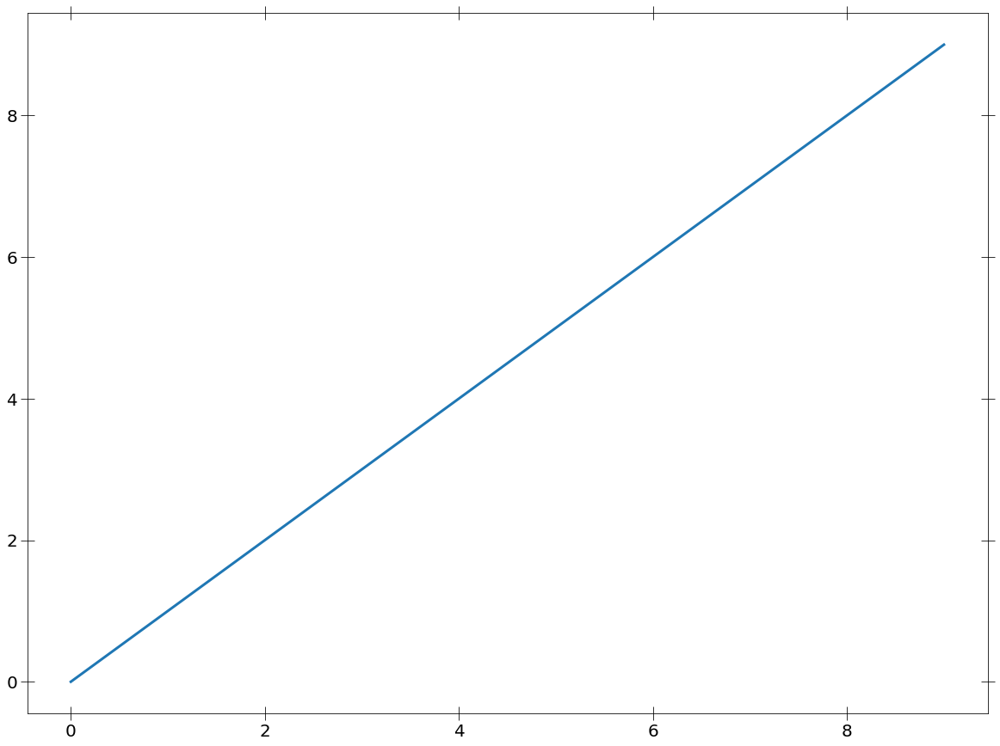

In [11]:
set_plotparams('notebook')
plt.plot(np.arange(10))

# Loading Data

In [7]:
chandra_response_path = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/chandra_obs_hard07/2CXOJ174334.1-291117/2CXOJ174334.1-291117_combined_src.rmf'
pn_response_path = '/Volumes/Pavan_Work_SSD/Backup/GalacticBulge_Xrayclassify/XMM_responses/PN/epn_bu23_dY9.rmf.gz'
mos_response_path = '/Volumes/Pavan_Work_SSD/Backup/GalacticBulge_Xrayclassify/XMM_responses/MOS_5eV/m1_e10_im_p0_c.rmf'
chandra_sim_path = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/chandra_simspecs/'
chandra_sim_cvs = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/sim_ips_highnh_twice_ew_chandra/sim_ips_highnh_twice_ew_chandra/'
xmm_sim_path = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/xmm_pn_mos_simspecs_goodobs/'
xmm_sim_cvs = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/sim_ips_xmm_goodobs/'
xmm_sim_cvs2 = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/sim_ips_highnh_craig/'
xmm_sim_path2 = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/xmm_pn_mos_simspecs_2/'
chandra_sim_cvs2 = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/sim_ips_highnh_craig_chandra/'
chandra_obs_path = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/chandra_obs_hard07/'
xmm_obs_path = '/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/xmm_combined_goodobs2/'

1:80: E501 line too long (159 > 79 characters)
2:80: E501 line too long (115 > 79 characters)
3:80: E501 line too long (120 > 79 characters)
4:80: E501 line too long (94 > 79 characters)
5:80: E501 line too long (140 > 79 characters)
6:80: E501 line too long (101 > 79 characters)
7:80: E501 line too long (92 > 79 characters)
8:80: E501 line too long (94 > 79 characters)
9:80: E501 line too long (96 > 79 characters)
10:80: E501 line too long (106 > 79 characters)
11:80: E501 line too long (96 > 79 characters)


## MSP simulations vs. observed sources

# PN files init: 638
# MOS files init: 322
244
716


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:532: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:533: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:619: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:620: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:623: RuntimeWarning: invalid value encountered in sqrt
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:623: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:625: RuntimeWarning: invalid value encountered in sqrt
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ip

12.0


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:326: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


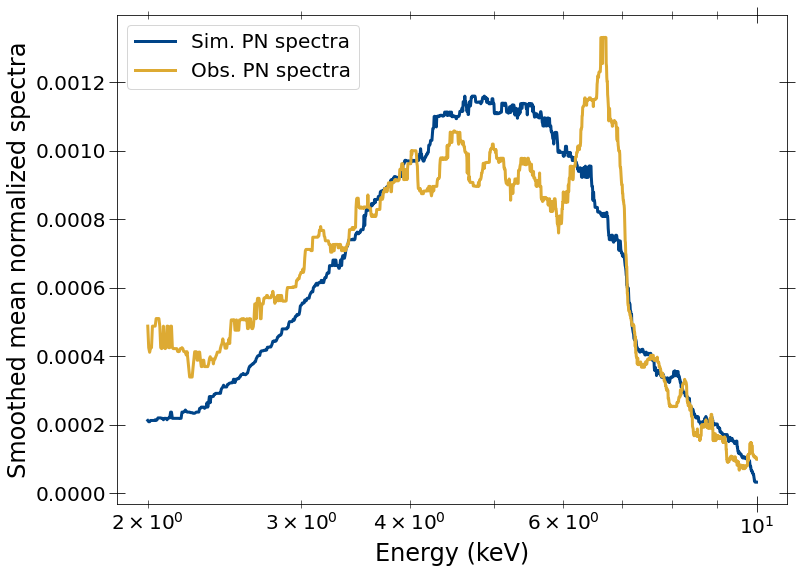

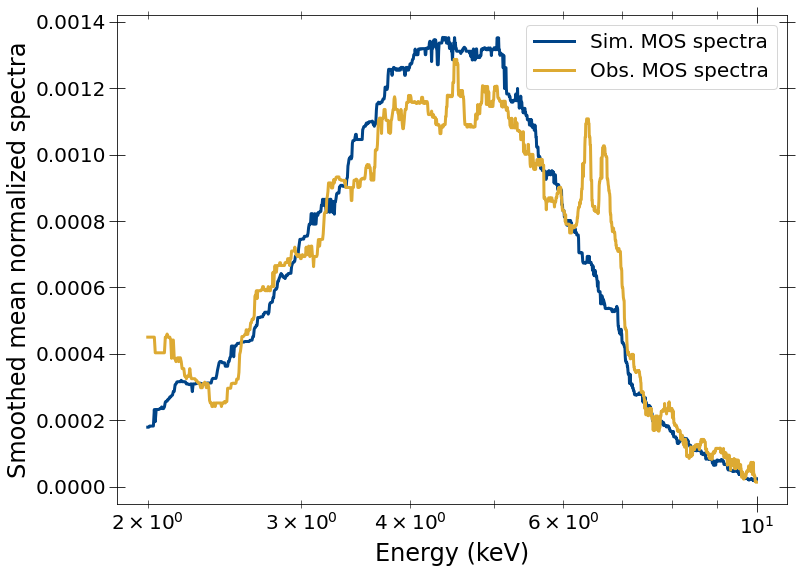

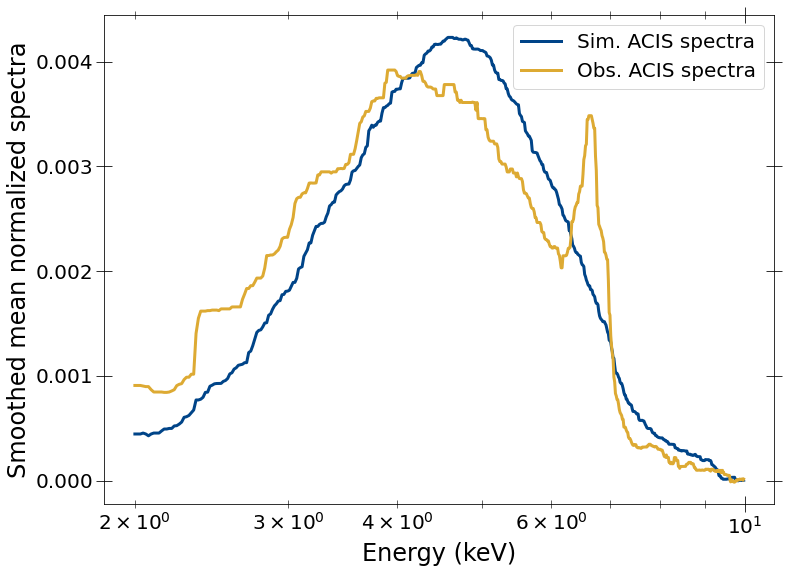

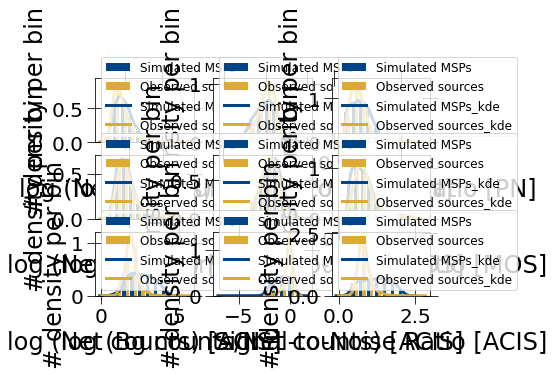

In [8]:
spec_summary_msps = load_alldata(
     [pn_response_path, mos_response_path, chandra_response_path],
     [xmm_sim_path, xmm_sim_path, chandra_sim_path],
     [xmm_obs_path, xmm_obs_path, chandra_obs_path], en_range=[2, 10])

In [8]:
len(spec_summary_msps['specs'][0][2])

10000

## MSP vs. IP simulations

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:532: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:533: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:619: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:620: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:623: RuntimeWarning: invalid value encountered in sqrt
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:623: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:625: RuntimeWarning: invalid value encountered in sqrt
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ip

12.0


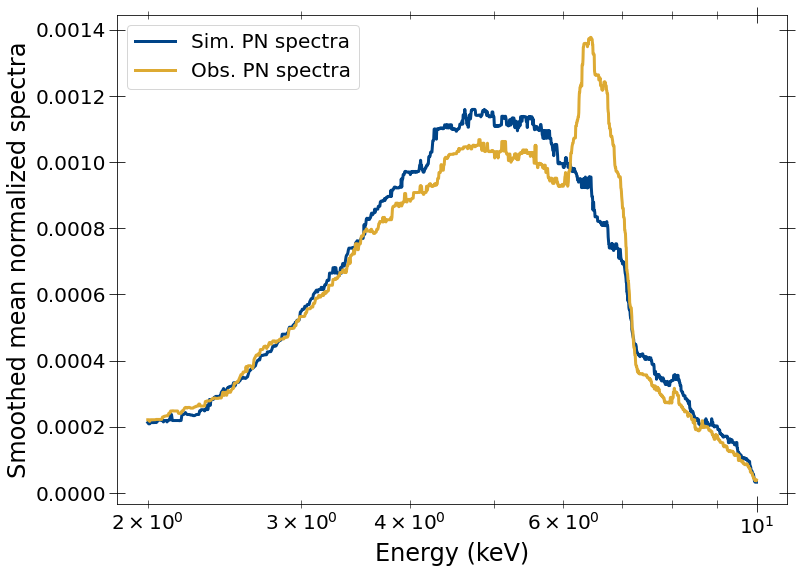

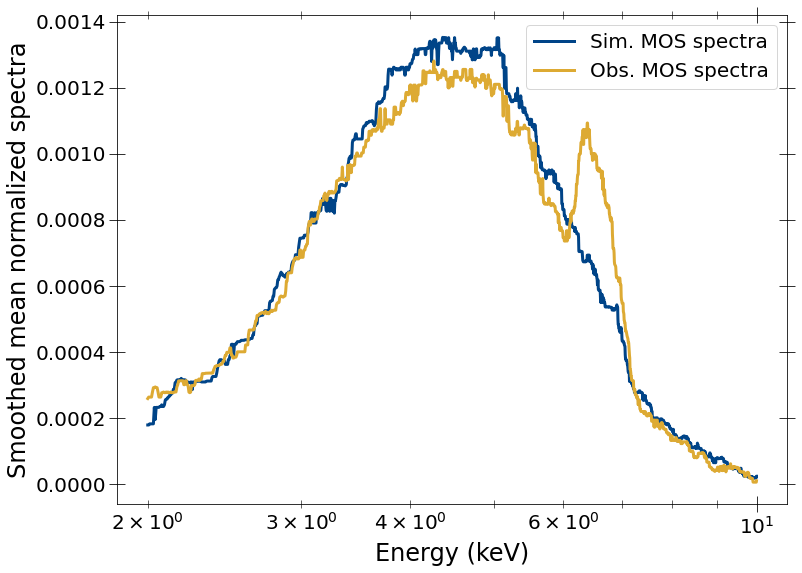

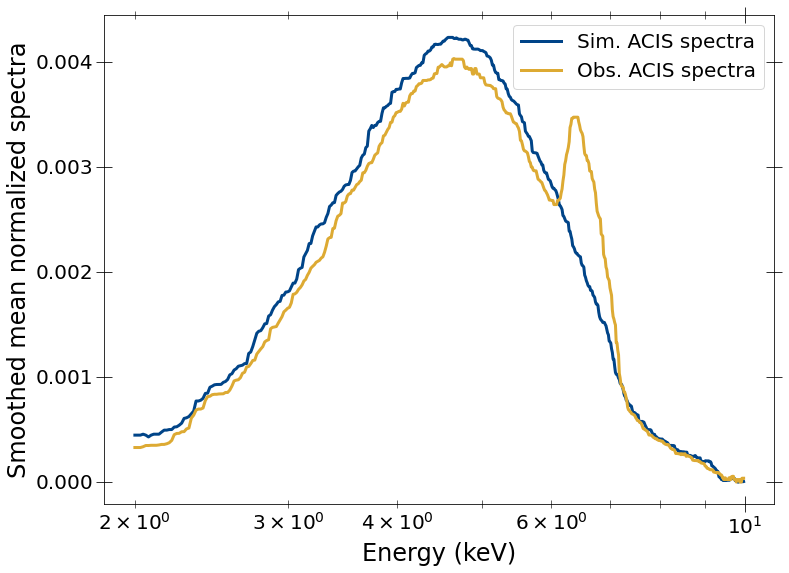

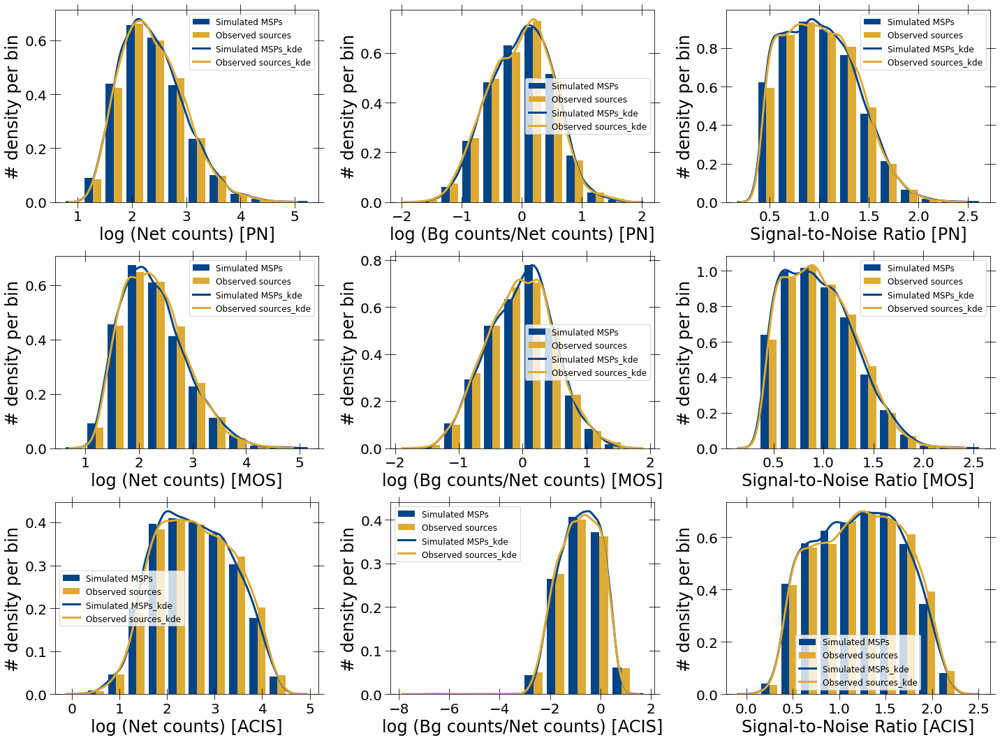

In [119]:
spec_summary_msp_cvs = load_alldata(
     [pn_response_path, mos_response_path, chandra_response_path],
     [xmm_sim_path, xmm_sim_path, chandra_sim_path],
     [xmm_sim_cvs, xmm_sim_cvs, chandra_sim_cvs], en_range=[2, 10],
     both_sims=True)

## IP simulations vs observed sources

# PN files init: 638
# MOS files init: 322
244
716


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:532: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:533: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:619: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:620: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:623: RuntimeWarning: invalid value encountered in sqrt
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:623: RuntimeWarning: invalid value encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:625: RuntimeWarning: invalid value encountered in sqrt
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ip

12.0


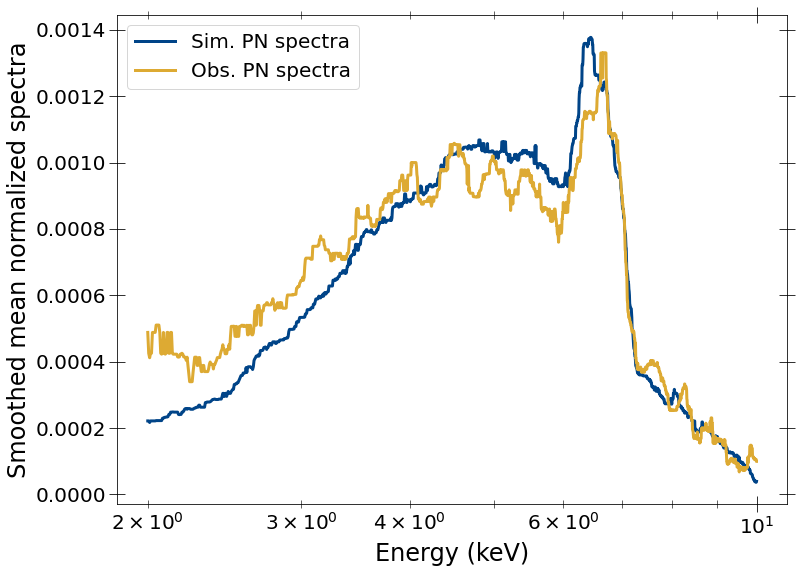

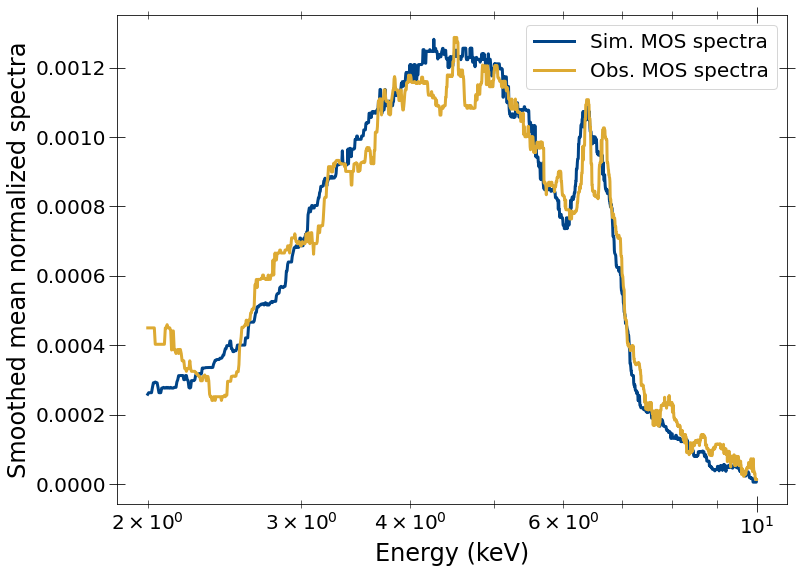

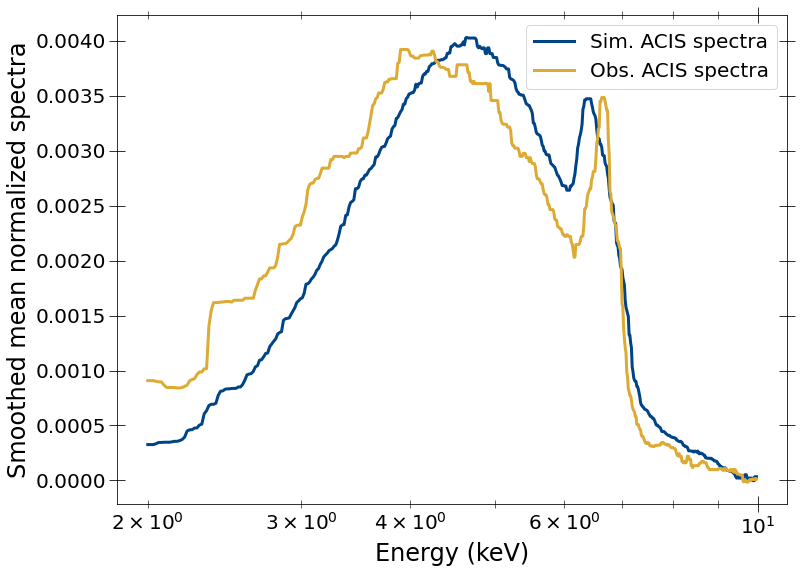

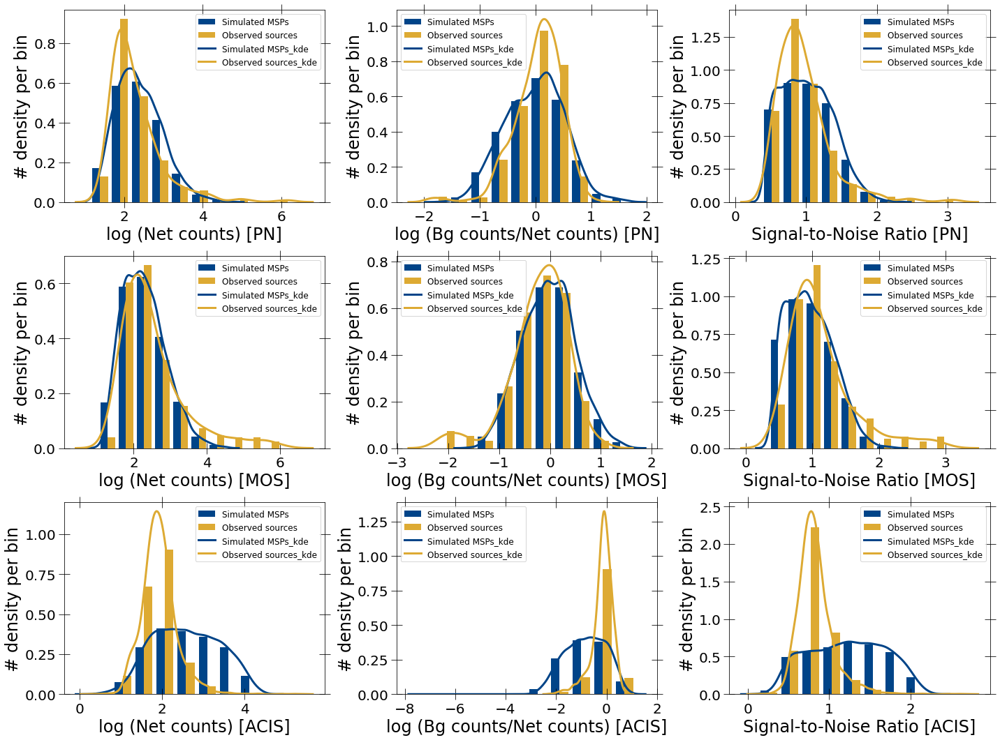

In [121]:
spec_summary_cvs = load_alldata(
     [pn_response_path, mos_response_path, chandra_response_path],
     [xmm_sim_cvs, xmm_sim_cvs, chandra_sim_cvs],
     [xmm_obs_path, xmm_obs_path, chandra_obs_path], en_range=[2, 10],
     both_sims=False, sim_basename='ip_')

# Comparing colors

## Simulated MSPs vs observed_sources

In [231]:
len(obs_color_dict_arr[0]['colors'])

741

In [311]:
len(delta_cstat1)

178

2772 2772 2772 2772
741 741 741 741
Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
1937 1937 1937 1937
445 445 445 445


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:704: RuntimeWarning: divide by zero encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:704: RuntimeWarning: divide by zero encountered in true_divide


Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
7873 7873 7873 7873
2670 2670 2670 2670
Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:704: RuntimeWarning: divide by zero encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:704: RuntimeWarning: invalid value encountered in true_divide


16.0


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:323: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


16.0
16.0


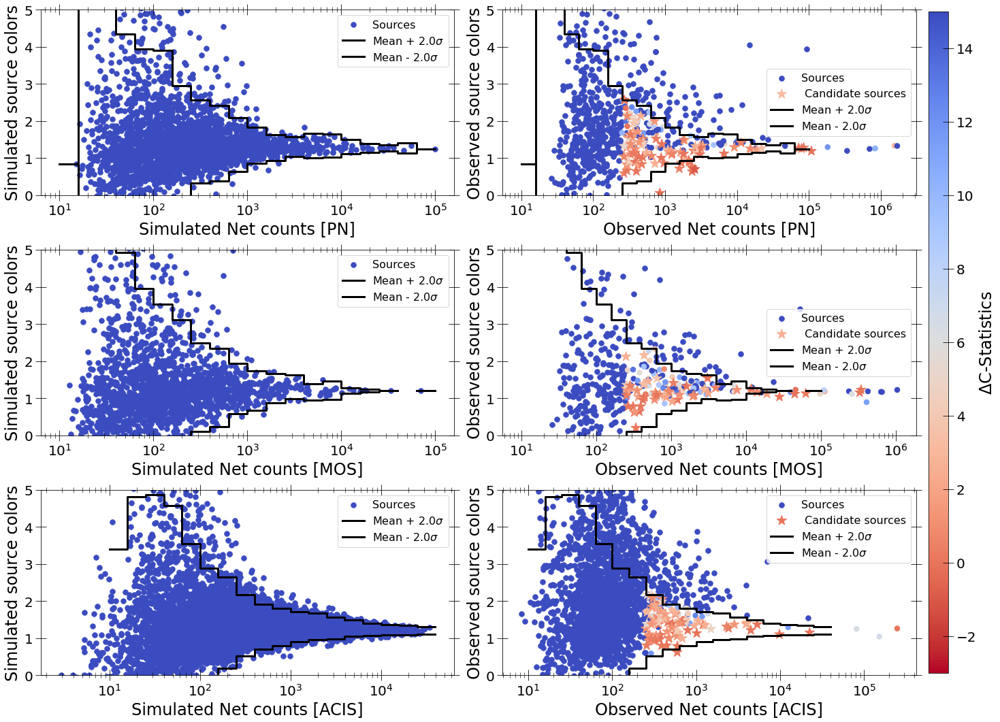

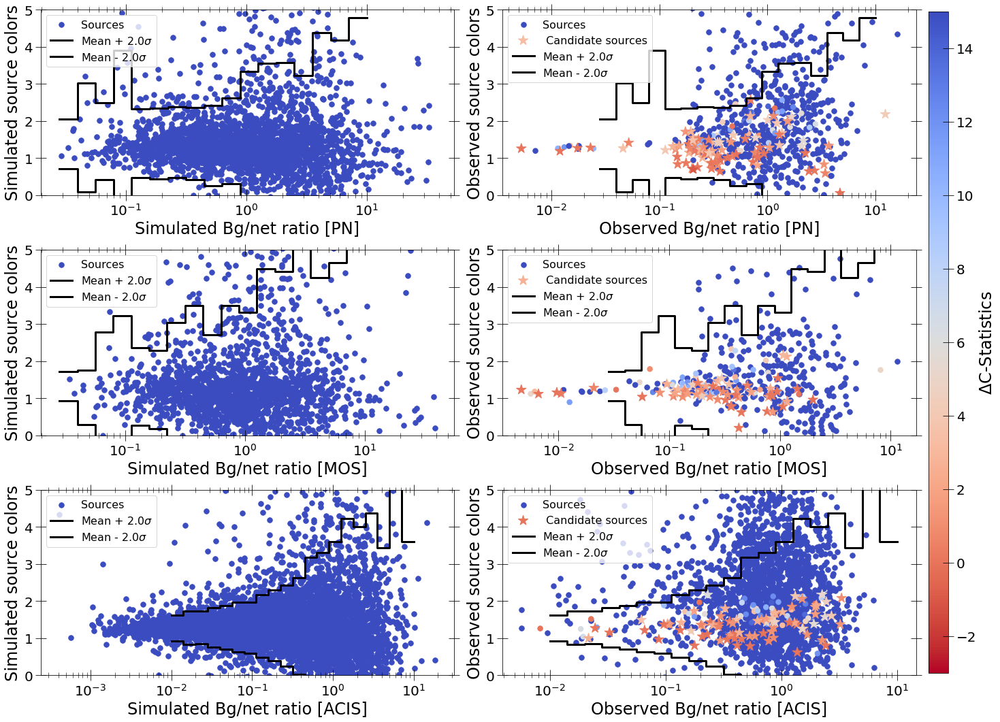

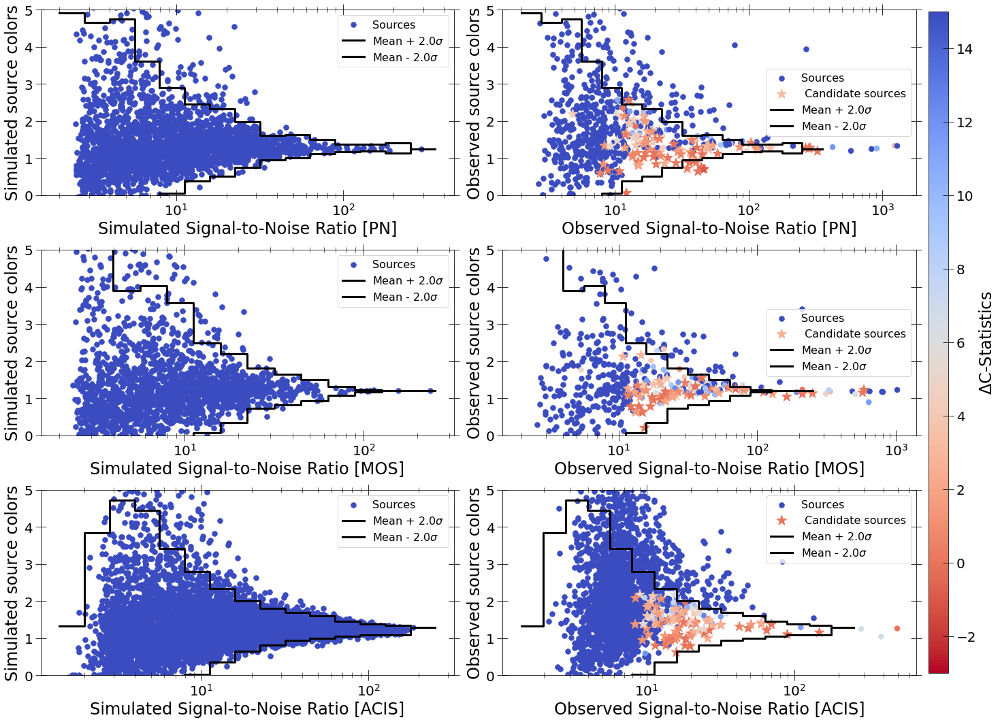

In [335]:
delta_cstat1 = (np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
                np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float))
delta_cstat2 = (np.array(mos_fit_stats_table_pl)[:, 1].astype(float) -
                np.array(mos_fit_stats_table_pl_g2)[:, 1].astype(float))
delta_cstat3 = (np.array(acis_fit_stats_table_pl)[:, 1].astype(float) -
                np.array(acis_fit_stats_table_pl_g2)[:, 1].astype(float))
sim_msps_color_dict_arr, obs_color_dict_arr = getcolor_prop_alldet(
    spec_summary_msps, compare_det=True, int_args=interested_msp_args_alldet,
    delta_cstat=[delta_cstat1, delta_cstat2, delta_cstat3],
    candidate_args=[candidadate_msps_pn_args,
                    candidadate_msps_mos_args,
                    candidadate_msps_acis_args])

8281 8281 8281 8281
546 546 546 546


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide


Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
3731 3731 3731 3731
250 250 250 250
Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
7873 7873 7873 7873
2670 2670 2670 2670


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: invalid value encountered in true_divide


Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
16.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:328: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


16.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
16.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0


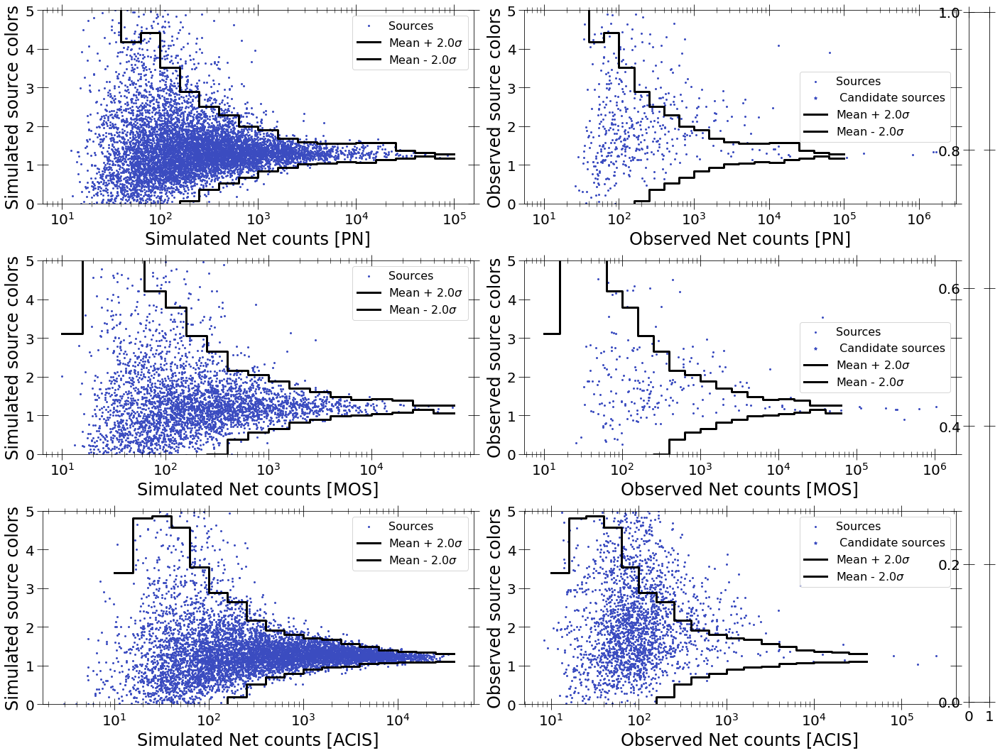

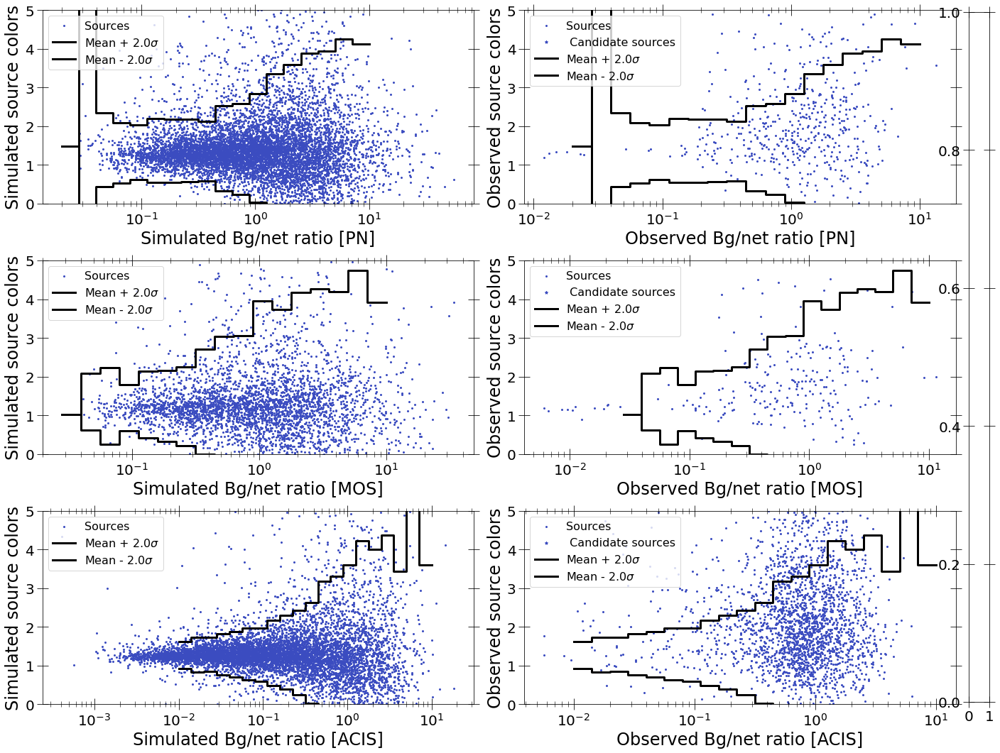

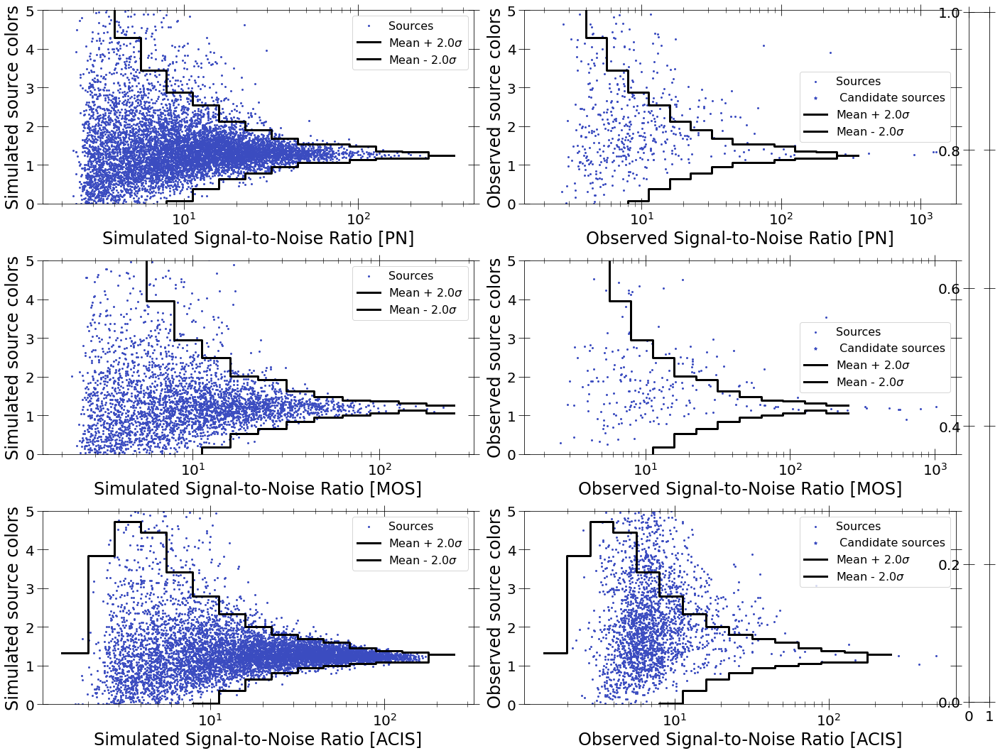

In [12]:
sim_msps_color_dict_arr, obs_color_dict_arr = getcolor_prop_alldet(
    spec_summary_msps, compare_det=True)

6

## Simulated MSPs vs. CVs

8281 8281 8281 8281
8294 8294 8294 8294


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide


Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
3731 3731 3731 3731
3753 3753 3753 3753
Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide



7873 7873 7873 7873
8132 8132 8132 8132
Calaculating mean and standard deviation in colors vs. Net counts
Calaculating mean and standard deviation in colors vs. Bg/net ratio
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: invalid value encountered in true_divide


16.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:328: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


16.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
16.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0
4.0


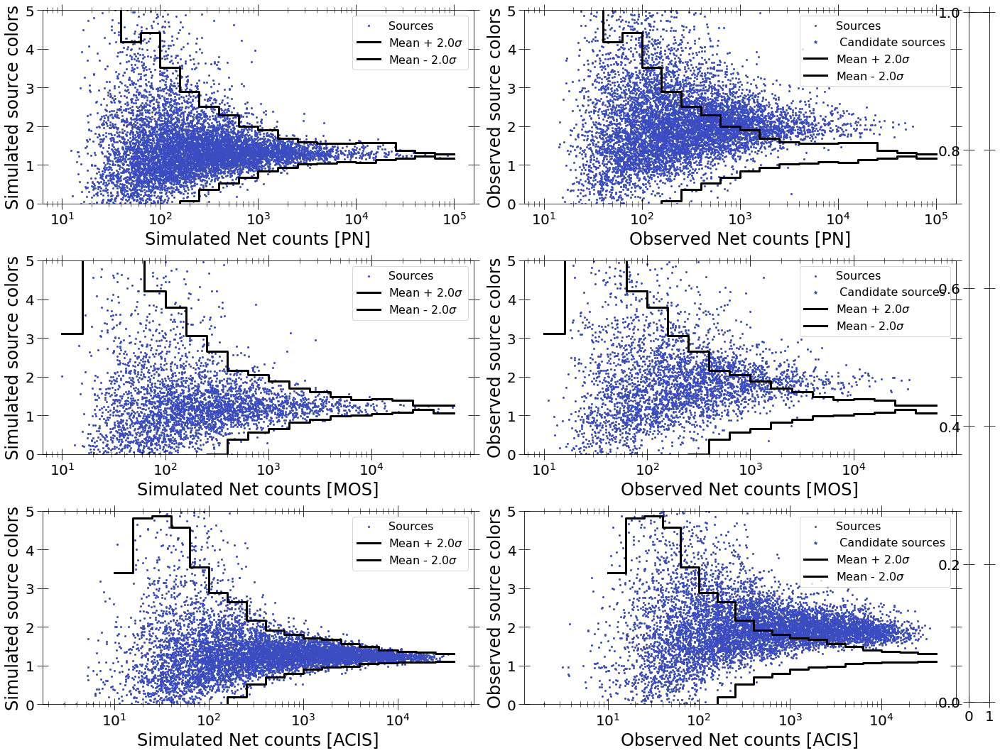

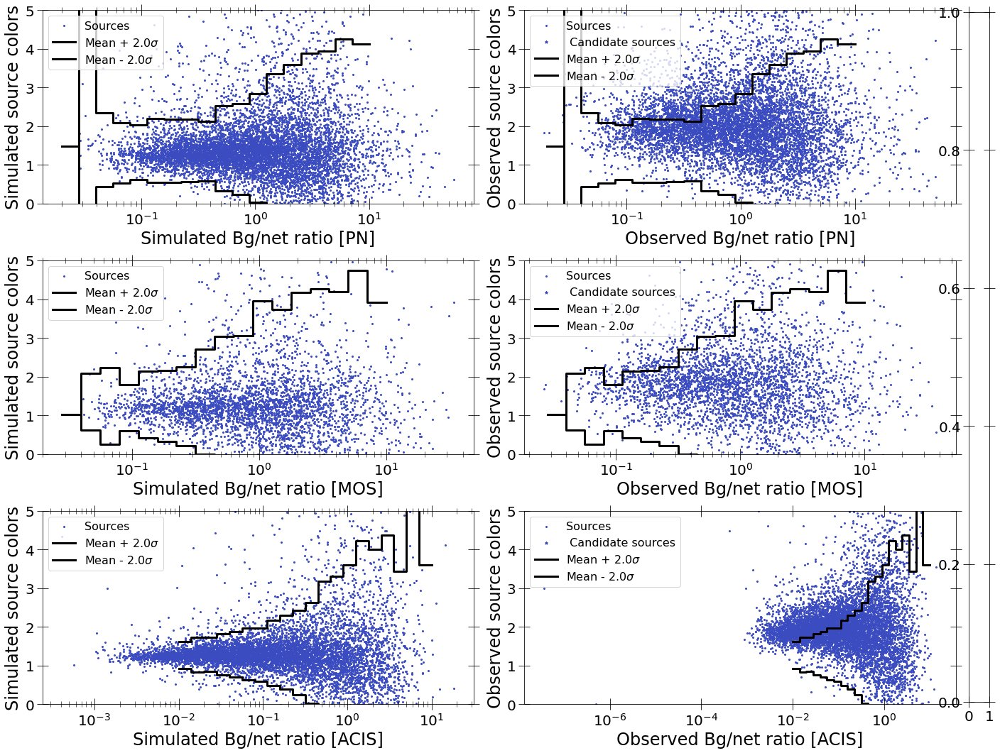

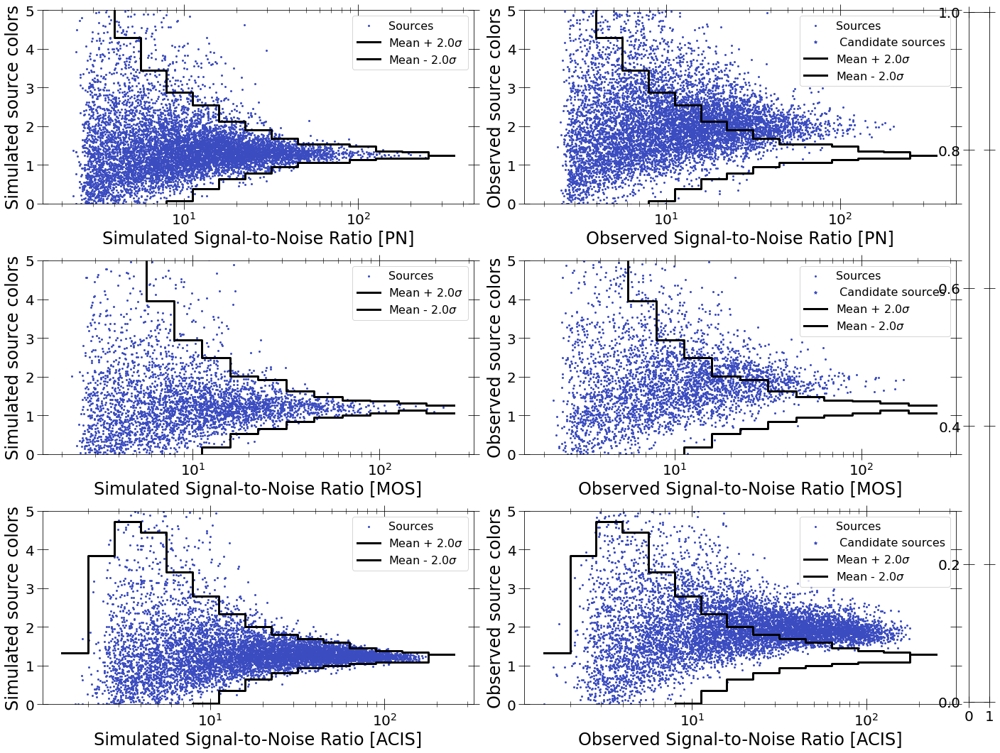

In [136]:
sim_msps2_color_dict_arr, sim_ips_color_dict_arr = getcolor_prop_alldet(
    spec_summary_msp_cvs, compare_det=True)

## Simulated CVs vs observed sources

8294 8294 8294 8294
546 546 546 546


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide


Calaculating mean and standard deviation in colors vs. Net counts
16.0
4.0
4.0
Calaculating mean and standard deviation in colors vs. Bg/net ratio
16.0
4.0
4.0
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
16.0
4.0
4.0
3753 3753 3753 3753
250 250 250 250


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide


Calaculating mean and standard deviation in colors vs. Net counts
16.0
4.0
4.0
Calaculating mean and standard deviation in colors vs. Bg/net ratio
16.0
4.0
4.0
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
16.0
4.0
4.0
8132 8132 8132 8132
2670 2670 2670 2670
Calaculating mean and standard deviation in colors vs. Net counts


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: divide by zero encountered in true_divide
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:711: RuntimeWarning: invalid value encountered in true_divide


16.0
4.0
4.0
Calaculating mean and standard deviation in colors vs. Bg/net ratio
16.0
4.0
4.0
Calaculating mean and standard deviation in colors vs. Signal-to-Noise Ratio
16.0
4.0
4.0


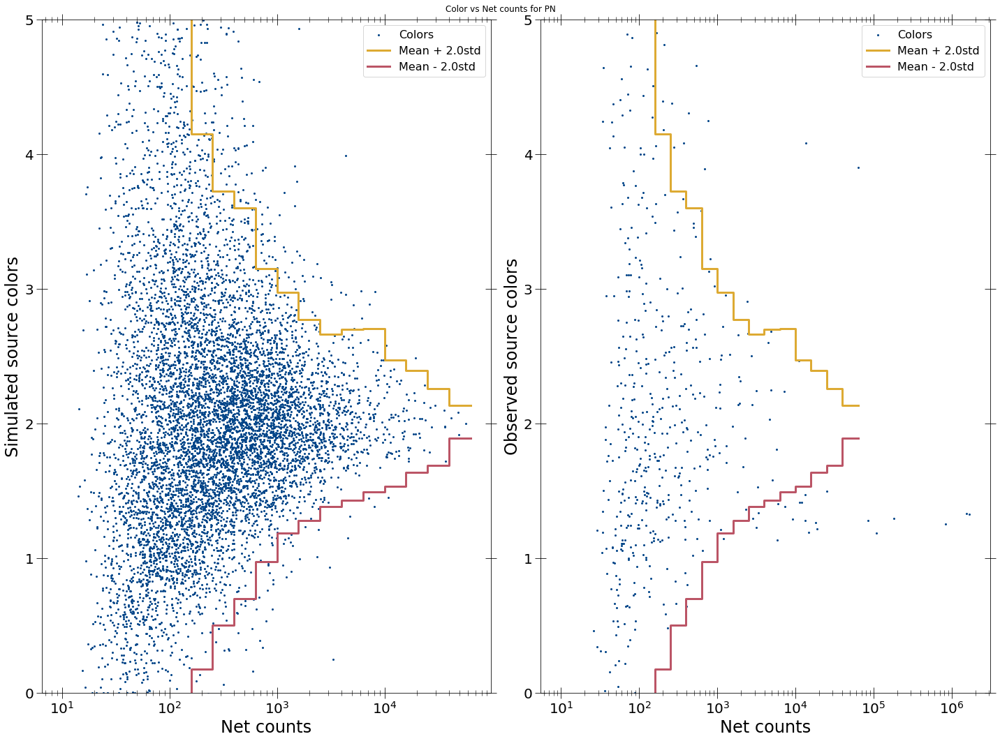

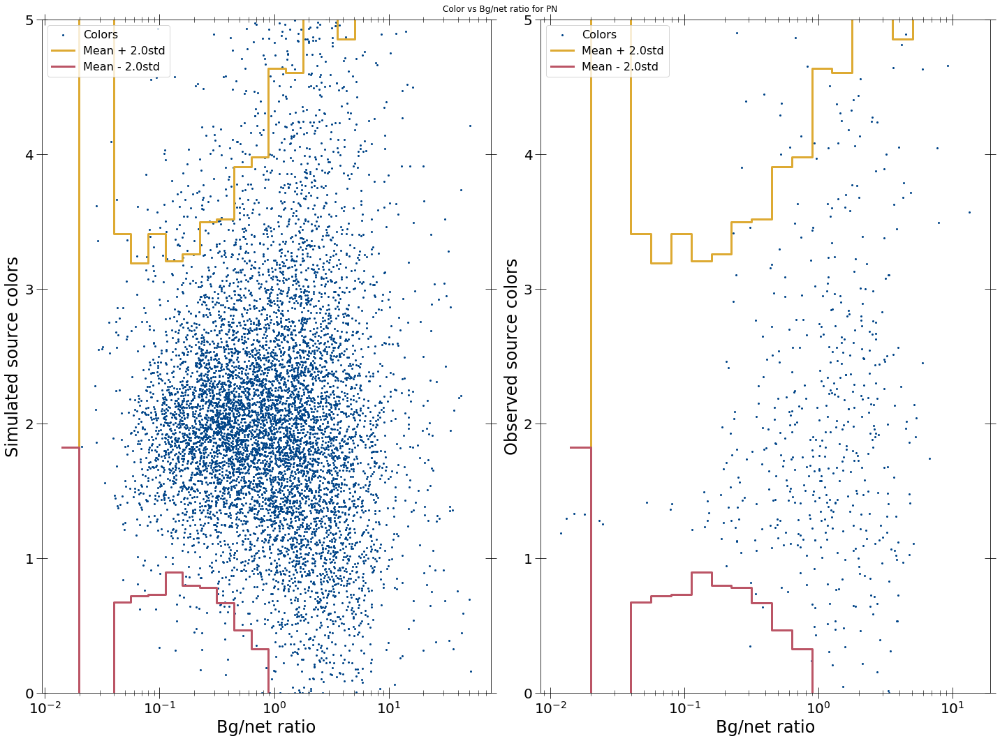

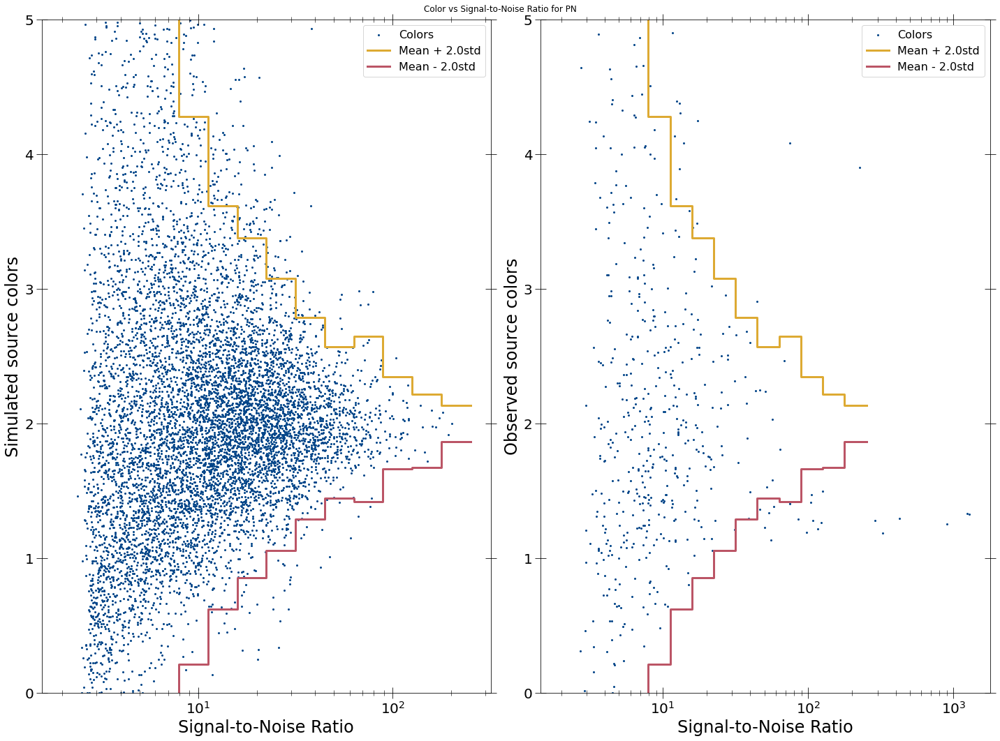

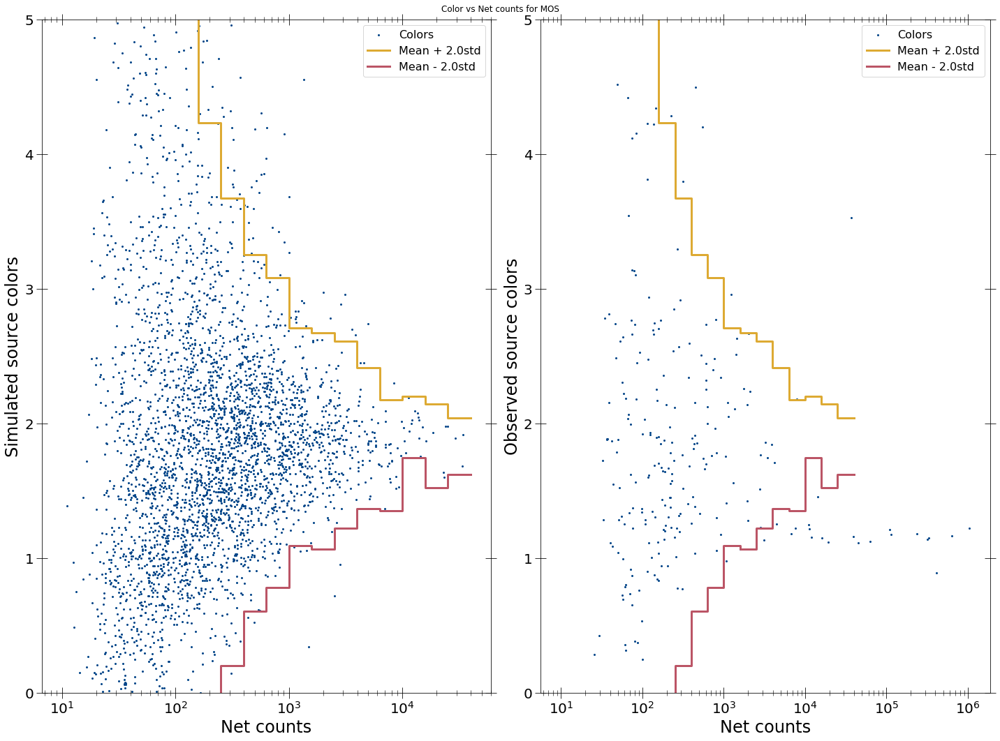

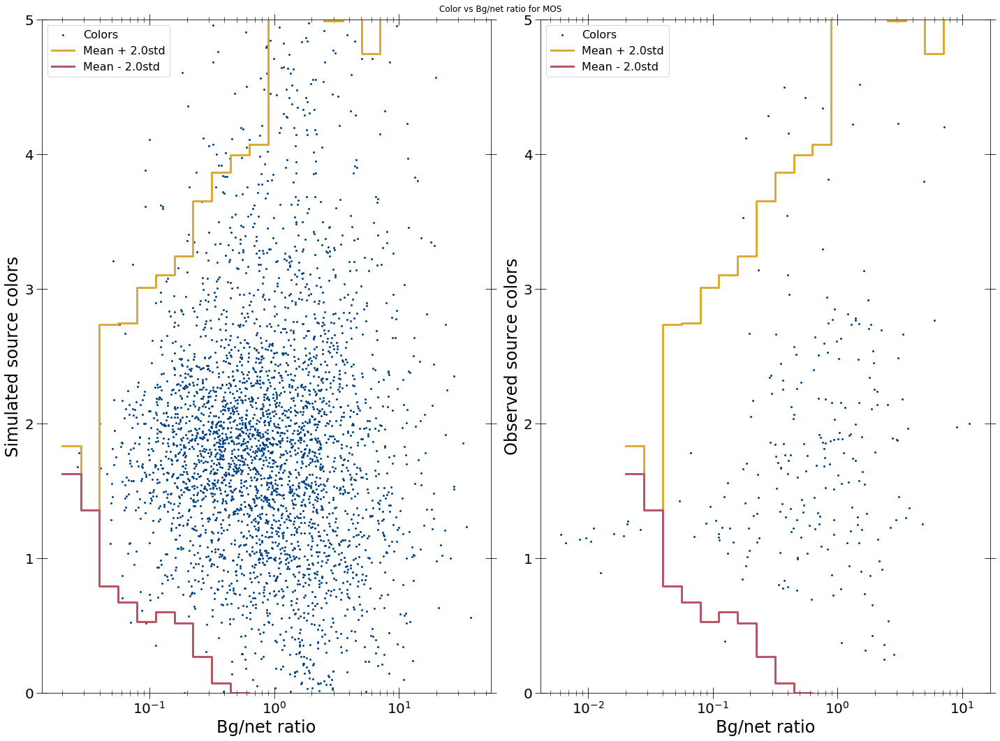

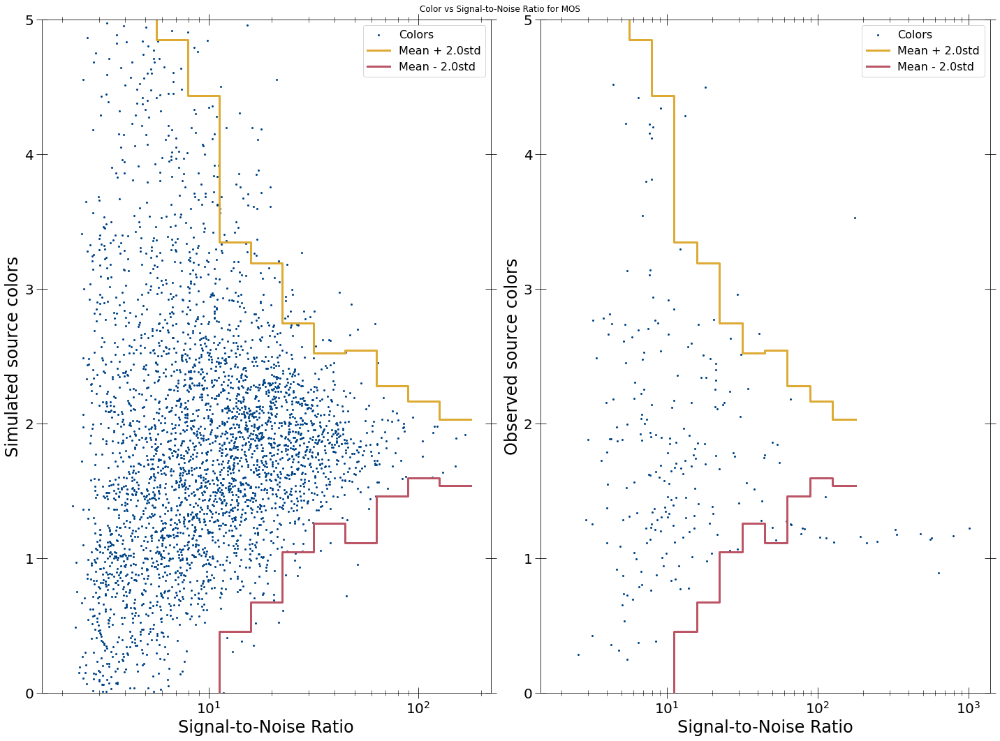

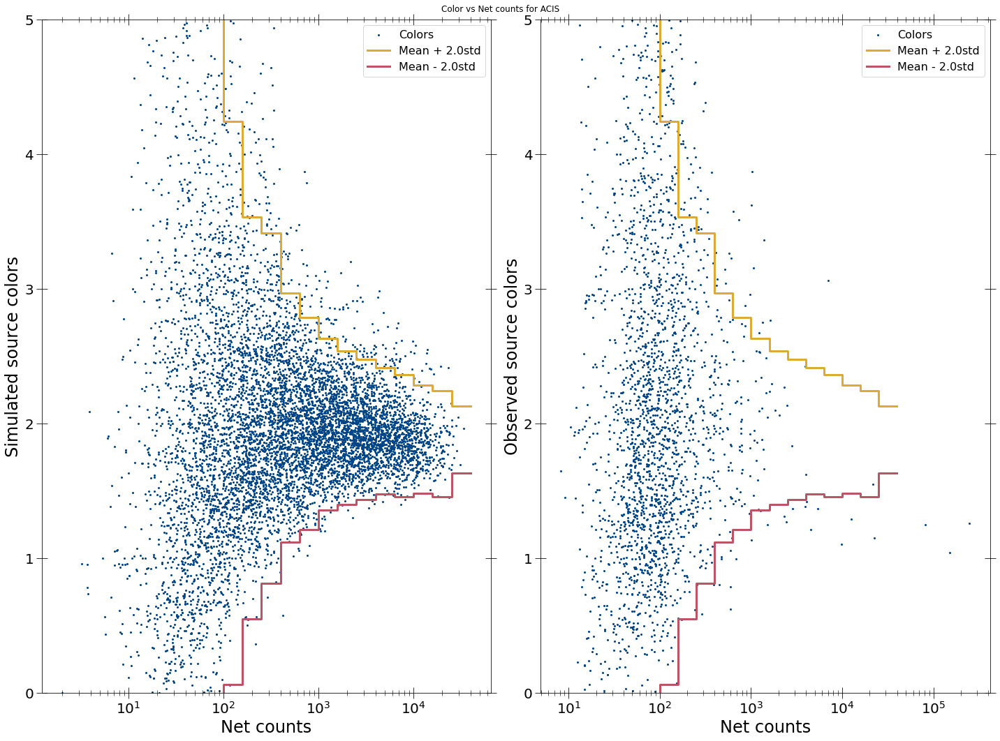

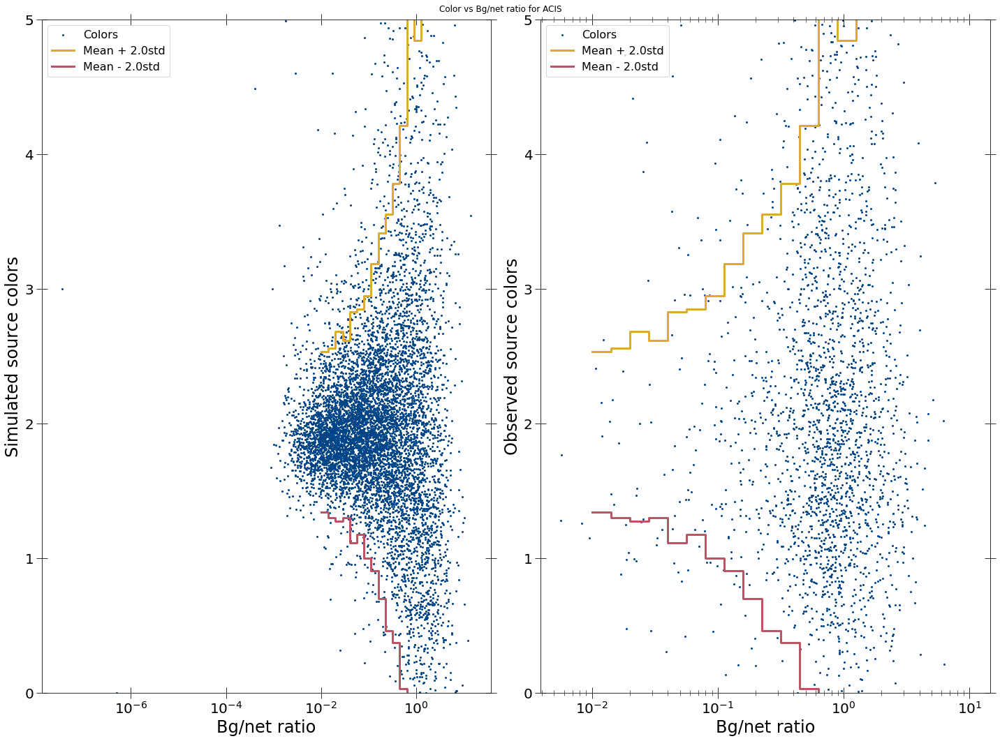

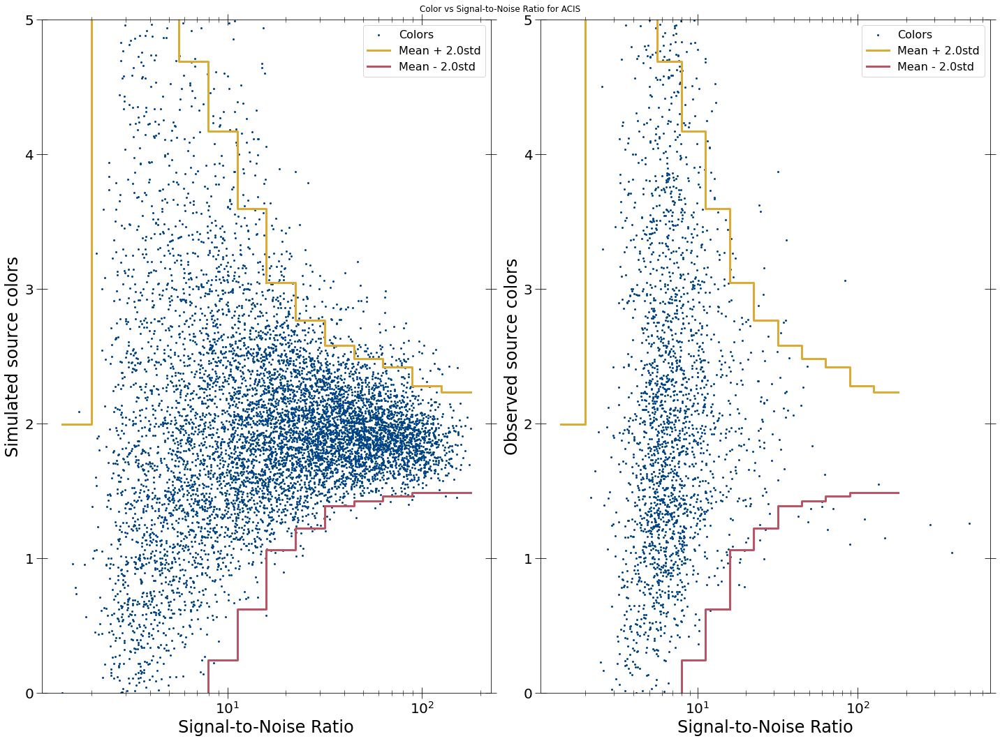

In [137]:
test = getcolor_prop_alldet(spec_summary_cvs, compare_det=False)

# MSP analysis

## Getting sources consistent with MSP colors

In [72]:
def get_candidate_src_nums_det(obs_src_nums, obs_det_mask, sim_color_dict,
                               obs_color_dict, min_counts, min_counts2=None):
    """Get src nums of quiescent sources for given detector"""
    #print(min_counts2)
    obs_netcounts = obs_color_dict['prop_list'][0]
    netcount_bins = sim_color_dict['prop_bins'][0]
    obs_colors = obs_color_dict['colors']
    color_median = sim_color_dict['color_stat'][0][0]
    color_std = sim_color_dict['color_stat'][2][0]
    print(netcount_bins)
    print(color_median)
    print(color_std)
    interested_args = None
    for i, lower_bin in enumerate(netcount_bins):
        if lower_bin < min_counts:
            continue
        if i == len(netcount_bins) - 1:
            upper_bin = np.max(obs_netcounts) + 10
            if not np.isnan(color_median[-1]):
                median_color = color_median[-1]
            if not np.isnan(color_std[-1]):
                std_color = color_std[-1]
            std_color = max(std_color, 0.06)
        else:
            upper_bin = netcount_bins[i+1]
            if not np.isnan(color_median[i]):
                median_color = color_median[i]
            if not np.isnan(color_std[i]):
                std_color = color_std[i]
            std_color = max(std_color, 0.06)
        if min_counts2 is not None:
            if lower_bin < min_counts2 and min_counts2 < upper_bin:
                if ((min_counts2 - lower_bin) > (upper_bin - min_counts2)):
                    lower_bin = min_counts2
                    median_color = color_median[i+1]
                    std_color = color_std[i+1]
                else:
                    lower_bin = min_counts2
        #print(min_counts2)
        print(lower_bin, median_color, std_color)
        if (np.isnan(median_color) or np.isnan(std_color) or std_color==0):
            print('HELLO')
            int_args = np.where(np.logical_and(
                obs_netcounts >= lower_bin, obs_netcounts < upper_bin))
        else:
        
            int_args = np.where(np.logical_and(
                np.logical_and(obs_netcounts >= lower_bin,
                               obs_netcounts < upper_bin),
                obs_colors < median_color + 2*std_color))[0]
        '''
        int_args = np.where(np.logical_and(
                np.logical_and(obs_netcounts >= lower_bin,
                               obs_netcounts < upper_bin),
                obs_colors < median_color + 2*std_color))[0]
        '''
        print(len(int_args))
        if interested_args is None:
            interested_args = int_args.copy()
        else:
            interested_args = np.append(interested_args.copy(), int_args)
    return interested_args, obs_src_nums[obs_det_mask][interested_args]


def get_candidate_src_nums_alldet(spec_summary, sim_color_dict_arr,
                                  obs_color_dict_arr, min_count_arr=None,
                                  min_counts2=None):
    """Get source nums for all detectors."""
    interested_args_alldet = []
    interested_sources_alldet = []
    if min_count_arr is None:
        min_count_arr = [700, 700, 250]
    for i, obs_color_dict in enumerate(obs_color_dict_arr):
        if i > 0:
            interested_args, interested_srcs = get_candidate_src_nums_det(
                spec_summary['src_nums'][i-1], spec_summary['spec_masks'][1][i],
                sim_color_dict_arr[i], obs_color_dict, min_count_arr[i],
                min_counts2)
        else:
            interested_args, interested_srcs = get_candidate_src_nums_det(
                spec_summary['src_nums'][i], spec_summary['spec_masks'][1][i],
                sim_color_dict_arr[i], obs_color_dict, min_count_arr[i],
                min_counts2)
        interested_args_alldet.append(interested_args)
        interested_sources_alldet.append(interested_srcs)
    return interested_args_alldet, interested_sources_alldet


4:5: E265 block comment should start with '# '
39:9: E265 block comment should start with '# '
41:71: E225 missing whitespace around operator
46:1: W293 blank line contains whitespace
76:80: E501 line too long (80 > 79 characters)


In [73]:
(interested_msp_args_alldet,
 interested_msp_srcs_alldet) = get_candidate_src_nums_alldet(
    spec_summary_msps, sim_msps_color_dict_arr, obs_color_dict_arr,
    min_count_arr=[150, 150, 150], min_counts2=250)

[1.00000000e+01 1.58489319e+01 2.51188643e+01 3.98107171e+01
 6.30957344e+01 1.00000000e+02 1.58489319e+02 2.51188643e+02
 3.98107171e+02 6.30957344e+02 1.00000000e+03 1.58489319e+03
 2.51188643e+03 3.98107171e+03 6.30957344e+03 1.00000000e+04
 1.58489319e+04 2.51188643e+04 3.98107171e+04 6.30957344e+04
 1.00000000e+05]
[3.65542586 1.82112626 1.93854327 1.55166167 1.66017044 1.54351252
 1.47857829 1.42997489 1.40961659 1.34310455 1.36949341 1.3094684
 1.31091515 1.30237862 1.31805685 1.31716775 1.35103234 1.27131889
 1.27087823 1.23009718]
[7.03523327 2.31283915 2.18961059 1.31711125 1.37887919 0.98627194
 0.70557556 0.53689296 0.43740548 0.33020864 0.26926488 0.18769595
 0.14349454 0.12610196 0.118522   0.12565636 0.11273488 0.04872525
 0.02083223 0.02596428]
250 1.429974886706783 0.5368929553567432
0
251.18864315095823 1.429974886706783 0.5368929553567432
31
398.1071705534973 1.4096165878788645 0.4374054816065335
20
630.957344480193 1.3431045453292159 0.33020864110573095
13
1000.0 1.

In [74]:
print('Interested PN sources: ', len(interested_msp_srcs_alldet[0]))
print('Interested MOS sources: ', len(interested_msp_srcs_alldet[1]))
print('Interested ACIS sources: ', len(interested_msp_srcs_alldet[2]))

Interested PN sources:  93
Interested MOS sources:  65
Interested ACIS sources:  130


In [16]:
def mark_interested_srcs(sim_color_dict, obs_color_dict, src_nums, obs_mask,
                         interested_srcs, prop_num=0):
    props = obs_color_dict['prop_list'][prop_num]
    colors = obs_color_dict['colors']
    interested_args = np.where(np.isin(src_nums[obs_mask], interested_srcs))
    print(len(interested_args[0]), len(interested_srcs))
    # print(len(np.unique(interested_srcs)))
    # print(interested_args)
    # print(src_nums[obs_mask][interested_args])
    # print(props[interested_args])
    # print(colors[interested_args])
    prop_bins = sim_color_dict['prop_bins'][prop_num]
    mean_color = sim_color_dict['color_stat'][0][prop_num]
    std_color = sim_color_dict['color_stat'][2][prop_num]
    print(props[interested_args])
    print(colors[interested_args])
    plotline_scatter([props, props[interested_args], prop_bins, prop_bins],
                     [colors, colors[interested_args], mean_color + 2*std_color,
                      mean_color - 2*std_color],
                     pl_types=['scatter', 'scatter', 'step', 'step'],
                     xlabel='Net counts', ylabel='Colors',
                     pl_labels=['Observed ACIS sources',
                                'Hailey et al. (2018) sources',
                                r'Mean + 2$\sigma$', r'Mean - 2$\sigma$'],
                     colors=['#004488', '#ddaa33', '#000000', '#000000'],
                     styles=['.', '*', '--', '--'],
                     ylim=(0, 5), highlight=True)
    return (colors[interested_args], props[interested_args])

18:80: E501 line too long (80 > 79 characters)


In [420]:
delta_cstat = np.array(pn_fit_stats_table_pl)[:, 1].astype(float) - np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float)

In [33]:
interested_msp_srcs_alldet[0][174]

'205056701010004'

In [67]:
from matplotlib.colors import Normalize

In [68]:
interested_msp_xm

array(['200305401010008', '200305401010017', '200305401015015',
       '201113501010117', '201113501010148', '201129702010029',
       '201129704010023', '201129704010026', '201129704010031',
       '201129704010049', '201129704010056', '201129707010033',
       '201129708010014', '201129712010002', '201129719010007',
       '201129721010136', '201529201015014', '202039301010054',
       '202039301010071', '204003401010008', '204003401010013',
       '205049406010031', '205100104010002', '205110002015026',
       '205110012010036', '205110012015035', '206946401010003',
       '206946404010062', '206946404010202', '206946409010022',
       '206946410010178', '206946416010014', '207242102010114',
       '208016803010003', '208024101010012', '208251401010016',
       '208441011010009', '208441011010032', '208441011010036',
       '208441011010211', '208624701010022', '208860108010001',
       '208860204010001', '208860207010007', '208938111010034',
       '201113501015161', '2011297010100

In [254]:
spec_summary_msps['counts'][0][0][1][spec_summary_msps['spec_masks'][1][0]][interested_msp_args_alldet[0]]

array([3.51929452e+02, 2.85294758e+02, 2.89900690e+02, 3.28559219e+02,
       3.11964577e+02, 3.25306748e+02, 3.44820290e+02, 2.57981436e+02,
       2.67528644e+02, 2.68595336e+02, 2.94651765e+02, 3.40981312e+02,
       2.84365253e+02, 3.19667720e+02, 2.77346210e+02, 3.28184955e+02,
       3.77918079e+02, 3.41211238e+02, 3.81976687e+02, 2.92579328e+02,
       2.92735265e+02, 2.51352123e+02, 3.87265165e+02, 2.75203084e+02,
       3.47382202e+02, 3.63066904e+02, 3.31093640e+02, 3.63586896e+02,
       2.96801156e+02, 3.14961326e+02, 3.30170412e+02, 2.71873909e+02,
       3.27073676e+02, 3.83059949e+02, 3.16385603e+02, 2.84663999e+02,
       3.59522758e+02, 2.97865164e+02, 3.93890922e+02, 3.13971935e+02,
       2.68533579e+02, 3.30838478e+02, 2.98679980e+02, 3.95459403e+02,
       3.82664952e+02, 4.55196441e+02, 5.96645536e+02, 4.85332639e+02,
       4.08206137e+02, 5.56503317e+02, 4.16713717e+02, 5.68590748e+02,
       4.40901747e+02, 4.88542554e+02, 4.05197362e+02, 5.13713407e+02,
      

In [266]:
interested_msp_

array(['200305401010008', '200305401010017', '200305401015015',
       '201113501010117', '201113501010148', '201129702010029',
       '201129704010023', '201129704010026', '201129704010031',
       '201129704010049', '201129704010056', '201129707010033',
       '201129708010014', '201129712010002', '201129719010007',
       '201129721010136', '201529201015014', '202039301010054',
       '202039301010071', '204003401010008', '204003401010013',
       '205049406010031', '205100104010002', '205110002015026',
       '205110012010036', '205110012015035', '206946401010003',
       '206946404010062', '206946404010202', '206946409010022',
       '206946410010178', '206946416010014', '207242102010114',
       '208016803010003', '208024101010012', '208251401010016',
       '208441011010009', '208441011010032', '208441011010036',
       '208441011010211', '208624701010022', '208860108010001',
       '208860204010001', '208860207010007', '208938111010034',
       '201113501015161', '2011297010100

In [268]:
(np.array(pn_fit_stats_table_pl)[-3, 1].astype(float) -
 np.array(pn_fit_stats_table_pl_g2)[-3, 1].astype(float))

0.00027632400269794744

(0.0, 5.0)

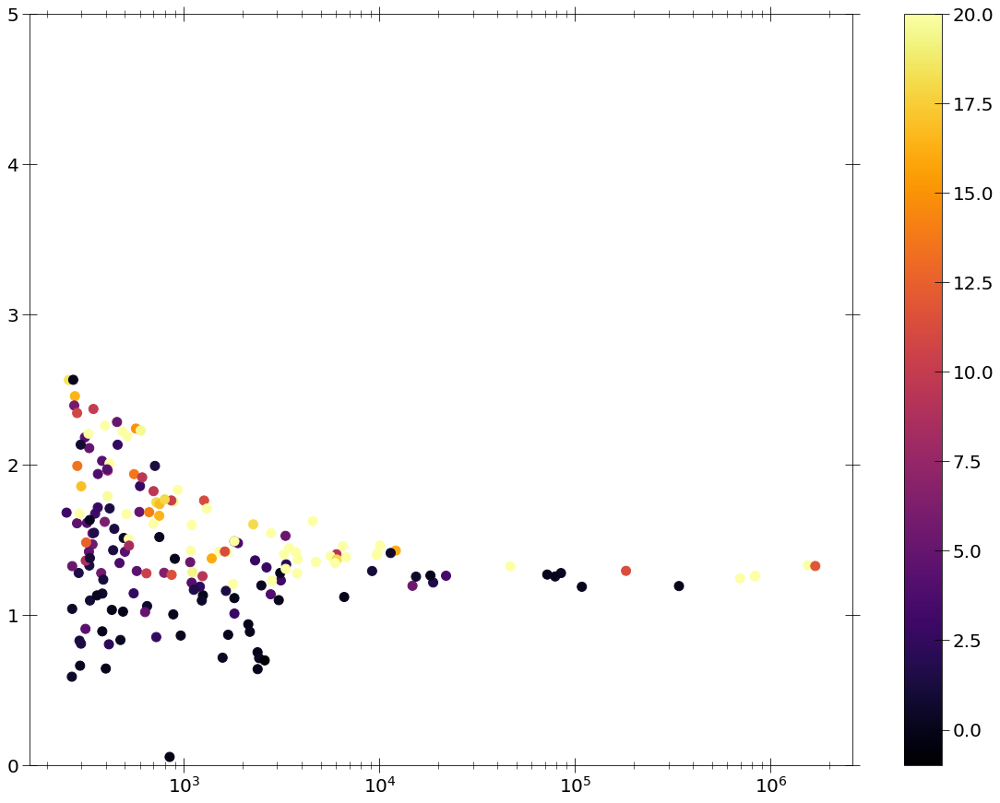

5:13: E131 continuation line unaligned for hanging indent
7:12: E131 continuation line unaligned for hanging indent


In [124]:
plt.scatter(
    spec_summary_msps['counts'][0][0][1][
        spec_summary_msps['spec_masks'][1][0]][interested_msp_args_alldet[0]],
    obs_color_dict_arr[0]['colors'][interested_msp_args_alldet[0]],
            c=(np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
               np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float)),
           cmap='inferno', norm=Normalize(-1, 20, True))
plt.colorbar()
plt.xscale('log')
plt.ylim(0, 5)

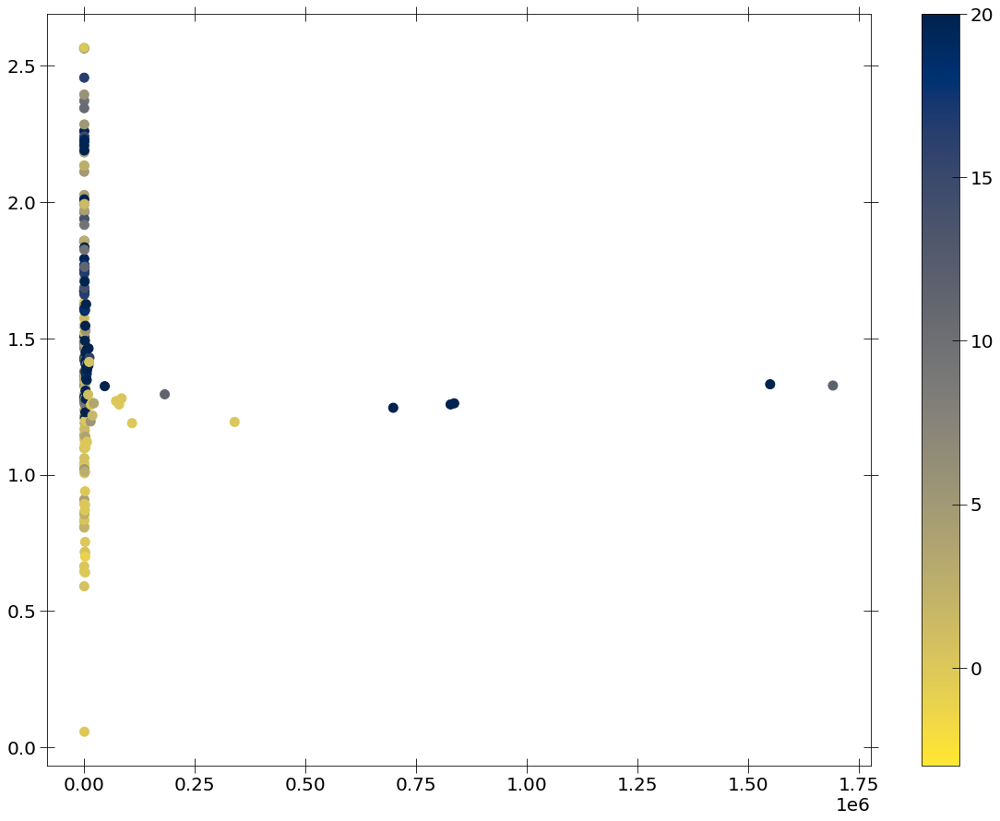

8:17: E128 continuation line under-indented for visual indent
9:17: E128 continuation line under-indented for visual indent


In [255]:
fig, axs = plt.subplots()
xdatas = spec_summary_msps['counts'][0][0][1][spec_summary_msps[
            'spec_masks'][1][0]][interested_msp_args_alldet[0]]
ydatas = obs_color_dict_arr[0]['colors'][interested_msp_args_alldet[0]]
zdatas = (np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
          np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float))
scatter_plot = axs.scatter(xdatas, ydatas, c=zdatas,
                marker='o', label=['Data'], cmap='cividis_r',
                norm=Normalize(-3, 20, True))
plt.colorbar(mappable=scatter_plot, ax=axs)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


16.0


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:322: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:38: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


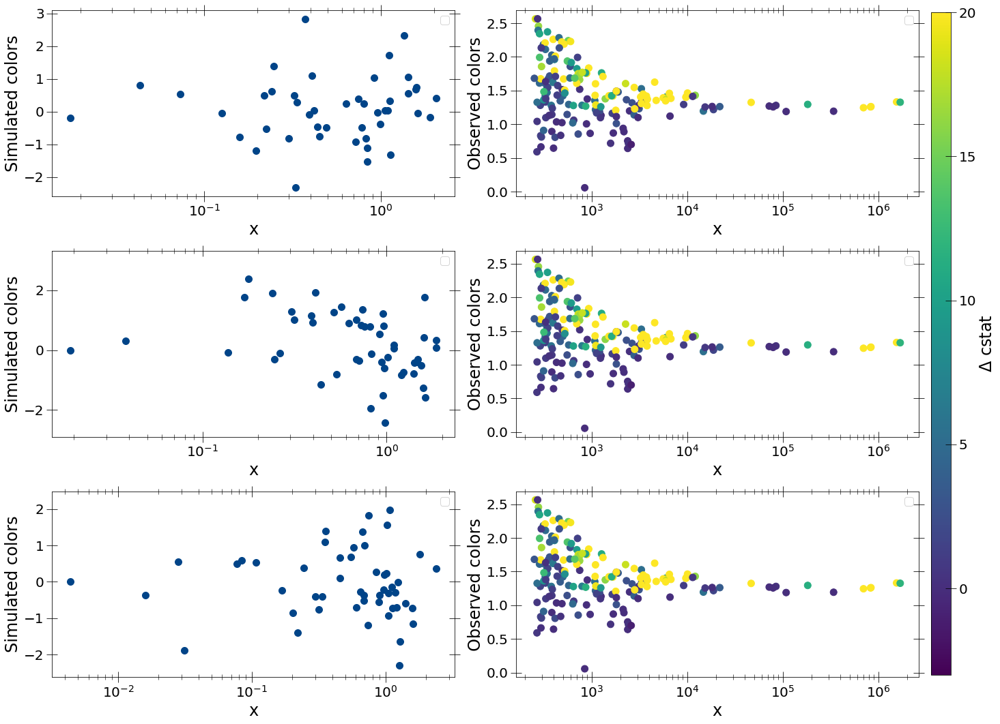

2:9: E231 missing whitespace after ','
26:9: E122 continuation line missing indentation or outdented
27:9: E122 continuation line missing indentation or outdented
29:9: E122 continuation line missing indentation or outdented
30:9: E122 continuation line missing indentation or outdented


In [214]:
plot_subplots(
    3, 2,[[[np.random.normal(size=100)],
           [spec_summary_msps['counts'][0][0][1][spec_summary_msps[
                'spec_masks'][1][0]][interested_msp_args_alldet[0]]]],
          [[np.random.normal(size=100)],
           [spec_summary_msps['counts'][0][0][1][spec_summary_msps[
                'spec_masks'][1][0]][interested_msp_args_alldet[0]]]],
          [[np.random.normal(size=100)],
           [spec_summary_msps['counts'][0][0][1][spec_summary_msps[
                'spec_masks'][1][0]][interested_msp_args_alldet[0]]]]],
    [[[np.random.normal(size=100)],
      [obs_color_dict_arr[0]['colors'][interested_msp_args_alldet[0]]]],
     [[np.random.normal(size=100)],
      [obs_color_dict_arr[0]['colors'][interested_msp_args_alldet[0]]]],
     [[np.random.normal(size=100)],
      [obs_color_dict_arr[0]['colors'][interested_msp_args_alldet[0]]]]],
    subp_types_arr=[['linescatter', 'linescatter'],
                    ['linescatter', 'linescatter'],
                    ['linescatter', 'linescatter']],
    pl_types_arr=[[['scatter'], ['scatter']], [['scatter'], ['scatter']],
                  [['scatter'], ['scatter']]],
    zdatas_arr=[[None, [(
        np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
        np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float))]],
                [None, [(
        np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
        np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float))]],
                [None, [(
        np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
        np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float))]]],
    zdata_labels=[[None, r'$\Delta$ cstat'], [None, r'$\Delta$ cstat'],
                  [None, r'$\Delta$ cstat']], common_cbar=True,
    xlabel_arr=[['x', 'x'], ['x', 'x'], ['x', 'x']],
    ylabel_arr=[['Simulated colors', 'Observed colors'],
                ['Simulated colors', 'Observed colors'],
                ['Simulated colors', 'Observed colors']]
)
plt.tight_layout(rect=[0.0, 0.0, 0.95, 1.0])

In [126]:
def mark_delta_cstat(sim_color_dict, props, colors, prop_num=0,
                     color_param=None):
    # print(len(interested_args[0]), len(interested_srcs))
    # print(len(np.unique(interested_srcs)))
    # print(interested_args)
    # print(src_nums[obs_mask][interested_args])
    # print(props[interested_args])
    # print(colors[interested_args])
    prop_bins = sim_color_dict['prop_bins'][prop_num]
    mean_color = sim_color_dict['color_stat'][0][prop_num]
    std_color = sim_color_dict['color_stat'][2][prop_num]
    plotline_scatter([props, prop_bins, prop_bins],
                     [colors, mean_color + 2*std_color,
                      mean_color - 2*std_color],
                     zdatas=[color_param, None, None],
                     pl_types=['scatter', 'step', 'step'],
                     xlabel='Net counts', ylabel='Colors',
                     pl_labels=['Colors',
                                r'Mean + 2$\sigma$', r'Mean + 2$\sigma$'],
                     ylim=(0, 5),
                     zdata_label=r'$\Delta$C-statistics')

In [239]:
np.where(interested_msp_srcs_alldet[0][174]

'201129721010005'

In [339]:
np.where(spec_summary_msps['src_nums'][1] == '2CXOJ17')

2697

In [448]:
set_plotparams('presentation')

0 1
[]
[]
4.0
16.0


(array([], dtype=float64), array([], dtype=float64))

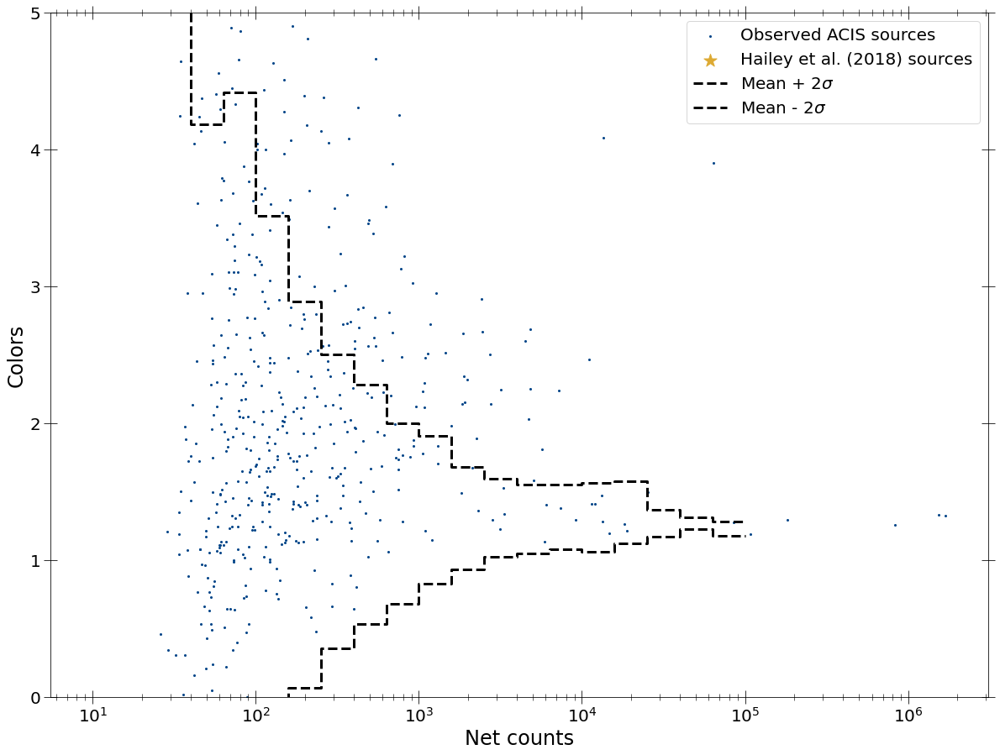

In [115]:
mark_interested_srcs(
    sim_msps_color_dict_arr[0], obs_color_dict_arr[0],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][0],
    ['208024101010012'])

In [ ]:
xmm_pl_fit_stats_table[:, 0][weird_srcs1]

38 42
[8.27433431e+05 3.25306748e+02 1.54909836e+06 9.30937683e+02
 1.58863119e+03 5.24215041e+02 2.47289002e+03 3.56404949e+02
 1.05083512e+03 4.55965172e+03 2.59580285e+03 1.98101933e+02
 6.98008071e+05 8.35669597e+05 3.82526060e+03 5.08046670e+02
 1.78589661e+03 1.66598236e+03 6.74794931e+03 5.61131847e+03
 4.72983720e+03 1.08634255e+03 6.49716743e+03 1.00667403e+04
 9.68052303e+03 3.31413939e+03 3.25223342e+03 1.51720675e+03
 3.45522010e+03 6.05058663e+03 1.10508604e+03 3.73787906e+03
 3.79266367e+03 5.93338721e+03 1.09611666e+03 2.81807943e+03
 1.81259416e+03 4.66010844e+04]
[1.25816899 2.20772806 1.33206013 1.83450376 1.84562065 3.38796813
 2.22111364 3.0056922  2.23607656 1.62550968 2.04234601 4.39430507
 1.24581514 1.26220922 1.37215936 1.67237243 1.20736846 1.41955054
 1.38468375 1.39302028 1.35421002 1.42889376 1.45959562 1.46371773
 1.40068623 1.30840135 1.40603889 1.42288466 1.44822347 1.370727
 1.28638249 1.41840981 1.27849658 1.34776386 1.6010584  1.2296128
 1.49219828 1.

(array([1.17020014, 5.93675537, 1.22208857, 2.92056194, 2.0155456 ,
        1.85484361, 1.70349927, 1.68774837, 2.32453631, 1.8480306 ,
        1.75956427, 1.76957264, 1.18305523, 1.16507283, 1.91196454,
        1.37794762, 1.39973939, 1.57019436, 1.40288384, 1.2673458 ,
        1.27398871, 1.58870831, 1.78469096, 1.35623192, 1.28816163,
        1.35976955, 1.11021475]),
 array([6.38461849e+05, 6.82667546e+01, 1.05063324e+06, 2.90929209e+02,
        5.15890819e+02, 4.69409693e+02, 6.08050646e+02, 3.79518144e+02,
        6.10406008e+02, 3.89799013e+03, 2.63325148e+02, 3.11323684e+02,
        4.26681773e+05, 6.57727498e+05, 4.43315778e+02, 3.59173456e+03,
        8.55982008e+02, 1.04125962e+03, 1.96869145e+03, 7.88675786e+02,
        4.60635406e+03, 5.37071969e+03, 8.10809761e+02, 4.98708915e+03,
        1.21886573e+04, 6.80034171e+03, 2.60338004e+05]))

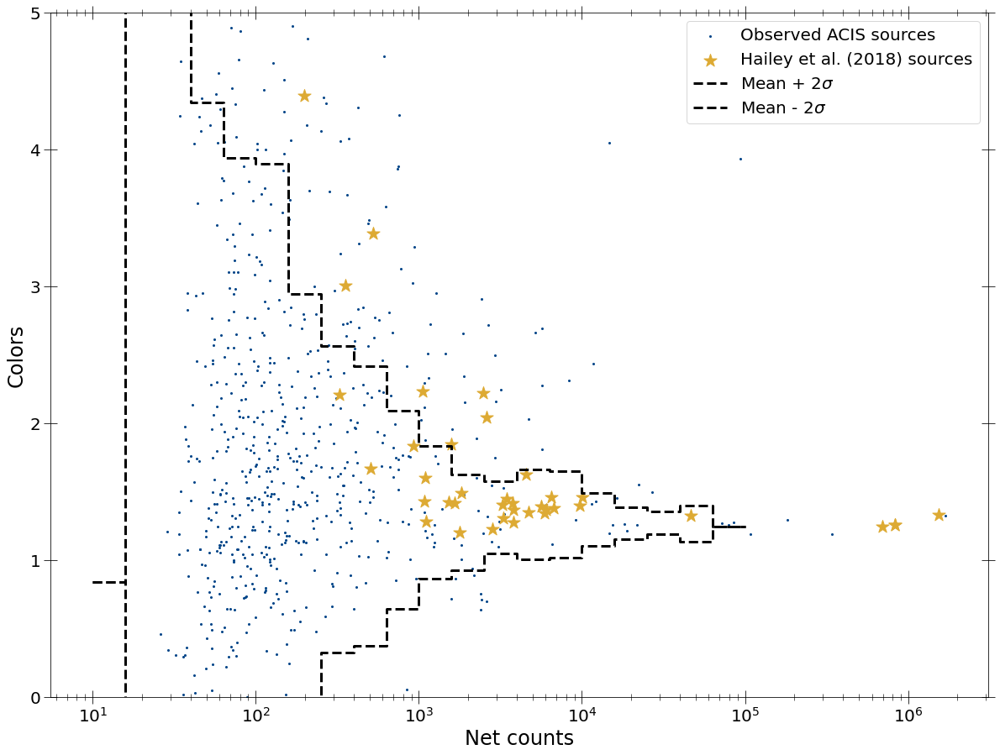

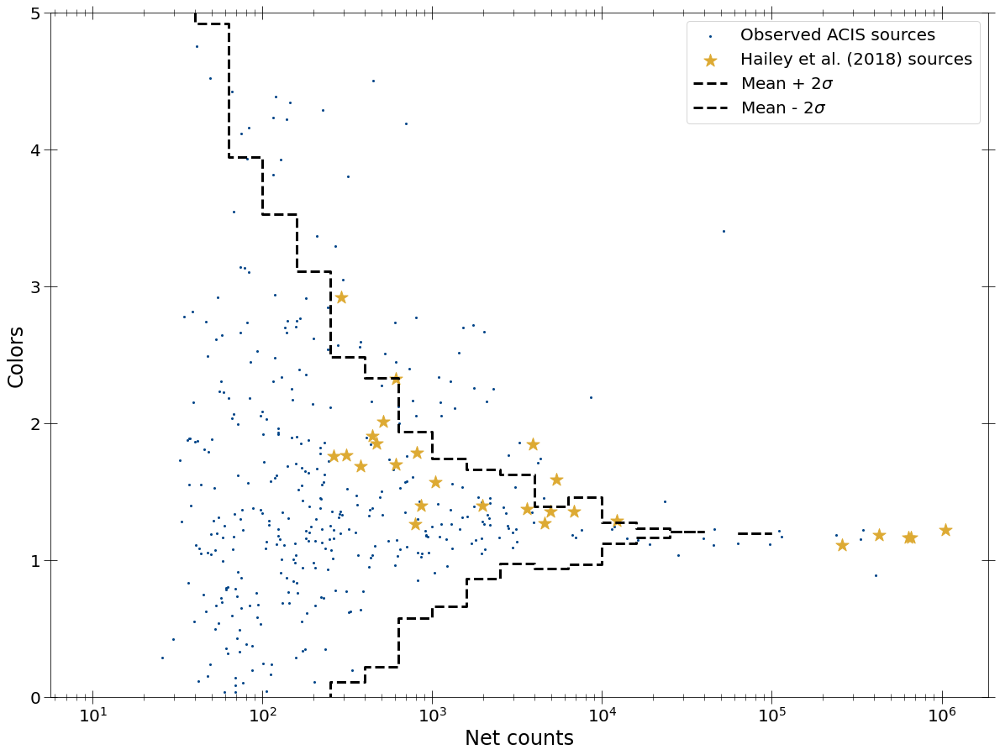

In [149]:
mark_interested_srcs(
    sim_msps_color_dict_arr[0], obs_color_dict_arr[0],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][0],
    xmm_pl_fit_stats_table[:, 0][weird_srcs1])
mark_interested_srcs(
    sim_msps_color_dict_arr[1], obs_color_dict_arr[1],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][1],
    xmm_pl_fit_stats_table[:, 0][weird_srcs1])

5 5
[ 159.66586281  677.92326981 1127.33959596  309.98665049  276.70697482]
[3.73690051 1.42771088 2.3166538  1.41798004 3.0309139 ]
4.0
16.0


(array([3.73690051, 1.42771088, 2.3166538 , 1.41798004, 3.0309139 ]),
 array([ 159.66586281,  677.92326981, 1127.33959596,  309.98665049,
         276.70697482]))

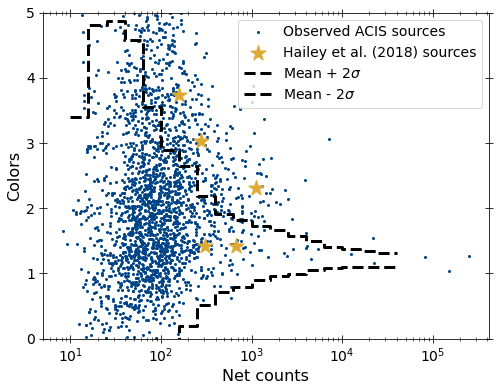

In [453]:
mark_interested_srcs(
    sim_msps_color_dict_arr[2], obs_color_dict_arr[2],
    spec_summary_msps['src_nums'][1], spec_summary_msps['spec_masks'][1][2],
    ['2CXOJ174540.4-290036', '2CXOJ174539.4-290041', '2CXOJ174539.4-290046',
     '2CXOJ174540.3-290049', '2CXOJ174539.2-290049'])

93 93
[3.51929452e+02 2.85294758e+02 2.89900690e+02 1.09565166e+03
 7.49243170e+02 3.12644354e+02 8.27433431e+05 4.52261804e+02
 7.92697065e+02 9.16992095e+03 4.85332639e+02 3.25306748e+02
 4.08206137e+02 1.54909836e+06 9.30937683e+02 1.30509508e+03
 7.50783940e+02 3.44820290e+02 8.85897224e+02 2.68595336e+02
 2.94651765e+02 8.47174487e+04 5.90666948e+03 1.05790469e+03
 2.13244824e+03 1.19903534e+04 7.22966675e+02 7.48358480e+02
 5.56503317e+02 2.65755643e+02 3.51924611e+02 3.40981312e+02
 4.40901747e+02 7.51555764e+02 4.88542554e+02 1.19954051e+03
 2.84365253e+02 4.05197362e+02 1.69089265e+06 5.13713407e+02
 1.31105171e+03 3.19667720e+02 6.01445394e+02 4.68829381e+02
 3.13135268e+03 2.77346210e+02 4.07644559e+02 3.33391841e+03
 1.47485721e+04 7.39442740e+03 7.81971454e+02 2.83556651e+03
 6.12303724e+02 7.11537338e+02 3.28184955e+02 1.33545956e+04
 3.77918079e+02 1.88093804e+04 3.41211238e+02 3.81976687e+02
 3.30856684e+03 1.82196024e+04 4.13804105e+02 3.98968838e+02
 2.92579328e+02 2.

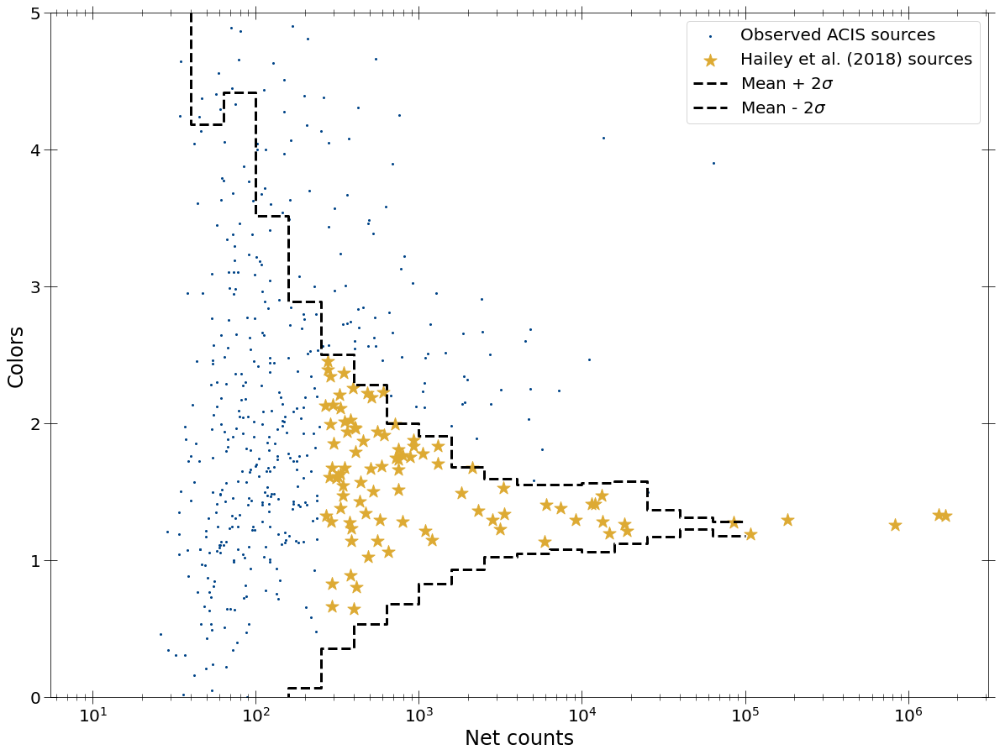

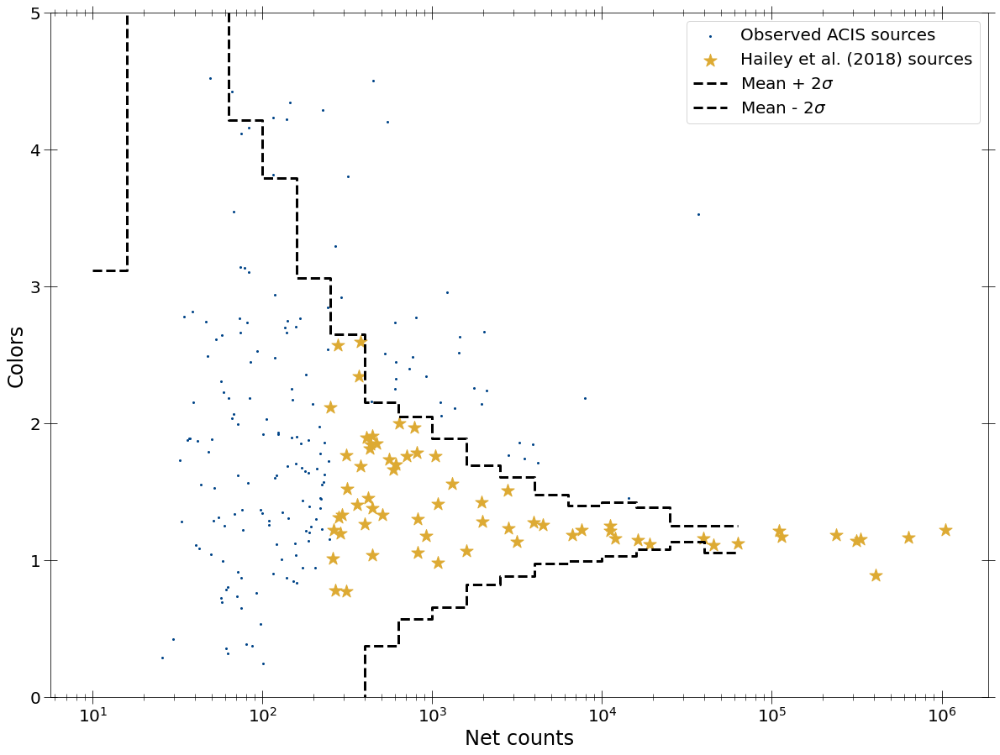

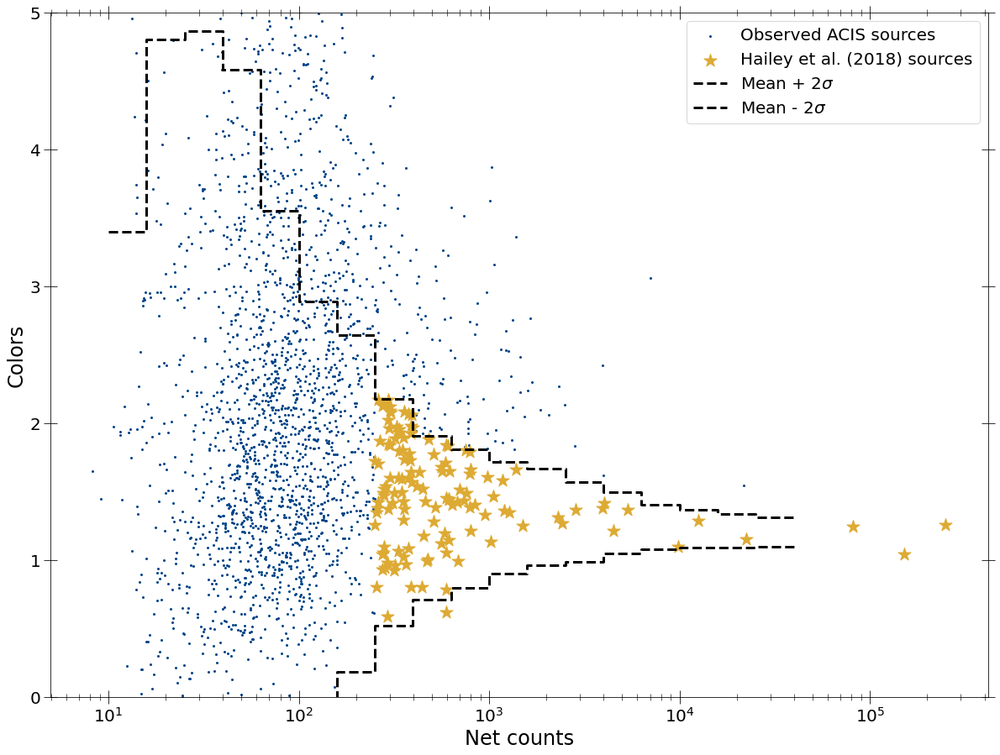

In [75]:
interested_msp_colors_pn, interested_msp_netcounts_pn = mark_interested_srcs(
    sim_msps_color_dict_arr[0], obs_color_dict_arr[0],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][0],
    interested_msp_srcs_alldet[0])
interested_msp_colors_mos, interested_msp_netcounts_mos = mark_interested_srcs(
    sim_msps_color_dict_arr[1], obs_color_dict_arr[1],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][1],
    interested_msp_srcs_alldet[1])
(interested_msp_colors_acis,
 interested_msp_netcounts_acis) = mark_interested_srcs(
    sim_msps_color_dict_arr[2], obs_color_dict_arr[2],
    spec_summary_msps['src_nums'][1], spec_summary_msps['spec_masks'][1][2],
    interested_msp_srcs_alldet[2])

In [76]:
interested_msps_xmm = np.array(
    list(set(interested_msp_srcs_alldet[0]) |
         set(interested_msp_srcs_alldet[1])))

In [77]:
np.sort(interested_msps_xmm)

array(['200305401010008', '200305401010017', '200305401015015',
       '201032613010001', '201032613010002', '201113501010069',
       '201113501010117', '201113503010004', '201129701010015',
       '201129701010027', '201129702010002', '201129702010014',
       '201129702010029', '201129702010049', '201129704010001',
       '201129704010010', '201129704010011', '201129704010012',
       '201129704010019', '201129704010023', '201129704010027',
       '201129704010040', '201129704010048', '201129704010049',
       '201129704010056', '201129705010002', '201129705010011',
       '201129705010014', '201129705010024', '201129705010038',
       '201129705010043', '201129705010076', '201129706010014',
       '201129707010002', '201129707010012', '201129707010014',
       '201129707010015', '201129707010020', '201129707010033',
       '201129707010046', '201129707010048', '201129707010057',
       '201129707010063', '201129708010014', '201129708010018',
       '201129709010001', '2011297090100

In [178]:
arr_to_str(np.array(interested_msps_xmm).astype(str), telescope='XMM')

'201129702010014; 206946401010004; 201032613010001; 202026708010061; 208042503010002; 206946405010002; 201129704010027; 207901804015015; 208860207010007; 207234103010048; 206556701010012; 207234105010051; 201129704010031; 202026707015146; 207234103010029; 205100104010001; 207483912010001; 201129704010056; 201129705010002; 201113501010148; 207234103015058; 201129709010018; 207234103010052; 207901804010036; 202026705010003; 207234103010028; 207234105010047; 201129704010023; 205049406010006; 201129702010029; 201129708010018; 202039301010054; 201129721010133; 204003401010013; 201129707010006; 207234104010053; 208016804010054; 201113501010206; 208024101010012; 207234103010053; 201129708010036; 201129721010009; 201529201010060; 207234104010131; 208624702010008; 201129701010015; 208016813010003; 207901804010045; 205110002015026; 207234104010059; 206586001010073; 201129705010043; 206946404010202; 201129707010012; 206735502010052; 202026707015110; 202026707010240; 207901804010019; 2003054010150

## Spectral analysis to check for lines

In [78]:
xspec.Xset.version

('2.0.4', '12.11.1')

In [79]:
def fit_src_pl(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder +
                                 str(source_num) + '_PN_combined_grp1*')
        spec_mosfile = glob2.glob(src_folder +
                                  str(source_num) + '_MOS_combined_grp1*')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        os.chdir(src_folder + '/' + source_num)
        spec_file = str(source_num) + '_combined_src_grp1.pi'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')

    model = xspec.Model('tbabs*pegpwrlw')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 10, 10]
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.perform()
    xspec.Fit.error('2.706 1')
    xspec.Fit.error('2.706 2')
    xspec.Fit.error('2.706 5')
    xspec.Fit.perform()
    # print('Calculating goodness')
    # goodness = xspec.Fit.goodness(1000)
    # print('Finished calculating goodness')
    goodness = 50.0
    print('Model params for ' + source_num +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0])
    print('Fit stats for ' + source_num + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    if telescope == 'Chandra':
        os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).TBabs.nH.error[0],
             xspec.AllModels(1).TBabs.nH.error[1],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.error[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.error[1],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).pegpwrlw.norm.error[0],
             xspec.AllModels(1).pegpwrlw.norm.error[1]])

52:80: E501 line too long (80 > 79 characters)


In [80]:
def fit_src_pl_gauss(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder +
                                 str(source_num) + '_PN_combined_grp1*')
        spec_mosfile = glob2.glob(src_folder +
                                  str(source_num) + '_MOS_combined_grp1*')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        os.chdir(src_folder + '/' + source_num)
        spec_file = str(source_num) + '_combined_src_grp1.pi'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')
    
    model = xspec.Model('tbabs*(pegpwrlw+gauss)')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 10, 10]
    model.pegpwrlw.eMin.values = '2.0'
    model.pegpwrlw.eMax.values = '10.0'
    model.gaussian.LineE.values = '6.7, 0.0001, 6.1, 6.1, 7.3, 7.3'
    model.gaussian.Sigma.values = '0.1 0'
    model.gaussian.norm.values = '1.0E-5, 0.001,,,,'
    
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.query = 'yes'
    xspec.Fit.perform()
    xspec.Fit.error('2.706 6')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 6')
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    # goodness = xspec.Fit.goodness(1000)
    goodness = 50.0
    line_pos_low = xspec.AllModels(1).gaussian.LineE.error[0]
    line_pos_high = xspec.AllModels(1).gaussian.LineE.error[1]
    line_norm_low = xspec.AllModels(1).gaussian.norm.error[0]
    line_norm_high = xspec.AllModels(1).gaussian.norm.error[1]
    print('Model params for ' + source_num +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0],
          ' Fe_pos:', xspec.AllModels(1).gaussian.LineE.values[0],
          line_pos_low, line_pos_high,
          ' Fe_norm:', xspec.AllModels(1).gaussian.norm.values[0],
          line_norm_low, line_norm_high)
    print('Fit stats for ' + source_num + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).gaussian.LineE.values[0], line_pos_low,
             line_pos_high,
             xspec.AllModels(1).gaussian.norm.values[0], line_norm_low,
             line_norm_high])


27:1: W293 blank line contains whitespace
36:1: W293 blank line contains whitespace
67:80: E501 line too long (80 > 79 characters)


In [81]:
def fit_src_pl_gauss2(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder +
                                 str(source_num) + '_PN_combined_grp1*')
        spec_mosfile = glob2.glob(src_folder +
                                  str(source_num) + '_MOS_combined_grp1*')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        os.chdir(src_folder + '/' + source_num)
        spec_file = str(source_num) + '_combined_src_grp1.pi'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')
    
    model = xspec.Model('tbabs*(pegpwrlw+gauss+gauss+gauss)')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    model.pegpwrlw.eMin.values = '2.0'
    model.pegpwrlw.eMax.values = '10.0'
    model.gaussian.LineE.values = '6.4 0'
    model.gaussian.Sigma.values = '0.0 0'
    model.gaussian.norm.values = '1.0E-5, 0.001,,,,'
    model.gaussian_4.LineE.values = '6.7 0'
    model.gaussian_4.Sigma.values = '0.0 0'
    model.gaussian_4.norm.values = '1.0E-5, 0.001,,,,'
    model.gaussian_5.LineE.values = '7.0 0'
    model.gaussian_5.Sigma.values = '0.0 0'
    model.gaussian_5.norm.values = '1.0E-5, 0.001,,,,'
    
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.query = 'yes'
    xspec.Fit.perform()
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 11')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 14')
    # xspec.Fit.error('2.706 8')
    # goodness = xspec.Fit.goodness(1000)
    goodness = 50.0
    line_norm1_low = xspec.AllModels(1).gaussian.norm.error[0]
    line_norm1_high = xspec.AllModels(1).gaussian.norm.error[1]
    line_norm2_low = xspec.AllModels(1).gaussian_4.norm.error[0]
    line_norm2_high = xspec.AllModels(1).gaussian_4.norm.error[1]
    line_norm3_low = xspec.AllModels(1).gaussian_5.norm.error[0]
    line_norm3_high = xspec.AllModels(1).gaussian_5.norm.error[1]
    xspec.Fit.perform()
    print('Model params for ' + source_num +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0],
          ' Fe_norms:', xspec.AllModels(1).gaussian.norm.values[0],
          line_norm1_low, line_norm1_high,
          xspec.AllModels(1).gaussian_4.norm.values[0], line_norm2_low,
          line_norm2_high, xspec.AllModels(1).gaussian_5.norm.values[0],
          line_norm3_low, line_norm3_high)
    print('Fit stats for ' + source_num + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).gaussian.norm.values[0],
             xspec.AllModels(1).gaussian_4.norm.values[0],
             xspec.AllModels(1).gaussian_5.norm.values[0], line_norm1_low,
             line_norm1_high, line_norm2_low, line_norm2_high, line_norm3_low,
             line_norm3_high])


27:1: W293 blank line contains whitespace
42:1: W293 blank line contains whitespace
76:80: E501 line too long (80 > 79 characters)


In [82]:
np.where(interested_msp_srcs_alldet[1] == '206946404010062')

(array([], dtype=int64),)

In [87]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/xmm_combined_goodobs2/')
xspec.AllData.clear()
fit_src_pl(interested_msp_srcs_alldet[1][0], src_folder='./')

Model params for 206556701010043: NH =  0.1000000000000056  Gamma:  0.9667793601576897  norm:  0.033337441399740354
Fit stats for 206556701010043:  320.69824010597995 -5.681413246685478 50.0 448




(['206556701010043', 320.69824010597995, -5.681413246685478, 50.0, 448],
 ['206556701010043',
  0.1000000000000056,
  0.0,
  7.704276567472862,
  0.9667793601576897,
  0.37894746045124905,
  3.0429137015272145,
  0.033337441399740354,
  0.02065111760798323,
  0.05440169835583382])

1:80: E501 line too long (90 > 79 characters)


In [86]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/chandra_obs_hard07/')
xspec.AllData.clear()
fit_src_pl(interested_msp_srcs_alldet[2][-1], src_folder='./', telescope='Chandra')

Model params for 2CXOJ174621.1-284343: NH =  23.855978309748885  Gamma:  0.8033917107726718  norm:  188.16904496763905
Fit stats for 2CXOJ174621.1-284343:  10556.325781206078 -11.348492012503105 50.0 546




(['2CXOJ174621.1-284343', 10556.325781206078, -11.348492012503105, 50.0, 546],
 ['2CXOJ174621.1-284343',
  23.855978309748885,
  23.708109465576882,
  24.169081449405244,
  0.8033917107726718,
  0.7751607103108464,
  0.8334387875646728,
  188.16904496763905,
  186.85329442538486,
  189.56112318480425])

1:80: E501 line too long (87 > 79 characters)


In [88]:
pn_fit_stats_table_pl = []
pn_model_params_table_pl = []

for source_num in interested_msp_srcs_alldet[0]:
    print(source_num)
    fit_stats, model_params = fit_src_pl(source_num)
    pn_fit_stats_table_pl.append(fit_stats)
    pn_model_params_table_pl.append(model_params)

200305401010008
Model params for 200305401010008: NH =  9.344266850740842  Gamma:  0.19410776418555548  norm:  0.17774265248212534
Fit stats for 200305401010008:  502.2244488199891 -7.2470573524284605 50.0 633


200305401010017
Model params for 200305401010017: NH =  18.940898825031958  Gamma:  1.5812179425340092e-06  norm:  0.1574956868319943
Fit stats for 200305401010017:  462.2932653779947 -6.731047035872305 50.0 479


200305401015015
Model params for 200305401015015: NH =  5.699741015035504  Gamma:  0.5907400423749906  norm:  0.18491706635106686
Fit stats for 200305401015015:  502.534912686133 -7.749811635856098 50.0 642


201113501010117
Model params for 201113501010117: NH =  12.026505285275489  Gamma:  1.2626293608827292e-06  norm:  0.15075617068904842
Fit stats for 201113501010117:  919.0031813474097 -6.432216099340522 50.0 1148


201129702010029
Model params for 201129702010029: NH =  9.13744491881735  Gamma:  1.6774055253705132e-06  norm:  0.0895773021507274
Fit stats for 201

Model params for 201129715010041: NH =  45.93584848733848  Gamma:  0.8375490568407341  norm:  0.20787467924340983
Fit stats for 201129715010041:  1076.9762453036049 -7.290713183172445 50.0 1269


201129715010042
Model params for 201129715010042: NH =  30.06968390555543  Gamma:  1.2506635335816074  norm:  0.16336063784048913
Fit stats for 201129715010042:  821.9804406619246 -5.6422834536431745 50.0 984


201129719010009
Model params for 201129719010009: NH =  57.16612166210601  Gamma:  0.09555973259713901  norm:  2.001436772732363
Fit stats for 201129719010009:  646.4999372983576 -7.983339063712159 50.0 792


201129721010070
Model params for 201129721010070: NH =  33.324011693093894  Gamma:  2.606366467513078e-07  norm:  0.1314219018004002
Fit stats for 201129721010070:  1368.7909915515497 -6.0149069813111655 50.0 1539


204003401010003
Model params for 204003401010003: NH =  7.891529877360033  Gamma:  0.3375930434028259  norm:  0.5894810864168698
Fit stats for 204003401010003:  660.882

Model params for 201129702010002: NH =  22.999787096052852  Gamma:  1.807058105064231  norm:  3.188112295242353
Fit stats for 201129702010002:  2973.9724665524027 -7.046178633202411 50.0 2981


201129721010044
Model params for 201129721010044: NH =  14.130945720140897  Gamma:  0.9331952660334958  norm:  0.28275958782208827
Fit stats for 201129721010044:  2437.3068566669435 -7.47067227174628 50.0 2485


201129706010014
Model params for 201129706010014: NH =  12.84561195098783  Gamma:  1.1121084260986314  norm:  0.42289799109459364
Fit stats for 201129706010014:  3633.4612798113726 -5.794121757094311 50.0 3170


201129721010003
Model params for 201129721010003: NH =  12.125075332867503  Gamma:  1.4198908264336942  norm:  1.5212841083650295
Fit stats for 201129721010003:  6060.841133867034 -4.498763404853364 50.0 3105


201442201010001
Model params for 201442201010001: NH =  12.570873530369173  Gamma:  1.9258287230459552  norm:  5.908662233656203
Fit stats for 201442201010001:  2974.03715

In [89]:
pn_fit_stats_table_pl_g = []
pn_model_params_table_pl_g = []
pn_fit_stats_table_pl_g2 = []
pn_model_params_table_pl_g2 = []

for source_num in interested_msp_srcs_alldet[0]:
    print(source_num)
    fit_stats, model_params = fit_src_pl_gauss(source_num)
    fit_stats2, model_params2 = fit_src_pl_gauss2(source_num)
    pn_fit_stats_table_pl_g.append(fit_stats)
    pn_model_params_table_pl_g.append(model_params)
    pn_fit_stats_table_pl_g2.append(fit_stats2)
    pn_model_params_table_pl_g2.append(model_params2)

200305401010008
Model params for 200305401010008: NH =  9.410836668716426  Gamma:  0.31316429628305037  norm:  0.1682937324065252  Fe_pos: 6.679061382304389 0.0 0.0  Fe_norm: 4.914938239077425e-07 0.0 1.1220576072478822e-06
Fit stats for 200305401010008:  499.9877717445126 -7.381164157317857 50.0 631


Model params for 200305401010008: NH =  9.946547867151342  Gamma:  0.3908724547127917  norm:  0.16758792040410508  Fe_norms: 2.9399486915566293e-12 0.0 3.785411496372471e-07 4.063090036987953e-07 0.0 9.137043201791979e-07 2.391594001222694e-07 0.0 7.733016261669386e-07
Fit stats for 200305401010008:  499.0322629449573 -7.437809985037863 50.0 630


200305401010017
Model params for 200305401010017: NH =  14.52312604998171  Gamma:  9.021123871804771e-05  norm:  0.13152636114870503  Fe_pos: 6.750578916219702 6.666456797029645 6.833324050885356  Fe_norm: 8.014779734442652e-07 4.046797157526311e-07 1.2765232316456662e-06
Fit stats for 200305401010017:  451.1779236122285 -6.625687125008758 50.0

Model params for 201129712010002: NH =  3.321072971397203  Gamma:  1.2988314471647782  norm:  0.17432004931492534  Fe_pos: 6.685384348519703 6.4216230864349875 6.944851969021225  Fe_norm: 6.870056586135963e-07 7.010319075017865e-08 1.4467541885019446e-06
Fit stats for 201129712010002:  313.3716012088909 -6.755677912309411 50.0 448


Model params for 201129712010002: NH =  3.5856939504563283  Gamma:  1.3785643060641275  norm:  0.17251545877025762  Fe_norms: 1.880885429240101e-07 0.0 7.187931035732182e-07 5.427766083931108e-07 5.2439806382148016e-08 1.169016797643922e-06 1.9379614796658564e-07 0.0 7.849821752818813e-07
Fit stats for 201129712010002:  312.71718712501297 -6.765426485813727 50.0 447


201129719010007
Model params for 201129719010007: NH =  5.5377824741635315  Gamma:  1.9697954935749322e-05  norm:  0.45437730875000965  Fe_pos: 6.4227007713285165 6.334931058717694 6.5132077632371175  Fe_norm: 2.0620480548805665e-06 9.69050049366608e-07 3.291114956780158e-06
Fit stats for 2011

Model params for 206946410010178: NH =  7.854207589562675  Gamma:  0.894576061850593  norm:  0.08132735340201148  Fe_pos: 7.032296750322455 0.0 0.0  Fe_norm: 1.4333999116361332e-08 0.0 3.266199508037429e-07
Fit stats for 206946410010178:  518.9586949372285 -8.325896684315683 50.0 674


Model params for 206946410010178: NH =  8.007020669600154  Gamma:  0.9327153243933888  norm:  0.08096595446536593  Fe_norms: 1.8906905108421444e-15 0.0 8.633060007751529e-08 1.0330744043479698e-09 0.0 2.3438434507705652e-07 6.142954547794107e-08 0.0 3.0890609724153823e-07
Fit stats for 206946410010178:  518.7696747316327 -8.314830475164527 50.0 673


208016803010003
Model params for 208016803010003: NH =  6.4521140209011385  Gamma:  1.324533633368729  norm:  0.3119208591315053  Fe_pos: 6.258466002964441 0.0 0.0  Fe_norm: 6.248527154166212e-07 0.0 1.451054229563465e-06
Fit stats for 208016803010003:  626.817677761907 -6.646708712622853 50.0 771


Model params for 208016803010003: NH =  6.2085511039356955 

Model params for 201129707010057: NH =  21.434819981640096  Gamma:  0.3427167691656333  norm:  0.1955183199717513  Fe_pos: 7.3 0.0 0.0  Fe_norm: 3.6685338222592107e-07 0.0 9.328082341622533e-07
Fit stats for 201129707010057:  579.7370733928215 -6.810428573185448 50.0 738


Model params for 201129707010057: NH =  19.798041509192736  Gamma:  0.1387486132804595  norm:  0.19732214271118867  Fe_norms: 5.0840338024915434e-17 0.0 1.2462031840540834e-07 1.5309350095670119e-18 0.0 2.2291476906777176e-07 3.822562212421026e-17 0.0 1.9764865064112848e-07
Fit stats for 201129707010057:  581.4976528837147 -6.948595836688409 50.0 737


201129708010018
Model params for 201129708010018: NH =  24.593156833570845  Gamma:  0.7447693049564779  norm:  0.45173709327489325  Fe_pos: 6.712459620874066 6.554953423258761 6.897006261331803  Fe_norm: 9.78848519612186e-07 2.2628683418426e-07 1.8228495954108933e-06
Fit stats for 201129708010018:  708.932785941752 -6.094039580623275 50.0 839


Model params for 2011297

Model params for 208016813010003: NH =  6.951152694332541  Gamma:  1.8606012578069824  norm:  0.2498195847448299  Fe_pos: 6.922400232207302 6.681621493453794 0.0  Fe_norm: 3.8879611945578424e-07 0.0 9.172382262747876e-07
Fit stats for 208016813010003:  607.318719084682 -5.654514873657285 50.0 761


Model params for 208016813010003: NH =  6.9252681405134435  Gamma:  1.8467065434727923  norm:  0.2504475939112918  Fe_norms: 3.507820249069174e-08 0.0 4.2636647493549627e-07 4.60828457080729e-23 0.8224962005991274 0.0 2.6313954919845465e-07 0.0 7.160066686078557e-07
Fit stats for 208016813010003:  608.3058280307713 -5.654245607839032 50.0 760


208251401010006
Model params for 208251401010006: NH =  9.758029216320482  Gamma:  0.26254914272139496  norm:  0.22256758526972012  Fe_pos: 6.79603486165437 6.696964504080794 6.887590702476633  Fe_norm: 1.0310878445351054e-06 5.876885774272759e-07 1.5206873734373425e-06
Fit stats for 208251401010006:  868.0245187031649 -6.282916205221645 50.0 1154


M

Model params for 201129721010057: NH =  14.261492595497916  Gamma:  3.0193625696885027  norm:  0.09311004095174731  Fe_norms: 9.705395534839943e-17 0.0 5.2532402300915495e-08 1.3844106267709817e-17 0.0 5.9211527044345476e-08 2.0084848029982808e-20 0.0 7.017506281635514e-08
Fit stats for 201129721010057:  2513.846274876385 -4.58510798323755 50.0 2695


201129721010133
Model params for 201129721010133: NH =  2.8129803713666384  Gamma:  2.1393737679048586e-06  norm:  0.13155450864576837  Fe_pos: 6.6047615685824805 0.0 0.0  Fe_norm: 2.5764323280418896e-07 0.0 6.114981471801832e-07
Fit stats for 201129721010133:  856.1036213947317 -7.469501223153581 50.0 1033


Model params for 201129721010133: NH =  2.8379516107884104  Gamma:  1.3258561234411268e-06  norm:  0.13191805341684867  Fe_norms: 5.3595355813060125e-08 0.0 3.251844120701433e-07 1.810590971901795e-07 0.0 4.784864184441253e-07 6.625907899823481e-09 0.0 3.059104097059579e-07
Fit stats for 201129721010133:  856.4335835175076 -7.4706315

Model params for 208860107010001: NH =  13.953729790578471  Gamma:  1.8601476735342088  norm:  3.731111658341462  Fe_pos: 6.501197716518862 6.338086796117543 6.640640022827582  Fe_norm: 2.9968117364864024e-06 7.979780064124028e-07 5.324325701194428e-06
Fit stats for 208860107010001:  1708.2354172297983 -8.89482096274707 50.0 2042


Model params for 208860107010001: NH =  13.917702803826787  Gamma:  1.8482482352346543  norm:  3.7334974035956345  Fe_norms: 1.5450651057675325e-06 0.0 3.3117591118591068e-06 7.341409095474529e-07 0.0 2.440276707879393e-06 1.6909786066053195e-21 0.0 5.965059375443963e-07
Fit stats for 208860107010001:  1710.6999889994395 -8.895373923804147 50.0 2041


201129719010003
Model params for 201129719010003: NH =  9.174319105210367  Gamma:  0.9258577970350259  norm:  2.3218884874583527  Fe_pos: 6.303290095853766 0.0 6.5178142261025656  Fe_norm: 1.7149819813056904e-06 2.9569247476622304e-07 3.2125446594921643e-06
Fit stats for 201129719010003:  2222.9143468999464 -9.

Model params for 205547504010002: NH =  15.207347458486392  Gamma:  1.839311626383599  norm:  4.449414654819969  Fe_pos: 6.642731900916781 6.603737060641102 6.682175244926564  Fe_norm: 5.594789408388735e-06 4.483305807931598e-06 6.732749735708562e-06
Fit stats for 205547504010002:  3673.5574654682237 -6.136644548178457 50.0 3032


Model params for 205547504010002: NH =  15.286657583605619  Gamma:  1.8664243881307745  norm:  4.442648661042565  Fe_norms: 2.132898918043812e-06 1.3354200122725254e-06 2.956176905656626e-06 3.8127153063183995e-06 2.9305120890444238e-06 4.722138563106213e-06 1.735151832160581e-06 9.456582565040027e-07 2.5542190058462777e-06
Fit stats for 205547504010002:  3663.3741658610606 -6.137824324749194 50.0 3031


208441011010001
Model params for 208441011010001: NH =  22.097892557625624  Gamma:  1.0190726721991168  norm:  16.301237398215893  Fe_pos: 6.30407978513899 0.0 0.0  Fe_norm: 2.9134331015998044e-06 0.0 7.693246407985344e-06
Fit stats for 208441011010001:  2719

In [90]:
mos_fit_stats_table_pl = []
mos_model_params_table_pl = []

for source_num in interested_msp_srcs_alldet[1]:
    print(source_num)
    fit_stats, model_params = fit_src_pl(source_num)
    mos_fit_stats_table_pl.append(fit_stats)
    mos_model_params_table_pl.append(model_params)

206556701010043
Model params for 206556701010043: NH =  0.1000000000000056  Gamma:  0.9667793601576897  norm:  0.033337441399740354
Fit stats for 206556701010043:  320.69824010597995 -5.681413246685478 50.0 448


201129704010012
Model params for 201129704010012: NH =  110.3143901977443  Gamma:  2.367579273774067  norm:  0.9002050633214838
Fit stats for 201129704010012:  1333.2128726385076 -5.894537744400775 50.0 1625


201129705010043
Model params for 201129705010043: NH =  34.69654351140442  Gamma:  1.740127533145777  norm:  0.6107133354696577
Fit stats for 201129705010043:  1031.4045621391333 -5.763405917320883 50.0 1284


201129707010015
Model params for 201129707010015: NH =  36.13815470800494  Gamma:  1.2453581465582617  norm:  0.37355858168678246
Fit stats for 201129707010015:  690.9966596640304 -4.975366394197228 50.0 752


201129708010018
Model params for 201129708010018: NH =  25.288861990710828  Gamma:  0.6835314563373946  norm:  0.4759158681424192
Fit stats for 2011297080100

Model params for 201129721010060: NH =  15.388051388340019  Gamma:  1.7039157748176252  norm:  0.17847949390253717
Fit stats for 201129721010060:  2417.487837454978 -9.264277626764198 50.0 2558


203028831010002
Model params for 203028831010002: NH =  36.26798682047143  Gamma:  1.9569569239303553  norm:  2.972955768093994
Fit stats for 203028831010002:  2280.1644752658303 -5.25126745669563 50.0 2259


208860107010001
Model params for 208860107010001: NH =  13.811211130607296  Gamma:  1.8107303128986991  norm:  3.744627228241707
Fit stats for 208860107010001:  1713.359260452791 -8.897809808935442 50.0 2044


201129705010011
Model params for 201129705010011: NH =  7.611611220015798  Gamma:  1.2456149380464072  norm:  0.47196006360061943
Fit stats for 201129705010011:  3101.939263138889 -5.647962958699698 50.0 2881


201129719010003
Model params for 201129719010003: NH =  9.123261728824223  Gamma:  0.8970204313879763  norm:  2.347628588545309
Fit stats for 201129719010003:  2226.899495054

In [91]:
mos_fit_stats_table_pl_g = []
mos_model_params_table_pl_g = []
mos_fit_stats_table_pl_g2 = []
mos_model_params_table_pl_g2 = []

for source_num in interested_msp_srcs_alldet[1]:
    print(source_num)
    fit_stats, model_params = fit_src_pl_gauss(source_num)
    fit_stats2, model_params2 = fit_src_pl_gauss2(source_num)
    mos_fit_stats_table_pl_g.append(fit_stats)
    mos_model_params_table_pl_g.append(model_params)
    mos_fit_stats_table_pl_g2.append(fit_stats2)
    mos_model_params_table_pl_g2.append(model_params2)

206556701010043
Model params for 206556701010043: NH =  0.1  Gamma:  1.2617939113972458  norm:  0.027650143219477948  Fe_pos: 6.4445473726969045 6.217669686012193 6.694955051108191  Fe_norm: 4.62964503865472e-07 1.8737942822974002e-08 1.0239672684288125e-06
Fit stats for 206556701010043:  317.7382366536512 -5.7849819273089675 50.0 446


Model params for 206556701010043: NH =  0.1  Gamma:  1.2416793955394927  norm:  0.027963468217106  Fe_norms: 2.8371056716499094e-07 0.0 7.340219593652709e-07 2.4123170083782753e-08 0.0 4.4994481668696057e-07 2.1364999622954444e-07 0.0 7.266981144282322e-07
Fit stats for 206556701010043:  318.18621537500064 -5.945385461075362 50.0 445


201129704010012
Model params for 201129704010012: NH =  67.40202981962098  Gamma:  1.568126394758115  norm:  0.31608320825999153  Fe_pos: 6.710438407025625 6.631827740879939 6.789493648256835  Fe_norm: 1.3884174903446258e-06 8.669829219476835e-07 2.08430656572099e-06
Fit stats for 201129704010012:  1316.4386796909466 -5.9

Model params for 201529201015014: NH =  8.919836198378542  Gamma:  1.4610100732538522  norm:  0.284701105148198  Fe_norms: 5.704984234833475e-07 1.4094000921649217e-07 1.1071642143638008e-06 2.1278165410909312e-19 0.0 2.8729441217947653e-07 1.7960875423184736e-20 0.0 2.6622074979596144e-07
Fit stats for 201529201015014:  561.0540883900724 -6.811470239399979 50.0 639


204003401010007
Model params for 204003401010007: NH =  5.708784841226618  Gamma:  0.894208937763764  norm:  0.09635804466068495  Fe_pos: 7.299999999377053 0.0 0.0  Fe_norm: 7.519392032225758e-08 0.0 4.2832859325743126e-07
Fit stats for 204003401010007:  1141.5054008839304 -8.163004394932992 50.0 1385


Model params for 204003401010007: NH =  5.3713442984749875  Gamma:  0.8148623838385775  norm:  0.09727863008807476  Fe_norms: 5.27891979428968e-17 0.0 6.137460808672664e-08 1.424923389080774e-15 0.0 1.7240443275140485e-07 8.994342811694043e-18 0.0 2.1506342076519936e-07
Fit stats for 204003401010007:  1141.666614139399 -8.

Model params for 208016803010001: NH =  5.477438247722109  Gamma:  0.7910695804625593  norm:  0.6112963494070606  Fe_pos: 6.47529835813703 6.35485643721511 6.611925243433143  Fe_norm: 1.348419485181248e-06 3.689821193491286e-07 2.4614583841749452e-06
Fit stats for 208016803010001:  986.3285668155654 -7.282235643893765 50.0 1131


Model params for 208016803010001: NH =  5.48781604701821  Gamma:  0.7931337506494637  norm:  0.6112456636865169  Fe_norms: 1.0077959634415707e-06 2.1164269618709708e-07 1.915317598044249e-06 3.5742661731368304e-07 0.0 1.214337076209289e-06 4.0530660117380934e-16 0.0 6.551420174748969e-07
Fit stats for 208016803010001:  986.6303378150919 -7.280170325829499 50.0 1130


208251401010006
Model params for 208251401010006: NH =  9.758029216320482  Gamma:  0.26254914272139496  norm:  0.22256758526972012  Fe_pos: 6.79603486165437 6.696964504080794 6.887590702476633  Fe_norm: 1.0310878445351054e-06 5.876885774272759e-07 1.5206873734373425e-06
Fit stats for 2082514010100

Model params for 208441011010002: NH =  11.806368411013382  Gamma:  1.085567544629857  norm:  4.246581151539036  Fe_norms: 7.314885307715923e-06 4.282940622181431e-06 1.0646434807056477e-05 3.430296072998499e-06 6.236798356391798e-07 6.569051265562414e-06 2.9534978105657825e-06 0.0 6.281314925039318e-06
Fit stats for 208441011010002:  1425.3039494959967 -6.7314962635024385 50.0 1622


201032613010002
Model params for 201032613010002: NH =  5.509692745397477  Gamma:  0.5010087064397879  norm:  0.7657151050641722  Fe_pos: 6.377262974154401 0.0 0.0  Fe_norm: 4.724456410460944e-07 0.0 1.4494463809944672e-06
Fit stats for 201032613010002:  1255.1870109771667 -7.641423375926952 50.0 1558


Model params for 201032613010002: NH =  5.4795194584427644  Gamma:  0.48856638576631145  norm:  0.7695027365772711  Fe_norms: 2.370847212234389e-07 0.0 1.0043329118968852e-06 3.069095925908226e-13 0.0 5.934356294095907e-07 3.191799268822826e-08 0.0 8.962516387425371e-07
Fit stats for 201032613010002:  1255

Model params for 205100104010001: NH =  28.603175025971908  Gamma:  1.064060446973831  norm:  17.08664643488982  Fe_norms: 7.737015150084548e-06 3.379614222266683e-06 1.2300478984483272e-05 9.531739493495899e-12 0.0 4.145043519758067e-06 2.2057399434647857e-06 0.0 6.67536705198579e-06
Fit stats for 205100104010001:  2520.0748018956733 -9.692147343785626 50.0 2694


201129702010002
Model params for 201129702010002: NH =  23.252986452193802  Gamma:  1.842899590790418  norm:  3.213507057176625  Fe_pos: 7.3 6.693199368285014 0.0  Fe_norm: 1.0418874610296678e-06 5.235842889560212e-08 2.0794942062321058e-06
Fit stats for 201129702010002:  2970.9722359329726 -7.04808635255607 50.0 2979


Model params for 201129702010002: NH =  23.051328354731712  Gamma:  1.8217126647154127  norm:  3.1887594552422813  Fe_norms: 4.261606340141605e-09 0.0 6.545145224090415e-07 2.693211074569713e-07 0.0 9.363494123971593e-07 3.235654648745383e-07 0.0 9.85631056476425e-07
Fit stats for 201129702010002:  2972.85507

Model params for 201129704010001: NH =  28.824993761847313  Gamma:  1.5241895160892978  norm:  240.35194384317094  Fe_norms: 1.643277245239836e-05 1.2788884022106574e-05 2.0091424979742432e-05 8.684675693830759e-06 5.034791073478998e-06 1.2347646401259795e-05 3.5776154542057932e-06 0.0 7.289608832934811e-06
Fit stats for 201129704010001:  6829.582259130538 -11.433235761000093 50.0 3192


201129709010001
Model params for 201129709010001: NH =  20.160945493272433  Gamma:  1.4625351029592384  norm:  338.8111084553825  Fe_pos: 6.947811549899487 6.83950680391611 7.032809577460552  Fe_norm: 1.3799883807102694e-05 6.337823978394999e-06 2.2144254257584344e-05
Fit stats for 201129709010001:  21266.64233185489 -8.223360033936837 50.0 3193


Model params for 201129709010001: NH =  20.15987608208921  Gamma:  1.4628186993583017  norm:  338.7569105972193  Fe_norms: 1.536962266274019e-15 0.0 9.374822239695763e-07 5.118628061669186e-06 0.0 1.1147686972086906e-05 1.1925817389727321e-05 5.81556657394583

In [33]:
acis_fit_stats_table_pl = []
acis_model_params_table_pl = []

for source_num in interested_msp_srcs_alldet[2]:
    print(source_num)
    fit_stats, model_params = fit_src_pl(source_num, src_folder='.', telescope='Chandra')
    acis_fit_stats_table_pl.append(fit_stats)
    acis_model_params_table_pl.append(model_params)

2CXOJ174454.1-285841
Model params for 2CXOJ174454.1-285841: NH =  8.296611124691674  Gamma:  0.5544722436927508  norm:  0.5907146270662572
Fit stats for 2CXOJ174454.1-285841:  194.79721722750287 -9.582790212665058 50.0 244


2CXOJ174508.6-285652
Model params for 2CXOJ174508.6-285652: NH =  26.527858789840458  Gamma:  1.7874020954159324  norm:  0.04434379347879459
Fit stats for 2CXOJ174508.6-285652:  303.0851279703122 -5.976507296253907 50.0 352


2CXOJ174508.7-290325
Model params for 2CXOJ174508.7-290325: NH =  9.625715918498774  Gamma:  1.0483346327578453  norm:  0.018877648010863314
Fit stats for 2CXOJ174508.7-290325:  354.78258701503967 -8.214593416818017 50.0 386


2CXOJ174512.3-285901
Model params for 2CXOJ174512.3-285901: NH =  3.1643613895027713  Gamma:  1.9826273875842662e-05  norm:  0.017510524662329635
Fit stats for 2CXOJ174512.3-285901:  342.06412199928405 -8.350823506034928 50.0 364


2CXOJ174513.0-290229
Model params for 2CXOJ174513.0-290229: NH =  51.224982018227585  Gamm

Model params for 2CXOJ174542.3-285606: NH =  116.89830844674228  Gamma:  0.45941724758525326  norm:  0.20897910084974505
Fit stats for 2CXOJ174542.3-285606:  221.01823435827424 -6.9955568059078885 50.0 301


2CXOJ174543.2-290146
Model params for 2CXOJ174543.2-290146: NH =  19.238310602853012  Gamma:  0.20763572831150193  norm:  0.025604444536269148
Fit stats for 2CXOJ174543.2-290146:  187.42501408978052 -8.807035922675105 50.0 287


2CXOJ174544.2-285918
Model params for 2CXOJ174544.2-285918: NH =  28.869397993212644  Gamma:  2.0873214111179643  norm:  0.07403898416550714
Fit stats for 2CXOJ174544.2-285918:  199.46431570246492 -9.903757572432777 50.0 255


2CXOJ174546.2-285426
Model params for 2CXOJ174546.2-285426: NH =  25.995758257944814  Gamma:  1.7121571604252237  norm:  0.05502590701411452
Fit stats for 2CXOJ174546.2-285426:  336.09249732575427 -7.263706587277904 50.0 337


2CXOJ174546.6-290328
Model params for 2CXOJ174546.6-290328: NH =  23.65911385677999  Gamma:  0.60929427707519

Model params for 2CXOJ174538.1-290047: NH =  39.38240692941962  Gamma:  1.560664475437099  norm:  0.06732096910919147
Fit stats for 2CXOJ174538.1-290047:  264.9772283236659 -9.394535405740138 50.0 307


2CXOJ174538.8-290027
Model params for 2CXOJ174538.8-290027: NH =  27.92830026957567  Gamma:  1.390994962684148  norm:  0.03458513142677155
Fit stats for 2CXOJ174538.8-290027:  289.5519473807085 -8.323558007357724 50.0 364


2CXOJ174538.8-290056
Model params for 2CXOJ174538.8-290056: NH =  43.70876606731095  Gamma:  2.1246255617027336  norm:  0.06976485019055946
Fit stats for 2CXOJ174538.8-290056:  283.011651687275 -7.872500868962006 50.0 330


2CXOJ174540.2-290042
Model params for 2CXOJ174540.2-290042: NH =  30.912383013864893  Gamma:  1.6550659656338378  norm:  0.07131423273575373
Fit stats for 2CXOJ174540.2-290042:  292.9335153528708 -9.151170813244518 50.0 337


2CXOJ174540.3-290005
Model params for 2CXOJ174540.3-290005: NH =  21.23385144794941  Gamma:  1.7901819319251295  norm:  0.0

Model params for 2CXOJ174539.8-285901: NH =  14.577083294503675  Gamma:  0.8089810917909377  norm:  0.04503311732113138
Fit stats for 2CXOJ174539.8-285901:  398.465229539206 -8.929981354305799 50.0 393


2CXOJ174544.4-285935
Model params for 2CXOJ174544.4-285935: NH =  19.181784914816497  Gamma:  2.030905433538738  norm:  0.10226708908155557
Fit stats for 2CXOJ174544.4-285935:  373.49415585550776 -9.557314366543588 50.0 384


2CXOJ174546.2-285906
Model params for 2CXOJ174546.2-285906: NH =  8.110742489410821  Gamma:  0.31481541706085575  norm:  0.06286290112496144
Fit stats for 2CXOJ174546.2-285906:  437.24961401474786 -9.089596970638683 50.0 406


2CXOJ174548.1-285347
Model params for 2CXOJ174548.1-285347: NH =  20.39970614572691  Gamma:  0.836545622436772  norm:  0.08196159827128717
Fit stats for 2CXOJ174548.1-285347:  387.50441314647935 -9.913228675270297 50.0 458


2CXOJ174555.5-285633
Model params for 2CXOJ174555.5-285633: NH =  15.517513171722753  Gamma:  1.6155755708163926  norm

6:80: E501 line too long (89 > 79 characters)


Model params for 2CXOJ174621.1-284343: NH =  23.855978309748885  Gamma:  0.8033917107726718  norm:  188.16904496763905
Fit stats for 2CXOJ174621.1-284343:  10556.325781206078 -11.348492012503105 50.0 546




In [34]:
acis_fit_stats_table_pl_g = []
acis_model_params_table_pl_g = []
acis_fit_stats_table_pl_g2 = []
acis_model_params_table_pl_g2 = []

for source_num in interested_msp_srcs_alldet[2]:
    print(source_num)
    fit_stats, model_params = fit_src_pl_gauss(source_num, src_folder='.', telescope='Chandra')
    fit_stats2, model_params2 = fit_src_pl_gauss2(source_num, src_folder='.', telescope='Chandra')
    acis_fit_stats_table_pl_g.append(fit_stats)
    acis_model_params_table_pl_g.append(model_params)
    acis_fit_stats_table_pl_g2.append(fit_stats2)
    acis_model_params_table_pl_g2.append(model_params2)

2CXOJ174454.1-285841
Model params for 2CXOJ174454.1-285841: NH =  9.045448360842125  Gamma:  0.8069325978735286  norm:  0.5477265919936185  Fe_pos: 6.100000000000045 0.0 6.206404441382697  Fe_norm: 2.1622748166826215e-06 5.52345654005377e-07 4.08090410565461e-06
Fit stats for 2CXOJ174454.1-285841:  189.60047214175762 -9.65158525022509 50.0 242


Model params for 2CXOJ174454.1-285841: NH =  8.335552656082944  Gamma:  0.5628379036450993  norm:  0.5900319173550523  Fe_norms: 7.145269521637188e-09 0.0 1.4916723309772448e-06 2.1651654384087556e-12 0.0 1.6177079600434022e-06 1.4055627705224735e-07 0.0 1.9955587688566548e-06
Fit stats for 2CXOJ174454.1-285841:  194.77758289852255 -9.566554234986361 50.0 241


2CXOJ174508.6-285652
Model params for 2CXOJ174508.6-285652: NH =  30.944861961008574  Gamma:  2.4342420811536813  norm:  0.05278590615539276  Fe_pos: 6.696177171927565 0.0 0.0  Fe_norm: 1.2534404630493887e-07 0.0 3.8390378070037114e-07
Fit stats for 2CXOJ174508.6-285652:  301.94718889508

Model params for 2CXOJ174527.8-290210: NH =  26.07196217549636  Gamma:  3.512078386197147  norm:  0.03941885079215746  Fe_norms: 5.701057901509514e-17 0.0 3.000396969106838e-08 8.114851418229579e-08 1.723483160120865e-08 1.5779918758844958e-07 2.0643323832387445e-08 0.0 9.433823011451967e-08
Fit stats for 2CXOJ174527.8-290210:  260.2800536072075 -8.656919077419422 50.0 284


2CXOJ174528.5-285605
Model params for 2CXOJ174528.5-285605: NH =  15.080987968100033  Gamma:  4.047036336748357  norm:  0.02206152548485894  Fe_pos: 6.679431505965736 6.571298115952647 6.792800891491958  Fe_norm: 1.1146883605381528e-07 4.214648762074503e-08 1.9740287406271453e-07
Fit stats for 2CXOJ174528.5-285605:  262.84777012874395 -7.4362239653052535 50.0 261


Model params for 2CXOJ174528.5-285605: NH =  13.91432681614766  Gamma:  3.748108321687461  norm:  0.019469177678712445  Fe_norms: 2.1941784514447503e-19 0.0 3.2410179358236675e-08 9.16784245408408e-08 2.8887462282712236e-08 1.6430943393305854e-07 7.79882

Model params for 2CXOJ174538.5-290136: NH =  21.47758279183308  Gamma:  1.7446888034197459  norm:  0.020082453130231975  Fe_pos: 6.680216235288014 0.0 0.0  Fe_norm: 3.905356573492279e-08 0.0 1.1393518324306489e-07
Fit stats for 2CXOJ174538.5-290136:  192.05849636211332 -8.376423589131287 50.0 217


Model params for 2CXOJ174538.5-290136: NH =  21.920835390246275  Gamma:  1.8189630034785995  norm:  0.02034217000690441  Fe_norms: 2.353294822810155e-24 0.0 2.707665646336249e-08 2.4752675733082755e-08 0.0 8.858076542448834e-08 2.5316129181027214e-08 0.0 8.915071409753176e-08
Fit stats for 2CXOJ174538.5-290136:  191.72041958803908 -8.276055768448192 50.0 216


2CXOJ174538.7-290133
Model params for 2CXOJ174538.7-290133: NH =  17.11712434708645  Gamma:  1.3188851420233967  norm:  0.02741999787188465  Fe_pos: 6.1000000000364185 0.0 6.279043116704864  Fe_norm: 8.637882928401087e-08 8.091783335245566e-09 1.8045377804091267e-07
Fit stats for 2CXOJ174538.7-290133:  151.89315492194348 -8.73379327817

Model params for 2CXOJ174540.6-290001: NH =  36.48370741370552  Gamma:  2.445858074734564  norm:  0.0680391633548509  Fe_norms: 2.9531070934431195e-19 0.0 3.9174726908752556e-08 1.6837947760775052e-07 4.5835421946510434e-08 3.078247228162538e-07 1.293742676522033e-18 0.0 5.876293766182156e-08
Fit stats for 2CXOJ174540.6-290001:  241.8362746067657 -8.754725974045838 50.0 247


2CXOJ174541.5-290020
Model params for 2CXOJ174541.5-290020: NH =  23.26937897296667  Gamma:  2.458370022368223  norm:  0.08108369816844924  Fe_pos: 6.316417643642809 6.131779770534994 6.515292848758643  Fe_norm: 2.602783305661044e-07 4.707373456793443e-08 5.279998928017039e-07
Fit stats for 2CXOJ174541.5-290020:  168.90603541995782 -9.032429256478379 50.0 221


Model params for 2CXOJ174541.5-290020: NH =  23.427855226052824  Gamma:  2.4605175057475566  norm:  0.08207513499250206  Fe_norms: 2.002750803257209e-07 1.6001469194697874e-08 4.400565422186979e-07 5.7737920623344356e-08 0.0 2.829078321835856e-07 1.82741472

Model params for 2CXOJ174557.6-285648: NH =  14.739002326627034  Gamma:  0.5513721354294122  norm:  0.023109610064369585  Fe_pos: 6.665447821195678 6.527830127308052 6.794629316033934  Fe_norm: 1.720453518310092e-07 4.970622789257829e-08 3.2713121693817047e-07
Fit stats for 2CXOJ174557.6-285648:  360.34683715913894 -6.540421783344325 50.0 370


Model params for 2CXOJ174557.6-285648: NH =  16.93645762540979  Gamma:  0.9999380409806644  norm:  0.022120721196117958  Fe_norms: 6.00404732230833e-08 0.0 1.7037516176814585e-07 1.679301887051781e-07 6.481868044043542e-08 3.023144911244091e-07 8.104692937356006e-08 0.0 2.0355042194046376e-07
Fit stats for 2CXOJ174557.6-285648:  355.44959207544673 -6.411926673625001 50.0 369


2CXOJ174557.9-285740
Model params for 2CXOJ174557.9-285740: NH =  12.603968897988509  Gamma:  0.5445217750200112  norm:  0.024036470526204844  Fe_pos: 6.746348295698359 6.658569976730734 6.836726291132314  Fe_norm: 2.947480764932485e-07 1.5787239356325269e-07 4.64570704920

Model params for 2CXOJ174606.3-290532: NH =  5.41165886820658  Gamma:  0.00040688830991331387  norm:  0.02552909732018849  Fe_norms: 3.79395766260714e-08 0.0 1.339547527668947e-07 5.12007059886476e-08 0.0 1.7690259983501716e-07 1.8037787204292693e-07 4.9162076765000756e-08 3.4597158034865664e-07
Fit stats for 2CXOJ174606.3-290532:  315.17464266885713 -7.838308539328252 50.0 404


2CXOJ174606.8-285705
Model params for 2CXOJ174606.8-285705: NH =  2.8210239477465855  Gamma:  0.9759232347075989  norm:  0.014555044725434648  Fe_pos: 6.386114150157493 6.236481327870368 6.560922449772991  Fe_norm: 1.0750315278425145e-07 1.2857389000378269e-08 2.2074229814734337e-07
Fit stats for 2CXOJ174606.8-285705:  368.3969153711966 -7.730532689436776 50.0 403


Model params for 2CXOJ174606.8-285705: NH =  2.84147583178156  Gamma:  0.9804406104084199  norm:  0.01456076208260832  Fe_norms: 1.0401680870292403e-07 1.564273708081302e-08 2.05215145363617e-07 1.503855830452515e-08 0.0 1.0472924186055888e-07 1.32

Model params for 2CXOJ174519.3-290441: NH =  19.221418328665017  Gamma:  0.554963631226997  norm:  0.04314714420013871  Fe_pos: 6.781384506102352 6.666493969511331 6.891075538232497  Fe_norm: 2.1839895904414877e-07 9.629010587301254e-08 3.6381880805573673e-07
Fit stats for 2CXOJ174519.3-290441:  304.4200860025273 -9.070135505005984 50.0 388


Model params for 2CXOJ174519.3-290441: NH =  20.16497429166524  Gamma:  0.7403261961800106  norm:  0.042199953712937756  Fe_norms: 4.726225048453138e-08 0.0 1.3146192943802657e-07 1.5809580272975145e-07 6.529924620884447e-08 2.7032811885441025e-07 9.940483743663062e-08 4.497730889784637e-09 2.1620166145875369e-07
Fit stats for 2CXOJ174519.3-290441:  301.8233563426536 -9.280443238097963 50.0 387


2CXOJ174530.0-285943
Model params for 2CXOJ174530.0-285943: NH =  31.128597048306446  Gamma:  2.7504413795611793  norm:  0.07551369120458992  Fe_pos: 7.2999999929827455 0.0 0.0  Fe_norm: 5.090811627206348e-08 0.0 2.3473768730254696e-07
Fit stats for 2CXOJ

Model params for 2CXOJ174541.6-285933: NH =  27.852216806053303  Gamma:  1.8978892102535339  norm:  0.04897864262440225  Fe_pos: 7.137368029569731 0.0 0.0  Fe_norm: 4.108419698168614e-08 0.0 1.769077052842323e-07
Fit stats for 2CXOJ174541.6-285933:  276.76665653483985 -9.203613147395947 50.0 308


Model params for 2CXOJ174541.6-285933: NH =  26.56758010529853  Gamma:  1.7242320147192427  norm:  0.047029192053759335  Fe_norms: 2.8624686046654524e-21 0.0 5.8117073907841976e-08 1.4093762612259311e-22 0.0 4.9510677465893815e-08 1.379507520021696e-09 0.0 9.512893745853098e-08
Fit stats for 2CXOJ174541.6-285933:  277.2018109945774 -9.207546904684703 50.0 307


2CXOJ174541.7-285854
Model params for 2CXOJ174541.7-285854: NH =  22.08644168618598  Gamma:  2.0203932975114447  norm:  0.036419268273447984  Fe_pos: 6.621784473418777 0.0 0.0  Fe_norm: 6.10701316249439e-08 0.0 1.4769405673661423e-07
Fit stats for 2CXOJ174541.7-285854:  299.75037947140765 -9.405157817499203 50.0 343


Model params for 

Model params for 2CXOJ174613.9-285924: NH =  17.45306270513218  Gamma:  1.911712277624333  norm:  0.03256365110691123  Fe_pos: 6.396875530394516 0.0 0.0  Fe_norm: 9.123387118201036e-08 0.0 2.5286485478881143e-07
Fit stats for 2CXOJ174613.9-285924:  402.75794905030557 -8.127833730358086 50.0 425


Model params for 2CXOJ174613.9-285924: NH =  18.140878596557158  Gamma:  2.028302993829517  norm:  0.03335149548201186  Fe_norms: 7.202731631874962e-08 0.0 2.062561786636178e-07 5.254614061158491e-08 0.0 1.9429177593025865e-07 7.626638825112848e-16 0.0 1.0452762012576783e-07
Fit stats for 2CXOJ174613.9-285924:  402.42646870029205 -8.256022583422338 50.0 424


2CXOJ174615.6-285836
Model params for 2CXOJ174615.6-285836: NH =  28.764796358321032  Gamma:  2.2801719902180224  norm:  0.0649492112190968  Fe_pos: 7.3 0.0 0.0  Fe_norm: 2.0537223827246708e-07 0.0 6.870749887172862e-07
Fit stats for 2CXOJ174615.6-285836:  402.04794675449153 -7.915982786763141 50.0 444


Model params for 2CXOJ174615.6-285

Model params for 2CXOJ174540.8-290149: NH =  29.333486724259952  Gamma:  1.3402619904613466  norm:  0.06119142458244046  Fe_pos: 7.242138346023295 7.085705158440144 0.0  Fe_norm: 2.1929074037574285e-07 5.445288243763285e-08 4.3579037930158763e-07
Fit stats for 2CXOJ174540.8-290149:  299.2979204007419 -10.056137847927758 50.0 359


Model params for 2CXOJ174540.8-290149: NH =  26.413359368483377  Gamma:  1.0420594881678447  norm:  0.057400016131230205  Fe_norms: 3.070891346649904e-08 0.0 1.2029472737557766e-07 1.3681910634826263e-11 0.0 9.228945864225435e-08 6.008232971423811e-08 0.0 1.7674353104796338e-07
Fit stats for 2CXOJ174540.8-290149:  303.2714086900376 -9.818609033267979 50.0 358


2CXOJ174543.4-285900
Model params for 2CXOJ174543.4-285900: NH =  33.034092711369226  Gamma:  2.558737559689952  norm:  0.21419006576972416  Fe_pos: 6.354320061043968 6.176586407330266 6.505650137536313  Fe_norm: 2.9471227406517803e-07 5.8904556973144044e-08 5.648914191143916e-07
Fit stats for 2CXOJ174

Model params for 2CXOJ174610.5-285550: NH =  38.7233427236202  Gamma:  1.8224244506012346  norm:  0.21497159423334183  Fe_norms: 3.1181072286824195e-18 0.0 2.0071798843927147e-07 2.8693258442640924e-07 7.094073233123912e-08 5.352511822595268e-07 3.270178072915324e-20 0.0 1.7277558742267965e-07
Fit stats for 2CXOJ174610.5-285550:  467.27431162358005 -8.83060196827874 50.0 508


2CXOJ174502.3-285449
Model params for 2CXOJ174502.3-285449: NH =  9.54939412928008  Gamma:  0.381827548139347  norm:  9.261991072339258  Fe_pos: 7.299999999991339 0.0 0.0  Fe_norm: 5.286768870099556e-06 0.0 2.046518874845063e-05
Fit stats for 2CXOJ174502.3-285449:  560.4918741746342 -8.481543468858094 50.0 463


Model params for 2CXOJ174502.3-285449: NH =  9.373779459963421  Gamma:  0.3467710465277213  norm:  9.310343745385962  Fe_norms: 4.082310485072069e-21 0.0 3.995749234895443e-06 4.880398154778476e-22 0.8224962005991274 0.0 1.1852663017418676e-21 0.8224962005991274 0.0
Fit stats for 2CXOJ174502.3-285449:  56

Model params for 2CXOJ174540.1-290029: NH =  25.667692027170517  Gamma:  4.208420906849438  norm:  11.163874181740452  Fe_norms: 3.7532779552490044e-22 0.8224962005991274 0.0 6.826987129570288e-22 0.8224962005991274 0.0 4.844266419272362e-22 0.8224962005991274 0.0
Fit stats for 2CXOJ174540.1-290029:  3346.1682289646883 -10.286226902653063 50.0 543


2CXOJ174621.1-284343
Model params for 2CXOJ174621.1-284343: NH =  23.850715531446  Gamma:  0.8025360405244718  norm:  188.16769224118136  Fe_pos: 6.1 0.0 0.0  Fe_norm: 3.5525954701318493e-19 0.8224962005991274 0.0
Fit stats for 2CXOJ174621.1-284343:  10556.317817828529 -11.349118309765055 50.0 544


Model params for 2CXOJ174621.1-284343: NH =  23.868295853569933  Gamma:  0.804696811300635  norm:  188.20905678918572  Fe_norms: 2.725792543918703e-20 0.8224962005991274 0.0 5.696101013950305e-20 0.8224962005991274 0.0 2.3482752525030747e-20 0.8224962005991274 0.0
Fit stats for 2CXOJ174621.1-284343:  10556.31653875959 -11.346623712742907 50.0 54

8:80: E501 line too long (95 > 79 characters)
9:80: E501 line too long (98 > 79 characters)


In [158]:
def get_candidates(interested_srcs, fit_stats_pl, fit_stats_pl_g1,
                   fit_stats_pl_g3, model_params_pl_g1,
                   model_params_pl_g3, min_dof=None, goodness=False):
    """Get candidate source names and args."""
    cstat_vals_pl = np.array(fit_stats_pl)[:, 1].astype(float)
    cstat_vals_pl_g1 = np.array(fit_stats_pl_g1)[:, 1].astype(float)
    cstat_vals_pl_g3 = np.array(fit_stats_pl_g3)[:, 1].astype(float)
    dof_pl = np.array(fit_stats_pl)[:, -1].astype(float)
    delta_cstat_g3_cond = (cstat_vals_pl < cstat_vals_pl_g3 + 6)
    delta_cstat_g1_cond = (cstat_vals_pl < cstat_vals_pl_g1 + 4)
    delta_cstat_cond = np.logical_and(delta_cstat_g1_cond, delta_cstat_g3_cond)
    model_g2_arr = np.array(model_params_pl_g3)
    model_g1_arr = np.array(model_params_pl_g1)
    noline_g3_cond = np.logical_and(np.logical_and(
        np.logical_or(
            model_g2_arr[:, 7].astype(float) == 0,
            model_g2_arr[:, 7].astype(float) >= model_g2_arr[:, 4].astype(float
                                                                          )),
        np.logical_or(
            model_g2_arr[:, 9].astype(float) == 0,
            model_g2_arr[:, 9].astype(float) >= model_g2_arr[:, 5].astype(float
                                                                          ))),
        np.logical_or(
            model_g2_arr[:, 11].astype(float) == 0,
            model_g2_arr[:, 11].astype(float) >= model_g2_arr[:, 6].astype(
                float)))
    noline_g1_cond = np.logical_or(np.logical_or(
        np.logical_or(
            model_g1_arr[:, -2].astype(float) == 0,
            model_g1_arr[:, -2].astype(float) >= model_g1_arr[:, -3].astype(
                float)),
        model_g1_arr[:, 4].astype(float) <= 6.2),
                                   model_g1_arr[:, 4].astype(float) >= 7.2
                                        )
    noline_cond = np.logical_and(noline_g1_cond, noline_g3_cond)
    cstat_cond = (cstat_vals_pl/dof_pl <= 100.0)
    if min_dof is None:
        mindof_cond = np.ones_like(cstat_cond)
    else:
        mindof_cond = (dof_pl >= min_dof)

    if goodness:
        goodness_vals = np.array(fit_stats_pl)[:, -2].astype(float)
        goodness_cond = (goodness_vals < 95.0)
    else:
        goodness_cond = np.ones_like(cstat_cond)

    candidate_args = np.where(np.logical_and(np.logical_and(
        np.logical_or(delta_cstat_cond, noline_cond),
        np.logical_and(cstat_cond, mindof_cond)), goodness_cond))[0]
    return candidate_args, interested_srcs[candidate_args]

1:1: E302 expected 2 blank lines, found 0


In [117]:
def get_badcandidates(interested_srcs, fit_stats_pl, fit_stats_pl_g1,
                   fit_stats_pl_g3, model_params_pl_g1,
                   model_params_pl_g3, min_dof=None, goodness=False):
    """Get candidate source names and args."""
    cstat_vals_pl = np.array(fit_stats_pl)[:, 1].astype(float)
    cstat_vals_pl_g1 = np.array(fit_stats_pl_g1)[:, 1].astype(float)
    cstat_vals_pl_g3 = np.array(fit_stats_pl_g3)[:, 1].astype(float)
    dof_pl = np.array(fit_stats_pl)[:, -1].astype(float)
    delta_cstat_g3_cond = (cstat_vals_pl < cstat_vals_pl_g3 + 6)
    delta_cstat_g1_cond = (cstat_vals_pl < cstat_vals_pl_g1 + 4)
    delta_cstat_cond = np.logical_and(delta_cstat_g1_cond, delta_cstat_g3_cond)
    model_g2_arr = np.array(model_params_pl_g3)
    model_g1_arr = np.array(model_params_pl_g1)
    noline_g3_cond = np.logical_and(np.logical_and(
        np.logical_or(
            model_g2_arr[:, 7].astype(float) == 0,
            model_g2_arr[:, 7].astype(float) >= model_g2_arr[:, 4].astype(float
                                                                          )),
        np.logical_or(
            model_g2_arr[:, 9].astype(float) == 0,
            model_g2_arr[:, 9].astype(float) >= model_g2_arr[:, 5].astype(float
                                                                          ))),
        np.logical_or(
            model_g2_arr[:, 11].astype(float) == 0,
            model_g2_arr[:, 11].astype(float) >= model_g2_arr[:, 6].astype(
                float)))
    noline_g1_cond = np.logical_or(np.logical_or(
        np.logical_or(
            model_g1_arr[:, -2].astype(float) == 0,
            model_g1_arr[:, -2].astype(float) >= model_g1_arr[:, -3].astype(
                float)),
        model_g1_arr[:, 4].astype(float) <= 6.2),
                                   model_g1_arr[:, 4].astype(float) >= 7.2
                                        )
    noline_cond = np.logical_and(noline_g1_cond, noline_g3_cond)
    cstat_cond = (cstat_vals_pl/dof_pl >= 100.0)
    if min_dof is None:
        mindof_cond = np.ones_like(cstat_cond)
    else:
        mindof_cond = (dof_pl >= min_dof)

    if goodness:
        goodness_vals = np.array(fit_stats_pl)[:, -2].astype(float)
        goodness_cond = (goodness_vals < 95.0)
    else:
        goodness_cond = np.ones_like(cstat_cond)

    candidate_args = np.where(np.logical_and(np.logical_and(
        np.logical_or(delta_cstat_cond, noline_cond),
        np.logical_and(cstat_cond, mindof_cond)), goodness_cond))[0]
    return candidate_args, interested_srcs[candidate_args]

1:1: E302 expected 2 blank lines, found 0
2:20: E128 continuation line under-indented for visual indent
3:20: E128 continuation line under-indented for visual indent


In [159]:
candidadate_msps_pn_args, candidate_msps_pn = get_candidates(
    interested_msp_srcs_alldet[0], pn_fit_stats_table_pl,
    pn_fit_stats_table_pl_g, pn_fit_stats_table_pl_g2,
    pn_model_params_table_pl_g, pn_model_params_table_pl_g2)
candidadate_msps_mos_args, candidate_msps_mos = get_candidates(
    interested_msp_srcs_alldet[1], mos_fit_stats_table_pl,
    mos_fit_stats_table_pl_g, mos_fit_stats_table_pl_g2,
    mos_model_params_table_pl_g, mos_model_params_table_pl_g2)
candidadate_msps_acis_args, candidate_msps_acis = get_candidates(
    interested_msp_srcs_alldet[2], acis_fit_stats_table_pl,
    acis_fit_stats_table_pl_g, acis_fit_stats_table_pl_g2,
    acis_model_params_table_pl_g, acis_model_params_table_pl_g2)

In [194]:
candidadate_msps_acis_args

array([  0,   1,   3,   8,   9,  14,  15,  16,  17,  22,  23,  24,  26,
        27,  31,  32,  33,  36,  38,  39,  42,  43,  44,  45,  48,  52,
        53,  54,  56,  58,  59,  60,  61,  62,  63,  64,  65,  67,  70,
        72,  73,  74,  76,  77,  78,  79,  80,  81,  82,  83,  84,  85,
        86,  87,  91,  92,  93,  94,  95,  99, 101, 102, 103, 104, 105,
       110, 112, 114, 115, 116, 117, 119, 120, 121, 122, 123, 124, 125,
       126, 127, 128, 129])

#### Checking the candidates with no evidence of lines but bad power-law fit

In [55]:
badcandidadate_msps_pn_args, badcandidate_msps_pn = get_badcandidates(
    interested_msp_srcs_alldet[0], pn_fit_stats_table_pl,
    pn_fit_stats_table_pl_g, pn_fit_stats_table_pl_g2,
    pn_model_params_table_pl_g, pn_model_params_table_pl_g2)
badcandidadate_msps_mos_args, badcandidate_msps_mos = get_badcandidates(
    interested_msp_srcs_alldet[1], mos_fit_stats_table_pl,
    mos_fit_stats_table_pl_g, mos_fit_stats_table_pl_g2,
    mos_model_params_table_pl_g, mos_model_params_table_pl_g2)
badcandidadate_msps_acis_args, badcandidate_msps_acis = get_badcandidates(
    interested_msp_srcs_alldet[2], acis_fit_stats_table_pl,
    acis_fit_stats_table_pl_g, acis_fit_stats_table_pl_g2,
    acis_model_params_table_pl_g, acis_model_params_table_pl_g2)

In [789]:
print(badcandidate_msps_pn)
print(badcandidate_msps_mos)
print(badcandidate_msps_acis)

['203032102010002' '208016804010003']
['201129707010045' '203032102010002' '208016804010003' '207483912010001']
['2CXOJ174538.0-290022' '2CXOJ174535.6-290133' '2CXOJ174540.1-290029'
 '2CXOJ174621.1-284343']


In [56]:
print(len(badcandidate_msps_pn))
print(len(badcandidate_msps_mos))
print(len(badcandidate_msps_acis))

0
0
0


In [45]:
print(badcandidate_msps_pn)
print(badcandidate_msps_mos)
print(badcandidate_msps_acis)

['201113501010148' '208624701010022' '207234103010010' '201129705010011'
 '202026705010003' '203032102010002' '201129705010002' '201129709010002'
 '201129718010002' '205110012010001' '208016804010003']
['201129709010018' '207234103010010' '201129707010045' '201129705010011'
 '201129721010014' '202026705010003' '203032102010002' '201129705010002'
 '205110012010001' '208016804010003' '204105804010001' '207483912010001'
 '208042503010002']
['2CXOJ174607.2-285655' '2CXOJ174613.5-285757' '2CXOJ174538.8-290041'
 '2CXOJ174502.3-285449' '2CXOJ174540.0-290005' '2CXOJ174540.9-290014'
 '2CXOJ174535.5-290124' '2CXOJ174545.5-285828' '2CXOJ174539.8-290020'
 '2CXOJ174538.0-290022' '2CXOJ174554.4-285454' '2CXOJ174535.6-290133'
 '2CXOJ174540.1-290029' '2CXOJ174621.1-284343']


1 1
[12494.95472814]
[1.29316705]
4.0
16.0


(array([1.29316705]), array([12494.95472814]))

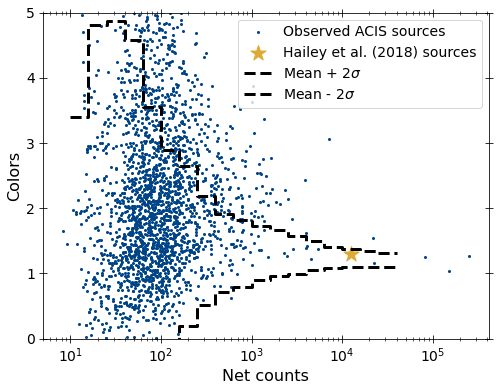

In [857]:
mark_interested_srcs(
    sim_msps_color_dict_arr[2], obs_color_dict_arr[2],
    spec_summary_msps['src_nums'][1], spec_summary_msps['spec_masks'][1][2],
    [badcandidate_msps_acis[9]])

In [61]:
mark_interested_srcs(
    sim_msps_color_dict_arr[0], obs_color_dict_arr[0],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][0],
    badcandidate_msps_pn)
mark_interested_srcs(
    sim_msps_color_dict_arr[1], obs_color_dict_arr[1],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][1],
    badcandidate_msps_mos)
mark_interested_srcs(
    sim_msps_color_dict_arr[2], obs_color_dict_arr[2],
    spec_summary_msps['src_nums'][1], spec_summary_msps['spec_masks'][1][2],
    badcandidate_msps_acis)

NameError: name 'badcandidate_msps_pn' is not defined

(array([ 5.,  2.,  6., 10., 15., 19., 11., 10.,  7.,  8.]),
 array([22.36599093, 22.50510571, 22.64422049, 22.78333527, 22.92245005,
        23.06156483, 23.20067961, 23.33979439, 23.47890917, 23.61802395,
        23.75713873]),
 <BarContainer object of 10 artists>)

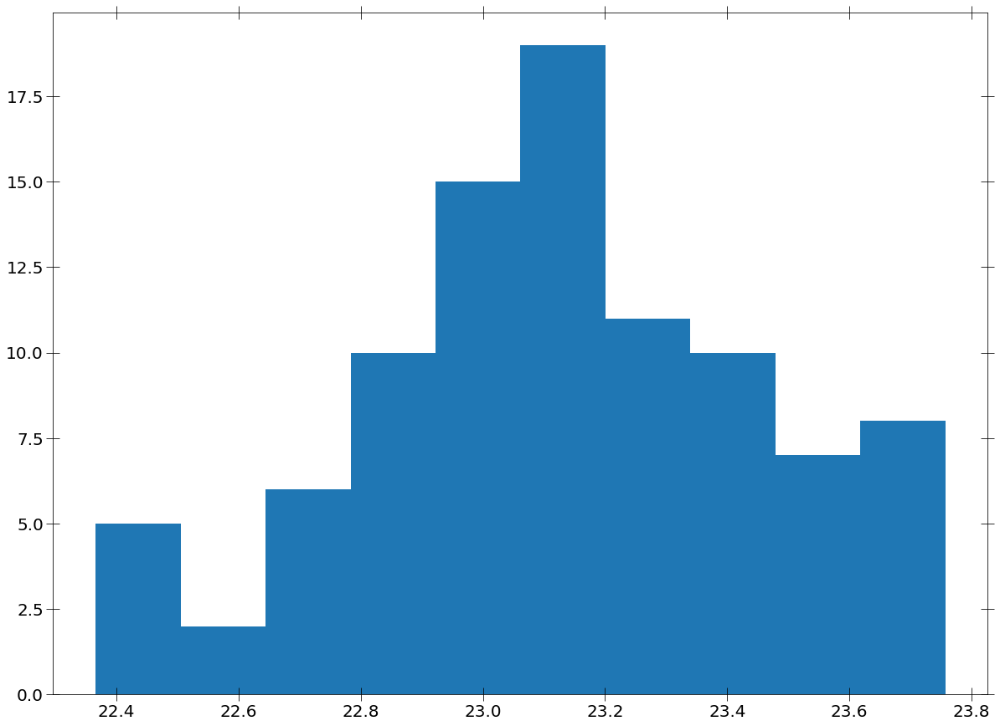

In [131]:
plt.hist(np.log10(np.array(pn_model_params_table_pl)[:, 1].astype(float)*1.0E+22), bins=10)

(array([ 3.,  1.,  1.,  8., 17., 30., 46., 21.,  2.,  1.]),
 array([21.97720322, 22.18626372, 22.39532422, 22.60438472, 22.81344522,
        23.02250572, 23.23156622, 23.44062672, 23.64968722, 23.85874773,
        24.06780823]),
 <BarContainer object of 10 artists>)

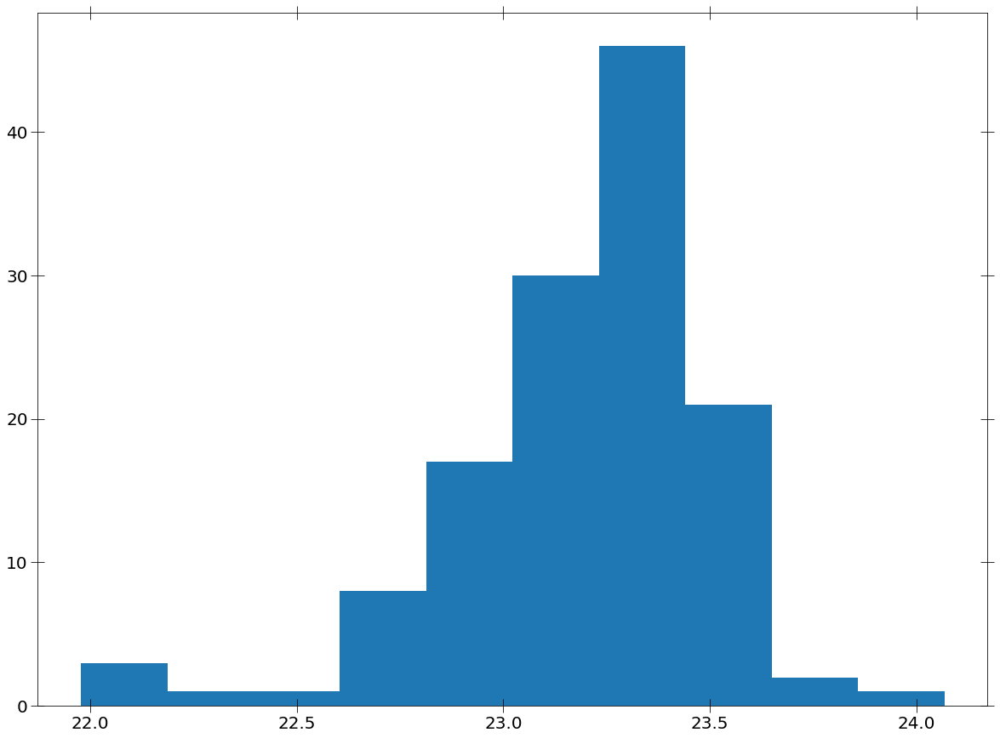

In [132]:
plt.hist(np.log10(np.array(acis_model_params_table_pl)[:, 1].astype(float)*1.0E+22), bins=10)

In [134]:
fit_stats_arr = [[pn_fit_stats_table_pl, pn_fit_stats_table_pl_g,
                  pn_fit_stats_table_pl_g2],
                 [mos_fit_stats_table_pl, mos_fit_stats_table_pl_g,
                  mos_fit_stats_table_pl_g2],
                 [acis_fit_stats_table_pl, acis_fit_stats_table_pl_g,
                  acis_fit_stats_table_pl_g2]]

model_params_arr = [[pn_model_params_table_pl, pn_model_params_table_pl_g,
                     pn_model_params_table_pl_g2],
                    [mos_model_params_table_pl, mos_model_params_table_pl_g,
                     mos_model_params_table_pl_g2],
                    [acis_model_params_table_pl, acis_model_params_table_pl_g,
                     acis_model_params_table_pl_g2]]

det_names = ['PN', 'MOS', 'ACIS']
model_names = ['PL', 'PL_Gauss', 'PL_Gauss3']

for i in range(3):
    for j in range(3):
        fits_file_name = ('Fit_stats_goodobs_' + det_names[i] + '_' + model_names[j] +
                          '.txt')
        model_file_name = ('Model_params_goodobs_' + det_names[i] + '_' + model_names[j] +
                          '.txt')
        print(fits_file_name, model_file_name)
        np.savetxt(fits_file_name, fit_stats_arr[i][j], fmt='%s')
        np.savetxt(model_file_name, model_params_arr[i][j], fmt='%s')

Fit_stats_goodobs_PN_PL.txt Model_params_goodobs_PN_PL.txt
Fit_stats_goodobs_PN_PL_Gauss.txt Model_params_goodobs_PN_PL_Gauss.txt
Fit_stats_goodobs_PN_PL_Gauss3.txt Model_params_goodobs_PN_PL_Gauss3.txt
Fit_stats_goodobs_MOS_PL.txt Model_params_goodobs_MOS_PL.txt
Fit_stats_goodobs_MOS_PL_Gauss.txt Model_params_goodobs_MOS_PL_Gauss.txt
Fit_stats_goodobs_MOS_PL_Gauss3.txt Model_params_goodobs_MOS_PL_Gauss3.txt
Fit_stats_goodobs_ACIS_PL.txt Model_params_goodobs_ACIS_PL.txt
Fit_stats_goodobs_ACIS_PL_Gauss.txt Model_params_goodobs_ACIS_PL_Gauss.txt
Fit_stats_goodobs_ACIS_PL_Gauss3.txt Model_params_goodobs_ACIS_PL_Gauss3.txt


20:80: E501 line too long (86 > 79 characters)
22:80: E501 line too long (90 > 79 characters)
23:27: E128 continuation line under-indented for visual indent


In [62]:
os.chdir('/Volumes/')

In [133]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/')

In [195]:
print('Candidate MSPs PN: ', len(candidate_msps_pn))
print('Candidate MSPs MOS: ', len(candidate_msps_mos))
print('Candidate MSPs ACIS: ', len(candidate_msps_acis))

Candidate MSPs PN:  42
Candidate MSPs MOS:  27
Candidate MSPs ACIS:  82


In [137]:
np.savetxt('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/PN_candidates.txt', candidate_msps_pn, fmt='%s')
np.savetxt('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/MOS_candidates.txt', candidate_msps_mos, fmt='%s')
np.savetxt('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/ACIS_candidates.txt', candidate_msps_acis, fmt='%s')

1:80: E501 line too long (116 > 79 characters)
2:80: E501 line too long (118 > 79 characters)


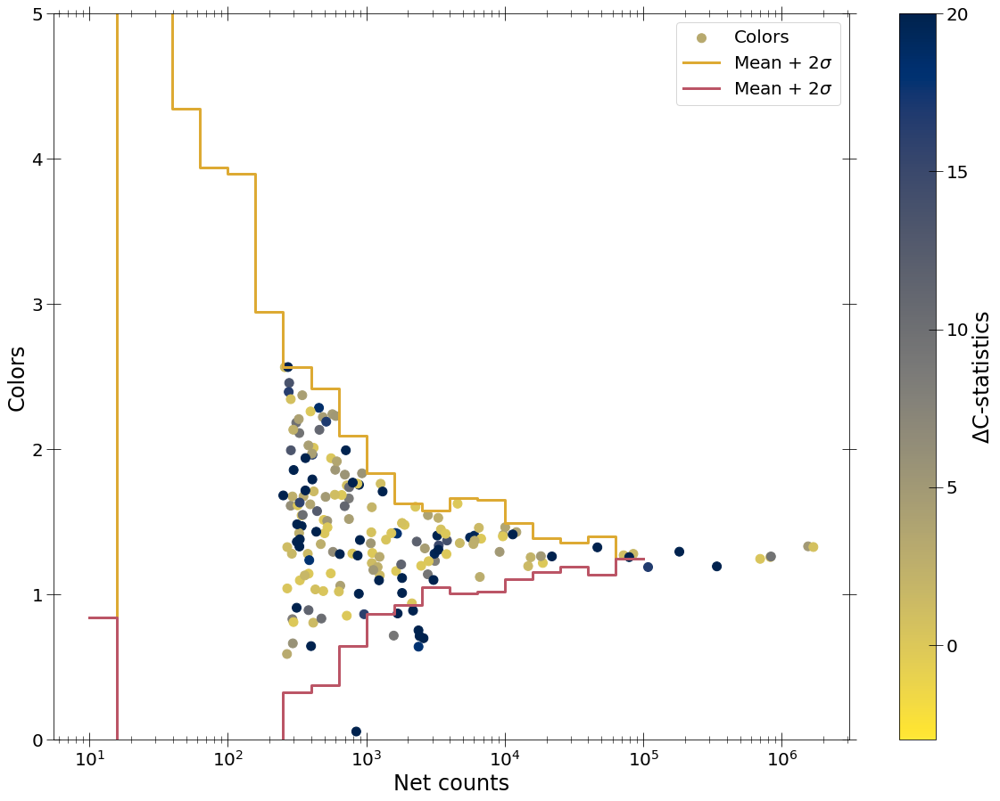

3:19: E127 continuation line over-indented for visual indent


In [127]:
mark_delta_cstat(sim_msps_color_dict_arr[0],
                 interested_msp_netcounts_pn, interested_msp_colors_pn,
                  color_param=(
                      np.array(pn_fit_stats_table_pl)[:, 1].astype(float) -
                      np.array(pn_fit_stats_table_pl_g2)[:, 1].astype(float)))

In [63]:
np.savetxt("Candidate_PN_sources2.txt", candidate_msps_pn, fmt='%s')
np.savetxt("Candidate_MOS_sources2.txt", candidate_msps_mos, fmt='%s')
np.savetxt("Candidate_ACIS_sources2.txt", candidate_msps_acis, fmt='%s')

42 42
[   351.92945247    289.90069035   1095.65166318    749.24316979
    312.64435376    452.26180445   9169.92094638    268.59533598
    294.65176547  84717.44865388   5906.66947885    340.98131215
    488.54255387   1199.5405138     319.66772022    468.82938122
   3131.35267644   3333.91840967    781.9714536    2835.56651361
    711.53733848    328.18495497  13354.595606    18809.38042347
    341.21123846    381.97668665  18219.60240603    413.8041048
    398.9688382     292.5793281     387.26516544 108294.73356779
    648.64365916    363.58689603    296.80115619    330.17041156
    383.05994948    435.03011623  11405.55665505    330.83847753
    553.67940656    382.66495161]
[ 1.67581269  1.28112422  1.21663543  1.51989179  1.60187246  1.87554681
  1.29404339  1.3266276   0.66431771  1.28037626  1.13547261  1.54478757
  1.02407813  1.14781944  1.61401294  1.34720766  1.23135082  1.33815723
 -0.05260787  1.29847956  1.99319728  2.11166137  1.28097346  1.21773187
  1.47134072  2.026

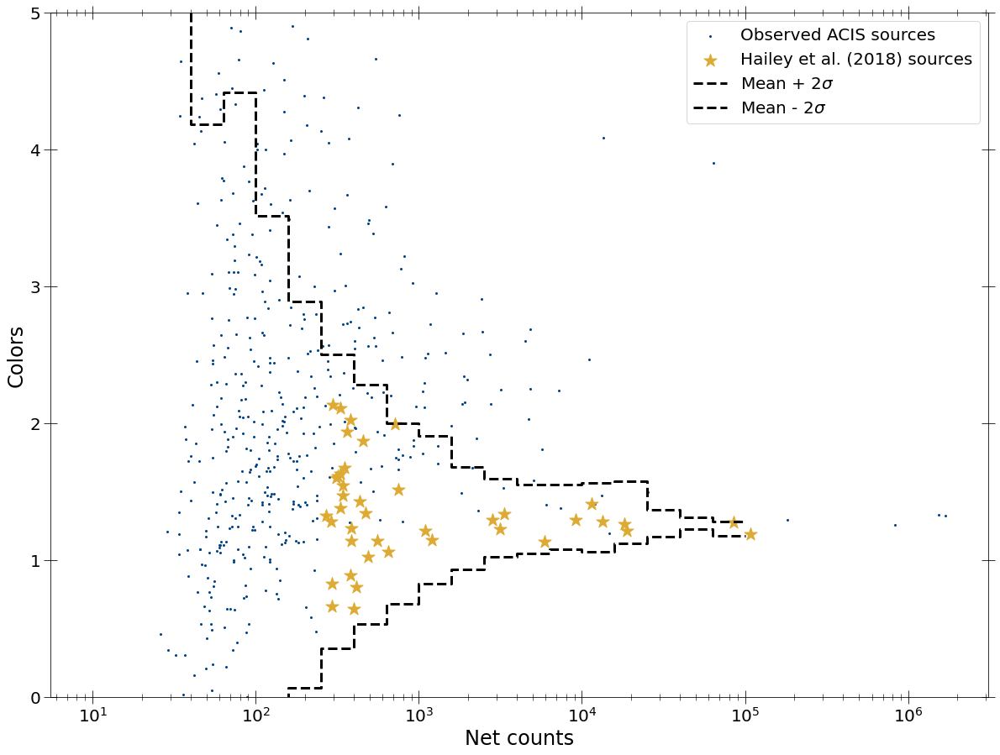

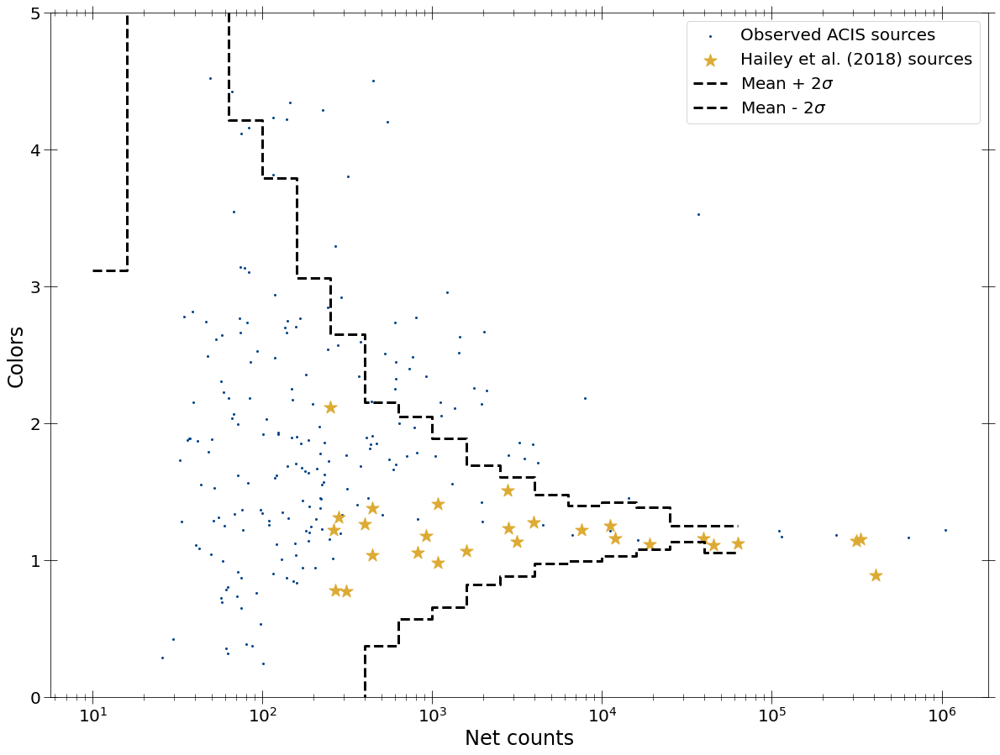

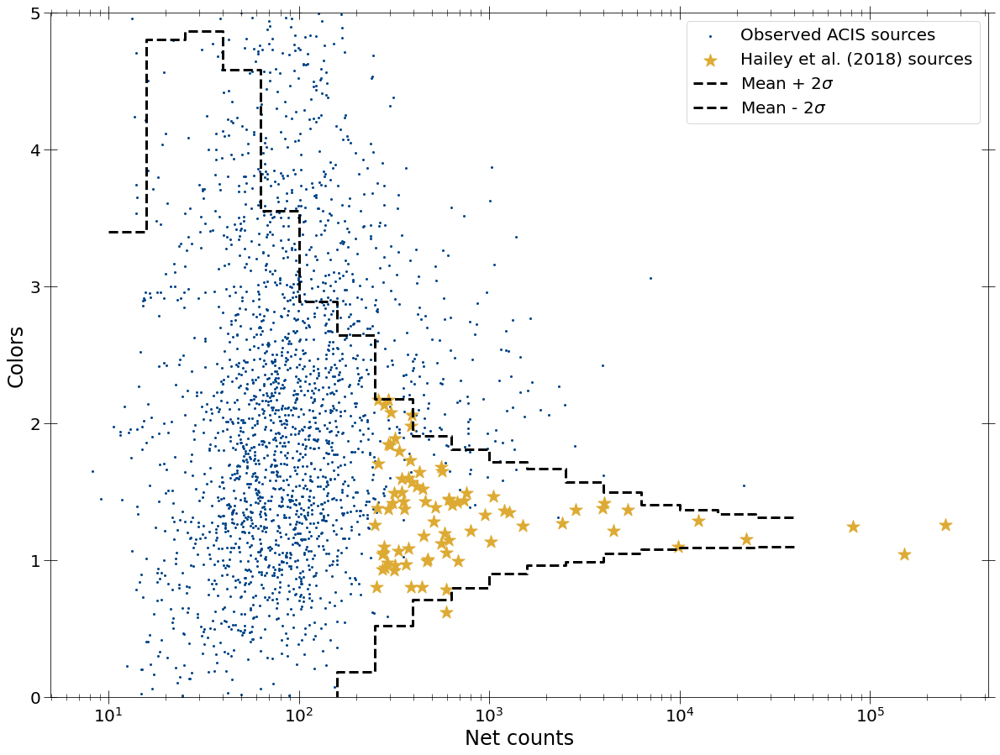

In [208]:
candidate_msp_colors_pn, candidate_msp_netcounts_pn = mark_interested_srcs(
    sim_msps_color_dict_arr[0], obs_color_dict_arr[0],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][0],
    candidate_msps_pn)
candidate_msp_colors_mos, candidate_msp_netcounts_mos = mark_interested_srcs(
    sim_msps_color_dict_arr[1], obs_color_dict_arr[1],
    spec_summary_msps['src_nums'][0], spec_summary_msps['spec_masks'][1][1],
    candidate_msps_mos)
candidate_msp_colors_acis, candidate_msp_netcounts_acis = mark_interested_srcs(
    sim_msps_color_dict_arr[2], obs_color_dict_arr[2],
    spec_summary_msps['src_nums'][1], spec_summary_msps['spec_masks'][1][2],
    candidate_msps_acis)

(array([[26., 34., 10.,  7.,  1.,  0.,  1.,  0.,  0.,  0.],
        [ 0.,  1., 12., 19.,  7.,  8.,  4.,  0.,  2.,  3.],
        [ 0.,  2., 21., 15., 17., 19.,  5.,  0.,  4.,  1.]]),
 array([31.83728314, 32.33700378, 32.83672443, 33.33644508, 33.83616573,
        34.33588637, 34.83560702, 35.33532767, 35.83504831, 36.33476896,
        36.83448961]),
 <a list of 3 BarContainer objects>)

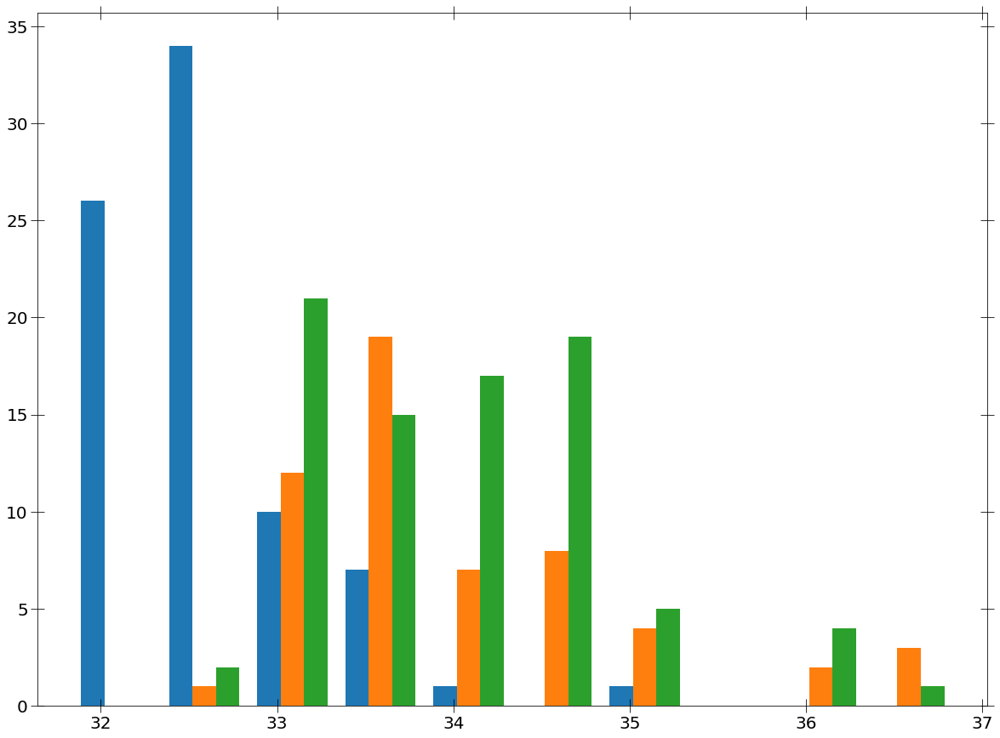

2:80: E501 line too long (97 > 79 characters)
4:5: E122 continuation line missing indentation or outdented
4:80: E501 line too long (95 > 79 characters)
6:5: E122 continuation line missing indentation or outdented


In [40]:
plt.hist([np.log10(np.array(
    acis_model_params_table_pl)[candidadate_msps_acis_args, -1].astype(float)*1.0E-12*7.659E+45),
          np.log10(np.array(
    mos_model_params_table_pl)[candidadate_msps_mos_args, -1].astype(float)*1.0E-12*7.659E+45),
          np.log10(np.array(
    pn_model_params_table_pl)[candidadate_msps_pn_args, -1].astype(float)*1.0E-12*7.659E+45)])

In [41]:
np.array(pn_model_params_table_pl)[:, -1]

array(['0.17775347039666198', '0.15741084535160457', '0.184916221634929',
       '0.15827113901941042', '0.2236002475847295', '0.08951046394205044',
       '0.14265592957726886', '0.1626556505674507', '0.151691544568419',
       '0.05853568131439508', '0.14208766163194325', '0.1483015342871929',
       '0.17915506454714364', '0.18059561287992698', '0.4972249272113047',
       '0.09935349974589852', '0.2892301045437417', '0.09958650593606125',
       '0.14983870965833504', '0.10191032244884844',
       '0.09547917849789156', '1.514468706406689', '2.386640098946292',
       '0.0695866798415962', '2.434338843992567', '2.653754452026149',
       '0.8073668171107404', '0.17373774483165227', '0.09894761001028098',
       '0.8797420859841123', '0.08134202489723485', '0.32472292336168684',
       '0.8776335127640109', '0.3198136926262305', '0.33445479886038176',
       '0.13148582008628226', '0.3577683026935588', '1.042938236836493',
       '0.42383678514598094', '0.8444880167700237', '0.71371

In [162]:
candidate_msps_xmm = np.array(
    list(set(candidate_msps_pn) | set(candidate_msps_mos)))

In [271]:
candidate_msps_xmm2 = np.array(
    list(set(candidate_msps_pn2) | set(candidate_msps_mos2)))

In [409]:
len(set(interested_msp_srcs_alldet[0]) &
         set(interested_msp_srcs_alldet[1]))

63

In [163]:
print('Candidate XMM sources: ', len(candidate_msps_xmm))

Candidate XMM sources:  49


In [ ]:
cando

In [126]:
print('Candidate XMM sources: ', len(candidate_msps_acis))

Candidate XMM sources:  82


In [234]:
def arr_to_str(arr, delimiter=';', telescope='Chandra'):
    """Convert array to a string."""
    string = ''
    for elm in arr:
        if telescope == 'Chandra':
            string += '2CXO J' + elm.split('J')[1] + delimiter + ' '
        else:
            string += elm + delimiter + ' '
    return string[:-2]

In [81]:
print(pn_fit_stats_table_pl[165])
print(pn_fit_stats_table_pl_g[165])
print(pn_model_params_table_pl_g2[165])

['207901804010003', 1235.5077482061804, -11.752061357752408, 50.0, 1339]
['207901804010003', 1221.5023602591075, -11.829463122524714, 50.0, 1337]
['207901804010003', 22.57936557017966, 5.0, 94.06476805856985, 8.158533789967393e-21, 4.148413598151495e-06, 1.008391242920101e-07, 0.8224962005991274, 0.0, 5.176706758261817e-07, 7.887873183904472e-06, 0.0, 3.336197748012629e-06]


In [235]:
arr_to_str(np.sort(np.array(candidate_msps_xmm)).astype(str), telescope='XMM')

'200305401010008; 200305401015015; 201032613010001; 201032613010002; 201113501010117; 201129701010015; 201129702010002; 201129704010049; 201129704010056; 201129705010002; 201129705010011; 201129707010033; 201129707010057; 201129707010063; 201129709010018; 201129712010002; 201129715010017; 201129715010042; 201129719010003; 201129719010010; 201129721010014; 201129721010057; 201129721010060; 201129721010133; 201129721010136; 201442201010001; 201529201010002; 202026705010003; 202039301010054; 202039301010071; 203032102010002; 204003401010003; 204003401010007; 204003401010008; 205100104010002; 205110012010001; 206556701010043; 206946402010009; 206946404010062; 206946404010202; 206946410010178; 207483912010001; 208016803010003; 208016813010003; 208042503010002; 208441011010001; 208860108010001; 208861209010009; 208938111010034'

# IP analysis

## Selection of IPs within MSP colors

In [138]:
(interested_cv_args_alldet,
 interested_cv_srcs_alldet) = get_candidate_src_nums_alldet(
    spec_summary_msp_cvs, sim_msps2_color_dict_arr, sim_ips_color_dict_arr,
    min_count_arr=[150, 150, 150], min_counts2=250)

[1.00000000e+01 1.58489319e+01 2.51188643e+01 3.98107171e+01
 6.30957344e+01 1.00000000e+02 1.58489319e+02 2.51188643e+02
 3.98107171e+02 6.30957344e+02 1.00000000e+03 1.58489319e+03
 2.51188643e+03 3.98107171e+03 6.30957344e+03 1.00000000e+04
 1.58489319e+04 2.51188643e+04 3.98107171e+04 6.30957344e+04
 1.00000000e+05]
[3.65542586 1.82112626 1.93854327 1.55166167 1.66017044 1.54351252
 1.47857829 1.42997489 1.40961659 1.34310455 1.36949341 1.3094684
 1.31091515 1.30237862 1.31805685 1.31716775 1.35103234 1.27131889
 1.27087823 1.23009718]
[7.03523327 2.31283915 2.18961059 1.31711125 1.37887919 0.98627194
 0.70557556 0.53689296 0.43740548 0.33020864 0.26926488 0.18769595
 0.14349454 0.12610196 0.118522   0.12565636 0.11273488 0.04872525
 0.02083223 0.02596428]
250 1.429974886706783 0.5368929553567432
1
251.18864315095823 1.429974886706783 0.5368929553567432
708
398.1071705534973 1.4096165878788645 0.4374054816065335
562
630.957344480193 1.3431045453292159 0.33020864110573095
329
1000.0

In [139]:
print('Interested PN sources: ', len(interested_cv_srcs_alldet[0]))
print('Interested MOS sources: ', len(interested_cv_srcs_alldet[1]))
print('Interested ACIS sources: ', len(interested_cv_srcs_alldet[2]))

Interested PN sources:  1831
Interested MOS sources:  874
Interested ACIS sources:  1069


1831 1831
[1125.71520906  324.91693653  655.89662733 ...  822.85225156  342.64802292
  311.43074009]
[ 1.58269123  1.25199192  1.25037521 ... -0.65917091  2.24479219
  1.08466568]
4.0
16.0
874 874
[ 307.60604591 1095.81099322  291.9918846   257.54959689  609.97203036
  258.36101569  811.64132784  586.92769177  267.06251654 1172.62663341
  333.18166199 2260.12416557  484.49610865  254.5151462   309.0990705
  890.51509363 2767.37661852  750.64334694  991.12536545  538.97782734
  460.25880318  375.44395014  610.2274727   720.58963014  764.04694276
 2666.0015899  1113.52173309  934.73603598 2305.19247679  324.95170984
  409.05553342  310.82648087  442.62321633  346.56820667  323.41450133
  268.55050281 1583.63544758  327.89574269  522.24000727  358.65935025
 1036.790599   1385.9713912  1177.99223925  529.54008674  493.03860511
  518.22173117 1345.60419663  637.32674518  363.86106704  419.63074849
  782.05139169  537.24536218  310.82908993 1508.13581617  465.94480022
  505.64355674  405.257

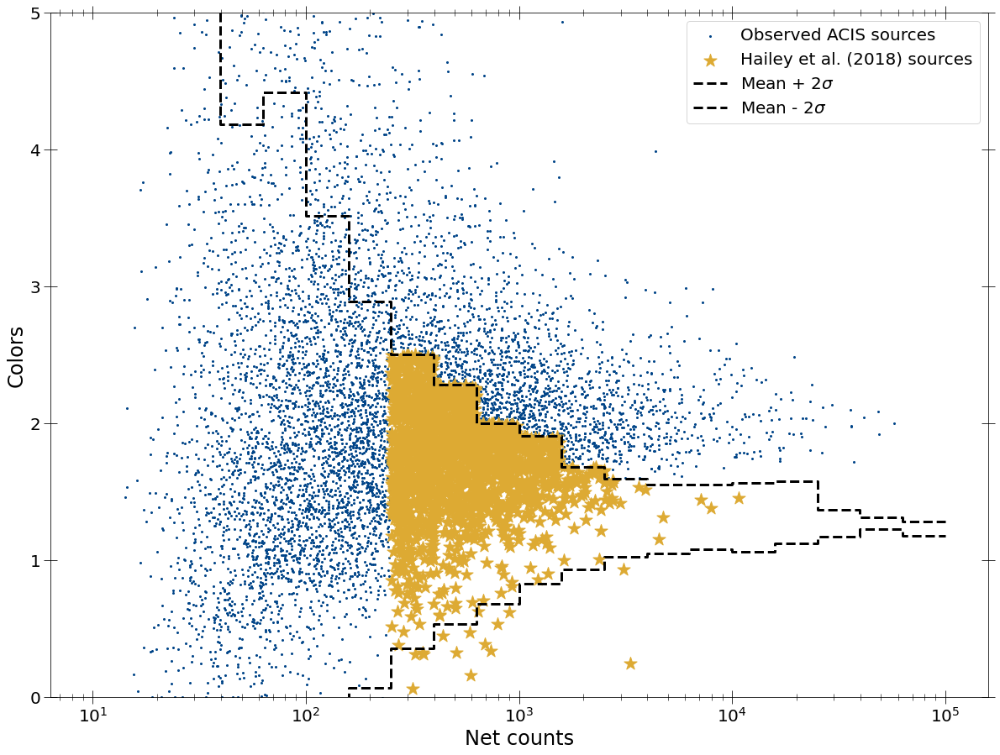

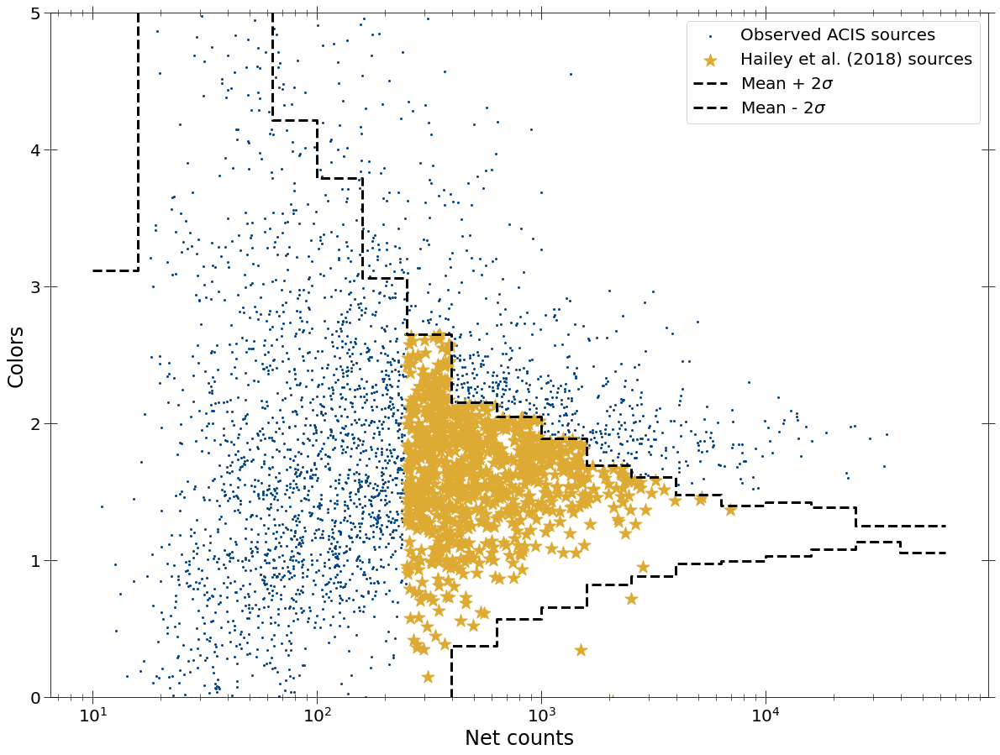

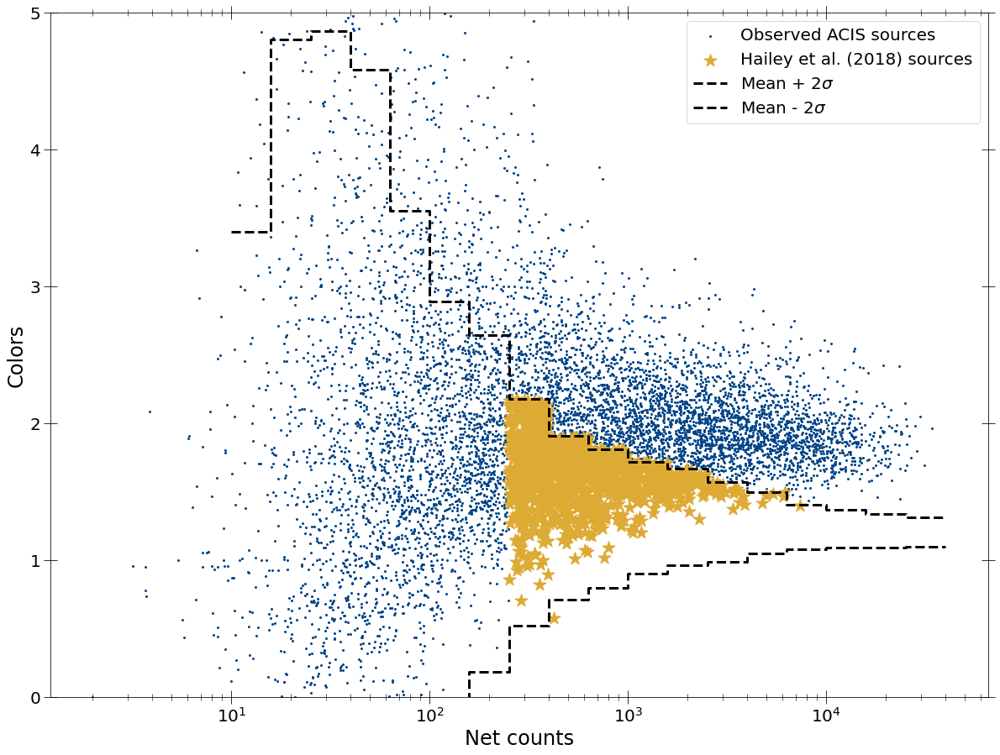

In [140]:
interested_cv_colors_pn, interested_cv_netcounts_pn = mark_interested_srcs(
    sim_msps_color_dict_arr[0], sim_ips_color_dict_arr[0],
    spec_summary_msp_cvs['src_nums'][0],
    spec_summary_msp_cvs['spec_masks'][1][0], interested_cv_srcs_alldet[0])
interested_cv_colors_mos, interested_cv_netcounts_mos = mark_interested_srcs(
    sim_msps_color_dict_arr[1], sim_ips_color_dict_arr[1],
    spec_summary_msp_cvs['src_nums'][0],
    spec_summary_msp_cvs['spec_masks'][1][1], interested_cv_srcs_alldet[1])
interested_cv_colors_acis, interested_cv_netcounts_acis = mark_interested_srcs(
    sim_msps_color_dict_arr[2], sim_ips_color_dict_arr[2],
    spec_summary_msp_cvs['src_nums'][1],
    spec_summary_msp_cvs['spec_masks'][1][2], interested_cv_srcs_alldet[2])

## Spectral analysis

In [141]:
def fit_src_pl_sim(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder + 'ip_' +
                                 str(source_num) + '_PN.fak')
        spec_mosfile = glob2.glob(src_folder + 'ip_' +
                                  str(source_num) + '_MOS.fak')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        #os.chdir(src_folder + '/' + source_num)
        spec_file = 'ip_' + str(source_num) + '.fak'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')

    model = xspec.Model('tbabs*pegpwrlw')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.perform()
    xspec.Fit.error('2.706 2')
    xspec.Fit.perform()
    print('Calculating goodness')
    #goodness = xspec.Fit.goodness(1000)
    print('Finished calculating goodness')
    goodness = 50.0
    print('Model params for ' + str(source_num) +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0])
    print('Fit stats for ' + str(source_num) + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    if telescope == 'Chandra':
        os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0]])

20:9: E265 block comment should start with '# '
38:5: E265 block comment should start with '# '
50:80: E501 line too long (80 > 79 characters)


In [142]:
def fit_src_pl_gauss_sim(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder + 'ip_' +
                                 str(source_num) + '_PN.fak')
        spec_mosfile = glob2.glob(src_folder + 'ip_' +
                                  str(source_num) + '_MOS.fak')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        #os.chdir(src_folder + '/' + source_num)
        spec_file = 'ip_' + str(source_num) + '.fak'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')
    
    model = xspec.Model('tbabs*(pegpwrlw+gauss)')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    model.pegpwrlw.eMin.values = '2.0'
    model.pegpwrlw.eMax.values = '10.0'
    model.gaussian.LineE.values = '6.7, 0.0001, 6.1, 6.1, 7.3, 7.3'
    model.gaussian.Sigma.values = '0.1 0'
    model.gaussian.norm.values = '1.0E-5, 0.001,,,,'
    
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.query = 'yes'
    xspec.Fit.perform()
    xspec.Fit.error('2.706 6')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    #xspec.Fit.error('2.706 6')
    #xspec.Fit.error('2.706 8')
    #goodness = xspec.Fit.goodness(1000)
    goodness = 50.0
    line_pos_low = xspec.AllModels(1).gaussian.LineE.error[0]
    line_pos_high = xspec.AllModels(1).gaussian.LineE.error[1]
    line_norm_low = xspec.AllModels(1).gaussian.norm.error[0]
    line_norm_high = xspec.AllModels(1).gaussian.norm.error[1]
    print('Model params for ' + str(source_num) +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0],
          ' Fe_pos:', xspec.AllModels(1).gaussian.LineE.values[0],
          line_pos_low, line_pos_high,
          ' Fe_norm:', xspec.AllModels(1).gaussian.norm.values[0],
          line_norm_low, line_norm_high)
    print('Fit stats for ' + str(source_num) + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).gaussian.LineE.values[0], line_pos_low,
             line_pos_high,
             xspec.AllModels(1).gaussian.norm.values[0], line_norm_low,
             line_norm_high])


20:9: E265 block comment should start with '# '
27:1: W293 blank line contains whitespace
36:1: W293 blank line contains whitespace
46:5: E265 block comment should start with '# '
47:5: E265 block comment should start with '# '
48:5: E265 block comment should start with '# '
66:80: E501 line too long (80 > 79 characters)


In [143]:
def fit_src_pl_gauss2_sim(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder + 'ip_' +
                                 str(source_num) + '_PN.fak')
        spec_mosfile = glob2.glob(src_folder + 'ip_' +
                                  str(source_num) + '_MOS.fak')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        #os.chdir(src_folder + '/' + source_num)
        spec_file = 'ip_' + str(source_num) + '.fak'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')
    
    model = xspec.Model('tbabs*(pegpwrlw+gauss+gauss+gauss)')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    model.pegpwrlw.eMin.values = '2.0'
    model.pegpwrlw.eMax.values = '10.0'
    model.gaussian.LineE.values = '6.4 0'
    model.gaussian.Sigma.values = '0.0 0'
    model.gaussian.norm.values = '1.0E-5, 0.001,,,,'
    model.gaussian_4.LineE.values = '6.7 0'
    model.gaussian_4.Sigma.values = '0.0 0'
    model.gaussian_4.norm.values = '1.0E-5, 0.001,,,,'
    model.gaussian_5.LineE.values = '7.0 0'
    model.gaussian_5.Sigma.values = '0.0 0'
    model.gaussian_5.norm.values = '1.0E-5, 0.001,,,,'
    
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.query = 'yes'
    xspec.Fit.perform()
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 11')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 14')
    # xspec.Fit.error('2.706 8')
    #goodness = xspec.Fit.goodness(1000)
    goodness = 50.0
    line_norm1_low = xspec.AllModels(1).gaussian.norm.error[0]
    line_norm1_high = xspec.AllModels(1).gaussian.norm.error[1]
    line_norm2_low = xspec.AllModels(1).gaussian_4.norm.error[0]
    line_norm2_high = xspec.AllModels(1).gaussian_4.norm.error[1]
    line_norm3_low = xspec.AllModels(1).gaussian_5.norm.error[0]
    line_norm3_high = xspec.AllModels(1).gaussian_5.norm.error[1]
    print('Model params for ' + str(source_num) +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0],
          ' Fe_norms:', xspec.AllModels(1).gaussian.norm.values[0],
          line_norm1_low, line_norm1_high,
          xspec.AllModels(1).gaussian_4.norm.values[0], line_norm2_low,
          line_norm2_high, xspec.AllModels(1).gaussian_5.norm.values[0],
          line_norm3_low, line_norm3_high)
    print('Fit stats for ' + str(source_num) + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).gaussian.norm.values[0],
             xspec.AllModels(1).gaussian_4.norm.values[0],
             xspec.AllModels(1).gaussian_5.norm.values[0], line_norm1_low,
             line_norm1_high, line_norm2_low, line_norm2_high, line_norm3_low,
             line_norm3_high])


20:9: E265 block comment should start with '# '
27:1: W293 blank line contains whitespace
42:1: W293 blank line contains whitespace
54:5: E265 block comment should start with '# '
75:80: E501 line too long (80 > 79 characters)


In [145]:
interested_cv_srcs_alldet[0][1]

30

In [149]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/sim_ips_xmm_goodobs/')
xspec.AllData.clear()
fit_src_pl_sim(interested_cv_srcs_alldet[0][1], src_folder='./')

Calculating goodness
Finished calculating goodness
Model params for 30: NH =  12.654250575268051  Gamma:  1.468071043406363  norm:  1.1646733825263433
Fit stats for 30:  142.98700821680092 -9.09316613619614 50.0 132




([30, 142.98700821680092, -9.09316613619614, 50.0, 132],
 [30, 12.654250575268051, 1.468071043406363, 1.1646733825263433])

1:80: E501 line too long (88 > 79 characters)


In [150]:
pn_fit_stats_table_pl_cv = []
pn_model_params_table_pl_cv = []

for i, source_num in enumerate(interested_cv_srcs_alldet[0]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_sim(source_num)
    pn_fit_stats_table_pl_cv.append(fit_stats)
    pn_model_params_table_pl_cv.append(model_params)

0 15616
Calculating goodness
Finished calculating goodness
Model params for 15616: NH =  11.800322926262549  Gamma:  0.7036480507095256  norm:  0.05141501583421118
Fit stats for 15616:  1512.480288314003 -7.850999772886306 50.0 1513


1 30
Calculating goodness
Finished calculating goodness
Model params for 30: NH =  12.654250575268051  Gamma:  1.468071043406363  norm:  1.1646733825263433
Fit stats for 30:  142.98700821680092 -9.09316613619614 50.0 132


2 82
Calculating goodness
Finished calculating goodness
Model params for 82: NH =  126.8309772335655  Gamma:  4.861410728082683  norm:  2.822083507459184
Fit stats for 82:  3142.2151310736695 -5.722978621066061 50.0 2736


3 106
Calculating goodness
Finished calculating goodness
Model params for 106: NH =  60.24203347666977  Gamma:  2.3728320540847156  norm:  0.9305317512917711
Fit stats for 106:  460.2117282934041 -6.765786075940233 50.0 402


4 113
Calculating goodness
Finished calculating goodness
Model params for 113: NH =  8.231184

Calculating goodness
Finished calculating goodness
Model params for 1148: NH =  40.646340177125325  Gamma:  2.011874457297025  norm:  0.9675030686102168
Fit stats for 1148:  155.95417029279312 -7.621636598980749 50.0 120


38 1175
Calculating goodness
Finished calculating goodness
Model params for 1175: NH =  5.306127163784732  Gamma:  0.7640792194725167  norm:  0.1987532632874969
Fit stats for 1175:  257.14818225251076 -8.200339681267549 50.0 210


39 1219
Calculating goodness
Finished calculating goodness
Model params for 1219: NH =  47.85414397624026  Gamma:  2.1129915135669424  norm:  0.6751000180739192
Fit stats for 1219:  403.29395782886183 -6.581232669074085 50.0 336


40 1245
Calculating goodness
Finished calculating goodness
Model params for 1245: NH =  14.418808596965684  Gamma:  1.2415660771168966  norm:  0.27482096249185367
Fit stats for 1245:  626.364660959586 -6.985219270775057 50.0 551


41 1286
Calculating goodness
Finished calculating goodness
Model params for 1286: NH

Calculating goodness
Finished calculating goodness
Model params for 2190: NH =  25.189059658441415  Gamma:  2.8962628711682994  norm:  0.6416909267051536
Fit stats for 2190:  3084.9819786104003 -6.178379196416152 50.0 3161


74 2202
Calculating goodness
Finished calculating goodness
Model params for 2202: NH =  69.53440141122125  Gamma:  1.8802972204592516  norm:  2.2092842062266254
Fit stats for 2202:  688.5836411504811 -6.6701887053726745 50.0 641


75 2220
Calculating goodness
Finished calculating goodness
Model params for 2220: NH =  85.09195750973315  Gamma:  2.2599422683045867  norm:  1.0521153770871428
Fit stats for 2220:  203.8824878982194 -7.7712230821691595 50.0 187


76 2227
Calculating goodness
Finished calculating goodness
Model params for 2227: NH =  17.88274056407041  Gamma:  1.4019439292429206  norm:  0.6179377717957858
Fit stats for 2227:  146.50151495404407 -7.49115467021328 50.0 130


77 2235
Calculating goodness
Finished calculating goodness
Model params for 2235: N

Calculating goodness
Finished calculating goodness
Model params for 3388: NH =  14.409511080576038  Gamma:  0.9921621320251461  norm:  0.8026182488800653
Fit stats for 3388:  220.4389048993023 -7.91295971749225 50.0 232


110 3409
Calculating goodness
Finished calculating goodness
Model params for 3409: NH =  52.490105694898865  Gamma:  2.5890001072297304  norm:  2.8186056915655695
Fit stats for 3409:  238.81703776200717 -8.859039071376525 50.0 220


111 3419
Calculating goodness
Finished calculating goodness
Model params for 3419: NH =  207.82140873640375  Gamma:  4.688720177484082  norm:  3.1479678215847167
Fit stats for 3419:  3237.806029210122 -6.784175982346051 50.0 2985


112 3427
Calculating goodness
Finished calculating goodness
Model params for 3427: NH =  41.24481488549507  Gamma:  2.2090007101437847  norm:  0.6362281183959806
Fit stats for 3427:  138.97745140413844 -7.816560507053386 50.0 125


113 3432
Calculating goodness
Finished calculating goodness
Model params for 3432

Calculating goodness
Finished calculating goodness
Model params for 4366: NH =  61.58614300691408  Gamma:  2.1650081147567715  norm:  0.574055078284767
Fit stats for 4366:  205.3030353481966 -7.533001497732158 50.0 204


146 4385
Calculating goodness
Finished calculating goodness
Model params for 4385: NH =  37.12920601336002  Gamma:  1.5198684346462827  norm:  0.22966879786548658
Fit stats for 4385:  1926.622929893157 -7.506396075103991 50.0 1730


147 4539
Calculating goodness
Finished calculating goodness
Model params for 4539: NH =  11.399572141667123  Gamma:  1.250581202240828  norm:  0.46315128965476154
Fit stats for 4539:  677.8451409918298 -7.975944212374051 50.0 686


148 4575
Calculating goodness
Finished calculating goodness
Model params for 4575: NH =  51.0815984093847  Gamma:  0.9196054935205275  norm:  0.5025173613288615
Fit stats for 4575:  390.71095105883666 -7.140721842140454 50.0 375


149 4595
Calculating goodness
Finished calculating goodness
Model params for 4595: 

Calculating goodness
Finished calculating goodness
Model params for 5524: NH =  9.77550176443427  Gamma:  0.3505125905753176  norm:  0.25389933953745725
Fit stats for 5524:  339.7275708625183 -7.90314467755018 50.0 316


182 5527
Calculating goodness
Finished calculating goodness
Model params for 5527: NH =  20.554162957037374  Gamma:  1.39337647811899  norm:  0.6173193034202683
Fit stats for 5527:  258.9006391169161 -7.865933671394994 50.0 207


183 5539
Calculating goodness
Finished calculating goodness
Model params for 5539: NH =  91.32398639782106  Gamma:  2.2016515562541294  norm:  1.0932207442545296
Fit stats for 5539:  398.8881334689861 -7.466893649397875 50.0 359


184 5541
Calculating goodness
Finished calculating goodness
Model params for 5541: NH =  10.095392205576614  Gamma:  0.5216928001796531  norm:  0.5409738484987392
Fit stats for 5541:  541.9798188699283 -9.06071612767935 50.0 496


185 5559
Calculating goodness
Finished calculating goodness
Model params for 5559: NH =

Calculating goodness
Finished calculating goodness
Model params for 6529: NH =  47.83727927843419  Gamma:  1.9399558498800555  norm:  2.0004970867795344
Fit stats for 6529:  270.53035172064364 -7.382352047208631 50.0 257


218 6553
Calculating goodness
Finished calculating goodness
Model params for 6553: NH =  8.45419377835318  Gamma:  1.343234674198828  norm:  0.30815307729330665
Fit stats for 6553:  155.4944899875487 -7.9780238993163675 50.0 132


219 6554
Calculating goodness
Finished calculating goodness
Model params for 6554: NH =  11.403812929370973  Gamma:  1.118679739262248  norm:  0.14826277672391946
Fit stats for 6554:  499.2977371746924 -7.611316369098229 50.0 443


220 6582
Calculating goodness
Finished calculating goodness
Model params for 6582: NH =  27.85660130657438  Gamma:  1.8574524378166213  norm:  0.05770449399050603
Fit stats for 6582:  3276.3573538687706 -7.577309008572892 50.0 2910


221 6593
Calculating goodness
Finished calculating goodness
Model params for 659

Calculating goodness
Finished calculating goodness
Model params for 7769: NH =  12.496409904841205  Gamma:  1.2581519020546612  norm:  0.35011894249753306
Fit stats for 7769:  157.00704953466087 -8.16593792312668 50.0 144


254 7784
Calculating goodness
Finished calculating goodness
Model params for 7784: NH =  34.169947267997316  Gamma:  2.0380335935773464  norm:  1.2406354416879293
Fit stats for 7784:  300.49039658184165 -7.14121265283638 50.0 299


255 7790
Calculating goodness
Finished calculating goodness
Model params for 7790: NH =  27.59781750095392  Gamma:  1.7283886665061787  norm:  1.4968798617699528
Fit stats for 7790:  105.58967407427136 -9.010333242214857 50.0 127


256 7815
Calculating goodness
Finished calculating goodness
Model params for 7815: NH =  59.01503924704728  Gamma:  2.505646723672759  norm:  0.2596588221509542
Fit stats for 7815:  760.4282592335489 -7.859982995438999 50.0 663


257 7823
Calculating goodness
Finished calculating goodness
Model params for 7823:

Calculating goodness
Finished calculating goodness
Model params for 8676: NH =  25.072221978232008  Gamma:  1.850988288638104  norm:  0.4297033844929467
Fit stats for 8676:  336.46919518897363 -8.098260497066425 50.0 282


290 8679
Calculating goodness
Finished calculating goodness
Model params for 8679: NH =  31.343679226869885  Gamma:  1.0473223150251627  norm:  0.10807735862753924
Fit stats for 8679:  1598.1949031771842 -5.095340377142898 50.0 1504


291 8738
Calculating goodness
Finished calculating goodness
Model params for 8738: NH =  27.227743609600076  Gamma:  1.9421670350359734  norm:  0.30113861660681396
Fit stats for 8738:  183.53146498929664 -7.986855165825484 50.0 171


292 8743
Calculating goodness
Finished calculating goodness
Model params for 8743: NH =  31.282314592076375  Gamma:  1.2003421939119183  norm:  0.21982105679350988
Fit stats for 8743:  523.6132262960889 -7.314559166157852 50.0 466


293 8752
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 9536: NH =  115.74936155688764  Gamma:  2.5176847095664168  norm:  0.10177988403139708
Fit stats for 9536:  3318.5270542963463 -3.1320072603983187 50.0 2985


326 9664
Calculating goodness
Finished calculating goodness
Model params for 9664: NH =  20.80125483055963  Gamma:  1.792959054388598  norm:  0.11501097592062377
Fit stats for 9664:  463.44351406881214 -8.075392677247637 50.0 371


327 9712
Calculating goodness
Finished calculating goodness
Model params for 9712: NH =  74.75561559662947  Gamma:  2.0150819690742563  norm:  0.8301060412489536
Fit stats for 9712:  233.52528538837535 -7.725129164962584 50.0 239


328 9715
Calculating goodness
Finished calculating goodness
Model params for 9715: NH =  32.018848360882814  Gamma:  1.1170699179243406  norm:  1.308192596234916
Fit stats for 9715:  539.3924039344051 -7.5509132931113445 50.0 505


329 9718
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 10853: NH =  17.109587305055776  Gamma:  4.999999999999999  norm:  0.7615579827252922
Fit stats for 10853:  77.13778906340123 -7.909383352356873 50.0 74


361 10854
Calculating goodness
Finished calculating goodness
Model params for 10854: NH =  51.091537440617046  Gamma:  1.775496076086052  norm:  2.1665899630468877
Fit stats for 10854:  145.01319555743322 -7.250512747430988 50.0 108


362 10915
Calculating goodness
Finished calculating goodness
Model params for 10915: NH =  129.75694036141607  Gamma:  2.8583036108695685  norm:  5.017334391885799
Fit stats for 10915:  338.92598403922585 -7.116336098029974 50.0 316


363 10916
Calculating goodness
Finished calculating goodness
Model params for 10916: NH =  18.523489356665657  Gamma:  0.8120621231629138  norm:  0.9049341787516356
Fit stats for 10916:  173.53492651830064 -8.012793043528205 50.0 144


364 11024
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 11763: NH =  7.7152093034358895  Gamma:  1.206143421251902  norm:  0.08189364019620517
Fit stats for 11763:  785.1574647818189 -7.485301290625922 50.0 735


396 11833
Calculating goodness
Finished calculating goodness
Model params for 11833: NH =  13.807225302037226  Gamma:  1.17195929319915  norm:  0.6400527471467706
Fit stats for 11833:  232.24403597062758 -8.126671373986193 50.0 212


397 11861
Calculating goodness
Finished calculating goodness
Model params for 11861: NH =  9.92856818249611  Gamma:  1.438546479877441  norm:  0.3854965357594792
Fit stats for 11861:  175.0078965165003 -8.051914565582049 50.0 184


398 11864
Calculating goodness
Finished calculating goodness
Model params for 11864: NH =  79.40538776113137  Gamma:  2.5791515888551935  norm:  1.1073079883567347
Fit stats for 11864:  184.32879814335905 -8.029701276057365 50.0 179


399 11930
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 12684: NH =  5.830130770626704  Gamma:  1.0014896246779121  norm:  1.1198051729585525
Fit stats for 12684:  90.14766481845268 -8.02747754312245 50.0 77


431 12711
Calculating goodness
Finished calculating goodness
Model params for 12711: NH =  10.187366398248093  Gamma:  0.9350452161590023  norm:  0.14937936084200956
Fit stats for 12711:  296.3513011411758 -7.63590013718969 50.0 250


432 12727
Calculating goodness
Finished calculating goodness
Model params for 12727: NH =  17.700958583107266  Gamma:  1.5036391261143225  norm:  0.12210627933088108
Fit stats for 12727:  316.74615346459603 -7.655478801592337 50.0 275


433 12728
Calculating goodness
Finished calculating goodness
Model params for 12728: NH =  13.397563981220472  Gamma:  4.999999999999331  norm:  0.1576721976666744
Fit stats for 12728:  508.83268614976856 -8.006586903745871 50.0 502


434 12757
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 13614: NH =  40.95525443397353  Gamma:  0.9380719917493289  norm:  0.4857451061801645
Fit stats for 13614:  408.5940701727963 -7.736591379047676 50.0 355


466 13622
Calculating goodness
Finished calculating goodness
Model params for 13622: NH =  12.640351156725155  Gamma:  1.2772853844000385  norm:  0.6219131757912663
Fit stats for 13622:  120.2246402124113 -9.140573808373878 50.0 119


467 13644
Calculating goodness
Finished calculating goodness
Model params for 13644: NH =  32.76013891544378  Gamma:  1.0602966561132452  norm:  0.2764909283731182
Fit stats for 13644:  208.18787627982738 -6.985169945487348 50.0 179


468 13667
Calculating goodness
Finished calculating goodness
Model params for 13667: NH =  28.6182865355245  Gamma:  1.5825561573648441  norm:  0.8844922739802188
Fit stats for 13667:  104.1690746642697 -7.762985471298998 50.0 85


469 13702
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 14416: NH =  68.09671019260527  Gamma:  2.1170638614666224  norm:  0.5224621113362559
Fit stats for 14416:  286.1306372085976 -8.417934879403248 50.0 278


501 14431
Calculating goodness
Finished calculating goodness
Model params for 14431: NH =  14.564472400911026  Gamma:  0.0020824408128106873  norm:  0.055987199917911075
Fit stats for 14431:  3121.368089506893 -5.339186023673374 50.0 2825


502 14436
Calculating goodness
Finished calculating goodness
Model params for 14436: NH =  24.929504498259146  Gamma:  1.6093181820310003  norm:  0.31748927662255066
Fit stats for 14436:  581.6192468005237 -7.903125775655781 50.0 562


503 14460
Calculating goodness
Finished calculating goodness
Model params for 14460: NH =  14.823059464271378  Gamma:  2.0073473415794614  norm:  0.061912003334598495
Fit stats for 14460:  1540.841962669646 -8.677947549584642 50.0 1513


504 14470
Calculating goodness
Finished calculating goodness


Calculating goodness
Finished calculating goodness
Model params for 15455: NH =  81.91788768530739  Gamma:  2.2202606131038674  norm:  1.0414891592252624
Fit stats for 15455:  773.1021844971394 -7.535474357632278 50.0 730


536 15676
Calculating goodness
Finished calculating goodness
Model params for 15676: NH =  49.24646499360435  Gamma:  1.4357602948553585  norm:  0.8057461712424981
Fit stats for 15676:  792.2403281455934 -7.493481879998155 50.0 748


537 15689
Calculating goodness
Finished calculating goodness
Model params for 15689: NH =  7.4872667876954  Gamma:  0.889129242130132  norm:  0.6432587928302606
Fit stats for 15689:  148.27448708498997 -8.36483813794059 50.0 123


538 15693
Calculating goodness
Finished calculating goodness
Model params for 15693: NH =  23.861057360698005  Gamma:  1.915612481504829  norm:  0.056169877995753355
Fit stats for 15693:  3177.175824482786 -5.275417184398662 50.0 2881


539 15702
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 16401: NH =  8.512228599957412  Gamma:  1.0709236198079135  norm:  0.4069020897927349
Fit stats for 16401:  649.7737214419607 -7.122004118251508 50.0 581


571 16455
Calculating goodness
Finished calculating goodness
Model params for 16455: NH =  9.876625626149591  Gamma:  0.05616464871918465  norm:  0.06745425284628893
Fit stats for 16455:  1251.1896591717466 -7.706110872004669 50.0 1148


572 16462
Calculating goodness
Finished calculating goodness
Model params for 16462: NH =  131.42807313708198  Gamma:  2.9839535045738983  norm:  0.5086013597598324
Fit stats for 16462:  2565.8439870194507 -5.52285096169374 50.0 2334


573 16495
Calculating goodness
Finished calculating goodness
Model params for 16495: NH =  12.077481592975827  Gamma:  1.7919496088612532  norm:  0.7279072698452265
Fit stats for 16495:  98.52742973034559 -8.520374366665557 50.0 102


574 16535
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 17297: NH =  96.00526117556686  Gamma:  1.9351681674882535  norm:  2.3872061844061556
Fit stats for 17297:  141.0152754241806 -7.726589589840813 50.0 131


606 17311
Calculating goodness
Finished calculating goodness
Model params for 17311: NH =  15.356827902070025  Gamma:  1.0625811175611959  norm:  0.49572264234088387
Fit stats for 17311:  112.1931661075376 -7.182807272026977 50.0 96


607 17342
Calculating goodness
Finished calculating goodness
Model params for 17342: NH =  93.15226998771725  Gamma:  1.5494980488698058  norm:  0.5086468051098167
Fit stats for 17342:  1014.2472631853157 -7.199871336261177 50.0 903


608 17385
Calculating goodness
Finished calculating goodness
Model params for 17385: NH =  23.669742684845186  Gamma:  1.0839939383063621  norm:  0.7586701278721097
Fit stats for 17385:  102.70075203025695 -7.466932583691351 50.0 104


609 17412
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 18434: NH =  29.094644011718376  Gamma:  5.0  norm:  0.46325176528302514
Fit stats for 18434:  347.5168121668424 -6.12665877168741 50.0 354


641 18437
Calculating goodness
Finished calculating goodness
Model params for 18437: NH =  66.65478889832397  Gamma:  1.8957380105986967  norm:  1.1649920690729494
Fit stats for 18437:  212.8058818060508 -7.162119289143087 50.0 208


642 18446
Calculating goodness
Finished calculating goodness
Model params for 18446: NH =  55.14489356292673  Gamma:  2.246754341986023  norm:  0.30003865905406696
Fit stats for 18446:  488.9710581341568 -7.49704756842556 50.0 419


643 18481
Calculating goodness
Finished calculating goodness
Model params for 18481: NH =  13.829166021670723  Gamma:  1.2792320811193247  norm:  0.27013389029474216
Fit stats for 18481:  178.78591827692733 -8.236477815633508 50.0 160


644 18497
Calculating goodness
Finished calculating goodness
Model params for 18497: N

Calculating goodness
Finished calculating goodness
Model params for 19217: NH =  6.889794896178829  Gamma:  0.9537042120895309  norm:  0.11877487631009102
Fit stats for 19217:  477.23060997809165 -7.741565741797172 50.0 443


677 19270
Calculating goodness
Finished calculating goodness
Model params for 19270: NH =  30.060168506423075  Gamma:  2.0748111838877477  norm:  0.17248588952446928
Fit stats for 19270:  819.1303103929488 -7.088282656230668 50.0 741


678 19279
Calculating goodness
Finished calculating goodness
Model params for 19279: NH =  9.674774517962424  Gamma:  0.11588693430832964  norm:  0.14970224040422275
Fit stats for 19279:  606.878946130156 -7.284391828421121 50.0 578


679 19294
Calculating goodness
Finished calculating goodness
Model params for 19294: NH =  71.18107674515777  Gamma:  2.5634702180727293  norm:  2.317439884420218
Fit stats for 19294:  284.4610747505246 -8.30256116379295 50.0 256


680 19306
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 210: NH =  10.895642413758825  Gamma:  1.5426716440003827  norm:  0.14080278418161762
Fit stats for 210:  943.1579992244535 -8.67911253563117 50.0 883


713 245
Calculating goodness
Finished calculating goodness
Model params for 245: NH =  28.5542988946702  Gamma:  1.4879067713006335  norm:  0.954525015244573
Fit stats for 245:  237.72908552523555 -7.646214194843957 50.0 208


714 308
Calculating goodness
Finished calculating goodness
Model params for 308: NH =  19.108153562369107  Gamma:  1.6002685736133113  norm:  0.3420054017249415
Fit stats for 308:  473.0426310424452 -7.013991071050361 50.0 431


715 354
Calculating goodness
Finished calculating goodness
Model params for 354: NH =  15.010400268393843  Gamma:  1.3087390372325156  norm:  0.19190985694941068
Fit stats for 354:  751.5806832519338 -8.051706361717757 50.0 643


716 381
Calculating goodness
Finished calculating goodness
Model params for 381: NH =  9.4004

Calculating goodness
Finished calculating goodness
Model params for 1214: NH =  28.33461370527349  Gamma:  1.325257156097562  norm:  0.6287696445358849
Fit stats for 1214:  158.97821090154793 -7.0368257502196485 50.0 130


749 1242
Calculating goodness
Finished calculating goodness
Model params for 1242: NH =  61.96356061536746  Gamma:  1.2928587958903417  norm:  0.3152782805860901
Fit stats for 1242:  1108.4420515482973 -8.15362397299656 50.0 1056


750 1251
Calculating goodness
Finished calculating goodness
Model params for 1251: NH =  11.771748024440624  Gamma:  1.3712623771677594  norm:  0.13952491308272127
Fit stats for 1251:  349.24892501426973 -9.073047003614553 50.0 371


751 1273
Calculating goodness
Finished calculating goodness
Model params for 1273: NH =  10.847405212792202  Gamma:  1.1978158914916641  norm:  0.2427967866211699
Fit stats for 1273:  563.0574569135142 -8.435462643469068 50.0 485


752 1294
Calculating goodness
Finished calculating goodness
Model params for 12

Calculating goodness
Finished calculating goodness
Model params for 2308: NH =  127.9671906415561  Gamma:  2.565500916062348  norm:  4.35435064185549
Fit stats for 2308:  133.561355931131 -7.326118320377796 50.0 93


785 2317
Calculating goodness
Finished calculating goodness
Model params for 2317: NH =  14.425934983421104  Gamma:  1.1151391196000517  norm:  0.9108922978449847
Fit stats for 2317:  415.12431961242277 -9.497168815783931 50.0 367


786 2393
Calculating goodness
Finished calculating goodness
Model params for 2393: NH =  15.769868384834199  Gamma:  1.0012410943976748  norm:  0.38154428436389776
Fit stats for 2393:  415.04654204351857 -8.330201172196043 50.0 347


787 2408
Calculating goodness
Finished calculating goodness
Model params for 2408: NH =  25.128951523641188  Gamma:  0.8321066615312815  norm:  0.1924384449412718
Fit stats for 2408:  1291.5530821405623 -7.939748490897194 50.0 1148


788 2446
Calculating goodness
Finished calculating goodness
Model params for 2446:

Calculating goodness
Finished calculating goodness
Model params for 3552: NH =  24.84941383375799  Gamma:  1.735760824443207  norm:  0.5146834776840359
Fit stats for 3552:  244.05273282747228 -9.062324448052205 50.0 243


821 3555
Calculating goodness
Finished calculating goodness
Model params for 3555: NH =  18.212860157517124  Gamma:  0.7967551361601081  norm:  0.3006763358396207
Fit stats for 3555:  812.2117093230765 -8.746445703973125 50.0 752


822 3724
Calculating goodness
Finished calculating goodness
Model params for 3724: NH =  25.151718960010086  Gamma:  1.6207136786851863  norm:  0.2852172969048262
Fit stats for 3724:  1510.5994628581616 -9.268812699074218 50.0 1387


823 3744
Calculating goodness
Finished calculating goodness
Model params for 3744: NH =  26.73638975398263  Gamma:  0.5632972035242061  norm:  1.024136124801369
Fit stats for 3744:  452.1317712526133 -8.465166695896569 50.0 401


824 3760
Calculating goodness
Finished calculating goodness
Model params for 3760:

Calculating goodness
Finished calculating goodness
Model params for 4781: NH =  90.17713457425798  Gamma:  2.190508843733883  norm:  1.9626317372849014
Fit stats for 4781:  143.93513029912398 -8.139577969915567 50.0 130


857 4787
Calculating goodness
Finished calculating goodness
Model params for 4787: NH =  5.006071386484486  Gamma:  0.772779192289824  norm:  0.3532953070244858
Fit stats for 4787:  264.0065826247966 -8.24564764452281 50.0 218


858 4789
Calculating goodness
Finished calculating goodness
Model params for 4789: NH =  56.39263558455981  Gamma:  0.1185135814897726  norm:  0.04771639943909363
Fit stats for 4789:  3286.5338416162795 -6.659096748303689 50.0 3170


859 4817
Calculating goodness
Finished calculating goodness
Model params for 4817: NH =  53.989846340174175  Gamma:  1.0067783446337826  norm:  0.17313242734784895
Fit stats for 4817:  2833.3039629837785 -7.545344822759205 50.0 2449


860 4894
Calculating goodness
Finished calculating goodness
Model params for 489

Calculating goodness
Finished calculating goodness
Model params for 6186: NH =  16.258389350319565  Gamma:  1.7341963025573368  norm:  1.0304435874851434
Fit stats for 6186:  125.75719695613624 -8.631396126455103 50.0 102


893 6247
Calculating goodness
Finished calculating goodness
Model params for 6247: NH =  25.621649791908034  Gamma:  1.4575066880150986  norm:  1.1687888480399589
Fit stats for 6247:  441.81291923455854 -9.17080785251189 50.0 401


894 6261
Calculating goodness
Finished calculating goodness
Model params for 6261: NH =  17.129715351424956  Gamma:  1.182552484923597  norm:  0.5948856387333471
Fit stats for 6261:  358.55250304329064 -8.388558209539747 50.0 389


895 6273
Calculating goodness
Finished calculating goodness
Model params for 6273: NH =  34.339138400244096  Gamma:  1.0877055406917252e-05  norm:  0.08992217063025212
Fit stats for 6273:  3510.1907167238487 -2.174308443560166 50.0 3195


896 6330
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 7637: NH =  19.471658071695906  Gamma:  1.3081341142147758  norm:  1.131432793278655
Fit stats for 7637:  266.5619332880408 -7.6591569212255095 50.0 212


929 7697
Calculating goodness
Finished calculating goodness
Model params for 7697: NH =  12.666704223164752  Gamma:  0.9989893153379354  norm:  0.24126639748219533
Fit stats for 7697:  679.0034318280351 -9.08322331349649 50.0 629


930 7723
Calculating goodness
Finished calculating goodness
Model params for 7723: NH =  9.715104117374786  Gamma:  1.1371459289725216  norm:  0.9114478261650676
Fit stats for 7723:  132.37386591597675 -7.7581660739827445 50.0 130


931 7727
Calculating goodness
Finished calculating goodness
Model params for 7727: NH =  17.400583948300522  Gamma:  1.532738056762797  norm:  0.18719275229677834
Fit stats for 7727:  1570.7381362195833 -8.275856479502046 50.0 1387


932 7733
Calculating goodness
Finished calculating goodness
Model params for 7

Calculating goodness
Finished calculating goodness
Model params for 8873: NH =  81.92695875539124  Gamma:  2.5303571052366904  norm:  1.6832492008254152
Fit stats for 8873:  417.2281028026128 -7.838848443851489 50.0 335


965 8905
Calculating goodness
Finished calculating goodness
Model params for 8905: NH =  157.6947483722702  Gamma:  3.1166587258423544  norm:  6.867127226714651
Fit stats for 8905:  592.1234342618131 -6.643838724914687 50.0 494


966 8912
Calculating goodness
Finished calculating goodness
Model params for 8912: NH =  45.98231671549085  Gamma:  2.1861150084127248  norm:  0.3232696117161151
Fit stats for 8912:  1191.217643165698 -7.270631403303161 50.0 1114


967 8919
Calculating goodness
Finished calculating goodness
Model params for 8919: NH =  17.376159650063965  Gamma:  1.5075333205071002  norm:  0.12865905569064678
Fit stats for 8919:  862.7783597913389 -7.2357364722233 50.0 805


968 8925
Calculating goodness
Finished calculating goodness
Model params for 8925: NH

Calculating goodness
Finished calculating goodness
Model params for 10459: NH =  13.74370851868613  Gamma:  0.8235855354470973  norm:  0.8356586073916614
Fit stats for 10459:  236.99617898790584 -7.487853663496489 50.0 184


1001 10492
Calculating goodness
Finished calculating goodness
Model params for 10492: NH =  20.404893597964275  Gamma:  1.5106137697747821  norm:  0.8058622784050065
Fit stats for 10492:  113.52805807509627 -7.177487912789763 50.0 99


1002 10512
Calculating goodness
Finished calculating goodness
Model params for 10512: NH =  16.619611613782304  Gamma:  0.8134732774175338  norm:  0.22558014633363366
Fit stats for 10512:  387.458998281129 -8.005825524934105 50.0 359


1003 10528
Calculating goodness
Finished calculating goodness
Model params for 10528: NH =  85.77610983080599  Gamma:  2.0355559183507856  norm:  0.7688331151446854
Fit stats for 10528:  867.3229385319869 -7.201950632050866 50.0 903


1004 10541
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 11768: NH =  22.23428523312086  Gamma:  1.0860250922677575  norm:  1.0190207472127737
Fit stats for 11768:  203.95100378043503 -8.48948006384408 50.0 196


1036 11794
Calculating goodness
Finished calculating goodness
Model params for 11794: NH =  16.92237883391087  Gamma:  0.6793177161323203  norm:  0.2159754404271388
Fit stats for 11794:  522.4018277416171 -7.579652478230935 50.0 444


1037 11831
Calculating goodness
Finished calculating goodness
Model params for 11831: NH =  38.77480441775468  Gamma:  1.5426137001106353  norm:  0.9667095803122144
Fit stats for 11831:  627.6022480865704 -8.548892265769789 50.0 618


1038 11891
Calculating goodness
Finished calculating goodness
Model params for 11891: NH =  14.721171270800449  Gamma:  4.655114639662117  norm:  0.7868205713192162
Fit stats for 11891:  212.344180495363 -8.576283872658887 50.0 192


1039 11911
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 13010: NH =  14.87747242023069  Gamma:  1.3535292846186495  norm:  0.5422976996723303
Fit stats for 13010:  178.63324179594747 -8.172374001708118 50.0 156


1071 13035
Calculating goodness
Finished calculating goodness
Model params for 13035: NH =  26.377957102401936  Gamma:  4.999999999269988  norm:  0.7693003143273103
Fit stats for 13035:  1631.7436810856543 -9.015555794031897 50.0 1501


1072 13052
Calculating goodness
Finished calculating goodness
Model params for 13052: NH =  13.056630726670173  Gamma:  1.1868806169238173  norm:  0.1428261208245061
Fit stats for 13052:  619.2766826355036 -7.920205464249958 50.0 553


1073 13060
Calculating goodness
Finished calculating goodness
Model params for 13060: NH =  22.53666063158279  Gamma:  1.462289157345622  norm:  0.6907294786956919
Fit stats for 13060:  150.59183347193644 -8.091354828703588 50.0 120


1074 13136
Calculating goodness
Finished calculating goodness
Model

Calculating goodness
Finished calculating goodness
Model params for 13908: NH =  9.577895512350215  Gamma:  1.2589478902989504  norm:  0.30698051908959095
Fit stats for 13908:  436.02986306733874 -8.59456954942487 50.0 389


1106 13916
Calculating goodness
Finished calculating goodness
Model params for 13916: NH =  19.789596315611263  Gamma:  1.3288170393004646  norm:  1.158034228540382
Fit stats for 13916:  123.62656183762005 -8.041151820474198 50.0 119


1107 13963
Calculating goodness
Finished calculating goodness
Model params for 13963: NH =  95.08955844209453  Gamma:  3.758008660796417  norm:  0.23315731462340272
Fit stats for 13963:  3266.979612265286 -5.835475226089226 50.0 3087


1108 14066
Calculating goodness
Finished calculating goodness
Model params for 14066: NH =  60.98213570074578  Gamma:  2.1186415798875458  norm:  1.8822063548703427
Fit stats for 14066:  326.7967377655917 -7.200733260032602 50.0 316


1109 14080
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 15331: NH =  17.134636648844307  Gamma:  2.1428109939880655  norm:  0.021255673346919458
Fit stats for 15331:  3406.8017616922057 -4.818111528456517 50.0 3152


1141 15336
Calculating goodness
Finished calculating goodness
Model params for 15336: NH =  29.85615940448203  Gamma:  1.155985023135315  norm:  0.45824680160049613
Fit stats for 15336:  1554.3420401988005 -8.2249310930265 50.0 1361


1142 15388
Calculating goodness
Finished calculating goodness
Model params for 15388: NH =  7.372568731376839  Gamma:  1.3493804700034617  norm:  0.5649445048151581
Fit stats for 15388:  630.4251464389052 -8.962933583146778 50.0 581


1143 15469
Calculating goodness
Finished calculating goodness
Model params for 15469: NH =  12.453298844827572  Gamma:  1.6844406824545302  norm:  0.42146096881221207
Fit stats for 15469:  335.6524442551143 -8.386349852357249 50.0 317


1144 15561
Calculating goodness
Finished calculating goodness
Mo

Calculating goodness
Finished calculating goodness
Model params for 16557: NH =  19.725787039852666  Gamma:  1.0313089337578165  norm:  0.7698920512322829
Fit stats for 16557:  101.6217855431951 -7.778955918314574 50.0 87


1176 16571
Calculating goodness
Finished calculating goodness
Model params for 16571: NH =  9.670972146337315  Gamma:  0.9756671170347293  norm:  1.15877517126567
Fit stats for 16571:  90.69891635797792 -8.81254669759493 50.0 92


1177 16694
Calculating goodness
Finished calculating goodness
Model params for 16694: NH =  28.296233737131782  Gamma:  1.7296767123044403  norm:  0.7136774746256963
Fit stats for 16694:  437.33694252326046 -7.213033380021015 50.0 433


1178 16823
Calculating goodness
Finished calculating goodness
Model params for 16823: NH =  41.30660052092991  Gamma:  1.85089657303516  norm:  1.37910631796957
Fit stats for 16823:  191.843807969221 -7.671570826819172 50.0 189


1179 16831
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 17981: NH =  10.688769444701  Gamma:  1.3682338259954516  norm:  0.30880766069404847
Fit stats for 17981:  942.9844066769249 -8.974301276817405 50.0 841


1211 17993
Calculating goodness
Finished calculating goodness
Model params for 17993: NH =  24.258308260064563  Gamma:  1.4906218894542684  norm:  1.2704338101342503
Fit stats for 17993:  207.36400965832408 -8.287965463746554 50.0 209


1212 18056
Calculating goodness
Finished calculating goodness
Model params for 18056: NH =  7.552531435672492  Gamma:  0.9502348180876513  norm:  0.2133726936139051
Fit stats for 18056:  2335.403194217658 -7.615096554915563 50.0 2158


1213 18086
Calculating goodness
Finished calculating goodness
Model params for 18086: NH =  14.615147731852021  Gamma:  1.4125466056252631  norm:  1.1719735407547882
Fit stats for 18086:  284.06758998271994 -9.586650839067909 50.0 224


1214 18132
Calculating goodness
Finished calculating goodness
Model

Calculating goodness
Finished calculating goodness
Model params for 19242: NH =  20.474141501098874  Gamma:  1.1102579392770364  norm:  1.302911730026797
Fit stats for 19242:  130.84649146112685 -8.52691237113058 50.0 109


1246 19256
Calculating goodness
Finished calculating goodness
Model params for 19256: NH =  10.880477990934844  Gamma:  1.3138981127315439  norm:  1.1247247120810802
Fit stats for 19256:  607.0276306289222 -8.044961354921924 50.0 505


1247 19273
Calculating goodness
Finished calculating goodness
Model params for 19273: NH =  9.672453482617957  Gamma:  2.0484302829243792  norm:  0.3410358901517034
Fit stats for 19273:  440.3235217795501 -9.387231381727943 50.0 412


1248 19304
Calculating goodness
Finished calculating goodness
Model params for 19304: NH =  48.70487462872461  Gamma:  1.6263571655609677  norm:  0.6395841766870717
Fit stats for 19304:  653.5606811231625 -7.965367982541312 50.0 600


1249 19351
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 716: NH =  17.36708707234341  Gamma:  5.0  norm:  1.1584029351978107
Fit stats for 716:  179.58197490992015 -9.016750377600736 50.0 175


1282 745
Calculating goodness
Finished calculating goodness
Model params for 745: NH =  28.820008617959854  Gamma:  1.4020864376071214  norm:  1.43374065353865
Fit stats for 745:  141.54857292452147 -8.251358655334336 50.0 105


1283 751
Calculating goodness
Finished calculating goodness
Model params for 751: NH =  58.9450290399343  Gamma:  1.8358018240992953  norm:  1.1285816203487349
Fit stats for 751:  1122.0410015079558 -7.661545436828249 50.0 962


1284 759
Calculating goodness
Finished calculating goodness
Model params for 759: NH =  12.872716900243068  Gamma:  1.131600908263202  norm:  0.29947434243217386
Fit stats for 759:  1691.0770869665605 -10.667235751377216 50.0 1501


1285 761
Calculating goodness
Finished calculating goodness
Model params for 761: NH =  11.330306909779

Calculating goodness
Finished calculating goodness
Model params for 2492: NH =  6.96556035729708  Gamma:  1.210602090426822  norm:  0.08044933372473641
Fit stats for 2492:  2682.149366341945 -9.175620634359099 50.0 2334


1318 2598
Calculating goodness
Finished calculating goodness
Model params for 2598: NH =  19.472660532636763  Gamma:  2.460999407482614  norm:  0.29964808357205824
Fit stats for 2598:  287.2424987076035 -9.61650917145872 50.0 275


1319 2684
Calculating goodness
Finished calculating goodness
Model params for 2684: NH =  6.927029636001208  Gamma:  1.0521033964524995  norm:  0.26026269211843517
Fit stats for 2684:  1135.2129213806772 -9.673166782363188 50.0 962


1320 2697
Calculating goodness
Finished calculating goodness
Model params for 2697: NH =  34.81213317188309  Gamma:  1.9148066888968347  norm:  0.9850743958895757
Fit stats for 2697:  481.31400618460805 -8.221235156333552 50.0 434


1321 2830
Calculating goodness
Finished calculating goodness
Model params for 2

Calculating goodness
Finished calculating goodness
Model params for 4771: NH =  129.56554507354988  Gamma:  2.7519904521267256  norm:  0.5923032057194417
Fit stats for 4771:  3169.0076725423896 -7.03857106170636 50.0 2904


1354 4812
Calculating goodness
Finished calculating goodness
Model params for 4812: NH =  69.35272185936684  Gamma:  2.342605066116446  norm:  1.6485572931017265
Fit stats for 4812:  378.7278192036249 -8.821168146627576 50.0 359


1355 4913
Calculating goodness
Finished calculating goodness
Model params for 4913: NH =  10.715961334023993  Gamma:  1.1079190380973296  norm:  0.7704339373452332
Fit stats for 4913:  168.01043360231225 -7.463400866241032 50.0 131


1356 4925
Calculating goodness
Finished calculating goodness
Model params for 4925: NH =  57.50924283381971  Gamma:  2.2977043034844753  norm:  1.8033256086214386
Fit stats for 4925:  237.20488649220903 -7.949973178412093 50.0 225


1357 4968
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 6791: NH =  16.286461019017494  Gamma:  1.2525169389140638  norm:  0.39242668768268185
Fit stats for 6791:  530.5948252470328 -8.235465993231628 50.0 442


1390 6959
Calculating goodness
Finished calculating goodness
Model params for 6959: NH =  8.82888782257311  Gamma:  1.3402322347651008  norm:  0.41007825107026746
Fit stats for 6959:  3362.709825605765 -8.086892200347055 50.0 2989


1391 7106
Calculating goodness
Finished calculating goodness
Model params for 7106: NH =  48.350861021487404  Gamma:  1.911601747004854  norm:  1.7599108209147747
Fit stats for 7106:  303.7630560600388 -7.386435987625666 50.0 230


1392 7155
Calculating goodness
Finished calculating goodness
Model params for 7155: NH =  30.49620470105388  Gamma:  1.5824823481704218  norm:  1.3141765343660012
Fit stats for 7155:  485.77787814517546 -9.63454651317713 50.0 518


1393 7341
Calculating goodness
Finished calculating goodness
Model params for 7

Calculating goodness
Finished calculating goodness
Model params for 9042: NH =  11.577986063194428  Gamma:  0.9503896112309795  norm:  0.48064848389589676
Fit stats for 9042:  402.78442444623875 -8.922701737703616 50.0 406


1426 9351
Calculating goodness
Finished calculating goodness
Model params for 9351: NH =  6.928978077713779  Gamma:  0.938327376476533  norm:  0.3496178328248497
Fit stats for 9351:  478.7615141118067 -8.51151327717317 50.0 412


1427 9521
Calculating goodness
Finished calculating goodness
Model params for 9521: NH =  29.947965082818232  Gamma:  5.0  norm:  1.6749758631734357
Fit stats for 9521:  219.7593350306075 -7.097399467363046 50.0 228


1428 9578
Calculating goodness
Finished calculating goodness
Model params for 9578: NH =  24.746737861213155  Gamma:  1.2543218681022006  norm:  0.5120858536488788
Fit stats for 9578:  572.6163157485244 -8.729229854545656 50.0 516


1429 9586
Calculating goodness
Finished calculating goodness
Model params for 9586: NH =  35.1

Calculating goodness
Finished calculating goodness
Model params for 11288: NH =  40.124148953716286  Gamma:  1.23026746706702  norm:  0.7934401465073043
Fit stats for 11288:  537.0746033572537 -8.605768841372662 50.0 485


1461 11371
Calculating goodness
Finished calculating goodness
Model params for 11371: NH =  12.54043976847714  Gamma:  1.1574578852045425  norm:  0.4270238807089494
Fit stats for 11371:  2666.102610724047 -9.006241375483373 50.0 2328


1462 11380
Calculating goodness
Finished calculating goodness
Model params for 11380: NH =  11.045623029792514  Gamma:  1.2259979420715905  norm:  1.0902713391646264
Fit stats for 11380:  181.41339238031782 -8.224503909874384 50.0 133


1463 11392
Calculating goodness
Finished calculating goodness
Model params for 11392: NH =  21.697929903761835  Gamma:  1.3790336701029642  norm:  0.4407642906950172
Fit stats for 11392:  618.2632613854975 -8.119814133915844 50.0 520


1464 11409
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 13786: NH =  13.184317554164826  Gamma:  0.9376734711799972  norm:  0.25216498506646773
Fit stats for 13786:  858.0195677775915 -9.290872375836793 50.0 746


1496 13810
Calculating goodness
Finished calculating goodness
Model params for 13810: NH =  41.58444697967464  Gamma:  1.6993915256183991  norm:  1.5350556309188106
Fit stats for 13810:  567.930816348438 -8.015540474955735 50.0 521


1497 13834
Calculating goodness
Finished calculating goodness
Model params for 13834: NH =  9.509678575615881  Gamma:  1.274494920420168  norm:  0.4899881938072181
Fit stats for 13834:  281.07074156819033 -9.017917983758165 50.0 225


1498 13886
Calculating goodness
Finished calculating goodness
Model params for 13886: NH =  16.79698433332359  Gamma:  1.118220652537314  norm:  1.2431420871743286
Fit stats for 13886:  804.6593135457476 -9.236175953986018 50.0 773


1499 13913
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 15386: NH =  10.120845521273157  Gamma:  0.6688948877042498  norm:  0.060722428643723445
Fit stats for 15386:  3312.054824413816 -6.811679169393345 50.0 3195


1531 15489
Calculating goodness
Finished calculating goodness
Model params for 15489: NH =  19.22256068741936  Gamma:  0.9389913412748997  norm:  0.6377641302774457
Fit stats for 15489:  294.54508424610344 -7.504333934501691 50.0 230


1532 15581
Calculating goodness
Finished calculating goodness
Model params for 15581: NH =  7.589881516393845  Gamma:  1.2403189022453693  norm:  0.6037391666058852
Fit stats for 15581:  268.65424725040606 -9.022624455984003 50.0 256


1533 15611
Calculating goodness
Finished calculating goodness
Model params for 15611: NH =  62.82118322445663  Gamma:  1.9477013480702052  norm:  2.2432511181118415
Fit stats for 15611:  322.92944037856483 -7.27970481189475 50.0 291


1534 15648
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 17965: NH =  19.563541742958066  Gamma:  0.944483603603286  norm:  0.7550679599631361
Fit stats for 17965:  232.47540664332897 -8.971610335985078 50.0 208


1566 18052
Calculating goodness
Finished calculating goodness
Model params for 18052: NH =  21.20499140041066  Gamma:  1.094255262952663  norm:  0.48480693360582555
Fit stats for 18052:  810.474329976384 -8.18065619874412 50.0 705


1567 18113
Calculating goodness
Finished calculating goodness
Model params for 18113: NH =  13.417355549648809  Gamma:  1.2166190849736478  norm:  0.36444715743109063
Fit stats for 18113:  709.2278893636756 -9.567908598870396 50.0 633


1568 18149
Calculating goodness
Finished calculating goodness
Model params for 18149: NH =  15.021079426132783  Gamma:  1.1338093767498296  norm:  0.04484756626595469
Fit stats for 18149:  3079.509384561365 -7.587353049691332 50.0 2852


1569 18260
Calculating goodness
Finished calculating goodness
Model

Calculating goodness
Finished calculating goodness
Model params for 26: NH =  170.17529014228893  Gamma:  3.460611925819312  norm:  1.516666724271047
Fit stats for 26:  3368.278359349604 -6.265705410366787 50.0 3152


1601 372
Calculating goodness
Finished calculating goodness
Model params for 372: NH =  10.302555371126466  Gamma:  1.1761391843697282  norm:  0.7917259569114358
Fit stats for 372:  568.2721873787468 -10.337079228091875 50.0 491


1602 487
Calculating goodness
Finished calculating goodness
Model params for 487: NH =  21.081973515361096  Gamma:  1.0685349176946741  norm:  0.07046622050543966
Fit stats for 487:  2983.8475768362287 -7.78840306737483 50.0 2852


1603 549
Calculating goodness
Finished calculating goodness
Model params for 549: NH =  11.680089163803146  Gamma:  1.1931227644955835  norm:  0.13006008370189914
Fit stats for 549:  1711.4275621316192 -8.584043615448957 50.0 1539


1604 793
Calculating goodness
Finished calculating goodness
Model params for 793: NH =

Calculating goodness
Finished calculating goodness
Model params for 3532: NH =  12.21144223341298  Gamma:  1.3371575770546344  norm:  0.059382800106371036
Fit stats for 3532:  3272.9827563894223 -7.922856182915856 50.0 2985


1637 3648
Calculating goodness
Finished calculating goodness
Model params for 3648: NH =  8.710048260493222  Gamma:  1.1897379469697005  norm:  0.41929691295059607
Fit stats for 3648:  350.16526830976164 -8.871869813953815 50.0 328


1638 3652
Calculating goodness
Finished calculating goodness
Model params for 3652: NH =  43.3262832809934  Gamma:  1.7427755196531436  norm:  0.08785686291257337
Fit stats for 3652:  3077.2987089439057 -6.631087699859342 50.0 2983


1639 3701
Calculating goodness
Finished calculating goodness
Model params for 3701: NH =  14.54775099520213  Gamma:  0.9591702593028537  norm:  0.4774395209554086
Fit stats for 3701:  1348.8763278540632 -9.151060090746896 50.0 1156


1640 3717
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 7791: NH =  8.525603612645098  Gamma:  0.931700495282453  norm:  1.1723179198825868
Fit stats for 7791:  1918.1156861489374 -9.470356179236859 50.0 1717


1673 7939
Calculating goodness
Finished calculating goodness
Model params for 7939: NH =  7.904900980862965  Gamma:  1.0453246566867263  norm:  0.9039061841238817
Fit stats for 7939:  432.2468794443789 -9.784121972211324 50.0 395


1674 8000
Calculating goodness
Finished calculating goodness
Model params for 8000: NH =  11.239492866017253  Gamma:  4.999999990440197  norm:  0.15315408346532633
Fit stats for 8000:  1876.5173810869405 -10.490192249532251 50.0 1712


1675 8400
Calculating goodness
Finished calculating goodness
Model params for 8400: NH =  8.511024211990225  Gamma:  1.023344825649423  norm:  0.41376282343293525
Fit stats for 8400:  2392.9725834965316 -7.797415178102748 50.0 2158


1676 8406
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 12070: NH =  19.403760114104703  Gamma:  1.2621462620195705  norm:  0.5453532775865739
Fit stats for 12070:  637.2849327892827 -8.450758283895937 50.0 538


1709 12114
Calculating goodness
Finished calculating goodness
Model params for 12114: NH =  23.672823735918307  Gamma:  1.5794423349619915  norm:  1.3466800701398556
Fit stats for 12114:  540.6531920263388 -8.987444933782875 50.0 491


1710 12383
Calculating goodness
Finished calculating goodness
Model params for 12383: NH =  14.691041894374848  Gamma:  1.4899606170245427  norm:  0.3835271147550659
Fit stats for 12383:  990.2213802740613 -8.704939292214828 50.0 903


1711 12524
Calculating goodness
Finished calculating goodness
Model params for 12524: NH =  44.229270806500665  Gamma:  1.7347086867910504  norm:  1.2817106808830943
Fit stats for 12524:  200.71657435500597 -7.757245538661673 50.0 179


1712 12796
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 15830: NH =  23.521176016344448  Gamma:  1.308045857212619  norm:  0.39279438349393575
Fit stats for 15830:  1181.5384482344107 -8.924028232481124 50.0 1056


1744 15868
Calculating goodness
Finished calculating goodness
Model params for 15868: NH =  36.99511533592068  Gamma:  1.746692822981836  norm:  0.6129851596995676
Fit stats for 15868:  731.5242127088444 -8.505248863543887 50.0 663


1745 15908
Calculating goodness
Finished calculating goodness
Model params for 15908: NH =  21.95898647771342  Gamma:  0.7854562177500749  norm:  0.12589546580722072
Fit stats for 15908:  3362.7675379078773 -8.204334078433838 50.0 3105


1746 16026
Calculating goodness
Finished calculating goodness
Model params for 16026: NH =  9.526168875462337  Gamma:  1.294679690240741  norm:  0.30669052908754507
Fit stats for 16026:  2030.5594379862728 -9.98039704537676 50.0 1730


1747 16509
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 5554: NH =  12.00445985258133  Gamma:  5.0  norm:  1.6526252293017754
Fit stats for 5554:  279.71478135228386 -8.209775052010775 50.0 250


1780 5761
Calculating goodness
Finished calculating goodness
Model params for 5761: NH =  25.005541463914884  Gamma:  1.343842626220855  norm:  1.4388508153591202
Fit stats for 5761:  743.8825258327872 -9.010170405672346 50.0 660


1781 7245
Calculating goodness
Finished calculating goodness
Model params for 7245: NH =  13.661397425302383  Gamma:  1.1221078754459783  norm:  1.2356133026483171
Fit stats for 7245:  258.6551465240761 -7.708739771562272 50.0 182


1782 7354
Calculating goodness
Finished calculating goodness
Model params for 7354: NH =  10.093659830053152  Gamma:  1.3020051039438663  norm:  0.5946222444706618
Fit stats for 7354:  1742.2662216386766 -10.870970097816356 50.0 1501


1783 7600
Calculating goodness
Finished calculating goodness
Model params for 7600: NH =  2

Calculating goodness
Finished calculating goodness
Model params for 3064: NH =  6.425815042664383  Gamma:  1.166405664085796  norm:  0.03733980830571685
Fit stats for 3064:  3158.730844732645 -7.914407790382081 50.0 3149


1816 5999
Calculating goodness
Finished calculating goodness
Model params for 5999: NH =  5.981216145408599  Gamma:  1.0525728906888527  norm:  0.06757482999791069
Fit stats for 5999:  2968.8113586870168 -9.769492971576437 50.0 2765


1817 6204
Calculating goodness
Finished calculating goodness
Model params for 6204: NH =  19.372066357832704  Gamma:  1.403023457018585  norm:  0.6987311305331851
Fit stats for 6204:  3419.14920363546 -9.118698757063074 50.0 2981


1818 7874
Calculating goodness
Finished calculating goodness
Model params for 7874: NH =  13.82758773381808  Gamma:  4.999998910933635  norm:  0.690492892792107
Fit stats for 7874:  2831.5393839789026 -9.880123986576912 50.0 2736


1819 8278
Calculating goodness
Finished calculating goodness
Model params for 

In [151]:
pn_fit_stats_table_pl_g_cv = []
pn_model_params_table_pl_g_cv = []
pn_fit_stats_table_pl_g2_cv = []
pn_model_params_table_pl_g2_cv = []

for i, source_num in enumerate(interested_cv_srcs_alldet[0]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_gauss_sim(source_num)
    fit_stats2, model_params2 = fit_src_pl_gauss2_sim(source_num)
    pn_fit_stats_table_pl_g_cv.append(fit_stats)
    pn_model_params_table_pl_g_cv.append(model_params)
    pn_fit_stats_table_pl_g2_cv.append(fit_stats2)
    pn_model_params_table_pl_g2_cv.append(model_params2)

0 15616
Model params for 15616: NH =  11.54166332646262  Gamma:  0.7497784225387675  norm:  0.04935119333946503  Fe_pos: 6.460056273753007 0.0 0.0  Fe_norm: 1.1239508132999284e-07 0.0 2.941941333037002e-07
Fit stats for 15616:  1511.187652000608 -7.955724928853299 50.0 1511


Model params for 15616: NH =  11.585409021804415  Gamma:  0.7227352543940195  norm:  0.05011338260903912  Fe_norms: 7.968221663720894e-08 0.0 2.2642199451780068e-07 5.541976152932778e-22 0.0 1.262995971215235e-07 1.7307773714291758e-18 0.0 7.712006509004564e-08
Fit stats for 15616:  1511.475636111012 -7.959383346753838 50.0 1510


1 30
Model params for 30: NH =  12.675447755559826  Gamma:  1.4669148077047893  norm:  1.1669999643750477  Fe_pos: 7.299343704125753 0.0 0.0  Fe_norm: 4.4360107341392244e-13 0.0 3.3006927245235196e-06
Fit stats for 30:  142.98767637159182 -9.088739296404313 50.0 130


Model params for 30: NH =  12.796804848795931  Gamma:  1.5168465946205274  norm:  1.1570477521554852  Fe_norms: 8.1499973

Model params for 417: NH =  20.03514827263812  Gamma:  0.99864580002304  norm:  0.8809135713781029  Fe_pos: 6.4770690801254815 6.3981978110491955 6.556144495582582  Fe_norm: 4.1275868121914685e-06 1.8462463241578316e-06 6.795803567511072e-06
Fit stats for 417:  425.2871364430835 -7.794456139234486 50.0 334


Model params for 417: NH =  20.422207681870113  Gamma:  0.9992942637018992  norm:  0.8994435525495329  Fe_norms: 3.1584123663558943e-06 1.2668503680558756e-06 5.429008791563111e-06 1.3580893360842947e-07 0.0 2.0281499126616788e-06 2.3216355069389015e-07 0.0 2.1178317803011824e-06
Fit stats for 417:  426.6246245756405 -7.74988625056968 50.0 333


14 438
Model params for 438: NH =  17.55101395575384  Gamma:  1.8392063650627544  norm:  0.47229917831970264  Fe_pos: 6.5392438962097374 6.327231766412639 6.7602371729168  Fe_norm: 1.5491845144778884e-06 3.2851814244001886e-07 3.0174328949816072e-06
Fit stats for 438:  358.1220129541078 -7.721204346303794 50.0 321


Model params for 438: NH

Model params for 687: NH =  16.891362468130815  Gamma:  1.6452558809945244  norm:  0.6076938740782769  Fe_pos: 6.552993144293111 6.4078862615238315 6.720335427924627  Fe_norm: 1.8424552441758597e-06 4.760470943923329e-07 3.4779000199302043e-06
Fit stats for 687:  137.23838716243952 -8.58034681074809 50.0 131


Model params for 687: NH =  17.02856940813841  Gamma:  1.6668717140373728  norm:  0.6100216756350566  Fe_norms: 9.94440111614445e-07 0.0 2.3037499812453147e-06 6.509476690779783e-07 0.0 1.925282829953942e-06 2.8457596736502155e-07 0.0 1.4768195466331448e-06
Fit stats for 687:  139.24857984227023 -8.557006474213228 50.0 130


27 733
Model params for 733: NH =  19.70996799558502  Gamma:  0.8250805337056027  norm:  0.15396829545237187  Fe_pos: 6.6387021643154585 6.483213072075009 6.828612257090382  Fe_norm: 5.406368855272424e-07 1.327194278998908e-07 1.0110089700354653e-06
Fit stats for 733:  488.28441142697494 -9.001360599979357 50.0 451


Model params for 733: NH =  20.04624747675

Model params for 1219: NH =  38.582227938733105  Gamma:  1.9217258915402462  norm:  0.4828392258906108  Fe_pos: 6.377284625331115 6.268451372088389 6.495475168636634  Fe_norm: 1.868214222642068e-06 8.624091605998507e-07 3.1510801598805576e-06
Fit stats for 1219:  393.29505643757096 -7.272913349194102 50.0 334


Model params for 1219: NH =  41.78447392923949  Gamma:  2.0220750496011006  norm:  0.5447811797913138  Fe_norms: 1.0466292865430267e-06 2.620392476453788e-07 2.0521858259988816e-06 3.0303168443383503e-07 0.0 1.1245008013102142e-06 4.326265523603706e-08 0.0 8.391424082333683e-07
Fit stats for 1219:  398.0801633974686 -7.078177755768653 50.0 333


40 1245
Model params for 1245: NH =  16.952866668666132  Gamma:  1.80528976979814  norm:  0.2789993686893079  Fe_pos: 6.812047328576124 6.735861266501195 6.891904787328515  Fe_norm: 1.7950048930224833e-06 7.948979290212438e-07 3.002478520155976e-06
Fit stats for 1245:  616.3595577641827 -7.030015328138206 50.0 549


Model params for 1245

Model params for 1501: NH =  11.613617617030155  Gamma:  1.6302135342716473  norm:  0.07825607244650563  Fe_norms: 2.234542483522058e-07 3.672378318839774e-09 5.031871459418087e-07 4.398992139670782e-07 1.6911798540189995e-07 7.736642965904381e-07 9.168781750386858e-15 0.0 1.6916853648952052e-07
Fit stats for 1501:  393.87514983371375 -7.906197066884985 50.0 351


52 1525
Model params for 1525: NH =  11.093284425411229  Gamma:  1.166994597560941  norm:  0.07145307101756769  Fe_pos: 6.975400358222096 6.652860505757692 7.147184607566624  Fe_norm: 3.23621000577407e-07 1.826439260596478e-08 6.95745521997883e-07
Fit stats for 1525:  822.7820308504668 -5.861740977010011 50.0 803


Model params for 1525: NH =  11.72305311352623  Gamma:  1.3006723679618168  norm:  0.07117536671633937  Fe_norms: 8.534929306429824e-11 0.0 2.1916733346283724e-07 1.1409170685361943e-07 0.0 3.8530555628282946e-07 3.334012505192935e-07 7.684986285272663e-08 6.505331470367606e-07
Fit stats for 1525:  820.453628024442

Model params for 1843: NH =  27.34652836903029  Gamma:  1.9921573031032547  norm:  0.5999415262161685  Fe_pos: 6.522160554162471 6.360778740082382 7.117359858553243  Fe_norm: 1.5164244196102173e-06 3.289708010256812e-07 2.940700497010389e-06
Fit stats for 1843:  172.90466793873426 -8.631549175058836 50.0 171


Model params for 1843: NH =  27.986568683531356  Gamma:  2.1879414823270986  norm:  0.6089612746966165  Fe_norms: 1.1422596181781693e-06 2.0341150263287098e-07 2.324722636683572e-06 5.944079066611353e-07 0.0 1.8075863875846788e-06 1.0556450253806552e-06 5.98778767820535e-08 2.3297315786654904e-06
Fit stats for 1843:  169.96539061522708 -9.146507651011058 50.0 170


65 1885
Model params for 1885: NH =  37.67653513115731  Gamma:  2.348478766823117  norm:  0.5276824475999822  Fe_pos: 6.824177608418179 6.670976890042325 6.957282275163546  Fe_norm: 1.2159648114661811e-06 2.269587047272729e-07 2.4645864363527414e-06
Fit stats for 1885:  392.13318374686605 -7.964495511906598 50.0 349




Model params for 2227: NH =  18.218879025235672  Gamma:  1.685163408165013  norm:  0.5820446989678195  Fe_norms: 7.055279453319357e-07 0.0 1.9588475235744238e-06 1.3833963612579383e-06 2.951112827340845e-07 2.734420343154078e-06 1.2437373153663888e-06 1.5870485988166813e-07 2.6057360235507266e-06
Fit stats for 2227:  137.2257486975919 -8.658129010770365 50.0 127


77 2235
Model params for 2235: NH =  28.932980575970817  Gamma:  1.8926488614128218  norm:  1.1381354379671242  Fe_pos: 6.407281269993756 6.333838701253892 6.484224119657962  Fe_norm: 4.594747425520286e-06 2.8501224264970523e-06 6.565674295165966e-06
Fit stats for 2235:  817.1761662571232 -7.084461014768214 50.0 790


Model params for 2235: NH =  29.412922372935174  Gamma:  1.9745402435404111  norm:  1.1564996705787134  Fe_norms: 3.51018508697215e-06 2.0840255869777735e-06 5.183999900955902e-06 1.8173546425734914e-06 5.75877269165681e-07 3.291516393377871e-06 6.845209302924256e-12 0.0 1.1729164559290997e-06
Fit stats for 2235

Model params for 2703: NH =  9.939218266284579  Gamma:  2.1327738081173413  norm:  0.3923546193589537  Fe_pos: 6.447107661204383 0.0 0.0  Fe_norm: 1.857414692720011e-06 0.0 4.1368056169925955e-06
Fit stats for 2703:  384.68679099549445 -7.803291074615972 50.0 353


Model params for 2703: NH =  10.551983286175489  Gamma:  2.27052342985937  norm:  0.4017233653345322  Fe_norms: 8.363208843109473e-07 0.0 2.5388732397380282e-06 2.6542297476709696e-07 0.0 1.9386623682164928e-06 1.5243986800259461e-06 1.1255136218855711e-07 3.399476422115263e-06
Fit stats for 2703:  383.3198778380271 -7.822995356156106 50.0 352


90 2709
Model params for 2709: NH =  37.54551625714782  Gamma:  1.4532643733647013  norm:  0.7033076351187058  Fe_pos: 6.505698515849489 6.37993361678732 6.633999596166205  Fe_norm: 2.5383168716138962e-06 1.2030831967219196e-06 4.090487391083518e-06
Fit stats for 2709:  160.86972022288094 -8.563493438063215 50.0 180


Model params for 2709: NH =  37.93682333357142  Gamma:  1.50097281

Model params for 2969: NH =  29.29231198558419  Gamma:  1.8254455903403821  norm:  0.5345551882613535  Fe_norms: 3.301430252701131e-07 0.0 1.5013551363384587e-06 6.512777312193188e-07 0.0 1.964436845277132e-06 6.233950738517578e-07 0.0 1.8445071093289056e-06
Fit stats for 2969:  309.9421671886553 -8.401424759418893 50.0 276


102 3010
Model params for 3010: NH =  7.127567080361231  Gamma:  0.5782858239336073  norm:  0.7029556865162224  Fe_pos: 7.299982665252096 0.0 0.0  Fe_norm: 7.452763133322272e-07 0.0 3.7980967791408056e-06
Fit stats for 3010:  75.4725671649255 -9.205554758319641 50.0 70


Model params for 3010: NH =  6.869009575736773  Gamma:  0.5312493629028612  norm:  0.7050044681365794  Fe_norms: 4.031437443828351e-12 0.0 1.6915073428843718e-06 2.9644727486324275e-10 0.0 2.1371615992015563e-06 4.407799972556092e-07 0.0 3.220272024157862e-06
Fit stats for 3010:  75.58297947289358 -9.102106743909683 50.0 69


103 3077
Model params for 3077: NH =  47.3518264238272  Gamma:  1.347229

Model params for 3447: NH =  46.042439820298995  Gamma:  1.723472179302864  norm:  0.7824233763449758  Fe_norms: 6.953328732913884e-07 0.0 2.174422320922468e-06 3.374000607448218e-11 0.0 1.4854988066613092e-06 5.620646900219328e-07 0.0 2.051938420784873e-06
Fit stats for 3447:  210.12349313944011 -7.860452315121814 50.0 189


115 3483
Model params for 3483: NH =  25.350923285266415  Gamma:  0.637930264825758  norm:  0.8780247950243111  Fe_pos: 6.498266330592566 6.405851492133407 6.590012227095086  Fe_norm: 4.123364673780906e-06 1.9355153604336925e-06 6.78132453532325e-06
Fit stats for 3483:  267.81294340977416 -8.145772854226019 50.0 218


Model params for 3483: NH =  23.420763733896862  Gamma:  0.8005006645280899  norm:  0.7741205293049216  Fe_norms: 3.0491175967135944e-06 1.3493006025997724e-06 5.2035990848227495e-06 1.1885585533516578e-06 0.0 3.0911140206481348e-06 3.7653606189133667e-06 1.8617380180067718e-06 6.1800451225580635e-06
Fit stats for 3483:  257.3884975581273 -8.83720282

Model params for 3919: NH =  12.561848927849741  Gamma:  0.9940445042864576  norm:  0.10306845688171465  Fe_norms: 4.5201658238084373e-07 1.3653422174651976e-07 8.286278079627711e-07 2.333806144812651e-07 0.0 6.285273744526291e-07 4.61938041330211e-13 0.0 3.555428508980052e-07
Fit stats for 3919:  995.1688927790836 -7.699105416931545 50.0 884


128 3953
Model params for 3953: NH =  86.55858830347258  Gamma:  1.2793468382784976  norm:  0.6213769706933795  Fe_pos: 6.386166295247492 6.297862558810548 6.476929752925451  Fe_norm: 2.034045090924347e-06 8.486368754062394e-07 3.6553210823343286e-06
Fit stats for 3953:  372.93670342260384 -6.134717474602854 50.0 363


Model params for 3953: NH =  50.078943751879635  Gamma:  2.4773268480673764e-07  norm:  0.2931083928454708  Fe_norms: 1.378971241155995e-06 7.563490850219369e-07 2.1533483201138642e-06 1.608170635721292e-07 0.0 7.298637824158423e-07 9.75959039909315e-07 3.7073496280623856e-07 1.6908899419775264e-06
Fit stats for 3953:  368.7399801

Model params for 4285: NH =  32.977308353623194  Gamma:  5.461808149976761e-07  norm:  0.14791958644903225  Fe_pos: 6.678147463150548 6.585566365572081 6.768316596886978  Fe_norm: 1.0340171763664629e-06 6.003988422044132e-07 1.5139904032894539e-06
Fit stats for 4285:  1583.0095318666076 -7.470464918661978 50.0 1385


Model params for 4285: NH =  57.13990469618304  Gamma:  1.3331622470101459  norm:  0.23718903190269094  Fe_norms: 5.112243826562586e-07 1.0332282543242782e-07 1.0339500549181236e-06 9.015935273721043e-07 4.5594776835021997e-07 1.5159586163782813e-06 6.317979257348982e-16 0.0 3.752652087738012e-07
Fit stats for 4285:  1577.5984601250161 -8.86347734705868 50.0 1384


141 4294
Model params for 4294: NH =  28.252196125655505  Gamma:  4.999998919910408  norm:  0.02709133119544985  Fe_pos: 6.775216637102407 6.671773985655464 6.8916145591380555  Fe_norm: 1.9855407917848404e-07 6.996147369782105e-08 3.334111924963189e-07
Fit stats for 4294:  3030.0147421888814 -3.0524584467362956 

Model params for 4712: NH =  101.43701986613738  Gamma:  1.4933292192732295  norm:  0.043122273083928214  Fe_norms: 1.5546631554301858e-07 0.0 1.5164637233507996e-06 3.505812111014628e-07 1.0677387291332917e-07 2.210371439032878e-06 3.233630642328979e-24 0.0 1.1601021611934015e-07
Fit stats for 4712:  3130.9514762369613 -4.120356363135038 50.0 2980


153 4745
Model params for 4745: NH =  33.475914373291566  Gamma:  7.194689868073272e-07  norm:  0.435349960434981  Fe_pos: 6.666608000104943 6.576766427700544 6.755723623699576  Fe_norm: 2.421927216054085e-06 1.1998064282593587e-06 3.7949932120393896e-06
Fit stats for 4745:  446.48294301293606 -6.908152600659476 50.0 437


Model params for 4745: NH =  56.45762679149629  Gamma:  1.0391108192103964  norm:  0.6855873013024977  Fe_norms: 1.2662342093816122e-07 0.0 1.3630166827650267e-06 2.1567825047203553e-06 8.973365249240926e-07 3.799193837752823e-06 4.559408098476486e-18 0.0 8.536782595026518e-07
Fit stats for 4745:  445.70482817030006 -8.1

Model params for 5017: NH =  10.05987581565817  Gamma:  1.288110945956737  norm:  0.06597512086121785  Fe_pos: 6.8544937523078975 0.0 0.0  Fe_norm: 1.1377437884197664e-07 0.0 3.3991594077621573e-07
Fit stats for 5017:  865.7725750058419 -8.408887634072192 50.0 789


Model params for 5017: NH =  9.91340483053547  Gamma:  1.2374372977148302  norm:  0.06652173874329137  Fe_norms: 1.456433387711223e-08 0.0 1.9173657302418735e-07 9.305908163966498e-09 0.0 1.9315397643362452e-07 1.683716048312403e-08 0.0 2.004596106048212e-07
Fit stats for 5017:  866.5814124378122 -8.385109273124087 50.0 788


166 5035
Model params for 5035: NH =  13.34771618593665  Gamma:  3.1404346418586295e-07  norm:  0.010274248076381264  Fe_pos: 6.295996412194383 0.0 0.0  Fe_norm: 6.543863797216699e-08 0.0 2.508720760359868e-07
Fit stats for 5035:  3120.8783042288824 -5.59298668616718 50.0 2981


Model params for 5035: NH =  14.532211247947359  Gamma:  5.404288628338936e-07  norm:  0.010855635152900459  Fe_norms: 5.7083

Model params for 5450: NH =  43.13597582890662  Gamma:  1.244421565877828  norm:  1.0953044979198703  Fe_norms: 3.7290485928690464e-06 1.5249952581888369e-06 6.3916827933848815e-06 5.558522016420193e-13 0.0 2.372220599141048e-06 1.744373658594744e-06 0.0 4.248305412787272e-06
Fit stats for 5450:  99.21299645245621 -8.376871874585204 50.0 96


178 5478
Model params for 5478: NH =  14.747680117314621  Gamma:  1.4771945151962746  norm:  0.6178454066521298  Fe_pos: 6.823323814154478 6.691754118528609 6.938334189023364  Fe_norm: 2.9668895608341273e-06 1.2051098076922593e-06 5.099696642024013e-06
Fit stats for 5478:  120.16484757517308 -8.985879362839205 50.0 131


Model params for 5478: NH =  14.828334950903612  Gamma:  1.5125234652874053  norm:  0.6134706438746316  Fe_norms: 6.738564772284592e-07 0.0 2.1034117779166268e-06 1.3630880891942446e-06 7.425750224879737e-08 3.032590522066646e-06 1.297410365313102e-06 0.0 3.038589300172977e-06
Fit stats for 5478:  123.06596488027841 -9.10943803689

Model params for 5696: NH =  17.628544867852032  Gamma:  2.385562437374536  norm:  0.719808202596217  Fe_norms: 3.341872669959212e-06 1.7207457980960571e-06 5.3468231444169734e-06 8.176172943992619e-07 0.0 2.3952280068989253e-06 6.860162709348843e-07 0.0 2.3388356786900375e-06
Fit stats for 5696:  107.45363101576699 -9.043242247234467 50.0 82


191 5703
Model params for 5703: NH =  17.397035528202128  Gamma:  1.7563382140808261  norm:  0.6494312088830526  Fe_pos: 6.859411689034551 6.7288079062294335 7.0122883080690865  Fe_norm: 1.782298057053268e-06 4.0014628534459404e-07 3.477075147473554e-06
Fit stats for 5703:  184.94896222265078 -8.378002111061756 50.0 182


Model params for 5703: NH =  17.219145130499214  Gamma:  1.705976015586405  norm:  0.6496825798041176  Fe_norms: 4.178073656121695e-08 0.0 1.105398863824183e-06 4.651726579323562e-07 0.0 1.6213890001514594e-06 8.495143520656896e-07 0.0 2.2780761776893808e-06
Fit stats for 5703:  187.69567059475196 -8.430412410927216 50.0 181




Model params for 5980: NH =  26.640293780645088  Gamma:  1.1007189156809085  norm:  0.17543722398614384  Fe_pos: 6.420784531059012 6.328550750809367 6.52431323902862  Fe_norm: 1.0272111701910592e-06 5.471558995240746e-07 1.608624965505383e-06
Fit stats for 5980:  725.2874122774214 -7.952500206692532 50.0 662


Model params for 5980: NH =  28.337836156170297  Gamma:  1.3725660511887157  norm:  0.1787256113275124  Fe_norms: 7.986924738289616e-07 4.0274086310093777e-07 1.302831832916386e-06 4.1452890393286575e-07 6.784249786832244e-08 8.481854275044462e-07 1.9716642397873292e-07 0.0 6.063318949641576e-07
Fit stats for 5980:  722.9791154768059 -7.974018859349081 50.0 661


204 5985
Model params for 5985: NH =  5.307837083079616  Gamma:  0.7061568165993255  norm:  0.1610121035239485  Fe_pos: 6.452299112040965 6.244428295966028 6.603461767153428  Fe_norm: 1.1105058299435372e-06 2.983051062946551e-07 2.0812448735017846e-06
Fit stats for 5985:  617.3599579181753 -6.839812857320569 50.0 574


M

Model params for 6525: NH =  16.71823891910794  Gamma:  1.3765875331378021  norm:  0.5823786389069637  Fe_pos: 6.584060392348527 6.451073100282284 6.703771533293927  Fe_norm: 1.8449914289480187e-06 4.847411898781606e-07 3.4452238570514718e-06
Fit stats for 6525:  103.07156765593957 -9.308838770605572 50.0 119


Model params for 6525: NH =  16.711560390833625  Gamma:  1.3648427035471427  norm:  0.5845292003403244  Fe_norms: 4.247735272345257e-07 0.0 1.6668373715736804e-06 1.286123024186424e-06 1.8042846668083992e-07 2.600636550850572e-06 1.7093581430783634e-19 0.0 5.847795333072731e-07
Fit stats for 6525:  104.10965993549343 -9.232952002644373 50.0 118


217 6529
Model params for 6529: NH =  45.57042232847624  Gamma:  2.1312217581545543  norm:  1.8380164246291975  Fe_pos: 6.842381624745618 6.7331520639143125 6.952636338471791  Fe_norm: 6.121797007489351e-06 2.9182366090129947e-06 9.999289960626382e-06
Fit stats for 6529:  259.0517920834869 -8.517912320221505 50.0 255


Model params for 

Model params for 6806: NH =  44.96616733118554  Gamma:  0.5427355659226908  norm:  0.27143156683699243  Fe_norms: 3.5334462470688224e-07 0.0 9.53856815410258e-07 1.222802655318024e-06 6.11347595965586e-07 2.034791377188817e-06 1.2100049403488477e-06 5.834067218334223e-07 2.027725340304351e-06
Fit stats for 6806:  184.26374454063904 -9.559609133472367 50.0 184


229 6877
Model params for 6877: NH =  39.35353901216219  Gamma:  1.977072287771928  norm:  0.49276965462150135  Fe_pos: 6.442355231086363 6.32796905412828 6.599654473761973  Fe_norm: 1.5329542500817383e-06 4.734537549504332e-07 2.803974249521625e-06
Fit stats for 6877:  258.582648868005 -8.739233524505075 50.0 251


Model params for 6877: NH =  38.32249101917136  Gamma:  1.9814864251951363  norm:  0.4730467267545884  Fe_norms: 1.384999770919595e-06 4.892614949414369e-07 2.5038401302907535e-06 5.418115793748408e-07 0.0 1.5293855207598632e-06 9.911979750653591e-14 0.0 8.35535001124413e-07
Fit stats for 6877:  256.56366708332837 -8

Model params for 7254: NH =  50.3762107022009  Gamma:  2.7821897263205866  norm:  0.2374134805552609  Fe_norms: 3.055703025133001e-07 0.0 8.008889887357661e-07 1.0100242563141935e-07 0.0 5.100166728181126e-07 1.7772082690915226e-07 0.0 6.079683023937408e-07
Fit stats for 7254:  746.6645235917647 -7.821133522273092 50.0 737


242 7268
Model params for 7268: NH =  29.257725836746467  Gamma:  1.1675082151591276  norm:  0.6797652054734128  Fe_pos: 6.551014500391712 6.404957817840955 6.742685943551735  Fe_norm: 2.1297908962560317e-06 2.180491076442446e-07 4.45824856266419e-06
Fit stats for 7268:  292.81192886519665 -8.46295362100461 50.0 271


Model params for 7268: NH =  29.72988919511119  Gamma:  1.2616827643331472  norm:  0.6811891519069483  Fe_norms: 9.594948648553833e-07 0.0 2.5767015527305646e-06 9.443875139438783e-07 0.0 2.6479239565154896e-06 8.938735658829625e-07 0.0 2.728505908975568e-06
Fit stats for 7268:  292.9312345109505 -8.408330315779349 50.0 270


243 7270
Model params for

Model params for 7784: NH =  34.549793145387135  Gamma:  2.3688422371928923  norm:  1.237025170563546  Fe_pos: 6.459860142292628 6.255177138666437 6.615988989643361  Fe_norm: 4.258862834297819e-06 1.7577234499727118e-06 7.29859375465162e-06
Fit stats for 7784:  291.4656474693873 -7.306428201619437 50.0 297


Model params for 7784: NH =  35.40669717662588  Gamma:  2.4863758517783077  norm:  1.291681773344162  Fe_norms: 2.7589426936745433e-06 6.798708958632698e-07 5.361649112740059e-06 1.5654870669894372e-06 0.0 3.799407222011112e-06 5.521567318129719e-07 0.0 2.649129698462583e-06
Fit stats for 7784:  293.34172193708514 -7.312108473689264 50.0 296


255 7790
Model params for 7790: NH =  28.228505214037497  Gamma:  2.024411170364868  norm:  1.4886677967817075  Fe_pos: 6.717807405796236 6.6034339370167485 6.833014878990087  Fe_norm: 5.266435714436981e-06 2.1333488128802866e-06 9.014417778844546e-06
Fit stats for 7790:  96.99866018037147 -9.80288823176991 50.0 125


Model params for 7790: N

Model params for 8044: NH =  45.21491299907233  Gamma:  2.2151228082059014  norm:  1.0357014396228874  Fe_pos: 6.465879856656882 0.0 0.0  Fe_norm: 1.1257740598308382e-06 0.0 3.0214007804078314e-06
Fit stats for 8044:  229.74785205151304 -8.986679910408004 50.0 190


Model params for 8044: NH =  44.89031015040241  Gamma:  2.2311307154699063  norm:  1.0244371131295384  Fe_norms: 9.433620330691375e-07 0.0 2.4901091612801762e-06 5.259939240677777e-07 0.0 2.035040124909921e-06 1.9162781043217763e-13 0.0 1.4011693162393263e-06
Fit stats for 8044:  229.15155156926207 -8.936442488174595 50.0 189


268 8065
Model params for 8065: NH =  38.56018135542664  Gamma:  1.8095505406497137  norm:  0.5534754153201689  Fe_pos: 6.326274163563961 6.1840109961311125 6.522944726601587  Fe_norm: 1.4332339926485852e-06 4.129333398021502e-07 2.63983010238131e-06
Fit stats for 8065:  214.93835249403548 -8.75678090575835 50.0 187


Model params for 8065: NH =  41.03541927385861  Gamma:  1.873161562242832  norm:  0

Model params for 8347: NH =  17.539755096749133  Gamma:  1.3683758848210814  norm:  0.8129362432299587  Fe_pos: 7.021167997440129 0.0 0.0  Fe_norm: 8.38919177007018e-07 0.0 2.886577286204159e-06
Fit stats for 8347:  117.67881065070168 -8.501933696068715 50.0 105


Model params for 8347: NH =  17.43523489333254  Gamma:  1.3808863577799233  norm:  0.8042918176079963  Fe_norms: 1.4766441829341507e-07 0.0 1.773909176567895e-06 1.6212359898397414e-22 0.0 6.37469640096949e-07 1.1158627855649955e-06 0.0 2.9404702350599837e-06
Fit stats for 8347:  116.77650730484335 -8.37164960379069 50.0 104


281 8355
Model params for 8355: NH =  40.06978934211294  Gamma:  1.0769878646651108  norm:  0.615773261177163  Fe_pos: 6.620280382968048 6.413117638718605 7.003145984930536  Fe_norm: 1.5764282903669647e-06 1.3983219125364625e-07 3.2742532901827413e-06
Fit stats for 8355:  267.3899480377555 -8.79164378204961 50.0 254


Model params for 8355: NH =  40.93867487194716  Gamma:  1.118799055455005  norm:  0.63

Model params for 8743: NH =  24.312171468250313  Gamma:  1.145494526015989  norm:  0.16568859604837846  Fe_norms: 6.508205270606584e-07 2.2214234964018618e-07 1.1733847220024106e-06 3.964662220395165e-07 0.0 9.087708019214092e-07 2.7792252485944e-07 0.0 7.672001067855083e-07
Fit stats for 8743:  514.1753021941838 -7.515347485167563 50.0 463


293 8752
Model params for 8752: NH =  13.226447003099752  Gamma:  0.9301340353284996  norm:  0.2304799097294956  Fe_pos: 6.625439018437562 6.501667691934086 6.794360755944045  Fe_norm: 8.156620347450586e-07 1.1893496904536417e-07 1.733334311987624e-06
Fit stats for 8752:  436.47257619334283 -7.441171590302602 50.0 410


Model params for 8752: NH =  13.501456642070842  Gamma:  1.0004073998818996  norm:  0.22912342166600272  Fe_norms: 3.9093063323915605e-08 0.0 6.141350517752416e-07 7.528118984958287e-07 1.9016952699959956e-07 1.4433651724634114e-06 2.2153571799756297e-07 0.0 8.935468038826215e-07
Fit stats for 8752:  434.67610961824977 -7.405934279

Model params for 9152: NH =  61.64947342001736  Gamma:  2.005346332280689  norm:  0.7557788848140305  Fe_pos: 6.639900946291477 0.0 0.0  Fe_norm: 1.155048941701385e-06 0.0 2.73554770681759e-06
Fit stats for 9152:  322.15517322951354 -9.107267284183038 50.0 337


Model params for 9152: NH =  60.80928990174601  Gamma:  1.9747019158484829  norm:  0.7327695493939549  Fe_norms: 5.542567384594585e-07 0.0 1.6780905266935464e-06 7.472346878368074e-07 0.0 1.912542171204874e-06 6.372896621936409e-19 0.0 5.145748876488123e-07
Fit stats for 9152:  321.9141804908766 -9.173627748634367 50.0 336


306 9168
Model params for 9168: NH =  39.468332809320934  Gamma:  2.0048165380018554  norm:  0.9093954640537785  Fe_pos: 6.3681584067664385 6.275597501185986 6.478089621513307  Fe_norm: 2.7785808198466665e-06 1.2077738588294173e-06 4.692212330676241e-06
Fit stats for 9168:  181.6969552829832 -8.644672872500978 50.0 142


Model params for 9168: NH =  39.467663337711684  Gamma:  2.1982929031751888  norm:  0.9

Model params for 9361: NH =  14.597320847138759  Gamma:  1.5707248726546663  norm:  0.15796584941240605  Fe_norms: 4.521478859374424e-07 1.1525704137487143e-07 8.480582159880787e-07 3.447350516338906e-14 0.0 1.7217232244938226e-07 7.013829525305344e-08 0.0 3.7996191888807735e-07
Fit stats for 9361:  296.4952889232469 -8.612379132696816 50.0 284


318 9384
Model params for 9384: NH =  42.13910517657445  Gamma:  0.34086807006936803  norm:  0.2524831761952102  Fe_pos: 6.526823295817684 6.423609623122226 6.635502708407924  Fe_norm: 1.1327316793840657e-06 5.197810848474662e-07 1.8833140322474347e-06
Fit stats for 9384:  1248.3347738415619 -5.9158804711607536 50.0 1177


Model params for 9384: NH =  45.12905877912035  Gamma:  0.40835790622649115  norm:  0.27219005315629985  Fe_norms: 5.198546482022288e-07 5.659337622133815e-08 1.0712442814364782e-06 3.770542279158825e-07 0.0 9.461553686813334e-07 7.786658658989683e-14 0.0 3.009785252362091e-07
Fit stats for 9384:  1253.3236229513407 -5.92437

Model params for 9758: NH =  21.54822803202563  Gamma:  1.2638851467367582  norm:  0.2987560090780234  Fe_pos: 6.94219035301573 6.818082766576009 7.076641603363404  Fe_norm: 1.0085561213580645e-06 3.2923923537892176e-07 1.8221937977749165e-06
Fit stats for 9758:  132.3477196274565 -8.88788958814765 50.0 123


Model params for 9758: NH =  20.85037908609373  Gamma:  1.3219072380802914  norm:  0.28068018536417616  Fe_norms: 6.372114889791162e-07 1.5092854364945436e-07 1.2415795285915606e-06 2.621303610017872e-07 0.0 8.090524703716682e-07 8.277512351988582e-07 2.997288138518898e-07 1.490430793249803e-06
Fit stats for 9758:  126.948696531556 -9.580045308056048 50.0 122


331 9786
Model params for 9786: NH =  46.70007355655456  Gamma:  0.6799780521161951  norm:  0.8780101279746549  Fe_pos: 6.700609929525497 6.62146214674367 6.782207678097829  Fe_norm: 5.141017422324807e-06 3.012379645748202e-06 7.746593319406057e-06
Fit stats for 9786:  117.6681134933707 -8.29417871422111 50.0 119


Model pa

Model params for 10111: NH =  23.026823963719924  Gamma:  1.367920439775865  norm:  0.22965745320934847  Fe_norms: 2.1386421841487384e-07 0.0 6.551227567663908e-07 2.4295755815056655e-07 0.0 7.265986763252079e-07 8.829859681513152e-07 3.5185919937029886e-07 1.5236346963233842e-06
Fit stats for 10111:  991.8119001067154 -8.295673661347326 50.0 906


343 10127
Model params for 10127: NH =  13.27306459680891  Gamma:  1.8973688927226038  norm:  0.15813525529626732  Fe_pos: 6.509680302171936 6.394204959373441 6.6236431943629  Fe_norm: 7.260683025887955e-07 2.754237044231119e-07 1.2638047621648671e-06
Fit stats for 10127:  350.89489650561524 -8.26251919443857 50.0 325


Model params for 10127: NH =  13.99716611627811  Gamma:  2.0563109356373195  norm:  0.1612683531831326  Fe_norms: 4.381937345306337e-07 9.599784135936703e-08 8.64505662592724e-07 2.479791419825528e-07 0.0 6.591233087824796e-07 2.6242338690119715e-07 0.0 6.753180921988129e-07
Fit stats for 10127:  351.7191547284968 -8.31700783

Model params for 10551: NH =  11.515852925929254  Gamma:  0.9981073388479217  norm:  0.2181314892147211  Fe_pos: 6.348883537057496 6.160311801176297 6.909186318349069  Fe_norm: 6.103381987389946e-07 8.822198908061572e-08 1.2244192037092e-06
Fit stats for 10551:  282.9972697890534 -9.018123469002537 50.0 260


Model params for 10551: NH =  12.126432474574218  Gamma:  1.1448447188479831  norm:  0.21523723420699511  Fe_norms: 4.810865188320245e-07 7.332450911250405e-08 9.816487355316588e-07 3.541339502664279e-07 0.0 8.669344742110501e-07 2.4022619069403145e-07 0.0 7.518639453912394e-07
Fit stats for 10551:  280.7984655363019 -9.61986153472704 50.0 259


356 10717
Model params for 10717: NH =  51.168248487863174  Gamma:  3.473771474006947e-07  norm:  0.07304493666299836  Fe_pos: 6.700357454193483 6.5560399061213825 6.875028487259639  Fe_norm: 3.8392395205775256e-07 1.0590529177763452e-07 7.262308710476581e-07
Fit stats for 10717:  2356.070710566195 -6.473179421310316 50.0 1990


Model para

Model params for 11060: NH =  24.839158969366967  Gamma:  1.61739200619545  norm:  0.4101434066092056  Fe_norms: 1.0458886603162486e-06 1.8662649217929517e-07 2.074421041680384e-06 1.2067914859703296e-06 3.5731416312966505e-07 2.252073800131286e-06 6.79400302331571e-07 0.0 1.7084923562683138e-06
Fit stats for 11060:  266.30277202372724 -8.620505794558172 50.0 245


368 11077
Model params for 11077: NH =  19.717565197225632  Gamma:  1.3140551105572118  norm:  0.1977131984117235  Fe_pos: 6.769592634298705 6.520842633140488 7.126473915897971  Fe_norm: 6.14154624996691e-07 5.994369434965705e-08 1.2733777811816125e-06
Fit stats for 11077:  807.6494869760522 -7.694893751690354 50.0 839


Model params for 11077: NH =  20.63832649273219  Gamma:  1.4743798050166768  norm:  0.19938911621790506  Fe_norms: 7.589122382765077e-08 0.0 5.048327931485454e-07 4.6078683958271976e-07 2.320092253641713e-08 9.955267817472528e-07 3.9862989839261525e-07 0.0 9.366403202314305e-07
Fit stats for 11077:  805.7721

Model params for 11444: NH =  54.34144243155025  Gamma:  1.5260038590203155  norm:  0.7588539839722316  Fe_pos: 6.423150301140874 6.3472958001469655 6.500405470013635  Fe_norm: 3.7513218798221626e-06 1.9790858556659393e-06 6.349087308216274e-06
Fit stats for 11444:  664.1125329947548 -7.796613227319648 50.0 574


Model params for 11444: NH =  54.3519549662368  Gamma:  1.5724144228061265  norm:  0.7612624806438794  Fe_norms: 2.8478036619551e-06 1.4768386266527542e-06 4.9371213629245e-06 1.1516486914802448e-06 0.0 2.6535333112847334e-06 7.380349820301296e-08 0.0 1.3378059363565878e-06
Fit stats for 11444:  661.8474223849926 -7.709119911678201 50.0 573


381 11463
Model params for 11463: NH =  92.99737189428073  Gamma:  2.2593603821325083  norm:  1.5864227443978032  Fe_pos: 6.612779933259059 6.4640626631419345 7.166937995476692  Fe_norm: 2.236186394717646e-06 6.376816125343523e-07 4.014461374337229e-06
Fit stats for 11463:  1026.8016545428059 -8.023464924343907 50.0 907


Model params for

Model params for 11618: NH =  21.647377352134757  Gamma:  2.687853498720046  norm:  0.21528501814800552  Fe_norms: 6.290813792255032e-07 3.036634144564539e-07 1.0157348468500336e-06 1.2939644419561884e-07 0.0 4.659012939842458e-07 3.169708646468276e-07 0.0 6.970362411157377e-07
Fit stats for 11618:  1106.094512348198 -7.645729343299122 50.0 959


393 11653
Model params for 11653: NH =  10.545038439921644  Gamma:  1.6987676396395237  norm:  0.4058035382603805  Fe_pos: 6.314888215392087 6.154495228583767 6.728031217477829  Fe_norm: 1.4756105260702408e-06 4.099150659824134e-07 2.7721484225427717e-06
Fit stats for 11653:  88.87706830041384 -8.702658262461224 50.0 83


Model params for 11653: NH =  11.415634351336042  Gamma:  1.8715044831867496  norm:  0.4144533427928651  Fe_norms: 9.332099765224427e-07 7.347005601180809e-08 2.0407203486838625e-06 7.257154243408641e-07 0.0 1.7994473792283301e-06 4.4681273424811393e-07 0.0 1.4919813317957682e-06
Fit stats for 11653:  88.88050371701054 -8.812

Model params for 12025: NH =  6.470382101540927  Gamma:  0.9242835001323768  norm:  0.1304319949276371  Fe_pos: 7.299999968543216 0.0 0.0  Fe_norm: 3.6280833447716e-07 0.0 1.1087389611049811e-06
Fit stats for 12025:  318.49230191663213 -7.955946447316014 50.0 276


Model params for 12025: NH =  6.021268180359123  Gamma:  0.8903946905187393  norm:  0.1263248282372413  Fe_norms: 4.5811207674974484e-07 6.301780870785626e-08 9.682550625052881e-07 6.364697921679057e-14 0.0 2.6379215761144624e-07 2.965126635052673e-17 0.0 3.9013419007531226e-07
Fit stats for 12025:  315.4182449265303 -7.9768526528270245 50.0 275


406 12031
Model params for 12031: NH =  14.498740499097073  Gamma:  1.7243589000798722  norm:  0.30150892909013793  Fe_pos: 6.683694956975615 6.567956506013281 6.845818240848952  Fe_norm: 1.1020944343506148e-06 3.8603834212424084e-07 1.965169077776495e-06
Fit stats for 12031:  217.73305340198462 -8.498333024848534 50.0 187


Model params for 12031: NH =  15.319704943074138  Gamma: 

Model params for 12269: NH =  16.72381433679008  Gamma:  1.706940649204513  norm:  1.0025354777381437  Fe_norms: 1.0937066247981252e-06 0.0 2.854643120652113e-06 4.202906145511269e-06 2.2206128671259955e-06 6.609840189533364e-06 1.9673157095169263e-06 2.6517085639516604e-07 4.147731960549217e-06
Fit stats for 12269:  137.98220180640018 -8.618814593872047 50.0 135


418 12316
Model params for 12316: NH =  56.640378736357526  Gamma:  0.9480016872328579  norm:  0.5045777147125485  Fe_pos: 6.6952236488531724 6.319101452233039 6.927488940172883  Fe_norm: 1.2929768469530461e-06 1.1946276623107325e-07 2.668075208052076e-06
Fit stats for 12316:  609.1748172989485 -7.261623452471486 50.0 605


Model params for 12316: NH =  53.136462674595464  Gamma:  0.8341699414955855  norm:  0.460428677475433  Fe_norms: 7.825028927255763e-07 0.0 1.775536799337033e-06 7.831285920683906e-07 0.0 1.793563425328265e-06 8.384305474014595e-08 0.0 9.576890299187744e-07
Fit stats for 12316:  608.269977117048 -7.240529

Model params for 12684: NH =  8.373389049464404  Gamma:  1.6289080958947686  norm:  1.0819366731642128  Fe_pos: 7.06378860335026 6.969877357781167 7.150381054783676  Fe_norm: 9.794184128262414e-06 5.1483940744054594e-06 1.5218329758622061e-05
Fit stats for 12684:  74.95663757181113 -9.192945882573996 50.0 75


Model params for 12684: NH =  8.046063735914428  Gamma:  1.5992963854754452  norm:  1.0556526501903032  Fe_norms: 2.594599089590517e-06 2.6899478674124046e-07 5.524159592809232e-06 7.1480436853635666e-12 0.0 2.66074753569722e-06 7.3263093018436866e-06 3.583929341987897e-06 1.1721421141191566e-05
Fit stats for 12684:  75.23424434243066 -9.350374130417496 50.0 74


431 12711
Model params for 12711: NH =  10.332317750946245  Gamma:  1.144161259547847  norm:  0.1368234609638259  Fe_pos: 6.661001202642811 6.573656624888029 6.747826001908194  Fe_norm: 9.867084919809787e-07 5.011245492535489e-07 1.5545053080335318e-06
Fit stats for 12711:  282.86636948297155 -9.172818926485306 50.0 248


Model params for 12913: NH =  16.585075583990903  Gamma:  1.236579989541833  norm:  0.3846532906968242  Fe_norms: 3.316883547984587e-08 0.0 6.345932493659353e-07 7.322134156051747e-07 8.923873039047035e-08 1.4935057086993237e-06 1.6088714937248887e-07 0.0 8.738192485765118e-07
Fit stats for 12913:  458.50207480047095 -7.2687181321715855 50.0 471


443 12943
Model params for 12943: NH =  36.88590622512773  Gamma:  3.4971164784683517  norm:  0.5427682146777603  Fe_pos: 6.739135520056236 6.587615122033773 6.904443085136178  Fe_norm: 1.3156934853001528e-06 3.5170128151852503e-07 2.0255700405117255e-06
Fit stats for 12943:  429.02348608280545 -6.342001759676275 50.0 353


Model params for 12943: NH =  36.42484497614091  Gamma:  3.3963154550014036  norm:  0.5201137288510033  Fe_norms: 1.1585059966296138e-20 0.0 5.196783122292463e-07 8.579247129807564e-07 1.193074924244781e-07 1.9315587965686783e-06 2.684938176503824e-07 0.0 1.0973840176388719e-06
Fit stats for 12943:  430.42226979101054 -6.3

Model params for 13419: NH =  34.61071349694567  Gamma:  1.1974691444907422  norm:  0.8522881444152803  Fe_pos: 6.6581552517085845 0.0 6.823129105029329  Fe_norm: 2.7212892186873526e-06 9.048308702107485e-07 4.819313716082196e-06
Fit stats for 13419:  96.99575378743722 -8.152024162532893 50.0 94


Model params for 13419: NH =  33.4930784647638  Gamma:  1.147621217566952  norm:  0.8192674348379854  Fe_norms: 1.368249402297701e-06 1.4592876613057702e-08 3.0262087670329903e-06 1.902157419426067e-06 4.6133938468061836e-07 3.6162816615478964e-06 7.510726306131388e-13 0.0 1.2881610851300615e-06
Fit stats for 13419:  95.8144188257485 -8.473569198977144 50.0 93


456 13468
Model params for 13468: NH =  7.883359327914695  Gamma:  1.343451104775413  norm:  0.10279389605079751  Fe_pos: 6.808582843855497 6.3485149430433445 6.985598761062254  Fe_norm: 4.20309216431135e-07 1.099596489943008e-07 7.811445875973337e-07
Fit stats for 13468:  2344.2637706118508 -7.664126243836616 50.0 2326


Model params

Model params for 13644: NH =  24.95895675009114  Gamma:  1.0416110130946878  norm:  0.19702940110970601  Fe_norms: 6.838805267575145e-07 2.245428498910067e-07 1.2391362708871372e-06 9.648502588412814e-07 4.752256303834496e-07 1.5639390185082584e-06 4.884314095835942e-07 7.33579862226404e-08 1.0066169197820146e-06
Fit stats for 13644:  187.67271783531157 -9.445168490001826 50.0 176


468 13667
Model params for 13667: NH =  30.74300186169348  Gamma:  1.8818466883254439  norm:  0.9354563264058563  Fe_pos: 7.132136523349889 6.923508946418818 0.0  Fe_norm: 2.4354569857973705e-06 5.258109551662422e-07 5.047413012328641e-06
Fit stats for 13667:  99.3885735737294 -8.131478505388081 50.0 83


Model params for 13667: NH =  28.547416956051805  Gamma:  1.772527302769331  norm:  0.8532792981289626  Fe_norms: 3.5127338169760265e-07 0.0 1.6339187778101057e-06 9.952010558529536e-07 0.0 2.4624247012421024e-06 1.3673666383955791e-06 7.473890898187615e-08 3.012715116292447e-06
Fit stats for 13667:  99.35

Model params for 14000: NH =  18.004462986347654  Gamma:  2.7326196920507684  norm:  0.08464533301842267  Fe_pos: 6.100000000195033 0.0 0.0  Fe_norm: 1.2255987591010122e-07 0.0 3.46395797548772e-07
Fit stats for 14000:  1829.1606115364723 -7.615108899001611 50.0 1742


Model params for 14000: NH =  18.697010221470233  Gamma:  2.841998960653816  norm:  0.08867616956479282  Fe_norms: 1.0331335771826061e-07 0.0 2.9808242108667034e-07 2.2230791366556428e-08 0.0 2.2794953585719706e-07 8.72005747169482e-08 0.0 2.997770970166769e-07
Fit stats for 14000:  1828.7035057836952 -7.5184428645886445 50.0 1741


481 14002
Model params for 14002: NH =  30.334678858173135  Gamma:  1.4938320929717763  norm:  0.6614328668044555  Fe_pos: 6.699026287297983 6.615739612005345 6.782884076861152  Fe_norm: 2.840293220183141e-06 1.4407898223498953e-06 4.5143488097648916e-06
Fit stats for 14002:  150.98831259130785 -8.235181189952446 50.0 137


Model params for 14002: NH =  29.620852269596536  Gamma:  1.567810714

Model params for 14207: NH =  39.18680791953601  Gamma:  0.6479911519347386  norm:  0.6151795110093936  Fe_norms: 2.144384192793356e-06 7.829829714792264e-07 3.85964968808326e-06 6.076399920939379e-07 0.0 2.085244453409327e-06 7.372610758729904e-07 0.0 2.252192859933263e-06
Fit stats for 14207:  117.92809610390239 -8.87743757868727 50.0 96


493 14216
Model params for 14216: NH =  45.27948802282016  Gamma:  3.0355314442568044  norm:  0.21551449358332345  Fe_pos: 7.061470322786498 6.8808604278430225 7.229008044717387  Fe_norm: 4.769883890404237e-07 2.378627873983272e-07 1.2625176965851482e-06
Fit stats for 14216:  1159.2299786203882 -7.632411841808724 50.0 1112


Model params for 14216: NH =  42.97896540821177  Gamma:  2.9907362727641273  norm:  0.19551449063068535  Fe_norms: 1.7690214933389005e-07 0.0 3.975736321347567e-07 1.3085007594888778e-08 0.0 4.0535172587819944e-07 3.6665845912642443e-07 2.7848873322224743e-08 8.740209832317447e-07
Fit stats for 14216:  1158.5895265039862 -7.563

Model params for 14483: NH =  14.716148766973975  Gamma:  1.6533333684435656  norm:  0.19711554419731844  Fe_norms: 7.901351987361005e-07 4.073388204270446e-07 1.247513170076892e-06 4.829611060965749e-07 1.3269089554462368e-07 9.128019923811657e-07 3.7391696619190533e-07 3.658630330325931e-08 8.021977412112046e-07
Fit stats for 14483:  369.8826385478761 -7.862586253568505 50.0 363


506 14501
Model params for 14501: NH =  15.62239433178394  Gamma:  1.0069517983438887  norm:  0.272092970574281  Fe_pos: 6.470656592072087 6.352997114656841 6.587938399343617  Fe_norm: 1.738636735316371e-06 9.299511789666796e-07 2.684388405638855e-06
Fit stats for 14501:  244.55504557415887 -8.123404648408812 50.0 200


Model params for 14501: NH =  15.919803588825742  Gamma:  1.0468641076486094  norm:  0.2736799395628107  Fe_norms: 1.0764718210259454e-06 4.168362165408417e-07 1.8566390263491049e-06 6.301012022257202e-07 8.095968464570457e-08 1.309493655319252e-06 6.729748391494244e-08 0.0 6.301820270721554

Model params for 14848: NH =  20.47886469552957  Gamma:  0.7909056139059009  norm:  0.4714059567210329  Fe_pos: 6.559516835333029 6.448375025012356 6.662231610368174  Fe_norm: 2.7972917031457337e-06 1.4943108048875531e-06 4.330277066182908e-06
Fit stats for 14848:  146.00257615181985 -8.95689558870242 50.0 137


Model params for 14848: NH =  20.25328530172602  Gamma:  0.7885286822830256  norm:  0.4654999260025884  Fe_norms: 1.4377639072834442e-06 4.992330467270535e-07 2.605616216453773e-06 1.5700548755183974e-06 6.015430646121141e-07 2.7734517130624393e-06 5.238719738003883e-11 0.0 8.954431683357677e-07
Fit stats for 14848:  146.59066692105466 -8.969394112253587 50.0 136


519 14860
Model params for 14860: NH =  11.978008015457114  Gamma:  1.9193282568766803  norm:  0.8582507727164854  Fe_pos: 6.451364060761778 6.350430280843694 6.54434114046108  Fe_norm: 5.559668751319776e-06 2.5791752415525845e-06 9.186729454214592e-06
Fit stats for 14860:  172.4099996454127 -8.309030242732033 50.0 1

Model params for 15399: NH =  8.951590449559157  Gamma:  1.0619271523106844  norm:  0.0830393860796204  Fe_norms: 9.562553916222942e-17 0.0 1.4825604197692208e-07 5.094860148134247e-07 2.1017969285689198e-07 8.631396137653234e-07 2.7985993222852036e-14 0.0 2.1029344557281515e-07
Fit stats for 15399:  590.3710165277475 -8.179050175017974 50.0 560


531 15402
Model params for 15402: NH =  44.07210292678454  Gamma:  0.9204588145003557  norm:  0.8371996882158645  Fe_pos: 6.532124417170729 6.3615974421208294 6.894679029454346  Fe_norm: 1.8622815245591299e-06 1.0532840742368873e-07 3.879445579501162e-06
Fit stats for 15402:  124.42424645943551 -9.850603768105797 50.0 130


Model params for 15402: NH =  43.6747233734386  Gamma:  0.9091754061561889  norm:  0.8268678002669865  Fe_norms: 1.18062662945036e-06 0.0 2.821648329025143e-06 8.473205493222459e-07 0.0 2.521440413962595e-06 7.049340951915578e-13 0.0 1.3960946126935538e-06
Fit stats for 15402:  124.59995178971666 -9.762977614962047 50.0 12

Model params for 15833: NH =  9.558869085013777  Gamma:  1.5014479461970192  norm:  0.3145724390542006  Fe_pos: 6.526734522105293 6.4431537501586735 6.605768859868666  Fe_norm: 2.29906044173542e-06 1.3462941916657748e-06 3.411954913502101e-06
Fit stats for 15833:  433.0431501237695 -9.067428121857466 50.0 426


Model params for 15833: NH =  9.430642131420809  Gamma:  1.467436220784662  norm:  0.31515635860436175  Fe_norms: 1.2395910773819819e-06 5.384416553195517e-07 2.114411084839027e-06 1.0319541581914241e-06 3.080026524474709e-07 1.9223890343296214e-06 3.521519396783581e-14 0.0 5.35208825603679e-07
Fit stats for 15833:  438.00244348417584 -9.057728600685772 50.0 425


544 15846
Model params for 15846: NH =  47.66498675183565  Gamma:  1.4663285798072985  norm:  0.13345611367698038  Fe_pos: 6.636576296093323 6.455547703986539 7.1205757300123365  Fe_norm: 4.524212178392186e-07 1.3913487292259289e-07 8.127716913892904e-07
Fit stats for 15846:  945.9097892711507 -7.610652766687997 50.0 8

Model params for 16092: NH =  12.863609812164169  Gamma:  1.1857068366817156  norm:  0.03876356707077987  Fe_pos: 6.185979495717136 0.0 0.0  Fe_norm: 1.3091611065566277e-07 0.0 3.702796729403579e-07
Fit stats for 16092:  2922.8171932341456 -6.819413556123491 50.0 2550


Model params for 16092: NH =  19.79814195629465  Gamma:  1.5427784050964002  norm:  0.05004177875273064  Fe_norms: 1.0749578139958858e-15 0.0 1.1789214700929196e-07 1.1123303623769804e-22 0.0 1.6090688429102512e-07 7.515844688537038e-08 0.0 2.0367214619017348e-07
Fit stats for 16092:  2923.720534848422 -6.414186046149212 50.0 2549


557 16106
Model params for 16106: NH =  17.78312312286765  Gamma:  1.3429312679187253  norm:  0.49647120166784686  Fe_pos: 6.597984878171308 6.518571051642279 6.679202094056158  Fe_norm: 2.8233012519216317e-06 1.4842857352316067e-06 4.408537660123139e-06
Fit stats for 16106:  238.00932783850755 -9.678165130796572 50.0 216


Model params for 16106: NH =  17.725105109898834  Gamma:  1.28494756

Model params for 16370: NH =  27.23340648288298  Gamma:  1.8959982618388822  norm:  0.45281276844564106  Fe_norms: 1.0723511552735083e-06 3.628780315698195e-07 1.92686772028747e-06 1.0753831299382876e-06 3.7031960735648446e-07 1.928914284769834e-06 2.3748521867499294e-07 0.0 9.553759055782575e-07
Fit stats for 16370:  230.5407846560043 -8.89621851401512 50.0 236


569 16373
Model params for 16373: NH =  18.074664428374877  Gamma:  1.0982693765312561  norm:  0.971782052688524  Fe_pos: 6.538122591650865 6.420149345277537 6.8462637635842425  Fe_norm: 3.151048534601888e-06 1.6584164220158708e-06 4.891889724044196e-06
Fit stats for 16373:  459.2203386757898 -9.706639643465277 50.0 411


Model params for 16373: NH =  18.469623961712653  Gamma:  1.2057971758180104  norm:  0.9598790488204885  Fe_norms: 1.961288056302584e-06 8.740151115359549e-07 3.2077452638285445e-06 1.8865365650286558e-06 7.269434642844039e-07 3.2287752827205436e-06 9.013484451475854e-07 0.0 2.2007246264296097e-06
Fit stats 

Model params for 16680: NH =  18.272750701055863  Gamma:  0.8003436776066525  norm:  0.15518880475480146  Fe_pos: 6.384805772689546 6.2739551350307075 6.614251191992903  Fe_norm: 1.1999175413492297e-06 6.143937775898669e-07 1.88943758211272e-06
Fit stats for 16680:  896.6759943655928 -6.543477235905082 50.0 777


Model params for 16680: NH =  19.05023688957813  Gamma:  1.159479660149518  norm:  0.14731139672511204  Fe_norms: 8.033266756517233e-07 3.5060979665627095e-07 1.3659661811042716e-06 7.553866754505502e-07 2.5232017432719974e-07 1.3581921512327862e-06 5.815142006762786e-07 1.634318693154169e-07 1.0950322572729484e-06
Fit stats for 16680:  891.2171095648696 -7.462220340406338 50.0 776


582 16711
Model params for 16711: NH =  10.973938808658453  Gamma:  1.5993226105947387  norm:  0.11065360539141365  Fe_pos: 6.421573605266315 6.315586311110665 6.5392942493161925  Fe_norm: 7.407728302508559e-07 3.076300493311303e-07 1.2567592689630185e-06
Fit stats for 16711:  339.77110436301587 -

Model params for 17101: NH =  8.681228105184058  Gamma:  1.237336952790024  norm:  0.5281970051298163  Fe_norms: 1.0275815935505019e-07 0.0 1.445544008785549e-06 6.089338922461621e-07 0.0 1.801822351218197e-06 5.969138319523867e-07 0.0 1.8483743047935516e-06
Fit stats for 17101:  99.30913875350531 -9.627830132926883 50.0 106


594 17122
Model params for 17122: NH =  83.51427352864523  Gamma:  2.0375003146923474  norm:  0.8661206680588682  Fe_pos: 6.426626400226253 6.3337677484131945 6.528136642528002  Fe_norm: 2.1405435604474127e-06 1.030561043258462e-06 3.5056083621162193e-06
Fit stats for 17122:  623.6370080004367 -8.076192101782974 50.0 662


Model params for 17122: NH =  76.11526104744888  Gamma:  2.113365625444614  norm:  0.7216788517141338  Fe_norms: 1.8479131260411547e-06 9.92625780074296e-07 2.990958053981956e-06 8.207383301661712e-07 5.225656565940721e-08 1.7267924000172194e-06 9.692891160415778e-07 2.0976838439125655e-07 1.9017755548990086e-06
Fit stats for 17122:  617.117342

Model params for 17311: NH =  15.55227883472611  Gamma:  1.327679612433254  norm:  0.4528433936607443  Fe_pos: 6.4445070395338755 6.250813684261718 6.67600685028602  Fe_norm: 2.7357280232328752e-06 1.3934955585852532e-06 4.299095170476906e-06
Fit stats for 17311:  98.69899225683875 -8.495741297138625 50.0 94


Model params for 17311: NH =  17.089524845938936  Gamma:  1.6607687140789003  norm:  0.45608104096495533  Fe_norms: 1.880721257411246e-06 7.711367601422442e-07 3.2160094187739893e-06 1.4609944274884967e-06 4.265691312756241e-07 2.7393374859521274e-06 1.0770411365248862e-06 1.0602733346440727e-07 2.2950831852729815e-06
Fit stats for 17311:  94.68761410753092 -8.355298518089993 50.0 93


607 17342
Model params for 17342: NH =  41.917048591163706  Gamma:  1.1451095619308838e-06  norm:  0.17306898145567792  Fe_pos: 6.760496357265765 6.672169823600719 6.851067201529677  Fe_norm: 9.963463245047353e-07 5.140988629913005e-07 1.543240621661255e-06
Fit stats for 17342:  1007.083207947198 -

Model params for 17649: NH =  18.863666080229663  Gamma:  2.083299756265714  norm:  0.4422197653987763  Fe_norms: 9.705855618366815e-07 1.8519426232707498e-07 1.982805132421889e-06 5.014734578078543e-07 0.0 1.4790259816428729e-06 2.6051284903708936e-07 0.0 1.2101312581426274e-06
Fit stats for 17649:  92.98038352375595 -9.253753147199516 50.0 71


619 17673
Model params for 17673: NH =  32.032303454930144  Gamma:  2.289038779348571  norm:  0.5336833966235306  Fe_pos: 7.3 6.115886453366698 0.0  Fe_norm: 1.130377120918961e-06 2.3536770487867307e-09 2.745663933236772e-06
Fit stats for 17673:  137.81539997620632 -8.449057890273037 50.0 129


Model params for 17673: NH =  28.092625608445847  Gamma:  2.0557941012245373  norm:  0.44707402811598973  Fe_norms: 4.361487424816258e-07 0.0 1.3747282672425785e-06 1.0470525735504798e-13 0.0 7.24787344538898e-07 7.76817906985188e-07 9.173336675714467e-08 1.6535652725800674e-06
Fit stats for 17673:  136.55206015808324 -8.589261454858956 50.0 128


620 1

Model params for 18257: NH =  12.81954223414553  Gamma:  1.3666782963725492  norm:  0.3535491247890624  Fe_norms: 1.1523249217102334e-06 4.2947168724833044e-07 2.007125445640662e-06 3.387300625406172e-07 0.0 1.0693683301887977e-06 1.021701339191623e-15 0.0 4.803496191129228e-07
Fit stats for 18257:  784.1170914023326 -8.544581774083175 50.0 770


632 18286
Model params for 18286: NH =  54.25716162641125  Gamma:  1.5631742602284615  norm:  0.8591201843489427  Fe_pos: 6.748265868394075 6.6249976824903944 6.968336408341774  Fe_norm: 3.401026600497095e-06 1.4609816246813744e-06 5.860276536271394e-06
Fit stats for 18286:  339.66165234024305 -8.466582524982636 50.0 281


Model params for 18286: NH =  53.90048558465825  Gamma:  1.693647735555249  norm:  0.8513426358199598  Fe_norms: 2.959994203859706e-13 0.0 6.457258564650442e-07 2.4541254344971377e-06 1.0478981981657376e-06 4.326739992557407e-06 1.959423875742852e-06 6.152904248353423e-07 3.7065531468814202e-06
Fit stats for 18286:  335.4277

Model params for 18497: NH =  9.62487714609352  Gamma:  1.327563230887261  norm:  0.24342839558473545  Fe_pos: 6.623694421437287 6.247697929123756 6.837063744063806  Fe_norm: 6.622357074973718e-07 9.687045124326303e-08 1.32455449546435e-06
Fit stats for 18497:  419.4309812967448 -7.412054436893838 50.0 393


Model params for 18497: NH =  10.078755511623172  Gamma:  1.4344497640255611  norm:  0.24271659035115536  Fe_norms: 2.045963869069204e-07 0.0 7.310783589127961e-07 4.871781595445734e-07 3.320119286000239e-08 1.0411476740086787e-06 2.8929473876246645e-07 0.0 8.564232651654476e-07
Fit stats for 18497:  418.91237164566917 -7.42773036218525 50.0 392


645 18567
Model params for 18567: NH =  10.377325496190448  Gamma:  0.7196732175082443  norm:  0.04689526777640653  Fe_pos: 6.312164429674246 0.0 0.0  Fe_norm: 1.6447595228381526e-07 0.0 4.039701289084001e-07
Fit stats for 18567:  3038.804227382529 -7.018252826166803 50.0 2734


Model params for 18567: NH =  9.895389461305758  Gamma:  0.5

Model params for 18842: NH =  67.71973987513663  Gamma:  3.749366836190415  norm:  3.4775949334177203  Fe_pos: 6.657592031278466 6.527554298967762 6.9127128538107865  Fe_norm: 4.798126338669248e-06 2.322281345801197e-06 7.943034261819295e-06
Fit stats for 18842:  1651.8930372791465 -7.494999730312953 50.0 2042


Model params for 18842: NH =  74.66614715272516  Gamma:  4.687061527710201  norm:  6.533842162656214  Fe_norms: 2.245848112688139e-06 4.6264012460957837e-07 4.470707563761176e-06 3.6401715726766846e-06 1.6049222344219584e-06 6.030380435880193e-06 3.5081024951358346e-06 1.5580127625559959e-06 5.850279588480062e-06
Fit stats for 18842:  1642.7933353361764 -7.4240249434938645 50.0 2041


658 18846
Model params for 18846: NH =  14.984505811683123  Gamma:  5.0  norm:  0.09002411772239374  Fe_pos: 6.890883743052651 0.0 0.0  Fe_norm: 1.9180641693262564e-07 0.0 4.682935673495365e-07
Fit stats for 18846:  2218.7402584654437 -6.413246062006784 50.0 2041


Model params for 18846: NH =  15

Model params for 19120: NH =  35.91224434231793  Gamma:  2.3193198613623327  norm:  0.35318974263809155  Fe_norms: 5.072006986671729e-07 2.3800155981888872e-08 1.120231452343879e-06 1.4909676753091078e-07 0.0 7.602358525624419e-07 8.544132882804612e-08 0.0 6.736440630222208e-07
Fit stats for 19120:  443.1339942538378 -7.693210654995729 50.0 420


670 19167
Model params for 19167: NH =  7.847742694161367  Gamma:  1.4642159735418685  norm:  0.5035485173336828  Fe_pos: 6.534489741877795 6.412628333054348 6.654243031296891  Fe_norm: 2.3673210693224907e-06 7.964501950969558e-07 4.283582755229543e-06
Fit stats for 19167:  68.69738695257686 -9.700756784029116 50.0 82


Model params for 19167: NH =  7.803328191351885  Gamma:  1.4510329216831643  norm:  0.5041831126907266  Fe_norms: 1.3664199071691318e-06 0.0 3.0325891291933647e-06 8.245017786562615e-07 0.0 2.299916916774685e-06 5.524607648342721e-08 0.0 1.4180552011835154e-06
Fit stats for 19167:  71.37044029984962 -9.654968825680838 50.0 81



Model params for 19470: NH =  8.651653161690101  Gamma:  1.0841608581967173  norm:  0.2976744982445859  Fe_norms: 1.1072265501019713e-06 3.5081997374196224e-07 2.045993048335732e-06 9.358582206054917e-19 0.0 7.480850290884815e-07 5.39463823514447e-17 0.0 5.63124122351342e-07
Fit stats for 19470:  211.82000868824275 -8.075076462382555 50.0 189


683 19473
Model params for 19473: NH =  23.296351801910397  Gamma:  5.0  norm:  1.5600220188763905  Fe_pos: 7.299999996421738 0.0 0.0  Fe_norm: 4.2759778662838495e-07 0.0 1.6829891930403769e-06
Fit stats for 19473:  219.4973130853778 -6.772163943029793 50.0 206


Model params for 19473: NH =  23.210262967880205  Gamma:  5.0  norm:  1.5434285966531196  Fe_norms: 2.2065417661201287e-07 0.0 9.893531773420195e-07 1.2539566128752367e-22 0.8224962005991274 0.0 2.604667693043427e-07 0.0 1.1284010098243249e-06
Fit stats for 19473:  219.3555467164995 -6.70558339635212 50.0 205


684 19486
Model params for 19486: NH =  19.70835633195724  Gamma:  1.7281718

Model params for 19695: NH =  40.51932010325323  Gamma:  0.6635828039314573  norm:  0.3322972361569555  Fe_pos: 6.724124460117986 6.534785246832916 6.869006400552203  Fe_norm: 1.5567131499050458e-06 6.380200280167144e-07 2.6723747481632744e-06
Fit stats for 19695:  427.3637559210786 -7.952334468586588 50.0 414


Model params for 19695: NH =  38.05458464607294  Gamma:  0.6048100018961016  norm:  0.30804589111705766  Fe_norms: 5.828244792126266e-07 0.0 1.3307531023769012e-06 9.75601929912054e-07 2.7809724098465884e-07 1.8323272946682153e-06 3.5264292062775535e-07 0.0 1.124209726412633e-06
Fit stats for 19695:  428.111969383133 -7.915052739554671 50.0 413


696 19772
Model params for 19772: NH =  22.92386932842095  Gamma:  2.234657800164496  norm:  0.373713830608688  Fe_pos: 6.909761225225906 6.804542198741666 7.011402450781114  Fe_norm: 1.4807645081622865e-06 6.063536537851447e-07 2.562651656640546e-06
Fit stats for 19772:  320.96350593897773 -7.9165216380583585 50.0 315


Model params f

Model params for 19997: NH =  23.573021957127036  Gamma:  1.4497600615221524  norm:  0.49958440021875883  Fe_pos: 6.382071118311158 0.0 0.0  Fe_norm: 1.056407537892066e-06 0.0 2.5702458462104894e-06
Fit stats for 19997:  697.8704676811203 -6.592841204975689 50.0 626


Model params for 19997: NH =  24.359943991919607  Gamma:  1.5967729482753377  norm:  0.5045316218043858  Fe_norms: 1.21889425378016e-06 2.3582627533228875e-07 2.471611101067341e-06 4.539143613274039e-08 0.0 1.0959498691592673e-06 4.1003045481725135e-07 0.0 1.6318311556558869e-06
Fit stats for 19997:  695.2574232265304 -6.615952965789564 50.0 625


709 162
Model params for 162: NH =  11.540073781868003  Gamma:  1.5000864683267714  norm:  0.703709893228825  Fe_pos: 6.703501072171838 6.38914718486364 7.255032838911045  Fe_norm: 1.4476650402373074e-06 1.5312026908942445e-07 2.9994468053455444e-06
Fit stats for 162:  105.48935582841618 -9.029794246391031 50.0 83


Model params for 162: NH =  12.06962097439581  Gamma:  1.636599

Model params for 502: NH =  31.858673220224272  Gamma:  5.0  norm:  0.11142004794295533  Fe_norms: 7.905868031662543e-24 0.0 5.718543288082396e-08 4.2434092647274035e-24 0.8224962005991274 0.0 1.5964713104687894e-08 0.0 1.2806477168850315e-07
Fit stats for 502:  2657.1575067021563 -4.89364600633166 50.0 2482


721 511
Model params for 511: NH =  21.500436293650587  Gamma:  2.0602777660422955  norm:  1.0072509027629148  Fe_pos: 6.410900208016233 6.311900293044809 6.516333960044561  Fe_norm: 2.6583291487204874e-06 1.1700209393993058e-06 4.355287585020526e-06
Fit stats for 511:  193.79305445082642 -9.905381514310523 50.0 171


Model params for 511: NH =  21.864427400882164  Gamma:  2.1351823417840317  norm:  1.020072874432687  Fe_norms: 2.3125097756601663e-06 1.0217534636672487e-06 3.815300054448918e-06 2.3429710921484556e-07 0.0 1.4772553311965604e-06 7.663300914175667e-07 0.0 2.1057416834691e-06
Fit stats for 511:  192.78593696324583 -10.057434187771449 50.0 170


722 519
Model params f

Model params for 861: NH =  64.39324971214752  Gamma:  2.0306844565415747  norm:  0.5708309473604573  Fe_pos: 6.580918668518524 6.452801165429168 6.728650869353901  Fe_norm: 1.7099770227270143e-06 7.193772947170986e-07 2.946876871929232e-06
Fit stats for 861:  710.6726867833306 -8.823257163491164 50.0 670


Model params for 861: NH =  62.92474572920759  Gamma:  2.0007764765043614  norm:  0.5463932133005157  Fe_norms: 8.420963274496801e-07 2.4517751122295098e-08 1.799654376615906e-06 9.371404266266921e-07 2.2627607376779522e-07 1.7964936374329441e-06 6.61254833432011e-08 0.0 6.960343034852556e-07
Fit stats for 861:  711.7406404114435 -8.720639449731216 50.0 669


734 862
Model params for 862: NH =  6.35583047862539  Gamma:  0.981023589848603  norm:  0.09330695464114355  Fe_pos: 6.952221434417103 6.687598477935735 7.151975914534342  Fe_norm: 2.5583372659397815e-07 3.20238376619277e-08 5.064850741291866e-07
Fit stats for 862:  919.3741675357221 -9.01842490770586 50.0 789


Model params fo

Model params for 1162: NH =  30.229935369123204  Gamma:  2.1321433280173268  norm:  1.1445166500021433  Fe_norms: 2.272568651209221e-06 1.0881795743627476e-06 3.628316036535234e-06 1.8106723438486146e-06 6.575734112513886e-07 3.135846395977458e-06 7.440694734205687e-07 0.0 1.9073325864878742e-06
Fit stats for 1162:  1155.3804617221172 -9.15724162267173 50.0 1130


746 1169
Model params for 1169: NH =  58.97867617862677  Gamma:  1.5506369829662745  norm:  0.1695370553355887  Fe_pos: 6.585437613863173 0.0 0.0  Fe_norm: 1.4741061123017145e-07 0.0 5.924186368369215e-07
Fit stats for 1169:  1765.821725267135 -8.608989552216077 50.0 1691


Model params for 1169: NH =  60.98302199778808  Gamma:  1.6047905052106872  norm:  0.17908311334074437  Fe_norms: 1.0749779784450013e-08 0.0 3.7163959255760974e-07 7.512724384464816e-08 0.0 4.4106255995622664e-07 4.079954330586976e-11 0.0 2.9884566719548166e-07
Fit stats for 1169:  1765.9970793859734 -8.62807924154631 50.0 1690


747 1179
Model params for 

Model params for 1560: NH =  25.281119204613958  Gamma:  5.0  norm:  0.9347239685169932  Fe_pos: 6.506763436719486 0.0 0.0  Fe_norm: 3.463701507856515e-07 0.0 8.197878262915986e-07
Fit stats for 1560:  289.83519411738865 -8.454897840947737 50.0 254


Model params for 1560: NH =  25.24058915593985  Gamma:  5.0  norm:  0.9309617304576122  Fe_norms: 2.6066767785533033e-07 0.0 6.61868215022916e-07 1.444501559619636e-07 0.0 5.308690539161336e-07 1.1831057135989387e-23 0.8224962005991274 0.0
Fit stats for 1560:  289.8028222633651 -8.361781943136055 50.0 253


759 1565
Model params for 1565: NH =  11.15068517081705  Gamma:  0.6646868668512298  norm:  0.05012589110370998  Fe_pos: 7.001917241346281 6.8968654486613445 7.104320851805192  Fe_norm: 3.6197011873275567e-07 1.642467793940335e-07 5.881152158740463e-07
Fit stats for 1565:  1352.2277393917425 -8.079535081667832 50.0 1215


Model params for 1565: NH =  10.830004242593981  Gamma:  0.7563090621427015  norm:  0.04708494629111992  Fe_norms: 9

Model params for 1906: NH =  80.03185028329597  Gamma:  1.8237434288286822  norm:  1.279573598261671  Fe_norms: 2.7791335460037144e-06 1.328928767984617e-06 4.6134572316026406e-06 1.8626581905296134e-06 5.521290327374517e-07 3.39992896084915e-06 4.865419032606749e-07 0.0 1.8391778011630712e-06
Fit stats for 1906:  398.7660976362384 -8.899743204217353 50.0 386


771 1939
Model params for 1939: NH =  10.248164169218688  Gamma:  1.0038998601511844  norm:  0.018920573801198035  Fe_pos: 6.972548721523175 6.849055440729906 7.088432927923772  Fe_norm: 2.2383307415755347e-07 9.743631710702821e-08 3.6612514074247426e-07
Fit stats for 1939:  3239.482379733587 -5.660185270174249 50.0 2983


Model params for 1939: NH =  9.968147830389515  Gamma:  0.9763306285317545  norm:  0.01872424955135029  Fe_norms: 5.554689012212968e-16 0.0 8.710755134993663e-08 8.169894803675163e-08 0.0 1.9888702990786185e-07 1.6741041827850398e-07 6.780470132919326e-08 2.794687841854178e-07
Fit stats for 1939:  3238.8720946

Model params for 2303: NH =  11.06660311443609  Gamma:  5.0  norm:  1.3681260948000689  Fe_pos: 6.893320519562918 6.676782650455714 0.0  Fe_norm: 1.4516322868789335e-06 8.742857877287533e-08 3.1827613642639226e-06
Fit stats for 2303:  1262.5316715820832 -9.364743932447997 50.0 1226


Model params for 2303: NH =  11.078772418413802  Gamma:  5.0  norm:  1.3709427469386122  Fe_norms: 5.0461229925521576e-20 0.0 8.751820133033824e-07 3.565975470889229e-07 0.0 1.7276075471349007e-06 8.434555007351545e-07 0.0 2.3375289320149294e-06
Fit stats for 2303:  1263.9569638552925 -9.38626452779764 50.0 1225


784 2308
Model params for 2308: NH =  99.72015266542056  Gamma:  2.1138697787169054  norm:  2.115017613873934  Fe_pos: 6.881156467054329 6.800676872627898 6.969096417417345  Fe_norm: 5.641689872099323e-06 3.1504850303535997e-06 8.65652103645925e-06
Fit stats for 2308:  120.20932576656223 -8.079776755717978 50.0 91


Model params for 2308: NH =  83.52613909108292  Gamma:  1.7414152898674435  norm:

Model params for 2677: NH =  36.81506261008914  Gamma:  1.5830779924527354  norm:  0.6480032467238925  Fe_norms: 8.415014015816943e-07 1.6229384206881467e-07 1.6001646674978896e-06 2.214813212821216e-06 1.4423446529297607e-06 3.0889876117163786e-06 9.328412959609197e-07 2.886701734491841e-07 1.671718800967861e-06
Fit stats for 2677:  501.0886323401138 -7.687768015606092 50.0 485


796 2700
Model params for 2700: NH =  5.012747038349398  Gamma:  0.8340232473014975  norm:  0.5208933876588739  Fe_pos: 6.624333239565628 6.520494024881578 6.721189826509891  Fe_norm: 2.976728710614454e-06 1.5113018933039686e-06 4.676887055600498e-06
Fit stats for 2700:  80.38363643553731 -8.593244418671619 50.0 82


Model params for 2700: NH =  5.408548052313681  Gamma:  0.9348881558445016  norm:  0.5138098553949851  Fe_norms: 6.378783873473318e-07 0.0 1.8263230536959073e-06 2.271739121143722e-06 9.631281312599172e-07 3.8126926530381837e-06 7.306273891041071e-07 0.0 2.1514652080813525e-06
Fit stats for 2700:

Model params for 3170: NH =  88.03395834940004  Gamma:  2.0504196919627087  norm:  0.7225873484303251  Fe_pos: 6.31290975453094 6.220902197206941 6.405308333724434  Fe_norm: 2.084183355667017e-06 9.650446339255604e-07 3.6452701507598665e-06
Fit stats for 3170:  1128.324767987545 -8.52812459018302 50.0 1033


Model params for 3170: NH =  96.43600476991982  Gamma:  2.337477888675296  norm:  0.9600296990012566  Fe_norms: 1.2123774627674377e-06 2.3107767330144304e-07 2.4088061340102103e-06 2.6432726513706646e-07 0.0 1.1361940720303826e-06 9.627249343935135e-19 0.0 3.672470123507331e-07
Fit stats for 3170:  1132.862728885439 -8.216916112549088 50.0 1032


809 3255
Model params for 3255: NH =  19.3418867438519  Gamma:  1.3092675624100756  norm:  0.3940699376576993  Fe_pos: 6.498777357073093 6.25386455856757 6.777449257421507  Fe_norm: 1.191869631856564e-06 3.273230583721017e-07 2.178737183305645e-06
Fit stats for 3255:  197.37824587227573 -8.285401725696923 50.0 208


Model params for 3255: 

Model params for 3552: NH =  24.301579292172867  Gamma:  1.801527794524387  norm:  0.49401629561210364  Fe_norms: 1.0190997990194446e-11 0.0 5.255786333867079e-07 6.169177048170629e-07 0.0 1.3786704626219884e-06 4.1823298031178686e-07 0.0 1.1787282895023709e-06
Fit stats for 3552:  240.38815399793992 -10.078948971440484 50.0 240


821 3555
Model params for 3555: NH =  18.027533499621846  Gamma:  0.8790401009193067  norm:  0.2886200297150464  Fe_pos: 6.72712157524626 6.534125591885566 6.8938688436342215  Fe_norm: 6.832048303291485e-07 2.0927179435515188e-07 1.213817829569284e-06
Fit stats for 3555:  806.2902361661911 -9.03846895102785 50.0 750


Model params for 3555: NH =  17.976882009749815  Gamma:  0.897395484196173  norm:  0.2856056363432754  Fe_norms: 2.0681248182985044e-07 0.0 5.885291696340397e-07 4.4231443549760596e-07 7.727555613539355e-08 8.640234912648219e-07 1.9682713890030975e-07 0.0 5.884553325530206e-07
Fit stats for 3555:  806.7261830505959 -9.112587615183259 50.0 749




Model params for 3967: NH =  21.14112077766996  Gamma:  1.8196357711487776  norm:  0.9318568907146457  Fe_pos: 6.478498521271478 6.359123965158765 6.592522262150553  Fe_norm: 3.3745305422019065e-06 1.2839683787753187e-06 5.837971106787334e-06
Fit stats for 3967:  358.0766997944762 -9.86457461783053 50.0 328


Model params for 3967: NH =  21.781356505100756  Gamma:  1.9174545600045925  norm:  0.9520157746443708  Fe_norms: 2.28532125790865e-06 6.110931961660054e-07 4.31039726773772e-06 6.951412498566879e-07 0.0 2.540378717307671e-06 1.043150558367864e-06 0.0 2.9504787077539816e-06
Fit stats for 3967:  359.397104273834 -9.8637539561935 50.0 327


834 3975
Model params for 3975: NH =  24.861239211826174  Gamma:  1.7303930637329161  norm:  0.07776352888159538  Fe_pos: 6.55585056323512 6.444165483600382 6.664982149798405  Fe_norm: 3.4342519757896353e-07 1.2278323044739537e-07 6.085617838137036e-07
Fit stats for 3975:  1722.1094369839732 -7.598152902278334 50.0 1537


Model params for 3975: N

Model params for 4372: NH =  14.197294243533532  Gamma:  5.0  norm:  2.075867177487005  Fe_norms: 5.335504223535637e-07 0.0 2.06864876271833e-06 2.1792461369407567e-19 0.0 1.28268905112938e-06 4.4065630313192245e-23 0.8224962005991274 0.0
Fit stats for 4372:  140.97250147400902 -8.246138229269611 50.0 140


846 4410
Model params for 4410: NH =  13.775488406047947  Gamma:  2.371403550023311  norm:  0.09850362744633173  Fe_pos: 6.5122813711589576 6.4311323964647755 6.59238197466363  Fe_norm: 5.921519147714655e-07 3.144530935748121e-07 9.102515257513756e-07
Fit stats for 4410:  859.4823157207857 -6.887274483697009 50.0 779


Model params for 4410: NH =  13.705472639456758  Gamma:  2.353588432320988  norm:  0.09825938853495142  Fe_norms: 3.548021694067626e-07 1.4694875151642865e-07 6.019840158446823e-07 2.1158454189372008e-07 1.463339116978144e-08 4.5311998482259257e-07 1.8772139708914344e-20 0.0 1.0798478031544934e-07
Fit stats for 4410:  861.999813681291 -6.915182477363184 50.0 778


847

Model params for 4789: NH =  45.5022237432965  Gamma:  0.00019599503129081369  norm:  0.036870873019793984  Fe_norms: 2.1461177840902777e-08 0.0 1.5853974267772637e-07 6.308608407218236e-08 0.0 2.269694822887377e-07 6.926807013327597e-08 0.0 2.3575915082634083e-07
Fit stats for 4789:  3285.3746166447368 -6.613792255302977 50.0 3167


859 4817
Model params for 4817: NH =  31.151091148205143  Gamma:  1.9646625742105783e-06  norm:  0.10744676735540883  Fe_pos: 6.577336158239461 6.441464684580723 6.689326150760562  Fe_norm: 3.793303289114636e-07 1.2625138951334444e-07 6.461683594904756e-07
Fit stats for 4817:  2830.272562853766 -7.262419797167037 50.0 2447


Model params for 4817: NH =  48.468046756456346  Gamma:  0.9585748993080493  norm:  0.14850955427140977  Fe_norms: 7.674174197720174e-08 0.0 3.2373761595351287e-07 1.9980512422747221e-07 0.0 4.7084976281378097e-07 8.552699173857054e-08 0.0 3.368009831587703e-07
Fit stats for 4817:  2831.208964114683 -7.740423626960357 50.0 2446


860 4

Model params for 5444: NH =  17.97931492126255  Gamma:  1.311536638198477  norm:  0.2516040896656845  Fe_pos: 6.498904045174412 6.3786350429099326 6.607851153286319  Fe_norm: 7.18509700220464e-07 1.6508431975023465e-07 1.3654732381537447e-06
Fit stats for 5444:  516.9861836171655 -7.650588195919425 50.0 421


Model params for 5444: NH =  19.562563803062048  Gamma:  1.579093166828185  norm:  0.2571381001126247  Fe_norms: 4.500092773729931e-07 2.946578426220563e-08 9.687578782641138e-07 1.082076766908144e-13 0.0 4.1034535534657947e-07 9.612560155132046e-07 4.449125540229516e-07 1.604097392702629e-06
Fit stats for 5444:  508.32971186240104 -7.592879924081799 50.0 420


872 5572
Model params for 5572: NH =  9.142963971316851  Gamma:  0.9998546073410255  norm:  0.767089851816214  Fe_pos: 6.8536492923058985 6.7571524668442 6.946250921087067  Fe_norm: 4.048522408022442e-06 2.100697531796036e-06 6.245775934382391e-06
Fit stats for 5572:  177.41289047137155 -7.969772721267317 50.0 120


Model p

Model params for 6009: NH =  38.335414416032144  Gamma:  1.494016948904018  norm:  0.8848688310401875  Fe_norms: 2.480966331432113e-06 1.206630290668366e-06 4.016108120397308e-06 1.428228544239751e-06 2.6485560252872695e-07 2.818724992961388e-06 1.094995537142726e-06 0.0 2.468064331928286e-06
Fit stats for 6009:  176.7064322969856 -8.866861144245089 50.0 169


884 6016
Model params for 6016: NH =  65.44075446420837  Gamma:  2.756418437047352  norm:  1.969624006570882  Fe_pos: 6.6028175607725235 6.524057636695009 6.6825111768251295  Fe_norm: 3.978035984480056e-06 2.1910452831971722e-06 6.0305311411937625e-06
Fit stats for 6016:  178.02363292424172 -9.909194846207756 50.0 180


Model params for 6016: NH =  66.65461074158343  Gamma:  2.777095655171289  norm:  2.0610517421564514  Fe_norms: 8.881284895072458e-07 0.0 2.4567805583195914e-06 2.4808730522599658e-06 1.049949203352586e-06 4.1511067648779254e-06 1.0084253331253787e-15 0.0 9.779349957200873e-07
Fit stats for 6016:  182.963627533995

Model params for 6330: NH =  11.194801896956909  Gamma:  1.303281846067789  norm:  0.39227254785648213  Fe_pos: 6.629780626821074 6.526876896232146 6.733036872266379  Fe_norm: 1.8862089760882852e-06 9.495855514908895e-07 2.9591169063176533e-06
Fit stats for 6330:  118.52985458251281 -8.643152508909877 50.0 99


Model params for 6330: NH =  11.311325886149445  Gamma:  1.3538743011970786  norm:  0.38763518103598793  Fe_norms: 6.582788955024325e-07 3.2338941909040425e-08 1.4199530210527273e-06 1.4507878690202855e-06 6.646676617922788e-07 2.3783445575965733e-06 1.8223281039270312e-07 0.0 9.4599916338662e-07
Fit stats for 6330:  117.01986407834937 -8.76024377355654 50.0 98


897 6339
Model params for 6339: NH =  18.672298238955054  Gamma:  1.5099370946836426  norm:  1.0237807446243432  Fe_pos: 6.201023822346984 0.0 6.35107680738934  Fe_norm: 2.530487019974661e-06 7.086479391164461e-07 4.620510197311199e-06
Fit stats for 6339:  124.75994757602074 -9.398935861774268 50.0 109


Model params fo

Model params for 6855: NH =  18.61836522022457  Gamma:  0.6539338715031244  norm:  0.7222905774387122  Fe_norms: 1.98607359951663e-06 7.662992306628947e-07 3.437086476344906e-06 2.3832717088175735e-06 1.0346381005982066e-06 3.988084461555304e-06 1.1512566682342184e-06 0.0 2.696744888045889e-06
Fit stats for 6855:  103.9525497219056 -9.556795085662044 50.0 102


909 6861
Model params for 6861: NH =  23.12056071607076  Gamma:  1.3675204234348906  norm:  0.19699351991958344  Fe_pos: 6.45979771982366 6.301428285730854 6.595413573106722  Fe_norm: 5.086447542606502e-07 9.316608049095676e-08 9.849415541730315e-07
Fit stats for 6861:  467.58055304481485 -8.48966221312417 50.0 417


Model params for 6861: NH =  23.648886667522877  Gamma:  1.484645807901114  norm:  0.19707330979474186  Fe_norms: 4.0954765682456215e-07 5.528268032714878e-08 8.277913145789967e-07 7.345400736784078e-13 0.0 2.353081818796477e-07 3.917823120065444e-07 4.563246271842508e-08 8.092354503826072e-07
Fit stats for 6861:  4

Model params for 7216: NH =  49.04917442880303  Gamma:  1.4020573382082648  norm:  0.6139966851737866  Fe_pos: 6.395445854940145 6.22075290406167 6.644728678749741  Fe_norm: 1.5743547140300603e-06 5.463037582197985e-07 2.7113987381445253e-06
Fit stats for 7216:  261.1146776378841 -8.65838200521783 50.0 237


Model params for 7216: NH =  47.799069552935414  Gamma:  1.421840965463703  norm:  0.5914445898422387  Fe_norms: 1.022293284276928e-06 2.2073782156249906e-07 1.9355147269558854e-06 6.813860137887248e-07 0.0 1.5160566885916032e-06 3.105195898095895e-07 0.0 1.0969502846532694e-06
Fit stats for 7216:  261.2461032127513 -9.062927418762284 50.0 236


922 7250
Model params for 7250: NH =  10.904936124191915  Gamma:  2.0921390429314295  norm:  0.2580098645910714  Fe_pos: 6.489401350530986 6.403681823991681 6.574615725343867  Fe_norm: 1.5150238764512067e-06 8.433565262831491e-07 2.284919979490066e-06
Fit stats for 7250:  633.4159546840566 -7.839634568314468 50.0 632


Model params for 7250

Model params for 7839: NH =  24.43884547855302  Gamma:  0.943811091588923  norm:  0.2195682653284313  Fe_norms: 2.860442158261245e-07 0.0 6.519764393032789e-07 6.002890109975907e-07 2.483833762976041e-07 1.0040318721738504e-06 7.475404153114535e-08 0.0 4.030488191243603e-07
Fit stats for 7839:  325.73042697069513 -9.259244673962531 50.0 272


934 7846
Model params for 7846: NH =  28.543851789665986  Gamma:  1.6638917992799613  norm:  0.5239931132138279  Fe_pos: 6.684563901030367 6.389867625307252 6.8077671022764354  Fe_norm: 1.6461870764406193e-06 6.638628963254277e-07 2.782791487926417e-06
Fit stats for 7846:  402.17721266593935 -8.671723601668921 50.0 353


Model params for 7846: NH =  27.963222917636553  Gamma:  1.7915542722964808  norm:  0.49967877463093596  Fe_norms: 1.2100794629259539e-06 5.164694422403767e-07 2.0661065162570448e-06 1.3714920458124011e-06 6.371735671991453e-07 2.2760478632104487e-06 2.777828049397247e-07 0.0 1.03371116891916e-06
Fit stats for 7846:  391.714939873

Model params for 8145: NH =  18.25951765732101  Gamma:  1.7038707494793963  norm:  0.41620500939882316  Fe_pos: 6.887630476636419 6.562701071208351 7.149803078895159  Fe_norm: 9.435350811706026e-07 1.8680321531074872e-07 1.840832060934277e-06
Fit stats for 8145:  244.30931972106984 -9.641801944735702 50.0 237


Model params for 8145: NH =  18.137061037793707  Gamma:  1.7298468898022419  norm:  0.4094727119782184  Fe_norms: 2.6469187670264755e-07 0.0 9.352581173009573e-07 4.436474641968411e-07 0.0 1.1685779228583886e-06 6.054012029610419e-07 0.0 1.3663350952532795e-06
Fit stats for 8145:  244.2679007208868 -9.935203740986685 50.0 236


947 8217
Model params for 8217: NH =  67.12399628299872  Gamma:  1.9167600273836194  norm:  0.6677658031723006  Fe_pos: 6.554234954014678 6.490598716830336 6.618649683666812  Fe_norm: 2.8763916138462703e-06 1.8211323135052387e-06 4.197369473055734e-06
Fit stats for 8217:  298.13758241017763 -7.737503121079562 50.0 285


Model params for 8217: NH =  63.359

Model params for 8570: NH =  21.60452535536876  Gamma:  2.1211589573947593  norm:  0.44423125699684757  Fe_norms: 4.0646467598078873e-07 0.0 1.0817979203161796e-06 4.4496949306749154e-07 0.0 1.1741982939616712e-06 7.403073893579311e-07 8.942527368287916e-08 1.5440674393967728e-06
Fit stats for 8570:  368.32312630791284 -9.47718492538287 50.0 357


959 8651
Model params for 8651: NH =  10.687817496020536  Gamma:  1.5786945720508936  norm:  0.3102338525202248  Fe_pos: 6.600734840690502 6.536737082446944 6.6665908585229365  Fe_norm: 2.2894530127027613e-06 1.4770891271424068e-06 3.2155935541791804e-06
Fit stats for 8651:  119.84407623742487 -8.925513587852782 50.0 128


Model params for 8651: NH =  10.89011661424969  Gamma:  1.6436334594513249  norm:  0.30819811855117657  Fe_norms: 8.246034756061488e-07 2.6413569612919035e-07 1.4992903647042206e-06 1.5535485440857127e-06 8.999667115643164e-07 2.3234571256802827e-06 2.9028468162195344e-07 0.0 9.145793233632458e-07
Fit stats for 8651:  121.3

Model params for 8996: NH =  34.933950265623615  Gamma:  5.0  norm:  0.4809576836784007  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.1844653405186606e-23 0.8224962005991274 0.0
Fit stats for 8996:  2916.634981317818 -7.416295208715027 50.0 2663


Model params for 8996: NH =  35.50291610321368  Gamma:  4.999999999999999  norm:  0.5058086892211141  Fe_norms: 4.0180624733425944e-22 0.0 1.4915773241709512e-07 5.352916168980294e-23 0.0 1.161043795757688e-07 1.0201401334777013e-21 0.0 1.3011322045322266e-07
Fit stats for 8996:  2916.896842228719 -7.336055622100979 50.0 2662


972 9084
Model params for 9084: NH =  14.87060541205239  Gamma:  1.8684085772926788  norm:  0.13769859302973597  Fe_pos: 6.692076134207539 6.524084305193429 6.8293798481124925  Fe_norm: 5.113868152250393e-07 2.0118108707125668e-07 8.640943448414433e-07
Fit stats for 9084:  641.1119605228401 -7.808301371248261 50.0 585


Model params for 9084: NH =  14.871782179797648  Gamma:  1.8814039590040363  norm:  0.13712795545391132  Fe_norms

Model params for 9464: NH =  83.74544832093943  Gamma:  1.19209606303921  norm:  1.0746541849224092  Fe_pos: 6.618015287518685 6.494726286551747 6.739438982907372  Fe_norm: 2.9970955805727642e-06 1.5402519846262712e-06 4.664443949285842e-06
Fit stats for 9464:  818.0804702693545 -7.786458076418962 50.0 780


Model params for 9464: NH =  65.96266471964101  Gamma:  0.8356179897649283  norm:  0.7126989688434482  Fe_norms: 1.6279309166438128e-06 6.871511466173344e-07 2.723229051357375e-06 1.975301611576494e-06 1.0840285927442606e-06 3.06299055746399e-06 1.2261026992629929e-06 3.7156236599283805e-07 2.195265756155835e-06
Fit stats for 9464:  811.4662536421732 -7.958453697216002 50.0 779


985 9550
Model params for 9550: NH =  41.64968521263404  Gamma:  2.164826640226239  norm:  0.1537938574769365  Fe_pos: 6.4840294741046804 0.0 0.0  Fe_norm: 2.653102809925634e-07 0.0 6.294519074897015e-07
Fit stats for 9550:  1810.4623783225707 -8.55755035655959 50.0 1623


Model params for 9550: NH =  42.0

Model params for 10194: NH =  10.621051480611449  Gamma:  1.7353417648346132  norm:  0.45738164837844647  Fe_norms: 3.5627238862805765e-07 0.0 1.3491703484914275e-06 1.4385777790573463e-06 4.5219702415827816e-07 2.6513456075309646e-06 7.668626022678499e-07 0.0 1.8702340550456992e-06
Fit stats for 10194:  96.44961217709134 -8.876816408658577 50.0 93


997 10253
Model params for 10253: NH =  7.0110439713474335  Gamma:  0.9990228486233983  norm:  0.4721677093292292  Fe_pos: 6.707752444388332 6.52301154605784 6.839110628648129  Fe_norm: 1.8928948201883742e-06 7.936204358695492e-07 3.1644366181124858e-06
Fit stats for 10253:  181.3650871960185 -8.031306185683652 50.0 179


Model params for 10253: NH =  7.313555252615222  Gamma:  1.097514432230488  norm:  0.4617301169461761  Fe_norms: 9.709202645038913e-07 2.3190671336890863e-07 1.8654474046736038e-06 1.3439978266391038e-06 4.78498188173185e-07 2.3958795230220522e-06 4.124373600453753e-07 0.0 1.4026796321637166e-06
Fit stats for 10253:  178.

Model params for 10735: NH =  14.67880923572921  Gamma:  1.9268775448653885  norm:  0.4021151687438874  Fe_pos: 6.444080893964633 6.355947837669112 6.52840152192252  Fe_norm: 2.2384757095706246e-06 1.3115098482466911e-06 3.2817575414410214e-06
Fit stats for 10735:  450.1704811549881 -7.101195017215726 50.0 400


Model params for 10735: NH =  15.272730459034385  Gamma:  2.070189167262165  norm:  0.4066278142317187  Fe_norms: 1.7748124069647257e-06 1.0608429545002092e-06 2.62317193873628e-06 1.1579828373476042e-06 5.116227029035704e-07 1.9342065772704183e-06 4.227582820984433e-15 0.0 5.532291479362922e-07
Fit stats for 10735:  440.2962743802322 -6.935038724663857 50.0 399


1010 10806
Model params for 10806: NH =  51.43039621462259  Gamma:  2.064880335436925  norm:  0.2797303944642483  Fe_pos: 6.7066249341495405 0.0 0.0  Fe_norm: 3.1849047071120835e-07 0.0 7.290263686615326e-07
Fit stats for 10806:  1112.4103391405824 -6.876764436840641 50.0 1054


Model params for 10806: NH =  49.415739

Model params for 11232: NH =  14.007144372021667  Gamma:  1.2185925980296772  norm:  1.3197674478898471  Fe_norms: 2.419546279789544e-06 2.2749430819218674e-07 5.121259235771325e-06 2.5432282798793424e-06 2.510842557846839e-07 5.357557887538197e-06 4.008321359104376e-15 0.0 1.957258721557249e-06
Fit stats for 11232:  98.26157154779061 -9.45667576437617 50.0 100


1022 11262
Model params for 11262: NH =  14.294620778016004  Gamma:  1.6091026541895705  norm:  0.5448170327312963  Fe_pos: 6.687230897306605 6.596755590536723 6.789082671968446  Fe_norm: 3.483568250592258e-06 2.2332931306297933e-06 4.899486954017042e-06
Fit stats for 11262:  235.57965348831644 -9.632845916632743 50.0 230


Model params for 11262: NH =  14.663148131884547  Gamma:  1.7538947266537166  norm:  0.5349247609268504  Fe_norms: 1.3451281587611613e-06 5.375028912427002e-07 2.307548490950092e-06 2.3093945236618775e-06 1.313859904448768e-06 3.4732450980383324e-06 1.2497357433166392e-06 3.707437983676668e-07 2.31174327748

Model params for 11729: NH =  16.477764466003975  Gamma:  2.1913246664603236  norm:  1.0377486759383465  Fe_pos: 6.831697533411953 6.739167105935205 6.925732947318127  Fe_norm: 2.092571350411851e-06 9.221545091678049e-07 3.431728461571086e-06
Fit stats for 11729:  705.1604070261985 -10.159832580737607 50.0 579


Model params for 11729: NH =  16.444203577713598  Gamma:  2.1896954044350414  norm:  1.034671162473545  Fe_norms: 4.899269582911497e-07 0.0 1.3682131778848468e-06 9.488192309787712e-07 1.3537123051452385e-07 1.9226412679700013e-06 6.970203985627374e-07 0.0 1.7270433200061763e-06
Fit stats for 11729:  709.0289373267813 -10.1848042789434 50.0 578


1035 11768
Model params for 11768: NH =  22.195709265086826  Gamma:  1.2159628404056793  norm:  0.9802426213827838  Fe_pos: 6.869887953840406 6.746532937434696 6.988000370432738  Fe_norm: 2.655446897825841e-06 9.430447092833802e-07 4.62622083798069e-06
Fit stats for 11768:  196.89874338237135 -9.371090309509519 50.0 194


Model params 

Model params for 12162: NH =  21.759055418636226  Gamma:  2.378666151433019  norm:  0.054296884273720855  Fe_norms: 1.4219352524550684e-07 1.588589003923307e-08 3.154075027314524e-07 2.8358904617720975e-16 0.0 1.57194881815751e-07 7.794956864400406e-18 0.0 1.1827981609242011e-07
Fit stats for 12162:  2997.4535916287186 -6.787630950043542 50.0 2695


1047 12169
Model params for 12169: NH =  15.822684186982283  Gamma:  1.1495960328652173  norm:  0.9677460315695839  Fe_pos: 6.715809476400255 6.623990047179618 6.808989380067531  Fe_norm: 4.810952397215035e-06 2.232425947648318e-06 7.81666687685638e-06
Fit stats for 12169:  350.07869240407297 -9.288827633696904 50.0 302


Model params for 12169: NH =  15.691449007119127  Gamma:  1.1120126825068224  norm:  0.9727984887824281  Fe_norms: 6.694391157732784e-14 0.0 1.1286411206118606e-06 4.009357527473642e-06 1.852077176991593e-06 6.567291725970641e-06 2.1028404676995654e-07 0.0 2.4352612248788536e-06
Fit stats for 12169:  350.0916471206142 -9.3

Model params for 12609: NH =  13.015935720025857  Gamma:  2.236462480318188  norm:  0.13505442237552193  Fe_norms: 4.020291278903213e-07 1.293090298324714e-07 7.318178054702142e-07 1.6896779601164584e-07 0.0 4.685506770982329e-07 1.8116167603035799e-07 0.0 4.89997333393242e-07
Fit stats for 12609:  367.51766840967275 -9.226917954952627 50.0 351


1059 12617
Model params for 12617: NH =  69.17978352684345  Gamma:  1.913169318406475  norm:  1.2859049496797175  Fe_pos: 6.365960478357511 6.2635106028181395 6.47203938916783  Fe_norm: 3.1522841199618944e-06 1.4977271455107117e-06 5.0924184902706555e-06
Fit stats for 12617:  412.66831589578396 -9.746491450242033 50.0 387


Model params for 12617: NH =  72.38828102102718  Gamma:  2.0913026832271133  norm:  1.4417860613042561  Fe_norms: 2.1090440784923507e-06 7.541127042104295e-07 3.7257496205805494e-06 2.5534534477517132e-11 0.0 1.0890935988197339e-06 1.1561016008866194e-06 2.0738444300517317e-08 2.490736859456834e-06
Fit stats for 12617:  414

Model params for 13035: NH =  26.412393491900062  Gamma:  5.0  norm:  0.7716801510968008  Fe_pos: 7.299936450997532 0.0 0.0  Fe_norm: 2.1608197511293605e-24 0.0 2.7353001494795124e-07
Fit stats for 13035:  1631.7459251573728 -9.013131194496571 50.0 1499


Model params for 13035: NH =  26.38696527269655  Gamma:  5.0  norm:  0.7699818361777552  Fe_norms: 9.114776917813812e-25 0.0 1.2313092437832217e-07 8.293792108351304e-21 0.0 1.9907104310549527e-07 1.344879899010895e-25 0.8224962005991274 0.0
Fit stats for 13035:  1631.7438269100671 -9.014996958320573 50.0 1498


1072 13052
Model params for 13052: NH =  13.905623751595327  Gamma:  1.4504648700820038  norm:  0.13814305414965586  Fe_pos: 6.746005283953261 6.655801570776709 6.836081362828283  Fe_norm: 6.446169991226922e-07 3.287841111999339e-07 9.930318472861524e-07
Fit stats for 13052:  605.8330640101942 -8.419857865919012 50.0 551


Model params for 13052: NH =  13.89255287670116  Gamma:  1.528085185930404  norm:  0.13389746823418938  F

Model params for 13309: NH =  55.90447063585546  Gamma:  1.574707096008024  norm:  0.8645374021633714  Fe_norms: 1.460361302458241e-06 5.940131881307277e-07 2.4571850540997167e-06 1.3572871854316032e-06 4.923655518011446e-07 2.3485376512584517e-06 5.6942916058166324e-08 0.0 8.516105360992569e-07
Fit stats for 13309:  907.4997328467464 -7.888472536109988 50.0 827


1084 13335
Model params for 13335: NH =  26.34816843587611  Gamma:  1.0364961914203887  norm:  0.17746457858391085  Fe_pos: 6.722663175071702 6.618548022226976 6.840406199132032  Fe_norm: 8.273178844071237e-07 4.425264433325663e-07 1.2615489452386114e-06
Fit stats for 13335:  700.3991570691586 -8.557290461742245 50.0 661


Model params for 13335: NH =  26.03833917508221  Gamma:  1.0762934220837637  norm:  0.17320715814260665  Fe_norms: 1.2921100495679293e-07 0.0 4.0929657959700526e-07 5.822141885570855e-07 2.7248050499130414e-07 9.397940996275947e-07 3.082367938238535e-07 3.591876341989094e-08 6.27542502294373e-07
Fit stats f

Model params for 13636: NH =  46.760096422214374  Gamma:  1.2413907264432986  norm:  0.6658085442139013  Fe_pos: 6.574924609203983 6.484597944894112 6.667216050963856  Fe_norm: 2.6395156547804343e-06 1.467773822585087e-06 4.0096339758207264e-06
Fit stats for 13636:  291.77960769039043 -8.287846731967806 50.0 260


Model params for 13636: NH =  46.06082249265226  Gamma:  1.2259498015005492  norm:  0.6518569738825359  Fe_norms: 1.1750536609373203e-06 3.30375454352334e-07 2.165017096623472e-06 1.5091657704206874e-06 6.025985858055714e-07 2.5748497434490118e-06 1.0698124212788691e-07 0.0 9.416362045681394e-07
Fit stats for 13636:  294.51090912448825 -8.27189223435458 50.0 259


1097 13696
Model params for 13696: NH =  16.629068370332167  Gamma:  0.17291317366793546  norm:  0.07223042831024715  Fe_pos: 6.361413820490668 6.290306969776261 6.432416243330369  Fe_norm: 7.773066075396065e-07 4.192988659864945e-07 1.3657284430546373e-06
Fit stats for 13696:  3147.601457084892 -7.178071999356125 5

Model params for 14066: NH =  50.698026316018236  Gamma:  2.1901074873471904  norm:  1.3518939706622912  Fe_norms: 2.2947752022196285e-06 7.228134977696447e-07 4.187298535050055e-06 3.7343833981065486e-06 2.051606249468918e-06 5.8078763658311295e-06 1.1995224023417446e-06 0.0 2.8886653872214414e-06
Fit stats for 14066:  306.6253583665326 -8.461809664735517 50.0 313


1109 14080
Model params for 14080: NH =  23.34744782114116  Gamma:  1.5753958590825343  norm:  0.8304006137706617  Fe_pos: 6.481940276551516 6.399810123795992 6.561532012628731  Fe_norm: 4.758453706146583e-06 3.208867913311613e-06 6.503301309624038e-06
Fit stats for 14080:  254.50715136286692 -9.371123697043645 50.0 230


Model params for 14080: NH =  22.866942852373267  Gamma:  1.6764406627119581  norm:  0.7928708633628471  Fe_norms: 3.455870722951319e-06 2.210567707617079e-06 4.89678486166423e-06 2.210298021828398e-06 1.0948554263350962e-06 3.5152840499177522e-06 1.1742890930107625e-06 2.1639820716608105e-07 2.3224801249

Model params for 14675: NH =  16.291118294968882  Gamma:  0.8869880483011039  norm:  0.04839157794496983  Fe_pos: 7.29999999988103 0.0 0.0  Fe_norm: 1.801762051113312e-07 0.0 4.3197610315323205e-07
Fit stats for 14675:  2219.546183545804 -7.0495245473117425 50.0 1990


Model params for 14675: NH =  13.37602896651935  Gamma:  0.6520549015958752  norm:  0.044909304411623545  Fe_norms: 1.0344736174479383e-07 0.0 2.3729935259254515e-07 4.5877049720978254e-14 0.0 1.3447457131176593e-07 8.403971773758288e-08 0.0 2.300398853852144e-07
Fit stats for 14675:  2219.0446584550423 -6.953603105311308 50.0 1989


1122 14724
Model params for 14724: NH =  77.76681100741536  Gamma:  2.1104643234141434  norm:  1.8039683829082935  Fe_pos: 6.6239152653627436 6.553712371805243 6.693053393766853  Fe_norm: 5.961144535394633e-06 3.7545239257653973e-06 8.626927522765532e-06
Fit stats for 14724:  177.37837885500522 -8.003096890268333 50.0 167


Model params for 14724: NH =  76.2552324881678  Gamma:  2.0808819401

Model params for 15161: NH =  7.52877179095519  Gamma:  1.4576555087107224  norm:  0.5254766632442996  Fe_norms: 2.195616267232417e-07 0.0 1.000620317601019e-06 1.4436529751047825e-06 5.767363972785846e-07 2.436027066492541e-06 2.0782993479402506e-12 0.0 8.362319133696857e-07
Fit stats for 15161:  1133.2711117008835 -8.784615932436296 50.0 1076


1134 15174
Model params for 15174: NH =  8.769697309151637  Gamma:  1.2020555166440103  norm:  0.5312171369448617  Fe_pos: 6.479287872030172 6.343540184313397 6.664411069556791  Fe_norm: 1.2865963438363462e-06 1.4000970169152137e-07 2.671795880838306e-06
Fit stats for 15174:  133.42493182410192 -8.891217391353187 50.0 111


Model params for 15174: NH =  9.422644537510658  Gamma:  1.3668849237447398  norm:  0.5247348023485386  Fe_norms: 1.1983427595460201e-06 2.079317475245995e-07 2.4136904356369853e-06 2.7395939045895444e-07 0.0 1.300972923422536e-06 1.0515641493925677e-06 6.313660449298894e-08 2.320451600751012e-06
Fit stats for 15174:  130.1

Model params for 15671: NH =  12.152019684766005  Gamma:  1.546080134036742  norm:  0.009912034269241818  Fe_pos: 6.67377516990303 6.532318132418984 6.828414916864305  Fe_norm: 1.0978184264370371e-07 1.8434509929573236e-08 2.1606398212214489e-07
Fit stats for 15671:  3359.1708282513237 -6.735164053386811 50.0 3148


Model params for 15671: NH =  12.497155702157698  Gamma:  1.6472786768709478  norm:  0.009937429227409705  Fe_norms: 4.0864726360227233e-16 0.0 6.408342687945726e-08 1.035209001502947e-07 3.174453944822451e-08 1.8821122479233448e-07 2.5408333051410577e-08 0.0 1.011514166216084e-07
Fit stats for 15671:  3356.982887531084 -6.7038973096609435 50.0 3147


1147 15768
Model params for 15768: NH =  57.075358258903826  Gamma:  1.8939780947696379  norm:  1.475503242569087  Fe_pos: 6.6711117701755 6.3999882847369465 6.826256692427701  Fe_norm: 3.0732043659837544e-06 8.265766552449145e-07 5.649782158856642e-06
Fit stats for 15768:  203.1764013078298 -8.950678965566315 50.0 202


Model

Model params for 16140: NH =  12.7123519336901  Gamma:  2.1779862075622374  norm:  0.31161730594747766  Fe_norms: 9.528182908822081e-07 4.350990141222924e-07 1.5644048582926036e-06 1.483637068357616e-07 0.0 6.478639427619055e-07 4.2930986784689056e-07 3.124350644271942e-09 9.607443638780194e-07
Fit stats for 16140:  251.92123817518885 -9.692883314035235 50.0 249


1159 16148
Model params for 16148: NH =  18.607058899976163  Gamma:  1.434878354775244  norm:  0.8574945743070604  Fe_pos: 7.1428726787688985 7.039997067728573 7.239472879603934  Fe_norm: 2.2556260641992575e-06 7.256881085689568e-07 4.065319340237663e-06
Fit stats for 16148:  1828.6731536728455 -8.974005086052745 50.0 1746


Model params for 16148: NH =  17.36397387032804  Gamma:  1.276295354691494  norm:  0.8326270571488433  Fe_norms: 5.753608592653735e-07 0.0 1.6022656701998982e-06 5.605693536261541e-12 0.0 9.486707215639147e-07 7.257172244748507e-07 0.0 1.9311891345599057e-06
Fit stats for 16148:  1832.715615346934 -8.9965

Model params for 16479: NH =  14.801912658033475  Gamma:  1.3740042952493026  norm:  0.39844074311199035  Fe_pos: 6.10000117093986 0.0 0.0  Fe_norm: 3.640966500807417e-07 0.0 1.237273821222944e-06
Fit stats for 16479:  221.02388790020336 -8.912331285474007 50.0 206


Model params for 16479: NH =  15.648165630685527  Gamma:  1.6062141967968977  norm:  0.39390237616633267  Fe_norms: 6.442008022800182e-07 0.0 1.4399761062207267e-06 9.389432670032935e-07 2.172319078562794e-07 1.7984249728762882e-06 1.5162782630009708e-12 0.0 4.1257826479029334e-07
Fit stats for 16479:  213.96582577215827 -9.436591383126933 50.0 205


1172 16506
Model params for 16506: NH =  15.230464706458152  Gamma:  1.55040931991222  norm:  0.17784293650360744  Fe_pos: 6.45217146639811 6.32157302565157 6.578494330737681  Fe_norm: 8.730569584217804e-07 4.0387884847590916e-07 1.4133500546575353e-06
Fit stats for 16506:  1030.4331521429926 -7.741124380321636 50.0 885


Model params for 16506: NH =  15.650401489370303  Gamma

Model params for 16981: NH =  48.570393306871594  Gamma:  4.999999764095042  norm:  1.393673235543409  Fe_norms: 1.9841663868966482e-07 0.0 5.274014595343457e-07 3.9335205082029305e-07 8.784383174875732e-08 7.380123987957015e-07 5.92136757777718e-18 0.0 2.0015775739574653e-07
Fit stats for 16981:  1015.7367174535296 -9.574406604864624 50.0 872


1184 16992
Model params for 16992: NH =  28.732775811512653  Gamma:  2.0186830301319088  norm:  0.37573542886497296  Fe_pos: 6.914286353574213 6.793011738426902 7.034556873238947  Fe_norm: 1.271987732331314e-06 5.539387845858927e-07 2.1371115022243213e-06
Fit stats for 16992:  262.7429134564878 -8.831138221728105 50.0 245


Model params for 16992: NH =  28.398185215598957  Gamma:  2.1714553210249443  norm:  0.363919549517208  Fe_norms: 7.688155300925091e-07 2.659491389195322e-07 1.3876067294629228e-06 4.3005772988561916e-07 0.0 1.0162211299041566e-06 9.029962284311513e-07 3.23244607169746e-07 1.629251719483517e-06
Fit stats for 16992:  258.3225

Model params for 17548: NH =  25.530091844951286  Gamma:  1.485874070923684  norm:  0.8103713302910411  Fe_pos: 6.670043210279847 6.592717977323768 6.75093874223619  Fe_norm: 4.276347294736967e-06 2.576326684570233e-06 6.229980036018616e-06
Fit stats for 17548:  179.408922308649 -9.800108756201679 50.0 151


Model params for 17548: NH =  25.592633270163496  Gamma:  1.518819969981052  norm:  0.8065577168866954  Fe_norms: 9.668391075266593e-07 0.0 2.221716285896236e-06 3.1779402740593388e-06 1.7911378954640788e-06 4.8110069353233655e-06 5.186715618961925e-07 0.0 1.8491512199660694e-06
Fit stats for 17548:  180.6411040206696 -9.817664854964683 50.0 150


1197 17601
Model params for 17601: NH =  20.463293756947103  Gamma:  2.0829066461463266  norm:  1.1746837556373624  Fe_pos: 6.678478103366763 6.5416490420467355 6.831130743549798  Fe_norm: 4.845153387164395e-06 1.932578203948168e-06 8.262242776332275e-06
Fit stats for 17601:  394.0531101450227 -8.365158969390741 50.0 372


Model params fo

Model params for 17924: NH =  8.461891902752  Gamma:  1.439865560406838  norm:  0.13032819155588884  Fe_norms: 2.444432938102229e-07 0.0 5.845071377080268e-07 2.302191583350411e-07 0.0 5.869529458948382e-07 1.7925482234477782e-07 0.0 5.247748887520825e-07
Fit stats for 17924:  500.1167309753118 -8.86607015612467 50.0 429


1209 17956
Model params for 17956: NH =  24.078817681822613  Gamma:  1.1589097805445667  norm:  0.6117436841688392  Fe_pos: 6.316865485877671 6.216798842685154 6.431295618575007  Fe_norm: 2.505298794458722e-06 1.4083569499343527e-06 3.7282535518402805e-06
Fit stats for 17956:  182.33255996009456 -9.195213868663622 50.0 167


Model params for 17956: NH =  25.339893674759463  Gamma:  1.2662639236701727  norm:  0.6376300303784163  Fe_norms: 1.2653335952541323e-06 4.298442677989049e-07 2.2420818478767655e-06 8.910390440639036e-07 4.286421566361796e-08 1.8679258452968554e-06 3.1450315087760386e-07 0.0 1.1491307350969308e-06
Fit stats for 17956:  189.65791144253257 -8.4644

Model params for 18372: NH =  31.665600023704485  Gamma:  1.290620861105659  norm:  0.08884725187804274  Fe_pos: 6.589827216259183 6.354651837492175 6.788038689246503  Fe_norm: 2.605291709138229e-07 2.5942913599646266e-08 5.308245152393725e-07
Fit stats for 18372:  1479.4701037694704 -8.3620205964901 50.0 1215


Model params for 18372: NH =  32.533722329840884  Gamma:  1.2885879084697303  norm:  0.09173104715697081  Fe_norms: 6.167437467963423e-08 0.0 2.3999644812091285e-07 1.3434763309758674e-07 0.0 3.522857695581059e-07 1.9794588467827967e-18 0.0 1.1066983351371836e-07
Fit stats for 18372:  1481.2497677134645 -8.200776965516097 50.0 1214


1222 18392
Model params for 18392: NH =  92.73978155425337  Gamma:  2.2315731657857274  norm:  1.0672976161340582  Fe_pos: 6.426189855166339 6.323131518659633 6.538132844736388  Fe_norm: 1.9752357862911262e-06 9.347859963302075e-07 3.184495977452806e-06
Fit stats for 18392:  709.324726016655 -6.820470867174188 50.0 631


Model params for 18392: NH 

Model params for 18804: NH =  26.18370379757532  Gamma:  1.7746674255174426  norm:  0.2715980406703985  Fe_pos: 6.696147792517551 6.579230885993598 6.813537308784508  Fe_norm: 8.041143333155497e-07 3.2836142724314414e-07 1.3445903844535727e-06
Fit stats for 18804:  854.0072992627772 -10.144194549281746 50.0 803


Model params for 18804: NH =  26.58911694204898  Gamma:  1.8849459257859198  norm:  0.27281991540281236  Fe_norms: 2.5008792628167734e-07 0.0 6.225285977513028e-07 6.637025591963307e-07 2.881339569696797e-07 1.1033801789373285e-06 2.0230689803069675e-07 0.0 5.92260154874007e-07
Fit stats for 18804:  851.2660189909691 -9.999373835670037 50.0 802


1234 18817
Model params for 18817: NH =  74.63720376923598  Gamma:  1.963643440126594  norm:  1.3649051022997924  Fe_pos: 6.575270185975518 6.457163574273999 6.697902880786659  Fe_norm: 4.084606357510348e-06 2.1527414762039827e-06 6.432455505147824e-06
Fit stats for 18817:  313.16925455506316 -7.340395076802287 50.0 276


Model params

Model params for 19242: NH =  20.669718560414967  Gamma:  1.4334046241744847  norm:  1.1895574420920623  Fe_norms: 3.3558130738114834e-06 1.3739864781852395e-06 5.6785923371294976e-06 4.4050397189337747e-14 0.0 1.747159570978786e-06 4.905623079895875e-06 2.6708972684621623e-06 7.5575018757251e-06
Fit stats for 19242:  107.97101632281144 -10.01111944041872 50.0 106


1246 19256
Model params for 19256: NH =  12.419667543906675  Gamma:  1.7203704099497459  norm:  1.101921578250295  Fe_pos: 6.646828582299245 6.498532738495719 6.747861899842936  Fe_norm: 5.958903099900997e-06 3.7440357952774795e-06 8.447866747065912e-06
Fit stats for 19256:  582.4968041545625 -8.324976578760065 50.0 503


Model params for 19256: NH =  13.849699389082517  Gamma:  2.067361448247797  norm:  1.1224953958950679  Fe_norms: 3.918386323587281e-06 2.2960015403133283e-06 5.782114923408675e-06 4.3775315909381776e-06 2.6351684866481157e-06 6.386016522805257e-06 1.8526045672010109e-06 3.895008075936696e-07 3.61649482784

Model params for 19493: NH =  17.3422923173168  Gamma:  0.9544755165349564  norm:  0.9879245560899843  Fe_pos: 6.833469505862594 6.507841890731415 7.123812410062401  Fe_norm: 2.652679655893563e-06 1.473300935073821e-07 5.533948252047579e-06
Fit stats for 19493:  814.5804083557073 -9.174101582950717 50.0 659


Model params for 19493: NH =  17.19985863810697  Gamma:  0.9055185205350352  norm:  0.9964995712330784  Fe_norms: 5.482781332986107e-11 0.0 1.7339801213452697e-06 1.0762411916688077e-06 0.0 3.306486253400302e-06 9.037413106673399e-07 0.0 3.306442824524138e-06
Fit stats for 19493:  816.3286492257052 -9.057164597750793 50.0 658


1259 19524
Model params for 19524: NH =  24.895879293424453  Gamma:  0.8949799357106651  norm:  0.8804253542824372  Fe_pos: 6.918764897976164 6.613900517058076 0.0  Fe_norm: 1.935085479532252e-06 1.830565038529938e-07 3.9512204465329695e-06
Fit stats for 19524:  164.68343263002401 -8.983831393885566 50.0 167


Model params for 19524: NH =  23.70674464545114

Model params for 19955: NH =  9.766833316355427  Gamma:  1.3431850759495887  norm:  0.24096878442897698  Fe_norms: 5.689299584272468e-07 1.578608303994601e-07 1.0637396315183845e-06 4.77657357103859e-07 5.409699361230872e-08 9.815193475526744e-07 1.4971196905591396e-14 0.0 3.6005545603543323e-07
Fit stats for 19955:  369.0278310905488 -9.90943923766034 50.0 326


1271 39
Model params for 39: NH =  52.36617254902973  Gamma:  2.4857678234328175  norm:  1.4425381153142536  Fe_pos: 6.667110583085376 6.551475235022107 6.777150663765544  Fe_norm: 2.229015085596246e-06 8.835489491494961e-07 3.708515918125104e-06
Fit stats for 39:  270.00746352912404 -8.36963537419956 50.0 219


Model params for 39: NH =  51.526082187983086  Gamma:  2.4536323103008693  norm:  1.39209152652033  Fe_norms: 6.815879329484931e-07 0.0 1.9479644316670216e-06 1.9190511498344614e-06 8.18838216631775e-07 3.1668623151516705e-06 5.3033690635670486e-15 0.0 8.567048521687183e-07
Fit stats for 39:  268.1354532580056 -8.54962

Model params for 751: NH =  47.22565185243734  Gamma:  1.5588346861972604  norm:  0.7843734307018684  Fe_norms: 1.3837475044607433e-06 7.375533772014234e-07 2.0929172397542755e-06 8.88916638982396e-07 2.820763303878471e-07 1.5473276651835983e-06 4.940887772761863e-07 0.0 1.1130623450420728e-06
Fit stats for 751:  1104.8204345112333 -7.843819549133135 50.0 959


1284 759
Model params for 759: NH =  13.32649797654375  Gamma:  1.2508973395541534  norm:  0.2955560168241024  Fe_pos: 6.626290973656389 6.479023188903737 6.760096210024867  Fe_norm: 4.882364379439192e-07 1.277159784592818e-07 8.797719627767406e-07
Fit stats for 759:  1685.958921985152 -10.737405989160655 50.0 1499


Model params for 759: NH =  13.55597628757758  Gamma:  1.302216974658561  norm:  0.2949220274935499  Fe_norms: 1.593639596946011e-07 0.0 4.420228967591131e-07 4.0250119897838977e-07 1.1682478519938955e-07 7.198314230196717e-07 1.108266455292901e-07 0.0 4.337738670083877e-07
Fit stats for 759:  1684.4792047327082 -10

Model params for 1302: NH =  36.06782796771956  Gamma:  1.3713613561971671  norm:  0.4107939025491908  Fe_pos: 6.455540456896314 6.382430577211137 6.529452750697259  Fe_norm: 1.235901373662405e-06 7.264767895784083e-07 1.7818996332996172e-06
Fit stats for 1302:  1802.4247749495612 -9.4161078052107 50.0 1607


Model params for 1302: NH =  34.9731050337921  Gamma:  1.413252770277129  norm:  0.3912490819974534  Fe_norms: 1.0193118043310001e-06 6.20424911551048e-07 1.4619336122631817e-06 5.572753510894511e-07 1.6498852097714825e-07 9.877957141963257e-07 2.8913637348167723e-07 0.0 6.920585658592792e-07
Fit stats for 1302:  1794.692757164779 -9.69892773744854 50.0 1606


1297 1355
Model params for 1355: NH =  20.15715034823941  Gamma:  0.8170155157610098  norm:  1.132112174763131  Fe_pos: 6.415501340726939 6.339987288412684 6.500137779184706  Fe_norm: 3.799868873633133e-06 2.102748246604397e-06 5.686559450080023e-06
Fit stats for 1355:  218.0760613563687 -8.89366840012548 50.0 187


Model pa

Model params for 1915: NH =  11.731036732608262  Gamma:  1.4277157846636974  norm:  0.6534913237975989  Fe_norms: 1.910723431219922e-06 1.0941155792409657e-06 2.8497390151153233e-06 1.634039289839365e-06 8.20442155462944e-07 2.5834014004192653e-06 2.1382922258671195e-06 1.1491353878074571e-06 3.292533349021278e-06
Fit stats for 1915:  273.994196585326 -8.648748071346887 50.0 268


1309 1967
Model params for 1967: NH =  13.32297459834661  Gamma:  1.4224293333873879  norm:  0.5072380925716992  Fe_pos: 6.749300330907675 6.399192051197466 6.866486187034074  Fe_norm: 1.3281180144110532e-06 5.465737845348645e-07 2.202160691008042e-06
Fit stats for 1967:  258.53880553087083 -9.607082310936823 50.0 260


Model params for 1967: NH =  13.24432135898319  Gamma:  1.4338049186177528  norm:  0.5007236761474156  Fe_norms: 7.731200932103406e-07 1.921643646391297e-07 1.4472040419913744e-06 7.804491721765248e-07 1.8652439373541106e-07 1.4780024227793586e-06 6.578135053675406e-08 0.0 6.951163798804943e-0

Model params for 2830: NH =  12.118862921804716  Gamma:  1.290878413943415  norm:  0.5991541010273527  Fe_pos: 6.452369807875364 6.376544368255648 6.527514830095644  Fe_norm: 1.8070466794274955e-06 1.1034604530130165e-06 2.558375207531819e-06
Fit stats for 2830:  760.6117684943954 -9.960175063816974 50.0 715


Model params for 2830: NH =  12.832749365903583  Gamma:  1.460616233863476  norm:  0.595266109064149  Fe_norms: 1.404846222259879e-06 8.683271025648751e-07 2.0006095219422548e-06 9.295464393245455e-07 4.1366032958461773e-07 1.5109702994885622e-06 8.368764960810896e-07 3.0215238607618586e-07 1.444916663113399e-06
Fit stats for 2830:  746.787015848661 -10.003128669872066 50.0 714


1322 2995
Model params for 2995: NH =  35.17464643377823  Gamma:  1.7192141122943978  norm:  1.0726275737760376  Fe_pos: 6.383165020020024 6.258986410869765 6.5036660310828935  Fe_norm: 2.232377715442192e-06 7.057954725803321e-07 3.91366829161346e-06
Fit stats for 2995:  3291.6754774900064 -8.24116245347

Model params for 3690: NH =  21.937846483130137  Gamma:  1.8332001573004557  norm:  0.21430708267362242  Fe_norms: 4.275661307713848e-07 1.4427750866731763e-07 7.470003361261124e-07 1.462985478968825e-07 0.0 4.5312672473060404e-07 2.788530330443815e-07 1.4404031200443393e-09 5.960017663159601e-07
Fit stats for 3690:  1776.6963508918197 -7.175050226595068 50.0 1606


1334 3745
Model params for 3745: NH =  24.549642109070792  Gamma:  1.927602385861927  norm:  1.1514933870897535  Fe_pos: 6.668688131997602 6.610363253349362 6.74145983239475  Fe_norm: 6.393276631954309e-06 4.407834294585132e-06 8.568482344534988e-06
Fit stats for 3745:  106.571258698941 -9.37281510113102 50.0 87


Model params for 3745: NH =  24.848337811663683  Gamma:  2.0807319836309457  norm:  1.141743918489124  Fe_norms: 3.2134372590298903e-06 1.8512739572275254e-06 4.790054079064635e-06 4.779786623777738e-06 3.238739561913251e-06 6.552274365657781e-06 6.364754553408511e-07 0.0 1.9780642133500354e-06
Fit stats for 3745:

Model params for 4496: NH =  48.74510220592319  Gamma:  1.4840541189631398  norm:  1.1615364167290527  Fe_norms: 1.784308950072601e-06 6.939285189319839e-07 3.008965669698718e-06 8.767577522732803e-07 0.0 1.9874735243234642e-06 2.3415551904540317e-06 1.2095481744325336e-06 3.6507035999456963e-06
Fit stats for 4496:  496.06797452485574 -9.125775546408851 50.0 386


1346 4517
Model params for 4517: NH =  25.859209296356877  Gamma:  1.5225615928768137  norm:  0.9328978666776868  Fe_pos: 6.743722589063165 6.6970432113466565 6.785901597469019  Fe_norm: 4.066442334896022e-06 3.0392412566110066e-06 5.173595637345539e-06
Fit stats for 4517:  795.4383338973712 -9.155000598861083 50.0 715


Model params for 4517: NH =  25.997293136838945  Gamma:  1.5400670206594558  norm:  0.9358508620314162  Fe_norms: 2.7024971973103323e-07 0.0 9.004769766413752e-07 2.832366328964072e-06 2.047128532175948e-06 3.6988865901456877e-06 1.0844087744790683e-06 4.0778428667331877e-07 1.8468693454541743e-06
Fit stats f

Model params for 5010: NH =  15.966050027486109  Gamma:  1.5187982272807266  norm:  1.0466541495606172  Fe_pos: 6.4163184582436195 6.351170941485275 6.48403562366515  Fe_norm: 5.339579280700061e-06 3.563806618392797e-06 7.306000015676062e-06
Fit stats for 5010:  201.9098663616157 -9.440755220958751 50.0 202


Model params for 5010: NH =  15.992021076716508  Gamma:  1.4912773132730448  norm:  1.0594527392500477  Fe_norms: 3.706953940983996e-06 2.2731500225352506e-06 5.337954154376739e-06 9.346940240724118e-07 0.0 2.329685264932123e-06 1.075843244334241e-13 0.0 9.75919582283618e-07
Fit stats for 5010:  208.61344015569466 -9.31766249685061 50.0 201


1359 5053
Model params for 5053: NH =  58.66994165107658  Gamma:  1.2424280776480063  norm:  1.1090071684345577  Fe_pos: 6.748323547687532 6.231302688955889 6.964022430303643  Fe_norm: 1.3465989535695423e-06 8.991784266468825e-08 2.6784857418066385e-06
Fit stats for 5053:  186.99916437072835 -9.589073497334152 50.0 177


Model params for 5053

Model params for 5784: NH =  14.212283034938388  Gamma:  1.2616482352595801  norm:  0.15182199427500517  Fe_norms: 2.458425599150239e-07 1.0630184756949606e-08 5.193725614726975e-07 4.014306958740918e-07 1.3115447442121083e-07 7.140012963622693e-07 2.939843920929884e-07 3.554015856561668e-08 5.98401350165158e-07
Fit stats for 5784:  459.19480343774853 -9.105046373109255 50.0 452


1371 5859
Model params for 5859: NH =  20.281793429388046  Gamma:  1.434316720806666  norm:  1.0278807167713537  Fe_pos: 6.557091993167548 6.424889971421963 6.688758482854007  Fe_norm: 3.041677823844108e-06 1.4683386798067381e-06 4.816636084750822e-06
Fit stats for 5859:  75.31135015692196 -9.832956313471461 50.0 87


Model params for 5859: NH =  20.603249829821937  Gamma:  1.52274139870965  norm:  1.0232224176800315  Fe_norms: 1.7653954327975154e-06 5.772144882281229e-07 3.1470425701454306e-06 1.794310044530447e-06 6.040149827888473e-07 3.1949421872049086e-06 6.031926368935774e-07 0.0 1.9340440877774814e-06


Model params for 6403: NH =  13.577195957294252  Gamma:  1.6222600577857365  norm:  0.21626371640606662  Fe_norms: 5.028207123868921e-07 1.9853434608606623e-07 8.49891853095898e-07 1.1599976056913361e-07 0.0 4.522316164925474e-07 3.730054141943134e-08 0.0 3.677446756614747e-07
Fit stats for 6403:  833.956658079732 -8.804650522457022 50.0 698


1383 6469
Model params for 6469: NH =  27.806113642875182  Gamma:  2.554711487929767  norm:  0.8742569048570721  Fe_pos: 6.647553789804826 6.592830263272313 6.701640000608865  Fe_norm: 3.326030300053515e-06 2.1677904744664015e-06 4.644382637756786e-06
Fit stats for 6469:  214.1335790012481 -9.277773270630263 50.0 200


Model params for 6469: NH =  27.63627693573586  Gamma:  2.523489355216442  norm:  0.8661656175414587  Fe_norms: 5.994948356844941e-07 0.0 1.4724651525391181e-06 2.5456846854475843e-06 1.590014692348251e-06 3.6613972611318033e-06 7.952360871950903e-16 0.0 5.135049841699199e-07
Fit stats for 6469:  216.9940061945307 -9.27340869548211

Model params for 7342: NH =  70.11776411653236  Gamma:  1.0328372551281617  norm:  0.12599992731535206  Fe_norms: 3.4691826751854346e-07 9.267063273491544e-08 7.77612943187094e-07 3.7325154722872444e-08 0.0 2.7677079231944643e-07 7.307208727416792e-08 0.0 2.9344772646533526e-07
Fit stats for 7342:  1903.0725815559406 -6.380635830676713 50.0 1698


1395 7344
Model params for 7344: NH =  8.463103158594627  Gamma:  1.4005783031264956  norm:  0.3975371069292275  Fe_pos: 6.773107355670729 6.685181551895363 6.856291796336574  Fe_norm: 1.629795600155092e-06 9.287214491320365e-07 2.413033163885682e-06
Fit stats for 7344:  233.84304670148182 -9.210223143156858 50.0 237


Model params for 7344: NH =  8.617779864190783  Gamma:  1.4555773999734407  norm:  0.39368692426103524  Fe_norms: 2.9152985777865947e-07 0.0 8.189838200184967e-07 1.168248544502502e-06 6.137434107878523e-07 1.8029194379138302e-06 6.102296705920756e-07 1.2017224867744186e-07 1.1875188857922732e-06
Fit stats for 7344:  232.116158

Model params for 8243: NH =  40.16905514036869  Gamma:  2.323605220436797  norm:  0.3827532561919554  Fe_norms: 2.4433268025678296e-07 0.0 5.860924134236336e-07 4.952717309382174e-07 1.822804251775646e-07 8.527410985680574e-07 1.845729072848979e-07 0.0 4.998879123683946e-07
Fit stats for 8243:  744.5749748460207 -9.646908222903413 50.0 688


1407 8337
Model params for 8337: NH =  55.297629571140504  Gamma:  1.5196706052263622  norm:  0.29704293690067085  Fe_pos: 6.91045396496832 6.8075074035146335 7.014151573239879  Fe_norm: 7.418192834232137e-07 3.8363911310450367e-07 1.1358049826670997e-06
Fit stats for 8337:  1325.224219793856 -9.090889405157384 50.0 1267


Model params for 8337: NH =  51.419614900141354  Gamma:  1.4368084197349467  norm:  0.2639857977835859  Fe_norms: 1.8915232610303655e-07 0.0 4.672710214936005e-07 3.458657881024973e-07 7.768691722614926e-08 6.380218867970852e-07 5.392934995650309e-07 2.684378316944414e-07 8.459688191431101e-07
Fit stats for 8337:  1322.3237389170

Model params for 8777: NH =  7.608464331323636  Gamma:  1.1971202261038272  norm:  0.16549326441828058  Fe_pos: 6.654658519092531 6.285443192021068 6.877247312113391  Fe_norm: 6.214751502293127e-07 2.759411578304886e-07 1.0105400056239629e-06
Fit stats for 8777:  626.5049625959609 -9.186611931600636 50.0 607


Model params for 8777: NH =  8.313628613962393  Gamma:  1.400649952682562  norm:  0.16134482760729  Fe_norms: 3.679767018009227e-07 1.1586589670975668e-07 6.611727908190329e-07 4.3505762325222824e-07 1.6450494322795108e-07 7.488900272537535e-07 3.5638693968361445e-07 9.679122867700058e-08 6.628092406157582e-07
Fit stats for 8777:  618.9356913811796 -9.803620030920941 50.0 606


1420 8871
Model params for 8871: NH =  37.104914356050415  Gamma:  2.0169610542277643  norm:  1.4283157386652503  Fe_pos: 6.716469079767321 6.622607274488158 6.804584888566345  Fe_norm: 5.206067180381393e-06 3.175617916948156e-06 7.5191710648622795e-06
Fit stats for 8871:  236.7638293906797 -8.646371926367

Model params for 9638: NH =  5.861795028575538  Gamma:  0.8152034828718137  norm:  0.02430198146360019  Fe_norms: 1.4185092793746683e-07 3.314222136671901e-08 2.61683323546e-07 3.535243990244702e-08 0.0 1.5184420931959886e-07 1.9639300571312423e-07 8.56383453811931e-08 3.1988811350019844e-07
Fit stats for 9638:  1833.5349884285115 -7.8911082638448065 50.0 1698


1432 9668
Model params for 9668: NH =  25.530859617098493  Gamma:  1.3335333327287042  norm:  0.3365449544211506  Fe_pos: 6.421370883008519 6.3499613926605365 6.492092573537679  Fe_norm: 1.2803953546093963e-06 8.163303716667258e-07 1.788452799149681e-06
Fit stats for 9668:  538.396931546835 -9.767278667284035 50.0 551


Model params for 9668: NH =  25.886970789296356  Gamma:  1.344396166931183  norm:  0.34229952489395105  Fe_norms: 8.705125263948368e-07 5.009091948926209e-07 1.2876098599075586e-06 3.0685174599921735e-07 0.0 6.681096750901605e-07 1.0634879124862129e-11 0.0 3.194823974071766e-07
Fit stats for 9668:  542.868858411

Model params for 10212: NH =  15.266358225475201  Gamma:  1.3782739983102938  norm:  0.40911184333583744  Fe_pos: 6.2567690952219035 0.0 6.4289615849631705  Fe_norm: 7.166444166415056e-07 5.4450325957480196e-08 1.4643409003308344e-06
Fit stats for 10212:  411.6482028540681 -8.636293603498613 50.0 387


Model params for 10212: NH =  15.614027154640219  Gamma:  1.4042430556777643  norm:  0.41613556121116335  Fe_norms: 3.2985892631937836e-07 0.0 9.26807130451678e-07 2.1285773345655412e-07 0.0 8.128339064615634e-07 8.321850153047058e-08 0.0 6.963715810184713e-07
Fit stats for 10212:  413.39272410988434 -8.476995724912484 50.0 386


1445 10232
Model params for 10232: NH =  10.97122861502499  Gamma:  1.8036236218835924  norm:  0.6474190679251057  Fe_pos: 6.569430459606291 6.490679531018209 6.648001595741059  Fe_norm: 1.7702936852399931e-06 1.075438655171855e-06 2.527622618380597e-06
Fit stats for 10232:  1852.3157193500645 -10.203050380333151 50.0 1715


Model params for 10232: NH =  10.9100

Model params for 10887: NH =  19.82902744982084  Gamma:  1.469677091932335  norm:  0.4089097527790213  Fe_norms: 2.0493041763914398e-08 0.0 5.251235783413324e-07 1.5537283409957172e-06 9.222140728524409e-07 2.278549649275887e-06 3.1798208779568257e-07 0.0 9.129090330173682e-07
Fit stats for 10887:  326.4921581361656 -8.925607539347357 50.0 324


1457 11205
Model params for 11205: NH =  80.13823702056314  Gamma:  1.8035893938482406  norm:  0.7868692716138075  Fe_pos: 6.54371205234784 6.444561416338794 6.6393587164501096  Fe_norm: 1.935182849811027e-06 1.075077375604904e-06 2.9071816443470648e-06
Fit stats for 11205:  1924.4971076784054 -7.362351317291176 50.0 1737


Model params for 11205: NH =  76.11322942440866  Gamma:  1.712126597196429  norm:  0.705728902350125  Fe_norms: 1.1648773756042007e-06 5.226598177692104e-07 1.9005459335375152e-06 1.1353825246143525e-06 5.178425542191236e-07 1.8258349955476669e-06 1.3215087714771642e-13 0.0 3.1275464580597197e-07
Fit stats for 11205:  1922.0

Model params for 11662: NH =  7.4929404959796635  Gamma:  1.1446128184146742  norm:  0.1606199144314331  Fe_norms: 3.0699270012815717e-07 1.110801844023454e-07 5.251178579315847e-07 1.563102530498487e-07 0.0 3.9548138949545975e-07 1.1351591046330598e-07 0.0 3.4734993832868064e-07
Fit stats for 11662:  1952.8752818903001 -9.163254535429585 50.0 1741


1469 11667
Model params for 11667: NH =  23.815007398154673  Gamma:  1.4293623280811458  norm:  0.5283584420856682  Fe_pos: 6.538833375925199 6.442367588292118 6.622029452620678  Fe_norm: 2.2437670197809537e-06 1.539072980621626e-06 3.011421683730973e-06
Fit stats for 11667:  1238.7160339946618 -9.74839290179571 50.0 1177


Model params for 11667: NH =  24.001752851287996  Gamma:  1.482764959800067  norm:  0.5271227554226771  Fe_norms: 1.2094248662266628e-06 7.042811018608081e-07 1.7717056064220525e-06 1.2793079703926443e-06 7.433707492845023e-07 1.8770472401314113e-06 1.3329868832182087e-07 0.0 6.191029005565426e-07
Fit stats for 11667:  

Model params for 12481: NH =  9.849042814921368  Gamma:  1.671639382715655  norm:  0.3063667701869078  Fe_pos: 6.843944216799575 6.781399847856721 6.905918865964681  Fe_norm: 1.1823584247282136e-06 7.711044429029456e-07 1.6279744088512343e-06
Fit stats for 12481:  1138.6668113730595 -8.97070436654344 50.0 1052


Model params for 12481: NH =  10.11998115153711  Gamma:  1.7505110893666238  norm:  0.30518752978078095  Fe_norms: 3.7721540136003255e-07 1.1180364546414581e-07 6.715062649919894e-07 5.489906192398335e-07 2.5260273658091547e-07 8.778534201038936e-07 5.730659861508572e-07 2.604513782106165e-07 9.226369675973086e-07
Fit stats for 12481:  1142.059333776071 -8.953449328340913 50.0 1051


1482 12618
Model params for 12618: NH =  11.196473106946788  Gamma:  5.0  norm:  1.5209504729638152  Fe_pos: 6.199981400675353 0.0 0.0  Fe_norm: 5.009473519411161e-07 0.0 1.2533271619648193e-06
Fit stats for 12618:  148.46153351038058 -8.516041767330064 50.0 136


Model params for 12618: NH =  11.3

Model params for 13642: NH =  16.45431818727464  Gamma:  1.8426483526884219  norm:  0.19183046626526065  Fe_norms: 3.679349154711744e-07 1.1898263460826928e-07 6.521705881510449e-07 2.1788504667166992e-07 0.0 4.856295780719279e-07 2.1651149560307152e-07 0.0 4.788992157343297e-07
Fit stats for 13642:  750.6493770445396 -9.099336125428463 50.0 663


1494 13658
Model params for 13658: NH =  33.304550305186645  Gamma:  5.0  norm:  0.8181484266781669  Fe_pos: 6.553577454255577 0.0 0.0  Fe_norm: 1.7948205487979542e-07 0.0 4.018831172841251e-07
Fit stats for 13658:  1363.3880061920975 -9.188672900220176 50.0 1267


Model params for 13658: NH =  33.280614185660234  Gamma:  5.0  norm:  0.8163127565970145  Fe_norms: 1.0064566407020949e-07 0.0 2.8662141887238646e-07 1.0697675846853445e-07 0.0 2.817055429515117e-07 5.48025092196672e-20 0.0 1.5386163722402347e-07
Fit stats for 13658:  1363.1956129224789 -9.160922894150321 50.0 1266


1495 13786
Model params for 13786: NH =  14.313586606066242  Gamm

Model params for 14224: NH =  10.795853371790203  Gamma:  1.59540347856671  norm:  0.22766844348034482  Fe_pos: 6.5285243377673945 6.3137238343138575 6.752768884727686  Fe_norm: 5.731765758096118e-07 2.2350192181763872e-07 9.670290986958044e-07
Fit stats for 14224:  732.0399575554086 -9.030059357693638 50.0 722


Model params for 14224: NH =  10.745218256681387  Gamma:  1.581119522331087  norm:  0.22786841443786388  Fe_norms: 2.768865644197512e-07 2.0023999524924837e-08 5.778855638581547e-07 2.7420926009121786e-07 0.0 6.054835571308792e-07 8.949019268722737e-15 0.0 2.6970464111252397e-07
Fit stats for 14224:  734.608950381625 -9.029579515248903 50.0 721


1507 14266
Model params for 14266: NH =  21.07649959804933  Gamma:  1.6504785466459082  norm:  0.30334735343008684  Fe_pos: 6.428927920541736 6.3565671947475915 6.503081255705076  Fe_norm: 1.0735803928372482e-06 6.543674640761686e-07 1.5338304832307798e-06
Fit stats for 14266:  635.9266853232494 -7.963835111833661 50.0 585


Model par

Model params for 14946: NH =  11.674644676528276  Gamma:  1.466046060080541  norm:  0.7708224076297133  Fe_norms: 1.5137553103435188e-06 5.258399600449271e-07 2.667236954763157e-06 2.4359556418210277e-06 1.3163732966551246e-06 3.734741382526798e-06 8.669178120874876e-07 0.0 2.072205627649209e-06
Fit stats for 14946:  291.4498840116481 -9.680000081591126 50.0 253


1519 14964
Model params for 14964: NH =  11.70635164654083  Gamma:  1.3186943921044971  norm:  0.9509098356580455  Fe_pos: 6.383213468636918 6.148645174839285 6.5891356032718535  Fe_norm: 2.1654681791579976e-06 5.131378632111211e-07 4.028022987251257e-06
Fit stats for 14964:  130.1922958509992 -9.656911091887839 50.0 132


Model params for 14964: NH =  12.13598043051308  Gamma:  1.433615029459684  norm:  0.9423613160427717  Fe_norms: 2.141870512562176e-06 6.024848495561921e-07 3.85183712205416e-06 7.403581748921417e-07 0.0 2.1121872038720138e-06 9.291357020473337e-07 0.0 2.4132349392229173e-06
Fit stats for 14964:  127.968120

Model params for 15489: NH =  19.554695019553343  Gamma:  1.1543812923371635  norm:  0.606489871214895  Fe_pos: 6.897537618179921 6.803150275056585 6.988989208274959  Fe_norm: 2.4996523000624858e-06 1.3410851975537952e-06 3.822170217484337e-06
Fit stats for 15489:  279.7732079296461 -8.353529809261262 50.0 228


Model params for 15489: NH =  18.931500647829793  Gamma:  1.213206234370475  norm:  0.5706849590598569  Fe_norms: 1.5814541672730338e-06 7.55862666813211e-07 2.5408880844210847e-06 8.656423159876376e-07 4.2494001436603305e-08 1.8261178670748244e-06 1.5599568335532903e-06 6.635684390344183e-07 2.618313209750475e-06
Fit stats for 15489:  273.5611275930655 -8.859213846042374 50.0 227


1532 15581
Model params for 15581: NH =  8.14119441640065  Gamma:  1.400027624064658  norm:  0.5924922848755693  Fe_pos: 6.798628865909888 6.255051337326705 6.986106618858585  Fe_norm: 1.5525553288885659e-06 4.0221505126655386e-07 2.8888134412938977e-06
Fit stats for 15581:  263.4185430732602 -8.987

Model params for 16245: NH =  18.254230660748323  Gamma:  1.1317266005226259  norm:  0.29767861625545877  Fe_pos: 6.419127506962919 6.315328598265059 6.568238508571651  Fe_norm: 8.746334597215275e-07 4.2334370173361874e-07 1.3678621312401093e-06
Fit stats for 16245:  717.5511835699166 -9.076767248021582 50.0 674


Model params for 16245: NH =  18.670048085405988  Gamma:  1.2657513112452117  norm:  0.2927634739222547  Fe_norms: 7.050625131256327e-07 3.427439798479374e-07 1.1137164836495826e-06 5.180181314081833e-07 1.4332897736754998e-07 9.420374071748781e-07 2.941003846920099e-07 0.0 7.23676170819935e-07
Fit stats for 16245:  711.7730561088894 -9.54658996525531 50.0 673


1544 16265
Model params for 16265: NH =  8.599364392842574  Gamma:  1.1778426634746804  norm:  0.2506754671817552  Fe_pos: 6.435343160648706 6.243435724169856 6.56649310139004  Fe_norm: 8.750075507561548e-07 2.5184439930415956e-07 1.568596887446886e-06
Fit stats for 16265:  1222.801807126949 -8.392572031454334 50.0 11

Model params for 17317: NH =  7.922376406336616  Gamma:  0.9788161543183495  norm:  0.37738535527289246  Fe_pos: 6.393448490210215 6.2612074807612474 6.521467220447711  Fe_norm: 6.452872293811301e-07 9.155689559253578e-08 1.2633352249869407e-06
Fit stats for 17317:  370.1426274692218 -10.179555224178504 50.0 327


Model params for 17317: NH =  8.200854740521013  Gamma:  1.0545179127179527  norm:  0.3731184093606277  Fe_norms: 6.502543504434942e-07 1.7408935157881236e-07 1.1833454364589193e-06 1.710566792595614e-19 0.0 2.387324158012258e-07 4.87639783454562e-07 7.551736630721891e-10 1.055752801707959e-06
Fit stats for 17317:  366.4223765175465 -9.907655747658717 50.0 326


1556 17394
Model params for 17394: NH =  40.88593454090249  Gamma:  1.789468850592002  norm:  1.2716094550243806  Fe_pos: 7.054844565219214 6.966803850205724 7.14130861497173  Fe_norm: 3.944411152701687e-06 2.239548670890967e-06 6.061206663531086e-06
Fit stats for 17394:  225.60916841009325 -8.531561317328318 50.0 180

Model params for 18113: NH =  14.263421056377732  Gamma:  1.4668197481616057  norm:  0.35435806269277365  Fe_pos: 6.7167657429527665 6.653953234550528 6.783716190048914  Fe_norm: 1.40036731477865e-06 9.213298942613469e-07 1.9225991261562577e-06
Fit stats for 18113:  681.0612867805164 -10.04164637753461 50.0 631


Model params for 18113: NH =  14.356506805423619  Gamma:  1.5067498403506945  norm:  0.3516718936305633  Fe_norms: 4.341513726236814e-07 1.2141837399122894e-07 7.872569990946602e-07 1.0048868088341622e-06 6.248995719499919e-07 1.42880684871528e-06 2.0562864381381205e-07 0.0 5.730133127532305e-07
Fit stats for 18113:  680.9900608675637 -10.130454678568288 50.0 630


1568 18149
Model params for 18149: NH =  15.747917129423463  Gamma:  1.3579062504448762  norm:  0.04377217434471974  Fe_pos: 6.650625356266553 6.3351892259094225 6.814419044782926  Fe_norm: 1.7489220752936405e-07 3.456097292087767e-08 3.275046279652072e-07
Fit stats for 18149:  3075.265134056681 -7.761265524691387 5

Model params for 18740: NH =  8.524389887702112  Gamma:  0.6980882589548004  norm:  0.38931116444766894  Fe_pos: 6.785733104933795 6.705848478695037 6.861096565564781  Fe_norm: 1.8173899413568046e-06 1.0974623402426754e-06 2.6184873537272936e-06
Fit stats for 18740:  470.4570568536027 -8.882642860497755 50.0 404


Model params for 18740: NH =  8.516578360446232  Gamma:  0.7673236225923733  norm:  0.3739360388970994  Fe_norms: 9.241825745507239e-07 4.308833156540541e-07 1.4916738836742622e-06 1.1319342205060757e-06 5.955761006426271e-07 1.747919721779876e-06 6.494372837775751e-07 1.6602654869591362e-07 1.2198656283161836e-06
Fit stats for 18740:  463.19416488132566 -9.148436538295908 50.0 403


1580 19040
Model params for 19040: NH =  8.38087899582685  Gamma:  1.2837530356219564  norm:  0.7921282055013806  Fe_pos: 6.4166863743243265 6.2991111220257485 6.537328709845537  Fe_norm: 3.660444443956105e-06 1.9569976047006507e-06 5.559162331404709e-06
Fit stats for 19040:  108.109703627508 -9.

Model params for 19595: NH =  12.213452488174374  Gamma:  1.2479805634593375  norm:  0.9167283873922673  Fe_pos: 6.638581872925186 6.281936371541565 6.871723057601827  Fe_norm: 2.206256350530118e-06 5.931307750500237e-07 4.03894797733885e-06
Fit stats for 19595:  345.531958803221 -10.327246246754857 50.0 322


Model params for 19595: NH =  12.449638198944996  Gamma:  1.3205139035504625  norm:  0.907066010768866  Fe_norms: 1.3064038168128323e-06 1.2051586169530287e-07 2.6923728447655196e-06 1.5101575259860865e-06 2.534586200141334e-07 2.9879534220199542e-06 4.369536084219681e-07 0.0 1.854830292284487e-06
Fit stats for 19595:  343.6164978374778 -10.569248988825342 50.0 321


1592 19713
Model params for 19713: NH =  12.014662528494032  Gamma:  1.2456567472766784  norm:  0.7540083906248488  Fe_pos: 6.874534509500733 6.752804849776588 6.981793313606187  Fe_norm: 2.2690063924618995e-06 1.253221211083289e-06 3.3815423691080577e-06
Fit stats for 19713:  517.4758874318757 -7.920006636037153 50.

Model params for 549: NH =  12.480967989012791  Gamma:  1.4666214157289437  norm:  0.12472599597721301  Fe_norms: 3.759377323635037e-07 2.051576509704972e-07 5.631940040079685e-07 1.427381320655586e-07 0.0 3.250923482762969e-07 1.0176867953664123e-07 0.0 2.8666859304248727e-07
Fit stats for 549:  1694.8651096279539 -9.349934854622841 50.0 1536


1604 793
Model params for 793: NH =  11.55591816724817  Gamma:  1.8503993740860893  norm:  0.7344601320974969  Fe_pos: 6.421394194898112 6.316674722286049 6.53815577454579  Fe_norm: 2.3443507560409587e-06 1.3934210951033453e-06 3.3913580067416237e-06
Fit stats for 793:  240.11312223176867 -9.955241548453746 50.0 173


Model params for 793: NH =  12.03090190024338  Gamma:  1.970299671906827  norm:  0.7395126627798383  Fe_norms: 1.8108273909678719e-06 1.0276165744413405e-06 2.6923255549208326e-06 1.1772243809385913e-06 4.240064890389502e-07 2.0369014393350343e-06 3.6449266580181445e-07 0.0 1.1904007355089544e-06
Fit stats for 793:  234.7465980274

Model params for 1474: NH =  10.351304332871218  Gamma:  1.1419753849130807  norm:  0.48524802883149487  Fe_norms: 1.1066962360619508e-06 6.086582519655626e-07 1.6589803080307963e-06 1.0288278977416124e-06 4.872918574592993e-07 1.631681285525383e-06 1.0064132532298677e-06 4.223576313064593e-07 1.662056335386447e-06
Fit stats for 1474:  811.6816657607503 -7.974207207826275 50.0 727


1616 1708
Model params for 1708: NH =  10.635576686845319  Gamma:  1.1595552339265705  norm:  0.25196150347631424  Fe_pos: 6.420304768706229 6.350668492085965 6.491876863154236  Fe_norm: 9.452235211657921e-07 5.801066467393138e-07 1.3356396245677515e-06
Fit stats for 1708:  1947.9857079031428 -8.148433497208591 50.0 1737


Model params for 1708: NH =  11.285966909773387  Gamma:  1.3210970807121174  norm:  0.24882512764252795  Fe_norms: 7.838139015949118e-07 4.847924635814851e-07 1.1089814260631426e-06 2.7733622561642996e-07 0.0 5.837141999751982e-07 5.209672543401427e-07 2.2329941230129817e-07 8.50524017633

Model params for 2702: NH =  19.060823870175376  Gamma:  1.2986025236243746  norm:  0.95692058991397  Fe_norms: 8.149120220853096e-11 0.0 6.583773662731488e-07 1.7697586607461445e-06 9.831423818713657e-07 2.635196532166638e-06 2.052094443487243e-07 0.0 1.0022655002640912e-06
Fit stats for 2702:  638.5983046692595 -9.396091189724993 50.0 597


1628 2775
Model params for 2775: NH =  11.648002645719181  Gamma:  1.2743619617479955  norm:  1.2109399553108386  Fe_pos: 6.744845510654783 6.638079558033304 6.857737530686799  Fe_norm: 3.6385208642288804e-06 2.086046717068786e-06 5.340872645645213e-06
Fit stats for 2775:  261.0570504607502 -9.043891629994897 50.0 246


Model params for 2775: NH =  11.831442327029201  Gamma:  1.342617834905972  norm:  1.1943829871428024  Fe_norms: 1.1000252333242321e-06 0.0 2.374276391993758e-06 2.4712793862141718e-06 1.2449436653357603e-06 3.853076327945294e-06 1.7568747420408597e-06 4.917999223180291e-07 3.1787398599635915e-06
Fit stats for 2775:  257.4847460747

Model params for 3701: NH =  15.67988463523834  Gamma:  1.3036839651289271  norm:  0.45288184858791447  Fe_norms: 5.160612959671989e-07 1.3248293003576387e-07 9.413443785810155e-07 1.339983366985238e-06 8.712130971798421e-07 1.8557593346691708e-06 7.160233275995095e-07 2.7790147261468335e-07 1.2075945820164885e-06
Fit stats for 3701:  1311.1310660035037 -9.605876138195292 50.0 1153


1640 3717
Model params for 3717: NH =  13.316750409951641  Gamma:  5.0  norm:  0.49045117851385334  Fe_pos: 6.307401200630905 0.0 0.0  Fe_norm: 1.948227058638384e-07 0.0 4.5478457646929636e-07
Fit stats for 3717:  333.1629267534122 -7.484576101710909 50.0 273


Model params for 3717: NH =  13.346710068091008  Gamma:  5.0  norm:  0.49265966332619204  Fe_norms: 8.164238376829598e-08 0.0 3.1074867037164703e-07 7.894941240803924e-08 0.0 2.91927669662844e-07 2.115404034785755e-26 0.8224962005991274 0.0
Fit stats for 3717:  334.14882505123023 -7.5193610077132895 50.0 272


1641 3737
Model params for 3737: NH =  

Model params for 5220: NH =  121.65940517765036  Gamma:  3.2217726157788644  norm:  3.150453327054211  Fe_pos: 6.398856855634284 6.290004761958444 6.525275987748134  Fe_norm: 2.902830917292016e-06 1.3206254242769514e-06 4.856366677512502e-06
Fit stats for 5220:  3178.5098579903024 -8.959319497967195 50.0 2823


Model params for 5220: NH =  121.53402303323217  Gamma:  3.3672305590406926  norm:  3.353859239587266  Fe_norms: 2.107335718494579e-06 8.724960663343631e-07 3.6474006554876055e-06 9.913956247225735e-07 0.0 2.278317207861054e-06 4.6948177788699764e-07 0.0 1.6996077067549783e-06
Fit stats for 5220:  3178.832819134253 -8.958230061302382 50.0 2822


1653 5537
Model params for 5537: NH =  11.124145973230787  Gamma:  1.2462385982546247  norm:  0.5472729373435601  Fe_pos: 6.766260077694947 6.653151824668077 6.889122047434279  Fe_norm: 1.493627120590003e-06 7.161682288941737e-07 2.324604306097518e-06
Fit stats for 5537:  3387.1458280444176 -9.897097952193603 50.0 2987


Model params for

Model params for 6654: NH =  50.81155102104675  Gamma:  1.6294151773254912  norm:  1.1324901729239012  Fe_norms: 1.0590974069464668e-06 2.6935485056192253e-07 1.8965273559817163e-06 8.204194181600666e-07 5.4687456176054215e-08 1.6307936105181369e-06 5.684775729375445e-07 0.0 1.3489315764104689e-06
Fit stats for 6654:  1964.1829652525907 -9.094848841853889 50.0 1875


1665 6669
Model params for 6669: NH =  14.879123195963913  Gamma:  1.2556168919463624  norm:  0.8643212438675324  Fe_pos: 6.852888117062611 6.750443792605865 6.960072775874052  Fe_norm: 3.087509676972196e-06 2.110620573128198e-06 4.1496630647003846e-06
Fit stats for 6669:  577.4307281934528 -9.65415050215123 50.0 524


Model params for 6669: NH =  15.134896461021231  Gamma:  1.3199567914427845  norm:  0.8598603656657464  Fe_norms: 1.4315253638558874e-07 0.0 7.355356170656964e-07 1.768537419256293e-06 1.0650003347020206e-06 2.5456799975367044e-06 1.9601308081492197e-06 1.188118715871557e-06 2.8158794524052786e-06
Fit stats 

Model params for 8538: NH =  84.24440448153119  Gamma:  1.8845448805532645  norm:  0.19307816828843338  Fe_pos: 6.617541603385215 6.438912349476648 6.8405701035970345  Fe_norm: 4.2656387955228477e-07 1.4327337858314958e-07 7.353185932163807e-07
Fit stats for 8538:  3352.296489097331 -6.925575450582024 50.0 3178


Model params for 8538: NH =  64.36460481921337  Gamma:  1.4823957349545172  norm:  0.11845570785533308  Fe_norms: 2.2414580510144957e-07 6.476356612678098e-08 4.096135571736537e-07 2.659648214931241e-07 9.140329495697046e-08 4.6579012996511996e-07 1.6532224739347338e-07 1.5950144210460344e-08 3.205270908642501e-07
Fit stats for 8538:  3348.1994651002765 -6.784951415646724 50.0 3177


1678 8706
Model params for 8706: NH =  10.880555687935338  Gamma:  1.4273044678014284  norm:  0.18565748698755746  Fe_pos: 6.473404152667641 6.3242266615597895 6.579915538758063  Fe_norm: 6.029113512807484e-07 3.6902232447112583e-07 8.551004319802252e-07
Fit stats for 8706:  1352.337037180452 -9.5

Model params for 10339: NH =  17.600986635750704  Gamma:  1.3882717495806127  norm:  1.0704338844093504  Fe_pos: 6.701704137931295 6.620998704447445 6.7809578435255515  Fe_norm: 3.7272574501705254e-06 2.4691835426639136e-06 5.094704195571681e-06
Fit stats for 10339:  688.9892566315939 -9.120246378756763 50.0 632


Model params for 10339: NH =  18.159067060044265  Gamma:  1.5199806591371874  norm:  1.0660604564195784  Fe_norms: 1.2329772299101888e-06 4.312435570768348e-07 2.1318467017814035e-06 2.5383128364896146e-06 1.5774919290346786e-06 3.6090364377395627e-06 1.8203361569121688e-06 8.784623927406151e-07 2.8862556634558143e-06
Fit stats for 10339:  680.917821774597 -9.138604522922085 50.0 631


1690 10352
Model params for 10352: NH =  13.303901341697314  Gamma:  1.476825283211522  norm:  0.7716161339199671  Fe_pos: 6.804478674561171 6.694458089338702 6.938016824580119  Fe_norm: 1.7127660217453155e-06 7.748070656697575e-07 2.7433346618370417e-06
Fit stats for 10352:  213.1244082931693 

Model params for 11771: NH =  10.270417669944653  Gamma:  1.738162827897218  norm:  0.39523150602562696  Fe_pos: 6.100000477257875 0.0 6.2081478520791675  Fe_norm: 6.19686657170852e-07 2.87910415301008e-07 9.702074469899991e-07
Fit stats for 11771:  1311.051413904188 -9.850032729430042 50.0 1214


Model params for 11771: NH =  10.482257719907569  Gamma:  1.7735859987429203  norm:  0.39910015184530484  Fe_norms: 3.661901091496366e-07 1.0221984849304216e-07 6.585180506164352e-07 2.812402183733459e-07 8.401278950941099e-09 5.859124586674696e-07 7.721455711947755e-08 0.0 3.7432656698394897e-07
Fit stats for 11771:  1312.9996022693022 -9.849030370639726 50.0 1213


1702 11793
Model params for 11793: NH =  7.805343676888137  Gamma:  0.8873665654392607  norm:  0.27229047834874404  Fe_pos: 6.4856039074193035 6.4022776757319075 6.574065549723476  Fe_norm: 1.0725053941376657e-06 6.033078656468927e-07 1.58720076782371e-06
Fit stats for 11793:  887.1214057617548 -9.20186200423291 50.0 792


Model 

Model params for 12839: NH =  18.3055268544433  Gamma:  1.0692442332697163  norm:  0.9182650753191438  Fe_norms: 1.8472160511271847e-06 1.0393950463287565e-06 2.719015696386005e-06 7.532682986950883e-07 2.391492867433123e-08 1.5454432732367154e-06 4.533863384609739e-23 0.0 4.1243260166033143e-07
Fit stats for 12839:  553.7024368911384 -11.1342572604154 50.0 488


1714 13132
Model params for 13132: NH =  14.641563292771886  Gamma:  1.6578520220327315  norm:  0.7759193382006003  Fe_pos: 6.455916875739447 6.370368749539559 6.54553561184694  Fe_norm: 1.844585936564049e-06 9.742830219563492e-07 2.803957086773748e-06
Fit stats for 13132:  166.4343426662879 -10.272215716078309 50.0 178


Model params for 13132: NH =  14.864526622726368  Gamma:  1.7109428187737432  norm:  0.7772090076268285  Fe_norms: 1.362786167262567e-06 6.724801087806028e-07 2.143177234492649e-06 6.149263682498271e-07 0.0 1.3384787532016484e-06 3.57281203368064e-07 0.0 1.0460991400464476e-06
Fit stats for 13132:  165.882544

Model params for 14204: NH =  12.332779869775205  Gamma:  1.356335878859135  norm:  1.127893795031253  Fe_norms: 2.302700140789523e-06 1.341258842142026e-06 3.3512849237501324e-06 2.3617936953178454e-06 1.3665181810862105e-06 3.454137159892777e-06 1.1479873023808766e-06 2.210870346384446e-07 2.1873601362754507e-06
Fit stats for 14204:  2779.290311943784 -10.246566598736946 50.0 2425


1726 14353
Model params for 14353: NH =  13.738028675877672  Gamma:  1.5800465713342409  norm:  0.9597672606045086  Fe_pos: 6.3702700189993084 6.25070965067649 6.71194913997607  Fe_norm: 2.1394415654807777e-06 1.0066590387665855e-06 3.396207610990196e-06
Fit stats for 14353:  358.0046811525352 -9.450551703040764 50.0 337


Model params for 14353: NH =  14.314303094927311  Gamma:  1.7183088247978249  norm:  0.963125042746347  Fe_norms: 1.5351218369507288e-06 6.962668350924047e-07 2.4993309787046233e-06 1.4358753870136112e-06 5.703981815928948e-07 2.4378840138263725e-06 6.563014063376074e-07 0.0 1.594131829

Model params for 15406: NH =  10.89515142945577  Gamma:  1.4463678872039543  norm:  0.35307053444268527  Fe_pos: 6.8205759716495304 6.60306466769556 7.043040708555718  Fe_norm: 7.137618284160587e-07 2.2224975005455635e-07 1.2657735029814658e-06
Fit stats for 15406:  342.5930614530245 -10.218509310064015 50.0 352


Model params for 15406: NH =  11.175733792471302  Gamma:  1.537591885789275  norm:  0.34890702082753317  Fe_norms: 3.4510452222605497e-07 9.061176283383059e-09 7.322348023831744e-07 4.66634184818232e-07 9.529161196199456e-08 8.940855337745271e-07 4.5135059968077714e-07 6.518412117038727e-08 9.007454213478937e-07
Fit stats for 15406:  338.5429364252343 -10.007703822965885 50.0 351


1739 15433
Model params for 15433: NH =  8.955489082421607  Gamma:  1.2999976602382117  norm:  1.080024422197768  Fe_pos: 6.552758686479315 6.457680080372322 6.659685848222507  Fe_norm: 3.1829644222366523e-06 1.575954103018377e-06 5.000213481580136e-06
Fit stats for 15433:  82.69010834922081 -10.63

Model params for 16893: NH =  3.917466955302445  Gamma:  0.8416386747536333  norm:  0.039988307219853705  Fe_pos: 6.95639340383781 0.0 0.0  Fe_norm: 1.1337470758543849e-07 0.0 2.525181492354661e-07
Fit stats for 16893:  3276.518440799043 -7.512716243809169 50.0 2902


Model params for 16893: NH =  3.819344257822151  Gamma:  0.8162260700090163  norm:  0.04013840700165339  Fe_norms: 1.5513770762497602e-08 0.0 1.0811472286852586e-07 1.4407690725831217e-14 0.0 8.410217743258899e-08 9.80925432788038e-08 0.0 2.0993416445991943e-07
Fit stats for 16893:  3276.00637574674 -7.485408828939213 50.0 2901


1751 17253
Model params for 17253: NH =  14.63834007018492  Gamma:  1.116955366367982  norm:  0.34739814517447765  Fe_pos: 6.951141760592058 6.830869105623378 7.0751941081385405  Fe_norm: 1.1511403728132143e-06 6.333090676554314e-07 1.7184630252041076e-06
Fit stats for 17253:  736.3964465413901 -8.87558998909252 50.0 632


Model params for 17253: NH =  14.375808783601393  Gamma:  1.20909923365584

Model params for 19010: NH =  24.02144257218993  Gamma:  1.3359643564286168  norm:  0.3641552130119502  Fe_pos: 6.8136911541459435 6.688660611658387 6.92767217669079  Fe_norm: 7.565179877755229e-07 3.419654067188198e-07 1.1997028486290173e-06
Fit stats for 19010:  2617.8374608567083 -8.362092732813107 50.0 2345


Model params for 19010: NH =  24.00597010983496  Gamma:  1.4191958674838658  norm:  0.356212304907735  Fe_norms: 4.948685676777742e-07 2.1112217143823308e-07 8.018587513194723e-07 4.6000289287130843e-07 1.5394389087507576e-07 7.916058805901939e-07 3.489806372851118e-07 4.479789206967694e-08 6.826698401231066e-07
Fit stats for 19010:  2610.8730977474434 -8.360359368867364 50.0 2344


1763 19060
Model params for 19060: NH =  14.913746656139505  Gamma:  1.1297339330530813  norm:  0.6289570664330407  Fe_pos: 6.251821912880935 6.157100801932193 6.349973314716827  Fe_norm: 1.5753304632197433e-06 7.67141132424349e-07 2.458385708378558e-06
Fit stats for 19060:  312.89272048502346 -8.6

Model params for 3342: NH =  20.295812033430504  Gamma:  1.5468010343315306  norm:  1.1860670571498944  Fe_norms: 2.142102171180085e-06 1.4589901993325822e-06 2.8679740266672573e-06 5.863091278372079e-07 0.0 1.2410203637677646e-06 2.1645446246910487e-07 0.0 8.425545168908023e-07
Fit stats for 3342:  2085.03290778332 -9.481717298228158 50.0 1875


1775 4298
Model params for 4298: NH =  8.291163873516172  Gamma:  1.2290374238031592  norm:  0.7767718268046748  Fe_pos: 6.485578900496964 6.42467957086609 6.542202247279903  Fe_norm: 3.869862346570098e-06 2.8836161161497413e-06 4.923988204344016e-06
Fit stats for 4298:  225.40249333950334 -9.946925187108379 50.0 248


Model params for 4298: NH =  8.615135934160982  Gamma:  1.3367255481038318  norm:  0.7621296906664365  Fe_norms: 2.7897774319924515e-06 1.9902269234363625e-06 3.6633674443053105e-06 1.7708995313964535e-06 1.0186431383321846e-06 2.6038599198178422e-06 1.0430751995352974e-06 3.5085673967191183e-07 1.8217601087351952e-06
Fit stats 

Model params for 9592: NH =  21.97868312793165  Gamma:  1.4128746147075208  norm:  0.9107640464327739  Fe_pos: 6.432010458324826 6.318075160475177 6.669004952669589  Fe_norm: 1.1816094342280674e-06 3.9088426156756757e-07 2.0297021282737034e-06
Fit stats for 9592:  710.5192531083879 -9.305498787431704 50.0 703


Model params for 9592: NH =  22.1558282109882  Gamma:  1.4689285356226316  norm:  0.9068615954883318  Fe_norms: 9.797781623806243e-07 3.83033287464812e-07 1.642758560715834e-06 7.073980375704704e-07 1.0184021124314069e-07 1.3848917923601838e-06 2.1909288261666655e-07 0.0 8.590930535509327e-07
Fit stats for 9592:  705.9186734918117 -9.339602738720464 50.0 702


1788 9821
Model params for 9821: NH =  15.680568155290342  Gamma:  1.644522656063165  norm:  0.6022353367901153  Fe_pos: 6.444933076171218 6.365203516723108 6.533921715926758  Fe_norm: 1.6162579021257355e-06 1.0499280682979022e-06 2.208374320852245e-06
Fit stats for 9821:  3282.8915241270024 -9.127728461815638 50.0 3032




Model params for 14891: NH =  29.68707211315358  Gamma:  1.6675652704655024  norm:  1.1627767897325  Fe_norms: 2.3717687325952663e-06 1.7368896823751393e-06 3.0489335190458773e-06 1.201282113972361e-06 6.285311602025941e-07 1.8194982080068431e-06 5.190948530553639e-07 0.0 1.1181155637192285e-06
Fit stats for 14891:  341.66546915641516 -9.829285062485557 50.0 368


1800 15142
Model params for 15142: NH =  31.754525106123317  Gamma:  1.2211478685243784  norm:  0.08290990990612632  Fe_pos: 6.344416379704371 6.200362215905686 6.500107194783564  Fe_norm: 2.3518219334642523e-07 1.1248978577515845e-07 3.6604281638248653e-07
Fit stats for 15142:  3212.2434980326357 -8.37515216049854 50.0 3148


Model params for 15142: NH =  32.41510965549506  Gamma:  1.3762876662624235  norm:  0.08353961748905459  Fe_norms: 1.5639973990310457e-07 5.8586816540532436e-08 2.611815825343264e-07 1.496073326217286e-07 5.401991703450338e-08 2.520466190721294e-07 5.862940325932965e-08 0.0 1.5486670144065302e-07
Fit st

Model params for 242: NH =  18.344879805163636  Gamma:  5.0  norm:  0.8234658332573296  Fe_norms: 6.342348984875192e-08 0.0 2.1585879642996001e-07 1.6895927563985649e-07 2.5180099048581422e-09 3.433458639540562e-07 3.263999389707718e-19 0.0 1.0002594762904987e-07
Fit stats for 242:  2714.8215800487415 -8.825252467196064 50.0 2446


1812 326
Model params for 326: NH =  7.8663093037568945  Gamma:  1.766090238100481  norm:  0.23956392558447276  Fe_pos: 6.80291556005604 6.696809492968613 6.901185692190934  Fe_norm: 9.841947716386309e-07 4.269179187961669e-07 1.556818065764021e-06
Fit stats for 326:  3253.1885305126984 -8.281850881724719 50.0 3193


Model params for 326: NH =  7.77632898174464  Gamma:  1.7477479258034114  norm:  0.2388442575005318  Fe_norms: 2.9894695806730375e-07 0.0 6.825843936750253e-07 4.2496695608008924e-07 0.0 8.780880058814345e-07 1.5738558083121182e-07 0.0 5.951525326356233e-07
Fit stats for 326:  3257.4933960108547 -8.246551178260683 50.0 3192


1813 2256
Model par

Model params for 15139: NH =  17.14935237719531  Gamma:  1.4125394405741116  norm:  0.8941006384959307  Fe_norms: 1.478318380938924e-06 9.147780289984235e-07 2.0797320946251047e-06 2.5495763606933473e-07 0.0 8.064263649846599e-07 1.1863059102864246e-06 6.354194392881863e-07 1.7818866074546376e-06
Fit stats for 15139:  852.9652566134424 -11.030665716501277 50.0 770


1825 16672
Model params for 16672: NH =  7.697383621651609  Gamma:  1.2290552744347176  norm:  1.1838368553580394  Fe_pos: 6.436315429407401 6.367404544251973 6.508011422702535  Fe_norm: 3.5643622041539934e-06 2.4805572970370725e-06 4.719548141097204e-06
Fit stats for 16672:  269.4245469715625 -10.640744774929889 50.0 248


Model params for 16672: NH =  7.953572755600041  Gamma:  1.3038445024466625  norm:  1.1721522124509862  Fe_norms: 2.6323618203545375e-06 1.7351927198880135e-06 3.6031543452344964e-06 1.3051359094301754e-06 4.819883273101766e-07 2.206717036827194e-06 1.2957784775662651e-06 4.799450859022877e-07 2.19733678

In [152]:
mos_fit_stats_table_pl_cv = []
mos_model_params_table_pl_cv = []

for i, source_num in enumerate(interested_cv_srcs_alldet[1]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_sim(source_num)
    mos_fit_stats_table_pl_cv.append(fit_stats)
    mos_model_params_table_pl_cv.append(model_params)

0 1251
Calculating goodness
Finished calculating goodness
Model params for 1251: NH =  11.771748024440624  Gamma:  1.3712623771677594  norm:  0.13952491308272127
Fit stats for 1251:  349.24892501426973 -9.073047003614553 50.0 371


1 3699
Calculating goodness
Finished calculating goodness
Model params for 3699: NH =  13.26469261106463  Gamma:  1.2132509681721912  norm:  0.20440665739074718
Fit stats for 3699:  453.41332404926004 -6.916035097872098 50.0 424


2 11522
Calculating goodness
Finished calculating goodness
Model params for 11522: NH =  12.152284110003388  Gamma:  1.3870859899530883  norm:  0.32094209885342395
Fit stats for 11522:  899.6381698497601 -9.019271808218365 50.0 781


3 15682
Calculating goodness
Finished calculating goodness
Model params for 15682: NH =  19.26794698685171  Gamma:  0.0003105439794722926  norm:  0.5058264704821287
Fit stats for 15682:  252.12337498989663 -8.33352721556009 50.0 237


4 17218
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 1717: NH =  10.768672317620597  Gamma:  0.8984142632279958  norm:  0.5820292166814833
Fit stats for 1717:  64.60077687307634 -8.499957820745793 50.0 77


37 1785
Calculating goodness
Finished calculating goodness
Model params for 1785: NH =  14.014774266426192  Gamma:  1.2904232461211127  norm:  0.9405155688125904
Fit stats for 1785:  992.1945048795432 -8.485756089909076 50.0 782


38 1832
Calculating goodness
Finished calculating goodness
Model params for 1832: NH =  140.9331093803673  Gamma:  3.6313779980550818  norm:  1.874639177488587
Fit stats for 1832:  2124.2314905767053 -6.507827713185527 50.0 1918


39 1981
Calculating goodness
Finished calculating goodness
Model params for 1981: NH =  22.15144052317522  Gamma:  1.2389792728692681  norm:  0.4329781324869801
Fit stats for 1981:  798.9406695859088 -9.427214510394275 50.0 724


40 2016
Calculating goodness
Finished calculating goodness
Model params for 2016: NH =

Calculating goodness
Finished calculating goodness
Model params for 3555: NH =  18.212860157517124  Gamma:  0.7967551361601081  norm:  0.3006763358396207
Fit stats for 3555:  812.2117093230765 -8.746445703973125 50.0 752


73 3628
Calculating goodness
Finished calculating goodness
Model params for 3628: NH =  29.323371078331366  Gamma:  0.9929290704993107  norm:  0.667086790269644
Fit stats for 3628:  522.3439313586043 -8.493605305619727 50.0 474


74 3629
Calculating goodness
Finished calculating goodness
Model params for 3629: NH =  24.066731456370217  Gamma:  1.7232060455101412  norm:  0.687748333091354
Fit stats for 3629:  1481.5373265839748 -7.583614376785776 50.0 1361


75 3690
Calculating goodness
Finished calculating goodness
Model params for 3690: NH =  21.08678483654931  Gamma:  1.544363221816753  norm:  0.2169465124604786
Fit stats for 3690:  1785.7217280794857 -7.055827662756048 50.0 1609


76 3692
Calculating goodness
Finished calculating goodness
Model params for 3692: NH

Calculating goodness
Finished calculating goodness
Model params for 5586: NH =  32.4435029299545  Gamma:  1.6315690260134277  norm:  0.31711723736428377
Fit stats for 5586:  3377.2938962295275 -7.334491203102561 50.0 2989


109 5646
Calculating goodness
Finished calculating goodness
Model params for 5646: NH =  22.648641643407128  Gamma:  1.1274028146040609  norm:  0.28014896472298584
Fit stats for 5646:  966.2933500345993 -8.450466654286423 50.0 791


110 5690
Calculating goodness
Finished calculating goodness
Model params for 5690: NH =  34.18488369867205  Gamma:  1.3610478146606853  norm:  0.4848033216319332
Fit stats for 5690:  798.6514207419486 -8.488856245733713 50.0 752


111 5761
Calculating goodness
Finished calculating goodness
Model params for 5761: NH =  25.005541463914884  Gamma:  1.343842626220855  norm:  1.4388508153591202
Fit stats for 5761:  743.8825258327872 -9.010170405672346 50.0 660


112 5764
Calculating goodness
Finished calculating goodness
Model params for 5764

Calculating goodness
Finished calculating goodness
Model params for 7983: NH =  41.75871091895292  Gamma:  4.999999999999935  norm:  1.4418054746635867
Fit stats for 7983:  2361.642662020543 -7.387681398501041 50.0 2328


145 8055
Calculating goodness
Finished calculating goodness
Model params for 8055: NH =  11.422238267644472  Gamma:  0.9963474218577899  norm:  0.7757928535504414
Fit stats for 8055:  938.7335239382878 -8.383516877890107 50.0 750


146 8141
Calculating goodness
Finished calculating goodness
Model params for 8141: NH =  21.063855850194585  Gamma:  1.307536289030959  norm:  0.7135867892929575
Fit stats for 8141:  209.65431325804497 -8.62738970042125 50.0 199


147 8220
Calculating goodness
Finished calculating goodness
Model params for 8220: NH =  59.196261864063054  Gamma:  1.6262817993980818  norm:  0.5580462003965855
Fit stats for 8220:  976.5830390802781 -8.028928251959668 50.0 896


148 8253
Calculating goodness
Finished calculating goodness
Model params for 8253: 

Calculating goodness
Finished calculating goodness
Model params for 9577: NH =  97.53483535595917  Gamma:  1.7450140603198303  norm:  1.1524904055774032
Fit stats for 9577:  1944.591512438642 -6.970173091635903 50.0 1834


181 9590
Calculating goodness
Finished calculating goodness
Model params for 9590: NH =  48.03281894491687  Gamma:  1.4235371705643676  norm:  1.403045721990484
Fit stats for 9590:  234.6841623512428 -7.828196371012993 50.0 190


182 9592
Calculating goodness
Finished calculating goodness
Model params for 9592: NH =  22.13980532799685  Gamma:  1.3637054102063708  norm:  0.9331439507699975
Fit stats for 9592:  716.870081145342 -9.307587481213478 50.0 705


183 9610
Calculating goodness
Finished calculating goodness
Model params for 9610: NH =  89.1475572001995  Gamma:  2.124198494900196  norm:  1.4631510396713805
Fit stats for 9610:  365.7519894131005 -8.99524031052861 50.0 371


184 9620
Calculating goodness
Finished calculating goodness
Model params for 9620: NH =  

Calculating goodness
Finished calculating goodness
Model params for 11618: NH =  18.950446133877804  Gamma:  2.058423136207309  norm:  0.193651162580067
Fit stats for 11618:  1119.814878037871 -7.427351821758428 50.0 962


217 11624
Calculating goodness
Finished calculating goodness
Model params for 11624: NH =  9.83049908985689  Gamma:  0.9149511968571196  norm:  0.9975638182553167
Fit stats for 11624:  106.62069730547829 -8.494362145860551 50.0 85


218 11797
Calculating goodness
Finished calculating goodness
Model params for 11797: NH =  44.33334431616008  Gamma:  1.497036644094139  norm:  0.9640287843107427
Fit stats for 11797:  547.3161172484398 -8.350546333142427 50.0 538


219 11799
Calculating goodness
Finished calculating goodness
Model params for 11799: NH =  16.353525286286466  Gamma:  1.5210508724408733  norm:  0.20109451620964341
Fit stats for 11799:  1538.8260540475924 -7.983676783589763 50.0 1357


220 11912
Calculating goodness
Finished calculating goodness
Model params

Calculating goodness
Finished calculating goodness
Model params for 13810: NH =  41.58444697967464  Gamma:  1.6993915256183991  norm:  1.5350556309188106
Fit stats for 13810:  567.930816348438 -8.015540474955735 50.0 521


252 13851
Calculating goodness
Finished calculating goodness
Model params for 13851: NH =  16.288731102818186  Gamma:  2.5798344332989287  norm:  0.43920895528394654
Fit stats for 13851:  3184.448981601744 -7.573083271415908 50.0 3193


253 13870
Calculating goodness
Finished calculating goodness
Model params for 13870: NH =  105.32096576140586  Gamma:  2.4466647353320625  norm:  0.556745403929633
Fit stats for 13870:  3442.3163402815653 -5.249195428177096 50.0 3105


254 13948
Calculating goodness
Finished calculating goodness
Model params for 13948: NH =  15.818863526390798  Gamma:  1.156621643209946  norm:  0.36322504959487084
Fit stats for 13948:  520.7979972044103 -8.01095792646008 50.0 523


255 13963
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 15783: NH =  19.381556134334485  Gamma:  1.1642854664712776  norm:  0.9693827668794742
Fit stats for 15783:  567.0144356652613 -8.240569676191438 50.0 496


287 15784
Calculating goodness
Finished calculating goodness
Model params for 15784: NH =  17.229784213760407  Gamma:  1.3825653102068405  norm:  0.2229985420731821
Fit stats for 15784:  1260.9103575646 -5.961841181275689 50.0 1183


288 15807
Calculating goodness
Finished calculating goodness
Model params for 15807: NH =  38.80663264471921  Gamma:  1.7274968356970068  norm:  1.094698405042004
Fit stats for 15807:  440.46600740354756 -7.877282164023727 50.0 398


289 15866
Calculating goodness
Finished calculating goodness
Model params for 15866: NH =  14.981464523977035  Gamma:  1.359862756027251  norm:  1.0333355047380905
Fit stats for 15866:  845.3707182326359 -9.462144195563244 50.0 676


290 15913
Calculating goodness
Finished calculating goodness
Model params

Calculating goodness
Finished calculating goodness
Model params for 17701: NH =  11.69649527293599  Gamma:  0.9239176140233294  norm:  0.4184646281273093
Fit stats for 17701:  545.7243888328087 -8.78724759313256 50.0 502


322 17755
Calculating goodness
Finished calculating goodness
Model params for 17755: NH =  13.846849932065744  Gamma:  1.552897994665417  norm:  0.07985178505435377
Fit stats for 17755:  2239.6432442590594 -6.707213262567806 50.0 1992


323 17776
Calculating goodness
Finished calculating goodness
Model params for 17776: NH =  27.913257442114702  Gamma:  2.017331304812244  norm:  0.7449711767693697
Fit stats for 17776:  1102.400224713435 -8.851309375029713 50.0 967


324 17780
Calculating goodness
Finished calculating goodness
Model params for 17780: NH =  44.97280332120793  Gamma:  1.1465134493766334  norm:  1.429164641145097
Fit stats for 17780:  228.79297413375048 -8.837514103585685 50.0 199


325 17781
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 19985: NH =  10.408121421981622  Gamma:  1.4009605846142716  norm:  0.41591025989555047
Fit stats for 19985:  626.3427186548674 -9.132408461380685 50.0 538


357 166
Calculating goodness
Finished calculating goodness
Model params for 166: NH =  12.347562216399353  Gamma:  1.979272517179281  norm:  0.22732742329405387
Fit stats for 166:  2050.845446618482 -6.62169793660117 50.0 1780


358 199
Calculating goodness
Finished calculating goodness
Model params for 199: NH =  7.971327662126854  Gamma:  0.5770708004573163  norm:  0.1372457493207687
Fit stats for 199:  1906.6441901589496 -7.105703746103065 50.0 1744


359 330
Calculating goodness
Finished calculating goodness
Model params for 330: NH =  36.91186629736333  Gamma:  1.7171782092271495  norm:  0.5716480805404285
Fit stats for 330:  835.6904665473378 -8.035129336333545 50.0 672


360 437
Calculating goodness
Finished calculating goodness
Model params for 437: NH =  

Calculating goodness
Finished calculating goodness
Model params for 2674: NH =  29.181983860660203  Gamma:  1.819137199962772  norm:  1.6677701450393474
Fit stats for 2674:  156.69245079425045 -8.891202867956492 50.0 167


393 2684
Calculating goodness
Finished calculating goodness
Model params for 2684: NH =  6.927029636001208  Gamma:  1.0521033964524995  norm:  0.26026269211843517
Fit stats for 2684:  1135.2129213806772 -9.673166782363188 50.0 962


394 2751
Calculating goodness
Finished calculating goodness
Model params for 2751: NH =  24.895654502736274  Gamma:  1.9786125331871027  norm:  1.4177206826984514
Fit stats for 2751:  1514.3554853450437 -7.856328846508596 50.0 1379


395 2787
Calculating goodness
Finished calculating goodness
Model params for 2787: NH =  28.925799850444637  Gamma:  1.3744469836350524  norm:  0.3580835469059877
Fit stats for 2787:  2730.580967345367 -7.0872309295750195 50.0 2397


396 2885
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 6190: NH =  9.962840229090558  Gamma:  1.3090171362573106  norm:  0.963522557317844
Fit stats for 6190:  586.0178896375296 -9.384598747160362 50.0 533


429 6306
Calculating goodness
Finished calculating goodness
Model params for 6306: NH =  31.770248752486744  Gamma:  1.277936914178196  norm:  0.17828599996661537
Fit stats for 6306:  2554.359230756751 -8.67918976989935 50.0 2334


430 6355
Calculating goodness
Finished calculating goodness
Model params for 6355: NH =  17.4144359566688  Gamma:  2.627975478076689  norm:  0.4010561967381411
Fit stats for 6355:  490.65675501759944 -7.657499413644205 50.0 424


431 6363
Calculating goodness
Finished calculating goodness
Model params for 6363: NH =  2.6864681136351005  Gamma:  0.23171497879722402  norm:  0.4002325440887119
Fit stats for 6363:  278.5720605615606 -9.006626423396165 50.0 237


432 6387
Calculating goodness
Finished calculating goodness
Model params for 6387: N

Calculating goodness
Finished calculating goodness
Model params for 10051: NH =  48.74919714475905  Gamma:  1.5148755890145487  norm:  0.7588100429018327
Fit stats for 10051:  499.0559769050364 -7.791402571059572 50.0 448


465 10056
Calculating goodness
Finished calculating goodness
Model params for 10056: NH =  17.811100077797796  Gamma:  1.549766372203745  norm:  0.19895918242041497
Fit stats for 10056:  1402.0728725140264 -9.30239778404972 50.0 1269


466 10205
Calculating goodness
Finished calculating goodness
Model params for 10205: NH =  27.161065505893802  Gamma:  1.640655993927581  norm:  0.3052260794628345
Fit stats for 10205:  1785.7619186411066 -8.254101335742703 50.0 1585


467 10441
Calculating goodness
Finished calculating goodness
Model params for 10441: NH =  23.4170550040308  Gamma:  1.198808566433491  norm:  0.8133368347388559
Fit stats for 10441:  246.81211076178943 -8.117733734120016 50.0 190


468 10695
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 13770: NH =  10.777264292531939  Gamma:  1.5129158162036813  norm:  0.8076310018213126
Fit stats for 13770:  840.6837552038675 -8.76231101021092 50.0 763


500 13843
Calculating goodness
Finished calculating goodness
Model params for 13843: NH =  19.491555271207062  Gamma:  1.2065787423091223  norm:  0.2654302066838257
Fit stats for 13843:  698.1445019396273 -8.687840018939152 50.0 589


501 13886
Calculating goodness
Finished calculating goodness
Model params for 13886: NH =  16.79698433332359  Gamma:  1.118220652537314  norm:  1.2431420871743286
Fit stats for 13886:  804.6593135457476 -9.236175953986018 50.0 773


502 14020
Calculating goodness
Finished calculating goodness
Model params for 14020: NH =  7.418648981653156  Gamma:  0.7986024187784699  norm:  1.059211531984021
Fit stats for 14020:  960.5933373800337 -9.827261358310823 50.0 887


503 14024
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 16520: NH =  32.87656220310417  Gamma:  1.3702237313015564  norm:  0.4479188391770448
Fit stats for 16520:  2397.0629071321846 -7.941387642696018 50.0 2328


535 16612
Calculating goodness
Finished calculating goodness
Model params for 16612: NH =  10.346574252814904  Gamma:  1.2637928791926443  norm:  1.1503576348036955
Fit stats for 16612:  973.3675848261535 -9.23421750667173 50.0 865


536 16623
Calculating goodness
Finished calculating goodness
Model params for 16623: NH =  103.25691798369735  Gamma:  2.362329419258484  norm:  1.988304278198304
Fit stats for 16623:  1545.5714541613324 -7.641422537547648 50.0 1387


537 16682
Calculating goodness
Finished calculating goodness
Model params for 16682: NH =  4.57671454192338  Gamma:  0.6956523978440552  norm:  0.9469964582629468
Fit stats for 16682:  1013.3509834116437 -8.567144644400264 50.0 887


538 16824
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 18949: NH =  79.07707236267773  Gamma:  1.8890173241371297  norm:  2.2150016771336367
Fit stats for 18949:  415.4916450976361 -8.866972801485701 50.0 371


570 19012
Calculating goodness
Finished calculating goodness
Model params for 19012: NH =  21.876873505589483  Gamma:  1.4675827227507987  norm:  0.3710197150689888
Fit stats for 19012:  1033.593900960159 -7.103682495571672 50.0 962


571 19076
Calculating goodness
Finished calculating goodness
Model params for 19076: NH =  11.32072259949384  Gamma:  1.0494739060642582  norm:  0.37554148982178837
Fit stats for 19076:  912.6786197428682 -9.502458830127242 50.0 830


572 19168
Calculating goodness
Finished calculating goodness
Model params for 19168: NH =  17.03691912561053  Gamma:  0.8929598996499144  norm:  0.8837080697732549
Fit stats for 19168:  569.5604139971025 -8.679547789563852 50.0 437


573 19188
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 2702: NH =  18.686265745040803  Gamma:  1.1702978789651861  norm:  0.9754783378364421
Fit stats for 2702:  654.5086734735054 -9.263466241012184 50.0 600


606 2975
Calculating goodness
Finished calculating goodness
Model params for 2975: NH =  36.20307234444138  Gamma:  1.2178036744036524  norm:  0.6744201218067386
Fit stats for 2975:  1347.794307786638 -9.705029556244265 50.0 1216


607 3256
Calculating goodness
Finished calculating goodness
Model params for 3256: NH =  12.886562337240946  Gamma:  1.29010735957871  norm:  0.3589040380902226
Fit stats for 3256:  724.5484452258709 -8.023035553158731 50.0 674


608 3532
Calculating goodness
Finished calculating goodness
Model params for 3532: NH =  12.21144223341298  Gamma:  1.3371575770546344  norm:  0.059382800106371036
Fit stats for 3532:  3272.9827563894223 -7.922856182915856 50.0 2985


609 3549
Calculating goodness
Finished calculating goodness
Model params for 354

Calculating goodness
Finished calculating goodness
Model params for 6722: NH =  10.335764906902753  Gamma:  1.0345958289242578  norm:  1.3834371175677829
Fit stats for 6722:  873.1916604793814 -9.419779302023294 50.0 792


642 7382
Calculating goodness
Finished calculating goodness
Model params for 7382: NH =  23.490781984914417  Gamma:  1.1949518457681332  norm:  1.0707569492976872
Fit stats for 7382:  620.1699286457804 -8.982277898004575 50.0 523


643 7554
Calculating goodness
Finished calculating goodness
Model params for 7554: NH =  25.45913382470452  Gamma:  1.5720834040989482  norm:  0.4127729741498588
Fit stats for 7554:  1626.925909000781 -9.180504247048216 50.0 1504


644 7601
Calculating goodness
Finished calculating goodness
Model params for 7601: NH =  60.732577703726406  Gamma:  1.9701974110850062  norm:  1.0975805001537566
Fit stats for 7601:  2875.764696527227 -8.042088729716301 50.0 2485


645 7765
Calculating goodness
Finished calculating goodness
Model params for 776

Calculating goodness
Finished calculating goodness
Model params for 11497: NH =  13.259310155464476  Gamma:  1.3378796252475282  norm:  0.5941025763525796
Fit stats for 11497:  1304.0888146620666 -8.406212148796966 50.0 1179


678 11613
Calculating goodness
Finished calculating goodness
Model params for 11613: NH =  24.256034717879835  Gamma:  1.8519200642531988  norm:  1.4426525632733715
Fit stats for 11613:  691.7965574670933 -10.080304218959089 50.0 691


679 11639
Calculating goodness
Finished calculating goodness
Model params for 11639: NH =  9.445849739086727  Gamma:  1.3650860436467855  norm:  0.3080733243000325
Fit stats for 11639:  1257.630534173085 -9.76418478260942 50.0 1056


680 11729
Calculating goodness
Finished calculating goodness
Model params for 11729: NH =  15.592772720052062  Gamma:  1.9844824532101297  norm:  1.0132412997980702
Fit stats for 11729:  714.9449039745625 -10.092502776398932 50.0 581


681 12114
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 16373: NH =  17.986040759372433  Gamma:  0.9503500785818346  norm:  1.0230186745591325
Fit stats for 16373:  473.0328762068531 -9.116447150736807 50.0 413


713 16633
Calculating goodness
Finished calculating goodness
Model params for 16633: NH =  35.58520430736161  Gamma:  1.7870576989162223  norm:  0.49367365409517905
Fit stats for 16633:  2915.1750406205956 -8.337385403343973 50.0 2629


714 16661
Calculating goodness
Finished calculating goodness
Model params for 16661: NH =  37.96234696985764  Gamma:  1.6050832500261811  norm:  0.5688602756919783
Fit stats for 16661:  1837.3705877516104 -9.151075657088375 50.0 1744


715 17271
Calculating goodness
Finished calculating goodness
Model params for 17271: NH =  70.42345424588191  Gamma:  2.317563262949776  norm:  0.9868964610708132
Fit stats for 17271:  2772.7581373231237 -8.386853216253146 50.0 2629


716 17570
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 1975: NH =  9.550413535765298  Gamma:  1.1870591759598312  norm:  0.9874197465418836
Fit stats for 1975:  564.4987880178315 -9.441862412704873 50.0 488


749 2181
Calculating goodness
Finished calculating goodness
Model params for 2181: NH =  8.137824861977268  Gamma:  1.0100743374667387  norm:  0.1343353078723347
Fit stats for 2181:  2829.9172514846787 -9.979979201691409 50.0 2558


750 2256
Calculating goodness
Finished calculating goodness
Model params for 2256: NH =  8.558075658422059  Gamma:  1.5552525276597382  norm:  0.6816690151376155
Fit stats for 2256:  669.5781264335468 -9.46105356595474 50.0 553


751 2267
Calculating goodness
Finished calculating goodness
Model params for 2267: NH =  7.5174202017820715  Gamma:  1.2487883537634121  norm:  0.3212651654854948
Fit stats for 2267:  1712.2347439723687 -9.189393759058081 50.0 1501


752 2433
Calculating goodness
Finished calculating goodness
Model params for 2433

Calculating goodness
Finished calculating goodness
Model params for 10232: NH =  10.442434153388392  Gamma:  1.6337717254681747  norm:  0.6558597418705137
Fit stats for 10232:  1872.8425544803904 -10.199228303292967 50.0 1717


785 10280
Calculating goodness
Finished calculating goodness
Model params for 10280: NH =  7.558169460602474  Gamma:  1.1766960293838002  norm:  0.1697981469808141
Fit stats for 10280:  2985.7550126314472 -10.499814124973339 50.0 2765


786 10632
Calculating goodness
Finished calculating goodness
Model params for 10632: NH =  83.1020879728747  Gamma:  2.107560155505556  norm:  0.6210084653897325
Fit stats for 10632:  3248.7459694982745 -9.394754571752227 50.0 2983


787 10879
Calculating goodness
Finished calculating goodness
Model params for 10879: NH =  12.753772319493496  Gamma:  1.25275977594988  norm:  0.9837820862848717
Fit stats for 10879:  1749.4043033433306 -9.351626771650276 50.0 1560


788 11468
Calculating goodness
Finished calculating goodness
Model

Calculating goodness
Finished calculating goodness
Model params for 18249: NH =  7.507672081309734  Gamma:  0.9317988422404306  norm:  0.8937428092224055
Fit stats for 18249:  628.8032477791928 -9.672283250714017 50.0 523


820 18528
Calculating goodness
Finished calculating goodness
Model params for 18528: NH =  20.664187802796956  Gamma:  1.2862606775244854  norm:  0.23842619733416692
Fit stats for 18528:  2646.0479841998294 -9.313712884645824 50.0 2334


821 18736
Calculating goodness
Finished calculating goodness
Model params for 18736: NH =  11.791365147755299  Gamma:  0.9773963518642529  norm:  0.9214481159649548
Fit stats for 18736:  717.3653052508679 -9.335717993641884 50.0 664


822 19332
Calculating goodness
Finished calculating goodness
Model params for 19332: NH =  8.93400315188967  Gamma:  1.0628222362675037  norm:  0.9338280026435484
Fit stats for 19332:  458.52829269174055 -9.43981071490962 50.0 387


823 19362
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 16041: NH =  8.951671353495334  Gamma:  1.1960908699553139  norm:  0.5942703814295789
Fit stats for 16041:  1848.2463275728842 -10.152995691424906 50.0 1598


856 16179
Calculating goodness
Finished calculating goodness
Model params for 16179: NH =  10.215151778193839  Gamma:  1.0988800572839217  norm:  1.1600110313127392
Fit stats for 16179:  1395.9422274183794 -9.577236493734368 50.0 1056


857 17204
Calculating goodness
Finished calculating goodness
Model params for 17204: NH =  12.886633450734  Gamma:  1.7952731658841632  norm:  0.14747838589417506
Fit stats for 17204:  3293.912780244283 -9.545145306174678 50.0 3152


858 17393
Calculating goodness
Finished calculating goodness
Model params for 17393: NH =  13.368774743407917  Gamma:  1.4700441354912996  norm:  0.3009461813084012
Fit stats for 17393:  3266.001556671391 -8.479539801792498 50.0 3195


859 17796
Calculating goodness
Finished calculating goodness
Model

In [153]:
mos_fit_stats_table_pl_g_cv = []
mos_model_params_table_pl_g_cv = []
mos_fit_stats_table_pl_g2_cv = []
mos_model_params_table_pl_g2_cv = []

for i, source_num in enumerate(interested_cv_srcs_alldet[1]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_gauss_sim(source_num)
    fit_stats2, model_params2 = fit_src_pl_gauss2_sim(source_num)
    mos_fit_stats_table_pl_g_cv.append(fit_stats)
    mos_model_params_table_pl_g_cv.append(model_params)
    mos_fit_stats_table_pl_g2_cv.append(fit_stats2)
    mos_model_params_table_pl_g2_cv.append(model_params2)

0 1251
Model params for 1251: NH =  12.588899756956684  Gamma:  1.5651614791457409  norm:  0.1390105972707259  Fe_pos: 6.908971857228519 6.444180553300173 7.0903008230432585  Fe_norm: 3.2976251332858125e-07 6.073480095824211e-08 6.416208597274253e-07
Fit stats for 1251:  345.0404952003431 -9.042293150963141 50.0 369


Model params for 1251: NH =  13.005817414964163  Gamma:  1.6811917424398626  norm:  0.1381929580836059  Fe_norms: 1.6246197460226393e-07 0.0 3.980103919681735e-07 1.406923309032762e-07 0.0 3.815959806279718e-07 2.7367410041406267e-07 4.663484322054388e-08 5.428187550377386e-07
Fit stats for 1251:  342.92311960821417 -9.05608839140626 50.0 368


1 3699
Model params for 3699: NH =  16.43901473598097  Gamma:  1.9398540452725446  norm:  0.20437395404079195  Fe_pos: 6.308344751604358 6.177609615892577 6.4379658902167884  Fe_norm: 1.4756455830412825e-06 4.972240088005386e-07 2.731433731212935e-06
Fit stats for 3699:  446.43912682549336 -7.113349402612032 50.0 422


Model params

Model params for 292: NH =  9.623468583778235  Gamma:  1.3296508175426185  norm:  0.6424145165612787  Fe_norms: 1.2179959282000447e-06 7.020504890783418e-07 1.7904122635097918e-06 1.2796849325607834e-06 7.167938591538596e-07 1.9050082862198848e-06 4.690219998496051e-07 0.0 1.0504743836487524e-06
Fit stats for 292:  796.666124585462 -9.525348057959139 50.0 702


13 361
Model params for 361: NH =  31.475944606069394  Gamma:  1.621409265187358  norm:  1.2297325832537347  Fe_pos: 6.494249706356203 6.435835159074891 6.554037152690071  Fe_norm: 4.484631104402112e-06 3.339924572402347e-06 5.706454876571422e-06
Fit stats for 361:  617.9502921540092 -8.60993980294776 50.0 549


Model params for 361: NH =  31.186552587586753  Gamma:  1.679196304521612  norm:  1.2029838600500478  Fe_norms: 2.954483331119943e-06 2.0380193290426294e-06 3.947353731535831e-06 2.028556255035118e-06 1.1701519323597577e-06 2.96400420395791e-06 1.0401100314380762e-06 2.7898972658640673e-07 1.8818993821555644e-06
Fit stat

Model params for 1050: NH =  14.264343807953392  Gamma:  1.5583162032029132  norm:  0.05964406786521516  Fe_pos: 6.385487932882931 6.289674580267416 6.48552503670578  Fe_norm: 3.304201916876347e-07 1.6879209403075054e-07 5.074524448117533e-07
Fit stats for 1050:  3055.39279943983 -7.521536464964814 50.0 2711


Model params for 1050: NH =  15.839607981866562  Gamma:  1.8217162853134845  norm:  0.06212622527420393  Fe_norms: 2.3722162180027663e-07 1.0594813306491422e-07 3.8272605712272044e-07 7.237230168574213e-08 0.0 2.064550185503548e-07 1.840634087277549e-07 5.541251923795458e-08 3.26317942954061e-07
Fit stats for 1050:  3053.009622868183 -7.398111258372064 50.0 2710


26 1249
Model params for 1249: NH =  7.875184917127096  Gamma:  0.7679584620638962  norm:  0.8911538056228551  Fe_pos: 6.61816371961487 0.0 0.0  Fe_norm: 2.1792962002211017e-06 0.0 7.074231846337056e-06
Fit stats for 1249:  208.69758912777766 -8.286556088773489 50.0 179


Model params for 1249: NH =  8.228343814775407  

Model params for 1785: NH =  15.009785338598011  Gamma:  1.6842526490703105  norm:  0.8835356434205945  Fe_norms: 2.8524583074287823e-06 2.275841593449325e-06 3.4645826146215736e-06 2.5598556140773265e-06 1.980155756329208e-06 3.1779074892217723e-06 1.0966728116314808e-06 5.959610203408661e-07 1.6389262606265611e-06
Fit stats for 1785:  831.4636602321395 -10.749372641809641 50.0 779


38 1832
Model params for 1832: NH =  125.1108536868547  Gamma:  3.535952865840247  norm:  1.2922273719436062  Fe_pos: 6.804535652653158 6.356950298566265 7.047309682581435  Fe_norm: 8.768536657138644e-07 6.867329515196553e-08 1.943600381546124e-06
Fit stats for 1832:  2121.1521439214976 -6.469069473097747 50.0 1916


Model params for 1832: NH =  114.23650996946783  Gamma:  3.3709145390246444  norm:  0.9309146437240036  Fe_norms: 5.584452350519437e-07 0.0 1.4038552830562255e-06 5.149940719715205e-07 0.0 1.254900826720266e-06 4.003119530363014e-07 0.0 1.066126002090507e-06
Fit stats for 1832:  2120.21735444

Model params for 2555: NH =  30.61132661997426  Gamma:  1.6527501109951022  norm:  0.5246217722449256  Fe_pos: 6.755245755052592 6.662015427414755 6.846021059509594  Fe_norm: 1.3772679952441062e-06 7.105856838016648e-07 2.093099027908506e-06
Fit stats for 2555:  2418.768045582493 -7.490309676713104 50.0 2257


Model params for 2555: NH =  30.06464256497547  Gamma:  1.6095036857461213  norm:  0.5136233586513681  Fe_norms: 5.138870599567407e-07 3.453773149363356e-08 1.0404765679201398e-06 8.447325299371147e-07 3.151989356465388e-07 1.4294833685462755e-06 3.8890688564284535e-08 0.0 5.443378031211356e-07
Fit stats for 2555:  2421.5357421965846 -7.4366737885211585 50.0 2256


51 2592
Model params for 2592: NH =  24.154962454356724  Gamma:  1.5539785206929793  norm:  0.19582699867489967  Fe_pos: 6.519143291887027 6.341250630070763 6.699496979994626  Fe_norm: 4.0589486115541355e-07 9.508938179033787e-08 7.509133122859188e-07
Fit stats for 2592:  2017.9595127244133 -9.888057584198279 50.0 1742

Model params for 3043: NH =  7.439413124261969  Gamma:  1.1022215644215871  norm:  0.4984432968097375  Fe_norms: 8.271344334489869e-07 9.854564560762996e-08 1.6860744411374935e-06 1.7209022843447968e-07 0.0 9.89023202699501e-07 3.7905552761110955e-13 0.0 7.424033637750201e-07
Fit stats for 3043:  856.8883845239668 -8.951866439644151 50.0 770


63 3082
Model params for 3082: NH =  22.854817414483744  Gamma:  1.9267486864514853  norm:  0.19718525929352085  Fe_pos: 6.791545029626999 6.71302846099412 6.868018361846621  Fe_norm: 1.4033521667228108e-06 7.288362150220236e-07 2.279154720225239e-06
Fit stats for 3082:  1969.3859397992176 -5.623764191588276 50.0 1778


Model params for 3082: NH =  21.81359962440185  Gamma:  1.8359466969830764  norm:  0.18791586339599617  Fe_norms: 5.193738423590824e-07 4.132200596747788e-08 1.0919072713975141e-06 7.792425703792361e-07 2.5089508047304233e-07 1.4166737518648226e-06 1.083033388997008e-07 0.0 6.579081887852696e-07
Fit stats for 3082:  1973.391627139

Model params for 3690: NH =  21.164422104503387  Gamma:  1.6886922135132179  norm:  0.21057437072483065  Fe_pos: 6.464647570881388 6.350334372440871 6.582991445684034  Fe_norm: 5.633751917884218e-07 2.109096360586109e-07 9.523567039738642e-07
Fit stats for 3690:  1778.424791525036 -7.141162743291834 50.0 1607


Model params for 3690: NH =  21.937846483130137  Gamma:  1.8332001573004557  norm:  0.21430708267362242  Fe_norms: 4.275661307713848e-07 1.4427750866731763e-07 7.470003361261124e-07 1.462985478968825e-07 0.0 4.5312672473060404e-07 2.788530330443815e-07 1.4404031200443393e-09 5.960017663159601e-07
Fit stats for 3690:  1776.6963508918197 -7.175050226595068 50.0 1606


76 3692
Model params for 3692: NH =  55.9672203638637  Gamma:  2.216843005811232  norm:  1.029551929554943  Fe_pos: 6.906234716996815 6.824133473589825 6.997170256654145  Fe_norm: 2.284862124070566e-06 1.5831484799784492e-06 3.031501943316656e-06
Fit stats for 3692:  855.6090706051148 -8.90342122658797 50.0 689


Mod

Model params for 4229: NH =  15.149434111042156  Gamma:  1.097699505765362  norm:  0.3385024897561173  Fe_norms: 1.004328758234642e-06 5.066085841017175e-07 1.5630735404034834e-06 2.310862135411553e-06 1.6840542057116734e-06 3.0099853485876865e-06 7.464700804361705e-07 2.0353191356907525e-07 1.3655417281927678e-06
Fit stats for 4229:  487.4669601503135 -9.61518027964685 50.0 439


88 4336
Model params for 4336: NH =  63.03188391298638  Gamma:  1.3012864558917996  norm:  0.2648895170840282  Fe_pos: 6.71107363325252 6.5831053923952325 6.81567273413917  Fe_norm: 9.605467812357447e-07 5.172134381977783e-07 1.486642567304386e-06
Fit stats for 4336:  2182.1781943573696 -6.4109660784053295 50.0 1916


Model params for 4336: NH =  49.333374906955086  Gamma:  0.999358582316581  norm:  0.18244122217153128  Fe_norms: 6.432542191934205e-07 3.4812203283828536e-07 1.0175626237804825e-06 6.874549620873565e-07 3.9285302273814065e-07 1.0550321782078343e-06 2.706559591948865e-07 0.0 5.862861981507824e-0

Model params for 4935: NH =  75.59960076106768  Gamma:  4.999988355289878  norm:  2.4369038033495016  Fe_pos: 6.461818743718732 6.384920346113831 6.535609842585953  Fe_norm: 3.0957556433126845e-06 1.3725516268537817e-06 5.328990105819787e-06
Fit stats for 4935:  1564.4642567026658 -3.8195272633504587 50.0 1594


Model params for 4935: NH =  72.57366676451939  Gamma:  4.99999793265051  norm:  2.222774451924296  Fe_norms: 2.499764566993945e-06 1.192419459315219e-06 4.3368673126819e-06 6.20837981078204e-13 0.0 1.052938151784586e-06 7.418367640633913e-07 0.0 1.8525313659742114e-06
Fit stats for 4935:  1561.8251160068173 -3.901520346221225 50.0 1593


101 4937
Model params for 4937: NH =  7.028783818933226  Gamma:  1.6356459387384124  norm:  0.28047071323142825  Fe_pos: 6.870702492966504 0.0 7.040844101992187  Fe_norm: 8.629953622138653e-07 1.291253596015043e-07 1.7441179252129393e-06
Fit stats for 4937:  208.5523830592022 -7.635383480470161 50.0 197


Model params for 4937: NH =  7.5479027

Model params for 5764: NH =  10.167453092314574  Gamma:  1.3507207813559294  norm:  0.12948830138242903  Fe_pos: 6.444670159886917 6.306085072027361 6.65686993186615  Fe_norm: 4.0089863619259446e-07 8.611608551647672e-08 7.565452977848759e-07
Fit stats for 5764:  805.1359731409985 -6.9875889985113 50.0 823


Model params for 5764: NH =  10.452358698873146  Gamma:  1.4263099335815748  norm:  0.12877845556783168  Fe_norms: 3.349978693806777e-07 8.103423387800892e-08 6.28945263819116e-07 1.6443176378176216e-07 0.0 4.4256175288731573e-07 6.852258498264623e-08 0.0 3.364387500213424e-07
Fit stats for 5764:  803.5336127638003 -6.9972775015614905 50.0 822


113 5818
Model params for 5818: NH =  15.580635027633283  Gamma:  1.3714958027251876  norm:  0.08343342869055667  Fe_pos: 6.466777732307375 6.307582336758434 6.645515748023355  Fe_norm: 3.242764728064275e-07 1.3025778749639582e-07 5.390894135487652e-07
Fit stats for 5818:  1744.9427653167209 -8.154892945302144 50.0 1596


Model params for 5

Model params for 6847: NH =  25.303975619238695  Gamma:  1.712540696641693  norm:  0.18069639124841083  Fe_norms: 1.914205077757802e-07 0.0 4.6946863888731865e-07 3.0022552927931464e-07 6.533140895190697e-08 5.587118584754902e-07 1.8068937012314194e-07 0.0 4.329129372860637e-07
Fit stats for 6847:  3149.203278177601 -9.15158724839849 50.0 2878


125 6878
Model params for 6878: NH =  21.112253102526555  Gamma:  1.104803265786984  norm:  0.541723829980536  Fe_pos: 6.641887258611998 6.3575570728626305 6.791094087498327  Fe_norm: 1.1512876821926776e-06 2.2634956869929905e-07 2.207907880742994e-06
Fit stats for 6878:  404.6817741310383 -7.186635376828495 50.0 435


Model params for 6878: NH =  20.91519955254675  Gamma:  1.129582572768825  norm:  0.5310163629687045  Fe_norms: 5.514431537667775e-07 0.0 1.3332943529929186e-06 1.0778238023196857e-06 3.2215065997891716e-07 1.964442246575475e-06 2.407082976450978e-12 0.0 7.687836572868984e-07
Fit stats for 6878:  401.5380756998063 -7.186501292222

Model params for 7636: NH =  77.93169357255144  Gamma:  1.7995973813612502  norm:  0.7112650108883949  Fe_pos: 6.43169627849491 6.368497046351651 6.492836903992527  Fe_norm: 2.4056662984864765e-06 1.5965143175458662e-06 3.3895161443979763e-06
Fit stats for 7636:  1252.9698048403066 -6.676801948035771 50.0 1214


Model params for 7636: NH =  75.63916704946267  Gamma:  1.7869870314765688  norm:  0.6716792490417881  Fe_norms: 1.8006770044881495e-06 1.1878702117295143e-06 2.5513960215158906e-06 9.045258857763368e-07 3.531845965429625e-07 1.5262301677097896e-06 1.4273205312775766e-17 0.0 2.5471425090950575e-07
Fit stats for 7636:  1247.8267356647975 -6.6611856652837815 50.0 1213


138 7641
Model params for 7641: NH =  30.053446459907676  Gamma:  1.8170311434728683  norm:  1.0560557228684895  Fe_pos: 6.469740033436843 6.406870694951968 6.528141175285955  Fe_norm: 2.799184575784801e-06 1.9459322189786653e-06 3.705554152655522e-06
Fit stats for 7641:  642.1655185254479 -9.88933477417288 50.0 5

Model params for 8288: NH =  10.219181660709374  Gamma:  1.9894841108714088  norm:  0.06034272297088817  Fe_pos: 6.365472375464689 6.21770617130656 6.651784658617188  Fe_norm: 2.9449888664889445e-07 1.1567812691679608e-07 4.96930676751117e-07
Fit stats for 8288:  1968.0263167649036 -8.488967298687172 50.0 1820


Model params for 8288: NH =  10.754169372837175  Gamma:  2.1101477469706023  norm:  0.06132363517015065  Fe_norms: 2.021952190289642e-07 6.575903369847826e-08 3.6167870019290655e-07 1.8270364220502474e-07 3.7493263761946137e-08 3.5141566271267705e-07 1.4661898565037538e-16 0.0 1.0364026439563626e-07
Fit stats for 8288:  1965.6155887487503 -8.60106646682581 50.0 1819


150 8326
Model params for 8326: NH =  92.08970002813278  Gamma:  2.592112442943444  norm:  1.7023178508963803  Fe_pos: 6.440635233890819 6.320093009375144 6.982414618593895  Fe_norm: 2.169811787111209e-06 6.393142104024718e-07 3.8824101511005474e-06
Fit stats for 8326:  1834.1055462177642 -7.271003266495633 50.0 1

Model params for 8820: NH =  52.75107924990051  Gamma:  1.1786931331807309  norm:  0.7784385000791283  Fe_pos: 6.583876220206615 6.515705003556892 6.652509889066334  Fe_norm: 3.927183810497907e-06 2.1153094503789397e-06 6.335119495264694e-06
Fit stats for 8820:  1200.2324257996072 -7.155914898234949 50.0 1077


Model params for 8820: NH =  56.33061139058849  Gamma:  1.2144845645040399  norm:  0.8680881852442834  Fe_norms: 7.30763564655126e-07 0.0 2.310410670762228e-06 2.1754778936693923e-06 6.810177405145652e-07 4.058756785597506e-06 7.677101555887994e-16 0.0 1.3506260368402965e-06
Fit stats for 8820:  1207.9769431429554 -7.201311400304901 50.0 1076


162 8829
Model params for 8829: NH =  20.01904282269946  Gamma:  0.7933647269481678  norm:  0.418901412746055  Fe_pos: 6.381249038773553 6.232580921179652 6.570750918072756  Fe_norm: 1.8359918637257187e-06 5.159266197430394e-07 3.4202073366688894e-06
Fit stats for 8829:  666.1341847128243 -7.4474096279677635 50.0 638


Model params for 88

Model params for 9140: NH =  16.461135355027768  Gamma:  1.5172135587519664  norm:  0.5370174262627246  Fe_norms: 6.813684316903232e-07 2.471390441449209e-07 1.1701096908681544e-06 1.274050739635016e-06 7.699528574486915e-07 1.8348045177330504e-06 4.624094148438551e-12 0.0 4.3064848461093343e-07
Fit stats for 9140:  575.5915820511477 -9.972050674695305 50.0 535


174 9191
Model params for 9191: NH =  28.876011185453148  Gamma:  1.3638449876130994  norm:  0.23009699272134196  Fe_pos: 6.412063979170337 6.3334625291216895 6.49616039930992  Fe_norm: 1.0431681525044718e-06 6.219388266980163e-07 1.511665948920283e-06
Fit stats for 9191:  1880.105000722092 -8.781638583193448 50.0 1607


Model params for 9191: NH =  29.755603367934114  Gamma:  1.6305182187227263  norm:  0.22973017511830335  Fe_norms: 8.224767614607175e-07 4.78347168346425e-07 1.2174037793026604e-06 2.5481219116774264e-07 0.0 6.061809189229708e-07 7.093495889059836e-07 3.6265725370197314e-07 1.1065434552597305e-06
Fit stats for

Model params for 9668: NH =  25.886970789296356  Gamma:  1.344396166931183  norm:  0.34229952489395105  Fe_norms: 8.705125263948368e-07 5.009091948926209e-07 1.2876098599075586e-06 3.0685174599921735e-07 0.0 6.681096750901605e-07 1.0634879124862129e-11 0.0 3.194823974071766e-07
Fit stats for 9668:  542.8688584117067 -9.640542422295267 50.0 550


186 9671
Model params for 9671: NH =  66.32404356900369  Gamma:  2.451539707261794  norm:  0.10026094293633839  Fe_pos: 6.823729032229081 6.699850769577418 6.956644203974276  Fe_norm: 2.8079159394817516e-07 1.0316320246352679e-07 5.392083951122761e-07
Fit stats for 9671:  3296.06337938279 -7.080746740636895 50.0 3085


Model params for 9671: NH =  68.41692534750126  Gamma:  2.4547309748958783  norm:  0.10510672460503163  Fe_norms: 3.922615737569774e-08 0.0 2.1082262622761853e-07 1.4170696438760163e-07 0.0 3.392732379507619e-07 8.969362572943923e-08 0.0 2.5238495736503094e-07
Fit stats for 9671:  3299.5477755709608 -7.160484639936552 50.0 3084



Model params for 10339: NH =  18.159067060044265  Gamma:  1.5199806591371874  norm:  1.0660604564195784  Fe_norms: 1.2329772299101888e-06 4.312435570768348e-07 2.1318467017814035e-06 2.5383128364896146e-06 1.5774919290346786e-06 3.6090364377395627e-06 1.8203361569121688e-06 8.784623927406151e-07 2.8862556634558143e-06
Fit stats for 10339:  680.917821774597 -9.138604522922085 50.0 631


198 10495
Model params for 10495: NH =  54.62121114909206  Gamma:  2.643588515204393  norm:  1.1323785778037296  Fe_pos: 6.666112912427711 6.300277533216646 6.795966243134739  Fe_norm: 2.128150276949286e-06 8.099459900185145e-07 3.7153537040197475e-06
Fit stats for 10495:  1436.8658333903932 -6.795707091628093 50.0 1282


Model params for 10495: NH =  52.89606855442591  Gamma:  2.681103286886846  norm:  1.069580813658804  Fe_norms: 1.4805925447397993e-06 5.189467270359191e-07 2.6897607592629187e-06 1.625789170994837e-06 6.472089960608146e-07 2.8566631698189045e-06 1.0689980528313424e-11 0.0 8.18818047226

Model params for 11411: NH =  66.91544444330309  Gamma:  1.993090377674531  norm:  1.6951438023574927  Fe_pos: 6.478297698427384 6.34745627878447 6.888721917234294  Fe_norm: 2.9732215753811866e-06 1.4697979429420163e-06 4.591342499058493e-06
Fit stats for 11411:  683.6518689193645 -8.365294605101969 50.0 598


Model params for 11411: NH =  62.683455937510125  Gamma:  2.0306829192188194  norm:  1.4952623431533865  Fe_norms: 2.3375173555188556e-06 1.2071227466555236e-06 3.6091844690779342e-06 1.7506623721973251e-06 6.61102554864124e-07 2.9695399088498638e-06 1.7306585989929741e-06 6.703008840172814e-07 2.940201590818693e-06
Fit stats for 11411:  672.5452807751267 -8.609035111882385 50.0 597


211 11454
Model params for 11454: NH =  26.095865339708556  Gamma:  4.9999999999999964  norm:  0.32266981466425826  Fe_pos: 7.074576181367221 6.9708734899887155 7.174597731164134  Fe_norm: 3.4254739275426846e-07 7.733309156802745e-08 6.126828345499087e-07
Fit stats for 11454:  3279.3916733555675 -7.

Model params for 12070: NH =  19.93386408594596  Gamma:  1.4504492722937483  norm:  0.5327418810303747  Fe_norms: 4.0070506438310446e-07 0.0 8.845498809559644e-07 3.6504768375559803e-07 0.0 8.586859909595453e-07 8.2454624761994e-07 3.2739101118798513e-07 1.3898319323713562e-06
Fit stats for 12070:  626.1999953374299 -8.610558858908208 50.0 535


223 12099
Model params for 12099: NH =  10.392953107874565  Gamma:  2.1841898019059895  norm:  0.16101456450637217  Fe_pos: 6.1000006069210535 0.0 0.0  Fe_norm: 3.1292624130738334e-07 0.0 9.995680358047507e-07
Fit stats for 12099:  1240.845279223409 -7.639756605829244 50.0 1181


Model params for 12099: NH =  9.738360213770143  Gamma:  2.0065176760645116  norm:  0.15953931852415315  Fe_norms: 9.660207472404951e-17 0.0 2.9870531622963186e-07 1.1322951765273245e-07 0.0 7.39224517145185e-07 5.710520616680214e-19 0.0 6.118723368610062e-07
Fit stats for 12099:  1241.472206470195 -7.691105568031514 50.0 1180


224 12133
Model params for 12133: NH =  

Model params for 12944: NH =  47.756834350373744  Gamma:  0.7521579668031363  norm:  0.5323022670704626  Fe_pos: 6.452662300260812 6.3962463175739686 6.5059725397273445  Fe_norm: 2.2688671764794795e-06 1.4812548770665688e-06 3.171475337163712e-06
Fit stats for 12944:  1197.8033154364741 -7.963944249818989 50.0 1136


Model params for 12944: NH =  46.78648688071628  Gamma:  0.7897760179243828  norm:  0.5137466284774099  Fe_norms: 1.7841474840063723e-06 1.15942811022846e-06 2.5229688620637877e-06 5.053775822864127e-07 0.0 1.105976276262128e-06 4.5431322310416455e-07 0.0 1.0988546425281426e-06
Fit stats for 12944:  1195.9104131296153 -8.028755191691506 50.0 1135


236 12962
Model params for 12962: NH =  22.943915700615328  Gamma:  1.687957150235378  norm:  0.2609337976574545  Fe_pos: 6.451648432675632 6.386305748871402 6.516938269478218  Fe_norm: 1.178088939689033e-06 7.007807270070574e-07 1.7155507295037576e-06
Fit stats for 12962:  794.3644442370564 -8.20352630546332 50.0 750


Model pa

Model params for 13596: NH =  15.931025625697238  Gamma:  2.1518095104295014  norm:  0.27806726876667437  Fe_norms: 7.72190234346697e-07 6.335697493952491e-08 1.7114863388614376e-06 5.33151098181434e-13 0.0 6.523838174133763e-07 4.5842007254121905e-07 0.0 1.4688253561955095e-06
Fit stats for 13596:  817.2700660255439 -7.775021748830921 50.0 773


248 13623
Model params for 13623: NH =  11.546057136298808  Gamma:  1.9034186750285509  norm:  0.06850979517599445  Fe_pos: 6.6640225693348425 6.586750307398123 6.742336898782925  Fe_norm: 5.452489022334336e-07 3.451930794192621e-07 7.661876888111218e-07
Fit stats for 13623:  1808.5058499740126 -8.76540586062001 50.0 1596


Model params for 13623: NH =  12.450512203627865  Gamma:  2.1408397460882966  norm:  0.06940713735739777  Fe_norms: 2.389656264002934e-07 9.584883238018761e-08 4.00960059655935e-07 4.0356437148174985e-07 2.4097945065211425e-07 5.868401251225229e-07 1.2279538363063945e-07 0.0 2.788471221813221e-07
Fit stats for 13623:  1803.

Model params for 14362: NH =  90.06000871368471  Gamma:  1.8083716012462792  norm:  0.2782117802600355  Fe_pos: 6.668937130680626 6.606232470320518 6.733268388371439  Fe_norm: 1.1349832729010673e-06 7.130781686625664e-07 1.716689786673728e-06
Fit stats for 14362:  2728.976051753907 -6.462923013193029 50.0 2332


Model params for 14362: NH =  87.98528474349494  Gamma:  1.7216233246314496  norm:  0.26042002706378076  Fe_norms: 3.55235925045048e-07 3.853784686042644e-08 7.281899234228959e-07 8.60147574024983e-07 5.326285317877072e-07 1.317871436458041e-06 2.6250804870223568e-11 0.0 2.6559786071822874e-07
Fit stats for 14362:  2727.0024798690924 -6.428711570338785 50.0 2331


261 14411
Model params for 14411: NH =  17.65911349219019  Gamma:  2.006758309253962  norm:  0.18139775387701224  Fe_pos: 6.5309439279875265 6.365068303215195 6.719746187320391  Fe_norm: 9.186705901576256e-07 3.6517022252471573e-07 1.5721967230096833e-06
Fit stats for 14411:  2149.8249871868393 -7.486764697500744 50.0

Model params for 15091: NH =  24.00326090755938  Gamma:  0.9800106368919839  norm:  0.16917693482509472  Fe_pos: 6.496178507127525 6.3816063422575064 6.615494633362854  Fe_norm: 6.376024459814464e-07 2.3606215153888234e-07 1.0826422350224938e-06
Fit stats for 15091:  3365.5572334491317 -6.6443269931306075 50.0 2979


Model params for 15091: NH =  24.380322717395686  Gamma:  0.9762960072719093  norm:  0.1722100066099441  Fe_norms: 3.82282689472681e-07 7.58801579169849e-08 7.259340949055021e-07 1.760497741793087e-07 0.0 5.234159899606863e-07 7.688407891524747e-09 0.0 3.388094021768927e-07
Fit stats for 15091:  3367.646900464806 -6.661196991682035 50.0 2978


273 15098
Model params for 15098: NH =  47.23477779365566  Gamma:  1.4287472336304492  norm:  0.42840212845832554  Fe_pos: 6.609468376545618 6.550126607502662 6.672566994446151  Fe_norm: 1.6340606186543914e-06 1.1217129149210956e-06 2.1972960121144194e-06
Fit stats for 15098:  1145.1614480297098 -8.250068628765586 50.0 1054


Model p

Model params for 15741: NH =  46.13936812321723  Gamma:  1.592798759314454  norm:  0.42119042436755755  Fe_pos: 6.823771219285798 6.6846907864900516 7.0130348819127715  Fe_norm: 7.048376709656318e-07 1.8403061996149532e-07 1.2658376147064101e-06
Fit stats for 15741:  1923.1294896216596 -8.286712602955644 50.0 1737


Model params for 15741: NH =  47.490267405124364  Gamma:  1.6098861511541003  norm:  0.4386544457406088  Fe_norms: 2.3617294404287174e-14 0.0 3.119316061756577e-07 3.169911408586685e-07 0.0 7.69017039052578e-07 1.8749893977558772e-07 0.0 6.130189938369755e-07
Fit stats for 15741:  1926.0941199791819 -8.294593944878205 50.0 1736


285 15777
Model params for 15777: NH =  7.170908466298103  Gamma:  1.2983945551161105  norm:  0.6741294721645377  Fe_pos: 6.890673234670458 6.810220729613664 6.972782770899791  Fe_norm: 2.542407648114864e-06 1.293219137186894e-06 4.002772465924016e-06
Fit stats for 15777:  194.95248384277733 -9.273314974807425 50.0 179


Model params for 15777: NH 

Model params for 16117: NH =  11.36166151758747  Gamma:  1.1256792321701636  norm:  0.326233665166502  Fe_pos: 7.023984906660381 0.0 0.0  Fe_norm: 6.025153164869552e-07 0.0 1.637040537443874e-06
Fit stats for 16117:  435.81493919376584 -9.487423488490917 50.0 411


Model params for 16117: NH =  11.618572160534606  Gamma:  1.2202467329529927  norm:  0.31966236685359417  Fe_norms: 4.824617941244751e-07 0.0 1.2418418609559372e-06 8.774034919521616e-08 0.0 7.466964199497784e-07 5.531383698299738e-07 0.0 1.3681262429502824e-06
Fit stats for 16117:  433.8281518587794 -9.58608241445282 50.0 410


297 16148
Model params for 16148: NH =  18.607058899976163  Gamma:  1.434878354775244  norm:  0.8574945743070604  Fe_pos: 7.1428726787688985 7.039997067728573 7.239472879603934  Fe_norm: 2.2556260641992575e-06 7.256881085689568e-07 4.065319340237663e-06
Fit stats for 16148:  1828.6731536728455 -8.974005086052745 50.0 1746


Model params for 16148: NH =  17.36397387032804  Gamma:  1.276295354691494  n

Model params for 16903: NH =  8.703974666868207  Gamma:  1.392989885940492  norm:  0.12642199699387105  Fe_norms: 2.60385223342321e-07 8.428228854534861e-09 5.380437106040334e-07 4.440877797415411e-07 1.801707385212089e-07 7.371322585794635e-07 1.955103344509877e-07 0.0 4.6228407799672934e-07
Fit stats for 16903:  2259.566136738766 -7.505649533100449 50.0 2040


309 16967
Model params for 16967: NH =  19.828470391649418  Gamma:  1.5955143150353663  norm:  0.08853642599160078  Fe_pos: 6.641263703417963 6.4882605346056055 6.819067060862616  Fe_norm: 3.220363848705105e-07 1.1415000670594571e-07 5.494435539350233e-07
Fit stats for 16967:  2210.8857694307935 -7.939197546336734 50.0 1990


Model params for 16967: NH =  19.62661976472438  Gamma:  1.5250004884295572  norm:  0.08888586007708231  Fe_norms: 6.017605761335281e-08 0.0 2.0704267173760337e-07 1.774269556882347e-07 1.8345319396499844e-08 3.553050828744671e-07 5.5015264962678084e-14 0.0 1.3759835220757415e-07
Fit stats for 16967:  2213

Model params for 17663: NH =  11.445193569225749  Gamma:  1.9585376520845124  norm:  0.08627649412394531  Fe_norms: 2.4207849158244626e-07 9.579354243883414e-08 4.0653963238688693e-07 9.610392540099271e-08 0.0 2.4861101207796384e-07 1.6400449913593847e-07 2.7746946557643935e-08 3.20580160253547e-07
Fit stats for 17663:  1420.933671093071 -9.87689055988097 50.0 1266


321 17701
Model params for 17701: NH =  12.53912746408347  Gamma:  1.18428377453321  norm:  0.399595048423203  Fe_pos: 6.711852547556881 6.592524779631635 6.830534190475398  Fe_norm: 1.7442840158040663e-06 1.1123121139057765e-06 2.4365314945911794e-06
Fit stats for 17701:  520.9887112187113 -9.272884984682031 50.0 500


Model params for 17701: NH =  13.255447827696793  Gamma:  1.37326532982244  norm:  0.3924420585149256  Fe_norms: 7.060605213922917e-07 2.713271881066316e-07 1.1968129173119195e-06 1.233132377108853e-06 7.236686228947241e-07 1.8011716341654946e-06 8.264206273325418e-07 3.591474752360488e-07 1.362112779801045

Model params for 18304: NH =  85.78727830186907  Gamma:  1.949051611143806  norm:  0.7379073140462183  Fe_norms: 1.4378126198055912e-06 9.238926515186852e-07 2.042931807292419e-06 1.3571642038266882e-06 8.743403423279969e-07 1.9050513106776666e-06 6.741076215190231e-14 0.0 3.6115025046280407e-07
Fit stats for 18304:  1372.9520454594178 -8.643933165059853 50.0 1266


333 18310
Model params for 18310: NH =  21.4465550831061  Gamma:  1.2413649104768676  norm:  0.8378074054672129  Fe_pos: 6.448641041047373 6.401913734918849 6.491112954244937  Fe_norm: 4.20830707731501e-06 3.0763109489555904e-06 5.433109838818709e-06
Fit stats for 18310:  462.8735400977299 -9.793914846764281 50.0 429


Model params for 18310: NH =  22.11700990075064  Gamma:  1.4030681078644562  norm:  0.8321979998807012  Fe_norms: 3.5279227415796877e-06 2.574337191945273e-06 4.583176628030037e-06 1.2050959157468347e-06 4.0460540678869147e-07 2.1082109920314e-06 1.1941990740416456e-06 3.605595043998701e-07 2.1427079407868007

Model params for 19392: NH =  8.339977928174086  Gamma:  1.4071113275307554  norm:  0.5518611436324182  Fe_pos: 6.96623583101786 6.892751688645266 7.020975383311113  Fe_norm: 1.679235439355526e-06 1.293059704619216e-06 2.092759328434318e-06
Fit stats for 19392:  1905.7442990065276 -10.082539707767888 50.0 1710


Model params for 19392: NH =  8.795002441502106  Gamma:  1.5543949938800923  norm:  0.5413535492040735  Fe_norms: 7.551172267306913e-07 5.011646020461467e-07 1.0232458546607813e-06 1.0550935598264934e-06 7.721014086722066e-07 1.3538452264710778e-06 1.2242260477170924e-06 9.217944717348607e-07 1.5443853548033292e-06
Fit stats for 19392:  1854.2251777115762 -11.524526486682594 50.0 1709


346 19395
Model params for 19395: NH =  9.14831270353748  Gamma:  1.4044096735947142  norm:  0.10674852454769057  Fe_pos: 6.560333059871139 0.0 0.0  Fe_norm: 6.617809085173708e-07 0.0 1.5716750844361578e-06
Fit stats for 19395:  1532.8545197197 -6.343666779711601 50.0 1594


Model params for 193

Model params for 166: NH =  13.96351752838978  Gamma:  2.35978114823932  norm:  0.237865105864914  Fe_norms: 1.6174070007235524e-07 0.0 6.218998650227989e-07 6.871081647114625e-07 2.0924767205356686e-07 1.2289899230988894e-06 1.9319707469218954e-07 0.0 6.89652277411764e-07
Fit stats for 166:  2044.287237654193 -6.654420721392188 50.0 1777


358 199
Model params for 199: NH =  8.579395163596281  Gamma:  0.7689989660515353  norm:  0.13072552729723638  Fe_pos: 6.632088972386189 6.417770221412215 6.9917080218004175  Fe_norm: 5.030634766285625e-07 1.839683871912378e-07 8.564787377318229e-07
Fit stats for 199:  1899.471365534629 -7.107142489828024 50.0 1742


Model params for 199: NH =  9.33529934369497  Gamma:  0.9515529467715146  norm:  0.12730398553601235  Fe_norms: 2.6300819592911773e-07 4.221129738026763e-08 5.131073137154817e-07 3.1702180383443576e-07 6.80388324834455e-08 5.993744159477312e-07 2.988343757193723e-07 4.134502499059231e-08 5.946732924511345e-07
Fit stats for 199:  1895.76

Model params for 977: NH =  40.84318533498626  Gamma:  2.307525097006242  norm:  0.5565705584663039  Fe_pos: 6.694216872082618 6.583612275345462 6.808958702140777  Fe_norm: 1.4946698028546065e-06 9.301036664987618e-07 2.1133872782631767e-06
Fit stats for 977:  1834.1421942777788 -7.5655999657391835 50.0 1607


Model params for 977: NH =  40.89973460705208  Gamma:  2.3950580686257297  norm:  0.5587287527598115  Fe_norms: 5.30541123491874e-07 1.2719958127494207e-07 9.76299215492921e-07 9.231187982122044e-07 4.797089225113201e-07 1.4162200218654743e-06 5.297989331084292e-07 1.3828676551468614e-07 9.693780862855663e-07
Fit stats for 977:  1834.9159415790264 -7.561962479968134 50.0 1606


371 1031
Model params for 1031: NH =  17.71681015060303  Gamma:  1.0943281551822501  norm:  0.44554365632385906  Fe_pos: 6.550783683614379 6.4237676430142105 6.677319246596896  Fe_norm: 1.680059163599177e-06 9.80644308116418e-07 2.449773767394879e-06
Fit stats for 1031:  739.315607674543 -9.171907144356172

Model params for 1825: NH =  46.31020300901599  Gamma:  1.698019803288721  norm:  1.1763854314356714  Fe_pos: 6.477023303718519 6.425104012742306 6.5301631023768  Fe_norm: 3.247639690528453e-06 2.5258962509552808e-06 4.0404362307887095e-06
Fit stats for 1825:  1166.0962381533363 -9.560058909110555 50.0 982


Model params for 1825: NH =  43.67010188371952  Gamma:  1.7270685515704929  norm:  1.0670104975715684  Fe_norms: 2.384180368870247e-06 1.8042189026449167e-06 3.002906422133399e-06 1.5274560396703794e-06 1.0007401076356062e-06 2.0898124572768613e-06 1.644372501769699e-06 1.1236500904625168e-06 2.203727132630374e-06
Fit stats for 1825:  1132.171914259274 -11.39429279520375 50.0 981


383 1915
Model params for 1915: NH =  10.860717162879142  Gamma:  1.169822534472752  norm:  0.6773431925813552  Fe_pos: 6.872654005655182 6.743270097414587 6.998248208632552  Fe_norm: 2.8574817659401032e-06 1.650005699945573e-06 4.234905716522275e-06
Fit stats for 1915:  296.1743031850673 -8.446870043225

Model params for 2751: NH =  26.821261046739977  Gamma:  2.4111990896494717  norm:  1.504445733861661  Fe_pos: 6.343347558057129 6.247677294617308 6.44520726861456  Fe_norm: 5.255754824915921e-06 2.716742345523309e-06 8.21031138780377e-06
Fit stats for 2751:  1500.9342077117242 -7.967061472200445 50.0 1377


Model params for 2751: NH =  26.69055992706329  Gamma:  2.32896558964314  norm:  1.5042423774783538  Fe_norms: 2.8951112698716513e-06 1.0569260582637198e-06 5.068936342980234e-06 7.376929674492974e-07 0.0 2.8130998878084844e-06 5.951421706643258e-07 0.0 2.776142508326294e-06
Fit stats for 2751:  1506.7132276830816 -7.899612947577177 50.0 1376


395 2787
Model params for 2787: NH =  29.20711757731817  Gamma:  1.6646581089682781  norm:  0.34511541087368874  Fe_pos: 6.5524285464787075 6.469089580556584 6.633165606501958  Fe_norm: 1.3147481168635075e-06 8.288855160050912e-07 1.8481337269613238e-06
Fit stats for 2787:  2707.9571154843416 -7.017725744690377 50.0 2395


Model params for 2

Model params for 3724: NH =  24.834250783010607  Gamma:  1.8543706365232644  norm:  0.27068282017989764  Fe_norms: 4.784700514732234e-07 1.7201564061530023e-07 8.296755114084948e-07 5.535216581757783e-07 2.2585427851532943e-07 9.285603687009337e-07 6.00239730687585e-14 0.0 2.490599940895555e-07
Fit stats for 3724:  1496.0838028577573 -9.60204507528419 50.0 1384


407 3727
Model params for 3727: NH =  7.828184727642227  Gamma:  1.0000616911109508  norm:  0.41682943342412043  Fe_pos: 7.01082446971795 6.883211493292134 7.101594850991336  Fe_norm: 1.9245297258158893e-06 6.119315609965507e-07 3.703457824864905e-06
Fit stats for 3727:  364.93205350836246 -8.612439231274239 50.0 329


Model params for 3727: NH =  8.559121003914393  Gamma:  1.2168888517875591  norm:  0.4019292087722517  Fe_norms: 8.800755721267637e-07 0.0 2.0633296487359986e-06 7.828452230894889e-07 0.0 2.0577712484508103e-06 2.000124673572274e-06 7.79781698437126e-07 3.5249884588527457e-06
Fit stats for 3727:  359.14204321098

Model params for 5673: NH =  15.442777944415653  Gamma:  1.2204109871739504  norm:  0.31796712988691356  Fe_norms: 2.1761371596559634e-07 0.0 5.742547745883067e-07 2.2364664980062344e-07 0.0 5.979465950053085e-07 2.665809496286575e-07 0.0 6.532604228280548e-07
Fit stats for 5673:  839.0141340237344 -9.462367885447842 50.0 822


419 5753
Model params for 5753: NH =  33.54080199888624  Gamma:  2.0112851266434304  norm:  0.8673692912545832  Fe_pos: 6.567525371651319 6.47669887963979 6.65754930208393  Fe_norm: 2.6316705393162475e-06 1.5152377793407756e-06 3.89674370337041e-06
Fit stats for 5753:  577.5853123729096 -8.416872240375874 50.0 521


Model params for 5753: NH =  33.90194404784678  Gamma:  2.136375793509043  norm:  0.8762061850497269  Fe_norms: 1.2208238856782086e-06 3.878784462684816e-07 2.1909396825176394e-06 1.4380913743225627e-06 6.043175574553813e-07 2.4177859594531067e-06 1.0346652126518999e-06 2.6618191153836653e-07 1.9563067390947984e-06
Fit stats for 5753:  577.5257479977

Model params for 6363: NH =  3.8596865240301446  Gamma:  0.5739199381377366  norm:  0.36242759196400304  Fe_pos: 6.571797348120493 6.414088440970645 6.741276655330383  Fe_norm: 2.3269310082732316e-06 7.920453435217732e-07 4.1767922671173416e-06
Fit stats for 6363:  271.6536260251962 -9.529910193430592 50.0 235


Model params for 6363: NH =  4.447290367177449  Gamma:  0.7342173200081148  norm:  0.3499455745053901  Fe_norms: 1.0506682092570668e-06 0.0 2.4034356087214545e-06 1.5734987461583437e-06 2.8793566028943984e-07 3.15505550112076e-06 8.27129699986619e-07 0.0 2.4105916364216005e-06
Fit stats for 6363:  271.23526938710916 -9.402898185198898 50.0 234


432 6387
Model params for 6387: NH =  33.6349958148401  Gamma:  2.1146781010463465  norm:  0.5110807602767825  Fe_pos: 6.411748966326617 6.339093409059047 6.484224276002642  Fe_norm: 1.3922506988662713e-06 8.434030824084722e-07 2.0034299657639893e-06
Fit stats for 6387:  782.6003252153304 -8.625081444524167 50.0 672


Model params for 6

Model params for 7233: NH =  13.179853265559643  Gamma:  1.733607205691024  norm:  0.8371690550209381  Fe_pos: 6.407306778727255 6.324432491487622 6.490079918152713  Fe_norm: 3.965715405278547e-06 1.8765719067561195e-06 6.430882610242207e-06
Fit stats for 7233:  118.52729660384243 -9.19080080344385 50.0 120


Model params for 7233: NH =  13.263202847275016  Gamma:  1.7430834132277504  norm:  0.8410567605070345  Fe_norms: 3.3657452612734663e-06 1.5973102241002404e-06 5.51890155728464e-06 5.390548264458817e-13 0.0 1.1798874715757197e-06 7.769876177537404e-07 0.0 2.9381433193574293e-06
Fit stats for 7233:  117.29660245263732 -9.165190876703413 50.0 119


444 7249
Model params for 7249: NH =  18.59686048886888  Gamma:  1.547695326839484  norm:  0.439299225061801  Fe_pos: 6.469503237256687 6.4272410123803825 6.504642463017482  Fe_norm: 1.7895659945424224e-06 1.465256984197412e-06 2.1236324045366798e-06
Fit stats for 7249:  1935.4000673295004 -9.674244026399037 50.0 1761


Model params for 7

Model params for 9190: NH =  70.10158052349453  Gamma:  1.840385812478844  norm:  1.0069200013487454  Fe_norms: 2.3076654671368485e-06 1.5768655988877496e-06 3.138321268047452e-06 2.0912219435560776e-06 1.395568285141077e-06 2.8686146732861465e-06 9.17172264434159e-07 3.175134473282676e-07 1.5650906885517583e-06
Fit stats for 9190:  1903.511766526842 -8.343740330677086 50.0 1736


456 9246
Model params for 9246: NH =  9.11495707689947  Gamma:  0.8335067705279208  norm:  0.16108727099977677  Fe_pos: 6.439960851712146 6.3238197596040555 6.5878688238433405  Fe_norm: 6.592826511556797e-07 1.6913888043917727e-07 1.2154642273144667e-06
Fit stats for 9246:  2092.5354432623426 -8.09351955806629 50.0 1832


Model params for 9246: NH =  9.410692160224972  Gamma:  0.9166980298139566  norm:  0.15900881746661857  Fe_norms: 5.423792389499553e-07 1.6032160483334234e-07 9.837485339899975e-07 2.1435885791737647e-07 0.0 6.648171413362243e-07 1.000828962641156e-07 0.0 5.994072086952376e-07
Fit stats for 

Model params for 10441: NH =  24.442979041814983  Gamma:  1.5766153153149296  norm:  0.7797104654138642  Fe_norms: 1.9434079500161624e-06 6.118447671171901e-07 3.5388212412985022e-06 2.579594921021525e-06 1.04573599994432e-06 4.410584643128301e-06 1.0398545096649879e-13 0.0 1.0778751045666938e-06
Fit stats for 10441:  232.46739351340145 -9.463897000657653 50.0 187


468 10695
Model params for 10695: NH =  35.36345921835625  Gamma:  4.435549412540817  norm:  0.21460904944275197  Fe_pos: 6.915057587501696 6.162421487171731 0.0  Fe_norm: 5.32832416082509e-07 0.0 1.111608854873018e-06
Fit stats for 10695:  3336.2735621826755 -5.443209485110035 50.0 3193


Model params for 10695: NH =  25.96515110868171  Gamma:  3.015043247564699  norm:  0.09562464822031036  Fe_norms: 9.228030421407905e-08 0.0 6.13623648016491e-07 9.449096657052218e-17 0.0 3.6649567370977367e-07 1.690079514667893e-07 0.0 6.635553502744756e-07
Fit stats for 10695:  3338.0426848749826 -5.488323386712286 50.0 3192


469 10797


Model params for 11525: NH =  33.107342589850845  Gamma:  2.110557878317847  norm:  1.359903719476982  Fe_pos: 7.20107352879616 0.0 0.0  Fe_norm: 2.4536446081093263e-06 0.0 7.188103378180402e-06
Fit stats for 11525:  222.7099629974141 -9.583497730445684 50.0 188


Model params for 11525: NH =  31.857751481126492  Gamma:  1.9939741113292084  norm:  1.2921191057306163  Fe_norms: 2.9511244257077333e-07 0.0 2.225991650145258e-06 1.5507390361507318e-07 0.0 2.2200116407258465e-06 9.062160502964319e-07 0.0 3.524065479424134e-06
Fit stats for 11525:  223.5443031803029 -9.476004619120816 50.0 187


481 11667
Model params for 11667: NH =  23.815007398154673  Gamma:  1.4293623280811458  norm:  0.5283584420856682  Fe_pos: 6.538833375925199 6.442367588292118 6.622029452620678  Fe_norm: 2.2437670197809537e-06 1.539072980621626e-06 3.011421683730973e-06
Fit stats for 11667:  1238.7160339946618 -9.74839290179571 50.0 1177


Model params for 11667: NH =  24.001752851287996  Gamma:  1.482764959800067  n

Model params for 13288: NH =  33.44601789421908  Gamma:  1.2928025685383946  norm:  0.971760420382194  Fe_norms: 7.014218773235013e-07 0.0 2.1302154720691587e-06 2.291024200475183e-06 8.365921031651005e-07 4.0795990421443865e-06 1.3637543507255866e-12 0.0 1.3107597070400103e-06
Fit stats for 13288:  666.7480175329486 -8.349662695719902 50.0 637


493 13318
Model params for 13318: NH =  7.145571227546944  Gamma:  1.2314803027055066  norm:  0.8217856905856306  Fe_pos: 6.307492728866729 6.184494091386313 6.446460643128469  Fe_norm: 3.647531032868811e-06 1.1568769730440822e-06 6.5976794605987184e-06
Fit stats for 13318:  141.03106434451956 -8.643361504685453 50.0 131


Model params for 13318: NH =  7.194064305947642  Gamma:  1.2258917886834375  norm:  0.8296313841285794  Fe_norms: 2.3199494984835993e-06 3.5284899793286407e-07 4.81074440336195e-06 9.666220956331777e-07 0.0 3.7498234970812102e-06 4.573347884009906e-07 0.0 3.672370086571896e-06
Fit stats for 13318:  142.89985636173407 -8.6966

Model params for 14288: NH =  40.624080095495216  Gamma:  1.93477106766788  norm:  0.34415754639257107  Fe_norms: 8.617159291424208e-07 5.424226347686049e-07 1.2186592875248505e-06 3.762273747211572e-07 9.566274333284689e-08 6.878212254915993e-07 1.4941770397279267e-07 0.0 4.333520668894158e-07
Fit stats for 14288:  1653.7785097964206 -9.362554783440354 50.0 1510


505 14352
Model params for 14352: NH =  6.961995352483073  Gamma:  0.9523741570297422  norm:  0.2969128151656287  Fe_pos: 6.34484752738629 6.184270176307985 6.778472551893514  Fe_norm: 4.361293425834275e-07 1.171387775967639e-07 7.977944514908847e-07
Fit stats for 14352:  1147.7895943073897 -9.362145375087207 50.0 1043


Model params for 14352: NH =  7.099266348027508  Gamma:  0.9896942811702142  norm:  0.29502694561762377  Fe_norms: 2.7631200279831354e-07 2.8140443204763708e-08 5.518527542494693e-07 3.364213429119766e-07 7.798750276583485e-08 6.258178574695731e-07 6.624718908864461e-09 0.0 2.787632264390686e-07
Fit stats fo

Model params for 15386: NH =  10.929217470498193  Gamma:  0.8814059601275837  norm:  0.05877966683648806  Fe_norms: 1.2463081956811607e-12 0.0 3.064311743760612e-07 4.269877914729337e-08 0.0 4.069937431804567e-07 1.9186581133376341e-07 0.0 5.607942268520617e-07
Fit stats for 15386:  3311.125989147087 -6.778119724525291 50.0 3192


517 15540
Model params for 15540: NH =  24.857315140149282  Gamma:  2.022062526208099  norm:  0.8869273316730379  Fe_pos: 6.747397611221165 6.5811261770061655 6.896756221298839  Fe_norm: 3.2784951884562665e-06 9.866574671978955e-07 6.120272090438082e-06
Fit stats for 15540:  109.20935102497303 -8.83731769284149 50.0 136


Model params for 15540: NH =  25.191601261336835  Gamma:  2.101225337819748  norm:  0.8934665302653862  Fe_norms: 9.461203510054912e-07 0.0 2.7375019130577855e-06 2.584599942206843e-06 5.900625281399757e-07 5.0692093472888855e-06 3.55201081837215e-07 0.0 2.3576132924023775e-06
Fit stats for 15540:  109.38742581010823 -8.851175162744553 50.0 

Model params for 16319: NH =  49.40561081031206  Gamma:  2.1962405338711144  norm:  1.0538464174946316  Fe_norms: 7.395345197945204e-07 0.0 2.3742252057021555e-06 4.7483351646864704e-07 0.0 2.0953988267249603e-06 5.380614720584539e-13 0.0 1.2800916205346086e-06
Fit stats for 16319:  404.68764379035787 -8.47822028512304 50.0 374


529 16379
Model params for 16379: NH =  22.377027675911375  Gamma:  1.3831298941570327  norm:  0.8156101053819343  Fe_pos: 6.391049551454178 6.299983830837059 6.487775979922256  Fe_norm: 2.4513741763039454e-06 1.1242165679013718e-06 3.966610756561874e-06
Fit stats for 16379:  454.6402439432315 -8.114467916543646 50.0 411


Model params for 16379: NH =  22.958140001789808  Gamma:  1.4513669137349459  norm:  0.8293942391141724  Fe_norms: 1.8346086915210812e-06 7.995670615781944e-07 3.0558368828069367e-06 1.6086913917676058e-16 0.0 8.255107687386435e-07 8.187953492126024e-07 0.0 2.0065149194830694e-06
Fit stats for 16379:  453.9956939513479 -8.142559104005825 50.

Model params for 16893: NH =  3.819344257822151  Gamma:  0.8162260700090163  norm:  0.04013840700165339  Fe_norms: 1.5513770762497602e-08 0.0 1.0811472286852586e-07 1.4407690725831217e-14 0.0 8.410217743258899e-08 9.80925432788038e-08 0.0 2.0993416445991943e-07
Fit stats for 16893:  3276.00637574674 -7.485408828939213 50.0 2901


541 17051
Model params for 17051: NH =  14.809569571304015  Gamma:  1.369200306581999  norm:  0.5502144693673793  Fe_pos: 6.37667596803908 6.309043018668082 6.443202177131125  Fe_norm: 2.3611446958537806e-06 1.275092421405382e-06 3.6120005721072118e-06
Fit stats for 17051:  453.70519054555524 -6.616314246305671 50.0 411


Model params for 17051: NH =  15.638186038460871  Gamma:  1.5387151130472756  norm:  0.5533811543847323  Fe_norms: 2.2134781621321747e-06 1.2819680308380366e-06 3.3013520060066154e-06 7.23218383030087e-08 0.0 9.444966719560752e-07 1.143755676401892e-06 2.647369278273638e-07 2.2177722956156906e-06
Fit stats for 17051:  445.7406601901499 -6.610

Model params for 17743: NH =  37.889724500210214  Gamma:  1.3319608379987795  norm:  1.0792146153417232  Fe_norms: 2.086384081995097e-06 9.256190244226708e-07 3.3812764526890218e-06 4.5841976095855593e-07 0.0 1.5287154068702853e-06 2.356006119923824e-19 0.0 4.877411446771148e-07
Fit stats for 17743:  1625.7123939422295 -7.614225924451477 50.0 1557


553 17833
Model params for 17833: NH =  14.229189651949815  Gamma:  2.0493383479923177  norm:  0.20063846167013374  Fe_pos: 6.576459891398212 6.459268508346946 6.7074821542406005  Fe_norm: 9.926455038388633e-07 5.552273325138181e-07 1.4754207107855223e-06
Fit stats for 17833:  2367.5629776108094 -6.991490319232692 50.0 2326


Model params for 17833: NH =  14.450041797091892  Gamma:  2.1031988864273283  norm:  0.20158314477669478  Fe_norms: 4.6590303740980954e-07 1.6115428596534377e-07 8.184767222291422e-07 5.147867002668638e-07 1.7776163872223327e-07 9.041292662886067e-07 1.294208165404833e-07 0.0 4.763682417049372e-07
Fit stats for 17833: 

Model params for 18529: NH =  12.848795356510832  Gamma:  1.734142130712811  norm:  0.8418019348726719  Fe_norms: 9.678754450163347e-07 0.0 3.0835909131249238e-06 1.8886346951021413e-06 1.0025603985344647e-07 4.279584363448926e-06 1.0861820637591072e-06 0.0 3.598686654102311e-06
Fit stats for 18529:  94.86602683206846 -9.298058250657494 50.0 96


565 18566
Model params for 18566: NH =  16.67804005343883  Gamma:  0.8419835010934658  norm:  0.25410126880787104  Fe_pos: 6.511759006746196 6.386303796256352 6.782034575740841  Fe_norm: 5.891288995737516e-07 2.1492333266649252e-07 9.897128844284826e-07
Fit stats for 18566:  1834.5802749777395 -9.271911968519282 50.0 1607


Model params for 18566: NH =  16.587316669514376  Gamma:  0.8964926912812798  norm:  0.24787021628162725  Fe_norms: 4.3873798191746755e-07 1.5741815562811857e-07 7.486189027194109e-07 2.96776153383624e-07 4.087314819633102e-09 6.200442946256485e-07 2.2674654472151468e-07 0.0 5.460677522001005e-07
Fit stats for 18566:  1831.

Model params for 19655: NH =  15.954648675747057  Gamma:  1.2797565685818812  norm:  0.16968723877799316  Fe_norms: 1.376590418436293e-07 0.0 3.541786719414377e-07 4.77094129695745e-07 2.43255473606105e-07 7.336275625313631e-07 3.243066109604012e-07 9.338421817003078e-08 5.807010082113907e-07
Fit stats for 19655:  1804.2537605348784 -9.131609008510805 50.0 1622


577 19865
Model params for 19865: NH =  20.765168906346766  Gamma:  1.0044154269833905  norm:  1.1824108231130104  Fe_pos: 6.443151893318252 6.305722205566364 6.574850540842251  Fe_norm: 2.7461528729512152e-06 1.2451259884982519e-06 4.409380252256915e-06
Fit stats for 19865:  354.1040559970687 -9.913638634146666 50.0 365


Model params for 19865: NH =  21.037960978053245  Gamma:  1.0730640218205774  norm:  1.1743285399976349  Fe_norms: 1.991495468411025e-06 8.086869046321808e-07 3.331740657334718e-06 1.1264035017524365e-06 3.920845865457537e-08 2.3889072340762057e-06 7.334504703137105e-07 0.0 1.9951576226618417e-06
Fit stats f

Model params for 904: NH =  27.15026630710322  Gamma:  2.1070209871826098  norm:  0.08615460041245569  Fe_norms: 2.0807941260125562e-07 8.659584793886047e-08 3.42169605128626e-07 4.7095624005067136e-08 0.0 1.891793912967585e-07 7.261313796113985e-08 0.0 1.9794198783948672e-07
Fit stats for 904:  3172.342316422601 -7.377732291134305 50.0 2982


589 968
Model params for 968: NH =  15.043001694348156  Gamma:  1.4520129386224156  norm:  0.09152567204805391  Fe_pos: 6.5869586144048204 6.483869991971331 6.678780265105654  Fe_norm: 3.4617410250474464e-07 1.8921466992380466e-07 5.143278503244692e-07
Fit stats for 968:  3067.4013707847535 -8.081492160406018 50.0 2902


Model params for 968: NH =  15.23832337796981  Gamma:  1.4990873059786167  norm:  0.0914173880261541  Fe_norms: 1.553025756278705e-07 4.5830810953722287e-08 2.730427195463482e-07 2.300932587823394e-07 1.0856900671514552e-07 3.6073824468513654e-07 1.080261265578898e-08 0.0 1.3400016343172194e-07
Fit stats for 968:  3066.4686055727

Model params for 2444: NH =  25.5282372403738  Gamma:  1.7356294801221288  norm:  1.1563333846869224  Fe_norms: 1.7606341699667364e-06 3.5994981536464526e-07 3.39643315613641e-06 3.5427469186962807e-06 1.930482348769833e-06 5.441378866426102e-06 7.289913381444182e-07 0.0 2.3628203986324945e-06
Fit stats for 2444:  1682.2881616605075 -8.131250745549629 50.0 1593


601 2455
Model params for 2455: NH =  30.348465973965315  Gamma:  1.5283163906298627  norm:  0.6321093866484957  Fe_pos: 6.36460097419696 6.311211358018888 6.4174093186083985  Fe_norm: 1.9806694394102254e-06 1.4268618440650821e-06 2.568594095983099e-06
Fit stats for 2455:  788.3478745997381 -8.672960793402858 50.0 732


Model params for 2455: NH =  30.676652378246217  Gamma:  1.5776737379459402  norm:  0.6380881158342502  Fe_norms: 1.486012923821977e-06 1.0313803822059063e-06 1.9774426497302956e-06 5.095342099457609e-07 1.1645984003606701e-07 9.375554183367871e-07 1.9871667590561073e-07 0.0 5.956879804379686e-07
Fit stats for 

Model params for 3736: NH =  17.818095028237973  Gamma:  1.3492716849852322  norm:  0.6795003508745004  Fe_pos: 6.506695096902047 6.443934365330377 6.569874253028122  Fe_norm: 2.293274696729379e-06 1.6902354229766424e-06 2.9337388797016428e-06
Fit stats for 3736:  547.5786265217638 -10.04379555225096 50.0 551


Model params for 3736: NH =  18.111143275115168  Gamma:  1.4327446753154516  norm:  0.6748563762724812  Fe_norms: 1.4608956232708536e-06 9.987677702279688e-07 1.9605501553606777e-06 1.1617719940844033e-06 7.038056437239273e-07 1.6597646816257294e-06 5.347660693350703e-07 1.1784927338021633e-07 9.969269337222789e-07
Fit stats for 3736:  541.6144529420757 -10.226750225699403 50.0 550


614 3809
Model params for 3809: NH =  18.65348804281245  Gamma:  4.9999999931806105  norm:  0.8666467373430585  Fe_pos: 6.475642351793614 0.0 0.0  Fe_norm: 6.265305836053758e-07 0.0 1.447234938361496e-06
Fit stats for 3809:  1568.475608617579 -8.030861234182959 50.0 1594


Model params for 3809: NH 

Model params for 5266: NH =  14.325094394240773  Gamma:  1.1613569505280494  norm:  0.5414346199706991  Fe_pos: 6.4464758971411635 6.404035466818463 6.488249193730079  Fe_norm: 2.4578450458905186e-06 1.966570439834627e-06 2.9739782861731903e-06
Fit stats for 5266:  874.220916987426 -10.512646617102014 50.0 789


Model params for 5266: NH =  14.662076392324467  Gamma:  1.2684902104737712  norm:  0.5329283329895733  Fe_norms: 1.824451264611744e-06 1.4163186186723708e-06 2.2585518766295574e-06 8.607921911432789e-07 4.964744427867075e-07 1.2529561657423948e-06 8.847884861334501e-07 5.23275923533727e-07 1.2759996504509732e-06
Fit stats for 5266:  859.2875526773468 -10.91457164827195 50.0 788


626 5384
Model params for 5384: NH =  15.039390233189776  Gamma:  1.9178530041150939  norm:  0.6108618709824246  Fe_pos: 6.576101877707585 6.513435232591087 6.633612074014308  Fe_norm: 1.782865632383803e-06 1.2511034412271582e-06 2.3483839067562794e-06
Fit stats for 5384:  1226.547008383249 -10.341465

Model params for 6477: NH =  5.487270076349765  Gamma:  0.958950731977064  norm:  0.5925992524386444  Fe_pos: 6.472853502095324 6.39640465459909 6.546847061140572  Fe_norm: 3.1810379238199916e-06 1.9656833955887553e-06 4.53214251672692e-06
Fit stats for 6477:  474.58160255586506 -9.043630644303786 50.0 477


Model params for 6477: NH =  5.88227333829161  Gamma:  1.0635290926700474  norm:  0.5839321414755706  Fe_norms: 2.3079702765021537e-06 1.3576927818845875e-06 3.395315878546959e-06 1.3390688693643301e-06 4.323607583741603e-07 2.4008655798056553e-06 5.289127665934976e-07 0.0 1.5180345529346268e-06
Fit stats for 6477:  471.2384494869334 -9.012385681703984 50.0 476


638 6602
Model params for 6602: NH =  14.986054941716182  Gamma:  1.6289775100505743  norm:  1.0095236555777403  Fe_pos: 6.747521065665036 6.683138872206133 6.813532509127692  Fe_norm: 2.701146085645104e-06 2.0178159450611775e-06 3.4245029780713274e-06
Fit stats for 6602:  900.2777377025702 -10.022722460240555 50.0 779


M

Model params for 8129: NH =  10.154673316233103  Gamma:  1.4656140794703718  norm:  0.6563677779259107  Fe_pos: 6.463032172066361 6.4170370675386605 6.507366018354373  Fe_norm: 1.9045279136595065e-06 1.4387400742264538e-06 2.3937273172623358e-06
Fit stats for 8129:  662.0250117130529 -11.132697118448494 50.0 659


Model params for 8129: NH =  10.51493209993369  Gamma:  1.5597584636868969  norm:  0.6539178101117987  Fe_norms: 1.4460770784299392e-06 1.0643198002931515e-06 1.8520669160744397e-06 4.956248853192606e-07 1.5880581435076395e-07 8.600680179901413e-07 8.816604689375084e-07 5.163871556237211e-07 1.2764985829604753e-06
Fit stats for 8129:  651.1087691498323 -11.36736263583814 50.0 658


650 8362
Model params for 8362: NH =  27.99167356702619  Gamma:  2.0275517532874368  norm:  0.10751990681274848  Fe_pos: 6.770789011817209 6.357727836580592 0.0  Fe_norm: 1.8401241055376116e-07 1.6150830525274475e-08 3.637499762581002e-07
Fit stats for 8362:  3282.799860496812 -8.003019599457478 50

Model params for 9566: NH =  39.441433994945605  Gamma:  1.2406163014742444  norm:  1.152446452989988  Fe_pos: 6.531788164495327 6.486437558750183 6.5769089858111105  Fe_norm: 4.990739572672554e-06 4.003467191328718e-06 6.04176134322882e-06
Fit stats for 9566:  781.7270313429528 -9.048854463611045 50.0 733


Model params for 9566: NH =  38.48367561068117  Gamma:  1.2560084033353545  norm:  1.106119789456613  Fe_norms: 2.8927833885746995e-06 2.1620833124667326e-06 3.681044987347799e-06 2.7706966022398087e-06 2.0379026280070247e-06 3.562065298751098e-06 5.407867703682548e-07 0.0 1.1971207669627689e-06
Fit stats for 9566:  775.2954182734509 -9.078581096557857 50.0 732


662 9602
Model params for 9602: NH =  30.145033252247188  Gamma:  1.4659472523812156  norm:  0.4924847630672141  Fe_pos: 6.441734523986075 6.390068416250599 6.491210163839849  Fe_norm: 1.6236037080205673e-06 1.123607638155996e-06 2.1633313145327253e-06
Fit stats for 9602:  1305.4700332841646 -9.80035264518483 50.0 1214


M

Model params for 10690: NH =  43.69860089859789  Gamma:  2.5296044252135212  norm:  1.684834725935846  Fe_pos: 6.862468482134653 6.749094989315993 6.9681645337235665  Fe_norm: 3.71428867635473e-06 1.7808115790517915e-06 5.942832790573867e-06
Fit stats for 10690:  1230.672679705332 -8.494533332648617 50.0 1077


Model params for 10690: NH =  44.85388502210147  Gamma:  2.732129704618155  norm:  1.7969317937725922  Fe_norms: 8.975382419875426e-07 0.0 2.4535745681144267e-06 2.0226059425174898e-06 6.152188268639433e-07 3.6884752455389266e-06 2.499679674050928e-06 1.0298890644973077e-06 4.249706291409785e-06
Fit stats for 10690:  1227.7570377601696 -8.54507064474275 50.0 1076


674 11061
Model params for 11061: NH =  27.51419541381209  Gamma:  1.6666474449816027  norm:  0.46061716889652177  Fe_pos: 6.45473781565991 6.381945480651449 6.5283524599583815  Fe_norm: 2.476227058264341e-06 1.622455245345464e-06 3.435634729490396e-06
Fit stats for 11061:  2034.3163614869711 -6.627676679883878 50.0 1

Model params for 12729: NH =  49.006638948155725  Gamma:  1.5178232561699039  norm:  0.9755097560822746  Fe_pos: 6.541822695321554 6.499103727952412 6.582607311272184  Fe_norm: 3.817151214209974e-06 3.131821149511402e-06 4.544521424453473e-06
Fit stats for 12729:  1688.821524116565 -9.420430983366714 50.0 1623


Model params for 12729: NH =  46.340893477993966  Gamma:  1.511825250704866  norm:  0.8934992669834533  Fe_norms: 2.253339396935265e-06 1.7439661563886206e-06 2.7983232529930517e-06 2.055468520316592e-06 1.5489777141532473e-06 2.5961212500389375e-06 8.1869189611553e-07 3.785439150591786e-07 1.2884582441096494e-06
Fit stats for 12729:  1680.7806008423804 -9.57484344260654 50.0 1622


686 12839
Model params for 12839: NH =  18.086971542675272  Gamma:  1.0360482419396917  norm:  0.9156047836746012  Fe_pos: 6.356716286974149 6.2770312683576055 6.443679147087773  Fe_norm: 2.369036260357903e-06 1.4051549597473049e-06 3.40497689871981e-06
Fit stats for 12839:  555.5274211805738 -10.98

Model params for 13865: NH =  17.150081758918347  Gamma:  5.0  norm:  0.30102777891771654  Fe_pos: 6.100000000151569 0.0 0.0  Fe_norm: 1.9655091927493363e-07 0.0 4.989643355011634e-07
Fit stats for 13865:  3097.165570203735 -7.739325777716638 50.0 2823


Model params for 13865: NH =  17.203096857493694  Gamma:  5.0  norm:  0.30287830975874547  Fe_norms: 4.235515206543224e-08 0.0 2.954354200722269e-07 6.233474573072376e-24 0.0 2.547898755998633e-07 1.277939133621213e-15 0.0 3.1257128491301634e-07
Fit stats for 13865:  3098.456670400169 -7.8112377965108255 50.0 2822


698 13872
Model params for 13872: NH =  11.649210552320463  Gamma:  5.0  norm:  0.35818966147729886  Fe_pos: 7.3 0.0 0.0  Fe_norm: 4.450045970219359e-07 0.0 1.1093867597924726e-06
Fit stats for 13872:  3167.8295174054756 -7.664140027979619 50.0 2987


Model params for 13872: NH =  11.669049453507109  Gamma:  5.0  norm:  0.3593936084404282  Fe_norms: 1.1198091427590788e-23 0.0 3.2476437169595745e-07 1.4450215260595967e-17 0.

Model params for 15885: NH =  18.60065176044228  Gamma:  1.4404092464876115  norm:  0.4202269474265162  Fe_norms: 9.55098279112462e-07 5.91554288111076e-07 1.3550897719147763e-06 1.2981213769351017e-06 8.854029040660588e-07 1.7518810519502641e-06 2.62140426619531e-07 0.0 6.480358830490606e-07
Fit stats for 15885:  1880.67549361809 -9.6155198970236 50.0 1727


710 16008
Model params for 16008: NH =  11.009532595530674  Gamma:  1.8626715141930956  norm:  0.1454227575531403  Fe_pos: 7.08839019783216 6.95432333996191 7.22917030384844  Fe_norm: 3.596205076763847e-07 1.115386074855639e-07 6.40581847488117e-07
Fit stats for 16008:  2184.991704586526 -9.809435823361834 50.0 1916


Model params for 16008: NH =  10.93233950397917  Gamma:  1.8567197894537304  norm:  0.14465873761799233  Fe_norms: 2.1832727908768262e-08 0.0 1.9888781132953304e-07 5.1806315410764993e-08 0.0 2.3245503097755014e-07 2.6851419589495366e-07 8.469976673217018e-08 4.7581801666424126e-07
Fit stats for 16008:  2184.66851727

Model params for 18451: NH =  10.506295669074099  Gamma:  1.024752172853753  norm:  0.576784405454497  Fe_pos: 6.404887312568053 6.336154511091095 6.472554486213286  Fe_norm: 2.639090034602441e-06 1.8620739078527045e-06 3.476278997803839e-06
Fit stats for 18451:  866.8785704994559 -8.470553380200172 50.0 828


Model params for 18451: NH =  10.906749357982118  Gamma:  1.100361656017484  norm:  0.5774258386611388  Fe_norms: 1.659846311272415e-06 1.0710279118080221e-06 2.3089844709054016e-06 9.219748440752262e-07 3.458856570078429e-07 1.5664839514363809e-06 6.457708689188723e-07 8.218364160262454e-08 1.2862613387694384e-06
Fit stats for 18451:  871.0702731279086 -8.54320841444227 50.0 827


723 18518
Model params for 18518: NH =  17.985537402006923  Gamma:  1.5075437266555776  norm:  0.027326374007504234  Fe_pos: 6.429853549479409 6.323391441560765 6.545852136849744  Fe_norm: 1.1084719283817765e-07 2.9095426799480657e-08 2.0007366048075243e-07
Fit stats for 18518:  3318.8083356019756 -8.0

Model params for 19842: NH =  15.562620268064778  Gamma:  1.0581951415797308  norm:  0.18845608604993663  Fe_pos: 6.507853269446501 6.4497192406302615 6.567941586310853  Fe_norm: 1.0048653126608876e-06 7.081967419300002e-07 1.3254685867106922e-06
Fit stats for 19842:  2171.0544727287106 -10.415050809053566 50.0 1916


Model params for 19842: NH =  15.900380797435998  Gamma:  1.130210976935263  norm:  0.1876771063921569  Fe_norms: 6.098127013771358e-07 3.843936701391514e-07 8.578816232986028e-07 4.2974525197293547e-07 2.0557696507208557e-07 6.772132597508963e-07 1.5902466866907905e-07 0.0 3.9244740487559305e-07
Fit stats for 19842:  2174.373706609094 -10.48589313978179 50.0 1915


735 19990
Model params for 19990: NH =  37.17520280962414  Gamma:  1.1616016407710978  norm:  0.3928780371669405  Fe_pos: 6.539764602868687 6.4974772865825265 6.577027720593098  Fe_norm: 1.4760843756408466e-06 1.2209661183114578e-06 1.740460891607244e-06
Fit stats for 19990:  2655.76110936147 -9.26509422980958

Model params for 1794: NH =  10.29527477398251  Gamma:  1.0372236378573354  norm:  1.1377213475481651  Fe_pos: 6.406612150477101 6.331672104456416 6.487453486561614  Fe_norm: 3.143447711812036e-06 1.952224962699072e-06 4.412092252282829e-06
Fit stats for 1794:  2164.6341682922157 -9.111957320386967 50.0 1989


Model params for 1794: NH =  10.914337073729415  Gamma:  1.1846864582224879  norm:  1.1233232104429753  Fe_norms: 2.390995658946993e-06 1.4411189425940614e-06 3.425731768423945e-06 1.60374363920326e-06 6.619949166635756e-07 2.6406442971273377e-06 1.579094048804479e-06 5.824988662785928e-07 2.686540987084175e-06
Fit stats for 1794:  2154.4069038270186 -9.147180753437425 50.0 1988


747 1880
Model params for 1880: NH =  7.902159959483944  Gamma:  1.504705442312914  norm:  0.8107257584709214  Fe_pos: 6.49823008917029 6.456572919584799 6.53898205797389  Fe_norm: 2.8682747417189365e-06 2.3468977705987825e-06 3.4124905049420355e-06
Fit stats for 1880:  1013.6206347976497 -11.4089487455

Model params for 3737: NH =  25.192764456496402  Gamma:  1.381218376651897  norm:  0.5678886644045107  Fe_pos: 6.384453537799844 6.307780296478193 6.466815420530756  Fe_norm: 1.8087180624609456e-06 1.1976026720911688e-06 2.445734977191021e-06
Fit stats for 3737:  3186.144709751619 -9.173920375572974 50.0 3032


Model params for 3737: NH =  24.906829005234577  Gamma:  1.4025032155219248  norm:  0.559971074724018  Fe_norms: 1.2798963022015233e-06 7.99135380608554e-07 1.7905197449733693e-06 1.2052805407595747e-06 6.625002740258622e-07 1.779290624654678e-06 7.974300437581268e-08 0.0 5.236510320844616e-07
Fit stats for 3737:  3177.5657831166423 -9.134954308012334 50.0 3031


759 4671
Model params for 4671: NH =  18.774922895005215  Gamma:  0.921459077888631  norm:  0.09072675083385567  Fe_pos: 6.5054672470915795 6.415661636174154 6.603027397155912  Fe_norm: 2.7328388236815056e-07 1.5227525435809575e-07 3.9824834184945925e-07
Fit stats for 4671:  3462.882982179258 -8.200089004874622 50.0 308

Model params for 7786: NH =  16.49447354884312  Gamma:  1.7113717642753965  norm:  1.0361213850771538  Fe_pos: 6.4758007417940915 6.418442116679129 6.5358210712564535  Fe_norm: 2.327806043311172e-06 1.5977567463583843e-06 3.1018207416770405e-06
Fit stats for 7786:  1254.165655628367 -11.302694154178418 50.0 1136


Model params for 7786: NH =  17.188265991329125  Gamma:  1.8498538539077218  norm:  1.0517749830499947  Fe_norms: 1.5216434223952808e-06 9.557402441234075e-07 2.131970560194996e-06 6.432469032941265e-07 1.200283681736639e-07 1.2152252043440936e-06 1.5534313045612763e-06 9.496216342906091e-07 2.210148546764765e-06
Fit stats for 7786:  1244.5081757318444 -11.479045397793028 50.0 1135


771 7795
Model params for 7795: NH =  13.553541428317882  Gamma:  0.9074445448567483  norm:  0.4740792807787879  Fe_pos: 6.362235854466275 6.298871966004895 6.4278141312819  Fe_norm: 1.8751641141181053e-06 1.1693803543853812e-06 2.6411222895576194e-06
Fit stats for 7795:  2007.4244710906382 -8.89

Model params for 9389: NH =  17.6007055348477  Gamma:  1.406540691494985  norm:  0.5080743853751717  Fe_pos: 6.7189320765798515 6.67134152458917 6.771697992782941  Fe_norm: 1.770086271989714e-06 1.343721788613191e-06 2.218226867332691e-06
Fit stats for 9389:  1796.6805620486261 -9.017094107736787 50.0 1623


Model params for 9389: NH =  17.515190881243726  Gamma:  1.4041292152739153  norm:  0.5052239928172813  Fe_norms: 4.295912008686387e-07 1.4256895281548382e-07 7.358080713160354e-07 1.1970938406950804e-06 8.599362497110635e-07 1.5565210675379385e-06 2.193033057380527e-07 0.0 5.374034015298529e-07
Fit stats for 9389:  1805.4005722877328 -9.051473369203592 50.0 1622


783 10171
Model params for 10171: NH =  23.676332301465216  Gamma:  1.8579345848697248  norm:  0.2836881527756841  Fe_pos: 6.4166733941157945 6.349516009486469 6.485813533875941  Fe_norm: 1.1720996308048034e-06 6.529489297566973e-07 1.7262574608064998e-06
Fit stats for 10171:  3354.2224621247783 -8.026644740867956 50.0 3

Model params for 12062: NH =  5.146995785081684  Gamma:  0.9718761475169974  norm:  0.47699932732716516  Fe_pos: 6.589537483907183 6.4971433318671705 6.698181084330612  Fe_norm: 1.7794343997214743e-06 8.288071901151297e-07 2.835598182945358e-06
Fit stats for 12062:  1589.8756183550688 -9.342689067741459 50.0 1594


Model params for 12062: NH =  5.532531993247168  Gamma:  1.059956329518581  norm:  0.4739988704731594  Fe_norms: 4.786726877568484e-07 0.0 1.2376853527978238e-06 7.720665808583166e-07 6.811451838389309e-08 1.5783474023628795e-06 1.1506547708485863e-06 3.473090264639556e-07 2.072559120253236e-06
Fit stats for 12062:  1590.5009656650138 -9.500491658998836 50.0 1593


795 12119
Model params for 12119: NH =  7.906636027735723  Gamma:  1.3001011034428944  norm:  0.3185705563396609  Fe_pos: 6.841844425297331 6.7517875980058735 6.9252436947905185  Fe_norm: 7.332890586719131e-07 4.533085182474129e-07 1.0303654625615415e-06
Fit stats for 12119:  1742.0875583544757 -10.77399119448368 

Model params for 14507: NH =  21.08164183765177  Gamma:  1.692045713854441  norm:  1.0237144599235273  Fe_pos: 6.782359661395467 6.74837794589849 6.816358279127709  Fe_norm: 3.331494752732905e-06 2.8720991080541344e-06 3.805890020940561e-06
Fit stats for 14507:  1995.9569636746455 -10.026490162914175 50.0 1761


Model params for 14507: NH =  21.175194981190955  Gamma:  1.7448476295665858  norm:  1.0166109364161222  Fe_norms: 5.17068087327837e-07 2.2265294753081648e-07 8.24605117818173e-07 2.1401250290246835e-06 1.7802427727851219e-06 2.514620543814508e-06 1.6214951779362537e-06 1.276718770023289e-06 1.982002108504073e-06
Fit stats for 14507:  1981.9331472428948 -10.169410684120102 50.0 1760


807 14561
Model params for 14561: NH =  8.130083994769432  Gamma:  1.1198989564039166  norm:  0.6056545879332446  Fe_pos: 6.426422301169387 6.368153343217615 6.482715947264312  Fe_norm: 1.7197757889859663e-06 1.1399313153242388e-06 2.3378411926491942e-06
Fit stats for 14561:  1212.0626965967097 -9

Model params for 17884: NH =  10.781612692446215  Gamma:  1.3527652093100275  norm:  0.8516318049879754  Fe_pos: 6.6081688622855355 6.5313970049210575 6.686355172018359  Fe_norm: 2.7293826930275018e-06 1.931563100079813e-06 3.580284662632001e-06
Fit stats for 17884:  723.9549577869593 -10.558396613012098 50.0 662


Model params for 17884: NH =  11.079592674361297  Gamma:  1.43301886212364  norm:  0.846044785255605  Fe_norms: 1.2991002290229616e-06 7.210612457926088e-07 1.927813947369765e-06 1.7414537574083703e-06 1.098819216048766e-06 2.4405039749704422e-06 7.08554804399098e-07 1.1481197311733616e-07 1.3674166009703968e-06
Fit stats for 17884:  720.7836474431731 -10.691556987184528 50.0 661


819 18249
Model params for 18249: NH =  7.8348538923883435  Gamma:  1.0894768018668917  norm:  0.8478233816132208  Fe_pos: 6.45451736429304 6.408648797261803 6.500037734841844  Fe_norm: 3.3338953433283753e-06 2.2964035137668194e-06 4.46726076217889e-06
Fit stats for 18249:  593.9532503953524 -9.96

Model params for 1665: NH =  12.189713803039796  Gamma:  1.5592273855528391  norm:  0.601849026753803  Fe_pos: 6.641233593228435 6.539821080960512 6.757990794744065  Fe_norm: 1.4585395737553096e-06 9.571163703752322e-07 1.9923419737799463e-06
Fit stats for 1665:  1130.633648707602 -10.71777472255595 50.0 1052


Model params for 1665: NH =  12.726624264543199  Gamma:  1.6952802960512985  norm:  0.6009617420082422  Fe_norms: 7.304554578504133e-07 3.770906211566061e-07 1.1136752751386909e-06 9.90038265106235e-07 6.062977287193436e-07 1.4065855969851064e-06 8.172403636028451e-07 4.2939625531713045e-07 1.2413555164024921e-06
Fit stats for 1665:  1115.2302908039496 -10.744030836473653 50.0 1051


831 2989
Model params for 2989: NH =  14.651156801881486  Gamma:  5.0  norm:  0.15563827011790485  Fe_pos: 6.100000000000139 0.0 0.0  Fe_norm: 1.1674434166388935e-24 0.8224962005991274 0.0
Fit stats for 2989:  3358.856921997344 -8.189181771154656 50.0 3178


Model params for 2989: NH =  14.680873760

Model params for 8463: NH =  18.904316845547697  Gamma:  1.6063468167646304  norm:  1.110216996652566  Fe_norms: 1.7032776159084198e-06 1.138315686997506e-06 2.30495583035034e-06 2.9305337279878257e-06 2.2915253419271965e-06 3.6097298318427485e-06 2.0703256046003677e-06 1.4591077962590918e-06 2.7252349048475934e-06
Fit stats for 8463:  583.3155406452731 -11.040177631196896 50.0 586


843 8868
Model params for 8868: NH =  8.76807472709793  Gamma:  1.4179878161141466  norm:  1.0540511281373908  Fe_pos: 6.458643156540147 6.378492759182026 6.544806246419056  Fe_norm: 2.0437850305136856e-06 1.3153135171424563e-06 2.8079941031221247e-06
Fit stats for 8868:  1192.5209159106385 -11.105817319917268 50.0 1177


Model params for 8868: NH =  9.149500293480312  Gamma:  1.518139134801196  norm:  1.0486759176849283  Fe_norms: 1.5213698318160698e-06 9.732353822645763e-07 2.111254358775548e-06 1.1810698121974065e-06 6.170119561939653e-07 1.7924388654203872e-06 9.627910450320034e-07 3.774659808583613e-0

Model params for 15260: NH =  19.436251342624654  Gamma:  1.3446524550471435  norm:  0.9463738895072522  Fe_norms: 2.7735057035330635e-06 2.2614198367884505e-06 3.3128980223366963e-06 2.1551108945913805e-06 1.6596116416112486e-06 2.679708806148187e-06 9.09737378708921e-07 4.615671009825688e-07 1.3896218936325823e-06
Fit stats for 15260:  1653.3772783061681 -11.873328633076321 50.0 1573


855 16041
Model params for 16041: NH =  9.705923357136838  Gamma:  1.4164898308752427  norm:  0.5785552763049275  Fe_pos: 6.8325218881782925 6.789819732653611 6.876668483822662  Fe_norm: 2.2666062224728845e-06 1.862823654615456e-06 2.690034995358937e-06
Fit stats for 16041:  1740.5710119860385 -11.328317384509466 50.0 1596


Model params for 16041: NH =  9.979480538367529  Gamma:  1.4954012488409356  norm:  0.5742393505184366  Fe_norms: 2.824000365941845e-07 3.8711344385637596e-08 5.415156572223035e-07 1.3868286961087473e-06 1.083222393788923e-06 1.7074105176721453e-06 1.3472887021607983e-06 1.03120180

Model params for 12504: NH =  11.048321818217953  Gamma:  1.5820053142476422  norm:  0.35215062579416645  Fe_norms: 1.8836184093913868e-07 2.933047676389168e-08 3.5551892625735277e-07 6.439328752917655e-07 4.5408896346483676e-07 8.428591210122588e-07 5.714935352633376e-07 3.7515954143305365e-07 7.783108521628657e-07
Fit stats for 12504:  2779.3390992370187 -12.044708256092354 50.0 2695


867 15815
Model params for 15815: NH =  9.62077244022472  Gamma:  1.4183957671095235  norm:  0.5131435724728411  Fe_pos: 6.5617793558394375 6.512443854880355 6.608446684261682  Fe_norm: 1.5022013099470785e-06 1.2834521204954432e-06 1.7259088673488526e-06
Fit stats for 15815:  2662.0401494206144 -11.78888596031187 50.0 2483


Model params for 15815: NH =  9.85641385361758  Gamma:  1.4829220426039833  norm:  0.510718719504273  Fe_norms: 8.49095699894708e-07 6.915987330413298e-07 1.011746842344327e-06 9.092405507191495e-07 7.398905060948126e-07 1.0842727755170066e-06 2.3625477966970172e-07 8.3137206282319

In [154]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/sim_ips_highnh_twice_ew_chandra/sim_ips_highnh_twice_ew_chandra')
xspec.AllData.clear()
fit_src_pl_sim(interested_cv_srcs_alldet[2][-1], src_folder='.', telescope='Chandra')

Calculating goodness
Finished calculating goodness
Model params for 4743: NH =  8.867425258280925  Gamma:  1.2422640830684086  norm:  0.6080750090323337
Fit stats for 4743:  509.72810315173996 -11.450380939317874 50.0 546




([4743, 509.72810315173996, -11.450380939317874, 50.0, 546],
 [4743, 8.867425258280925, 1.2422640830684086, 0.6080750090323337])

1:80: E501 line too long (131 > 79 characters)


In [155]:
acis_fit_stats_table_pl_cv = []
acis_model_params_table_pl_cv = []

for i, source_num in enumerate(interested_cv_srcs_alldet[2]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_sim(source_num, src_folder='.',
                                             telescope='Chandra')
    acis_fit_stats_table_pl_cv.append(fit_stats)
    acis_model_params_table_pl_cv.append(model_params)

0 1879
Calculating goodness
Finished calculating goodness
Model params for 1879: NH =  127.25528852033236  Gamma:  3.4328552160719696  norm:  0.9497655167464016
Fit stats for 1879:  501.46701468358367 -6.931671459498846 50.0 546


1 3192
Calculating goodness
Finished calculating goodness
Model params for 3192: NH =  39.87523565217873  Gamma:  1.6744144617538372  norm:  0.03377977109126881
Fit stats for 3192:  460.6668309974523 -8.499669748214401 50.0 546


2 3913
Calculating goodness
Finished calculating goodness
Model params for 3913: NH =  60.11316407100988  Gamma:  0.41324930704725416  norm:  0.0925404662804653
Fit stats for 3913:  545.8425051644261 -8.57488105439122 50.0 546


3 8789
Calculating goodness
Finished calculating goodness
Model params for 8789: NH =  15.82474810803401  Gamma:  0.4573507343391856  norm:  0.02200504546507459
Fit stats for 8789:  495.5396635930833 -8.374022660079449 50.0 546


4 32
Calculating goodness
Finished calculating goodness
Model params for 32: NH 

Calculating goodness
Finished calculating goodness
Model params for 789: NH =  53.338171686100836  Gamma:  1.1470919697967854  norm:  0.798132082080234
Fit stats for 789:  434.1048815483424 -7.273864821488746 50.0 546


37 804
Calculating goodness
Finished calculating goodness
Model params for 804: NH =  11.620081722732085  Gamma:  1.4354969943064064  norm:  0.013365090845375667
Fit stats for 804:  507.9928590884662 -7.793783835987924 50.0 546


38 822
Calculating goodness
Finished calculating goodness
Model params for 822: NH =  10.58778889358804  Gamma:  0.3385735932867214  norm:  0.20387629079075192
Fit stats for 822:  459.726478877315 -7.734880141327479 50.0 546


39 903
Calculating goodness
Finished calculating goodness
Model params for 903: NH =  23.09918740843573  Gamma:  2.005621975342132  norm:  0.057693558882039385
Fit stats for 903:  593.1751953288423 -7.370005514826539 50.0 546


40 905
Calculating goodness
Finished calculating goodness
Model params for 905: NH =  52.020504

Calculating goodness
Finished calculating goodness
Model params for 1983: NH =  37.909554367382256  Gamma:  1.73816964992137  norm:  0.1177174494286719
Fit stats for 1983:  499.22303562995586 -7.323153479366784 50.0 546


73 2006
Calculating goodness
Finished calculating goodness
Model params for 2006: NH =  11.694141173937817  Gamma:  0.7829234111314691  norm:  0.02154362987457493
Fit stats for 2006:  492.0614117059851 -9.200485155138843 50.0 546


74 2010
Calculating goodness
Finished calculating goodness
Model params for 2010: NH =  37.147233797554165  Gamma:  0.5886359578652759  norm:  0.048758614921412924
Fit stats for 2010:  485.431134441426 -7.285816071466355 50.0 546


75 2062
Calculating goodness
Finished calculating goodness
Model params for 2062: NH =  20.363182823127193  Gamma:  1.1869451698014686  norm:  0.6280483265937375
Fit stats for 2062:  451.42859151589505 -9.442233125597811 50.0 546


76 2074
Calculating goodness
Finished calculating goodness
Model params for 2074: 

Calculating goodness
Finished calculating goodness
Model params for 2739: NH =  3.516442844178533  Gamma:  0.4888812701335351  norm:  0.0225973777074799
Fit stats for 2739:  500.7109265051159 -8.398520072368687 50.0 546


109 2766
Calculating goodness
Finished calculating goodness
Model params for 2766: NH =  18.205689368214735  Gamma:  2.591624829221262  norm:  0.05864011001250384
Fit stats for 2766:  444.7505233217233 -8.708997362835895 50.0 546


110 2780
Calculating goodness
Finished calculating goodness
Model params for 2780: NH =  35.86382231399394  Gamma:  0.3325924710932407  norm:  0.029252357842947274
Fit stats for 2780:  546.9324882283245 -6.577390594824624 50.0 546


111 2802
Calculating goodness
Finished calculating goodness
Model params for 2802: NH =  23.849129605349848  Gamma:  1.7730956028874898  norm:  0.04760347927939403
Fit stats for 2802:  479.0762897923268 -8.959538160884108 50.0 546


112 2815
Calculating goodness
Finished calculating goodness
Model params for 281

Calculating goodness
Finished calculating goodness
Model params for 3608: NH =  91.02327156341616  Gamma:  3.068343331557054  norm:  0.26066343883938503
Fit stats for 3608:  506.57264433425416 -7.034640070130273 50.0 546


145 3627
Calculating goodness
Finished calculating goodness
Model params for 3627: NH =  10.406587401833791  Gamma:  0.29114015425132644  norm:  0.03273021049157904
Fit stats for 3627:  515.8644785631736 -7.04539164828478 50.0 546


146 3635
Calculating goodness
Finished calculating goodness
Model params for 3635: NH =  12.598820620780653  Gamma:  0.019049790813013355  norm:  0.026965605961381686
Fit stats for 3635:  519.6913752517748 -7.777542458194113 50.0 546


147 3654
Calculating goodness
Finished calculating goodness
Model params for 3654: NH =  18.186240928533635  Gamma:  0.6879806005653051  norm:  0.039568947447827706
Fit stats for 3654:  475.94184423327215 -9.157094284795862 50.0 546


148 3659
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 4714: NH =  23.171674788202985  Gamma:  2.2589939716956878e-06  norm:  0.0418651313930104
Fit stats for 4714:  641.3189634342299 -7.872393513979753 50.0 546


181 4718
Calculating goodness
Finished calculating goodness
Model params for 4718: NH =  13.384435971813136  Gamma:  0.8463720481168936  norm:  0.2787854618615196
Fit stats for 4718:  467.975945724194 -9.015835488560171 50.0 546


182 4731
Calculating goodness
Finished calculating goodness
Model params for 4731: NH =  41.41239901393077  Gamma:  0.613522025814424  norm:  0.12482056027068769
Fit stats for 4731:  482.34175612294695 -8.019976450268013 50.0 546


183 4732
Calculating goodness
Finished calculating goodness
Model params for 4732: NH =  18.228288066659626  Gamma:  1.1454174481253854  norm:  0.04258809288850407
Fit stats for 4732:  475.69766028614276 -8.901169959393403 50.0 546


184 4819
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 5591: NH =  18.186733425135312  Gamma:  0.8321284837526118  norm:  0.0345419928683581
Fit stats for 5591:  621.7893031852749 -7.041941296550343 50.0 546


217 5599
Calculating goodness
Finished calculating goodness
Model params for 5599: NH =  18.693000911244535  Gamma:  1.3417675182341389  norm:  0.038882453027544665
Fit stats for 5599:  504.568986447738 -8.43477134405956 50.0 546


218 5603
Calculating goodness
Finished calculating goodness
Model params for 5603: NH =  9.030843712710235  Gamma:  1.382329729445591  norm:  0.023162303742018386
Fit stats for 5603:  468.21133058043176 -9.455314402063607 50.0 546


219 5641
Calculating goodness
Finished calculating goodness
Model params for 5641: NH =  21.310838648015128  Gamma:  1.05047577224934  norm:  0.047893938376348345
Fit stats for 5641:  436.13625628293715 -8.465135814843464 50.0 546


220 5646
Calculating goodness
Finished calculating goodness
Model params for 56

Calculating goodness
Finished calculating goodness
Model params for 6603: NH =  33.337207375761025  Gamma:  1.1744752808495775  norm:  0.1894431673826529
Fit stats for 6603:  464.61138559494697 -8.061080244423854 50.0 546


253 6638
Calculating goodness
Finished calculating goodness
Model params for 6638: NH =  70.58930348820881  Gamma:  1.1622533312527736  norm:  1.021941489444926
Fit stats for 6638:  427.7566983032968 -7.886829695227065 50.0 546


254 6648
Calculating goodness
Finished calculating goodness
Model params for 6648: NH =  45.937013645064226  Gamma:  0.860526494085371  norm:  0.12603379580105709
Fit stats for 6648:  440.44730406112245 -6.950087980357129 50.0 546


255 6676
Calculating goodness
Finished calculating goodness
Model params for 6676: NH =  14.182285192764496  Gamma:  1.0620178648198952  norm:  0.03649393572640359
Fit stats for 6676:  477.76821792523265 -8.42233693076208 50.0 546


256 6703
Calculating goodness
Finished calculating goodness
Model params for 670

Calculating goodness
Finished calculating goodness
Model params for 7238: NH =  105.59994367634133  Gamma:  2.433949826540547  norm:  0.727747495057318
Fit stats for 7238:  409.9943579086994 -8.268882740219077 50.0 546


289 7244
Calculating goodness
Finished calculating goodness
Model params for 7244: NH =  12.723907699533655  Gamma:  1.4694708739037845  norm:  0.04159596396787412
Fit stats for 7244:  500.6274880010212 -9.397942784835003 50.0 546


290 7267
Calculating goodness
Finished calculating goodness
Model params for 7267: NH =  88.04836979125955  Gamma:  2.4501501313961396  norm:  2.94693686576024
Fit stats for 7267:  433.33458407044117 -8.250289533932651 50.0 546


291 7284
Calculating goodness
Finished calculating goodness
Model params for 7284: NH =  12.14379887226576  Gamma:  1.2332312229691695  norm:  0.016245654590751717
Fit stats for 7284:  494.7446368340268 -8.320941280932026 50.0 546


292 7293
Calculating goodness
Finished calculating goodness
Model params for 7293: 

Calculating goodness
Finished calculating goodness
Model params for 8254: NH =  4.200045197587256  Gamma:  0.3728834667067357  norm:  0.02259109780518742
Fit stats for 8254:  535.736191832406 -8.41003408065116 50.0 546


325 8286
Calculating goodness
Finished calculating goodness
Model params for 8286: NH =  17.935481283744448  Gamma:  0.9859177956443456  norm:  0.018754263318291668
Fit stats for 8286:  456.2663966194491 -8.717161358499503 50.0 546


326 8293
Calculating goodness
Finished calculating goodness
Model params for 8293: NH =  15.320314892270876  Gamma:  0.6494291421927014  norm:  0.03034201316432107
Fit stats for 8293:  513.2459375762481 -7.731197493096429 50.0 546


327 8295
Calculating goodness
Finished calculating goodness
Model params for 8295: NH =  25.49475341328829  Gamma:  4.1882699493350425e-06  norm:  0.12523605973602422
Fit stats for 8295:  452.2802963592638 -7.464868015366243 50.0 546


328 8308
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 9013: NH =  22.5086850689725  Gamma:  0.903145054928079  norm:  0.037475301895923754
Fit stats for 9013:  463.45958418630846 -8.54834975129146 50.0 546


361 9022
Calculating goodness
Finished calculating goodness
Model params for 9022: NH =  29.642802864206637  Gamma:  0.9873821101338155  norm:  0.030455561193464292
Fit stats for 9022:  500.5259211169807 -7.428626609770194 50.0 546


362 9052
Calculating goodness
Finished calculating goodness
Model params for 9052: NH =  10.123871126372833  Gamma:  1.1579081206564135  norm:  0.018143370776894256
Fit stats for 9052:  516.8975886030645 -8.281578041863087 50.0 546


363 9098
Calculating goodness
Finished calculating goodness
Model params for 9098: NH =  8.76189173396718  Gamma:  0.2888153070516716  norm:  0.02780886356613902
Fit stats for 9098:  445.19906748927866 -8.115617262662532 50.0 546


364 9102
Calculating goodness
Finished calculating goodness
Model params for 9

Calculating goodness
Finished calculating goodness
Model params for 9901: NH =  47.62830438189154  Gamma:  2.786945143451115  norm:  0.4621369629910011
Fit stats for 9901:  439.48058698782444 -8.495733634197393 50.0 546


397 9915
Calculating goodness
Finished calculating goodness
Model params for 9915: NH =  40.650434405011445  Gamma:  1.8561051261228525  norm:  0.6971088870016252
Fit stats for 9915:  481.2379753674888 -7.889723262664506 50.0 546


398 9934
Calculating goodness
Finished calculating goodness
Model params for 9934: NH =  11.37319861954015  Gamma:  0.9343532375001118  norm:  0.039799103846633974
Fit stats for 9934:  463.23174990508346 -8.804212096304486 50.0 546


399 9964
Calculating goodness
Finished calculating goodness
Model params for 9964: NH =  12.111546719463615  Gamma:  1.376332658444837  norm:  0.45057537946553083
Fit stats for 9964:  425.3599007060624 -8.548540319910597 50.0 546


400 9974
Calculating goodness
Finished calculating goodness
Model params for 997

Calculating goodness
Finished calculating goodness
Model params for 1080: NH =  16.195852673124005  Gamma:  1.1742422781540376  norm:  0.05436617754891008
Fit stats for 1080:  529.0056382520338 -8.561315488254593 50.0 546


433 1173
Calculating goodness
Finished calculating goodness
Model params for 1173: NH =  9.152412533280685  Gamma:  1.1318583271242195  norm:  0.3559309809276331
Fit stats for 1173:  522.7939568213393 -9.625129404664582 50.0 546


434 1192
Calculating goodness
Finished calculating goodness
Model params for 1192: NH =  12.723172086993253  Gamma:  0.7691693659012323  norm:  0.054120110191493084
Fit stats for 1192:  561.8654959295798 -9.031050549634664 50.0 546


435 1254
Calculating goodness
Finished calculating goodness
Model params for 1254: NH =  27.16050944294947  Gamma:  1.2457829122757453  norm:  0.060488681692348265
Fit stats for 1254:  460.0045008855338 -8.536516160186498 50.0 546


436 1271
Calculating goodness
Finished calculating goodness
Model params for 1

Calculating goodness
Finished calculating goodness
Model params for 2471: NH =  16.723610453086483  Gamma:  1.2840903422458916  norm:  0.33678122461198245
Fit stats for 2471:  469.3046249080806 -8.786524622230527 50.0 546


469 2489
Calculating goodness
Finished calculating goodness
Model params for 2489: NH =  37.69467692224269  Gamma:  1.1798346864763147  norm:  0.10761422535140111
Fit stats for 2489:  447.7102620081658 -8.944368615807718 50.0 546


470 2543
Calculating goodness
Finished calculating goodness
Model params for 2543: NH =  3.796959897614381  Gamma:  0.3060526428566357  norm:  0.02319800849304301
Fit stats for 2543:  584.5638264312057 -9.099365051703195 50.0 546


471 2553
Calculating goodness
Finished calculating goodness
Model params for 2553: NH =  13.636823208894773  Gamma:  1.605255116647652  norm:  0.15692152160248968
Fit stats for 2553:  490.64620795225807 -9.14696236765153 50.0 546


472 2566
Calculating goodness
Finished calculating goodness
Model params for 256

Calculating goodness
Finished calculating goodness
Model params for 3751: NH =  10.929615871445609  Gamma:  1.0599192111706706  norm:  0.1032846807650182
Fit stats for 3751:  484.36786784381826 -8.714749070843078 50.0 546


505 3821
Calculating goodness
Finished calculating goodness
Model params for 3821: NH =  21.941577891224565  Gamma:  1.2058410971785487  norm:  0.06363035158658498
Fit stats for 3821:  461.841677463123 -8.31421918834895 50.0 546


506 3863
Calculating goodness
Finished calculating goodness
Model params for 3863: NH =  72.10593500157492  Gamma:  2.102693617229086  norm:  0.9554814683993585
Fit stats for 3863:  497.69620905146394 -7.585131666708637 50.0 546


507 3889
Calculating goodness
Finished calculating goodness
Model params for 3889: NH =  10.135248141088045  Gamma:  0.8461858660718108  norm:  0.06831316117766256
Fit stats for 3889:  494.5009959276923 -8.802049109633664 50.0 546


508 3917
Calculating goodness
Finished calculating goodness
Model params for 3917

Calculating goodness
Finished calculating goodness
Model params for 5507: NH =  57.23291835802858  Gamma:  1.7486282051651492  norm:  0.22544254005635578
Fit stats for 5507:  607.1888142871235 -8.43421448626131 50.0 546


541 5519
Calculating goodness
Finished calculating goodness
Model params for 5519: NH =  5.962088707774084  Gamma:  0.5248871205005866  norm:  0.04956276636387633
Fit stats for 5519:  504.62833021818005 -9.344446359215748 50.0 546


542 5566
Calculating goodness
Finished calculating goodness
Model params for 5566: NH =  17.5883286102426  Gamma:  1.3655758179149378  norm:  0.040894807615638795
Fit stats for 5566:  520.1780451619645 -8.767589260326163 50.0 546


543 5601
Calculating goodness
Finished calculating goodness
Model params for 5601: NH =  50.11690093035134  Gamma:  1.1925580041065005  norm:  0.3073681814088088
Fit stats for 5601:  477.4693336018052 -8.300672104897297 50.0 546


544 5618
Calculating goodness
Finished calculating goodness
Model params for 5618:

Calculating goodness
Finished calculating goodness
Model params for 6401: NH =  20.65647160277245  Gamma:  1.1695858202048957  norm:  0.0524139693154963
Fit stats for 6401:  479.4910976637415 -8.759766701194234 50.0 546


577 6432
Calculating goodness
Finished calculating goodness
Model params for 6432: NH =  15.808550120404758  Gamma:  1.130325849190646  norm:  0.05295589070041139
Fit stats for 6432:  532.4015455087825 -8.441568973548401 50.0 546


578 6449
Calculating goodness
Finished calculating goodness
Model params for 6449: NH =  7.923879497286106  Gamma:  1.4387224215432914  norm:  0.06585674971351056
Fit stats for 6449:  439.9756524164607 -9.546282647931575 50.0 546


579 6494
Calculating goodness
Finished calculating goodness
Model params for 6494: NH =  17.318289094679457  Gamma:  0.5380141158991337  norm:  0.07817372019548792
Fit stats for 6494:  501.2826789315478 -8.369863001114188 50.0 546


580 6588
Calculating goodness
Finished calculating goodness
Model params for 6588

Calculating goodness
Finished calculating goodness
Model params for 8044: NH =  25.83912214179125  Gamma:  1.336282446694344  norm:  0.5782472864556027
Fit stats for 8044:  480.68380050100603 -8.72299024688566 50.0 546


613 8062
Calculating goodness
Finished calculating goodness
Model params for 8062: NH =  18.802117989384758  Gamma:  1.7244919455617937  norm:  0.05858936633196784
Fit stats for 8062:  490.8525463563829 -9.063114726180526 50.0 546


614 8071
Calculating goodness
Finished calculating goodness
Model params for 8071: NH =  9.34586079891954  Gamma:  0.8822539174321561  norm:  0.03991102414921674
Fit stats for 8071:  511.2666873442073 -8.411896204514477 50.0 546


615 8180
Calculating goodness
Finished calculating goodness
Model params for 8180: NH =  13.039037678245634  Gamma:  1.4293106365437953  norm:  0.03877733153495346
Fit stats for 8180:  534.7507844758762 -9.145852572129757 50.0 546


616 8181
Calculating goodness
Finished calculating goodness
Model params for 8181:

Calculating goodness
Finished calculating goodness
Model params for 9597: NH =  13.239394049970068  Gamma:  0.9367788313504262  norm:  0.05467064521703821
Fit stats for 9597:  500.9680617012193 -8.369775328111606 50.0 546


649 9650
Calculating goodness
Finished calculating goodness
Model params for 9650: NH =  18.612647925490297  Gamma:  0.6354328279017794  norm:  0.04830580807312981
Fit stats for 9650:  556.7827092247068 -7.942171313646089 50.0 546


650 9685
Calculating goodness
Finished calculating goodness
Model params for 9685: NH =  20.54496211698061  Gamma:  0.9515989164387767  norm:  0.06345918941249452
Fit stats for 9685:  512.8738678924635 -9.214032639664076 50.0 546


651 9710
Calculating goodness
Finished calculating goodness
Model params for 9710: NH =  4.4973596828974385  Gamma:  0.5459338593403136  norm:  0.04446340921007271
Fit stats for 9710:  558.2106179892345 -9.126034487293419 50.0 546


652 9810
Calculating goodness
Finished calculating goodness
Model params for 9

Calculating goodness
Finished calculating goodness
Model params for 1570: NH =  20.451168479798472  Gamma:  1.5798431887954356  norm:  0.5665426647841996
Fit stats for 1570:  518.8023343810479 -7.86522473865693 50.0 546


685 1609
Calculating goodness
Finished calculating goodness
Model params for 1609: NH =  8.068193746582162  Gamma:  1.0655798265681706  norm:  0.04775193619394798
Fit stats for 1609:  561.8210884788766 -8.719389369636309 50.0 546


686 1615
Calculating goodness
Finished calculating goodness
Model params for 1615: NH =  9.917342856092196  Gamma:  0.35335473902040904  norm:  0.09251877902461322
Fit stats for 1615:  591.3416165300841 -9.263071957265604 50.0 546


687 1620
Calculating goodness
Finished calculating goodness
Model params for 1620: NH =  13.494250636849479  Gamma:  2.1757893739423175  norm:  0.03619685537717102
Fit stats for 1620:  531.6987826912156 -9.452123045370287 50.0 546


688 1660
Calculating goodness
Finished calculating goodness
Model params for 166

Calculating goodness
Finished calculating goodness
Model params for 3527: NH =  15.134114307262763  Gamma:  2.142167308470061  norm:  0.04844690479332009
Fit stats for 3527:  536.6556519163773 -9.61409998806971 50.0 546


721 3632
Calculating goodness
Finished calculating goodness
Model params for 3632: NH =  23.601509153167317  Gamma:  1.571217376468124  norm:  0.0756772240768876
Fit stats for 3632:  496.29219809788844 -9.691110963922275 50.0 546


722 3651
Calculating goodness
Finished calculating goodness
Model params for 3651: NH =  21.402349761709836  Gamma:  1.4385232400527548  norm:  0.13592471190455335
Fit stats for 3651:  495.87610316220236 -8.282922224728589 50.0 546


723 3683
Calculating goodness
Finished calculating goodness
Model params for 3683: NH =  11.17503608196981  Gamma:  1.5106603820755282  norm:  0.06116319138369081
Fit stats for 3683:  487.8705189089521 -9.98810628550315 50.0 546


724 3826
Calculating goodness
Finished calculating goodness
Model params for 3826

Calculating goodness
Finished calculating goodness
Model params for 5207: NH =  18.776083860749367  Gamma:  1.3483454535886739  norm:  0.10790972436570692
Fit stats for 5207:  557.7836085599257 -9.86144793911304 50.0 546


757 5236
Calculating goodness
Finished calculating goodness
Model params for 5236: NH =  40.166612271512214  Gamma:  1.0928078139525232  norm:  0.16743252847936782
Fit stats for 5236:  539.295332739963 -8.779868957166503 50.0 546


758 5241
Calculating goodness
Finished calculating goodness
Model params for 5241: NH =  83.14957526571554  Gamma:  1.669455362192072  norm:  0.4038576816589445
Fit stats for 5241:  568.2605038246705 -7.032742163210123 50.0 546


759 5299
Calculating goodness
Finished calculating goodness
Model params for 5299: NH =  34.87201754633535  Gamma:  0.8977199618309277  norm:  0.09839708784979004
Fit stats for 5299:  567.7131840524263 -8.27909916405435 50.0 546


760 5333
Calculating goodness
Finished calculating goodness
Model params for 5333: N

Calculating goodness
Finished calculating goodness
Model params for 6526: NH =  12.1771355852212  Gamma:  0.9017356864854411  norm:  0.6252843104909925
Fit stats for 6526:  534.650546229945 -9.35441878435823 50.0 546


793 6540
Calculating goodness
Finished calculating goodness
Model params for 6540: NH =  11.464710258740487  Gamma:  1.0835256608204669  norm:  1.196502004057776
Fit stats for 6540:  548.7805672438325 -8.723512016653812 50.0 546


794 6561
Calculating goodness
Finished calculating goodness
Model params for 6561: NH =  14.585763413828738  Gamma:  1.0586398431637989  norm:  0.06016869716590745
Fit stats for 6561:  532.8275310039722 -8.885865105028556 50.0 546


795 6577
Calculating goodness
Finished calculating goodness
Model params for 6577: NH =  23.972720248199423  Gamma:  1.0653823859375349  norm:  0.12825652952611616
Fit stats for 6577:  505.2931066460674 -8.381543953794495 50.0 546


796 6772
Calculating goodness
Finished calculating goodness
Model params for 6772: N

Calculating goodness
Finished calculating goodness
Model params for 9177: NH =  10.593767258429738  Gamma:  0.7850896974616017  norm:  0.08572531736933801
Fit stats for 9177:  547.2283039520838 -8.614740377343136 50.0 546


829 9220
Calculating goodness
Finished calculating goodness
Model params for 9220: NH =  5.612066033970676  Gamma:  0.5441175453932806  norm:  0.07754559780409744
Fit stats for 9220:  539.1408617276969 -10.087589839342499 50.0 546


830 9286
Calculating goodness
Finished calculating goodness
Model params for 9286: NH =  48.508367651518014  Gamma:  1.750001039194885  norm:  0.10397047928472969
Fit stats for 9286:  564.371146666107 -9.146279649608822 50.0 546


831 9329
Calculating goodness
Finished calculating goodness
Model params for 9329: NH =  22.605283938430652  Gamma:  1.4841290461772336e-06  norm:  0.10525619317462971
Fit stats for 9329:  594.4814123535879 -7.844824527049097 50.0 546


832 9358
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 2030: NH =  40.17343553227816  Gamma:  1.2109758475539738  norm:  0.09022829005525916
Fit stats for 2030:  506.6263810353725 -9.212031450734834 50.0 546


865 2043
Calculating goodness
Finished calculating goodness
Model params for 2043: NH =  34.998990554683104  Gamma:  1.2019007129783952  norm:  0.19836911877107483
Fit stats for 2043:  598.1499091373455 -9.732845332098352 50.0 546


866 2090
Calculating goodness
Finished calculating goodness
Model params for 2090: NH =  25.798389365154073  Gamma:  1.2526191496492551  norm:  0.3611623223115813
Fit stats for 2090:  462.6836121933584 -8.703055120187626 50.0 546


867 2164
Calculating goodness
Finished calculating goodness
Model params for 2164: NH =  17.662133952660554  Gamma:  0.9812050659645303  norm:  0.15267024605387305
Fit stats for 2164:  540.6289525932086 -10.014552291824304 50.0 546


868 2237
Calculating goodness
Finished calculating goodness
Model params for 2

Calculating goodness
Finished calculating goodness
Model params for 4613: NH =  10.749769372020294  Gamma:  1.4972217996583854  norm:  0.16313201208555997
Fit stats for 4613:  549.001291053258 -9.153586126215234 50.0 546


901 4645
Calculating goodness
Finished calculating goodness
Model params for 4645: NH =  14.62934581151596  Gamma:  0.9823716997048256  norm:  0.16228035628157128
Fit stats for 4645:  538.2387128012188 -9.53628661285813 50.0 546


902 4655
Calculating goodness
Finished calculating goodness
Model params for 4655: NH =  10.1376954024534  Gamma:  0.4679097890391553  norm:  0.12490490459933092
Fit stats for 4655:  608.1355348801885 -10.660705684225665 50.0 546


903 4763
Calculating goodness
Finished calculating goodness
Model params for 4763: NH =  11.270303210694111  Gamma:  1.1007786238054214  norm:  0.3947410979376744
Fit stats for 4763:  532.6427667974793 -9.164754337328686 50.0 546


904 4776
Calculating goodness
Finished calculating goodness
Model params for 4776:

Calculating goodness
Finished calculating goodness
Model params for 7456: NH =  16.793021484758466  Gamma:  0.9365796084636014  norm:  0.11410767592126393
Fit stats for 7456:  520.4699456326359 -9.260088107769999 50.0 546


937 7513
Calculating goodness
Finished calculating goodness
Model params for 7513: NH =  14.670643491289654  Gamma:  0.932496190286488  norm:  0.1702049860085037
Fit stats for 7513:  529.9909494554154 -9.540107177869846 50.0 546


938 7576
Calculating goodness
Finished calculating goodness
Model params for 7576: NH =  22.668871632229017  Gamma:  1.4518837665973965  norm:  0.12768817136609312
Fit stats for 7576:  487.3988003815763 -10.091556175302738 50.0 546


939 7599
Calculating goodness
Finished calculating goodness
Model params for 7599: NH =  20.04829241314342  Gamma:  1.1139496055261613  norm:  0.23486828532563728
Fit stats for 7599:  520.237012122447 -9.017554582219494 50.0 546


940 7634
Calculating goodness
Finished calculating goodness
Model params for 763

Calculating goodness
Finished calculating goodness
Model params for 911: NH =  10.247146658897444  Gamma:  0.8145800129719968  norm:  0.3020188445895289
Fit stats for 911:  514.4821413374054 -8.97637996219738 50.0 546


973 967
Calculating goodness
Finished calculating goodness
Model params for 967: NH =  72.54367899400488  Gamma:  2.069913938958432  norm:  0.7675701830412339
Fit stats for 967:  539.4176653212468 -8.668130765299956 50.0 546


974 1053
Calculating goodness
Finished calculating goodness
Model params for 1053: NH =  9.110449117212033  Gamma:  1.1487778853243398  norm:  0.25157287609152906
Fit stats for 1053:  540.7261699306732 -9.729557767893207 50.0 546


975 1251
Calculating goodness
Finished calculating goodness
Model params for 1251: NH =  11.414181820746977  Gamma:  1.2885694972923838  norm:  0.132467253148013
Fit stats for 1251:  517.7995693972072 -9.99305209109157 50.0 546


976 1629
Calculating goodness
Finished calculating goodness
Model params for 1629: NH =  11

Calculating goodness
Finished calculating goodness
Model params for 4880: NH =  24.02104880224394  Gamma:  1.199059680386879  norm:  0.6517367004640757
Fit stats for 4880:  551.2778360004835 -8.65772227253705 50.0 546


1009 5312
Calculating goodness
Finished calculating goodness
Model params for 5312: NH =  6.975479625159317  Gamma:  0.9494110545762887  norm:  0.19384026746471983
Fit stats for 5312:  613.2120174076175 -8.934654779992018 50.0 546


1010 5387
Calculating goodness
Finished calculating goodness
Model params for 5387: NH =  10.996232775519035  Gamma:  0.9579101718211387  norm:  0.15439907477147663
Fit stats for 5387:  519.7988123208467 -9.359514313330951 50.0 546


1011 5396
Calculating goodness
Finished calculating goodness
Model params for 5396: NH =  6.1690740448861865  Gamma:  0.8634931718830515  norm:  0.10873274048653311
Fit stats for 5396:  630.4809236599688 -9.888876730926336 50.0 546


1012 5474
Calculating goodness
Finished calculating goodness
Model params for 5

Calculating goodness
Finished calculating goodness
Model params for 1352: NH =  11.449079329925562  Gamma:  0.8672485534261078  norm:  0.36620579050291896
Fit stats for 1352:  521.8629884989621 -10.109324351311354 50.0 546


1045 1639
Calculating goodness
Finished calculating goodness
Model params for 1639: NH =  53.258239569128925  Gamma:  1.0929924668454527  norm:  0.8134923453516981
Fit stats for 1639:  629.1691732774667 -8.499945053588256 50.0 546


1046 1981
Calculating goodness
Finished calculating goodness
Model params for 1981: NH =  21.03862218687373  Gamma:  0.936832345015258  norm:  0.45745805336429485
Fit stats for 1981:  588.8956681764082 -10.479924357245219 50.0 546


1047 2061
Calculating goodness
Finished calculating goodness
Model params for 2061: NH =  20.532421014747644  Gamma:  1.1504417252729955  norm:  0.2825767268357151
Fit stats for 2061:  523.1601268986955 -9.984686464881477 50.0 546


1048 2184
Calculating goodness
Finished calculating goodness
Model params fo

In [156]:
acis_fit_stats_table_pl_g_sim = []
acis_model_params_table_pl_g_sim = []
acis_fit_stats_table_pl_g2_sim = []
acis_model_params_table_pl_g2_sim = []

for i, source_num in enumerate(interested_cv_srcs_alldet[2]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_gauss_sim(source_num, src_folder='.', telescope='Chandra')
    fit_stats2, model_params2 = fit_src_pl_gauss2_sim(source_num, src_folder='.', telescope='Chandra')
    acis_fit_stats_table_pl_g_sim.append(fit_stats)
    acis_model_params_table_pl_g_sim.append(model_params)
    acis_fit_stats_table_pl_g2_sim.append(fit_stats2)
    acis_model_params_table_pl_g2_sim.append(model_params2)

0 1879
Model params for 1879: NH =  104.85178777196445  Gamma:  3.534629536221105  norm:  0.5963734259302319  Fe_pos: 6.816373728022659 6.7224302438926165 6.915139000240416  Fe_norm: 1.4568980337054352e-06 7.456332049942744e-07 2.6493364365121545e-06
Fit stats for 1879:  487.764967384681 -8.362232174610805 50.0 544


Model params for 1879: NH =  102.16350490984881  Gamma:  3.547567319821607  norm:  0.5569704592774869  Fe_norms: 1.745730132518164e-07 0.0 7.167711297440198e-07 9.247873456372115e-07 3.423965638490598e-07 1.8741754768296306e-06 5.827665412540678e-07 1.1006401537679607e-07 1.138581004775522e-06
Fit stats for 1879:  489.0051996538361 -8.333828785796323 50.0 543


1 3192
Model params for 3192: NH =  38.895375135563434  Gamma:  1.847802309069934  norm:  0.03195009717721306  Fe_pos: 6.484507388550723 6.212706487215425 7.008574097302814  Fe_norm: 8.4037200406639e-08 2.754235272161273e-09 1.9018131981213645e-07
Fit stats for 3192:  457.75668958680296 -9.150385826181306 50.0 544



Model params for 314: NH =  10.37613484676043  Gamma:  2.06005174627818  norm:  0.03465643870961617  Fe_pos: 6.415050501394805 6.240333561815079 6.586794309772568  Fe_norm: 1.4630338504860278e-07 2.255407005592439e-08 3.0559336211066845e-07
Fit stats for 314:  422.7171614169858 -8.860236564022845 50.0 544


Model params for 314: NH =  11.758898076385073  Gamma:  2.3949113240093847  norm:  0.03632729068584793  Fe_norms: 1.512426500495293e-07 3.891949080262294e-08 2.9533010099571966e-07 4.225997319886505e-15 0.0 1.1020888374414157e-07 1.1088664939807987e-07 0.0 2.702782953424294e-07
Fit stats for 314:  419.7228611434368 -9.363693743926486 50.0 543


14 323
Model params for 323: NH =  63.31714287045412  Gamma:  2.6313961075906085  norm:  0.9174112981019338  Fe_pos: 6.60386662342482 6.519063702509895 6.684836893204352  Fe_norm: 3.833023006799535e-06 2.216961647207729e-06 5.859244992446713e-06
Fit stats for 323:  402.92000879913303 -8.604326480356574 50.0 544


Model params for 323: NH =  6

Model params for 553: NH =  11.080385790146352  Gamma:  1.1497004925804202  norm:  0.02687980463331617  Fe_pos: 6.634229471552123 6.477100790079179 6.769055806752473  Fe_norm: 1.712249859678914e-07 7.169061957511953e-08 2.9170103816180156e-07
Fit stats for 553:  516.3261376851761 -8.640426463322221 50.0 544


Model params for 553: NH =  11.46543039783927  Gamma:  1.2461992678509677  norm:  0.02662307231368767  Fe_norms: 6.669368877750366e-08 1.1080738684568581e-10 1.5177973599072673e-07 1.22608171808559e-07 3.788902472366482e-08 2.289351467750243e-07 1.8941634132303086e-08 0.0 1.1117379019235646e-07
Fit stats for 553:  516.4246376131437 -8.717872645809182 50.0 543


27 556
Model params for 556: NH =  7.17859982144042  Gamma:  0.3204766868622601  norm:  0.015255565522188676  Fe_pos: 7.068869696909734 6.92804278507839 7.204246892470853  Fe_norm: 1.2086789366978665e-07 4.204166996114687e-08 2.1902289867309229e-07
Fit stats for 556:  533.5208415046108 -8.516856794324662 50.0 544


Model pa

Model params for 903: NH =  29.328220960413656  Gamma:  3.1605766520200733  norm:  0.08006391571294823  Fe_pos: 6.405658312555543 6.307378465700386 6.510553090131255  Fe_norm: 3.4475122481376367e-07 1.7991745860833814e-07 5.502134615929862e-07
Fit stats for 903:  577.7589233137032 -8.093211296522064 50.0 544


Model params for 903: NH =  28.529437623395054  Gamma:  3.004336928349883  norm:  0.07569157280476065  Fe_norms: 2.388586623052852e-07 1.0414762431862881e-07 4.1210565178180157e-07 6.31636314151463e-08 0.0 2.1274711274855097e-07 7.2597631460870725e-09 0.0 1.4627311545415535e-07
Fit stats for 903:  581.8766110670364 -8.045329390590322 50.0 543


40 905
Model params for 905: NH =  46.07829175780046  Gamma:  2.998992071216935  norm:  0.12448899322421225  Fe_pos: 6.266739362943739 6.162635363830127 6.381128391592456  Fe_norm: 5.471805411918254e-07 2.818449233241925e-07 9.217225048058507e-07
Fit stats for 905:  470.61027426313876 -7.944468667098607 50.0 544


Model params for 905: NH 

Model params for 1169: NH =  40.54050904413098  Gamma:  1.4537815266601681  norm:  0.1314828247484125  Fe_pos: 6.118940067299687 0.0 0.0  Fe_norm: 1.8994590553384638e-07 0.0 4.755168057377781e-07
Fit stats for 1169:  403.24708918476966 -8.778663630069214 50.0 544


Model params for 1169: NH =  43.22991112156087  Gamma:  1.7787875899029946  norm:  0.14205593504923897  Fe_norms: 1.682340195041166e-07 0.0 4.2331722913480933e-07 4.563746838944131e-17 0.0 1.906487538467262e-07 2.5543658404550696e-07 1.3924398293321766e-09 5.871907798278741e-07
Fit stats for 1169:  400.86420454455975 -9.250664157969656 50.0 543


53 1181
Model params for 1181: NH =  22.700813411048134  Gamma:  3.1877816712588087  norm:  0.051972844395276746  Fe_pos: 6.6380162655359936 6.5631883871196 6.713947777098906  Fe_norm: 3.559798600921302e-07 1.9876797196301478e-07 5.524593177118352e-07
Fit stats for 1181:  464.1849540327189 -7.395155673944079 50.0 544


Model params for 1181: NH =  22.517243695203867  Gamma:  3.15187

Model params for 1553: NH =  10.888105172264815  Gamma:  0.9649861995986175  norm:  0.02985364199573837  Fe_norms: 1.3105352659249354e-07 3.959345556171887e-08 2.4774231853120926e-07 7.614267574645085e-13 0.0 1.0348216609618984e-07 1.0765152185633602e-07 0.0 2.5222519915731597e-07
Fit stats for 1553:  487.93626743029324 -7.670933123860164 50.0 543


65 1571
Model params for 1571: NH =  24.60224342323113  Gamma:  1.344095475850651  norm:  0.05816850998854761  Fe_pos: 6.49175510610343 6.2415597434922505 6.730170152768036  Fe_norm: 2.715179707311279e-07 9.943091195020051e-08 4.830896646908296e-07
Fit stats for 1571:  461.82606085260267 -8.35416221070056 50.0 544


Model params for 1571: NH =  26.81574862383351  Gamma:  1.7044823823349735  norm:  0.060424420579569885  Fe_norms: 1.7165526986296464e-07 5.005275186369131e-08 3.309350180190857e-07 1.6706391200120355e-07 2.6881182616011023e-08 3.488443815532634e-07 1.2108329777324607e-07 0.0 2.930886665291373e-07
Fit stats for 1571:  458.093875

Model params for 2078: NH =  99.98967420549737  Gamma:  2.1915756767405776  norm:  0.429016517780258  Fe_pos: 6.388053159207065 6.181756442839625 6.939377980553925  Fe_norm: 6.902986516848979e-07 8.546416112961402e-08 1.3825213832632865e-06
Fit stats for 2078:  434.4912461498732 -8.309232306250156 50.0 544


Model params for 2078: NH =  97.17460471794547  Gamma:  2.3916143978833957  norm:  0.41069171667176496  Fe_norms: 6.32121865080637e-07 1.55256168032823e-07 1.1436072236155198e-06 3.792491452133105e-07 0.0 9.193017318556789e-07 3.1346344733249475e-07 0.0 8.407016957805673e-07
Fit stats for 2078:  431.15922611925726 -8.963629148298507 50.0 543


78 2098
Model params for 2098: NH =  33.84179112436231  Gamma:  1.4964396814507064  norm:  0.03797490785681146  Fe_pos: 7.123086655622506 6.966144744060082 7.264114550855117  Fe_norm: 1.2883411303766402e-07 1.0861842522012169e-08 2.950277337668196e-07
Fit stats for 2098:  512.1917226896667 -8.492946456321002 50.0 544


Model params for 2098: 

Model params for 2334: NH =  39.49521123942355  Gamma:  1.4968779131024121  norm:  0.04221998544062273  Fe_pos: 6.674812323552767 6.440542000203727 6.892106981373745  Fe_norm: 1.531514167240934e-07 4.084730305438654e-08 2.927229198829639e-07
Fit stats for 2334:  467.24170282030957 -8.12240648331665 50.0 544


Model params for 2334: NH =  39.726345361977174  Gamma:  1.6234103280074568  norm:  0.04186089424354845  Fe_norms: 6.251280255878284e-08 0.0 1.6345971807534955e-07 1.0618028011727491e-07 1.7083654570692073e-08 2.2193934542441046e-07 4.663804190801879e-08 0.0 1.5610075312544199e-07
Fit stats for 2334:  466.38431276611146 -8.254191753932401 50.0 543


91 2360
Model params for 2360: NH =  22.02692829782355  Gamma:  2.602033069099642  norm:  0.027245188161713393  Fe_pos: 6.970117844288152 6.505123516192453 7.13475958929543  Fe_norm: 9.164955084456786e-08 1.8815788245690416e-08 1.9003161907013699e-07
Fit stats for 2360:  485.1879846407692 -8.309001913154075 50.0 544


Model params for 

Model params for 2572: NH =  16.15205366356775  Gamma:  2.774541058241632  norm:  0.01854525740140751  Fe_pos: 6.729166209751331 0.0 0.0  Fe_norm: 4.995573572833653e-08 0.0 1.2807598868129425e-07
Fit stats for 2572:  492.2111261863523 -7.151833754496854 50.0 544


Model params for 2572: NH =  17.60674032298502  Gamma:  3.0956153181678534  norm:  0.020411882944605705  Fe_norms: 2.4494055413322874e-08 0.0 7.438045315223894e-08 5.3156254125120165e-08 3.731057036003205e-09 1.2209497554754094e-07 1.3187848671549771e-08 0.0 7.787827012737023e-08
Fit stats for 2572:  489.7023967255297 -7.122995656358513 50.0 543


104 2623
Model params for 2623: NH =  67.68008319937177  Gamma:  2.4313901102523623  norm:  0.10826932544687465  Fe_pos: 6.694986216994203 6.4524269543942205 6.916675700500532  Fe_norm: 2.72312912584917e-07 8.004233865374273e-08 5.253015336732931e-07
Fit stats for 2623:  413.0739854886077 -7.247653132435607 50.0 544


Model params for 2623: NH =  67.90022787280745  Gamma:  2.6685965

Model params for 2866: NH =  47.189668489047754  Gamma:  1.8189300669354227  norm:  1.0250759565944103  Fe_pos: 6.836851752953061 6.696087216798998 6.977833215702603  Fe_norm: 3.3740669848696704e-06 9.67808140103755e-07 6.483106402883399e-06
Fit stats for 2866:  389.08702033525077 -8.296062762708805 50.0 544


Model params for 2866: NH =  47.09437263226265  Gamma:  1.8258394562715272  norm:  1.0194232376807875  Fe_norms: 3.069577575601333e-07 0.0 2.1702727320357875e-06 1.703363996924528e-06 0.0 4.079373567106563e-06 1.5442435742273649e-06 0.0 4.093810714461322e-06
Fit stats for 2866:  390.6779307235897 -8.375095031084525 50.0 543


117 2998
Model params for 2998: NH =  50.75118164937026  Gamma:  2.2651402521152333  norm:  0.11558318359644612  Fe_pos: 6.605580729729525 6.337893058520171 6.93870290040968  Fe_norm: 2.793776177831675e-07 4.250170881032796e-08 5.798040764056942e-07
Fit stats for 2998:  421.94180571742044 -8.832273828955021 50.0 544


Model params for 2998: NH =  51.88833304

Model params for 3259: NH =  8.122343793667312  Gamma:  0.6943830342286301  norm:  0.022873481962210382  Fe_pos: 6.178059042208294 0.0 6.393560945034913  Fe_norm: 6.920949568286416e-08 6.721777866856983e-09 1.4386414072564042e-07
Fit stats for 3259:  531.2117721370273 -8.886704937312349 50.0 544


Model params for 3259: NH =  7.778043681123169  Gamma:  0.5607288190299258  norm:  0.023942430764193813  Fe_norms: 1.543209895187918e-08 0.0 7.704995579268391e-08 2.976270565091237e-21 0.0 3.0762848058378146e-08 4.901891711205296e-09 0.0 8.05971268063671e-08
Fit stats for 3259:  534.3727661291722 -8.893462279413928 50.0 543


130 3263
Model params for 3263: NH =  22.145306669764306  Gamma:  1.4369434106319874  norm:  0.02804471808624569  Fe_pos: 6.73552612667861 6.582553060857326 6.8819507208351665  Fe_norm: 1.969193193936917e-07 6.111019115970777e-08 3.743476947349048e-07
Fit stats for 3263:  498.48785260334523 -8.821018136264058 50.0 544


Model params for 3263: NH =  21.58187518007472  Gam

Model params for 3578: NH =  80.82159982461853  Gamma:  3.345657644317279  norm:  0.1700624586297452  Fe_pos: 6.894017366702612 6.806525460955853 6.987740951973456  Fe_norm: 4.0630032871192775e-07 1.8220253165870054e-07 7.685725164545888e-07
Fit stats for 3578:  534.9335699329675 -8.194321106800482 50.0 544


Model params for 3578: NH =  80.76364357843644  Gamma:  3.4142224563760464  norm:  0.17302048360049158  Fe_norms: 6.071543134946181e-08 0.0 2.477669889051266e-07 1.2497397995309785e-07 0.0 3.410849233321006e-07 2.6327337045513854e-07 8.966724692386503e-08 5.434078158022357e-07
Fit stats for 3578:  537.5287033863326 -8.194578703593228 50.0 543


143 3599
Model params for 3599: NH =  38.437711380218964  Gamma:  1.7027193367063154  norm:  0.04270897894716107  Fe_pos: 6.248215367070487 0.0 6.414452564015801  Fe_norm: 1.1234975976759139e-07 2.4411743374403003e-08 2.1900209794216165e-07
Fit stats for 3599:  524.6928298819713 -8.744819778580887 50.0 544


Model params for 3599: NH =  43.

Model params for 3824: NH =  16.781551169849322  Gamma:  2.567180206779889  norm:  0.0203794053288916  Fe_norms: 2.3956114669536753e-08 0.0 7.850342109365382e-08 1.013457927939811e-23 0.0 5.0308511671396626e-08 4.09806837453775e-08 0.0 1.0794192781165588e-07
Fit stats for 3824:  482.9919889537433 -7.769560139057276 50.0 543


155 3842
Model params for 3842: NH =  6.189480010637183  Gamma:  0.7303391254383049  norm:  0.39781002690986467  Fe_pos: 6.215572339103635 0.0 6.3896640604194035  Fe_norm: 1.3547650892274722e-06 1.0043641403477693e-07 2.9148223048623143e-06
Fit stats for 3842:  443.3701723334132 -8.957833778735218 50.0 544


Model params for 3842: NH =  6.386786457201166  Gamma:  0.7348055404584377  norm:  0.4061758205350159  Fe_norms: 3.282718413581512e-07 0.0 1.5682089740468263e-06 1.2853109944204049e-21 0.0 7.848225721819838e-07 9.701454528571967e-07 0.0 2.8787840533655565e-06
Fit stats for 3842:  445.31186994944676 -8.560098854519602 50.0 543


156 3915
Model params for 3915: 

Model params for 4252: NH =  35.230252847775446  Gamma:  2.179690283289124  norm:  0.05724934915566417  Fe_pos: 6.37104433898712 6.223813541452515 6.524156461601827  Fe_norm: 2.2908414431369032e-07 3.8235798949629026e-08 5.045912361688972e-07
Fit stats for 4252:  518.4564675946643 -7.005898368007198 50.0 544


Model params for 4252: NH =  34.725160792478164  Gamma:  2.0522041614813924  norm:  0.056390780030606755  Fe_norms: 1.7868108028532274e-07 1.0359662141505205e-08 3.9595568752123515e-07 3.2398630021788832e-24 0.0 1.282011863903271e-07 1.3392803628272797e-23 0.8224962005991274 0.0
Fit stats for 4252:  519.3234924271795 -7.00333778726782 50.0 543


168 4297
Model params for 4297: NH =  5.982690634034526  Gamma:  1.1689398986280546  norm:  0.023535064782498696  Fe_pos: 6.540268275659462 6.422635563499923 6.645078778546076  Fe_norm: 2.156432163258981e-07 1.0977675939420146e-07 3.4297489264682603e-07
Fit stats for 4297:  473.69182147004227 -8.111413761762542 50.0 544


Model params for

Model params for 4663: NH =  23.86671835952027  Gamma:  2.3346424651029003  norm:  0.027416412952751917  Fe_norms: 3.044192438286811e-08 0.0 1.2345853927188973e-07 6.239695344574671e-09 0.0 1.0125506580019445e-07 1.9862194031191526e-22 0.0 4.877563448767877e-08
Fit stats for 4663:  549.160163085545 -8.04792969062049 50.0 543


180 4714
Model params for 4714: NH =  39.116258227816964  Gamma:  1.6151263305431804  norm:  0.05131551793095252  Fe_pos: 7.105800101589367 7.016456563117102 7.199667713106593  Fe_norm: 3.9255625192144174e-07 1.4966406635837155e-07 9.963317469560286e-07
Fit stats for 4714:  633.2595473242172 -7.892421029004247 50.0 544


Model params for 4714: NH =  36.37593770539876  Gamma:  1.6159845680818874  norm:  0.0460357024726289  Fe_norms: 1.226724142292363e-07 0.0 3.863213645068308e-07 5.564919883088904e-24 0.8224962005991274 0.0 2.820887366463587e-07 9.693427482528689e-08 6.599890525043589e-07
Fit stats for 4714:  632.1459612551841 -7.666452732814154 50.0 543


181 471

Model params for 4951: NH =  26.648844952698695  Gamma:  1.03076627812814  norm:  0.04210853987001742  Fe_pos: 6.373760700866245 0.0 6.9981312524792205  Fe_norm: 1.1490489503464152e-07 1.546267492661661e-08 2.3200726058250258e-07
Fit stats for 4951:  504.92914720167323 -9.484075324743097 50.0 544


Model params for 4951: NH =  28.07458826572417  Gamma:  1.279481346494793  norm:  0.04242047001642138  Fe_norms: 1.0285076738426979e-07 1.9320673530236917e-08 2.059073438188172e-07 3.0319012793606475e-08 0.0 1.325784114925884e-07 7.555539287445679e-08 0.0 1.8823996777622145e-07
Fit stats for 4951:  502.5966673427137 -9.687929705765997 50.0 543


193 5011
Model params for 5011: NH =  15.279270304238647  Gamma:  1.2481729556424936  norm:  0.02598694497107386  Fe_pos: 6.100000043128746 0.0 6.221387744167387  Fe_norm: 1.3866646708108004e-07 4.78621987387407e-08 2.603097131355137e-07
Fit stats for 5011:  479.6659471318058 -8.088919588200783 50.0 544


Model params for 5011: NH =  14.1801644153420

Model params for 5254: NH =  63.555609357185766  Gamma:  2.1274474740001375  norm:  1.1423324136869686  Fe_norms: 7.992256377788137e-07 0.0 2.520056699791937e-06 2.9436452584517817e-06 1.1512711836918034e-06 5.1959523281694775e-06 2.0757593365592306e-06 2.8099837826987887e-07 4.358544750464814e-06
Fit stats for 5254:  445.64204340110456 -9.024487467336158 50.0 543


205 5262
Model params for 5262: NH =  9.907774639595871  Gamma:  1.9734596690807256  norm:  0.011552335061363342  Fe_pos: 6.1 0.0 0.0  Fe_norm: 3.4303002451736806e-08 0.0 8.431383445575654e-08
Fit stats for 5262:  570.5239434270069 -7.438781820860769 50.0 544


Model params for 5262: NH =  8.336083140063776  Gamma:  1.580606367080844  norm:  0.01149490229713436  Fe_norms: 4.367524358966501e-24 0.8224962005991274 0.0 2.1032410910773448e-24 0.8224962005991274 0.0 1.4618681098127611e-24 0.8224962005991274 0.0
Fit stats for 5262:  572.5272538508581 -7.282742255382913 50.0 543


206 5271
Model params for 5271: NH =  10.921292021

Model params for 5599: NH =  19.229349432883094  Gamma:  1.448301207185011  norm:  0.03896797558043581  Fe_norms: 3.2569594852805525e-16 0.0 4.181111998023709e-08 3.3130800687224786e-08 0.0 1.3572211980140033e-07 9.661911010166293e-09 0.0 1.2189709702812065e-07
Fit stats for 5599:  504.1413011564784 -8.40607031420736 50.0 543


218 5603
Model params for 5603: NH =  10.63279527796136  Gamma:  1.7762181281217093  norm:  0.02311133162068831  Fe_pos: 6.62521945834791 6.418202042593833 6.855489768523415  Fe_norm: 8.912970621472243e-08 7.430292853259534e-09 1.9252737023488854e-07
Fit stats for 5603:  464.9564463693494 -9.783512865778814 50.0 544


Model params for 5603: NH =  10.399461730982905  Gamma:  1.7182430103467938  norm:  0.023080219853806025  Fe_norms: 1.5798114468906078e-08 0.0 8.947586897928434e-08 6.276074146087163e-08 0.0 1.5635206142901462e-07 2.6486939298489557e-18 0.0 5.822671168900663e-08
Fit stats for 5603:  465.940976613469 -9.77994069130022 50.0 543


219 5641
Model param

Model params for 5984: NH =  15.512101970792449  Gamma:  1.2625856803567543  norm:  0.02860950594754263  Fe_norms: 6.490443838033388e-08 0.0 1.501301204449803e-07 3.9110483143452536e-08 0.0 1.3258660074251088e-07 5.406657218382484e-09 0.0 9.404577886176069e-08
Fit stats for 5984:  469.6142254014908 -8.68390497765332 50.0 543


231 6038
Model params for 6038: NH =  53.04637784970598  Gamma:  1.7684982226623471  norm:  0.7830949096373878  Fe_pos: 6.655456699120137 0.0 6.939134535463107  Fe_norm: 1.636871887435189e-06 6.358802748080914e-08 3.5369394116786334e-06
Fit stats for 6038:  450.96970510844324 -8.704047391783334 50.0 544


Model params for 6038: NH =  52.54007153050967  Gamma:  1.8442050815903712  norm:  0.7619618188504426  Fe_norms: 1.0268289111101037e-06 0.0 2.562984718632769e-06 1.433239471554622e-06 1.256228130436175e-07 3.078770379103432e-06 9.332407435927065e-08 0.0 1.608793166979291e-06
Fit stats for 6038:  448.52397260902535 -8.7317984186058 50.0 543


232 6070
Model param

Model params for 6295: NH =  5.173867077438567  Gamma:  0.48889314482354435  norm:  0.1647028085476194  Fe_norms: 1.2430855224001882e-07 0.0 6.218743452443157e-07 1.4681500029441508e-07 0.0 7.37626861786651e-07 3.3895997209322525e-14 0.0 6.228296917878226e-07
Fit stats for 6295:  477.1768653263641 -8.980817140962339 50.0 543


244 6301
Model params for 6301: NH =  12.295303939894815  Gamma:  1.510743449444495  norm:  0.023944975625422873  Fe_pos: 6.8129982420748245 6.543613228823352 7.1261281042210305  Fe_norm: 9.44975190269295e-08 7.451652169189697e-09 2.060759389746944e-07
Fit stats for 6301:  448.08001090102215 -8.985549498470784 50.0 544


Model params for 6301: NH =  12.692144529994138  Gamma:  1.5987162809285091  norm:  0.023999393361003346  Fe_norms: 5.65111938849454e-13 0.0 6.301365238647372e-08 6.094073717643138e-08 0.0 1.4852998153206335e-07 5.7608466618225074e-08 0.0 1.534792675962992e-07
Fit stats for 6301:  446.86390526324027 -8.961155525342523 50.0 543


245 6313
Model pa

Model params for 6703: NH =  38.45281778306563  Gamma:  2.7512389644299517  norm:  0.04000843472687742  Fe_norms: 2.0198975653602746e-08 0.0 9.620663791518575e-08 1.9225821465817033e-08 0.0 9.573935480145278e-08 4.15952844479719e-08 0.0 1.2779232821833413e-07
Fit stats for 6703:  467.014653759189 -8.81627113476207 50.0 543


257 6750
Model params for 6750: NH =  34.23010005976573  Gamma:  1.6899988569891942  norm:  0.054152372619408015  Fe_pos: 6.566969386545366 6.259050445933758 6.895394489218251  Fe_norm: 1.9183033781457025e-07 5.753372301388564e-08 3.5552737731381207e-07
Fit stats for 6750:  491.7203497834855 -8.629710663338768 50.0 544


Model params for 6750: NH =  36.866387388557264  Gamma:  2.146627878459358  norm:  0.05859073448271593  Fe_norms: 1.371435809984744e-07 2.637325027166181e-08 2.779199063158923e-07 1.1537744958326153e-07 0.0 2.60924799410511e-07 1.2832552477912335e-07 1.3045661481565968e-08 2.7823315247370394e-07
Fit stats for 6750:  486.6682695950407 -8.46025540474

Model params for 6991: NH =  0.9955405684052557  Gamma:  8.737864617535882e-07  norm:  0.031324737462673016  Fe_pos: 7.029397903083196 6.901299886194145 7.168426524293004  Fe_norm: 1.8599345852006858e-07 3.4310077707009675e-08 3.723359781358488e-07
Fit stats for 6991:  571.4202196878568 -7.913669061530894 50.0 544


Model params for 6991: NH =  1.004999634747295  Gamma:  7.528537907220202e-07  norm:  0.03136589116832813  Fe_norms: 3.3619675392198913e-09 0.0 9.526446781603198e-08 1.4354488890677788e-18 0.0 7.585796955565575e-08 1.7525363995726714e-07 4.618685617146154e-08 3.344062661272432e-07
Fit stats for 6991:  570.1637664719879 -7.925510154102373 50.0 543


270 7008
Model params for 7008: NH =  28.072147272001992  Gamma:  2.882723143005275  norm:  0.0699805295116992  Fe_pos: 6.716777326812786 6.603311144334202 6.8193316189168725  Fe_norm: 3.2910098246894636e-07 1.608575350102224e-07 5.413236419881619e-07
Fit stats for 7008:  443.28670181746406 -8.665370405685614 50.0 544


Model par

Model params for 7142: NH =  28.18393212386269  Gamma:  0.6708383901480952  norm:  0.07159343174232154  Fe_norms: 1.3027686374037403e-07 3.743984614507241e-09 2.8612772314786075e-07 6.003319598447381e-08 0.0 2.1734705806671956e-07 1.2051257513115118e-07 0.0 3.055155624995548e-07
Fit stats for 7142:  513.5933912487783 -9.720660153691279 50.0 543


282 7171
Model params for 7171: NH =  46.22807777620076  Gamma:  2.351968152299444  norm:  0.34820162422496986  Fe_pos: 6.627852503541324 6.496350214968638 6.7568587811365255  Fe_norm: 1.2472127120683416e-06 5.443649852754609e-07 2.115814285086929e-06
Fit stats for 7171:  410.4361988571892 -9.505399536432316 50.0 544


Model params for 7171: NH =  47.23362227189537  Gamma:  2.5085850901413718  norm:  0.3655671174096748  Fe_norms: 4.3340239388797693e-07 0.0 1.093083488233969e-06 8.486045981115391e-07 2.6260111600201843e-07 1.6009171241791929e-06 2.647192236620981e-07 0.0 9.267958434032034e-07
Fit stats for 7171:  411.0646505359935 -9.6192818369

Model params for 7316: NH =  8.976866221769924  Gamma:  0.5540053560908869  norm:  0.023868353758643823  Fe_norms: 1.1047692343467982e-08 0.0 8.920796763466372e-08 1.5046265046779024e-07 5.607987268581667e-08 2.682233822209319e-07 6.314872049198503e-08 0.0 1.7290668352835873e-07
Fit stats for 7316:  467.02401649787936 -8.601726265053195 50.0 543


295 7324
Model params for 7324: NH =  34.9514258852255  Gamma:  2.0928143196483666  norm:  0.060442410978352894  Fe_pos: 6.5719453367040765 6.474364140970998 6.663058907607287  Fe_norm: 3.5820941068099676e-07 2.019697118345008e-07 5.467367764456401e-07
Fit stats for 7324:  484.1273183573605 -9.098140398528907 50.0 544


Model params for 7324: NH =  35.256061375817  Gamma:  2.1642629946261627  norm:  0.0610345936209966  Fe_norms: 1.760710108861408e-07 7.229276184587883e-08 3.077382788192513e-07 2.16804908893678e-07 9.259861501208864e-08 3.709724968822852e-07 4.21490124561912e-14 0.0 9.238362606401156e-08
Fit stats for 7324:  484.08912701292235

Model params for 7693: NH =  56.02997165691312  Gamma:  1.6800226662473712  norm:  0.2502379078668631  Fe_pos: 6.44579478672692 6.318655101638783 6.589870220561084  Fe_norm: 6.743400208108839e-07 2.2655929067168151e-07 1.2056013881138763e-06
Fit stats for 7693:  465.05396644994124 -8.757995706161632 50.0 544


Model params for 7693: NH =  56.59146838351791  Gamma:  1.7618085470406262  norm:  0.25441090059671706  Fe_norms: 5.305867382259944e-07 1.504483884346539e-07 9.94378538950484e-07 1.2940973371539455e-07 0.0 5.490936598301728e-07 1.39491783226593e-07 0.0 5.67500893927171e-07
Fit stats for 7693:  465.5653229321352 -8.901662419863834 50.0 543


308 7719
Model params for 7719: NH =  11.117536058446584  Gamma:  1.457866765825461  norm:  0.21251450303703223  Fe_pos: 6.445674720491394 6.359988573903301 6.529327677697421  Fe_norm: 1.31690177232596e-06 6.385772194126813e-07 2.1381753819105783e-06
Fit stats for 7719:  470.3631936912425 -9.65534835879959 50.0 544


Model params for 7719: NH 

Model params for 8081: NH =  21.467034487780474  Gamma:  2.37795571950072  norm:  0.03529390306487536  Fe_pos: 6.10566411285865 0.0 6.652262309067144  Fe_norm: 8.904537400727769e-08 4.15569024293494e-09 1.917436133604919e-07
Fit stats for 8081:  438.8261417260956 -8.474544554456651 50.0 544


Model params for 8081: NH =  22.10894401177851  Gamma:  2.4387829843289763  norm:  0.03680285821585453  Fe_norms: 2.5856280669401913e-08 0.0 1.105526688731975e-07 6.47036738742651e-08 0.0 1.6237536366583393e-07 4.652376091659499e-16 0.0 6.717062524125398e-08
Fit stats for 8081:  439.40332162396027 -8.722741421724486 50.0 543


321 8135
Model params for 8135: NH =  17.657917660298953  Gamma:  0.5783848861314552  norm:  0.030208883003357976  Fe_pos: 6.538162754131764 0.0 0.0  Fe_norm: 2.576833470175064e-08 0.0 1.1122124419787537e-07
Fit stats for 8135:  515.9743770898233 -8.8700703012359 50.0 544


Model params for 8135: NH =  17.841651294274488  Gamma:  0.6104445717157797  norm:  0.0301630229989106

Model params for 8422: NH =  10.368152737473421  Gamma:  1.3349581569382136  norm:  0.01489243158594516  Fe_pos: 6.789755823072876 0.0 7.299732448213041  Fe_norm: 4.757648522435021e-08 0.0 1.646790982714553e-07
Fit stats for 8422:  543.5316934707064 -7.324008716676248 50.0 544


Model params for 8422: NH =  9.389397162120462  Gamma:  1.1571939397361009  norm:  0.014803720483420501  Fe_norms: 2.121631187686648e-14 0.0 3.76619027559425e-08 4.08454842667358e-08 0.0 1.282595098577252e-07 4.8323863759903e-15 0.0 7.054966263997771e-08
Fit stats for 8422:  543.6009119852345 -7.491080286783939 50.0 543


334 8494
Model params for 8494: NH =  23.797786426045008  Gamma:  1.340517639904292  norm:  0.03056866535396065  Fe_pos: 6.393062463017573 6.236287323659573 6.535785754197871  Fe_norm: 1.283385148075714e-07 4.456323475130748e-08 2.2937166929280438e-07
Fit stats for 8494:  500.20849693663234 -8.517629346098738 50.0 544


Model params for 8494: NH =  23.3878773390217  Gamma:  1.2290669208323128 

Model params for 8720: NH =  21.38907769904588  Gamma:  2.0708398999778006  norm:  0.030870787473065788  Fe_pos: 6.544767089150412 6.3899979042453845 6.6948176906538155  Fe_norm: 1.6128131681774594e-07 5.506643133501605e-08 2.9289012716265167e-07
Fit stats for 8720:  454.58828690771065 -8.209211300999923 50.0 544


Model params for 8720: NH =  21.718767274203152  Gamma:  2.154901421269121  norm:  0.031141035940506944  Fe_norms: 8.59173240204808e-08 9.37363959037658e-09 1.8749969952507877e-07 9.68323185178984e-08 1.621933953906591e-08 2.0473223724610926e-07 6.386644469879729e-16 0.0 7.171613593434993e-08
Fit stats for 8720:  453.94217522565475 -8.263413052203274 50.0 543


347 8726
Model params for 8726: NH =  16.95155747324968  Gamma:  7.207295044507592e-07  norm:  0.046962733693450574  Fe_pos: 6.555954531388682 6.474260412427536 6.638931137340398  Fe_norm: 4.3530039494543815e-07 2.522561579827738e-07 6.465365524814223e-07
Fit stats for 8726:  481.8905954450742 -7.665233847251948 50.0 

Model params for 8979: NH =  24.740525137977876  Gamma:  0.4771352634857521  norm:  0.03432039392312412  Fe_norms: 8.225274107924839e-08 5.1400849518632324e-09 1.7780758223978824e-07 6.586673616297545e-09 0.0 1.0307732270715626e-07 2.5678646587419404e-08 0.0 1.376927704591375e-07
Fit stats for 8979:  464.51053980521147 -8.945440420804307 50.0 543


359 8994
Model params for 8994: NH =  12.55017409605231  Gamma:  1.1736481711219686  norm:  0.02369436868501191  Fe_pos: 6.976497633748578 6.8113847953064734 7.172858585388212  Fe_norm: 1.1215908178043348e-07 2.7489405052688866e-08 2.1916821299722102e-07
Fit stats for 8994:  514.0465675727386 -8.58321900393449 50.0 544


Model params for 8994: NH =  12.12676883553092  Gamma:  1.0817620194898514  norm:  0.023822301158199916  Fe_norms: 9.20002950319359e-13 0.0 5.809892332991862e-08 2.4530090521410263e-12 0.0 6.49734840087328e-08 9.286846021216743e-08 1.7690638753806337e-08 1.8739085322611572e-07
Fit stats for 8994:  514.6544447655358 -8.546499

Model params for 9378: NH =  37.301514737145325  Gamma:  2.1005192663868066  norm:  0.12839935239083808  Fe_pos: 6.308296823598542 6.148530688674525 6.453556011261587  Fe_norm: 4.1255598103690217e-07 1.5530373562389738e-07 7.232529328907848e-07
Fit stats for 9378:  454.73735838330526 -8.932648664091813 50.0 544


Model params for 9378: NH =  38.70661615657349  Gamma:  2.2290172650611764  norm:  0.136876191665617  Fe_norms: 3.197569117175217e-07 1.0075788132153725e-07 5.944478843796256e-07 3.722518690793567e-08 0.0 2.71125873352322e-07 9.117500384932944e-08 0.0 3.4968770144234483e-07
Fit stats for 9378:  455.7950935969913 -9.18822006169483 50.0 543


372 9410
Model params for 9410: NH =  14.160426037995686  Gamma:  2.207177440972126  norm:  0.014054739314069968  Fe_pos: 6.1 0.0 6.192739917568949  Fe_norm: 9.739831427712013e-08 4.0730185785751805e-08 1.6498291798562356e-07
Fit stats for 9410:  527.6119204527963 -7.923469631735932 50.0 544


Model params for 9410: NH =  14.530974654935456

Model params for 9674: NH =  52.02971170079201  Gamma:  2.0179483803962905  norm:  0.0908185710446974  Fe_pos: 6.996742512490272 6.788720819691252 7.223009680965446  Fe_norm: 2.6640702774775484e-07 6.518771793325706e-08 5.431525048719097e-07
Fit stats for 9674:  468.9390655298453 -9.553620548948484 50.0 544


Model params for 9674: NH =  50.86001542659876  Gamma:  2.1315518434118332  norm:  0.08636276678527421  Fe_norms: 1.5650745319953223e-07 2.164377367398867e-08 3.2901456553090966e-07 3.1493590880250845e-08 0.0 1.95485580293289e-07 2.2195343193274244e-07 5.366276251724237e-08 4.447243608576426e-07
Fit stats for 9674:  466.1491684877504 -9.945379614201316 50.0 543


385 9679
Model params for 9679: NH =  68.20844040107399  Gamma:  1.75289857758005  norm:  0.11616594076611607  Fe_pos: 7.122363444266796 6.972880515718957 7.241731940339447  Fe_norm: 5.616802691573247e-07 2.306088252863595e-07 1.1301276954487803e-06
Fit stats for 9679:  468.21802435242154 -8.03423778708477 50.0 544


Mode

Model params for 9901: NH =  55.78830324462231  Gamma:  3.9660440196708278  norm:  0.8417657788508067  Fe_norms: 5.302341284978467e-07 0.0 1.2541642846785458e-06 8.721075263688849e-07 2.589153490749176e-07 1.694611786036037e-06 4.2429245921662224e-07 0.0 1.136356669461125e-06
Fit stats for 9901:  428.5313970364231 -8.809156392892268 50.0 543


397 9915
Model params for 9915: NH =  41.866689977233136  Gamma:  2.2981355601768567  norm:  0.7149469292342834  Fe_pos: 6.456771241717453 6.367341515139573 6.54732377224486  Fe_norm: 2.7996977525867236e-06 1.3593112813613858e-06 4.571376742098107e-06
Fit stats for 9915:  468.89426126131264 -9.016184188434657 50.0 544


Model params for 9915: NH =  44.850050594064086  Gamma:  2.736965046625045  norm:  0.8331488655465087  Fe_norms: 2.690470888240119e-06 1.3812057047211289e-06 4.347725393781671e-06 4.4259255406692883e-07 0.0 1.8417543402498104e-06 1.2649840066375115e-06 8.398254382823099e-08 2.832857151456332e-06
Fit stats for 9915:  464.3958981128

Model params for 326: NH =  5.798947508989635  Gamma:  1.2401726816654435  norm:  0.22725584204958144  Fe_pos: 6.53875227042079 6.328938857000762 6.785973795931377  Fe_norm: 1.0541932011560303e-06 3.3725478488545227e-07 1.9150196511407753e-06
Fit stats for 326:  473.08511066266504 -9.09038494667185 50.0 544


Model params for 326: NH =  6.673404338418637  Gamma:  1.4752356681049907  norm:  0.22302723760762258  Fe_norms: 6.726030129970296e-07 1.4441981533220466e-07 1.3413972634456476e-06 6.364371257257974e-07 6.297019959343591e-08 1.3735175564275249e-06 5.60223580961387e-07 0.0 1.3474134563891114e-06
Fit stats for 326:  468.8877711400487 -8.846203443669193 50.0 543


410 331
Model params for 331: NH =  7.464989760336162  Gamma:  1.3602922160869522  norm:  0.03183142488390786  Fe_pos: 6.701177844113007 6.553539037065688 6.8391581526832255  Fe_norm: 1.3565613245056786e-07 4.0914509653376994e-08 2.490616302099827e-07
Fit stats for 331:  545.1777762746564 -9.29067611456644 50.0 544


Model 

Model params for 632: NH =  11.632912994531575  Gamma:  1.5257437829017861  norm:  0.025997056388527926  Fe_norms: 6.467931683161408e-08 7.458628853414832e-09 1.3567734313766785e-07 1.7871837697765261e-25 0.8224962005991274 0.0 3.1771536556254167e-24 0.8224962005991274 0.0
Fit stats for 632:  519.0713677427275 -8.275208966800074 50.0 543


422 731
Model params for 731: NH =  16.670178581140842  Gamma:  0.6985693838590402  norm:  0.059241836165411  Fe_pos: 6.409237546716988 6.258757327141667 6.5719888808418645  Fe_norm: 2.2839257955607526e-07 4.852561356886872e-08 4.394811938690119e-07
Fit stats for 731:  543.5350158606924 -8.896760243938028 50.0 544


Model params for 731: NH =  16.66162529758025  Gamma:  0.6803632380405757  norm:  0.059668393848627925  Fe_norms: 1.913547948077354e-07 4.3524522249476774e-08 3.6857293227177054e-07 2.2827891975483342e-08 0.0 1.794826858526841e-07 6.776369787193457e-17 0.0 1.0272225153951522e-07
Fit stats for 731:  543.1788439597253 -8.871422314213415 50.

Model params for 1192: NH =  14.111895885831508  Gamma:  1.0453302284485315  norm:  0.05312821543059264  Fe_pos: 7.044411446388108 6.88563250480504 7.188485798191714  Fe_norm: 1.9254403689710343e-07 5.259955990849839e-08 3.6508101232424215e-07
Fit stats for 1192:  556.4753410148464 -9.32195457957299 50.0 544


Model params for 1192: NH =  14.765232008011534  Gamma:  1.249013354879899  norm:  0.05132051073795742  Fe_norms: 1.43584490326962e-07 4.501084741738342e-08 2.6137313270483983e-07 1.4446479014075237e-08 0.0 1.1870000802814975e-07 1.7834777262494527e-07 5.747544278904533e-08 3.267678474121759e-07
Fit stats for 1192:  550.4126390961715 -9.767356632063324 50.0 543


435 1254
Model params for 1254: NH =  29.34860161397395  Gamma:  1.693313073602611  norm:  0.06143385223597601  Fe_pos: 6.727983478350171 6.560358714827524 6.859311009931639  Fe_norm: 2.446659655305695e-07 9.62851900727224e-08 4.222068844505957e-07
Fit stats for 1254:  451.5041492405996 -9.19278393063592 50.0 544


Model

Model params for 1591: NH =  41.82354838641747  Gamma:  1.2641192145881588  norm:  0.050626238291437906  Fe_pos: 6.945830680999051 6.801970244281891 7.08850759621983  Fe_norm: 1.4901273877056084e-07 5.1278643702145574e-08 2.65218783314145e-07
Fit stats for 1591:  517.2490731446088 -8.240532209188226 50.0 544


Model params for 1591: NH =  40.7541359290617  Gamma:  1.3802293789739937  norm:  0.047506637695664516  Fe_norms: 9.148391140216191e-08 2.3496364877558212e-08 1.7186712195279068e-07 3.950442814266617e-08 0.0 1.223960379850036e-07 1.3257757749367387e-07 5.04912631669141e-08 2.326101242222287e-07
Fit stats for 1591:  511.49474027295275 -8.583179262511226 50.0 543


448 1652
Model params for 1652: NH =  40.09361370601294  Gamma:  1.074040498763799  norm:  0.07649533493304274  Fe_pos: 6.730816883582046 6.494410174529987 0.0  Fe_norm: 1.8229960837859354e-07 1.6938694797160778e-08 3.7947514409515417e-07
Fit stats for 1652:  516.6285548643826 -8.612074491664405 50.0 544


Model params f

Model params for 2213: NH =  16.562689627645167  Gamma:  1.5682027697096523  norm:  0.05203124653776485  Fe_norms: 1.7566323943870793e-07 5.984004593033677e-08 3.1693749925876604e-07 1.8565494291543046e-17 0.0 9.625742873447208e-08 4.782602669300045e-08 0.0 1.9371513099294992e-07
Fit stats for 2213:  531.0569384907609 -8.701463167152504 50.0 543


460 2225
Model params for 2225: NH =  11.22206591272806  Gamma:  1.7744272333580655  norm:  0.1500995767216389  Fe_pos: 6.386433054722797 6.200846323709895 6.614624538841913  Fe_norm: 3.4953964839330433e-07 2.9350112632411968e-08 7.38334621824386e-07
Fit stats for 2225:  495.5018699468522 -10.024236590595848 50.0 544


Model params for 2225: NH =  11.568517577740941  Gamma:  1.8552209180851744  norm:  0.1508889747740772  Fe_norms: 3.435930632613822e-07 6.581236253799623e-08 6.876954218971716e-07 6.533877853230505e-08 0.0 4.1587073833507057e-07 7.367703073137929e-08 0.0 4.615717905080383e-07
Fit stats for 2225:  494.1444234572483 -10.138706115

Model params for 2566: NH =  9.14871305959111  Gamma:  1.3200886299750132  norm:  0.028520061995771905  Fe_pos: 6.494188500774631 6.333050656701473 6.636742325322675  Fe_norm: 1.671643135601844e-07 7.973185627647903e-08 2.6900652827052237e-07
Fit stats for 2566:  531.3555291203536 -9.526201849636555 50.0 544


Model params for 2566: NH =  9.60528523614715  Gamma:  1.4275500171580195  norm:  0.02841580128870678  Fe_norms: 1.0854562227622997e-07 3.9171081171222975e-08 1.9188001193064318e-07 8.408618456204625e-08 1.0918393866308772e-08 1.7414064731948546e-07 1.532047647905281e-08 0.0 9.832507040295164e-08
Fit stats for 2566:  530.3453858334784 -9.553341438848516 50.0 543


473 2596
Model params for 2596: NH =  11.177792917964158  Gamma:  1.1532571086328967  norm:  0.044003702687979575  Fe_pos: 7.299999994551087 0.0 0.0  Fe_norm: 1.1837492013354577e-07 0.0 2.907715093590375e-07
Fit stats for 2596:  545.5421705536066 -10.189632727138715 50.0 544


Model params for 2596: NH =  10.95145648700

Model params for 3154: NH =  39.47389865046616  Gamma:  1.6558585301880078  norm:  0.3085058752703455  Fe_pos: 6.98942913916104 6.866649128995788 7.119891018872246  Fe_norm: 9.905612233602058e-07 4.025716730257136e-07 1.7059403302341563e-06
Fit stats for 3154:  457.1905421478918 -9.496553710659388 50.0 544


Model params for 3154: NH =  39.404198732704614  Gamma:  1.8169940983478177  norm:  0.30035814119235266  Fe_norms: 5.424674616892977e-07 1.6176299787946113e-07 1.0023561473321995e-06 2.0215835436679241e-07 0.0 6.358675528764691e-07 8.649391056108056e-07 3.7307442742852494e-07 1.4694368199557781e-06
Fit stats for 3154:  451.28631300563393 -10.055141030303473 50.0 543


486 3159
Model params for 3159: NH =  12.227104037371385  Gamma:  1.1896883182525424  norm:  1.078362807597447  Fe_pos: 6.421894633607096 6.275454167292412 6.8567027570548476  Fe_norm: 3.392905469374788e-06 9.156938476862333e-07 6.316775847511035e-06
Fit stats for 3159:  462.3586928182782 -9.045136022778408 50.0 544



Model params for 3532: NH =  17.18528760868067  Gamma:  1.6594647831242073  norm:  0.07461340723119207  Fe_pos: 6.444412007496054 6.16036926416837 6.634059730622789  Fe_norm: 2.0302196978144462e-07 4.360827445383262e-08 3.891055427141378e-07
Fit stats for 3532:  463.75895676685633 -9.757399563076397 50.0 544


Model params for 3532: NH =  17.45765333165769  Gamma:  1.7052438436315687  norm:  0.07513540171887374  Fe_norms: 1.5919248707342418e-07 2.0335048119961007e-08 3.255637688030729e-07 1.965654886275709e-08 0.0 1.7501631496643856e-07 5.277536868094607e-08 0.0 2.2096415113326095e-07
Fit stats for 3532:  464.3285632447705 -9.768877030028348 50.0 543


499 3565
Model params for 3565: NH =  12.867389946784458  Gamma:  1.4386267190001658  norm:  0.028537299107115065  Fe_pos: 6.845758064804386 6.7327674447928425 6.955140474253084  Fe_norm: 1.5311871056568618e-07 6.769427138106881e-08 2.5281884837900475e-07
Fit stats for 3565:  494.77593379089575 -8.501895067874507 50.0 544


Model params 

Model params for 3984: NH =  22.642637123727127  Gamma:  1.1949897482449015  norm:  0.05083914083673039  Fe_norms: 6.576160216470453e-08 0.0 1.8085314179904238e-07 8.0250425569143e-08 0.0 2.1984305437734138e-07 3.1354231757810896e-07 1.6106599594210104e-07 4.996866306354732e-07
Fit stats for 3984:  473.28298014915646 -9.050277030266832 50.0 543


511 4019
Model params for 4019: NH =  16.418157524767174  Gamma:  1.9434430081557423  norm:  0.05586854914165713  Fe_pos: 6.744756062248748 6.196780826018594 7.1222215772829145  Fe_norm: 2.2795053333754949e-07 9.269714315893593e-08 3.919163429472329e-07
Fit stats for 4019:  490.76831746020235 -9.445632478607717 50.0 544


Model params for 4019: NH =  18.793364475528136  Gamma:  2.438705930858389  norm:  0.060641466901545496  Fe_norms: 1.4379654053650066e-07 4.497945458595962e-08 2.6486344468419044e-07 1.5491480132531936e-07 4.994466365095264e-08 2.846294742032134e-07 1.6973909571206614e-07 5.493147770704021e-08 3.150068202967654e-07
Fit stats 

Model params for 4905: NH =  8.563315889101998  Gamma:  1.4139568790206682  norm:  0.03148968030493381  Fe_pos: 6.583637667449091 6.289125265129362 6.751935585306794  Fe_norm: 1.6059173687851746e-07 6.377463232916444e-08 2.7163752471068455e-07
Fit stats for 4905:  522.9201629385617 -8.501486586212147 50.0 544


Model params for 4905: NH =  9.065048027023677  Gamma:  1.554067037381649  norm:  0.031164788534713682  Fe_norms: 9.260065918049738e-08 1.9651167161687226e-08 1.8060343917426813e-07 1.30261062631974e-07 4.842763998844404e-08 2.2622342139349852e-07 1.3745926335525047e-14 0.0 4.678622910551131e-08
Fit stats for 4905:  517.492388594417 -8.69532740766088 50.0 543


524 4911
Model params for 4911: NH =  24.450351956887697  Gamma:  1.6187211118158182  norm:  0.47094339617551867  Fe_pos: 6.398909626602594 6.20861378120562 6.6269916378321785  Fe_norm: 1.1233510867998546e-06 1.1663325704034494e-07 2.3264333979785257e-06
Fit stats for 4911:  505.30334075794116 -9.199250316758931 50.0 544


Model params for 5417: NH =  6.4997176242904215  Gamma:  0.8322777828293835  norm:  0.03478267208431109  Fe_pos: 6.330978590420897 0.0 0.0  Fe_norm: 8.062002809663385e-08 0.0 1.8541844357706644e-07
Fit stats for 5417:  511.3022984951836 -9.552298359802185 50.0 544


Model params for 5417: NH =  7.310598775486445  Gamma:  1.0277296089700467  norm:  0.03400310618908127  Fe_norms: 7.734190062465104e-08 8.512497730258279e-10 1.709216276476056e-07 3.393696657483612e-08 0.0 1.3906630658742583e-07 7.665385335487244e-08 0.0 1.9924625605447244e-07
Fit stats for 5417:  508.776097444169 -9.38458314368044 50.0 543


537 5433
Model params for 5433: NH =  45.61388527760277  Gamma:  0.6791458751840692  norm:  0.15990132010334263  Fe_pos: 6.648686664949632 6.51586582155473 6.756207008532877  Fe_norm: 3.4333634786818213e-07 8.808486694536082e-08 6.545819179263321e-07
Fit stats for 5433:  658.6548702918761 -8.66190597831231 50.0 544


Model params for 5433: NH =  45.51670611085904  Gamma:  0.69255294952

Model params for 5710: NH =  57.19136371826493  Gamma:  2.3305532681019296  norm:  0.4229667405811915  Fe_norms: 2.2269615548674558e-07 0.0 6.919858879531889e-07 5.179069083040575e-07 8.504188497964139e-08 1.0692611480094922e-06 3.4227538184708546e-07 0.0 8.738250881235899e-07
Fit stats for 5710:  528.3446942902634 -8.16052262446747 50.0 543


549 5800
Model params for 5800: NH =  10.836505328362241  Gamma:  1.656006832852889  norm:  0.0333672374433633  Fe_pos: 6.360981720143368 6.258351428063634 6.458059393559981  Fe_norm: 1.9906951365147607e-07 9.587530333007212e-08 3.2150928135207434e-07
Fit stats for 5800:  466.1921689525657 -9.978580515440038 50.0 544


Model params for 5800: NH =  10.741532206276819  Gamma:  1.617485452765578  norm:  0.0335944775677142  Fe_norms: 1.6406792295031627e-07 7.341923491823242e-08 2.7399639189229296e-07 2.683572657952821e-14 0.0 6.356380309016261e-08 2.4787547084176987e-08 0.0 1.2775916898827866e-07
Fit stats for 5800:  467.3330592115985 -9.853272759708

Model params for 6072: NH =  10.517665809424722  Gamma:  1.6362697368961743  norm:  0.04385823187859374  Fe_pos: 6.348733636266601 0.0 0.0  Fe_norm: 1.0873757481719535e-07 0.0 2.4500182924305155e-07
Fit stats for 6072:  459.0812424492777 -8.941341254766172 50.0 544


Model params for 6072: NH =  11.114081266772306  Gamma:  1.7699508074221817  norm:  0.04419785543705834  Fe_norms: 1.0612491938162944e-07 7.0483360513195814e-09 2.3268151348490378e-07 3.30589741048562e-23 0.8224962005991274 0.0 6.949396318849584e-08 0.0 2.1165637614650956e-07
Fit stats for 6072:  457.82637170244004 -8.675638514661054 50.0 543


562 6073
Model params for 6073: NH =  24.38094655448676  Gamma:  0.8303301272913629  norm:  0.03846625703669172  Fe_pos: 6.712765798351731 6.607152154264686 6.818415679002353  Fe_norm: 1.8425949401391228e-07 7.699577935786744e-08 3.1294468521791436e-07
Fit stats for 6073:  572.3691471885734 -9.226202043322864 50.0 544


Model params for 6073: NH =  24.11670980761193  Gamma:  0.80061

Model params for 6354: NH =  12.664303576366429  Gamma:  0.9687160453422946  norm:  0.04401985471442647  Fe_pos: 6.332245335809463 6.1159885686679765 6.58190755773844  Fe_norm: 1.3976196788990506e-07 2.1743740793156023e-08 2.8108147697378426e-07
Fit stats for 6354:  461.69758634385124 -8.101943217538263 50.0 544


Model params for 6354: NH =  12.617410244309573  Gamma:  0.9379317688626333  norm:  0.044529334727301036  Fe_norms: 1.0131116188259953e-07 1.904387249864187e-09 2.2413594663048866e-07 1.5369520370871295e-08 0.0 1.3171549102412098e-07 4.336548243160513e-20 0.0 7.646382337761508e-08
Fit stats for 6354:  462.70284144889 -8.162065111647061 50.0 543


575 6371
Model params for 6371: NH =  27.681001517905013  Gamma:  1.3112131940661844  norm:  0.08172211003913014  Fe_pos: 6.458347272768816 6.3600323989736545 6.558031260727089  Fe_norm: 3.6887346814916666e-07 1.8267759512120478e-07 5.881041449728538e-07
Fit stats for 6371:  481.22629178267294 -8.571875500735787 50.0 544


Model para

Model params for 6848: NH =  38.268770374905756  Gamma:  1.3761938000394776  norm:  0.07749661604463993  Fe_norms: 3.614449262280022e-08 0.0 1.7667145512500212e-07 1.6123080975087258e-13 0.0 1.1215581930647327e-07 1.9770510133135234e-12 0.0 1.189609199000962e-07
Fit stats for 6848:  490.73362584821865 -7.974731535682759 50.0 543


587 6863
Model params for 6863: NH =  9.840046636311833  Gamma:  1.6028867648902856  norm:  0.03821547668402521  Fe_pos: 6.609703163572469 6.465233781197902 6.753663964963476  Fe_norm: 1.4979782957683033e-07 4.3947222425566466e-08 2.778174572452209e-07
Fit stats for 6863:  450.1255173086708 -8.855068324978113 50.0 544


Model params for 6863: NH =  9.719419481273773  Gamma:  1.574198643594955  norm:  0.0382046049581034  Fe_norms: 3.4707324686327396e-08 0.0 1.2864314236276323e-07 1.1385950368386485e-07 1.9937166391307207e-08 2.2954356682781464e-07 7.773032442192813e-14 0.0 9.473729227761977e-08
Fit stats for 6863:  450.901751995829 -8.782673761323474 50.0 543


Model params for 7479: NH =  49.72271011440688  Gamma:  2.123532203901277  norm:  0.07517625734355783  Fe_pos: 7.296762844466945 0.0 0.0  Fe_norm: 1.3715807164779098e-07 0.0 3.738631632818347e-07
Fit stats for 7479:  604.1338565046243 -9.070442756155659 50.0 544


Model params for 7479: NH =  45.99162150522352  Gamma:  1.8730750242520147  norm:  0.06577522232461498  Fe_norms: 2.493515506008434e-09 0.0 8.977992896039332e-08 5.378071134858531e-08 0.0 1.5710719532875913e-07 2.1272697986832e-09 0.0 9.96456479782927e-08
Fit stats for 7479:  604.9349335261446 -9.179902077361362 50.0 543


600 7487
Model params for 7487: NH =  11.001649449512977  Gamma:  0.3037765066570949  norm:  0.027952706931425972  Fe_pos: 6.85250952777954 0.0 0.0  Fe_norm: 4.2660321169906404e-08 0.0 1.4023915175973917e-07
Fit stats for 7487:  583.1249830407768 -8.760344967858178 50.0 544


Model params for 7487: NH =  11.028847912998982  Gamma:  0.30591632649001727  norm:  0.027977932925449082  Fe_norms: 1.46621509001679

Model params for 8044: NH =  26.805524162329046  Gamma:  1.6536025621365897  norm:  0.5631816689917705  Fe_pos: 6.4502943768077525 6.314305174907772 6.609152325782141  Fe_norm: 2.194771180022934e-06 9.978204827778468e-07 3.5909277794372594e-06
Fit stats for 8044:  470.25110124224784 -10.382986911192617 50.0 544


Model params for 8044: NH =  27.956531023519386  Gamma:  1.8405969953330916  norm:  0.579552859044699  Fe_norms: 1.6730496491932109e-06 6.5650876012595e-07 2.8882196777825194e-06 9.724765768820922e-07 2.287291459234711e-09 2.16193668515465e-06 3.7123144771756563e-07 0.0 1.5833176489956612e-06
Fit stats for 8044:  468.59028598098524 -10.439006787790635 50.0 543


613 8062
Model params for 8062: NH =  20.066610720017977  Gamma:  1.9635245082961033  norm:  0.06039848989810693  Fe_pos: 6.806247748210077 6.534563858427759 7.176965857755996  Fe_norm: 1.1867295105035238e-07 2.025568040083494e-09 2.6054133383602384e-07
Fit stats for 8062:  488.0416262086466 -9.11706337025457 50.0 544


Model params for 8606: NH =  18.899004929312948  Gamma:  1.7815951298746595  norm:  0.7617533887184531  Fe_norms: 1.0471748068897662e-06 0.0 2.4887329704440265e-06 5.927064375167999e-07 0.0 2.1206178071607596e-06 1.0152601988639756e-06 0.0 2.789907476439762e-06
Fit stats for 8606:  458.333976276631 -9.398885299979733 50.0 543


625 8696
Model params for 8696: NH =  8.205405852318117  Gamma:  1.2361353090509195  norm:  0.03521514181419892  Fe_pos: 6.827101431182552 6.720026459390492 6.939291659572373  Fe_norm: 2.5860849763043626e-07 1.1860895109911922e-07 4.251459207060935e-07
Fit stats for 8696:  564.1427561166141 -9.165816073591298 50.0 544


Model params for 8696: NH =  8.193631126117067  Gamma:  1.2352020754581425  norm:  0.035176898682076574  Fe_norms: 1.9921398794067604e-08 0.0 1.1578365428908558e-07 1.1431820408895167e-07 1.2427996298940581e-08 2.440807009109713e-07 1.1418859904255372e-07 1.9921608689976434e-09 2.600575531135004e-07
Fit stats for 8696:  568.2080924408574 -9.12764

Model params for 9255: NH =  21.159360045955722  Gamma:  1.7275875539068566  norm:  0.07046508216730228  Fe_pos: 6.903816504966034 6.789984786515383 7.013512297062756  Fe_norm: 3.6270388619501324e-07 1.8025433321249736e-07 5.784565795890218e-07
Fit stats for 9255:  514.2651677022996 -8.811489030613188 50.0 544


Model params for 9255: NH =  22.527672635863652  Gamma:  2.020348106479704  norm:  0.07226723283579536  Fe_norms: 1.495563259737264e-07 3.3546407078130473e-08 2.9082771486940847e-07 1.3208875690969983e-07 4.532374841766054e-09 2.89041647810843e-07 2.709064582998408e-07 1.1254503311874583e-07 4.6519530179275895e-07
Fit stats for 9255:  510.6007252268785 -9.111252313718763 50.0 543


638 9289
Model params for 9289: NH =  20.73068254675625  Gamma:  0.6484809468196959  norm:  0.024199130641848705  Fe_pos: 6.455424802827011 6.352297392068866 6.561226074796948  Fe_norm: 1.6820145694824354e-07 8.845112775263877e-08 2.6313670559801227e-07
Fit stats for 9289:  470.1540287083838 -8.21858

Model params for 9650: NH =  18.951199781012054  Gamma:  0.8626384386637188  norm:  0.04509972738870368  Fe_norms: 1.7252192073419862e-07 6.385896611384017e-08 3.0396464006918266e-07 1.7833684021809625e-17 0.0 5.6391387963916763e-08 1.9478916331726563e-16 0.0 1.1154445177789174e-07
Fit stats for 9650:  548.6452613946673 -8.0669622332056 50.0 543


650 9685
Model params for 9685: NH =  21.441146303761997  Gamma:  1.0868188068924676  norm:  0.06377442842032921  Fe_pos: 7.2886553793688895 0.0 0.0  Fe_norm: 1.0547316723623776e-07 0.0 3.1842439698566463e-07
Fit stats for 9685:  511.85969425680184 -9.265572639983612 50.0 544


Model params for 9685: NH =  21.319475512827747  Gamma:  1.1649820783212126  norm:  0.06161417134793939  Fe_norms: 1.1023143063099798e-07 1.113313756278111e-08 2.2860021247375804e-07 2.4246692810025025e-08 0.0 1.4089033419309813e-07 4.317324807672215e-08 0.0 1.7956073322357563e-07
Fit stats for 9685:  509.09055860545186 -9.670421813905271 50.0 543


651 9710
Model para

Model params for 388: NH =  20.028064631944115  Gamma:  1.9838519443374842  norm:  0.28128128923284956  Fe_norms: 1.793408503369338e-07 0.0 6.812547518596159e-07 3.437092906314533e-07 0.0 9.375632672639418e-07 7.957562799272422e-07 2.1844466323648622e-07 1.4944022880875496e-06
Fit stats for 388:  449.57173918652256 -9.702394983313852 50.0 543


663 393
Model params for 393: NH =  29.77133178256565  Gamma:  1.000778227301621  norm:  0.07630242220746612  Fe_pos: 6.472099335953799 6.382777743581004 6.566196100556765  Fe_norm: 2.797869507426001e-07 1.464391497405229e-07 4.323106776104857e-07
Fit stats for 393:  560.1682187764003 -10.060929623699566 50.0 544


Model params for 393: NH =  30.998421069676095  Gamma:  1.2089897950155708  norm:  0.07646821885597328  Fe_norms: 2.2181624564973231e-07 1.1323770491510272e-07 3.4886625850083185e-07 1.2733145086043463e-07 2.019245442758749e-08 2.539527370009152e-07 8.633608718769067e-08 0.0 2.2014300651000014e-07
Fit stats for 393:  556.639080697242 

Model params for 1175: NH =  5.360019825185973  Gamma:  0.6419408654522601  norm:  0.23150920590617685  Fe_pos: 6.473561068337596 6.340914478306583 6.634657271528773  Fe_norm: 7.354102958681958e-07 2.8275225284533086e-07 1.25014181000472e-06
Fit stats for 1175:  555.8560696527396 -9.069486083878017 50.0 544


Model params for 1175: NH =  5.564153356548791  Gamma:  0.6974026930221263  norm:  0.22874211009039533  Fe_norms: 5.597465509179293e-07 2.0329401882634918e-07 9.759364101162351e-07 3.8365035881160876e-07 1.1014035271308799e-08 8.240222095831551e-07 3.3149083283044776e-16 0.0 3.200975211662476e-07
Fit stats for 1175:  553.3412916140832 -9.109895700987598 50.0 543


676 1193
Model params for 1193: NH =  24.80955947934668  Gamma:  1.2425772464166538  norm:  0.0813010921543168  Fe_pos: 7.093157217091809 6.7972473327972285 0.0  Fe_norm: 1.9875240465652697e-07 1.1101941136225225e-08 4.28110878771296e-07
Fit stats for 1193:  528.3991352775444 -9.367061947863125 50.0 544


Model params fo

Model params for 1620: NH =  15.067541024131911  Gamma:  2.54345441475804  norm:  0.03851749446577971  Fe_norms: 3.291004376155525e-08 0.0 9.787282232681453e-08 9.485908791965725e-08 2.5695183695223e-08 1.7848984868180153e-07 1.149585703218736e-15 0.0 6.016596299125662e-08
Fit stats for 1620:  525.110033716646 -9.748509725758183 50.0 543


688 1660
Model params for 1660: NH =  73.9466890540267  Gamma:  2.624482512454524  norm:  0.25592245714048756  Fe_pos: 6.528368180943972 6.45471184783346 6.606383197223167  Fe_norm: 5.639328729416424e-07 3.128994459659129e-07 8.681429747484722e-07
Fit stats for 1660:  596.7708883871081 -9.42992221882689 50.0 544


Model params for 1660: NH =  75.43178354977606  Gamma:  2.7409073009888014  norm:  0.2743845445374222  Fe_norms: 2.9772844239727716e-07 1.050134186580241e-07 5.327440823504137e-07 1.9333106245847166e-07 6.308445245837845e-09 4.1810446385416556e-07 1.2534916954062325e-07 0.0 3.405479311095528e-07
Fit stats for 1660:  603.1017212001377 -9.240

Model params for 2419: NH =  24.393008941422153  Gamma:  1.0247652401541583  norm:  0.11283878440287264  Fe_pos: 6.656649362099332 6.5081699918797895 6.776280211040513  Fe_norm: 5.290685069822397e-07 2.813889008496175e-07 8.132114371192493e-07
Fit stats for 2419:  501.56992774209857 -8.814021065000741 50.0 544


Model params for 2419: NH =  24.841513429150737  Gamma:  1.1685987967260998  norm:  0.11031879176052543  Fe_norms: 2.65870765755884e-07 8.277554688538246e-08 4.80523073833425e-07 3.9538960173669084e-07 1.8575028582474008e-07 6.425665191191106e-07 9.695729639840152e-08 0.0 3.217877541544093e-07
Fit stats for 2419:  496.85329510664343 -9.121698525762003 50.0 543


701 2435
Model params for 2435: NH =  29.30524401705191  Gamma:  1.3850824481149315  norm:  0.2351607137728999  Fe_pos: 6.479157884812265 6.343837902699147 6.668325704699976  Fe_norm: 6.634114285807613e-07 2.9844489769270703e-07 1.0699499307020059e-06
Fit stats for 2435:  487.3537893855392 -11.07151688871602 50.0 544




Model params for 3169: NH =  10.990863295416089  Gamma:  1.4872309500276852  norm:  0.5041916469746546  Fe_norms: 1.7636996140612223e-07 0.0 9.399536895054897e-07 6.22956092059152e-12 0.0 7.91198930454168e-07 6.492793922231205e-07 0.0 1.6706178807670648e-06
Fit stats for 3169:  501.0910486001606 -10.399917710665203 50.0 543


713 3223
Model params for 3223: NH =  9.808895007647077  Gamma:  1.4147114841544015  norm:  0.04335052846512846  Fe_pos: 6.336346570636903 0.0 0.0  Fe_norm: 1.0664401491348394e-07 0.0 2.425859831181185e-07
Fit stats for 3223:  491.08645702192234 -8.945260405257997 50.0 544


Model params for 3223: NH =  9.815686164426134  Gamma:  1.410621105259303  norm:  0.04347053008378812  Fe_norms: 1.0486247496404158e-07 3.832101579102516e-09 2.2283675752754328e-07 4.049856413660269e-13 0.0 1.0599813705764624e-07 1.4038996182690863e-08 0.0 1.2653384075634313e-07
Fit stats for 3223:  490.31587755169204 -8.989396576727382 50.0 543


714 3236
Model params for 3236: NH =  7.579703

Model params for 3830: NH =  10.927175324553447  Gamma:  1.313306670861739  norm:  0.04193360668999549  Fe_pos: 6.923782562038661 6.8080753224539095 7.032146427751264  Fe_norm: 1.9060900176124734e-07 7.811040840156011e-08 3.2279375820550964e-07
Fit stats for 3830:  613.584992866446 -9.07808157027445 50.0 544


Model params for 3830: NH =  11.074994659228754  Gamma:  1.3506403049286742  norm:  0.04181566668054579  Fe_norms: 2.290359089557144e-08 0.0 1.0173234480111858e-07 2.495607382567628e-08 0.0 1.2157417649680865e-07 1.6264679957598955e-07 5.817802908693842e-08 2.878003224179081e-07
Fit stats for 3830:  613.8218645556498 -9.025793800640558 50.0 543


726 3847
Model params for 3847: NH =  16.674729920374194  Gamma:  1.1615197388687697  norm:  0.12538470653846684  Fe_pos: 6.817748053600821 6.191890558893643 7.007369860065446  Fe_norm: 3.0958040969402417e-07 6.909934866352333e-08 5.879586912670247e-07
Fit stats for 3847:  566.698447938639 -9.19605375528093 50.0 544


Model params for 38

Model params for 4508: NH =  11.768020992430124  Gamma:  1.8681141058533344  norm:  0.07429015157038477  Fe_norms: 1.515934990572716e-07 2.1639609965611536e-08 3.099365093454612e-07 2.0478090679610188e-07 4.559412266385336e-08 3.992819349452148e-07 1.3429791626516416e-07 0.0 3.239489389615416e-07
Fit stats for 4508:  446.07091805590903 -9.243325461701897 50.0 543


738 4524
Model params for 4524: NH =  5.796146678979999  Gamma:  0.7867230858332515  norm:  0.04680484311869013  Fe_pos: 7.247057718094039 6.941825081013972 0.0  Fe_norm: 1.5969073706587219e-07 2.384240130263437e-08 3.2667201874952263e-07
Fit stats for 4524:  511.377832830101 -9.624995067426317 50.0 544


Model params for 4524: NH =  5.665565552846071  Gamma:  0.7831270790124382  norm:  0.04623904763203954  Fe_norms: 4.8117471425606694e-08 0.0 1.3075855070695143e-07 3.9705722447540885e-08 0.0 1.389343922880182e-07 5.5149695676356437e-08 0.0 1.7236801936195652e-07
Fit stats for 4524:  512.7140715971688 -9.540807150850394 50.0

Model params for 4950: NH =  61.82225088373497  Gamma:  3.19555473282506  norm:  0.36463038694695515  Fe_pos: 7.177438302129425 6.994528436960314 0.0  Fe_norm: 3.757561451606111e-07 8.374162049437854e-08 8.004463081505175e-07
Fit stats for 4950:  524.2093867907025 -8.301903115799753 50.0 544


Model params for 4950: NH =  59.438882460292525  Gamma:  3.1801982956856327  norm:  0.33085053673507  Fe_norms: 2.925615097596624e-07 9.564231552962845e-08 5.252918021800171e-07 6.014832208795992e-08 0.0 2.6358423591413404e-07 1.54911450950704e-07 0.0 3.896148685739494e-07
Fit stats for 4950:  520.9968234372008 -8.647242978247707 50.0 543


751 4974
Model params for 4974: NH =  12.358747423482724  Gamma:  1.3401148570465944  norm:  0.04660282896274713  Fe_pos: 6.537686381578347 6.350050819768495 6.704043267870199  Fe_norm: 1.2991430651699046e-07 2.1943722844294078e-08 2.528616088064416e-07
Fit stats for 4974:  594.9265649378929 -8.914232232841643 50.0 544


Model params for 4974: NH =  12.2244089

Model params for 5402: NH =  6.947523399974183  Gamma:  0.7159789998060354  norm:  0.04438070351179654  Fe_norms: 1.8890491101745747e-08 0.0 9.468062260283057e-08 2.8834940024545017e-08 0.0 1.0979994922925457e-07 7.980446733456844e-18 0.0 4.6698488271972256e-08
Fit stats for 5402:  529.1768781740998 -10.000160645382671 50.0 543


763 5427
Model params for 5427: NH =  67.24363191790881  Gamma:  1.0394902354578064  norm:  0.2525342170475045  Fe_pos: 6.754711101889258 6.603133744848439 6.897360755881741  Fe_norm: 7.700882516228184e-07 3.600843361509979e-07 1.2393403187001251e-06
Fit stats for 5427:  506.5816504601257 -8.881647152097049 50.0 544


Model params for 5427: NH =  64.83289604152411  Gamma:  1.0437388466980466  norm:  0.23438871092520314  Fe_norms: 2.4027564627510043e-07 0.0 5.495809271260359e-07 5.131968284712692e-07 1.9246877851050696e-07 8.879194703377291e-07 3.1791020412099894e-07 0.0 6.942754829160808e-07
Fit stats for 5427:  505.4219430407909 -8.968620326293175 50.0 543




Model params for 6030: NH =  12.503179875321607  Gamma:  1.9424175139090245  norm:  0.043906435372708844  Fe_pos: 6.638258431445815 6.49654444808612 6.796921474715616  Fe_norm: 1.788932576261455e-07 7.210621769857282e-08 3.044947999705474e-07
Fit stats for 6030:  505.0216683126853 -9.631913702215195 50.0 544


Model params for 6030: NH =  13.89933248139604  Gamma:  2.259705997830699  norm:  0.04574168718788873  Fe_norms: 7.838596183251638e-08 8.461158045139527e-09 1.6471710221304721e-07 1.3151656477291545e-07 4.5424937717819045e-08 2.373222833620634e-07 1.0794626860482008e-07 1.7890842281941488e-08 2.2067934876854725e-07
Fit stats for 6030:  499.3606294235819 -9.628320101133614 50.0 543


776 6085
Model params for 6085: NH =  22.915469679442147  Gamma:  1.5638126597450184  norm:  0.1188707537914733  Fe_pos: 6.477713912942019 6.3599569088483 6.599713014441345  Fe_norm: 3.380624946381169e-07 1.3099645817600605e-07 5.75010854142628e-07
Fit stats for 6085:  471.3797064244664 -9.49788116438

Model params for 6367: NH =  55.92168369951469  Gamma:  1.1281227252775623  norm:  0.19138496084086337  Fe_norms: 6.188897039991233e-07 3.741694627061648e-07 9.071333753403997e-07 1.815250624033834e-07 0.0 4.319192796081797e-07 1.7317569566112927e-07 0.0 4.402225438651684e-07
Fit stats for 6367:  495.58786051136116 -10.054533372352754 50.0 543


788 6397
Model params for 6397: NH =  6.872304538101021  Gamma:  1.4415135358128863  norm:  0.11623520046921257  Fe_pos: 6.446390919294675 6.35979517006946 6.52833037497592  Fe_norm: 4.77286854360761e-07 2.4357774112149706e-07 7.485387356907551e-07
Fit stats for 6397:  539.9640364464909 -9.491714070652892 50.0 544


Model params for 6397: NH =  7.268118623628277  Gamma:  1.5420016030507326  norm:  0.1159270791560972  Fe_norms: 4.265688828942923e-07 2.2320450715585478e-07 6.611624930372528e-07 1.326166272470027e-13 0.0 1.7924182406269868e-07 2.4341049312378584e-07 4.178754940388501e-08 4.921327014297894e-07
Fit stats for 6397:  535.7507592345002

Model params for 7098: NH =  8.312271704297848  Gamma:  1.42534593761475  norm:  0.048287561531025876  Fe_pos: 6.781317379223633 6.659662110511293 6.898841055752228  Fe_norm: 1.997790860488472e-07 8.612424065341572e-08 3.3162565665443516e-07
Fit stats for 7098:  553.6079921838527 -9.316560100022711 50.0 544


Model params for 7098: NH =  8.374082799882638  Gamma:  1.4455959354087624  norm:  0.04813495142609077  Fe_norms: 3.945542346218774e-08 0.0 1.2387206149121034e-07 1.2237436736767804e-07 2.9963052459782856e-08 2.3402178764594507e-07 4.9578691724288676e-08 0.0 1.6021334802624674e-07
Fit stats for 7098:  556.071492561462 -9.371328130853325 50.0 543


801 7336
Model params for 7336: NH =  17.271892153956806  Gamma:  1.1392748348272255  norm:  0.6091750565276428  Fe_pos: 6.714401642626661 6.598160485623529 6.837427284334469  Fe_norm: 1.6017396137757448e-06 5.011954964687687e-07 2.8246445721671216e-06
Fit stats for 7336:  604.5766863388665 -9.684761594133658 50.0 544


Model params for 

Model params for 8307: NH =  14.271239112092701  Gamma:  1.9169527729202767  norm:  0.07723885347106156  Fe_norms: 2.594123690470487e-07 1.193832451718305e-07 4.210838510213235e-07 2.346972107781794e-15 0.0 1.0687509350621675e-07 1.0165537115111818e-07 0.0 2.7563387616579804e-07
Fit stats for 8307:  473.76871710662715 -10.078654042932794 50.0 543


813 8315
Model params for 8315: NH =  12.851322963108862  Gamma:  1.2610314881063258  norm:  0.04998277635091943  Fe_pos: 6.858684129442919 6.598923645994905 7.005937202653495  Fe_norm: 2.441435596053155e-07 1.1154068102395305e-07 4.0072152172369734e-07
Fit stats for 8315:  551.1872180695589 -8.578916456467732 50.0 544


Model params for 8315: NH =  14.085159659288882  Gamma:  1.5475274716916905  norm:  0.04949416914679702  Fe_norms: 1.049591732148948e-07 2.0329493664744507e-08 2.0744236927877623e-07 1.2901891001615288e-07 3.125219052880163e-08 2.482655693637281e-07 1.7603834985874927e-07 6.682702444041495e-08 3.1066985405387046e-07
Fit stat

Model params for 8920: NH =  66.51788931123892  Gamma:  1.6297381142533571  norm:  0.5709880160013366  Fe_pos: 6.564543360569995 0.0 0.0  Fe_norm: 6.264032844997666e-07 0.0 1.3518889649423389e-06
Fit stats for 8920:  522.1082534128893 -9.615257713627221 50.0 544


Model params for 8920: NH =  67.63928943239081  Gamma:  1.7598082170503402  norm:  0.5901286234360957  Fe_norms: 2.854926729500625e-07 0.0 8.788816450059188e-07 1.864419919772839e-07 0.0 8.239041268958656e-07 5.32309919268301e-07 0.0 1.2482820259668655e-06
Fit stats for 8920:  521.6491012091725 -9.765017019765343 50.0 543


826 8940
Model params for 8940: NH =  10.952004020808303  Gamma:  1.2470109460577274  norm:  0.07605769873497992  Fe_pos: 6.758985692767755 6.462824728357607 7.007443393834681  Fe_norm: 2.8700881123153265e-07 9.809472742205669e-08 5.068940243503278e-07
Fit stats for 8940:  504.14042554542414 -9.482570192066424 50.0 544


Model params for 8940: NH =  11.690700063686007  Gamma:  1.430941693384004  norm:  0.0

Model params for 9574: NH =  15.920049981274413  Gamma:  1.2020703373927624  norm:  0.06478462362582897  Fe_norms: 6.01111405448977e-08 0.0 1.7213604131654361e-07 7.817521528631553e-08 0.0 2.0572221740859635e-07 3.4877043878397405e-08 0.0 1.6793772106111332e-07
Fit stats for 9574:  493.0924897238097 -9.280215253125037 50.0 543


838 9596
Model params for 9596: NH =  11.097064107869814  Gamma:  1.0412083704478843  norm:  0.1034339480398086  Fe_pos: 6.551579367887117 6.431559225212623 6.6569887364004945  Fe_norm: 4.180081734297429e-07 1.8263922158313015e-07 6.927061159924607e-07
Fit stats for 9596:  555.3093888252199 -9.579801470227233 50.0 544


Model params for 9596: NH =  10.663797727199151  Gamma:  0.9356510566768061  norm:  0.1048318762285348  Fe_norms: 1.1901156474210875e-07 0.0 3.098121513203223e-07 1.9141486909399996e-07 1.4475900742040234e-08 4.072717325089077e-07 9.386515986700474e-13 0.0 1.271436844174923e-07
Fit stats for 9596:  560.720882203083 -9.37930717139254 50.0 543


8

Model params for 629: NH =  12.223128829201851  Gamma:  1.337919897941599  norm:  0.07095323361236394  Fe_pos: 6.421674006551648 6.317384353283092 6.527240906816784  Fe_norm: 1.9087135318626726e-07 8.56813669909485e-08 3.08293241490897e-07
Fit stats for 629:  528.5219661363842 -9.962282163730286 50.0 544


Model params for 629: NH =  12.795845580422911  Gamma:  1.4690512053402078  norm:  0.07080896392308655  Fe_norms: 1.5377466926215016e-07 6.78675527648297e-08 2.5202342428828066e-07 1.0497763982093972e-07 1.232758085999013e-08 2.1296093639293745e-07 4.540673098948737e-08 0.0 1.5246445783067682e-07
Fit stats for 629:  524.9357893679477 -10.532761088638201 50.0 543


851 732
Model params for 732: NH =  8.34063727249197  Gamma:  1.2524438124808857  norm:  0.1486102733138525  Fe_pos: 6.8533524547049405 6.780046489550363 6.92236998656279  Fe_norm: 7.112366084756525e-07 4.385227755491661e-07 1.0130673562405767e-06
Fit stats for 732:  563.5892318426081 -9.959326147863692 50.0 544


Model par

Model params for 1948: NH =  19.752802707250368  Gamma:  1.0517450217134874  norm:  0.11673329771774148  Fe_norms: 1.7976235385962926e-07 5.894717364087206e-08 3.1532350227255275e-07 9.755644976831314e-08 0.0 2.434949188825724e-07 1.216259719635269e-07 0.0 2.860860782181139e-07
Fit stats for 1948:  604.7211848114541 -9.777917533171358 50.0 543


863 2015
Model params for 2015: NH =  10.290357378334223  Gamma:  1.6359844321745995  norm:  0.07659976267998496  Fe_pos: 6.577768100475094 6.443620222532922 6.702513814301952  Fe_norm: 2.5931042184956547e-07 1.3070548354076135e-07 4.036319113656711e-07
Fit stats for 2015:  551.2138818497037 -10.226553995147828 50.0 544


Model params for 2015: NH =  10.763188458806464  Gamma:  1.752501986940237  norm:  0.07674101878070705  Fe_norms: 1.3307847651272972e-07 3.1903543740289527e-08 2.490843350527137e-07 1.5232063140286196e-07 4.2303323637374014e-08 2.8014388519907617e-07 8.528891450873983e-08 0.0 2.1257824991077918e-07
Fit stats for 2015:  550.374

Model params for 2722: NH =  11.982662319284733  Gamma:  1.4080787067203162  norm:  0.2425173375340922  Fe_pos: 6.642358826006791 6.400424167738794 6.852985898546636  Fe_norm: 6.203812828204075e-07 2.0590589467963632e-07 1.0908631178228895e-06
Fit stats for 2722:  530.1305498511016 -10.132694739784318 50.0 544


Model params for 2722: NH =  12.183570663467737  Gamma:  1.457243862363295  norm:  0.24201314278395908  Fe_norms: 2.406734404132187e-07 0.0 6.017948546786753e-07 4.050354075497357e-07 3.74383225203263e-08 8.317017609155955e-07 1.295364589072398e-07 0.0 5.41903755147441e-07
Fit stats for 2722:  530.4453372601931 -10.238358432543384 50.0 543


876 2939
Model params for 2939: NH =  43.75797830215316  Gamma:  1.127523830487143  norm:  0.3966631333266441  Fe_pos: 6.701694957765159 6.607066212919254 6.807446712126234  Fe_norm: 7.605160837038779e-07 3.029418327653759e-07 1.2824081856387593e-06
Fit stats for 2939:  517.2147935145979 -10.477849129365923 50.0 544


Model params for 2939:

Model params for 3502: NH =  43.1948505874686  Gamma:  1.689131476091374  norm:  0.21979284716886316  Fe_norms: 4.451233363753963e-07 2.644998727776393e-07 6.537631708209628e-07 2.0508347578487467e-07 3.325848787808831e-08 4.0323532437749086e-07 1.9154693428188225e-07 1.911662815654802e-08 3.951999346584398e-07
Fit stats for 3502:  608.8911489232052 -8.67463125302304 50.0 543


888 3633
Model params for 3633: NH =  34.60095872645695  Gamma:  1.8956455966132173  norm:  0.17324168202173654  Fe_pos: 7.037710515272331 6.92356607485699 7.151551134080975  Fe_norm: 3.85092612971922e-07 1.719942546290687e-07 6.355979780610756e-07
Fit stats for 3633:  522.9234352453817 -9.315516215073746 50.0 544


Model params for 3633: NH =  34.66793457341295  Gamma:  1.9667430268645008  norm:  0.17234072113538057  Fe_norms: 1.0298403745461757e-07 0.0 2.5817647046669684e-07 6.30214094593284e-08 0.0 2.1990698325386634e-07 3.3280256600450093e-07 1.5767594615041942e-07 5.340971833720414e-07
Fit stats for 3633:  

Model params for 4613: NH =  11.980686102851593  Gamma:  1.8110176207962876  norm:  0.16277811936137584  Fe_pos: 6.629055154792276 6.492128886387555 6.767803464757355  Fe_norm: 6.080215083363861e-07 3.0510341150982356e-07 9.547545883520108e-07
Fit stats for 4613:  536.1895661831624 -10.06339386582793 50.0 544


Model params for 4613: NH =  12.74451890376704  Gamma:  1.9978224670982807  norm:  0.16461063527552747  Fe_norms: 3.0330020182325415e-07 8.884215712243973e-08 5.565946063405956e-07 4.4097706883375706e-07 1.9330557840405783e-07 7.344693952736331e-07 2.0761702313228498e-07 0.0 4.958093284692108e-07
Fit stats for 4613:  531.1152601964694 -10.405275410026254 50.0 543


901 4645
Model params for 4645: NH =  15.574722979814476  Gamma:  1.2509453311620577  norm:  0.15577394369297398  Fe_pos: 6.370580943502497 6.295570225191423 6.448419959260049  Fe_norm: 5.732536970669665e-07 3.482341294471985e-07 8.197571474867327e-07
Fit stats for 4645:  517.7598011045841 -10.761802273515103 50.0 544

Model params for 5526: NH =  8.195171431248077  Gamma:  1.2543114135786213  norm:  0.04047491294952422  Fe_norms: 5.7075270895073546e-08 0.0 1.2569569069773024e-07 4.4247039147351593e-08 0.0 1.17950580348022e-07 9.534319601902225e-08 2.359212122019084e-08 1.8164084054917535e-07
Fit stats for 5526:  552.1138315295967 -9.617111008334728 50.0 543


913 5575
Model params for 5575: NH =  22.155561015719435  Gamma:  1.1252646056522684  norm:  0.2902734109228875  Fe_pos: 6.763213336964152 6.6733648570595765 6.8536472504285495  Fe_norm: 9.680080815662568e-07 5.577019932013369e-07 1.4230522915639594e-06
Fit stats for 5575:  537.1072269294983 -10.070423327250417 50.0 544


Model params for 5575: NH =  22.402612725931455  Gamma:  1.1896080421722637  norm:  0.2881784385528647  Fe_norms: 2.5758228482829836e-07 0.0 5.623480380791411e-07 6.732716965857954e-07 3.3720397695882965e-07 1.051555519231012e-06 2.6652759153230276e-07 0.0 6.494223021518221e-07
Fit stats for 5575:  537.7249064528409 -10.222796

Model params for 6872: NH =  17.560883577025773  Gamma:  1.231537102290582  norm:  0.08893563398118333  Fe_pos: 6.889321336272173 6.76543847862586 7.009533255913887  Fe_norm: 2.517115193153109e-07 9.810289158901328e-08 4.250206911000472e-07
Fit stats for 6872:  510.7871683645407 -9.571045742320099 50.0 544


Model params for 6872: NH =  18.277234370894725  Gamma:  1.3765765305248399  norm:  0.08873040643130553  Fe_norms: 1.1874804773308185e-07 1.8991812747228347e-08 2.3191497198946656e-07 6.858983259327157e-08 0.0 1.985818791991861e-07 1.8024255740255653e-07 4.7539379822865335e-08 3.331200214287079e-07
Fit stats for 6872:  509.3781681827508 -9.58049427599598 50.0 543


926 6884
Model params for 6884: NH =  9.459807772988086  Gamma:  1.3902764471882996  norm:  0.09841751772664951  Fe_pos: 6.473573159406067 6.399845861076779 6.5449251275074865  Fe_norm: 4.5236343652443995e-07 2.6857851999806243e-07 6.568299669408812e-07
Fit stats for 6884:  573.7445361472298 -9.70363232081922 50.0 544




Model params for 7513: NH =  16.012206088683516  Gamma:  1.2507435121248114  norm:  0.16500519602454017  Fe_norms: 1.8063969059043696e-07 1.343163205000189e-08 3.725874354982176e-07 3.800005498263831e-07 1.7388383963993408e-07 6.156977878119493e-07 1.1909174266362769e-07 0.0 3.44672119937948e-07
Fit stats for 7513:  515.7383238071807 -9.970518379695012 50.0 543


938 7576
Model params for 7576: NH =  23.643463535483818  Gamma:  1.629245802708328  norm:  0.12930895471570789  Fe_pos: 6.70991559364368 6.45797218981228 6.886780902486316  Fe_norm: 1.961673965148538e-07 9.12651334684176e-09 4.102605292771479e-07
Fit stats for 7576:  484.4222535279564 -10.157775900068495 50.0 544


Model params for 7576: NH =  23.615648477546127  Gamma:  1.6268324102665113  norm:  0.1291741185420828  Fe_norms: 1.1555790545370718e-08 0.0 1.646190094727151e-07 1.8295139760097725e-07 2.26960453963708e-08 3.5791946536245285e-07 5.5419987838004634e-24 0.0 9.029983564710295e-08
Fit stats for 7576:  483.872111219688

Model params for 8428: NH =  10.488341730535064  Gamma:  1.6154246076640983  norm:  0.399951113371523  Fe_pos: 6.4483177151416635 6.280971702682028 6.809337054455357  Fe_norm: 7.972630452164907e-07 1.737941720048669e-07 1.5100178343191303e-06
Fit stats for 8428:  534.1236621571131 -10.056808290998553 50.0 544


Model params for 8428: NH =  11.12191970324946  Gamma:  1.7696041724419977  norm:  0.40121270465813963  Fe_norms: 6.983929427711359e-07 2.1099207795068196e-07 1.273317064520804e-06 4.716832878191694e-07 0.0 1.091979787075158e-06 3.7624990254655363e-07 0.0 1.0421172265495964e-06
Fit stats for 8428:  529.672072637459 -10.080600930429034 50.0 543


951 8693
Model params for 8693: NH =  37.678735168912176  Gamma:  1.1995676879783719  norm:  0.5276902255594106  Fe_pos: 6.528005405571171 6.408499473912255 6.648338266515449  Fe_norm: 1.460930942017122e-06 8.233723708396758e-07 2.157454141416076e-06
Fit stats for 8693:  550.9459244756514 -10.387468574950084 50.0 544


Model params for 8

Model params for 9788: NH =  22.695096484201276  Gamma:  1.8356925133944697  norm:  0.20444100377005528  Fe_norms: 2.4250303898498165e-07 4.471083976602415e-08 4.6472901494132675e-07 5.892937078195665e-08 0.0 2.7852861424800235e-07 9.843072580174906e-08 0.0 3.379953056966539e-07
Fit stats for 9788:  512.6961956566305 -10.738410307596435 50.0 543


963 9816
Model params for 9816: NH =  7.880336676280131  Gamma:  1.0271316884319464  norm:  0.16859921742652154  Fe_pos: 6.471963233613497 6.3760626010961055 6.571165483582396  Fe_norm: 8.662093714825702e-07 5.137790156035104e-07 1.2601112187345134e-06
Fit stats for 9816:  534.7241499272961 -11.178265158413549 50.0 544


Model params for 9816: NH =  8.276672461867415  Gamma:  1.1242305636506644  norm:  0.16697083889255268  Fe_norms: 6.274522792839993e-07 3.326784109810395e-07 9.620305911950359e-07 3.056901231301462e-07 3.788344424247183e-09 6.596409222525668e-07 1.8884896927755935e-07 0.0 5.419233622226967e-07
Fit stats for 9816:  534.6115882

Model params for 1251: NH =  12.229884781685906  Gamma:  1.4868502207073937  norm:  0.1313207473344655  Fe_pos: 6.728683883335272 6.6095992857262615 6.846352669462112  Fe_norm: 3.2545856591878663e-07 1.580779755189227e-07 5.105354675187244e-07
Fit stats for 1251:  506.3513203183791 -10.665860623368873 50.0 544


Model params for 1251: NH =  12.48474285020807  Gamma:  1.5496410215584986  norm:  0.13109728795006614  Fe_norms: 8.627945609505946e-08 0.0 2.1245518779061997e-07 2.3373428517778882e-07 9.75073712896899e-08 3.881040589325847e-07 1.09428679457016e-07 0.0 2.65051547906275e-07
Fit stats for 1251:  505.48263940201804 -10.78513607677747 50.0 543


976 1629
Model params for 1629: NH =  11.94911905733936  Gamma:  1.529353625504519  norm:  0.17125404275706582  Fe_pos: 6.824417549161934 6.683856011172879 6.9439904899535945  Fe_norm: 3.6810475523727443e-07 1.6377846687343488e-07 5.937706647604732e-07
Fit stats for 1629:  529.5094083388212 -10.72209996171476 50.0 544


Model params for 16

Model params for 2631: NH =  13.798014700367652  Gamma:  1.0076451267990127  norm:  0.1449255415999845  Fe_pos: 6.532429734143247 6.468558313014279 6.597743596851335  Fe_norm: 7.221498904803677e-07 4.9276689121647e-07 9.675717810020906e-07
Fit stats for 2631:  552.2574514519815 -9.918613570287613 50.0 544


Model params for 2631: NH =  13.732236956543268  Gamma:  1.0000191315248386  norm:  0.1447417917293908  Fe_norms: 4.206567243899533e-07 2.3966863406133646e-07 6.04719885111177e-07 3.285351007234054e-07 1.218129527950652e-07 4.962051168600376e-07 7.206624448784154e-08 0.0 2.809678869278039e-07
Fit stats for 2631:  551.6040739265674 -9.779738290598637 50.0 543


988 2653
Model params for 2653: NH =  12.339499905741857  Gamma:  1.5368304032003801  norm:  0.10094387059980159  Fe_pos: 6.3237517789927855 6.222399523264208 6.430626114080752  Fe_norm: 3.308752980343626e-07 1.878514606841518e-07 4.881744059457913e-07
Fit stats for 2653:  523.023169201435 -10.400316531083371 50.0 544


Model 

Model params for 3724: NH =  21.891400545709836  Gamma:  1.602348660112531  norm:  0.2620294344415577  Fe_pos: 6.433717060516705 6.300815812857861 6.689400346992538  Fe_norm: 5.820558666831069e-07 2.8797566751012127e-07 8.985912960381565e-07
Fit stats for 3724:  515.7037990820882 -11.446971836779783 50.0 544


Model params for 3724: NH =  22.462168414055935  Gamma:  1.7171010105409332  norm:  0.2642107686252068  Fe_norms: 4.2808268394165907e-07 2.066405913035553e-07 6.788588058413487e-07 4.407237820431334e-07 2.0206340338203918e-07 7.112388831461881e-07 1.0188092982976416e-13 0.0 1.8637613877290846e-07
Fit stats for 3724:  506.62011568864483 -11.348314710133387 50.0 543


1000 3733
Model params for 3733: NH =  12.454942321969162  Gamma:  1.8693552346097027  norm:  0.20618023005822356  Fe_pos: 6.533444098513965 6.435855077275524 6.629405695848481  Fe_norm: 5.181612180692506e-07 2.6907741783915435e-07 7.897161972345069e-07
Fit stats for 3733:  516.3894940176344 -10.389627358984356 50.0 5

Model params for 5396: NH =  6.95958453739993  Gamma:  1.0693303155244234  norm:  0.10551798238598797  Fe_norms: 1.0092634225948755e-07 2.100484893749588e-09 2.1111818191008282e-07 1.1355598512497911e-12 0.0 1.0686769689804696e-07 2.507230778255456e-07 1.1570612225221262e-07 4.0531137585404345e-07
Fit stats for 5396:  617.8325548053685 -9.933019056140946 50.0 543


1012 5474
Model params for 5474: NH =  9.554453813747816  Gamma:  1.5701656194913114  norm:  0.14039063791093803  Fe_pos: 6.4586218125491754 6.36568528761958 6.556664227111577  Fe_norm: 4.243691430465722e-07 2.427203033331341e-07 6.220930050859794e-07
Fit stats for 5474:  518.7457031800953 -10.677127531734852 50.0 544


Model params for 5474: NH =  9.822022700385144  Gamma:  1.637033595910664  norm:  0.1403390776556251  Fe_norms: 3.199308426268953e-07 1.719720713810383e-07 4.845284576316121e-07 1.9396950296620548e-07 4.856265421549892e-08 3.5968134284068856e-07 2.9633884466316968e-08 0.0 2.0151133891319053e-07
Fit stats for 

Model params for 6744: NH =  31.170538056150047  Gamma:  1.4674786545344634  norm:  0.15935983205147392  Fe_norms: 3.035919864596688e-08 0.0 1.603338409972397e-07 1.819093735666328e-07 4.257118526400196e-08 3.385504800121463e-07 3.0570564990971497e-07 1.4250385097564392e-07 4.900231813467968e-07
Fit stats for 6744:  520.6714091865935 -10.81140369344362 50.0 543


1024 7239
Model params for 7239: NH =  10.217671047428407  Gamma:  1.9067665850128233  norm:  0.1310945304634017  Fe_pos: 6.651119313548394 6.502617299539454 6.811707832402467  Fe_norm: 3.328891982193244e-07 1.5111827624186487e-07 5.362799131890629e-07
Fit stats for 7239:  476.9252627967348 -10.63524244510781 50.0 544


Model params for 7239: NH =  10.701356964986372  Gamma:  2.028202197303498  norm:  0.13216243882358097  Fe_norms: 1.356597042874737e-07 2.3576921115981473e-09 2.8850636714805796e-07 2.167081301794655e-07 6.367383901545159e-08 3.93120784477106e-07 1.6614194612272776e-07 1.30690237298844e-08 3.4618021987106623e-0

Model params for 9008: NH =  10.96271429198807  Gamma:  1.5181696441825263  norm:  0.3300477111009186  Fe_norms: 1.1200716373027724e-06 7.274727199306751e-07 1.5614177743532156e-06 7.743689930907992e-07 3.5782255127499814e-07 1.2310482173744327e-06 2.874773774978386e-14 0.0 3.9570966595192336e-07
Fit stats for 9008:  567.3573436108923 -10.730163703153574 50.0 543


1036 9055
Model params for 9055: NH =  9.717027869930922  Gamma:  1.30991859861307  norm:  0.12313267203429164  Fe_pos: 6.787499388319431 6.674308030541495 6.8945401565837034  Fe_norm: 4.3213721598198484e-07 2.45056679914359e-07 6.408119823212071e-07
Fit stats for 9055:  553.444765965039 -10.786529088635522 50.0 544


Model params for 9055: NH =  10.441204546928097  Gamma:  1.4926105876432851  norm:  0.12180395917819117  Fe_norms: 2.413031491053925e-07 1.2267285416052487e-07 3.754970177960078e-07 2.554968851788763e-07 1.1759063308536613e-07 4.1316603049757763e-07 2.164748594026364e-07 7.26595903167056e-08 3.847886365951093e-

Model params for 2061: NH =  21.831871063680154  Gamma:  1.4175624591532283  norm:  0.2816183926394356  Fe_norms: 1.0522595845954154e-07 0.0 2.802182623414577e-07 3.3243451014749053e-07 1.3969031369225906e-07 5.426769742394897e-07 3.7092376619022533e-07 1.523395758154257e-07 6.105399607705158e-07
Fit stats for 2061:  504.53154158704314 -11.473115948601725 50.0 543


1048 2184
Model params for 2184: NH =  14.374490779221444  Gamma:  1.8041582326222967  norm:  0.31507519089569763  Fe_pos: 6.627529756976994 6.502970967975159 6.774772493460713  Fe_norm: 5.67868029884511e-07 2.93323270188993e-07 8.63719810108443e-07
Fit stats for 2184:  539.1444753662413 -10.948324479216467 50.0 544


Model params for 2184: NH =  14.801521164783171  Gamma:  1.8972019517617515  norm:  0.31769998277981537  Fe_norms: 2.3033298036723572e-07 1.634551105492509e-08 4.6378848234034636e-07 3.311597935823144e-07 9.215458329106206e-08 5.934610446702913e-07 3.1760592549787383e-07 7.087200032739433e-08 5.905100885941957

Model params for 8278: NH =  14.91525403249067  Gamma:  1.8123509667066275  norm:  0.4119365077731076  Fe_norms: 8.894554047315663e-08 0.0 3.6137531336941914e-07 4.804634670122371e-07 1.89841481284116e-07 8.052399861137765e-07 4.494556681662043e-07 1.3096078366931123e-07 8.080712712110493e-07
Fit stats for 8278:  562.7186759886463 -11.283211604080735 50.0 543


1060 8571
Model params for 8571: NH =  16.183513824850603  Gamma:  1.4870650534255885  norm:  0.3742321602997968  Fe_pos: 6.666383832742865 6.574243337599813 6.759891922647338  Fe_norm: 8.843634259191269e-07 5.267228893879628e-07 1.2688681100460362e-06
Fit stats for 8571:  552.2069188219948 -9.76432116448373 50.0 544


Model params for 8571: NH =  16.46495384198894  Gamma:  1.5493323610526621  norm:  0.3744440798748687  Fe_norms: 2.6434023574758016e-07 0.0 5.553811635376859e-07 6.675384962228173e-07 3.538272304686724e-07 1.0095814406307313e-06 2.1637880515963904e-07 0.0 5.563867630913548e-07
Fit stats for 8571:  550.606497718823

8:80: E501 line too long (99 > 79 characters)
9:80: E501 line too long (102 > 79 characters)


In [164]:
cvs_as_msps_pn_args, cvs_as_msps_pn = get_candidates(
    interested_cv_srcs_alldet[0], pn_fit_stats_table_pl_cv,
    pn_fit_stats_table_pl_g_cv, pn_fit_stats_table_pl_g2_cv,
    pn_model_params_table_pl_g_cv, pn_model_params_table_pl_g2_cv)
cvs_as_msps_mos_args, cvs_as_msps_mos = get_candidates(
    interested_cv_srcs_alldet[1], mos_fit_stats_table_pl_cv,
    mos_fit_stats_table_pl_g_cv, mos_fit_stats_table_pl_g2_cv,
    mos_model_params_table_pl_g_cv, mos_model_params_table_pl_g2_cv)
cvs_as_msps_acis_args, cvs_as_msps_acis = get_candidates(
    interested_cv_srcs_alldet[2], acis_fit_stats_table_pl_cv,
    acis_fit_stats_table_pl_g_sim, acis_fit_stats_table_pl_g2_sim,
    acis_model_params_table_pl_g_sim, acis_model_params_table_pl_g2_sim)

In [165]:
print('CVs detected as MSPs, PN: ', len(cvs_as_msps_pn))
print('CVs detected as MSPs, MOS: ', len(cvs_as_msps_mos))
print('CVs detected as MSPs, ACIS: ', len(cvs_as_msps_acis))

CVs detected as MSPs, PN:  413
CVs detected as MSPs, MOS:  109
CVs detected as MSPs, ACIS:  279


413 413
[  324.91693653   271.91401461   671.40101498   680.791213
   355.03827563   451.83470383   290.92997469   259.76372585
   379.12721464  1041.0271462    585.96692988   270.5156725
   260.55594926   356.62391453   268.66541698   312.24658824
   358.85010691   893.50625432   656.60932131   424.74123877
   591.65192289   291.16648863  2430.20902938   255.80983026
   267.72408614   517.56058912   470.72609396   345.88999111
   592.19558327   343.22006286   425.2540266    492.69727351
   254.58355697   472.95615288   872.58818485   369.94703814
   262.2824857    996.89342255   459.74587799   473.73203317
  1633.61108635   323.78443705   310.39747242   283.63760422
   513.65030582   859.93051353   468.61019553   568.32850851
   311.01525053   595.89897241   285.44227108   755.56827363
   412.86066561   253.5229336    292.02487562   330.10488814
   458.58700803   305.22414992   262.57801602  3320.75403559
   304.93846282   781.87141071   289.50048209   495.06166112
   316.52641523   2

[ 257.54959689  267.06251654  610.2274727   346.56820667  323.41450133
 1385.9713912   363.86106704  271.87368189  277.44265563  668.44849849
  382.19216295  386.29121018  300.14015856  739.05287751  278.56950969
  284.40886266  330.2240718   314.9656682  2482.25480325  258.19524075
  252.71897551  327.90005519  458.77488501  282.27451865  942.90716109
  295.70937507  328.89237535  297.54931307  279.06072777  288.67140199
  536.89655687  305.83099599  288.06860443  268.71611131  264.05808632
 2343.02958164  279.51188977  432.96513494  439.55989845  947.78950176
  381.52219046  353.71601801  252.73714765  455.62041268 2075.72980286
  436.13071002  377.03190314  341.57205577  302.047643    398.47056666
  467.16898848  389.59085574  308.76223927 2840.33527845  422.90241575
 2507.77143317  398.90097486  267.86351438  601.780575    399.78286609
  471.77733182  434.19522729  311.36631863 1208.15903271  347.45756601
  283.69716825  494.28776843  803.24169626  331.54626358  507.39444853
  773.

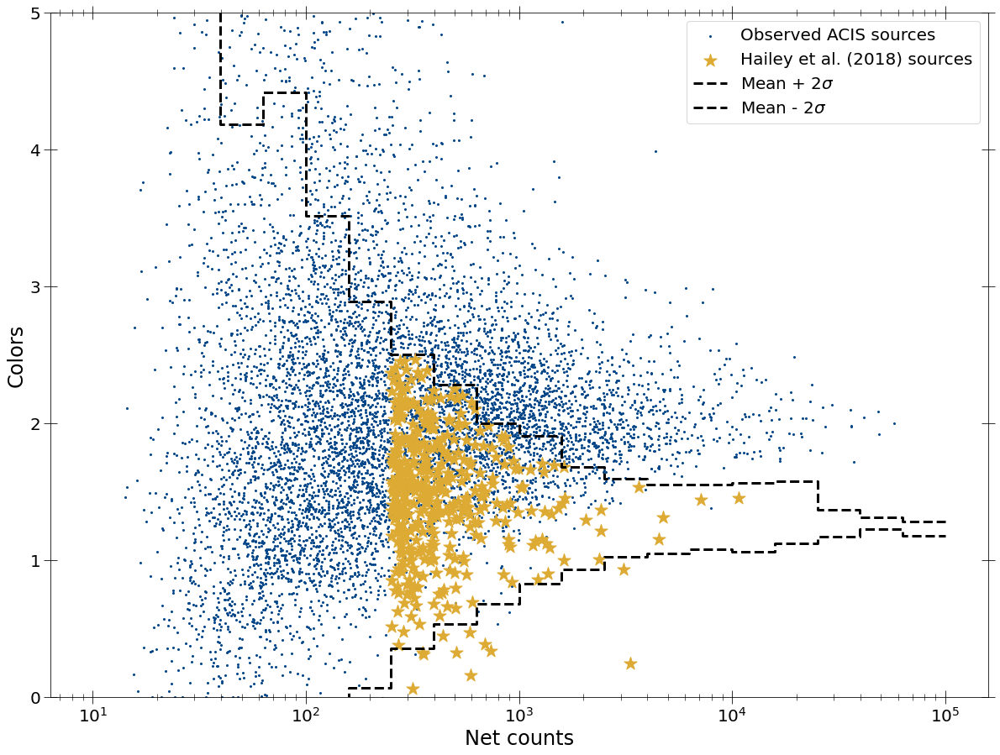

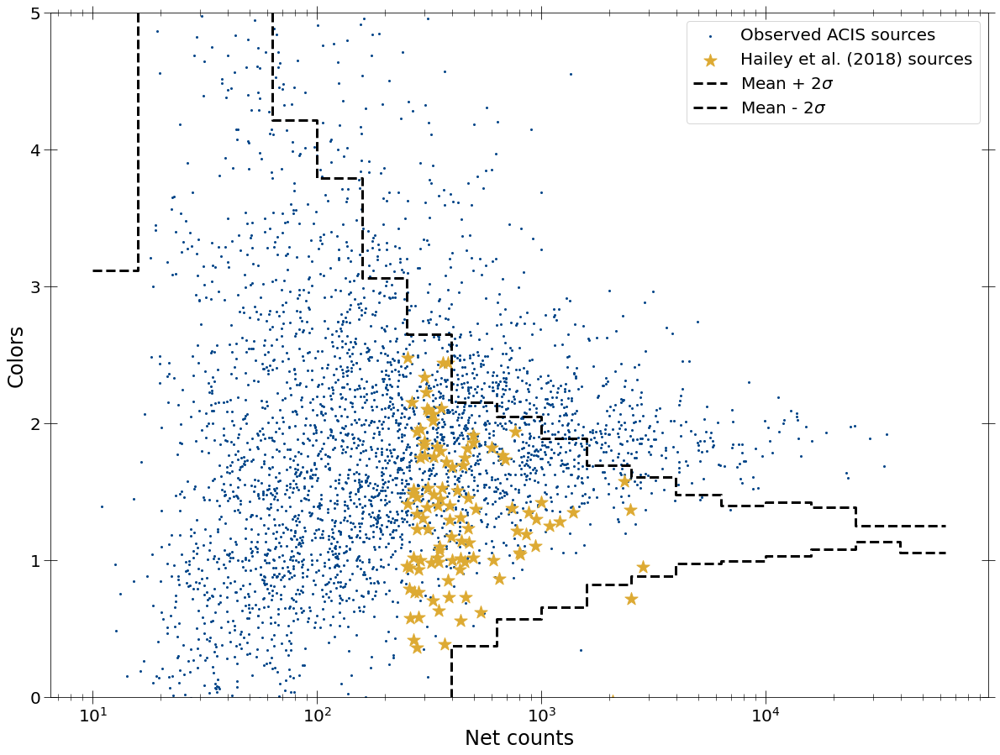

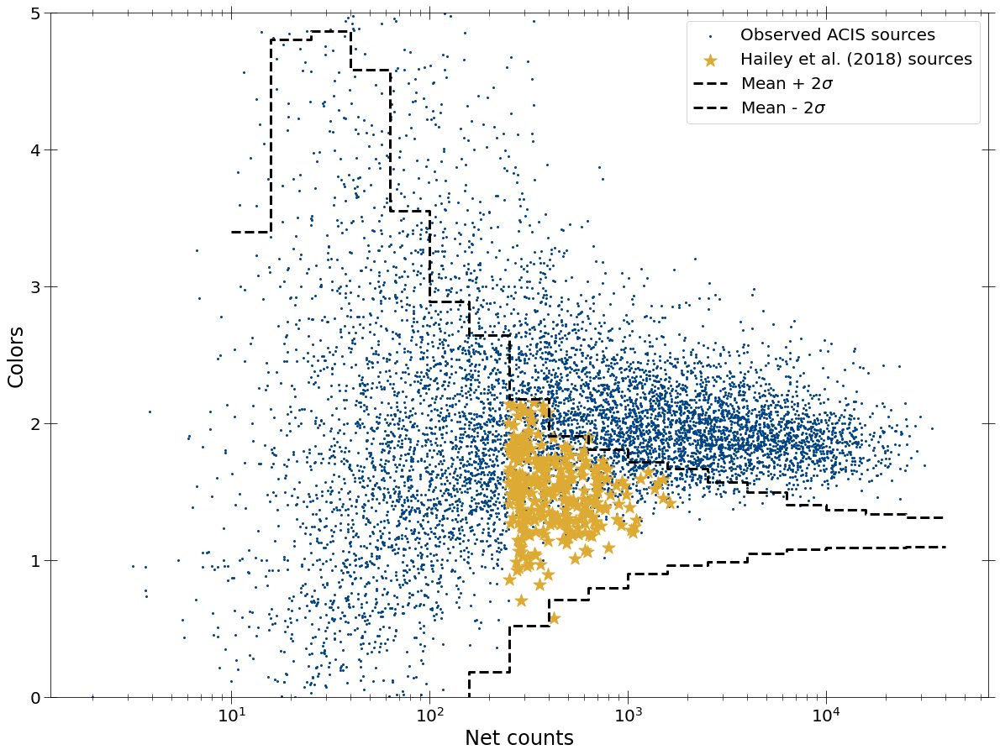

3:80: E501 line too long (82 > 79 characters)
7:80: E501 line too long (82 > 79 characters)
11:80: E501 line too long (82 > 79 characters)


In [209]:
cvs_as_msps_colors_pn, cvs_as_msps_netcounts_pn = mark_interested_srcs(
    sim_msps_color_dict_arr[0], sim_ips_color_dict_arr[0],
    spec_summary_msp_cvs['src_nums'][0], spec_summary_msp_cvs['spec_masks'][1][0],
    cvs_as_msps_pn)
cvs_as_msps_colors_mos, cvs_as_msps_netcounts_mos = mark_interested_srcs(
    sim_msps_color_dict_arr[1], sim_ips_color_dict_arr[1],
    spec_summary_msp_cvs['src_nums'][0], spec_summary_msp_cvs['spec_masks'][1][1],
    cvs_as_msps_mos)
cvs_as_msps_colors_acis, cvs_as_msps_netcounts_acis = mark_interested_srcs(
    sim_msps_color_dict_arr[2], sim_ips_color_dict_arr[2],
    spec_summary_msp_cvs['src_nums'][1], spec_summary_msp_cvs['spec_masks'][1][2],
    cvs_as_msps_acis)

In [275]:
spec_summary_cvs['src_nums'][0]

NameError: name 'spec_summary_cvs' is not defined

In [199]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data')

In [200]:
fit_stats_arr = [[pn_fit_stats_table_pl_cv, pn_fit_stats_table_pl_g_cv,
                  pn_fit_stats_table_pl_g2_cv],
                 [mos_fit_stats_table_pl_cv, mos_fit_stats_table_pl_g_cv,
                  mos_fit_stats_table_pl_g2_cv],
                 [acis_fit_stats_table_pl_cv, acis_fit_stats_table_pl_g_sim,
                  acis_fit_stats_table_pl_g2_sim]]

model_params_arr = [[pn_model_params_table_pl_cv, pn_model_params_table_pl_g_cv,
                     pn_model_params_table_pl_g2_cv],
                    [mos_model_params_table_pl_cv,
                     mos_model_params_table_pl_g_cv,
                     mos_model_params_table_pl_g2_cv],
                    [acis_model_params_table_pl_cv,
                     acis_model_params_table_pl_g_sim,
                     acis_model_params_table_pl_g2_sim]]

det_names = ['PN', 'MOS', 'ACIS']
model_names = ['PL', 'PL_Gauss', 'PL_Gauss3']

for i in range(3):
    for j in range(3):
        fits_file_name = ('Fit_stats_CV_goodobs_' + det_names[i] + '_' + model_names[j] +
                          '.txt')
        model_file_name = ('Model_params_CV_goodobs_' + det_names[i] + '_' + model_names[j] +
                          '.txt')
        print(fits_file_name, model_file_name)
        np.savetxt(fits_file_name, fit_stats_arr[i][j], fmt='%s')
        np.savetxt(model_file_name, model_params_arr[i][j], fmt='%s')

Fit_stats_CV_goodobs_PN_PL.txt Model_params_CV_goodobs_PN_PL.txt
Fit_stats_CV_goodobs_PN_PL_Gauss.txt Model_params_CV_goodobs_PN_PL_Gauss.txt
Fit_stats_CV_goodobs_PN_PL_Gauss3.txt Model_params_CV_goodobs_PN_PL_Gauss3.txt
Fit_stats_CV_goodobs_MOS_PL.txt Model_params_CV_goodobs_MOS_PL.txt
Fit_stats_CV_goodobs_MOS_PL_Gauss.txt Model_params_CV_goodobs_MOS_PL_Gauss.txt
Fit_stats_CV_goodobs_MOS_PL_Gauss3.txt Model_params_CV_goodobs_MOS_PL_Gauss3.txt
Fit_stats_CV_goodobs_ACIS_PL.txt Model_params_CV_goodobs_ACIS_PL.txt
Fit_stats_CV_goodobs_ACIS_PL_Gauss.txt Model_params_CV_goodobs_ACIS_PL_Gauss.txt
Fit_stats_CV_goodobs_ACIS_PL_Gauss3.txt Model_params_CV_goodobs_ACIS_PL_Gauss3.txt


8:80: E501 line too long (80 > 79 characters)
22:80: E501 line too long (89 > 79 characters)
24:80: E501 line too long (93 > 79 characters)
25:27: E128 continuation line under-indented for visual indent


# Checking for CVs detected as MSPs

In [412]:
def get_netcounthist_fraction(netcount_bins_arr, cand_netcounts_arr,
                              int_netcounts_arr, det_names_arr):
    """Get histogram of candidate sources based on a property."""
    interested_srcs_histogram = []
    candidate_srcs_histogram = []
    ratios = []
    err_ratios = []
    for i, netcount_bins in enumerate(netcount_bins_arr):
        print(netcount_bins)
        int_hist = np.histogram(int_netcounts_arr[i], bins=netcount_bins)[0]
        print(int_hist)
        cand_hist = np.histogram(cand_netcounts_arr[i], bins=netcount_bins)[0]
        print(cand_hist)
        ratio = cand_hist/int_hist
        err_ratio = ((cand_hist+1)**-0.5 + (int_hist+1)**-0.5)*ratio
        err_ratio[ratio==0] = 1.0/int_hist[ratio==0]
        print(ratio)
        print(err_ratio)
        
        interested_srcs_histogram.append(int_hist)
        candidate_srcs_histogram.append(cand_hist)
        ratios.append(ratio)
        err_ratios.append(err_ratio)
        
    fig, ax1 = plt.subplots()
    ax1.set_xlabel('Net counts')
    ax1.set_xscale('log')
    ax1.set_xlim(250,2.0E+6)
    ax1.set_ylabel('# of simulated CVs per bin')
    ax1.hist(int_netcounts_arr, bins=netcount_bins,
             color=['#6699cc', '#ee99aa', '#eecc66'])
    ax1.legend(det_names_arr, loc='lower right')
    
    ax2 = ax1.twinx()
    ax2.set_ylabel(r'$p(NL|CV)$')
    ax2.set_ylim(0, 1.0)
    line_colors = ['#004488', '#994455', '#997700']
    for i, netcount_bins in enumerate(netcount_bins_arr):
        ax2.errorbar(0.5*(netcount_bins[1:]+netcount_bins[:-1]),
                     ratios[i],
                     yerr=err_ratios[i], capsize=15, color=line_colors[i],
                     label=det_names_arr[i], capthick=3)
    ax2.legend()
    return (interested_srcs_histogram, candidate_srcs_histogram, ratios,
            err_ratios)

In [418]:
netcount_bins_2 = np.logspace(np.log10(250), 6.3, 6)

In [419]:
netcount_bins_2

array([2.50000000e+02, 1.50782871e+03, 9.09418962e+03, 5.48499206e+04,
       3.30817139e+05, 1.99526231e+06])

In [420]:
set_plotparams('presentation')

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[110  45  12   5   6]
[54 21  6  4  1]
[0.49090909 0.46666667 0.5        0.8        0.16666667]
[0.1127892  0.16829991 0.32765729 0.68436951 0.18084521]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[91 38 10  6  7]
[40  9  6  2  3]
[0.43956044 0.23684211 0.6        0.33333333 0.42857143]
[0.11447515 0.11282114 0.40768549 0.31843825 0.3658086 ]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[117   7   3   3   0]
[70  7  3  3  0]
[0.5982906 1.        1.        1.              nan]
[0.12608114 0.70710678 1.         1.                nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


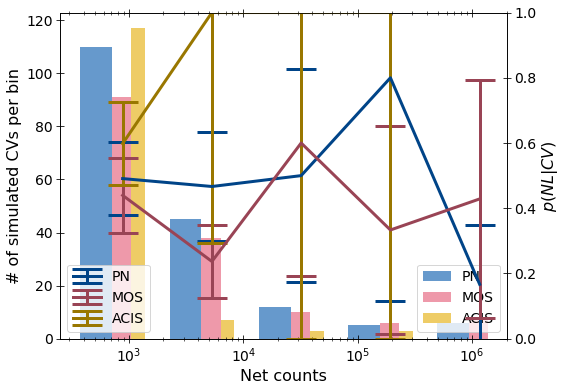

In [421]:
(interested_msp_histogram, candidate_msp_histogram, ratios_msp,
            err_ratios_msp) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [candidate_msp_netcounts_pn, candidate_msp_netcounts_mos,
     candidate_msp_netcounts_acis],
    [interested_msp_netcounts_pn, interested_msp_netcounts_mos,
     interested_msp_netcounts_acis], ['PN', 'MOS', 'ACIS'])

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[975  32   0   0   0]
[157   4   0   0   0]
[0.16102564 0.125             nan        nan        nan]
[0.01796482 0.07766141        nan        nan        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[581  18   0   0   0]
[75  0  0  0  0]
[0.12908778 0.                nan        nan        nan]
[0.02015824 0.05555556        nan        nan        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[954 115   0   0   0]
[278   2   0   0   0]
[0.29140461 0.0173913         nan        nan        nan]
[0.02687557 0.01165562        nan        nan        nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


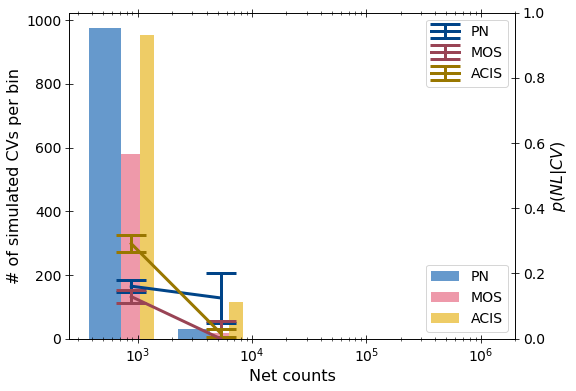

In [422]:
(interested_cvs_histogram, cvs_as_msps_histogram, ratios_cv_as_msp,
            err_ratios_cv_as_msp) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [cvs_as_msps_netcounts_pn, cvs_as_msps_netcounts_mos,
     cvs_as_msps_netcounts_acis],
    [interested_cv_netcounts_pn, interested_cv_netcounts_mos,
     interested_cv_netcounts_acis], ['PN', 'MOS', 'ACIS'])

In [580]:
def get_const(yvals, err):
    nan_yvals = np.isnan(yvals)
    nan_errs = np.isnan(err)
    nan_vals = np.logical_or(nan_yvals, nan_errs)
    return np.sum((yvals/err**2)[~nan_vals])/np.sum((1.0/err**2)[~nan_vals])

In [581]:
get_const(ratios_msp[0], err_ratios_msp[0])

0.48221946585984277

In [582]:
get_const(ratios_msp[1], err_ratios_msp[1])

0.3085203594198758

In [583]:
get_const(ratios_msp[2], err_ratios_msp[2])

0.6104863018305752

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[168  66  17   7   6]
[110  45  12   5   6]
[0.6547619  0.68181818 0.70588235 0.71428571 1.        ]
[0.11294508 0.18556547 0.3749723  0.58941291 0.81649658]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[116  53  12   7   7]
[91 38 10  6  7]
[0.78448276 0.71698113 0.83333333 0.85714286 1.        ]
[0.15507353 0.21479463 0.50408575 0.67389665 0.75592895]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[262  19   4   3   0]
[117   7   3   3   0]
[0.44656489 0.36842105 0.75       1.                nan]
[0.06887381 0.22377166 0.8080127  1.15470054        nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in power
  from ipykernel import kernelapp as app


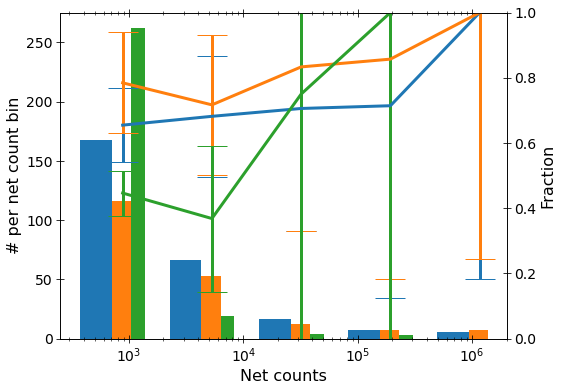

2:13: E127 continuation line over-indented for visual indent
6:80: E501 line too long (80 > 79 characters)


In [584]:
(netcount_obs_histogram, int_obs_histogram, ratios_int_obs,
            err_ratios_int_obs) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [interested_msp_netcounts_pn, interested_msp_netcounts_mos,
     interested_msp_netcounts_acis],
    [spec_summary_msps['counts'][0][0][1], spec_summary_msps['counts'][0][1][1],
     spec_summary_msps['counts'][0][2][1]], ['PN', 'MOS', 'ACIS'])

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[1529  355   37    2    0]
[975  32   0   0   0]
[0.63767168 0.09014085 0.         0.                nan]
[0.03672956 0.02071898        nan        nan        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[872 127  14   0   0]
[581  18   0   0   0]
[0.6662844  0.14173228 0.                nan        nan]
[0.05020537 0.04598333        nan        nan        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[2438 1841  337    0    0]
[954 115   0   0   0]
[0.39130435 0.06246605 0.                nan        nan]
[0.02059392 0.00728084        nan        nan        nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: divide by zero encountered in power
  from ipykernel import kernelapp as app
/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in multiply
  from ipykernel import kernelapp as app


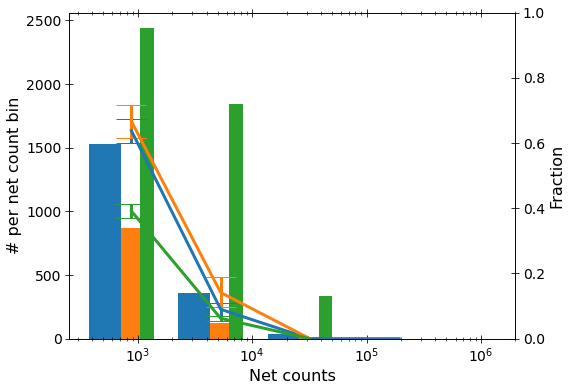

2:13: E127 continuation line over-indented for visual indent


In [585]:
(netcount_cvsim_histogram, int_cvsim_histogram, ratios_int_cvsim,
            err_ratios_int_cvsim) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [interested_cv_netcounts_pn, interested_cv_netcounts_mos,
     interested_cv_netcounts_acis],
    [spec_summary_msp_cvs['counts'][0][0][1],
     spec_summary_msp_cvs['counts'][0][1][1],
     spec_summary_msp_cvs['counts'][0][2][1]], ['PN', 'MOS', 'ACIS'])

In [586]:
def get_cvprob(p_nl_cvsim, p_nl_obs, p1_msp, p1_obs, p1_cv):
    p_nl_cvsim[np.isnan(p_nl_cvsim)] = 0.0
    p1_obs[np.isnan(p1_obs)] = 1.0
    p1_cv[np.isnan(p1_cv)] = 0.0
    return p_nl_cvsim/p_nl_obs*((p1_msp - p1_obs)/(p1_msp - p1_cv))

In [587]:
pn_cvprob1 = get_cvprob(ratios_cv_as_msp[0], 0.31, 0.95, ratios_int_obs[0],
                        ratios_int_cvsim[0])

In [588]:
pn_cvprob2 = get_cvprob(ratios_cv_as_msp[0], ratios_msp[0], 0.95,
                        ratios_int_obs[0], ratios_int_cvsim[0])

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """


In [589]:
mos_cvprob1 = get_cvprob(ratios_cv_as_msp[1], 0.31, 0.95,
                         ratios_int_obs[1], ratios_int_cvsim[1])

In [553]:
mos_cvprob2 = get_cvprob(ratios_cv_as_msp[1], ratios_msp[1], 0.95,
                         ratios_int_obs[1], ratios_int_cvsim[1])

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """


In [554]:
acis_cvprob1 = get_cvprob(ratios_cv_as_msp[2], 0.59, 0.95, ratios_int_obs[2],
           ratios_int_cvsim[2])

2:12: E128 continuation line under-indented for visual indent


In [555]:
acis_cvprob2 = get_cvprob(ratios_cv_as_msp[2], ratios_msp[2], 0.95, ratios_int_obs[2],
           ratios_int_cvsim[2])

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in true_divide
  """
1:80: E501 line too long (86 > 79 characters)
2:12: E128 continuation line under-indented for visual indent


In [560]:
pn_cvprob3*candidate_msp_histogram[0]

array([8.16725979, 1.890625  , 2.16666667, 0.        , 0.        ,
              nan, 0.        ,        nan,        nan,        nan])

In [564]:
pn_cvprob1*candidate_msp_histogram[0]*ratios_int_cvsim[0]/ratios_int_obs[0]

array([34.46392719,  1.84055989,  0.40890751,  0.        ,  0.        ,
        0.        ,  0.        ,  0.        , -0.        , -0.        ])

In [565]:
pn_cvprob2*candidate_msp_histogram[0]*ratios_int_cvsim[0]/ratios_int_obs[0]

array([19.54356846,  1.5361596 ,  0.20915619,  0.        ,  0.        ,
               nan,  0.        ,         nan,         nan,         nan])

In [566]:
mos_cvprob3*candidate_msp_histogram[1]

array([4.56267409, 2.04081633, 0.        , 0.        , 0.        ,
       0.        , 0.        ,        nan, 0.        ,        nan])

In [567]:
mos_cvprob1*candidate_msp_histogram[1]*ratios_int_cvsim[1]/ratios_int_obs[1]

array([ 7.40518108,  1.0912016 ,  0.        ,  0.        , -0.        ,
        0.        ,  0.        , -0.        , -0.        , -0.        ])

In [568]:
mos_cvprob2*candidate_msp_histogram[1]*ratios_int_cvsim[1]/ratios_int_obs[1]

array([ 4.50618982,  0.98879653,  0.        ,  0.        , -0.        ,
        0.        ,  0.        ,         nan, -0.        ,         nan])

In [569]:
acis_cvprob3*candidate_msp_histogram[2]

array([15.06040268,  1.43816254,  0.        ,  0.        ,  0.        ,
        0.        ,         nan,         nan,         nan,         nan])

In [570]:
acis_cvprob1*candidate_msp_histogram[2]*ratios_int_cvsim[2]/ratios_int_obs[2]

array([ 3.17578289e+01,  1.77084254e+00,  3.17389247e-02,  0.00000000e+00,
        0.00000000e+00, -0.00000000e+00, -0.00000000e+00, -0.00000000e+00,
       -0.00000000e+00, -0.00000000e+00])

In [572]:
acis_cvprob2*candidate_msp_histogram[2]*ratios_int_cvsim[2]/ratios_int_obs[2]

array([ 3.05710890e+01,  1.92885618e+00,  1.87259656e-02,  0.00000000e+00,
        0.00000000e+00, -0.00000000e+00,             nan,             nan,
                   nan,             nan])

In [410]:
candidate_msp_histogram

[array([54, 21,  5,  4,  0]),
 array([40,  8,  5,  1,  2]),
 array([70,  7,  2,  0,  0])]

In [122]:
37*0.7

25.9

In [445]:
ratio_msp_msp = [np.array([0.88839779, 0.87845304, 0.84, 1., np.nan]),
                 np.array([0.89150943, 0.87012987, 0.875, 1., np.nan]),
                 np.array([0.89489619, 0.88328267, 0.87857143, np.nan, np.nan])
                ]
err_ratio_msp_msp = [np.array([0.06082695, 0.13456308, 0.34382616, 1.15470054,
                               np.nan]),
                     np.array([0.08903832, 0.20404155, 0.60102588, 1.41421356,
                               np.nan]),
                     np.array([0.0382766, 0.04493553, 0.10831334, np.nan,
                               np.nan])
                ]

In [428]:
def get_cvprob2(p_nl1_cv1, p_nl1, p_nl1_nl1):
    prob = p_nl1_cv1/p_nl1*(p_nl1_nl1 - p_nl1)/(p_nl1_nl1 - p_nl1_cv1)
    prob[prob < 0] = 0
    return prob

In [441]:
ratios_msp

[array([0.49090909, 0.46666667, 0.5       , 0.8       , 0.16666667]),
 array([0.43956044, 0.23684211, 0.6       , 0.33333333, 0.42857143]),
 array([0.5982906, 1.       , 1.       , 1.       ,       nan])]

In [442]:
ratios_cv_as_msp

[array([0.16102564, 0.125     ,        nan,        nan,        nan]),
 array([0.12908778, 0.        ,        nan,        nan,        nan]),
 array([0.29140461, 0.0173913 ,        nan,        nan,        nan])]

In [430]:
get_cvprob2(ratios_cv_as_msp[0], ratios_msp[0], ratio_msp_msp[0])

array([0.1792512 , 0.14639256,        nan,        nan,        nan])

In [464]:
ratios_int_cvsim[0]/ratios_int_obs[0]

array([0.97389857, 0.13220657, 0.        , 0.        , 0.        ])

In [431]:
pn_cvprob3 = get_cvprob2(ratios_cv_as_msp[0], ratios_msp[0], ratio_msp_msp[0])

In [437]:
mos_cvprob3 = get_cvprob2(ratios_cv_as_msp[1], ratios_msp[1], ratio_msp_msp[1])

In [438]:
acis_cvprob3 = get_cvprob2(ratios_cv_as_msp[2], ratios_msp[2], ratio_msp_msp[2])

In [439]:
print(pn_cvprob3)
print(mos_cvprob3)
print(acis_cvprob3)

[0.1792512  0.14639256        nan        nan        nan]
[0.17408475 0.                nan        nan        nan]
[0.23938248 0.                nan        nan        nan]


In [491]:
netcount_bins_2

array([2.50000000e+02, 1.50782871e+03, 9.09418962e+03, 5.48499206e+04,
       3.30817139e+05, 1.99526231e+06])

In [774]:
print(pn_cvprob1)
print(pn_cvprob2)
print(pn_cvprob3)

[ 0.49101456  0.12576226  0.          0.         -0.        ]
[0.3100666  0.08354207 0.         0.                nan]
[0.19904012 0.16326531 0.         0.                nan]


In [591]:
print(mos_cvprob1)
print(mos_cvprob2)
print(mos_cvprob3)

[ 0.2429313  0.         0.         0.        -0.       ]
[ 0.18308003  0.10941857  0.          0.         -0.          0.
  0.                 nan -0.                 nan]
[0.16898793 0.15698587 0.         0.         0.         0.
 0.                nan 0.                nan]


In [592]:
print(acis_cvprob1)
print(acis_cvprob2)
print(acis_cvprob3)

[ 0.52910217  0.17440853  0.02612776  0.          0.         -0.
 -0.         -0.         -0.         -0.        ]
[ 0.50933045  0.18997114  0.01541538  0.          0.         -0.
         nan         nan         nan         nan]
[0.26421759 0.11062789 0.         0.         0.         0.
        nan        nan        nan        nan]


In [443]:
def err_cvprob3(p_nl1_cv1, p_nl1, p_nl1_nl1, e_nl1_cv1, e_nl1, e_nl1_nl1):
    diff_num = p_nl1_nl1 - p_nl1
    diff_num[diff_num < 0] = 0
    err_term1 = (p_nl1_cv1 / p_nl1 * (p_nl1 - p_nl1_cv1) /
                 (p_nl1_nl1 - p_nl1_cv1)**2) * e_nl1_nl1
    err_term2 = (p_nl1_cv1 * p_nl1_nl1 / p_nl1**2 *
                 1.0 / (p_nl1_nl1 - p_nl1_cv1)) * e_nl1
    err_term3 = (p_nl1_nl1 /p_nl1 * diff_num /
                 (p_nl1_nl1 - p_nl1_cv1)**2) * e_nl1_cv1
    return err_term1 + err_term2 + err_term3

In [447]:
pn_cvprob3_err = err_cvprob3(ratios_cv_as_msp[0], ratios_msp[0],
                             ratio_msp_msp[0], err_ratios_cv_as_msp[0],
                             err_ratios_msp[0], err_ratio_msp_msp[0],)
mos_cvprob3_err = err_cvprob3(ratios_cv_as_msp[1], ratios_msp[1],
                              ratio_msp_msp[1], err_ratios_cv_as_msp[1],
                              err_ratios_msp[1], err_ratio_msp_msp[1],)
acis_cvprob3_err = err_cvprob3(ratios_cv_as_msp[2], ratios_msp[2],
                               ratio_msp_msp[2], err_ratios_cv_as_msp[2],
                               err_ratios_msp[2], err_ratio_msp_msp[2])

In [453]:
print(pn_cvprob3)
print(pn_cvprob3_err)
print(pn_cvprob3*candidate_msp_histogram[0])
print(pn_cvprob3_err*candidate_msp_histogram[0])

[0.1792512  0.14639256        nan        nan        nan]
[0.12891315 0.24036172        nan        nan        nan]
[9.67956498 3.07424382        nan        nan        nan]
[6.96131027 5.04759613        nan        nan        nan]


In [454]:
print(mos_cvprob3)
print(mos_cvprob3_err)
print(mos_cvprob3*candidate_msp_histogram[1])
print(mos_cvprob3_err*candidate_msp_histogram[1])

[0.17408475 0.                nan        nan        nan]
[0.1351852  0.17072047        nan        nan        nan]
[6.96339007 0.                nan        nan        nan]
[5.40740817 1.53648425        nan        nan        nan]


In [455]:
print(acis_cvprob3)
print(acis_cvprob3_err)
print(acis_cvprob3*candidate_msp_histogram[2])
print(acis_cvprob3_err*candidate_msp_histogram[2])

[0.23938248 0.                nan        nan        nan]
[0.20065051 0.01356868        nan        nan        nan]
[16.75677366  0.                 nan         nan         nan]
[14.04553556  0.09498077         nan         nan         nan]


In [451]:
def plot_cvestimate(netcount_bins_arr, nl_netcounts_arr, prob, prob_err,
                    det_names_arr=None):
    if det_names_arr is None:
        det_names_arr = ['PN', 'MOS', 'ACIS']
    fig, ax1 = plt.subplots()
    ax1.set_xlabel('Net counts')
    ax1.set_xscale('log')
    ax1.set_xlim(250,2.0E+6)
    ax1.set_ylabel('# of candidate continuum sources per bin')
    ax1.hist(nl_netcounts_arr, bins=netcount_bins_arr[0],
             color=['#6699cc', '#ee99aa', '#eecc66'])
    ax1.legend(det_names_arr, loc='center right')
    
    ax2 = ax1.twinx()
    ax2.set_ylabel(r'$p(CV|NL)$')
    ax2.set_ylim(0, 1.0)
    line_colors = ['#004488', '#994455', '#997700']
    for i, netcount_bins in enumerate(netcount_bins_arr):
        ax2.errorbar(0.5*(netcount_bins[1:]+netcount_bins[:-1]),
                     prob[i],
                     yerr=prob_err[i], capsize=15, color=line_colors[i],
                     label=det_names_arr[i], capthick=3)
    ax2.legend()

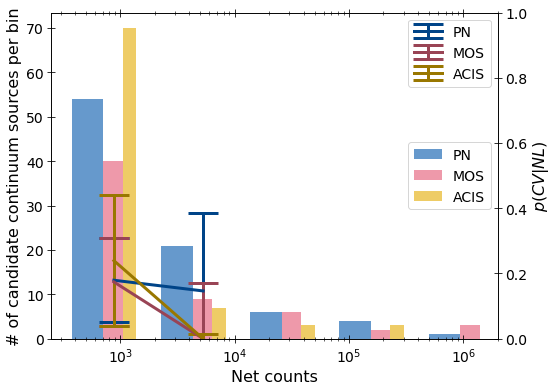

In [452]:
plot_cvestimate(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [candidate_msp_netcounts_pn, candidate_msp_netcounts_mos,
     candidate_msp_netcounts_acis], [pn_cvprob3, mos_cvprob3, acis_cvprob3],
    [pn_cvprob3_err, mos_cvprob3_err, acis_cvprob3_err])

# Spectral Analaysis of simulated MSPs

In [167]:
def get_candidate_src_nums_alldet_sim(spec_summary, sim_color_dict_arr,
                                      min_count_arr=None, min_counts2=None):
    """Get source nums for all detectors."""
    interested_args_alldet = []
    interested_sources_alldet = []
    if min_count_arr is None:
        min_count_arr = [250, 250, 250]
    for i, sim_color_dict in enumerate(sim_color_dict_arr):
        src_nums = np.arange(len(spec_summary['specs'][0][i]))
        interested_args, interested_srcs = get_candidate_src_nums_det(
            src_nums, spec_summary['spec_masks'][0][i],
            sim_color_dict, sim_color_dict, min_count_arr[i], min_counts2)
        interested_args_alldet.append(interested_args)
        interested_sources_alldet.append(interested_srcs)
    return interested_args_alldet, interested_sources_alldet

In [168]:
sim_msp_interested_args_alldet, sim_msp_interested_alldet = get_candidate_src_nums_alldet_sim(
    spec_summary_msps, sim_msps_color_dict_arr, min_count_arr=[150, 150, 150], min_counts2=250)

[1.00000000e+01 1.58489319e+01 2.51188643e+01 3.98107171e+01
 6.30957344e+01 1.00000000e+02 1.58489319e+02 2.51188643e+02
 3.98107171e+02 6.30957344e+02 1.00000000e+03 1.58489319e+03
 2.51188643e+03 3.98107171e+03 6.30957344e+03 1.00000000e+04
 1.58489319e+04 2.51188643e+04 3.98107171e+04 6.30957344e+04
 1.00000000e+05]
[3.65542586 1.82112626 1.93854327 1.55166167 1.66017044 1.54351252
 1.47857829 1.42997489 1.40961659 1.34310455 1.36949341 1.3094684
 1.31091515 1.30237862 1.31805685 1.31716775 1.35103234 1.27131889
 1.27087823 1.23009718]
[7.03523327 2.31283915 2.18961059 1.31711125 1.37887919 0.98627194
 0.70557556 0.53689296 0.43740548 0.33020864 0.26926488 0.18769595
 0.14349454 0.12610196 0.118522   0.12565636 0.11273488 0.04872525
 0.02083223 0.02596428]
250 1.429974886706783 0.5368929553567432
12
251.18864315095823 1.429974886706783 0.5368929553567432
915
398.1071705534973 1.4096165878788645 0.4374054816065335
797
630.957344480193 1.3431045453292159 0.33020864110573095
621
1000.

1:80: E501 line too long (94 > 79 characters)


In [169]:
np.min(sim_msps_color_dict_arr[0]['prop_list'][0][sim_msp_interested_args_alldet[0]])

250.03511664421146

(0.0, 5.0)

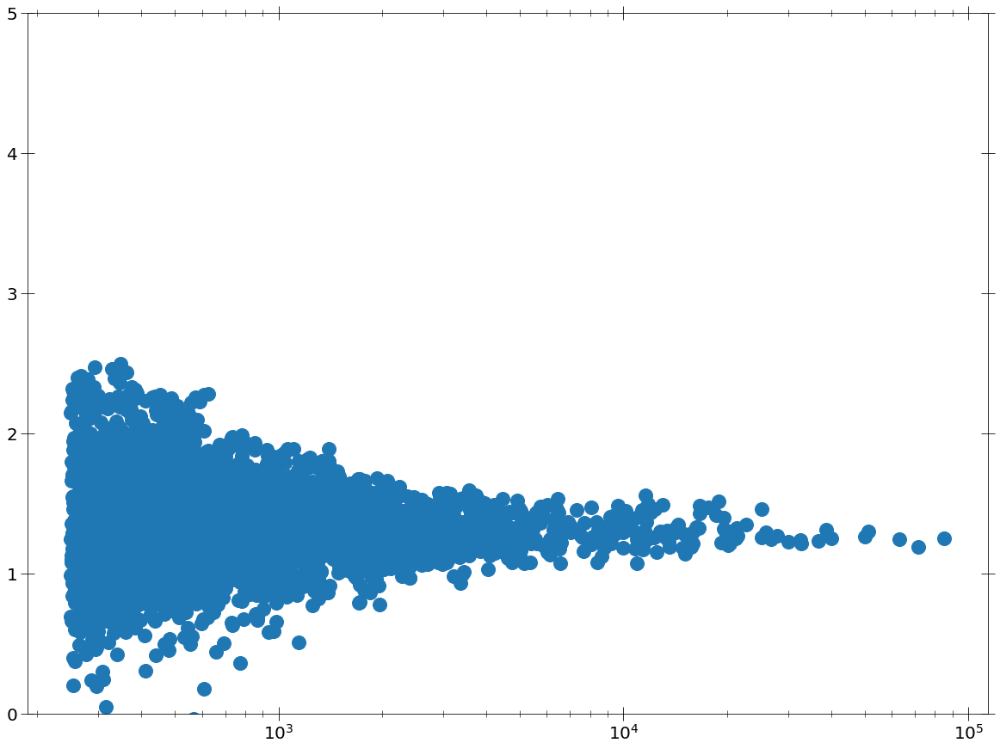

1:80: E501 line too long (90 > 79 characters)
2:80: E501 line too long (84 > 79 characters)


In [181]:
plt.scatter(sim_msps_color_dict_arr[0]['prop_list'][0][sim_msp_interested_args_alldet[0]],
            sim_msps_color_dict_arr[0]['colors'][sim_msp_interested_args_alldet[0]])
plt.xscale('log')
plt.ylim(0, 5)

3533 3533
[1153.59743185 1231.69417453  993.66897159 ...  294.96637941  662.35207356
 1276.97793567]
[1.14622981 1.28440864 1.12616759 ... 0.67887641 1.41104956 1.04125215]
4.0
16.0
1367 1367
[ 631.15361638  255.07316917  280.79625244 ... 6468.43350526  261.70348434
 1628.50656237]
[0.98793715 2.44367522 1.6883964  ... 1.20086    0.97333345 1.30480285]
4.0
16.0
4237 4237
[2916.34833305  472.04436018 1218.44147205 ...  547.72065417  274.29305557
 2072.40840362]
[1.1363335  1.60894857 1.67389626 ... 0.84015745 0.91338743 1.10394894]
4.0
16.0


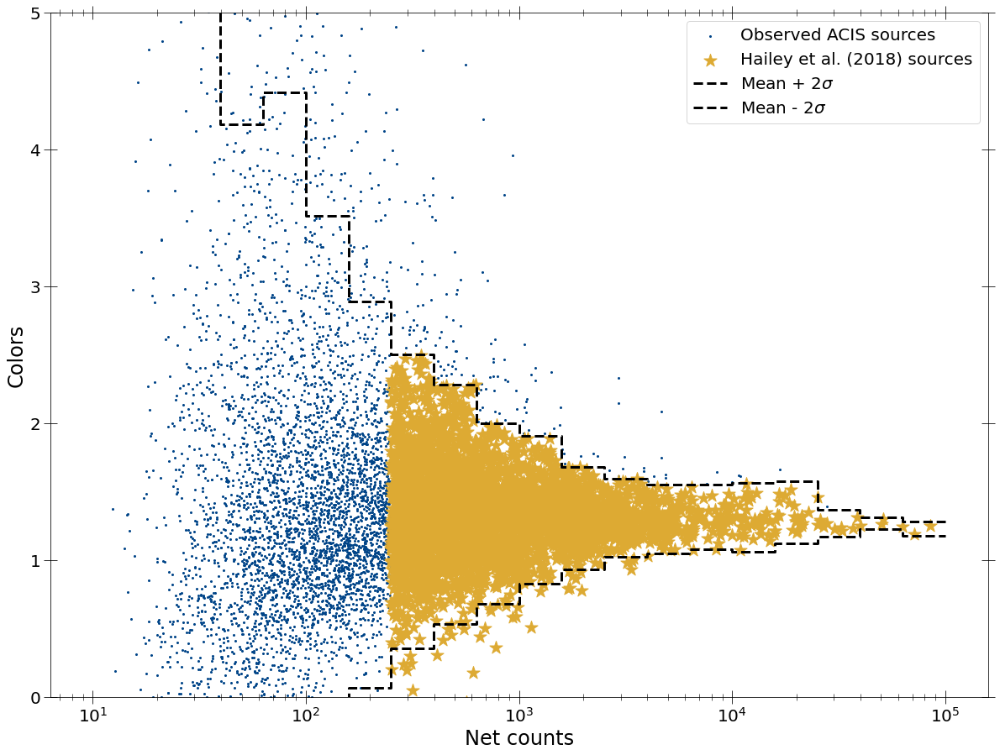

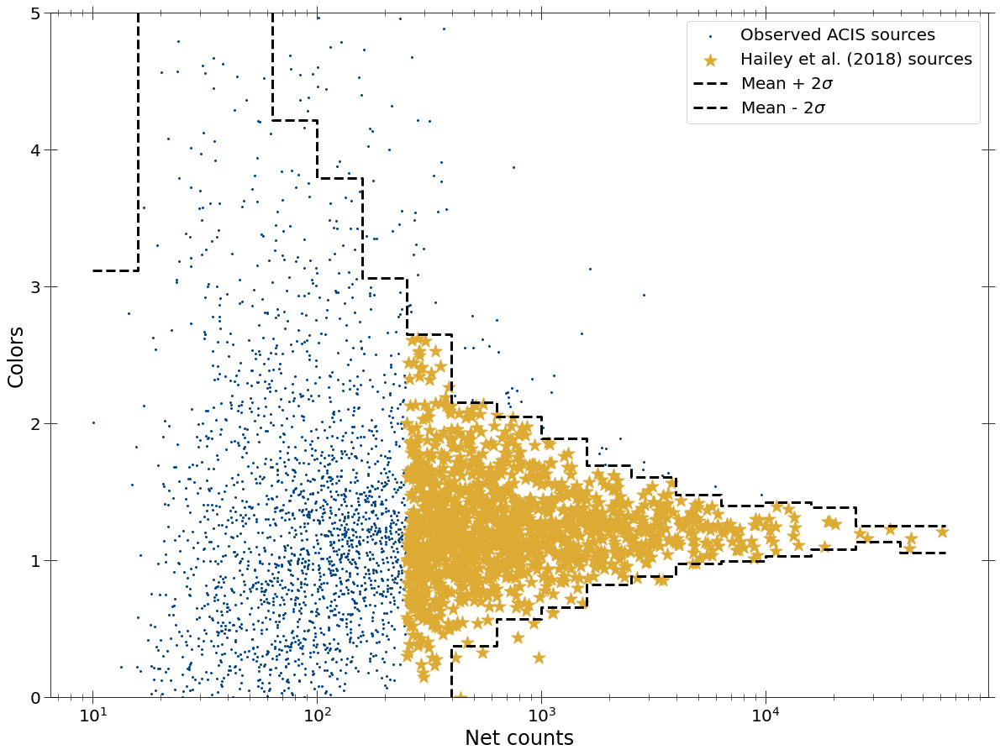

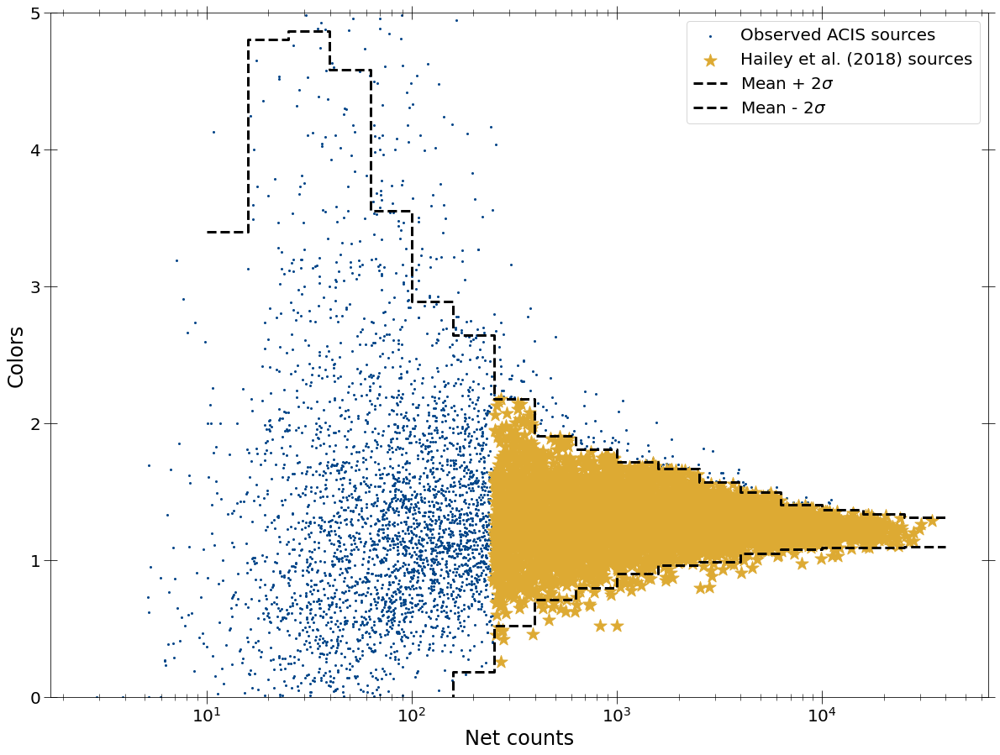

5:80: E501 line too long (81 > 79 characters)
9:80: E501 line too long (83 > 79 characters)


In [210]:
interested_msps_colors_pn, interested_msps_netcounts_pn = mark_interested_srcs(
    sim_msps_color_dict_arr[0], sim_msps_color_dict_arr[0],
    src_nums_xmm_msps, spec_summary_msps['spec_masks'][0][0],
    sim_msp_interested_alldet[0])
interested_msps_colors_mos, interested_msps_netcounts_mos = mark_interested_srcs(
    sim_msps_color_dict_arr[1], sim_msps_color_dict_arr[1],
    src_nums_xmm_msps, spec_summary_msps['spec_masks'][0][1],
    sim_msp_interested_alldet[1])
interested_msps_colors_acis, interested_msps_netcounts_acis = mark_interested_srcs(
    sim_msps_color_dict_arr[2], sim_msps_color_dict_arr[2],
    src_nums_chandra_msps, spec_summary_msps['spec_masks'][0][2],
    sim_msp_interested_alldet[2])

In [182]:
def fit_src_pl_sim(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder + 'msp_highNH_' +
                                 str(source_num) + '_PN.fak')
        spec_mosfile = glob2.glob(src_folder + 'msp_highNH_' +
                                  str(source_num) + '_MOS.fak')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        #os.chdir(src_folder + '/' + source_num)
        spec_file = 'msp_highNH_' + str(source_num) + '.fak'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')

    model = xspec.Model('tbabs*pegpwrlw')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.perform()
    xspec.Fit.error('2.706 2')
    xspec.Fit.perform()
    print('Calculating goodness')
    #goodness = xspec.Fit.goodness(1000)
    print('Finished calculating goodness')
    goodness = 50.0
    print('Model params for ' + str(source_num) +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0])
    print('Fit stats for ' + str(source_num) + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    if telescope == 'Chandra':
        os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0]])

20:9: E265 block comment should start with '# '
38:5: E265 block comment should start with '# '
50:80: E501 line too long (80 > 79 characters)


In [172]:
def fit_src_pl_gauss_sim(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder + 'msp_highNH_' +
                                 str(source_num) + '_PN.fak')
        spec_mosfile = glob2.glob(src_folder + 'msp_highNH_' +
                                  str(source_num) + '_MOS.fak')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        #os.chdir(src_folder + '/' + source_num)
        spec_file = 'msp_highNH_' + str(source_num) + '.fak'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')
    
    model = xspec.Model('tbabs*(pegpwrlw+gauss)')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    model.pegpwrlw.eMin.values = '2.0'
    model.pegpwrlw.eMax.values = '10.0'
    model.gaussian.LineE.values = '6.7, 0.0001, 6.1, 6.1, 7.3, 7.3'
    model.gaussian.Sigma.values = '0.1 0'
    model.gaussian.norm.values = '1.0E-5, 0.001,,,,'
    
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.query = 'yes'
    xspec.Fit.perform()
    xspec.Fit.error('2.706 6')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    #xspec.Fit.error('2.706 6')
    #xspec.Fit.error('2.706 8')
    #goodness = xspec.Fit.goodness(1000)
    goodness = 50.0
    line_pos_low = xspec.AllModels(1).gaussian.LineE.error[0]
    line_pos_high = xspec.AllModels(1).gaussian.LineE.error[1]
    line_norm_low = xspec.AllModels(1).gaussian.norm.error[0]
    line_norm_high = xspec.AllModels(1).gaussian.norm.error[1]
    print('Model params for ' + str(source_num) +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0],
          ' Fe_pos:', xspec.AllModels(1).gaussian.LineE.values[0],
          line_pos_low, line_pos_high,
          ' Fe_norm:', xspec.AllModels(1).gaussian.norm.values[0],
          line_norm_low, line_norm_high)
    print('Fit stats for ' + str(source_num) + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).gaussian.LineE.values[0], line_pos_low,
             line_pos_high,
             xspec.AllModels(1).gaussian.norm.values[0], line_norm_low,
             line_norm_high])


20:9: E265 block comment should start with '# '
27:1: W293 blank line contains whitespace
36:1: W293 blank line contains whitespace
46:5: E265 block comment should start with '# '
47:5: E265 block comment should start with '# '
48:5: E265 block comment should start with '# '
66:80: E501 line too long (80 > 79 characters)


In [183]:
def fit_src_pl_gauss2_sim(source_num, src_folder='./', telescope='XMM'):
    curr_dir = os.getcwd()
    xspec.AllData.clear()
    xspec.plot.xaxis = 'keV'
    xspec.Xset.abund = 'wilm'
    xspec.Xset.parallel.error = 4
    xspec.Xset.parallel.goodness = 4
    if telescope == 'XMM':
        spec_pnfile = glob2.glob(src_folder + 'msp_highNH_' +
                                 str(source_num) + '_PN.fak')
        spec_mosfile = glob2.glob(src_folder + 'msp_highNH_' +
                                  str(source_num) + '_MOS.fak')
        if len(spec_pnfile) > 0:
            spec_pn = xspec.Spectrum(spec_pnfile[0])
            spec_pn.ignore('0.0-2.0, 10.0-**')
        if len(spec_mosfile) > 0:
            spec_mos = xspec.Spectrum(spec_mosfile[0])
            spec_mos.ignore('0.0-2.0, 10.0-**')
    elif telescope == 'Chandra':
        #os.chdir(src_folder + '/' + source_num)
        spec_file = 'msp_highNH_' + str(source_num) + '.fak'
        spec = xspec.Spectrum(spec_file)
        spec.ignore('0.0-2.0, 10.0-**')
        spec.notice('2.0-10.0')
    else:
        print('Telescope not recognized.')
    
    model = xspec.Model('tbabs*(pegpwrlw+gauss+gauss+gauss)')
    model.TBabs.nH.values = [10, 0.001, 0.1, 0.1, 500, 500]
    model.pegpwrlw.PhoIndex.values = [1.0, 0.001, 0, 0, 5, 5]
    model.pegpwrlw.eMin.values = '2.0'
    model.pegpwrlw.eMax.values = '10.0'
    model.gaussian.LineE.values = '6.4 0'
    model.gaussian.Sigma.values = '0.0 0'
    model.gaussian.norm.values = '1.0E-5, 0.001,,,,'
    model.gaussian_4.LineE.values = '6.7 0'
    model.gaussian_4.Sigma.values = '0.0 0'
    model.gaussian_4.norm.values = '1.0E-5, 0.001,,,,'
    model.gaussian_5.LineE.values = '7.0 0'
    model.gaussian_5.Sigma.values = '0.0 0'
    model.gaussian_5.norm.values = '1.0E-5, 0.001,,,,'
    
    xspec.Fit.statMethod = 'cstat'
    xspec.Fit.statTest = 'cvm'
    xspec.Fit.renorm()
    xspec.Fit.query = 'yes'
    xspec.Fit.perform()
    xspec.Fit.error('2.706 8')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 11')
    xspec.Fit.perform()
    xspec.Fit.error('2.706 14')
    # xspec.Fit.error('2.706 8')
    #goodness = xspec.Fit.goodness(1000)
    goodness = 50.0
    line_norm1_low = xspec.AllModels(1).gaussian.norm.error[0]
    line_norm1_high = xspec.AllModels(1).gaussian.norm.error[1]
    line_norm2_low = xspec.AllModels(1).gaussian_4.norm.error[0]
    line_norm2_high = xspec.AllModels(1).gaussian_4.norm.error[1]
    line_norm3_low = xspec.AllModels(1).gaussian_5.norm.error[0]
    line_norm3_high = xspec.AllModels(1).gaussian_5.norm.error[1]
    print('Model params for ' + str(source_num) +
          ': NH = ', xspec.AllModels(1).TBabs.nH.values[0],
          ' Gamma: ', xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
          ' norm: ', xspec.AllModels(1).pegpwrlw.norm.values[0],
          ' Fe_norms:', xspec.AllModels(1).gaussian.norm.values[0],
          line_norm1_low, line_norm1_high,
          xspec.AllModels(1).gaussian_4.norm.values[0], line_norm2_low,
          line_norm2_high, xspec.AllModels(1).gaussian_5.norm.values[0],
          line_norm3_low, line_norm3_high)
    print('Fit stats for ' + str(source_num) + ': ', xspec.Fit.statistic,
          xspec.Fit.testStatistic, goodness, xspec.Fit.dof)
    print('\n')
    os.chdir(curr_dir)
    return ([source_num, xspec.Fit.statistic, xspec.Fit.testStatistic, goodness,
             xspec.Fit.dof],
            [source_num, xspec.AllModels(1).TBabs.nH.values[0],
             xspec.AllModels(1).pegpwrlw.PhoIndex.values[0],
             xspec.AllModels(1).pegpwrlw.norm.values[0],
             xspec.AllModels(1).gaussian.norm.values[0],
             xspec.AllModels(1).gaussian_4.norm.values[0],
             xspec.AllModels(1).gaussian_5.norm.values[0], line_norm1_low,
             line_norm1_high, line_norm2_low, line_norm2_high, line_norm3_low,
             line_norm3_high])


20:9: E265 block comment should start with '# '
27:1: W293 blank line contains whitespace
42:1: W293 blank line contains whitespace
54:5: E265 block comment should start with '# '
75:80: E501 line too long (80 > 79 characters)


In [179]:
sim_msp_interested_alldet[0]

array([   86,  2851,  4553, ..., 14773, 17140, 17593])

In [184]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/xmm_pn_mos_simspecs_goodobs/')
xspec.AllData.clear()
fit_src_pl_sim(sim_msp_interested_alldet[0][1], src_folder='./')

Calculating goodness
Finished calculating goodness
Model params for 2851: NH =  62.986604163743266  Gamma:  0.9827892285185362  norm:  0.8301373668236942
Fit stats for 2851:  167.9267248271682 -7.7913634390641215 50.0 182




([2851, 167.9267248271682, -7.7913634390641215, 50.0, 182],
 [2851, 62.986604163743266, 0.9827892285185362, 0.8301373668236942])

1:80: E501 line too long (96 > 79 characters)


In [185]:
len(sim_msp_interested_alldet[0])

3533

In [186]:
pn_fit_stats_table_pl_msp = []
pn_model_params_table_pl_msp = []

for i, source_num in enumerate(sim_msp_interested_alldet[0]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_sim(source_num)
    pn_fit_stats_table_pl_msp.append(fit_stats)
    pn_model_params_table_pl_msp.append(model_params)

0 86
Calculating goodness
Finished calculating goodness
Model params for 86: NH =  43.909164222956164  Gamma:  3.310164627716554  norm:  0.051491762474387213
Fit stats for 86:  2892.0055103811246 -4.3576897967893675 50.0 2558


1 2851
Calculating goodness
Finished calculating goodness
Model params for 2851: NH =  62.986604163743266  Gamma:  0.9827892285185362  norm:  0.8301373668236942
Fit stats for 2851:  167.9267248271682 -7.7913634390641215 50.0 182


2 4553
Calculating goodness
Finished calculating goodness
Model params for 4553: NH =  13.37565089732361  Gamma:  0.5698356179669399  norm:  0.7882531566220282
Fit stats for 4553:  464.3834692862977 -10.1405261000912 50.0 413


3 5090
Calculating goodness
Finished calculating goodness
Model params for 5090: NH =  75.83686416805686  Gamma:  1.785733869781203  norm:  0.8908185001473293
Fit stats for 5090:  632.2180069130252 -6.453983285135617 50.0 642


4 7306
Calculating goodness
Finished calculating goodness
Model params for 7306: NH =

Calculating goodness
Finished calculating goodness
Model params for 326: NH =  21.741084750529474  Gamma:  1.2832161188462194  norm:  0.6563324084182237
Fit stats for 326:  1160.0178076070765 -8.313271930138116 50.0 1187


37 327
Calculating goodness
Finished calculating goodness
Model params for 327: NH =  18.014403008153014  Gamma:  1.8017975340651122  norm:  0.297198303221373
Fit stats for 327:  373.5417554682518 -8.03651509262002 50.0 351


38 397
Calculating goodness
Finished calculating goodness
Model params for 397: NH =  11.85526119234969  Gamma:  0.5892775264222144  norm:  0.016469300162589254
Fit stats for 397:  2960.8379589554825 -5.609776373838949 50.0 2852


39 416
Calculating goodness
Finished calculating goodness
Model params for 416: NH =  7.10779373955907  Gamma:  1.0333560122716967  norm:  0.1062363388027035
Fit stats for 416:  313.09167031420134 -8.646889579261943 50.0 290


40 429
Calculating goodness
Finished calculating goodness
Model params for 429: NH =  27.8730

Calculating goodness
Finished calculating goodness
Model params for 1266: NH =  10.107913663068748  Gamma:  1.1246956251460625  norm:  0.18195132198157593
Fit stats for 1266:  313.83168699196773 -8.513667988727605 50.0 239


73 1297
Calculating goodness
Finished calculating goodness
Model params for 1297: NH =  17.263073855914183  Gamma:  1.1542489284960615  norm:  1.2426565845788946
Fit stats for 1297:  121.36433781595503 -7.937014585700404 50.0 132


74 1306
Calculating goodness
Finished calculating goodness
Model params for 1306: NH =  26.804677856118317  Gamma:  1.1968414116988548  norm:  0.2511759143145075
Fit stats for 1306:  667.3882694845067 -7.8047006861260835 50.0 633


75 1324
Calculating goodness
Finished calculating goodness
Model params for 1324: NH =  101.25758378756463  Gamma:  1.089986423733858  norm:  0.19442298395281726
Fit stats for 1324:  1907.7366550440236 -5.415491875246075 50.0 1693


76 1335
Calculating goodness
Finished calculating goodness
Model params for 13

Calculating goodness
Finished calculating goodness
Model params for 1976: NH =  46.8345738908444  Gamma:  1.8505659478560512  norm:  1.282517200290537
Fit stats for 1976:  1345.496009707099 -7.552932253672144 50.0 1439


109 1983
Calculating goodness
Finished calculating goodness
Model params for 1983: NH =  21.097213966590704  Gamma:  1.5757102797561653  norm:  0.9326868917131024
Fit stats for 1983:  33.440964298787605 -10.023254060077189 50.0 57


110 2012
Calculating goodness
Finished calculating goodness
Model params for 2012: NH =  18.2828812990446  Gamma:  1.8361630717603679  norm:  0.7306264772222154
Fit stats for 2012:  2285.217702623413 -8.568400815140397 50.0 2697


111 2038
Calculating goodness
Finished calculating goodness
Model params for 2038: NH =  15.787359366936519  Gamma:  1.0583927703618674  norm:  0.6498788126988551
Fit stats for 2038:  92.2336370599778 -8.965206372415958 50.0 85


112 2042
Calculating goodness
Finished calculating goodness
Model params for 2042: NH

Calculating goodness
Finished calculating goodness
Model params for 2723: NH =  16.74056658883684  Gamma:  1.4002069169405085  norm:  0.32147680068352325
Fit stats for 2723:  222.29885480894933 -8.916488292556176 50.0 195


145 2740
Calculating goodness
Finished calculating goodness
Model params for 2740: NH =  27.882205709424593  Gamma:  0.5203748862119201  norm:  0.28468967386630206
Fit stats for 2740:  436.4451558984356 -6.8483223569621545 50.0 431


146 2757
Calculating goodness
Finished calculating goodness
Model params for 2757: NH =  59.893440618218776  Gamma:  1.8507945049588235  norm:  0.16756069167066295
Fit stats for 2757:  1769.6456021192698 -4.890534249993971 50.0 1625


147 2770
Calculating goodness
Finished calculating goodness
Model params for 2770: NH =  21.45243031707865  Gamma:  1.5755904308587527  norm:  0.18748861988529916
Fit stats for 2770:  638.6563399629067 -8.138494673224873 50.0 660


148 2779
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 3660: NH =  64.64410464744299  Gamma:  1.8013639508753618  norm:  0.33021889881466854
Fit stats for 3660:  565.5450161776305 -7.812326739410629 50.0 553


181 3705
Calculating goodness
Finished calculating goodness
Model params for 3705: NH =  8.782365860696402  Gamma:  0.9912522957853372  norm:  0.22661280779651138
Fit stats for 3705:  382.9923767615311 -8.086742112719666 50.0 360


182 3771
Calculating goodness
Finished calculating goodness
Model params for 3771: NH =  9.84932081650659  Gamma:  0.9490538317094106  norm:  0.48321934765054037
Fit stats for 3771:  83.0941097172729 -8.68689593976916 50.0 77


183 3791
Calculating goodness
Finished calculating goodness
Model params for 3791: NH =  38.24467632924477  Gamma:  0.8528943828454674  norm:  0.09527581770908901
Fit stats for 3791:  2842.7478198311205 -5.873641825255143 50.0 2552


184 3795
Calculating goodness
Finished calculating goodness
Model params for 3795: 

Calculating goodness
Finished calculating goodness
Model params for 4463: NH =  8.495978003766277  Gamma:  0.9305900304240463  norm:  0.4867502821557621
Fit stats for 4463:  220.77376483573875 -8.886405821237835 50.0 212


217 4464
Calculating goodness
Finished calculating goodness
Model params for 4464: NH =  31.243735057040507  Gamma:  1.9422216860340393  norm:  0.519103387752179
Fit stats for 4464:  188.6434615367648 -8.241964840667599 50.0 194


218 4474
Calculating goodness
Finished calculating goodness
Model params for 4474: NH =  18.22251199057395  Gamma:  1.5651491610128092  norm:  0.14383578545994596
Fit stats for 4474:  487.5295398226519 -8.376835326983613 50.0 476


219 4500
Calculating goodness
Finished calculating goodness
Model params for 4500: NH =  18.257324179538198  Gamma:  2.1909603932886728  norm:  0.3586378706600129
Fit stats for 4500:  330.6161271094429 -8.026053968180902 50.0 339


220 4522
Calculating goodness
Finished calculating goodness
Model params for 4522:

Calculating goodness
Finished calculating goodness
Model params for 5253: NH =  14.238251629054593  Gamma:  2.4780101509524344  norm:  0.0911433043504102
Fit stats for 5253:  840.1522122219384 -6.698658532595636 50.0 746


253 5297
Calculating goodness
Finished calculating goodness
Model params for 5297: NH =  38.63305734421301  Gamma:  1.191680386156511  norm:  0.2407511888279484
Fit stats for 5297:  230.4368640795853 -7.732666376133639 50.0 233


254 5340
Calculating goodness
Finished calculating goodness
Model params for 5340: NH =  7.058387283068183  Gamma:  0.8074054191984587  norm:  0.5478036374712976
Fit stats for 5340:  354.42651697147676 -8.26051848682126 50.0 320


255 5402
Calculating goodness
Finished calculating goodness
Model params for 5402: NH =  39.502622576361944  Gamma:  2.134720721687156  norm:  1.1641915847657291
Fit stats for 5402:  513.5310846736093 -8.146607788816565 50.0 476


256 5420
Calculating goodness
Finished calculating goodness
Model params for 5420: NH

Calculating goodness
Finished calculating goodness
Model params for 6094: NH =  50.180579620241566  Gamma:  1.0440300476780655  norm:  0.4459119711249928
Fit stats for 6094:  385.5347277383878 -6.773590065338048 50.0 330


289 6099
Calculating goodness
Finished calculating goodness
Model params for 6099: NH =  64.877812622661  Gamma:  1.9548219774083295  norm:  0.647752773627068
Fit stats for 6099:  233.42194883424565 -8.228148500537166 50.0 239


290 6105
Calculating goodness
Finished calculating goodness
Model params for 6105: NH =  20.760232855307756  Gamma:  2.197553936409567  norm:  0.24019123155010352
Fit stats for 6105:  293.7364134626903 -8.031660623632721 50.0 260


291 6112
Calculating goodness
Finished calculating goodness
Model params for 6112: NH =  20.83406908553696  Gamma:  1.8718732817761814  norm:  0.12764258072173626
Fit stats for 6112:  755.917493779184 -8.096130695912448 50.0 724


292 6116
Calculating goodness
Finished calculating goodness
Model params for 6116: NH

Calculating goodness
Finished calculating goodness
Model params for 7035: NH =  11.2472594519709  Gamma:  1.5824342239008289  norm:  0.4814177741522227
Fit stats for 7035:  182.95740652027612 -9.073700981598959 50.0 175


325 7048
Calculating goodness
Finished calculating goodness
Model params for 7048: NH =  25.271678408846213  Gamma:  1.2125059446977275  norm:  1.1099597812793751
Fit stats for 7048:  397.4863659706702 -7.530166437846289 50.0 391


326 7069
Calculating goodness
Finished calculating goodness
Model params for 7069: NH =  10.30812968255516  Gamma:  1.294064719868921  norm:  0.08786809355135963
Fit stats for 7069:  506.48014881673845 -8.233394227974737 50.0 453


327 7079
Calculating goodness
Finished calculating goodness
Model params for 7079: NH =  0.10000087574097274  Gamma:  0.12462522862437775  norm:  0.00631946067193615
Fit stats for 7079:  3002.9002102588975 -3.8960226350094964 50.0 2713


328 7082
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 7805: NH =  10.003684617136527  Gamma:  1.4357180900310034  norm:  0.4928436783590943
Fit stats for 7805:  417.59183622831347 -7.602565291386831 50.0 374


361 7822
Calculating goodness
Finished calculating goodness
Model params for 7822: NH =  8.74460161818138  Gamma:  1.4707058580745884  norm:  0.3398236768279814
Fit stats for 7822:  154.70414349955485 -8.663168594529548 50.0 139


362 7832
Calculating goodness
Finished calculating goodness
Model params for 7832: NH =  4.54956595640863  Gamma:  0.7361574941147799  norm:  0.07796011947224686
Fit stats for 7832:  751.0332087540183 -5.848028936847583 50.0 705


363 7857
Calculating goodness
Finished calculating goodness
Model params for 7857: NH =  22.58812333863196  Gamma:  1.7533171928217341  norm:  1.5352333819013213
Fit stats for 7857:  86.07563479392175 -9.611331458000128 50.0 85


364 7872
Calculating goodness
Finished calculating goodness
Model params for 7872: N

Calculating goodness
Finished calculating goodness
Model params for 8529: NH =  21.198488981544696  Gamma:  1.3984918528753796  norm:  0.07623936342286014
Fit stats for 8529:  2064.443175294708 -6.506273756361255 50.0 1822


397 8549
Calculating goodness
Finished calculating goodness
Model params for 8549: NH =  14.616260372816216  Gamma:  2.420444152069524  norm:  0.5225068650367046
Fit stats for 8549:  518.8527622169553 -6.900837443198919 50.0 505


398 8570
Calculating goodness
Finished calculating goodness
Model params for 8570: NH =  7.827647374670373  Gamma:  1.596593215105962  norm:  0.09662890523939476
Fit stats for 8570:  696.9462091177171 -7.398797982122773 50.0 646


399 8573
Calculating goodness
Finished calculating goodness
Model params for 8573: NH =  54.77571685801864  Gamma:  1.4773271006216757  norm:  0.7645266867245558
Fit stats for 8573:  825.7321209016417 -8.18859898715269 50.0 748


400 8576
Calculating goodness
Finished calculating goodness
Model params for 8576: 

Calculating goodness
Finished calculating goodness
Model params for 9207: NH =  10.97320337736016  Gamma:  1.3988989631614404  norm:  0.07290786603224628
Fit stats for 9207:  963.0389584132312 -7.300932611499756 50.0 883


433 9233
Calculating goodness
Finished calculating goodness
Model params for 9233: NH =  10.522403493210785  Gamma:  1.7531057500635914  norm:  0.9823030668818226
Fit stats for 9233:  67.62147001022389 -8.959079080128909 50.0 77


434 9254
Calculating goodness
Finished calculating goodness
Model params for 9254: NH =  17.8846379993277  Gamma:  1.9955377260697527  norm:  0.38898171908313833
Fit stats for 9254:  271.3119507750357 -8.32989606038765 50.0 208


435 9330
Calculating goodness
Finished calculating goodness
Model params for 9330: NH =  12.476310522375686  Gamma:  1.628208579158293  norm:  0.11621872822921527
Fit stats for 9330:  1945.2357882892056 -6.0376127078221575 50.0 1730


436 9375
Calculating goodness
Finished calculating goodness
Model params for 9375

Calculating goodness
Finished calculating goodness
Model params for 9920: NH =  9.53633554716548  Gamma:  1.4183588434033136  norm:  0.501844676396158
Fit stats for 9920:  461.1644678425797 -9.156492393272211 50.0 457


469 9936
Calculating goodness
Finished calculating goodness
Model params for 9936: NH =  17.285376953549296  Gamma:  1.89500445669585  norm:  0.9085074909073194
Fit stats for 9936:  72.59408668582697 -8.249103077739331 50.0 75


470 9951
Calculating goodness
Finished calculating goodness
Model params for 9951: NH =  21.285888807692082  Gamma:  1.0029442302623268  norm:  0.3666434400884631
Fit stats for 9951:  304.76722961559443 -9.291852336357683 50.0 291


471 9978
Calculating goodness
Finished calculating goodness
Model params for 9978: NH =  53.04043380489806  Gamma:  1.3345394253950122  norm:  0.2790857545283265
Fit stats for 9978:  2177.6749018895907 -6.439354911626026 50.0 1918


472 10034
Calculating goodness
Finished calculating goodness
Model params for 10034: 

Calculating goodness
Finished calculating goodness
Model params for 10749: NH =  10.115187618203217  Gamma:  2.117026130340215  norm:  0.5563016474051292
Fit stats for 10749:  495.3152369448318 -8.740680584496081 50.0 457


504 10769
Calculating goodness
Finished calculating goodness
Model params for 10769: NH =  43.37888293225108  Gamma:  0.944124851128766  norm:  0.35620695387812173
Fit stats for 10769:  400.2308122587883 -7.540541847941259 50.0 382


505 10845
Calculating goodness
Finished calculating goodness
Model params for 10845: NH =  39.676942845215734  Gamma:  2.341574414645244  norm:  1.2966304236770116
Fit stats for 10845:  203.73826842384642 -7.381854005051823 50.0 207


506 10854
Calculating goodness
Finished calculating goodness
Model params for 10854: NH =  82.74294060148402  Gamma:  2.2460853962249714  norm:  0.3141258185124406
Fit stats for 10854:  1940.6250402290868 -7.139976868090813 50.0 1766


507 10897
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 11584: NH =  24.927013960648882  Gamma:  2.0388119064442076  norm:  0.627938213655934
Fit stats for 11584:  82.85942001334011 -7.531331221499965 50.0 72


539 11586
Calculating goodness
Finished calculating goodness
Model params for 11586: NH =  13.949760287237886  Gamma:  1.2518115720862635  norm:  0.09783768088670744
Fit stats for 11586:  1227.8561008064987 -6.555389155411737 50.0 1138


540 11599
Calculating goodness
Finished calculating goodness
Model params for 11599: NH =  12.272445761419721  Gamma:  0.906049108529339  norm:  0.058321698539555884
Fit stats for 11599:  711.6983156518927 -7.628389845882494 50.0 666


541 11608
Calculating goodness
Finished calculating goodness
Model params for 11608: NH =  10.840512955953443  Gamma:  2.5801881355483105  norm:  0.07993250228577214
Fit stats for 11608:  507.5905362720958 -7.4484091413093 50.0 455


542 11614
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 12392: NH =  17.870401952584345  Gamma:  2.529094052458288  norm:  0.9148748362422061
Fit stats for 12392:  72.08988543236684 -9.665103262931968 50.0 95


574 12396
Calculating goodness
Finished calculating goodness
Model params for 12396: NH =  15.105874300154797  Gamma:  2.451739047259397  norm:  0.5901184464379566
Fit stats for 12396:  449.1560968160243 -8.32216455350811 50.0 367


575 12412
Calculating goodness
Finished calculating goodness
Model params for 12412: NH =  81.54123773004544  Gamma:  1.50840472400939  norm:  1.1872365640193416
Fit stats for 12412:  204.76036859751437 -8.321525167780294 50.0 215


576 12422
Calculating goodness
Finished calculating goodness
Model params for 12422: NH =  52.71687773407184  Gamma:  1.4444182665080345  norm:  0.7458182086020472
Fit stats for 12422:  379.6440944880818 -8.290844633675297 50.0 351


577 12445
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 13058: NH =  8.041151714451473  Gamma:  0.30644055886158394  norm:  0.060891893280044795
Fit stats for 13058:  1167.6525951207059 -5.646838134402601 50.0 1056


609 13092
Calculating goodness
Finished calculating goodness
Model params for 13092: NH =  35.34836579664518  Gamma:  2.4346054856598784  norm:  0.2891809262443263
Fit stats for 13092:  389.0317353187352 -8.313870537720948 50.0 358


610 13139
Calculating goodness
Finished calculating goodness
Model params for 13139: NH =  13.931817988349142  Gamma:  2.1486646472001443  norm:  0.07691923941065038
Fit stats for 13139:  1108.0591325968323 -7.034113482787187 50.0 911


611 13190
Calculating goodness
Finished calculating goodness
Model params for 13190: NH =  51.045396895140854  Gamma:  0.7667988670633257  norm:  0.2104722664371097
Fit stats for 13190:  911.5848616461889 -7.3351507049633575 50.0 857


612 13221
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 14046: NH =  53.625553392656045  Gamma:  0.8728327319988285  norm:  0.6872057303770546
Fit stats for 14046:  369.97684665158766 -7.7002721200957005 50.0 355


644 14094
Calculating goodness
Finished calculating goodness
Model params for 14094: NH =  8.195144190102772  Gamma:  1.5246213279635956  norm:  0.1705610031514373
Fit stats for 14094:  175.50258299722995 -7.691014468822029 50.0 169


645 14107
Calculating goodness
Finished calculating goodness
Model params for 14107: NH =  16.725174457210763  Gamma:  2.0790089892964474  norm:  0.10549459013696227
Fit stats for 14107:  1605.4942367954961 -7.191540156449149 50.0 1501


646 14126
Calculating goodness
Finished calculating goodness
Model params for 14126: NH =  22.889438347195977  Gamma:  0.9860035316612843  norm:  0.06315926477864947
Fit stats for 14126:  1584.1904287128184 -5.991214395883207 50.0 1513


647 14131
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 14929: NH =  22.7565695738155  Gamma:  2.6680238098663427  norm:  0.7878334805327512
Fit stats for 14929:  101.28559453075057 -8.733474865532964 50.0 108


679 14952
Calculating goodness
Finished calculating goodness
Model params for 14952: NH =  4.977503438519127  Gamma:  0.8205461439564224  norm:  0.3266589514069501
Fit stats for 14952:  63.308072559336246 -9.090564638570514 50.0 62


680 14972
Calculating goodness
Finished calculating goodness
Model params for 14972: NH =  7.202777957583037  Gamma:  0.6863600096227067  norm:  0.05202290114026217
Fit stats for 14972:  734.2133899643935 -8.215510455906115 50.0 750


681 14973
Calculating goodness
Finished calculating goodness
Model params for 14973: NH =  10.30997958160453  Gamma:  0.8051701409048189  norm:  0.5389523377609332
Fit stats for 14973:  936.7957499764716 -8.991601001553061 50.0 872


682 15067
Calculating goodness
Finished calculating goodness
Model params

Calculating goodness
Finished calculating goodness
Model params for 15692: NH =  22.847623575480043  Gamma:  1.6884260670806492  norm:  0.19738796982906254
Fit stats for 15692:  235.1073340161816 -8.142676607255279 50.0 256


714 15695
Calculating goodness
Finished calculating goodness
Model params for 15695: NH =  72.08984721149815  Gamma:  1.5401080484600287  norm:  1.36644401167072
Fit stats for 15695:  1596.5445526250828 -7.682358736500825 50.0 1560


715 15720
Calculating goodness
Finished calculating goodness
Model params for 15720: NH =  5.572119780516421  Gamma:  1.5452647124133145  norm:  0.5955730399388418
Fit stats for 15720:  581.0241518573239 -8.750170239387964 50.0 581


716 15728
Calculating goodness
Finished calculating goodness
Model params for 15728: NH =  22.922519632009866  Gamma:  1.5751636429813796  norm:  0.42049470380028503
Fit stats for 15728:  134.8118853370569 -8.49257167614456 50.0 101


717 15765
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 16488: NH =  40.304564340801136  Gamma:  1.0239806042367783  norm:  0.40813203920707547
Fit stats for 16488:  207.66270903460833 -8.745173702601049 50.0 225


749 16540
Calculating goodness
Finished calculating goodness
Model params for 16540: NH =  26.499647320081262  Gamma:  3.0168377149752184  norm:  0.3769222875117935
Fit stats for 16540:  2052.9636957893467 -8.518032562129306 50.0 1834


750 16550
Calculating goodness
Finished calculating goodness
Model params for 16550: NH =  7.345573210619619  Gamma:  1.093542274007494  norm:  0.09448249458399312
Fit stats for 16550:  648.4507503840126 -5.953284555917686 50.0 629


751 16562
Calculating goodness
Finished calculating goodness
Model params for 16562: NH =  12.608892821523082  Gamma:  2.4718529069815887  norm:  0.43863059547821687
Fit stats for 16562:  220.47578247065886 -8.646911137031681 50.0 233


752 16601
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 17273: NH =  40.73351825270401  Gamma:  1.7841668160497925e-06  norm:  0.12322363413980261
Fit stats for 17273:  997.0901987941623 -7.737380678789134 50.0 911


784 17289
Calculating goodness
Finished calculating goodness
Model params for 17289: NH =  31.468883094140235  Gamma:  2.482226721921998  norm:  0.5219580324834641
Fit stats for 17289:  356.69872686760806 -6.939104222852889 50.0 291


785 17290
Calculating goodness
Finished calculating goodness
Model params for 17290: NH =  91.09031208485833  Gamma:  2.6761237085745058  norm:  0.9999911817102066
Fit stats for 17290:  336.9597793427474 -7.552909146147831 50.0 359


786 17312
Calculating goodness
Finished calculating goodness
Model params for 17312: NH =  35.9032221123798  Gamma:  0.6346009293962079  norm:  0.7956411196184837
Fit stats for 17312:  110.59426700772508 -7.906520140290905 50.0 117


787 17314
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 17861: NH =  22.792662154594055  Gamma:  1.7729574162432322  norm:  0.3968981598769498
Fit stats for 17861:  244.42399328554717 -8.720187630645725 50.0 194


819 17871
Calculating goodness
Finished calculating goodness
Model params for 17871: NH =  67.81220735720449  Gamma:  1.7227504492454844  norm:  0.6676497126241949
Fit stats for 17871:  351.7332753764474 -6.834459835167574 50.0 366


820 17920
Calculating goodness
Finished calculating goodness
Model params for 17920: NH =  31.193665568826756  Gamma:  0.8838659243809992  norm:  0.13083940870364216
Fit stats for 17920:  586.9179998505467 -6.262184307548467 50.0 553


821 17924
Calculating goodness
Finished calculating goodness
Model params for 17924: NH =  79.17949651310813  Gamma:  2.1774710488983167  norm:  0.7165932929773945
Fit stats for 17924:  348.4038607067935 -8.324345974248473 50.0 328


822 17992
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 18495: NH =  20.07829139789197  Gamma:  3.7337063541647484  norm:  0.08911396577538641
Fit stats for 18495:  3197.7031081118694 -5.034221437235636 50.0 2825


854 18528
Calculating goodness
Finished calculating goodness
Model params for 18528: NH =  9.459618295966164  Gamma:  0.33417520964307273  norm:  0.24699672523951577
Fit stats for 18528:  238.57897773000474 -9.409325227674776 50.0 214


855 18550
Calculating goodness
Finished calculating goodness
Model params for 18550: NH =  75.15604971944424  Gamma:  1.3043948247755395  norm:  1.0048126080912672
Fit stats for 18550:  226.82376429919697 -8.975650151387844 50.0 203


856 18572
Calculating goodness
Finished calculating goodness
Model params for 18572: NH =  33.40653567365747  Gamma:  1.782636912094967  norm:  1.3155449111355833
Fit stats for 18572:  242.3178002639466 -8.486841288600212 50.0 240


857 18582
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 19131: NH =  25.755413540090693  Gamma:  1.3608298873270193  norm:  0.2945449209582216
Fit stats for 19131:  92.49647454049466 -8.536283123529126 50.0 89


889 19134
Calculating goodness
Finished calculating goodness
Model params for 19134: NH =  8.476971227015047  Gamma:  1.7862234957442582  norm:  0.1425208825026484
Fit stats for 19134:  386.1143610172511 -7.82111868873743 50.0 335


890 19136
Calculating goodness
Finished calculating goodness
Model params for 19136: NH =  46.48812843883236  Gamma:  2.0926361518887995  norm:  0.6051788788523873
Fit stats for 19136:  689.310931483467 -7.944667987624027 50.0 578


891 19142
Calculating goodness
Finished calculating goodness
Model params for 19142: NH =  25.79400685386941  Gamma:  1.611171397278025  norm:  0.844614474057316
Fit stats for 19142:  92.94675329913264 -9.667589200191104 50.0 112


892 19240
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 19933: NH =  25.757324715622392  Gamma:  1.060441384730127  norm:  0.33723955621671137
Fit stats for 19933:  348.030032177491 -8.102548074799893 50.0 335


924 19963
Calculating goodness
Finished calculating goodness
Model params for 19963: NH =  7.774712715536407  Gamma:  2.0717590010291738  norm:  0.021797470724730858
Fit stats for 19963:  1790.6137822247417 -6.768431820153765 50.0 1539


925 19970
Calculating goodness
Finished calculating goodness
Model params for 19970: NH =  9.900801963499509  Gamma:  1.4695969517379404  norm:  0.16058767686141917
Fit stats for 19970:  612.3963835166313 -7.350398495294564 50.0 578


926 19989
Calculating goodness
Finished calculating goodness
Model params for 19989: NH =  7.095516206667098  Gamma:  0.48467930387238284  norm:  0.007083796479318577
Fit stats for 19989:  2871.641738336544 -4.142148495087348 50.0 2629


927 43
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 1051: NH =  14.132925823969654  Gamma:  1.699583128928765  norm:  0.13819592329832267
Fit stats for 1051:  951.8539356457939 -6.832968118081546 50.0 848


960 1052
Calculating goodness
Finished calculating goodness
Model params for 1052: NH =  19.593857072567516  Gamma:  1.238945326156089  norm:  0.1355434985972421
Fit stats for 1052:  513.9912084820261 -8.468313031987728 50.0 455


961 1054
Calculating goodness
Finished calculating goodness
Model params for 1054: NH =  14.337814191094859  Gamma:  1.3926156030022905  norm:  0.7991085157588911
Fit stats for 1054:  386.4412387880512 -9.272666762155321 50.0 367


962 1121
Calculating goodness
Finished calculating goodness
Model params for 1121: NH =  29.904947157406156  Gamma:  1.9804570896919753  norm:  0.035248842528321216
Fit stats for 1121:  2667.4137276417628 -7.315356147512394 50.0 2485


963 1168
Calculating goodness
Finished calculating goodness
Model params for 1

Calculating goodness
Finished calculating goodness
Model params for 1806: NH =  12.207216046147707  Gamma:  1.575946456018065  norm:  0.15249486951287852
Fit stats for 1806:  725.1928050822753 -8.123705217644853 50.0 672


996 1812
Calculating goodness
Finished calculating goodness
Model params for 1812: NH =  30.913574649378305  Gamma:  1.702318190636919  norm:  1.0148124465822024
Fit stats for 1812:  244.78829006143252 -8.975257599079468 50.0 218


997 1823
Calculating goodness
Finished calculating goodness
Model params for 1823: NH =  12.531045328028146  Gamma:  1.9113110836528646  norm:  1.1083761118248183
Fit stats for 1823:  139.3929734871204 -9.616132586662776 50.0 111


998 1829
Calculating goodness
Finished calculating goodness
Model params for 1829: NH =  18.79587662523194  Gamma:  1.5814500391612059  norm:  0.3919635365756031
Fit stats for 1829:  435.07936575062814 -7.68245156826535 50.0 431


999 1858
Calculating goodness
Finished calculating goodness
Model params for 1858:

Calculating goodness
Finished calculating goodness
Model params for 2744: NH =  6.004340100056682  Gamma:  1.3451918646338803  norm:  0.8929436142938175
Fit stats for 2744:  338.0725962470456 -9.944721357406854 50.0 297


1032 2798
Calculating goodness
Finished calculating goodness
Model params for 2798: NH =  14.111547602423103  Gamma:  2.3371309499823116  norm:  1.0043458337129008
Fit stats for 2798:  100.38529193497175 -9.661517865722637 50.0 108


1033 2799
Calculating goodness
Finished calculating goodness
Model params for 2799: NH =  29.289306392384653  Gamma:  2.513986404272979  norm:  0.594100860686404
Fit stats for 2799:  188.43901247090866 -9.610231439521776 50.0 179


1034 2830
Calculating goodness
Finished calculating goodness
Model params for 2830: NH =  14.197507039841247  Gamma:  1.700269064506596  norm:  0.3863338442891962
Fit stats for 2830:  226.9590091569757 -9.444106304544805 50.0 225


1035 2876
Calculating goodness
Finished calculating goodness
Model params for 28

Calculating goodness
Finished calculating goodness
Model params for 3675: NH =  33.38106332779157  Gamma:  1.5644796610214724  norm:  0.24947157220794164
Fit stats for 3675:  1275.500514767207 -6.808238659011869 50.0 1148


1068 3676
Calculating goodness
Finished calculating goodness
Model params for 3676: NH =  21.703967666270668  Gamma:  1.4105361989077267  norm:  0.3229902707356199
Fit stats for 3676:  443.66251924072503 -8.574970838287296 50.0 434


1069 3693
Calculating goodness
Finished calculating goodness
Model params for 3693: NH =  24.840091145000933  Gamma:  1.9848751320785343  norm:  0.35634027353525893
Fit stats for 3693:  578.1870492650978 -8.371600411275075 50.0 578


1070 3793
Calculating goodness
Finished calculating goodness
Model params for 3793: NH =  17.710897499995824  Gamma:  2.4018948293838136  norm:  0.7830709546578567
Fit stats for 3793:  148.3783629851227 -8.900309136616508 50.0 131


1071 3805
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 4407: NH =  13.793751301335545  Gamma:  2.6550295114978177  norm:  0.8779202384100065
Fit stats for 4407:  232.5515368658152 -8.211447136398176 50.0 220


1104 4424
Calculating goodness
Finished calculating goodness
Model params for 4424: NH =  25.011413750369627  Gamma:  1.807359592550085  norm:  0.1416636375009379
Fit stats for 4424:  833.1963460333188 -7.800930615580488 50.0 782


1105 4435
Calculating goodness
Finished calculating goodness
Model params for 4435: NH =  6.106772121075725  Gamma:  1.3467874991160504  norm:  0.5303299014958464
Fit stats for 4435:  226.61606135793272 -8.282494839472527 50.0 188


1106 4452
Calculating goodness
Finished calculating goodness
Model params for 4452: NH =  10.503158274749504  Gamma:  0.9433318447957745  norm:  0.04508608704115647
Fit stats for 4452:  1276.8109979834635 -7.774718928195994 50.0 1140


1107 4494
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 5367: NH =  51.71020203965709  Gamma:  1.412491877021496  norm:  0.4954222269626135
Fit stats for 5367:  599.4921835879559 -9.059708821847833 50.0 551


1140 5405
Calculating goodness
Finished calculating goodness
Model params for 5405: NH =  19.495476838790946  Gamma:  1.3215186538185917  norm:  0.3532376917292778
Fit stats for 5405:  220.3303632695513 -8.733850526316678 50.0 202


1141 5410
Calculating goodness
Finished calculating goodness
Model params for 5410: NH =  88.60936007518755  Gamma:  2.339551001311984  norm:  0.45856816890923274
Fit stats for 5410:  1372.074290526791 -6.65195636255623 50.0 1269


1142 5418
Calculating goodness
Finished calculating goodness
Model params for 5418: NH =  8.508464422148752  Gamma:  1.88816740281079  norm:  0.3981189375833658
Fit stats for 5418:  261.57963655631045 -9.722101978390203 50.0 253


1143 5451
Calculating goodness
Finished calculating goodness
Model params for 5451:

Calculating goodness
Finished calculating goodness
Model params for 6287: NH =  25.521121466569745  Gamma:  1.73803149587467  norm:  0.24292587109269803
Fit stats for 6287:  1509.096142765671 -6.854963595727068 50.0 1387


1176 6305
Calculating goodness
Finished calculating goodness
Model params for 6305: NH =  14.563828452041315  Gamma:  1.173621661171746  norm:  0.2637526779453935
Fit stats for 6305:  714.2930445139679 -8.881373810143838 50.0 662


1177 6317
Calculating goodness
Finished calculating goodness
Model params for 6317: NH =  62.152692597054696  Gamma:  1.9587288963571041  norm:  1.5359535356016634
Fit stats for 6317:  457.3729385789501 -8.872713106309016 50.0 412


1178 6332
Calculating goodness
Finished calculating goodness
Model params for 6332: NH =  5.367805881822169  Gamma:  0.9665788660593437  norm:  1.027248052409462
Fit stats for 6332:  74.78508705887525 -7.592316279616402 50.0 74


1179 6385
Calculating goodness
Finished calculating goodness
Model params for 6385

Calculating goodness
Finished calculating goodness
Model params for 7228: NH =  10.468996214807756  Gamma:  1.1426162390039758  norm:  0.5132105039278346
Fit stats for 7228:  1185.5162988063285 -9.281808218704082 50.0 1079


1212 7255
Calculating goodness
Finished calculating goodness
Model params for 7255: NH =  6.795845896348272  Gamma:  0.9559885425375941  norm:  0.010737905727893413
Fit stats for 7255:  3329.3082042717124 -6.210134602217597 50.0 3170


1213 7297
Calculating goodness
Finished calculating goodness
Model params for 7297: NH =  24.46941576192804  Gamma:  1.8723058874765954  norm:  0.607870025157174
Fit stats for 7297:  3444.2819418510244 -6.643118433590923 50.0 3095


1214 7298
Calculating goodness
Finished calculating goodness
Model params for 7298: NH =  17.266346821056608  Gamma:  1.7706615805800032  norm:  0.39888588998928315
Fit stats for 7298:  328.71373173896865 -8.607286755892973 50.0 295


1215 7318
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 8074: NH =  34.57270624688384  Gamma:  1.2568284609912335  norm:  0.4257060210369787
Fit stats for 8074:  448.08971893400377 -8.795315107998618 50.0 416


1248 8083
Calculating goodness
Finished calculating goodness
Model params for 8083: NH =  66.92481371685015  Gamma:  1.771550257280716  norm:  0.848030780335821
Fit stats for 8083:  645.1398395188924 -7.6338436541872765 50.0 629


1249 8124
Calculating goodness
Finished calculating goodness
Model params for 8124: NH =  66.65754938136811  Gamma:  1.586802284997714  norm:  0.3141159531952783
Fit stats for 8124:  956.2230346908972 -9.325362785780877 50.0 896


1250 8127
Calculating goodness
Finished calculating goodness
Model params for 8127: NH =  12.670527283601482  Gamma:  1.3720061326787114  norm:  0.22289099623939362
Fit stats for 8127:  741.7037780961089 -8.888617517586564 50.0 672


1251 8217
Calculating goodness
Finished calculating goodness
Model params for 821

Calculating goodness
Finished calculating goodness
Model params for 9037: NH =  17.417496915446087  Gamma:  1.581479529855117  norm:  1.2610339200982537
Fit stats for 9037:  297.97143909390195 -9.648792699720296 50.0 304


1284 9054
Calculating goodness
Finished calculating goodness
Model params for 9054: NH =  9.43113483236365  Gamma:  0.7970030500301853  norm:  0.11986764433462575
Fit stats for 9054:  832.9097767850639 -7.792624801023638 50.0 746


1285 9116
Calculating goodness
Finished calculating goodness
Model params for 9116: NH =  42.20896990626778  Gamma:  1.7752603386810055  norm:  0.7098332819725698
Fit stats for 9116:  156.58596017431492 -9.697996993408037 50.0 180


1286 9203
Calculating goodness
Finished calculating goodness
Model params for 9203: NH =  8.812604926357158  Gamma:  1.1035326513303827  norm:  0.019527104510043945
Fit stats for 9203:  1808.7663903253635 -6.150859174908714 50.0 1701


1287 9250
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 10204: NH =  22.98958911596866  Gamma:  1.6578992909139545  norm:  0.1386930151426663
Fit stats for 10204:  554.5363032540895 -8.388769802548536 50.0 504


1320 10222
Calculating goodness
Finished calculating goodness
Model params for 10222: NH =  40.085682699046366  Gamma:  2.5905007533476203  norm:  0.1539006716297497
Fit stats for 10222:  2029.900164835305 -7.627485131861193 50.0 1763


1321 10240
Calculating goodness
Finished calculating goodness
Model params for 10240: NH =  17.506241893107624  Gamma:  1.1793742185333338  norm:  0.2899307840599152
Fit stats for 10240:  577.7568952332182 -8.263111917562592 50.0 533


1322 10241
Calculating goodness
Finished calculating goodness
Model params for 10241: NH =  9.748487142067045  Gamma:  1.9832336146012495  norm:  1.2059842002393473
Fit stats for 10241:  102.65311550053315 -9.71357069978783 50.0 93


1323 10292
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 10917: NH =  24.137791600915  Gamma:  2.3778961829896854  norm:  1.2113389808016173
Fit stats for 10917:  182.8418279851784 -9.356464755180967 50.0 175


1355 10926
Calculating goodness
Finished calculating goodness
Model params for 10926: NH =  16.55387399069453  Gamma:  1.4342261220979966  norm:  0.02103751856000713
Fit stats for 10926:  2793.6598313028658 -5.50521392064893 50.0 2629


1356 10928
Calculating goodness
Finished calculating goodness
Model params for 10928: NH =  9.923976767670574  Gamma:  1.829276726647168  norm:  0.08513552236867408
Fit stats for 10928:  1041.4932508667666 -8.088296050490232 50.0 984


1357 10941
Calculating goodness
Finished calculating goodness
Model params for 10941: NH =  12.613965401495685  Gamma:  2.0443171595354706  norm:  0.49101960467502664
Fit stats for 10941:  274.9999823320475 -9.009324093815055 50.0 253


1358 10974
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 11805: NH =  23.45249852507586  Gamma:  1.8580379127834863  norm:  0.6713255485254468
Fit stats for 11805:  147.89405662977887 -9.358340669605884 50.0 145


1390 11823
Calculating goodness
Finished calculating goodness
Model params for 11823: NH =  15.36960763932801  Gamma:  1.1533549336614062  norm:  0.3150263576497378
Fit stats for 11823:  259.140145165934 -8.462532532043323 50.0 243


1391 11845
Calculating goodness
Finished calculating goodness
Model params for 11845: NH =  24.43187697626795  Gamma:  2.1273041514846396  norm:  0.3617783883628593
Fit stats for 11845:  657.8553294294155 -7.209224135408879 50.0 633


1392 11893
Calculating goodness
Finished calculating goodness
Model params for 11893: NH =  9.520546796577495  Gamma:  0.38180895179732977  norm:  0.06860706224050081
Fit stats for 11893:  2772.5496833868383 -8.606732582579234 50.0 2449


1393 11923
Calculating goodness
Finished calculating goodness
Model

Calculating goodness
Finished calculating goodness
Model params for 12596: NH =  24.859665700652428  Gamma:  1.5232070863685574  norm:  0.9875163787576768
Fit stats for 12596:  104.26062696336267 -8.408809157705768 50.0 109


1425 12606
Calculating goodness
Finished calculating goodness
Model params for 12606: NH =  16.687343878761915  Gamma:  1.5931459641323837  norm:  0.6592960032742675
Fit stats for 12606:  213.6462582345263 -9.046676889922935 50.0 172


1426 12608
Calculating goodness
Finished calculating goodness
Model params for 12608: NH =  11.157230112815261  Gamma:  0.0008035266336130654  norm:  0.12833168539888834
Fit stats for 12608:  954.1777315560798 -8.48069309810093 50.0 875


1427 12643
Calculating goodness
Finished calculating goodness
Model params for 12643: NH =  34.91871616137019  Gamma:  2.1031539302093005  norm:  0.7777124212121892
Fit stats for 12643:  141.13904045035474 -8.583866741065165 50.0 135


1428 12669
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 13399: NH =  6.042769482494148  Gamma:  0.9557636850123749  norm:  0.28703991473371715
Fit stats for 13399:  229.3932671919506 -8.918084146342713 50.0 208


1460 13400
Calculating goodness
Finished calculating goodness
Model params for 13400: NH =  33.05043666403299  Gamma:  1.1243258797681037  norm:  0.9583721512517654
Fit stats for 13400:  230.54648262756763 -8.438118491020296 50.0 204


1461 13435
Calculating goodness
Finished calculating goodness
Model params for 13435: NH =  28.895011802331698  Gamma:  2.1713643532766493  norm:  0.2497323185621891
Fit stats for 13435:  535.9490420408258 -8.315379217172612 50.0 524


1462 13443
Calculating goodness
Finished calculating goodness
Model params for 13443: NH =  62.10067780753916  Gamma:  0.8527636302649898  norm:  0.2276927822807545
Fit stats for 13443:  3330.8501606302125 -6.288865569937036 50.0 2910


1463 13447
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 14030: NH =  16.77116587694261  Gamma:  1.9495940509855945  norm:  1.249009597229516
Fit stats for 14030:  237.6271468334694 -9.671806815015675 50.0 224


1495 14048
Calculating goodness
Finished calculating goodness
Model params for 14048: NH =  56.25769150795182  Gamma:  1.6901989277765077  norm:  1.3407874560237467
Fit stats for 14048:  420.2444159716773 -7.954195467583412 50.0 402


1496 14153
Calculating goodness
Finished calculating goodness
Model params for 14153: NH =  8.783745872129693  Gamma:  1.071463023448205  norm:  0.7790415022018169
Fit stats for 14153:  101.17298698510047 -9.697133039118784 50.0 85


1497 14198
Calculating goodness
Finished calculating goodness
Model params for 14198: NH =  54.16541390579506  Gamma:  1.2933497253772392  norm:  0.9969363230944691
Fit stats for 14198:  2097.731316019416 -6.78218319975965 50.0 1991


1498 14208
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 15256: NH =  29.797470325468783  Gamma:  1.6560211527910482  norm:  0.07476792286571189
Fit stats for 15256:  2344.1657887468245 -6.588981256924728 50.0 1992


1530 15291
Calculating goodness
Finished calculating goodness
Model params for 15291: NH =  76.09136874933266  Gamma:  1.6998199498381077  norm:  1.5770558279494888
Fit stats for 15291:  350.49257614041653 -9.668393976117365 50.0 335


1531 15428
Calculating goodness
Finished calculating goodness
Model params for 15428: NH =  59.40799430567619  Gamma:  1.9189107591169179  norm:  0.18880782938655266
Fit stats for 15428:  2246.140785128028 -8.113139474021228 50.0 1992


1532 15434
Calculating goodness
Finished calculating goodness
Model params for 15434: NH =  36.48602999722548  Gamma:  1.2496087159027225  norm:  0.24534942244822872
Fit stats for 15434:  675.4634168925504 -8.476595192037053 50.0 587


1533 15459
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 16069: NH =  10.710197006825684  Gamma:  2.2300330050670367  norm:  0.6538163458250998
Fit stats for 16069:  701.226017030569 -7.6511247001328035 50.0 686


1565 16082
Calculating goodness
Finished calculating goodness
Model params for 16082: NH =  9.948983907143841  Gamma:  1.4268233078158008  norm:  0.5224022616484152
Fit stats for 16082:  218.8665764025458 -8.729092664324522 50.0 206


1566 16098
Calculating goodness
Finished calculating goodness
Model params for 16098: NH =  43.95513289660739  Gamma:  2.5564235325263502  norm:  0.7686485161324016
Fit stats for 16098:  265.11973124348674 -9.176808285620915 50.0 262


1567 16120
Calculating goodness
Finished calculating goodness
Model params for 16120: NH =  16.529184851944905  Gamma:  1.8536508087010268  norm:  0.03540033620031276
Fit stats for 16120:  3124.317325633978 -6.34871507375454 50.0 2904


1568 16138
Calculating goodness
Finished calculating goodness
Model

Calculating goodness
Finished calculating goodness
Model params for 16788: NH =  72.54899521114969  Gamma:  2.0973648455986007  norm:  0.4573625944044277
Fit stats for 16788:  511.11696904970097 -7.562127776823134 50.0 504


1600 16804
Calculating goodness
Finished calculating goodness
Model params for 16804: NH =  15.098649255681272  Gamma:  1.560390176011653  norm:  0.4910336981153105
Fit stats for 16804:  202.4615741260457 -8.987410288483247 50.0 230


1601 16910
Calculating goodness
Finished calculating goodness
Model params for 16910: NH =  10.254667921812079  Gamma:  1.3717014449253504  norm:  0.36174886761725916
Fit stats for 16910:  200.199658175431 -9.883514101145424 50.0 182


1602 16933
Calculating goodness
Finished calculating goodness
Model params for 16933: NH =  70.12737882515101  Gamma:  3.3605704524760696  norm:  2.7470882814230575
Fit stats for 16933:  385.1272693109968 -8.038806266988159 50.0 339


1603 16949
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 17770: NH =  11.064887028978294  Gamma:  2.136739552464116  norm:  0.31205462786257754
Fit stats for 17770:  664.5203996698583 -7.988528357313546 50.0 634


1635 17801
Calculating goodness
Finished calculating goodness
Model params for 17801: NH =  33.20147074455744  Gamma:  2.4764671358020243  norm:  0.7980047471411322
Fit stats for 17801:  322.09539607513676 -8.502815600459105 50.0 316


1636 17810
Calculating goodness
Finished calculating goodness
Model params for 17810: NH =  8.128569345320495  Gamma:  1.2900475134193672  norm:  0.043491460855958654
Fit stats for 17810:  1353.8740796779828 -7.5576737195385695 50.0 1217


1637 17864
Calculating goodness
Finished calculating goodness
Model params for 17864: NH =  41.274373278619976  Gamma:  1.3095083034797095  norm:  0.6845269495237917
Fit stats for 17864:  184.84615642852214 -8.795402962548511 50.0 204


1638 17865
Calculating goodness
Finished calculating goodness


Calculating goodness
Finished calculating goodness
Model params for 18639: NH =  6.263367623429044  Gamma:  1.3030059814610122  norm:  0.20419526550645611
Fit stats for 18639:  910.146814357612 -8.051042023805607 50.0 909


1670 18672
Calculating goodness
Finished calculating goodness
Model params for 18672: NH =  13.677744028087453  Gamma:  0.8844857083826551  norm:  0.08951740090994564
Fit stats for 18672:  1027.3056331755135 -8.376814802563558 50.0 911


1671 18683
Calculating goodness
Finished calculating goodness
Model params for 18683: NH =  14.73722502651385  Gamma:  1.5855956597756533  norm:  0.5485392717558742
Fit stats for 18683:  150.37412500496032 -9.536195137365876 50.0 140


1672 18764
Calculating goodness
Finished calculating goodness
Model params for 18764: NH =  37.4749022787411  Gamma:  2.025199296872024  norm:  0.3897526507581735
Fit stats for 18764:  829.2783207156488 -7.947289976638496 50.0 773


1673 18776
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 19529: NH =  49.2735171469023  Gamma:  1.7758815820114418  norm:  1.416269329714424
Fit stats for 19529:  284.29843972329286 -8.1354095936657 50.0 248


1705 19558
Calculating goodness
Finished calculating goodness
Model params for 19558: NH =  21.886321712606303  Gamma:  1.6131877195251625  norm:  0.6454938533743693
Fit stats for 19558:  820.9029234766886 -10.009779001426503 50.0 717


1706 19608
Calculating goodness
Finished calculating goodness
Model params for 19608: NH =  14.43758568160674  Gamma:  1.988739280396171  norm:  0.8933255270817231
Fit stats for 19608:  1305.47970858085 -9.71813869301749 50.0 1183


1707 19622
Calculating goodness
Finished calculating goodness
Model params for 19622: NH =  73.03557488035277  Gamma:  3.1920281975302456  norm:  2.274543330365741
Fit stats for 19622:  3035.9569610004714 -4.726599560563279 50.0 3193


1708 19655
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 462: NH =  26.699320614035763  Gamma:  1.7753890836982635  norm:  0.5901871404595944
Fit stats for 462:  490.8985087469513 -8.712563147601182 50.0 466


1741 479
Calculating goodness
Finished calculating goodness
Model params for 479: NH =  50.8049931706072  Gamma:  1.9751945425095783  norm:  1.25654267000605
Fit stats for 479:  366.784011441715 -8.150594386043647 50.0 365


1742 496
Calculating goodness
Finished calculating goodness
Model params for 496: NH =  15.057003473803983  Gamma:  1.5667926964875876  norm:  0.36290607438534184
Fit stats for 496:  1208.2382745523823 -8.382874551251652 50.0 1148


1743 505
Calculating goodness
Finished calculating goodness
Model params for 505: NH =  10.016977905793668  Gamma:  1.3852661057615447  norm:  0.4598005936520828
Fit stats for 505:  306.3250559377502 -10.300353088329434 50.0 295


1744 533
Calculating goodness
Finished calculating goodness
Model params for 533: NH =  11

Calculating goodness
Finished calculating goodness
Model params for 1780: NH =  45.02802942249631  Gamma:  1.887021421735424  norm:  0.8960315588424326
Fit stats for 1780:  503.2332334513073 -9.313206708604472 50.0 494


1777 1789
Calculating goodness
Finished calculating goodness
Model params for 1789: NH =  24.6698417277195  Gamma:  1.9103365840938382  norm:  0.41273590180576053
Fit stats for 1789:  461.29978182493 -9.027505127823792 50.0 419


1778 1847
Calculating goodness
Finished calculating goodness
Model params for 1847: NH =  15.76699118035892  Gamma:  0.8552389512159815  norm:  0.20756254127715
Fit stats for 1847:  3205.544935524088 -6.67364728684976 50.0 3034


1779 1853
Calculating goodness
Finished calculating goodness
Model params for 1853: NH =  12.591170203663966  Gamma:  1.8128067977768307  norm:  0.48252421503573245
Fit stats for 1853:  258.51326261807526 -8.69724058333372 50.0 225


1780 1905
Calculating goodness
Finished calculating goodness
Model params for 1905: N

Calculating goodness
Finished calculating goodness
Model params for 3003: NH =  15.21277418232949  Gamma:  1.4717250118499825  norm:  0.7983681216711241
Fit stats for 3003:  474.6022383799506 -9.010828161408924 50.0 433


1813 3020
Calculating goodness
Finished calculating goodness
Model params for 3020: NH =  8.317785907905707  Gamma:  1.7086926399757272  norm:  0.4915822496961616
Fit stats for 3020:  558.6564484200123 -9.098611882276494 50.0 492


1814 3059
Calculating goodness
Finished calculating goodness
Model params for 3059: NH =  41.5688225525574  Gamma:  1.510284367174578  norm:  0.8318356667549687
Fit stats for 3059:  389.13936165272816 -9.876628732071687 50.0 359


1815 3119
Calculating goodness
Finished calculating goodness
Model params for 3119: NH =  12.429397766347247  Gamma:  1.588927423103077  norm:  0.30474136139027674
Fit stats for 3119:  270.0646862587872 -9.441922884369045 50.0 278


1816 3138
Calculating goodness
Finished calculating goodness
Model params for 3138

Calculating goodness
Finished calculating goodness
Model params for 4212: NH =  8.612219247149453  Gamma:  0.9802024095057917  norm:  0.1005586736741937
Fit stats for 4212:  2902.4447975476187 -6.763670776476012 50.0 2665


1849 4256
Calculating goodness
Finished calculating goodness
Model params for 4256: NH =  11.833649231971512  Gamma:  1.3513205362785903  norm:  0.11815269337245606
Fit stats for 4256:  2676.7520253139564 -8.471615086501728 50.0 2397


1850 4350
Calculating goodness
Finished calculating goodness
Model params for 4350: NH =  34.10204505740106  Gamma:  1.8522324419512226  norm:  0.9275951377488959
Fit stats for 4350:  403.4850421996064 -9.795928604097305 50.0 390


1851 4410
Calculating goodness
Finished calculating goodness
Model params for 4410: NH =  24.543231789250445  Gamma:  1.863249789741287  norm:  1.0087888716680378
Fit stats for 4410:  495.60406616485113 -9.799268515309171 50.0 492


1852 4412
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 5631: NH =  38.47495868146088  Gamma:  1.2669666237919721  norm:  0.12210875484830412
Fit stats for 5631:  2838.4619173416904 -7.961309587690894 50.0 2558


1885 5651
Calculating goodness
Finished calculating goodness
Model params for 5651: NH =  19.59076621229108  Gamma:  0.4867363691421169  norm:  0.3265124386938605
Fit stats for 5651:  660.8524896705451 -10.17021659386571 50.0 609


1886 5748
Calculating goodness
Finished calculating goodness
Model params for 5748: NH =  22.40511313860824  Gamma:  1.3033805634237  norm:  0.9607420496233923
Fit stats for 5748:  457.71826725227606 -9.766203102253895 50.0 395


1887 5805
Calculating goodness
Finished calculating goodness
Model params for 5805: NH =  8.732485218771684  Gamma:  1.1498814240013424  norm:  0.23640187906103988
Fit stats for 5805:  1301.6929306162951 -8.683552496450265 50.0 1167


1888 5841
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 6838: NH =  11.874358392706934  Gamma:  1.61446989657202  norm:  1.0549393436371437
Fit stats for 6838:  131.9140196758021 -8.3341253684016 50.0 130


1921 6919
Calculating goodness
Finished calculating goodness
Model params for 6919: NH =  33.17941297163764  Gamma:  1.1420630896152144  norm:  0.48941200569307564
Fit stats for 6919:  743.9285306624588 -8.727527332677353 50.0 705


1922 6957
Calculating goodness
Finished calculating goodness
Model params for 6957: NH =  121.72618106483687  Gamma:  2.1553992791277077  norm:  0.275040530420025
Fit stats for 6957:  3271.116522900461 -4.723277966472821 50.0 3180


1923 6960
Calculating goodness
Finished calculating goodness
Model params for 6960: NH =  15.150707711754228  Gamma:  1.407101326875893  norm:  0.19739319814928938
Fit stats for 6960:  982.7754733421314 -9.942181552792983 50.0 911


1924 6997
Calculating goodness
Finished calculating goodness
Model params for 6997

Calculating goodness
Finished calculating goodness
Model params for 8099: NH =  20.668797386429564  Gamma:  1.824460254402679  norm:  0.17117044757481661
Fit stats for 8099:  1000.6201426650946 -8.353593952568552 50.0 911


1957 8111
Calculating goodness
Finished calculating goodness
Model params for 8111: NH =  26.23178509072497  Gamma:  1.8895115802886588  norm:  0.2411214974424402
Fit stats for 8111:  1893.0949042569405 -7.204820782831324 50.0 1766


1958 8140
Calculating goodness
Finished calculating goodness
Model params for 8140: NH =  9.24408383519183  Gamma:  1.8515976288880307  norm:  0.8594941847280378
Fit stats for 8140:  220.69630004731147 -9.459869323958026 50.0 188


1959 8142
Calculating goodness
Finished calculating goodness
Model params for 8142: NH =  6.821326011193301  Gamma:  1.3293131050721676  norm:  0.3124673900753533
Fit stats for 8142:  478.41742630036924 -9.856329656458673 50.0 444


1960 8150
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 9311: NH =  73.12887142900207  Gamma:  1.4992262356464794  norm:  1.264453215975243
Fit stats for 9311:  438.08649926421117 -9.865408586733126 50.0 442


1993 9322
Calculating goodness
Finished calculating goodness
Model params for 9322: NH =  10.143126416191622  Gamma:  1.6531006478324555  norm:  0.49654233255080266
Fit stats for 9322:  642.578677696833 -7.82430747723394 50.0 634


1994 9404
Calculating goodness
Finished calculating goodness
Model params for 9404: NH =  15.530580736690096  Gamma:  1.3414147476443514  norm:  1.1808056170729526
Fit stats for 9404:  1562.761078160308 -7.901900946489611 50.0 1439


1995 9419
Calculating goodness
Finished calculating goodness
Model params for 9419: NH =  74.26272217116978  Gamma:  1.8951470206260181  norm:  0.8906432685646983
Fit stats for 9419:  750.6492071340346 -9.801312459968665 50.0 691


1996 9439
Calculating goodness
Finished calculating goodness
Model params for 94

Calculating goodness
Finished calculating goodness
Model params for 10287: NH =  45.69501128002102  Gamma:  0.7540889164226101  norm:  0.3688160327596089
Fit stats for 10287:  1098.2888786259116 -9.089345774631933 50.0 1050


2028 10322
Calculating goodness
Finished calculating goodness
Model params for 10322: NH =  27.371875091158245  Gamma:  1.1635570182256225  norm:  0.7500740878938634
Fit stats for 10322:  958.2053376201354 -9.07003878824939 50.0 909


2029 10328
Calculating goodness
Finished calculating goodness
Model params for 10328: NH =  32.58217126404889  Gamma:  2.2840180903647025  norm:  0.3974095972613656
Fit stats for 10328:  791.5099399518497 -8.411030804540552 50.0 691


2030 10330
Calculating goodness
Finished calculating goodness
Model params for 10330: NH =  6.258752342689497  Gamma:  0.9969706752146715  norm:  0.2489074012527047
Fit stats for 10330:  706.1937087397862 -9.350224484652127 50.0 650


2031 10370
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 11481: NH =  17.503163938286118  Gamma:  1.5751950380209652  norm:  0.42892872271115773
Fit stats for 11481:  386.78152693046246 -9.810289489965982 50.0 390


2063 11531
Calculating goodness
Finished calculating goodness
Model params for 11531: NH =  26.251851955759683  Gamma:  1.5744668401749504  norm:  1.2197094082805435
Fit stats for 11531:  344.7002274065629 -10.22789354296039 50.0 317


2064 11602
Calculating goodness
Finished calculating goodness
Model params for 11602: NH =  23.63687523998972  Gamma:  1.1834825283602377  norm:  0.7567796129433909
Fit stats for 11602:  383.5314755074859 -9.0562727758002 50.0 375


2065 11622
Calculating goodness
Finished calculating goodness
Model params for 11622: NH =  21.048880905991282  Gamma:  1.1634109884329613  norm:  0.2372287558762256
Fit stats for 11622:  833.9966733016098 -7.260768174477621 50.0 782


2066 11711
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 12758: NH =  23.52564752408989  Gamma:  2.2426402810824646  norm:  0.04632309009484636
Fit stats for 12758:  3125.627724247654 -7.5453689567274544 50.0 2931


2098 12798
Calculating goodness
Finished calculating goodness
Model params for 12798: NH =  24.621521797280938  Gamma:  2.064190691541  norm:  0.6253555020494459
Fit stats for 12798:  612.1023586260932 -8.253014330653134 50.0 578


2099 12819
Calculating goodness
Finished calculating goodness
Model params for 12819: NH =  25.309624603537866  Gamma:  1.445737196478578  norm:  0.25285988548035326
Fit stats for 12819:  973.681198415237 -8.227591055530482 50.0 848


2100 12845
Calculating goodness
Finished calculating goodness
Model params for 12845: NH =  72.07975775809275  Gamma:  1.6614284989960837  norm:  0.6136159554442102
Fit stats for 12845:  782.6785177139576 -8.521214010489663 50.0 750


2101 12866
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 13817: NH =  27.733088429590158  Gamma:  1.7050462528444483  norm:  0.1495082372796063
Fit stats for 13817:  1747.9139376512626 -6.213008206789592 50.0 1625


2133 13848
Calculating goodness
Finished calculating goodness
Model params for 13848: NH =  36.30692719797341  Gamma:  2.126526596799182  norm:  0.4937463890426697
Fit stats for 13848:  1157.0344392546442 -7.7755098515130525 50.0 1003


2134 13856
Calculating goodness
Finished calculating goodness
Model params for 13856: NH =  14.810347618982274  Gamma:  1.8335635082072195  norm:  1.2743670461816512
Fit stats for 13856:  99.83993965021985 -9.770363818287953 50.0 102


2135 13883
Calculating goodness
Finished calculating goodness
Model params for 13883: NH =  11.916184367725478  Gamma:  1.241517605629814  norm:  0.1409775258954829
Fit stats for 13883:  1740.4777124302227 -10.188044008210701 50.0 1585


2136 13893
Calculating goodness
Finished calculating goodness


Calculating goodness
Finished calculating goodness
Model params for 14719: NH =  16.859660338821737  Gamma:  1.505087838315953  norm:  0.43548161769007315
Fit stats for 14719:  678.5949314883698 -9.879659539427625 50.0 660


2168 14721
Calculating goodness
Finished calculating goodness
Model params for 14721: NH =  12.382193761592596  Gamma:  1.7221830174974824  norm:  0.3512696151892243
Fit stats for 14721:  353.3341298923462 -9.550465211453309 50.0 328


2169 14745
Calculating goodness
Finished calculating goodness
Model params for 14745: NH =  15.144275570311898  Gamma:  1.1559706547706246  norm:  0.02193838482653056
Fit stats for 14745:  3149.70774077097 -6.199288129816559 50.0 2983


2170 14792
Calculating goodness
Finished calculating goodness
Model params for 14792: NH =  10.883097100160015  Gamma:  1.8316988039830133  norm:  0.6825050884806103
Fit stats for 14792:  373.0665749407726 -9.327484064554424 50.0 339


2171 14840
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 15567: NH =  42.41444129524229  Gamma:  1.2128549747172392  norm:  0.06464705533146747
Fit stats for 15567:  2748.8244414112514 -6.994975435488621 50.0 2629


2203 15596
Calculating goodness
Finished calculating goodness
Model params for 15596: NH =  7.968915637895652  Gamma:  0.9652306354429908  norm:  0.6349029060703415
Fit stats for 15596:  456.3146102653174 -8.689871788065524 50.0 450


2204 15603
Calculating goodness
Finished calculating goodness
Model params for 15603: NH =  19.44132277656448  Gamma:  0.9975404442634536  norm:  0.5753569915854523
Fit stats for 15603:  678.979424226738 -9.865004776148256 50.0 650


2205 15607
Calculating goodness
Finished calculating goodness
Model params for 15607: NH =  10.952347760998496  Gamma:  1.0677734601716506  norm:  0.2397094333708774
Fit stats for 15607:  801.2300241322655 -8.516598885105635 50.0 763


2206 15712
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 16578: NH =  13.173198341283454  Gamma:  1.4641675377876264  norm:  1.0392192959779454
Fit stats for 16578:  133.93269244305645 -9.213410862398618 50.0 152


2238 16617
Calculating goodness
Finished calculating goodness
Model params for 16617: NH =  10.01024480809217  Gamma:  1.7534572885224116  norm:  0.4943656876496106
Fit stats for 16617:  154.61665527884912 -9.916916645616903 50.0 175


2239 16645
Calculating goodness
Finished calculating goodness
Model params for 16645: NH =  13.790315121307788  Gamma:  1.0217743648016104  norm:  0.12391882036089179
Fit stats for 16645:  1791.9798595790999 -7.956916753580158 50.0 1693


2240 16647
Calculating goodness
Finished calculating goodness
Model params for 16647: NH =  33.49996111888215  Gamma:  0.7678433275743168  norm:  1.0232187109009923
Fit stats for 16647:  273.86457438991096 -10.141481646911808 50.0 239


2241 16719
Calculating goodness
Finished calculating goodness


Calculating goodness
Finished calculating goodness
Model params for 17530: NH =  7.423764872861732  Gamma:  1.5442401809303776  norm:  0.06935049341610193
Fit stats for 17530:  1246.552000143789 -8.586283972568685 50.0 1140


2273 17564
Calculating goodness
Finished calculating goodness
Model params for 17564: NH =  20.92761631084566  Gamma:  1.4976728973341613  norm:  1.2979145210155587
Fit stats for 17564:  207.73136651351578 -10.028717968287342 50.0 204


2274 17570
Calculating goodness
Finished calculating goodness
Model params for 17570: NH =  33.698078396224446  Gamma:  1.85625183319368e-07  norm:  0.04861567067568372
Fit stats for 17570:  2885.1474240254433 -7.696910552192335 50.0 2629


2275 17587
Calculating goodness
Finished calculating goodness
Model params for 17587: NH =  13.972790462566842  Gamma:  1.4229741720507432  norm:  0.16572860096256523
Fit stats for 17587:  1683.832998816465 -9.630983375855546 50.0 1504


2276 17617
Calculating goodness
Finished calculating goodn

Calculating goodness
Finished calculating goodness
Model params for 18888: NH =  11.88209841836308  Gamma:  1.256717689210704  norm:  0.08616721997378371
Fit stats for 18888:  2523.610528631948 -7.40047863271571 50.0 2334


2308 18924
Calculating goodness
Finished calculating goodness
Model params for 18924: NH =  87.12622214445524  Gamma:  1.2083979236215439  norm:  0.3776802408015165
Fit stats for 18924:  2754.20586008295 -6.289946831980242 50.0 2552


2309 18942
Calculating goodness
Finished calculating goodness
Model params for 18942: NH =  36.86613446836017  Gamma:  1.774167501734549  norm:  0.942714644330645
Fit stats for 18942:  232.06342283195863 -8.771684049812214 50.0 195


2310 18958
Calculating goodness
Finished calculating goodness
Model params for 18958: NH =  9.15840381138701  Gamma:  1.3683932986231075  norm:  0.5904622942023029
Fit stats for 18958:  158.05619030357084 -9.370678795451717 50.0 156


2311 18983
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 19898: NH =  53.92008162026747  Gamma:  1.4668035786142315  norm:  0.545231811162184
Fit stats for 19898:  2164.407464070264 -10.236334180754296 50.0 1918


2343 19962
Calculating goodness
Finished calculating goodness
Model params for 19962: NH =  23.172519287382936  Gamma:  1.13665695405566  norm:  0.24348111230260436
Fit stats for 19962:  835.10996705752 -9.38144788323119 50.0 791


2344 19993
Calculating goodness
Finished calculating goodness
Model params for 19993: NH =  38.838551418006816  Gamma:  0.9025886014501664  norm:  0.32531022460503706
Fit stats for 19993:  1117.7063350523026 -8.079584272132093 50.0 1035


2345 3
Calculating goodness
Finished calculating goodness
Model params for 3: NH =  22.081612050062756  Gamma:  1.9839674815453474  norm:  0.8555509813195874
Fit stats for 3:  672.8760679170595 -10.150900153669278 50.0 578


2346 4
Calculating goodness
Finished calculating goodness
Model params for 4: N

Calculating goodness
Finished calculating goodness
Model params for 1498: NH =  33.508215856764515  Gamma:  1.013987349960589  norm:  0.8008172906942044
Fit stats for 1498:  588.5385121649301 -8.796999935242535 50.0 589


2379 1649
Calculating goodness
Finished calculating goodness
Model params for 1649: NH =  24.32200472372702  Gamma:  0.9593982935331459  norm:  0.6237211031242291
Fit stats for 1649:  390.0702855374473 -10.053174857014941 50.0 358


2380 1815
Calculating goodness
Finished calculating goodness
Model params for 1815: NH =  33.04892335426638  Gamma:  1.0424588591286799  norm:  0.9218211668953976
Fit stats for 1815:  442.2647921351695 -8.706403572780143 50.0 390


2381 1864
Calculating goodness
Finished calculating goodness
Model params for 1864: NH =  10.645961966990605  Gamma:  1.8954844837473794  norm:  0.4972187492997754
Fit stats for 1864:  770.411599376954 -10.211044014808815 50.0 735


2382 1916
Calculating goodness
Finished calculating goodness
Model params for 19

Calculating goodness
Finished calculating goodness
Model params for 3752: NH =  8.882927498280216  Gamma:  1.906950920382498  norm:  0.22577354475571804
Fit stats for 3752:  1002.4934406662854 -10.703106062439693 50.0 984


2415 3790
Calculating goodness
Finished calculating goodness
Model params for 3790: NH =  43.732927026185365  Gamma:  1.7709894512582902  norm:  1.2592366234393075
Fit stats for 3790:  832.9186451738378 -9.595233341558973 50.0 763


2416 3799
Calculating goodness
Finished calculating goodness
Model params for 3799: NH =  15.104903729446075  Gamma:  1.5880840798153248  norm:  1.1041430016130764
Fit stats for 3799:  135.52749512729704 -9.49773440330656 50.0 130


2417 3829
Calculating goodness
Finished calculating goodness
Model params for 3829: NH =  32.31660993462383  Gamma:  1.2694214202313359  norm:  1.067426915431309
Fit stats for 3829:  1186.0301972438606 -8.737064774478954 50.0 1054


2418 3891
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 5257: NH =  62.89270386916954  Gamma:  1.7567532704043551  norm:  0.5904752249074724
Fit stats for 5257:  1205.5477140456478 -9.491037575737852 50.0 1140


2451 5267
Calculating goodness
Finished calculating goodness
Model params for 5267: NH =  19.795085856179064  Gamma:  1.8383251909906513  norm:  0.6384762268771779
Fit stats for 5267:  790.9686568648835 -10.494072237821136 50.0 773


2452 5413
Calculating goodness
Finished calculating goodness
Model params for 5413: NH =  7.203839183667388  Gamma:  1.877271783557098  norm:  0.2236297322178943
Fit stats for 5413:  692.8630399964239 -10.886163569159525 50.0 663


2453 5438
Calculating goodness
Finished calculating goodness
Model params for 5438: NH =  32.32889141888264  Gamma:  1.9954504918139  norm:  0.4531055387345065
Fit stats for 5438:  1652.0744032396433 -9.410351306512327 50.0 1513


2454 5472
Calculating goodness
Finished calculating goodness
Model params for 5

Calculating goodness
Finished calculating goodness
Model params for 6735: NH =  24.492357589354725  Gamma:  1.8515245377796457  norm:  1.2086118740786718
Fit stats for 6735:  319.3056819363955 -10.265056623259639 50.0 275


2487 6747
Calculating goodness
Finished calculating goodness
Model params for 6747: NH =  16.05880442047623  Gamma:  1.2292687190166447  norm:  0.514915303222316
Fit stats for 6747:  381.6644286294036 -10.142588335626682 50.0 381


2488 6768
Calculating goodness
Finished calculating goodness
Model params for 6768: NH =  28.672581717015483  Gamma:  1.3421750144755114  norm:  0.6730413660355321
Fit stats for 6768:  349.12871261118505 -8.037964078256646 50.0 290


2489 6849
Calculating goodness
Finished calculating goodness
Model params for 6849: NH =  11.753731219611119  Gamma:  1.138429277892673  norm:  1.047710623954415
Fit stats for 6849:  707.0462441618549 -10.381483585158215 50.0 717


2490 6914
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 8751: NH =  50.12849368182019  Gamma:  1.0071809838577739  norm:  1.136085324327627
Fit stats for 8751:  1160.7162096868997 -9.461072355109952 50.0 1054


2523 8755
Calculating goodness
Finished calculating goodness
Model params for 8755: NH =  11.767763731378103  Gamma:  1.0544086685842253  norm:  0.8104317160589181
Fit stats for 8755:  224.14926615206585 -9.768693731798885 50.0 210


2524 8775
Calculating goodness
Finished calculating goodness
Model params for 8775: NH =  15.569667414915557  Gamma:  1.2338446338549034  norm:  0.45155246122886766
Fit stats for 8775:  765.7347379107023 -9.962081284093502 50.0 660


2525 8885
Calculating goodness
Finished calculating goodness
Model params for 8885: NH =  11.123421562772203  Gamma:  1.117540769799744  norm:  0.35544130122364853
Fit stats for 8885:  363.38919971536865 -9.593424038752106 50.0 354


2526 8938
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 10523: NH =  36.71452889548452  Gamma:  1.7843850149386369  norm:  1.2676634993622762
Fit stats for 10523:  309.63330488174176 -10.142689931220298 50.0 287


2559 10536
Calculating goodness
Finished calculating goodness
Model params for 10536: NH =  12.551448906646977  Gamma:  1.298257631434807  norm:  1.1406431671124597
Fit stats for 10536:  560.0042197290613 -10.609554363038564 50.0 562


2560 10651
Calculating goodness
Finished calculating goodness
Model params for 10651: NH =  18.737233193837614  Gamma:  1.7782101167106374  norm:  0.17699153557065622
Fit stats for 10651:  2085.762740735727 -9.456111900164727 50.0 1992


2561 10746
Calculating goodness
Finished calculating goodness
Model params for 10746: NH =  23.180092427853246  Gamma:  1.094645144377079  norm:  1.1193985989665174
Fit stats for 10746:  572.8859162656532 -9.171262043625218 50.0 521


2562 10762
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 12480: NH =  20.341531674338043  Gamma:  1.3437363207931872  norm:  0.514375006644006
Fit stats for 12480:  833.0641571766663 -10.258637856040526 50.0 741


2594 12508
Calculating goodness
Finished calculating goodness
Model params for 12508: NH =  9.738043772608947  Gamma:  1.970466184214015  norm:  0.9694679723331738
Fit stats for 12508:  222.2315369536122 -10.401184966202907 50.0 248


2595 12576
Calculating goodness
Finished calculating goodness
Model params for 12576: NH =  28.8335503729126  Gamma:  1.8380956748443056  norm:  1.016227517309317
Fit stats for 12576:  1262.5813558751352 -9.64148715478543 50.0 1148


2596 12583
Calculating goodness
Finished calculating goodness
Model params for 12583: NH =  7.548406273079467  Gamma:  1.797133577511634  norm:  0.2346500135847205
Fit stats for 12583:  1977.441838442881 -10.195481509224047 50.0 1744


2597 12584
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 14489: NH =  15.628041841433255  Gamma:  1.1637324924043597  norm:  0.8128523867425804
Fit stats for 14489:  274.5741047385196 -9.707467512874887 50.0 252


2629 14501
Calculating goodness
Finished calculating goodness
Model params for 14501: NH =  10.698601545944253  Gamma:  1.3765709774720316  norm:  0.3155846070891632
Fit stats for 14501:  869.5788575667972 -8.931713039733406 50.0 805


2630 14560
Calculating goodness
Finished calculating goodness
Model params for 14560: NH =  9.99647106789157  Gamma:  1.539382458894215  norm:  0.8382143537651876
Fit stats for 14560:  521.428015208215 -9.106064065553088 50.0 427


2631 14570
Calculating goodness
Finished calculating goodness
Model params for 14570: NH =  81.95043104916554  Gamma:  1.7089919385443662  norm:  1.1274699321042398
Fit stats for 14570:  968.1821499919781 -8.98377051839744 50.0 896


2632 14601
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 15980: NH =  6.318065631986986  Gamma:  0.9565559318294966  norm:  0.28973552537297736
Fit stats for 15980:  589.2584607468949 -9.79616401383651 50.0 563


2664 16089
Calculating goodness
Finished calculating goodness
Model params for 16089: NH =  9.08308425005184  Gamma:  0.8218799171945771  norm:  0.884344729811025
Fit stats for 16089:  224.4323525683599 -10.16232271434914 50.0 194


2665 16145
Calculating goodness
Finished calculating goodness
Model params for 16145: NH =  6.55768972743996  Gamma:  1.463585965278915  norm:  0.16566760710763234
Fit stats for 16145:  565.8917639994053 -10.014547789082464 50.0 504


2666 16147
Calculating goodness
Finished calculating goodness
Model params for 16147: NH =  22.605345634932497  Gamma:  1.5310951289773884  norm:  1.0909756449074537
Fit stats for 16147:  372.18084071739537 -10.574117986277555 50.0 291


2667 16168
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 17459: NH =  33.751798392246464  Gamma:  2.288687507682437  norm:  0.4542464441389203
Fit stats for 17459:  1653.6846521160483 -10.031256537975079 50.0 1513


2699 17467
Calculating goodness
Finished calculating goodness
Model params for 17467: NH =  23.941914566777733  Gamma:  1.643147371489597  norm:  1.1593990551610442
Fit stats for 17467:  178.64531923594777 -10.697471970995434 50.0 189


2700 17472
Calculating goodness
Finished calculating goodness
Model params for 17472: NH =  25.07483714515343  Gamma:  1.251812165857589  norm:  0.4941380168669877
Fit stats for 17472:  1793.9367607109943 -10.136644124306548 50.0 1609


2701 17539
Calculating goodness
Finished calculating goodness
Model params for 17539: NH =  63.91689383903406  Gamma:  1.0797000855285703  norm:  0.9345880316431631
Fit stats for 17539:  1329.0337633673403 -8.770794953507142 50.0 1148


2702 17553
Calculating goodness
Finished calculating goodness


Calculating goodness
Finished calculating goodness
Model params for 18890: NH =  14.288933406897742  Gamma:  1.3127961106613892  norm:  0.9550078906219491
Fit stats for 18890:  195.72862192471845 -10.096196013362324 50.0 203


2734 18897
Calculating goodness
Finished calculating goodness
Model params for 18897: NH =  29.973787398612195  Gamma:  1.7923973556163906  norm:  0.8677290229205853
Fit stats for 18897:  662.2601796526282 -9.047838729153275 50.0 633


2735 18930
Calculating goodness
Finished calculating goodness
Model params for 18930: NH =  41.42583524709958  Gamma:  2.210554039786304  norm:  0.32071322821788084
Fit stats for 18930:  1320.445300433686 -8.040761201804886 50.0 1217


2736 18965
Calculating goodness
Finished calculating goodness
Model params for 18965: NH =  31.972721823499366  Gamma:  1.109306019695081  norm:  0.7811260609930004
Fit stats for 18965:  1512.5765346942812 -9.205212164913382 50.0 1387


2737 19094
Calculating goodness
Finished calculating goodness
Mo

Calculating goodness
Finished calculating goodness
Model params for 865: NH =  59.07220297847203  Gamma:  1.3836811983673092  norm:  0.9328952621590868
Fit stats for 865:  2741.315861628803 -10.017470521148242 50.0 2449


2769 936
Calculating goodness
Finished calculating goodness
Model params for 936: NH =  71.97479984661857  Gamma:  1.256493861102343  norm:  1.104328937592276
Fit stats for 936:  1760.7648529865908 -9.279910420792199 50.0 1598


2770 1073
Calculating goodness
Finished calculating goodness
Model params for 1073: NH =  21.774236357856903  Gamma:  1.5285121259665038  norm:  0.7099677939307455
Fit stats for 1073:  1088.1254749014283 -8.836900824240011 50.0 1036


2771 1074
Calculating goodness
Finished calculating goodness
Model params for 1074: NH =  11.16100534358193  Gamma:  1.5533009230547696  norm:  0.5780731753955719
Fit stats for 1074:  882.5492427418737 -10.305462927444394 50.0 805


2772 1086
Calculating goodness
Finished calculating goodness
Model params for 108

Calculating goodness
Finished calculating goodness
Model params for 2786: NH =  8.060269050088143  Gamma:  1.784098308948442  norm:  0.22788357482215002
Fit stats for 2786:  677.1043983743537 -10.631206321287367 50.0 661


2805 2805
Calculating goodness
Finished calculating goodness
Model params for 2805: NH =  16.74900068584175  Gamma:  1.041044831592995  norm:  0.9954469877911012
Fit stats for 2805:  396.39309315742406 -11.030691853464713 50.0 358


2806 2975
Calculating goodness
Finished calculating goodness
Model params for 2975: NH =  46.09691720433757  Gamma:  2.103569065018876  norm:  0.2420191761532094
Fit stats for 2975:  2925.7866055286304 -7.5658562003271195 50.0 2765


2807 3055
Calculating goodness
Finished calculating goodness
Model params for 3055: NH =  40.129303167696285  Gamma:  1.3685609165383303  norm:  0.7230562085728147
Fit stats for 3055:  1813.6578700130806 -8.1732061849501 50.0 1625


2808 3057
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 4924: NH =  18.409703631036617  Gamma:  1.3915678985810225  norm:  0.7752298204298281
Fit stats for 4924:  648.9531725143091 -10.534011130770072 50.0 589


2841 4947
Calculating goodness
Finished calculating goodness
Model params for 4947: NH =  50.26718134470817  Gamma:  1.3960024274871057  norm:  0.8764544358283942
Fit stats for 4947:  2896.1585052994765 -10.334290779956635 50.0 2665


2842 5025
Calculating goodness
Finished calculating goodness
Model params for 5025: NH =  12.728964783022777  Gamma:  2.022818110604907  norm:  0.39142179535292393
Fit stats for 5025:  736.8431892317365 -9.215616739225828 50.0 691


2843 5056
Calculating goodness
Finished calculating goodness
Model params for 5056: NH =  8.77824182868251  Gamma:  1.619687993766265  norm:  0.316736280133618
Fit stats for 5056:  1989.8977788809202 -9.47126275583213 50.0 1822


2844 5152
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 7117: NH =  9.156081881399448  Gamma:  1.6408224644018776  norm:  0.4163578152650923
Fit stats for 7117:  1322.1259487376244 -8.576287606218965 50.0 1167


2877 7198
Calculating goodness
Finished calculating goodness
Model params for 7198: NH =  41.701005321556  Gamma:  1.0446818431801896  norm:  0.8576684016446233
Fit stats for 7198:  1936.2506322611619 -9.25898621928738 50.0 1744


2878 7312
Calculating goodness
Finished calculating goodness
Model params for 7312: NH =  50.116295534314084  Gamma:  1.942766010083823  norm:  0.7552856116888003
Fit stats for 7312:  1396.7993505421273 -10.648318702617072 50.0 1269


2879 7430
Calculating goodness
Finished calculating goodness
Model params for 7430: NH =  29.82053504636776  Gamma:  2.217477655378402  norm:  1.2179060486185909
Fit stats for 7430:  423.7673556173824 -10.513094263124922 50.0 432


2880 7703
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 9999: NH =  17.52074139975228  Gamma:  1.3368161793248547  norm:  0.27336050167256226
Fit stats for 9999:  1759.991034942348 -9.694029590974464 50.0 1598


2913 10010
Calculating goodness
Finished calculating goodness
Model params for 10010: NH =  12.24708117250503  Gamma:  1.0129642382025295  norm:  0.1527843569792239
Fit stats for 10010:  1282.9084731073785 -9.88385434844926 50.0 1217


2914 10133
Calculating goodness
Finished calculating goodness
Model params for 10133: NH =  35.31205215812332  Gamma:  0.8645276101024739  norm:  0.07951546907213666
Fit stats for 10133:  3239.0635107351236 -8.929891211799696 50.0 2983


2915 10271
Calculating goodness
Finished calculating goodness
Model params for 10271: NH =  10.836909046879088  Gamma:  2.0768755351948065  norm:  0.05655083255212258
Fit stats for 10271:  3137.0282767994518 -8.25142138162548 50.0 3087


2916 10301
Calculating goodness
Finished calculating goodness
Mo

Calculating goodness
Finished calculating goodness
Model params for 11569: NH =  19.194545429872054  Gamma:  1.2255917763714088  norm:  1.0555382787360343
Fit stats for 11569:  3295.9295718482576 -8.798860030732856 50.0 2989


2948 11722
Calculating goodness
Finished calculating goodness
Model params for 11722: NH =  12.968248834173366  Gamma:  1.1566506042041267  norm:  0.9727799347846571
Fit stats for 11722:  645.9470061568131 -9.950626931559102 50.0 559


2949 11740
Calculating goodness
Finished calculating goodness
Model params for 11740: NH =  54.387453238151956  Gamma:  1.3716359386166992  norm:  1.0367955731976342
Fit stats for 11740:  1431.1148653358275 -10.663565889465586 50.0 1357


2950 11776
Calculating goodness
Finished calculating goodness
Model params for 11776: NH =  12.8388566391002  Gamma:  1.679667355349455  norm:  0.6854060207809218
Fit stats for 11776:  461.30607293470774 -10.440442615657314 50.0 443


2951 11778
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 13353: NH =  61.713093718546666  Gamma:  1.633622893469824  norm:  1.2041448326605035
Fit stats for 13353:  948.3871864394802 -10.194217217875313 50.0 875


2983 13620
Calculating goodness
Finished calculating goodness
Model params for 13620: NH =  8.580580525077822  Gamma:  1.593509246126994  norm:  0.995891454075604
Fit stats for 13620:  312.22625322723377 -10.835020359819794 50.0 291


2984 13642
Calculating goodness
Finished calculating goodness
Model params for 13642: NH =  15.258192776095502  Gamma:  1.637334418439484  norm:  0.09571612530297197
Fit stats for 13642:  3112.658907311819 -6.987401630070701 50.0 2904


2985 13841
Calculating goodness
Finished calculating goodness
Model params for 13841: NH =  30.829228256213128  Gamma:  1.8212227267166001  norm:  1.4969894595149473
Fit stats for 13841:  214.23907263158725 -10.506537316231524 50.0 248


2986 13859
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 15853: NH =  24.671880233424897  Gamma:  2.054036501025353  norm:  0.3973192786033367
Fit stats for 15853:  1792.9828208595666 -9.749846153428122 50.0 1693


3018 15991
Calculating goodness
Finished calculating goodness
Model params for 15991: NH =  9.447544154596628  Gamma:  1.345791788996473  norm:  0.6723741679418636
Fit stats for 15991:  507.74063124920576 -10.227992315810168 50.0 494


3019 16056
Calculating goodness
Finished calculating goodness
Model params for 16056: NH =  51.74915797246704  Gamma:  2.167421264840708  norm:  0.9568758790296339
Fit stats for 16056:  1403.2770494562005 -9.891056954421588 50.0 1269


3020 16060
Calculating goodness
Finished calculating goodness
Model params for 16060: NH =  15.369110180943578  Gamma:  1.9336808899293396  norm:  0.34673669902122
Fit stats for 16060:  1717.7248765737995 -10.05117719085568 50.0 1513


3021 16116
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 17405: NH =  20.28761323388158  Gamma:  1.1355056382781303  norm:  1.149622450027535
Fit stats for 17405:  851.121352364728 -9.456446189248847 50.0 735


3053 17441
Calculating goodness
Finished calculating goodness
Model params for 17441: NH =  18.118868481962078  Gamma:  2.731488620223183  norm:  0.3694217106462832
Fit stats for 17441:  3563.497040442714 -6.623985921352085 50.0 3195


3054 17480
Calculating goodness
Finished calculating goodness
Model params for 17480: NH =  9.829310790267305  Gamma:  1.3006710202542442  norm:  0.32904556962932024
Fit stats for 17480:  721.4213500966769 -10.956587278059796 50.0 663


3055 17499
Calculating goodness
Finished calculating goodness
Model params for 17499: NH =  40.66574294705508  Gamma:  2.31677559983905  norm:  0.45233343083463845
Fit stats for 17499:  2613.2684563540897 -9.227988358707863 50.0 2334


3056 17544
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 19230: NH =  19.10341084990676  Gamma:  1.1637601588222086  norm:  1.0174911685219918
Fit stats for 19230:  847.4594857292084 -10.026238969714012 50.0 779


3088 19327
Calculating goodness
Finished calculating goodness
Model params for 19327: NH =  12.546709444604733  Gamma:  0.9205867969091791  norm:  0.7091496554162506
Fit stats for 19327:  1155.397072125206 -10.176064293441154 50.0 1102


3089 19399
Calculating goodness
Finished calculating goodness
Model params for 19399: NH =  12.259095551745327  Gamma:  1.3898249465159307  norm:  0.8690125969472169
Fit stats for 19399:  272.8776235944394 -10.899213002683819 50.0 256


3090 19414
Calculating goodness
Finished calculating goodness
Model params for 19414: NH =  46.062979811158925  Gamma:  1.1344841013558815  norm:  0.901375866013365
Fit stats for 19414:  678.7374167362225 -9.90454432008769 50.0 661


3091 19441
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 2510: NH =  24.151657600631612  Gamma:  1.507133022212714  norm:  0.5019127549240125
Fit stats for 2510:  1873.5027773153324 -10.743386223511228 50.0 1712


3124 2539
Calculating goodness
Finished calculating goodness
Model params for 2539: NH =  11.19887034131673  Gamma:  1.7289670570454667  norm:  0.4468626308379147
Fit stats for 2539:  1358.4785966432187 -9.784633269204319 50.0 1269


3125 2688
Calculating goodness
Finished calculating goodness
Model params for 2688: NH =  7.468591335587218  Gamma:  1.9700123860646261  norm:  0.5715115171215284
Fit stats for 2688:  1023.5767300398388 -10.838673615822739 50.0 887


3126 2751
Calculating goodness
Finished calculating goodness
Model params for 2751: NH =  9.890734827845893  Gamma:  1.8219534563209236  norm:  0.6216226415523121
Fit stats for 2751:  1972.7147414683966 -10.989360017805042 50.0 1744


3127 3407
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 6303: NH =  17.287757927364  Gamma:  1.9853568645803021  norm:  0.7072927344542372
Fit stats for 6303:  1950.2038002041536 -9.597944296884332 50.0 1822


3160 6379
Calculating goodness
Finished calculating goodness
Model params for 6379: NH =  25.3865060350808  Gamma:  1.872380183433344  norm:  1.053270558501867
Fit stats for 6379:  990.2255675505271 -10.882651088250896 50.0 883


3161 6392
Calculating goodness
Finished calculating goodness
Model params for 6392: NH =  8.436179231856071  Gamma:  1.4119566961709953  norm:  0.3758081321255035
Fit stats for 6392:  2924.464062385896 -11.23752600360908 50.0 2736


3162 6462
Calculating goodness
Finished calculating goodness
Model params for 6462: NH =  24.89079895242638  Gamma:  1.3398019679862114  norm:  0.4703273773128149
Fit stats for 6462:  1662.8287040233245 -10.764801276903365 50.0 1539


3163 6492
Calculating goodness
Finished calculating goodness
Model params for 64

Calculating goodness
Finished calculating goodness
Model params for 10042: NH =  7.009684106669603  Gamma:  1.0144093901127622  norm:  0.93204446775666
Fit stats for 10042:  310.59913408583157 -10.785930476660784 50.0 290


3196 10140
Calculating goodness
Finished calculating goodness
Model params for 10140: NH =  40.86850076956294  Gamma:  2.1006600709390537  norm:  0.13809529343444366
Fit stats for 10140:  3224.2642123429605 -10.149955577519526 50.0 3188


3197 10497
Calculating goodness
Finished calculating goodness
Model params for 10497: NH =  15.365989467231122  Gamma:  1.878813151549331  norm:  0.9662015520823622
Fit stats for 10497:  652.5697127641673 -11.134545013515984 50.0 589


3198 10660
Calculating goodness
Finished calculating goodness
Model params for 10660: NH =  43.81307249077727  Gamma:  1.5781976744135608  norm:  0.7389698800251399
Fit stats for 10660:  1753.9937923238454 -9.30423945719958 50.0 1712


3199 10674
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 13263: NH =  56.86286912538467  Gamma:  2.1278746041144383  norm:  1.274343017577132
Fit stats for 13263:  1797.2812954859505 -9.446873172047907 50.0 1693


3231 13383
Calculating goodness
Finished calculating goodness
Model params for 13383: NH =  9.309427452915791  Gamma:  1.095112947401058  norm:  1.2450311283714186
Fit stats for 13383:  226.171310642145 -10.413149746624917 50.0 228


3232 13413
Calculating goodness
Finished calculating goodness
Model params for 13413: NH =  14.930110832472803  Gamma:  1.824596890984265  norm:  1.086404531138715
Fit stats for 13413:  473.35772039556946 -10.59616594894457 50.0 476


3233 13459
Calculating goodness
Finished calculating goodness
Model params for 13459: NH =  9.298461473596882  Gamma:  1.7191241687952585  norm:  0.07687633980963522
Fit stats for 13459:  2671.557708904298 -9.27442480578681 50.0 2485


3234 13463
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 17482: NH =  9.088437879589403  Gamma:  1.731448032136621  norm:  1.2021710552622575
Fit stats for 17482:  1998.0805819879104 -10.310154465499286 50.0 1878


3266 17853
Calculating goodness
Finished calculating goodness
Model params for 17853: NH =  11.1706069955343  Gamma:  1.3333440355296367  norm:  0.6151208168612176
Fit stats for 17853:  1737.1515328757212 -9.775404403251832 50.0 1609


3267 17892
Calculating goodness
Finished calculating goodness
Model params for 17892: NH =  16.98845568549676  Gamma:  1.9412641476233132  norm:  1.2150698500648212
Fit stats for 17892:  557.7999085398402 -11.587989040018067 50.0 563


3268 18157
Calculating goodness
Finished calculating goodness
Model params for 18157: NH =  15.429852525830828  Gamma:  2.2610537930708547  norm:  1.0363948243641627
Fit stats for 18157:  902.1026511428337 -10.065339295073464 50.0 779


3269 18526
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 3476: NH =  11.381036113626317  Gamma:  0.9855948892089603  norm:  0.24705784634065214
Fit stats for 3476:  3176.787226734564 -9.518067557143315 50.0 2904


3301 3495
Calculating goodness
Finished calculating goodness
Model params for 3495: NH =  14.776456866079371  Gamma:  1.5549797105292693  norm:  0.8085416208642571
Fit stats for 3495:  2950.7989401137247 -10.904360833163569 50.0 2825


3302 3755
Calculating goodness
Finished calculating goodness
Model params for 3755: NH =  8.732254877382651  Gamma:  1.5654154568809933  norm:  0.8106130930856653
Fit stats for 3755:  930.1781440202922 -10.683142043124048 50.0 865


3303 3804
Calculating goodness
Finished calculating goodness
Model params for 3804: NH =  57.07989127414816  Gamma:  1.767205833262676  norm:  0.504887315848479
Fit stats for 3804:  3355.859165353606 -9.322397451643546 50.0 3170


3304 3844
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 7864: NH =  13.80378701509321  Gamma:  1.1510059704220537  norm:  0.07606395510250416
Fit stats for 7864:  3276.418133492137 -8.545522720577894 50.0 3188


3336 7958
Calculating goodness
Finished calculating goodness
Model params for 7958: NH =  26.100919468602356  Gamma:  1.807033913357284  norm:  1.3477248874272767
Fit stats for 7958:  2450.8461784305846 -11.146760014882046 50.0 2347


3337 7994
Calculating goodness
Finished calculating goodness
Model params for 7994: NH =  9.839020868969804  Gamma:  1.6851461239546794  norm:  0.6300985243680245
Fit stats for 7994:  1678.886618672933 -11.719794170581771 50.0 1625


3338 8343
Calculating goodness
Finished calculating goodness
Model params for 8343: NH =  19.16838098873524  Gamma:  1.6081383384275032  norm:  1.1197515823523911
Fit stats for 8343:  1953.8651321961183 -11.179785251238526 50.0 1739


3339 8345
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 14000: NH =  7.148011455269671  Gamma:  1.5958524719919227  norm:  0.6704506534589079
Fit stats for 14000:  1029.0630640879922 -11.319365128675214 50.0 967


3371 14012
Calculating goodness
Finished calculating goodness
Model params for 14012: NH =  8.730425658400526  Gamma:  2.06887962666069  norm:  1.0331811617257145
Fit stats for 14012:  693.5601940757732 -10.86202075005505 50.0 643


3372 14136
Calculating goodness
Finished calculating goodness
Model params for 14136: NH =  45.633594212347866  Gamma:  1.805534139144622  norm:  0.7559256440500709
Fit stats for 14136:  3070.656262909253 -8.79310311874441 50.0 2698


3373 14438
Calculating goodness
Finished calculating goodness
Model params for 14438: NH =  15.430855891956254  Gamma:  1.4006345656360564  norm:  0.7087694732094177
Fit stats for 14438:  2084.808855743823 -10.932335776189403 50.0 1992


3374 14476
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 481: NH =  44.99200048338433  Gamma:  1.7560984550749548  norm:  0.6412170580268531
Fit stats for 481:  3411.87277050402 -12.472632430324401 50.0 3170


3406 816
Calculating goodness
Finished calculating goodness
Model params for 816: NH =  9.802887535985963  Gamma:  1.298661129116227  norm:  0.34451693249691945
Fit stats for 816:  3077.26789565924 -10.46520610585104 50.0 2904


3407 2049
Calculating goodness
Finished calculating goodness
Model params for 2049: NH =  15.08601122718038  Gamma:  1.6844766602928416  norm:  0.42535890464029547
Fit stats for 2049:  2657.814821928494 -11.461491219718665 50.0 2558


3408 2059
Calculating goodness
Finished calculating goodness
Model params for 2059: NH =  8.426929904057793  Gamma:  1.098455672106854  norm:  1.1911191534911423
Fit stats for 2059:  1389.3403132360859 -11.872597136867315 50.0 1357


3409 2084
Calculating goodness
Finished calculating goodness
Model params for 208

Calculating goodness
Finished calculating goodness
Model params for 14815: NH =  36.82982652655691  Gamma:  1.8713881994188122  norm:  0.48847629056149894
Fit stats for 14815:  3238.0650482850656 -11.0975900034289 50.0 3150


3441 14872
Calculating goodness
Finished calculating goodness
Model params for 14872: NH =  16.45034983799331  Gamma:  1.0823716202525542  norm:  0.7062072633190255
Fit stats for 14872:  3355.502619799825 -9.82057909017996 50.0 3195


3442 15322
Calculating goodness
Finished calculating goodness
Model params for 15322: NH =  17.82319712554182  Gamma:  1.0914450383294214  norm:  0.2886654703717647
Fit stats for 15322:  2553.464232549408 -10.425070283310292 50.0 2485


3443 15652
Calculating goodness
Finished calculating goodness
Model params for 15652: NH =  24.199040441072068  Gamma:  1.0811787493608347  norm:  1.2967293621563178
Fit stats for 15652:  2722.8859348159394 -12.036228129896378 50.0 2552


3444 15738
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 9365: NH =  36.595867998410895  Gamma:  1.6667893607061095  norm:  0.6728279511131492
Fit stats for 9365:  3223.538111298568 -11.177964275310318 50.0 3087


3476 9446
Calculating goodness
Finished calculating goodness
Model params for 9446: NH =  20.612697524847796  Gamma:  1.377808753967059  norm:  0.9414343538335134
Fit stats for 9446:  2895.9742399506486 -12.659548433357847 50.0 2713


3477 10529
Calculating goodness
Finished calculating goodness
Model params for 10529: NH =  9.465287111637362  Gamma:  1.8808293546034074  norm:  0.19713902726715757
Fit stats for 10529:  3528.4201985233194 -10.144791933471815 50.0 3188


3478 11105
Calculating goodness
Finished calculating goodness
Model params for 11105: NH =  16.523669909673483  Gamma:  1.5554492751919595  norm:  0.5329582004226283
Fit stats for 11105:  3243.3729697004665 -12.427549631083513 50.0 3170


3479 11588
Calculating goodness
Finished calculating goodness


Calculating goodness
Finished calculating goodness
Model params for 14506: NH =  30.220769533817617  Gamma:  1.3502929132072905  norm:  1.0272914624115606
Fit stats for 14506:  3277.8198582381197 -11.761798730318173 50.0 3180


3511 14809
Calculating goodness
Finished calculating goodness
Model params for 14809: NH =  24.079546387474462  Gamma:  1.6793249850029333  norm:  0.5799084388618608
Fit stats for 14809:  3236.228017786954 -12.59026095448981 50.0 3150


3512 17248
Calculating goodness
Finished calculating goodness
Model params for 17248: NH =  23.36644272658463  Gamma:  1.8580057355310913  norm:  1.2712542618744591
Fit stats for 17248:  1760.767800666246 -11.790757080732668 50.0 1701


3513 18508
Calculating goodness
Finished calculating goodness
Model params for 18508: NH =  19.43002546226358  Gamma:  1.0301066347702998  norm:  0.9416163205143516
Fit stats for 18508:  2620.8821142172196 -12.336132894967902 50.0 2485


3514 18665
Calculating goodness
Finished calculating goodnes

In [187]:
pn_fit_stats_table_pl_g_msp = []
pn_model_params_table_pl_g_msp = []
pn_fit_stats_table_pl_g2_msp = []
pn_model_params_table_pl_g2_msp = []

for i, source_num in enumerate(sim_msp_interested_alldet[0]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_gauss_sim(source_num)
    fit_stats2, model_params2 = fit_src_pl_gauss2_sim(source_num)
    pn_fit_stats_table_pl_g_msp.append(fit_stats)
    pn_model_params_table_pl_g_msp.append(model_params)
    pn_fit_stats_table_pl_g2_msp.append(fit_stats2)
    pn_model_params_table_pl_g2_msp.append(model_params2)

0 86
Model params for 86: NH =  52.5249366068173  Gamma:  4.892579981437201  norm:  0.12565145759233995  Fe_pos: 6.428454429808129 6.30720780856551 6.543470423726311  Fe_norm: 2.1123061704051807e-07 5.884590557905178e-08 3.6638800567220546e-07
Fit stats for 86:  2886.2540808251024 -4.413404544039972 50.0 2556


Model params for 86: NH =  53.16998525753235  Gamma:  4.9628379050950695  norm:  0.1331692710913845  Fe_norms: 1.7420475207530932e-07 5.0918541795525016e-08 3.024904211353421e-07 2.6704188394351158e-20 0.0 9.652632887624216e-08 4.8643070665416083e-08 0.0 1.6354646451060413e-07
Fit stats for 86:  2885.6308554803295 -4.402595449726559 50.0 2555


1 2851
Model params for 2851: NH =  53.503859330701324  Gamma:  0.6302958123230856  norm:  0.6458455952950747  Fe_pos: 6.10000095184783 0.0 6.305749694369205  Fe_norm: 1.7187650161728071e-06 2.473647377200416e-07 3.4628352204076647e-06
Fit stats for 2851:  164.33656243336986 -7.92563678130949 50.0 180


Model params for 2851: NH =  59.851

Model params for 35: NH =  28.26456154454631  Gamma:  1.3677139505099947  norm:  0.1209294508342013  Fe_norms: 5.66705489901317e-18 0.0 2.075531937746305e-07 2.7154822786294807e-18 0.0 1.548798134254802e-07 9.88445457880254e-21 0.0 2.0041845642080584e-07
Fit stats for 35:  1840.2624394822155 -7.949703224106297 50.0 1741


14 36
Model params for 36: NH =  42.70803370059112  Gamma:  3.050103678820619  norm:  0.1750550686117427  Fe_pos: 7.045318482770651 0.0 0.0  Fe_norm: 1.636237537501201e-07 0.0 4.826932591214354e-07
Fit stats for 36:  2746.6258167979972 -7.088641628967455 50.0 2447


Model params for 36: NH =  43.321126437054666  Gamma:  3.2185627424125904  norm:  0.18515338694321543  Fe_norms: 1.4165700243375296e-07 0.0 3.957218947746022e-07 1.0280558166243725e-13 0.0 1.8733824846903952e-07 1.671317558600121e-07 0.0 4.1941361710661796e-07
Fit stats for 36:  2744.6342411058827 -7.099966357266709 50.0 2446


15 37
Model params for 37: NH =  14.93261208113175  Gamma:  2.025466802742554  

Model params for 197: NH =  49.336706281358865  Gamma:  1.8329602423361002  norm:  0.45094824884689816  Fe_pos: 7.269171930502131 0.0 0.0  Fe_norm: 3.787109968515217e-08 0.0 1.0378231471161825e-06
Fit stats for 197:  576.5883706220538 -6.925496114086627 50.0 549


Model params for 197: NH =  49.88361203592543  Gamma:  1.8292514168697829  norm:  0.457183419643233  Fe_norms: 4.3652957859905028e-16 0.0 2.8042805317110463e-07 8.009821639411437e-09 0.0 5.952686363155002e-07 3.891357593321043e-18 0.0 3.783868440988496e-07
Fit stats for 197:  576.605432689375 -6.847971076825448 50.0 548


28 204
Model params for 204: NH =  27.038112609793945  Gamma:  1.74531634142734  norm:  0.1491771919676206  Fe_pos: 6.3719058185368604 0.0 0.0  Fe_norm: 3.103685500273355e-07 0.0 7.873069420433256e-07
Fit stats for 204:  574.4631573214401 -7.136790106027555 50.0 551


Model params for 204: NH =  27.289990240013  Gamma:  1.7585476937280848  norm:  0.15081302749693778  Fe_norms: 2.7150743140032474e-07 0.0 6.78

Model params for 453: NH =  11.73173802753397  Gamma:  1.9502425953316167  norm:  0.056900814825478936  Fe_pos: 6.803849673996214 0.0 0.0  Fe_norm: 2.2599363166124402e-07 0.0 5.911946191453545e-07
Fit stats for 453:  1167.9313849947923 -7.958228002140814 50.0 1033


Model params for 453: NH =  12.493944077353085  Gamma:  2.1393410347994672  norm:  0.057947338056948954  Fe_norms: 2.067335441381151e-09 0.0 2.506842510603195e-07 1.96518018621044e-07 0.0 4.834023554337235e-07 1.452533780892426e-07 0.0 4.4434326197199036e-07
Fit stats for 453:  1166.739612586244 -7.924127501984078 50.0 1032


42 457
Model params for 457: NH =  53.170360450869566  Gamma:  2.7147085243087776  norm:  1.2048328793232528  Fe_pos: 7.196021121743645 7.083575858865259 0.0  Fe_norm: 2.5174934320576083e-06 9.279614434234793e-07 4.696743959320354e-06
Fit stats for 457:  583.957370945074 -8.625387457808818 50.0 640


Model params for 457: NH =  48.22336220021305  Gamma:  2.2934693474794936  norm:  0.9626483929924151  F

Model params for 780: NH =  16.444596051709645  Gamma:  1.623125732435746  norm:  0.42549762428793503  Fe_norms: 6.563308310237799e-15 0.0 4.636651611857672e-07 2.3698257203792326e-14 0.0 6.49733542301621e-07 3.725217190166522e-07 0.0 1.3810157931638797e-06
Fit stats for 780:  75.41830081768433 -8.82498895424559 50.0 84


55 879
Model params for 879: NH =  4.872907251775472  Gamma:  0.8281989181960036  norm:  0.05273549546612571  Fe_pos: 6.180068592458901 0.0 0.0  Fe_norm: 1.0819178746452859e-07 0.0 3.0355457334962683e-07
Fit stats for 879:  526.4283436870176 -7.8655494161526756 50.0 502


Model params for 879: NH =  4.816145448843027  Gamma:  0.7502766169743854  norm:  0.05528902756276576  Fe_norms: 2.3062993264860518e-20 0.0 9.318380646448413e-08 1.7104127491094285e-23 0.0 1.2624601334244785e-07 8.48221388768452e-24 0.8224962005991274 0.0
Fit stats for 879:  527.6886417175697 -7.868247853738184 50.0 501


56 903
Model params for 903: NH =  21.999598824468453  Gamma:  3.44169302856805

Model params for 1157: NH =  47.20546046762481  Gamma:  1.7642365092462466  norm:  0.13845467622051852  Fe_pos: 6.713009631686082 6.598278192044034 6.828424701941387  Fe_norm: 3.7562388118542935e-07 1.1270210833865899e-07 6.849753895340763e-07
Fit stats for 1157:  1344.640933703551 -7.903104807337836 50.0 1267


Model params for 1157: NH =  47.745385708046626  Gamma:  1.7194276099877928  norm:  0.14080478848147565  Fe_norms: 4.8698882717558926e-15 0.0 1.471359577117635e-07 3.1215092661920673e-07 1.0368539673717079e-07 5.699129784526922e-07 5.883303373457905e-15 0.0 1.5454332596295753e-07
Fit stats for 1157:  1344.0823963601388 -8.009208996716815 50.0 1266


69 1164
Model params for 1164: NH =  52.38814800749311  Gamma:  3.322948095667727  norm:  0.13048158465152004  Fe_pos: 6.84794099195369 0.0 0.0  Fe_norm: 3.357162476593667e-07 0.0 9.038949806154179e-07
Fit stats for 1164:  1790.5249974648582 -6.199179507579002 50.0 1710


Model params for 1164: NH =  51.686716087404434  Gamma:  2.79

Model params for 1411: NH =  21.549373852306392  Gamma:  0.5637481727116539  norm:  0.7905293965602308  Fe_norms: 3.8707614270971135e-08 0.0 1.5174270070892134e-06 1.7967004430483966e-07 0.0 1.852733084801226e-06 7.111930260783649e-07 0.0 2.5457403193003946e-06
Fit stats for 1411:  85.6825912993581 -8.707561641962911 50.0 107


82 1452
Model params for 1452: NH =  14.931457787733219  Gamma:  0.03638142330697927  norm:  0.22484154051879815  Fe_pos: 6.95525528123921 0.0 0.0  Fe_norm: 1.3872620830456052e-07 0.0 1.0206281235069578e-06
Fit stats for 1452:  2048.0726804369488 -6.261806989672877 50.0 1989


Model params for 1452: NH =  15.042378876874166  Gamma:  0.04722753402191804  norm:  0.22498265621944694  Fe_norms: 1.0403928203701961e-14 0.0 5.745280040130511e-07 1.791811483260436e-13 0.0 4.5945881033531163e-07 1.4847568095062133e-07 0.0 8.696279879487193e-07
Fit stats for 1452:  2048.0095789019683 -6.262378204896864 50.0 1988


83 1524
Model params for 1524: NH =  9.54723885884848  Gam

Model params for 1738: NH =  16.169684594184403  Gamma:  2.178306213885314  norm:  0.24735138984211577  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.6770697612375027e-07 0.0 7.93546786275843e-07
Fit stats for 1738:  180.55524418911727 -8.404576242018987 50.0 193


Model params for 1738: NH =  15.672731128765259  Gamma:  2.0910550307451254  norm:  0.24238056860801896  Fe_norms: 7.320648188552631e-25 0.0 2.387592175146217e-07 9.487021788141496e-23 0.8224962005991274 0.0 2.5333044458473046e-23 0.8224962005991274 0.0
Fit stats for 1738:  180.8493169640208 -8.448389207737714 50.0 192


96 1752
Model params for 1752: NH =  24.705343815697507  Gamma:  1.6957092025905216  norm:  0.3038209639014743  Fe_pos: 6.629841257184943 6.507528755550695 6.74662457758379  Fe_norm: 1.4116131997309118e-06 5.611337878950306e-07 2.4142763408766817e-06
Fit stats for 1752:  303.6057153626683 -8.076654815595232 50.0 280


Model params for 1752: NH =  24.331032230441032  Gamma:  1.686596429295269  norm:  0.29852893794526886  F

Model params for 1976: NH =  46.672120956386046  Gamma:  1.8505685929661055  norm:  1.2746813204589804  Fe_norms: 1.3100729350187396e-07 0.0 1.500158476343656e-06 1.4984948315905658e-23 0.8224962005991274 0.0 1.2458384167385608e-23 0.8224962005991274 0.0
Fit stats for 1976:  1345.4657723942448 -7.546521458344205 50.0 1436


109 1983
Model params for 1983: NH =  21.48240463440945  Gamma:  1.6869843858419364  norm:  0.9303186114074905  Fe_pos: 6.709981918785827 0.0 0.0  Fe_norm: 1.2384976506144695e-06 0.0 3.5766640582223536e-06
Fit stats for 1983:  32.4195468358549 -10.187021601892793 50.0 55


Model params for 1983: NH =  21.053871856079603  Gamma:  1.6415522126631914  norm:  0.9159387473568189  Fe_norms: 1.9841316416208234e-18 0.0 1.1753913611074596e-06 1.3848268662987306e-06 0.0 3.346055300213038e-06 6.186473314182098e-21 0.0 1.534409305580354e-06
Fit stats for 1983:  31.79974084948744 -10.205443079831305 50.0 54


110 2012
Model params for 2012: NH =  20.26635248179646  Gamma:  2.147

Model params for 2196: NH =  9.202481333325776  Gamma:  1.6966360593217311  norm:  0.2805385135951276  Fe_pos: 7.07759530012499 0.0 0.0  Fe_norm: 3.947902901940525e-07 0.0 1.091355829595842e-06
Fit stats for 2196:  73.05289860172354 -8.204383689216051 50.0 77


Model params for 2196: NH =  9.035071358440826  Gamma:  1.6500318185245546  norm:  0.2810619792704045  Fe_norms: 2.413039762997073e-14 0.0 4.492002189729365e-07 2.5875332573852667e-13 0.0 3.948434453907182e-07 2.902160835319587e-07 0.0 8.83283104598929e-07
Fit stats for 2196:  73.35599841770139 -8.166708741653549 50.0 76


123 2217
Model params for 2217: NH =  8.918992867870791  Gamma:  0.9150496929486859  norm:  0.09003107933467798  Fe_pos: 7.139599956778773 0.0 0.0  Fe_norm: 2.4671367416250026e-07 0.0 6.85573189494351e-07
Fit stats for 2217:  761.368402165565 -6.857426903204959 50.0 670


Model params for 2217: NH =  7.988492837032549  Gamma:  0.7462262667327845  norm:  0.09084368151227126  Fe_norms: 8.404910446003303e-09 0.0 

Model params for 2577: NH =  10.405492220305426  Gamma:  2.2094052180953017  norm:  0.5845014877118027  Fe_norms: 9.224363758601149e-07 0.0 2.21136329462486e-06 1.4000629282119433e-19 0.0 7.7466507113009e-07 1.010553916755105e-22 0.8224962005991274 0.0
Fit stats for 2577:  177.44835917993902 -8.287988422590072 50.0 153


136 2579
Model params for 2579: NH =  10.0350863042207  Gamma:  0.2908828714712877  norm:  0.15063947388406715  Fe_pos: 6.839640524742462 0.0 0.0  Fe_norm: 4.2406157476178527e-07 0.0 1.1196883162943154e-06
Fit stats for 2579:  3421.349929299254 -5.781971747418114 50.0 2987


Model params for 2579: NH =  10.398586079262337  Gamma:  0.24877401643386848  norm:  0.15661301141003148  Fe_norms: 6.121610624013925e-13 0.0 2.471951506587862e-07 1.2169642517659222e-07 0.0 6.337657996538944e-07 6.634941214732142e-09 0.0 5.067012601085971e-07
Fit stats for 2579:  3422.383429026645 -5.7983271959009715 50.0 2986


137 2598
Model params for 2598: NH =  12.583228715119  Gamma:  1.7504

Model params for 2855: NH =  24.360190819027242  Gamma:  0.5631124858410891  norm:  0.6739809656795442  Fe_pos: 6.3277689780990025 6.164865372954497 6.448086722470338  Fe_norm: 1.6826157366260297e-06 3.237177607101821e-07 3.2788375652301935e-06
Fit stats for 2855:  101.87521070191221 -8.377836133023601 50.0 103


Model params for 2855: NH =  24.800076182298657  Gamma:  0.5999484279753048  norm:  0.6804505086653809  Fe_norms: 1.5349672934613066e-06 3.405475183760125e-07 2.9246703633628396e-06 1.3720076758523842e-14 0.0 4.161549495889632e-07 1.6881931013470723e-07 0.0 1.4350485067307089e-06
Fit stats for 2855:  100.76580276976995 -8.305517341683117 50.0 102


150 2896
Model params for 2896: NH =  43.64339278680208  Gamma:  0.6732199893766136  norm:  0.9611573649734706  Fe_pos: 6.556228990139758 0.0 0.0  Fe_norm: 1.3583693090104851e-06 0.0 3.442320922490179e-06
Fit stats for 2896:  199.96039736922125 -7.991018170582669 50.0 206


Model params for 2896: NH =  42.303444384081956  Gamma:  0.

Model params for 3185: NH =  15.304575853563302  Gamma:  0.9821588130749607  norm:  0.48820948730505664  Fe_norms: 8.28562020179985e-16 0.0 6.349209485223715e-07 5.238973808655104e-07 0.0 1.6757391277196765e-06 8.04490382795215e-07 0.0 2.145019748708986e-06
Fit stats for 3185:  202.48371956967912 -8.734401843863546 50.0 182


163 3187
Model params for 3187: NH =  10.992238710791101  Gamma:  1.7200616021205792  norm:  0.6506646878872513  Fe_pos: 6.100000001329481 0.0 0.0  Fe_norm: 1.3128161938803914e-06 0.0 3.11558532840685e-06
Fit stats for 3187:  70.24163497170169 -8.122853474758893 50.0 62


Model params for 3187: NH =  10.72788924163829  Gamma:  1.618122236900312  norm:  0.6623297538693698  Fe_norms: 4.326038141036404e-19 0.0 7.929068134884184e-07 2.5902882771647906e-07 0.0 1.8647381297720973e-06 2.0939828100780199e-22 0.8224962005991274 0.0
Fit stats for 3187:  72.219956480855 -8.227615738674121 50.0 61


164 3217
Model params for 3217: NH =  9.554987649221198  Gamma:  1.2197276948

Model params for 3590: NH =  15.783319883153705  Gamma:  0.9484828980062998  norm:  0.07958651322389479  Fe_pos: 6.746307108891627 6.6442572408877725 6.872228763782711  Fe_norm: 8.818365768503913e-07 3.980859942058586e-07 1.4466002965498786e-06
Fit stats for 3590:  3082.7168452100586 -6.962973789674369 50.0 3032


Model params for 3590: NH =  16.322221625509393  Gamma:  0.9797010135785666  norm:  0.08142140767205576  Fe_norms: 4.483019494892145e-14 0.0 2.054602153320562e-07 6.245209041435422e-07 2.1694919185595726e-07 1.0919474447472963e-06 2.152952645001621e-07 0.0 5.554178288370743e-07
Fit stats for 3590:  3084.35036580113 -6.985263151522513 50.0 3031


177 3606
Model params for 3606: NH =  33.115594166357795  Gamma:  1.7962484647234094  norm:  0.0708444926621214  Fe_pos: 7.082880775350116 0.0 0.0  Fe_norm: 8.213746951051526e-08 0.0 3.814088711415918e-07
Fit stats for 3606:  1261.1116597479022 -6.8840096103824076 50.0 1267


Model params for 3606: NH =  32.72182851409228  Gamma:  1.7

Model params for 3899: NH =  18.907211634811674  Gamma:  1.9701252357535264  norm:  0.7743705304854658  Fe_norms: 2.8550698559185616e-15 0.0 1.266127859285176e-06 3.351250696691316e-07 0.0 1.7729460472265793e-06 3.431559915624509e-07 0.0 1.8097912285185813e-06
Fit stats for 3899:  549.7751291051876 -7.728715282355289 50.0 502


190 3918
Model params for 3918: NH =  36.04332386011278  Gamma:  1.9157456731692122  norm:  0.5999780462321713  Fe_pos: 7.3 7.167125512607751 0.0  Fe_norm: 1.334893676974956e-06 1.1706376585170504e-07 2.971398822270208e-06
Fit stats for 3918:  371.10546479310557 -8.857535506085462 50.0 328


Model params for 3918: NH =  31.69717763708284  Gamma:  1.6002065693590586  norm:  0.5147701420181553  Fe_norms: 8.038482756792583e-07 3.8087860904670586e-08 1.7054045191435757e-06 2.2573669096091304e-19 0.0 6.58260705812849e-07 1.3025130500702754e-19 0.0 5.282896488378584e-07
Fit stats for 3918:  371.4751151774433 -8.828568776220916 50.0 327


191 3977
Model params for 3977

Model params for 4230: NH =  14.449035562353057  Gamma:  2.549532225819602  norm:  0.13683101333258393  Fe_pos: 6.920126281988075 6.7580449565529035 7.083516008936377  Fe_norm: 5.293468418532565e-07 1.1462454621561084e-07 1.0275304977938383e-06
Fit stats for 4230:  426.9845919167084 -8.795174314148909 50.0 442


Model params for 4230: NH =  14.048062227263692  Gamma:  2.454404551893335  norm:  0.1343261945278207  Fe_norms: 4.046142495280315e-13 0.0 2.2419846354028676e-07 8.634347768196996e-08 0.0 4.212414562946431e-07 3.170520329381741e-07 4.630105422458231e-09 7.154677523819164e-07
Fit stats for 4230:  428.7167825552109 -8.746677827750457 50.0 441


204 4241
Model params for 4241: NH =  83.14647161213023  Gamma:  2.4466653987267026  norm:  2.297243881241742  Fe_pos: 7.206580773102805 6.962594650297826 0.0  Fe_norm: 3.724248962969129e-06 2.0762713383539852e-07 1.0235847225007082e-05
Fit stats for 4241:  94.33645647513714 -8.349349439920383 50.0 87


Model params for 4241: NH =  74.7455

Model params for 4463: NH =  8.901543134056372  Gamma:  1.0289672577870266  norm:  0.48113301968779393  Fe_pos: 7.019033494780216 0.0 0.0  Fe_norm: 7.582410276420257e-07 0.0 2.266650411450246e-06
Fit stats for 4463:  219.7865060548407 -8.923685072492011 50.0 210


Model params for 4463: NH =  8.928313757269619  Gamma:  1.044101419771211  norm:  0.47854478898139813  Fe_norms: 2.3579334633499617e-07 0.0 1.271542972716555e-06 2.293229978920045e-13 0.0 5.445801634075225e-07 6.754966590377508e-07 0.0 1.963416967989551e-06
Fit stats for 4463:  219.62849901746804 -8.920987988659627 50.0 209


217 4464
Model params for 4464: NH =  31.106161473046672  Gamma:  2.053533380393826  norm:  0.5104130561051102  Fe_pos: 6.504771401412246 6.156985772261882 0.0  Fe_norm: 7.62221073940045e-07 0.0 1.8014470017985364e-06
Fit stats for 4464:  186.55132803986416 -8.107217986018972 50.0 192


Model params for 4464: NH =  30.902955922933593  Gamma:  1.9617900961536567  norm:  0.5092360945356887  Fe_norms: 3.752

Model params for 4733: NH =  23.424747747261577  Gamma:  2.374902395835017  norm:  0.6166230769725969  Fe_pos: 7.101599316193521 0.0 0.0  Fe_norm: 6.813760770531655e-07 0.0 1.9141254759815085e-06
Fit stats for 4733:  164.90875144563276 -8.925305279347269 50.0 170


Model params for 4733: NH =  22.880902517300605  Gamma:  2.289048257410216  norm:  0.6012772804076375  Fe_norms: 1.6390939181286804e-15 0.0 7.041773790527238e-07 1.8677084547391117e-16 0.0 3.506697229273911e-07 3.6805101838026263e-07 0.0 1.253516310656112e-06
Fit stats for 4733:  165.53237632594553 -8.87633825240261 50.0 169


230 4741
Model params for 4741: NH =  28.4189542055947  Gamma:  1.180438395643353  norm:  0.24303584619016438  Fe_pos: 6.699090781871091 6.5907979816861335 6.807009611440661  Fe_norm: 6.90533938833145e-07 2.1890430951182272e-07 1.2178692394594886e-06
Fit stats for 4741:  2396.8293286487133 -7.536594987538164 50.0 2326


Model params for 4741: NH =  29.097665256408256  Gamma:  1.1962378314837951  norm: 

Model params for 4992: NH =  12.501915007070576  Gamma:  1.9762028875677504  norm:  0.7473553181861634  Fe_norms: 8.964941286413921e-07 0.0 2.7616914228383722e-06 1.7032832575138068e-12 0.0 1.7228746357534253e-06 3.043192768945655e-06 1.0185405758674799e-06 5.506954975522012e-06
Fit stats for 4992:  409.3920990937355 -8.65265617999426 50.0 371


243 5036
Model params for 5036: NH =  20.37104183052887  Gamma:  1.661510672979908  norm:  0.5564850936687298  Fe_pos: 6.100000003243378 0.0 6.245768565714641  Fe_norm: 1.481631403351554e-06 2.641950266718137e-07 2.8949887601001126e-06
Fit stats for 5036:  911.4401070421555 -6.906541733891523 50.0 885


Model params for 5036: NH =  20.898340295668245  Gamma:  1.6313484516541137  norm:  0.5823584428412055  Fe_norms: 1.9632488852911265e-07 0.0 1.3444501511762545e-06 6.05652326946413e-07 0.0 1.8747338814479538e-06 5.837132353689184e-24 0.8224962005991274 0.0
Fit stats for 5036:  914.609115056878 -6.7891249446505775 50.0 884


244 5042
Model params

Model params for 5420: NH =  24.740628366611055  Gamma:  1.9265234995627105  norm:  0.8620144169123573  Fe_pos: 7.3 0.0 0.0  Fe_norm: 7.404944886547794e-07 0.0 3.0869407126412644e-06
Fit stats for 5420:  140.16772150239515 -8.670644047896745 50.0 144


Model params for 5420: NH =  24.227563374077647  Gamma:  1.8469446076826634  norm:  0.8472387149989877  Fe_norms: 1.561001582706087e-14 0.0 5.768035388826698e-07 5.373431030465534e-08 0.0 1.446086867591658e-06 1.3663239474032625e-07 0.0 1.5318859381524013e-06
Fit stats for 5420:  140.57444333727935 -8.714367495373704 50.0 143


257 5444
Model params for 5444: NH =  32.16156200105784  Gamma:  4.7718293683343775  norm:  0.42238875082198674  Fe_pos: 6.342865222100218 0.0 0.0  Fe_norm: 5.34889376329362e-07 1.8043644196610752e-10 1.1273716948880944e-06
Fit stats for 5444:  1073.164212204224 -8.155022499595955 50.0 1001


Model params for 5444: NH =  32.5064447374422  Gamma:  4.802426976097125  norm:  0.4361519734331305  Fe_norms: 4.5732772210

Model params for 5603: NH =  16.86888728234794  Gamma:  2.5776611761715156  norm:  0.2305502601356031  Fe_norms: 7.641451560597262e-16 0.0 4.872234138407292e-07 5.980813677287348e-07 0.0 1.4301208925816368e-06 1.5843710143402347e-14 0.0 4.500767106432684e-07
Fit stats for 5603:  586.0661200179962 -6.74501998402341 50.0 548


270 5657
Model params for 5657: NH =  19.85211446590952  Gamma:  2.400181167515488  norm:  0.23071245167146145  Fe_pos: 6.994758660494695 6.880023291506965 7.12815172764772  Fe_norm: 8.373709556067856e-07 2.2508295581573452e-07 1.6394205913791152e-06
Fit stats for 5657:  550.370619608062 -8.492267758802301 50.0 519


Model params for 5657: NH =  19.531605310428816  Gamma:  2.3422354554708202  norm:  0.22728168474474958  Fe_norms: 4.231118602114743e-08 0.0 4.821253346241447e-07 6.277102907500668e-15 0.0 4.023853426181642e-07 7.581483227522584e-07 2.436343389392466e-07 1.4298368007100168e-06
Fit stats for 5657:  549.1149354438865 -8.461641593545117 50.0 518


271 566

Model params for 5964: NH =  33.4563108798648  Gamma:  0.4999521043237003  norm:  0.1659930977630379  Fe_pos: 6.339639052339794 6.16499698941737 6.500094363020239  Fe_norm: 3.9095576557242147e-07 2.355291737702481e-08 7.970336531738761e-07
Fit stats for 5964:  678.4055848586622 -7.983809943522606 50.0 651


Model params for 5964: NH =  35.80438030095598  Gamma:  0.5812159171609185  norm:  0.1766631130418905  Fe_norms: 2.8757863121776565e-07 0.0 6.412308578102987e-07 4.177482980579514e-17 0.0 2.2604629723693897e-07 1.2698254516102192e-18 0.0 2.6911276116830806e-07
Fit stats for 5964:  679.0622010513332 -8.022120385757368 50.0 650


284 6000
Model params for 6000: NH =  22.47222440925143  Gamma:  1.6614099409239786  norm:  0.3194571188753831  Fe_pos: 6.504949826436931 0.0 0.0  Fe_norm: 5.125562832733259e-07 0.0 1.4353594095868764e-06
Fit stats for 6000:  433.16157673525396 -6.243246610237468 50.0 387


Model params for 6000: NH =  24.34814188568964  Gamma:  2.0095628301919404  norm:  0.3

Model params for 6251: NH =  13.126811468748295  Gamma:  2.288767881100262  norm:  0.440231104789781  Fe_norms: 1.2731902692868056e-07 0.0 1.044820893579083e-06 1.9587186234571184e-07 0.0 1.1526221077743114e-06 7.417279541752529e-23 0.0 2.7117103888850656e-07
Fit stats for 6251:  160.80318210239858 -8.606048265353751 50.0 127


297 6294
Model params for 6294: NH =  6.363105754228996  Gamma:  1.3795117256991953  norm:  0.06008749232487892  Fe_pos: 7.299999985494884 0.0 0.0  Fe_norm: 1.0082958478964998e-07 0.0 4.037596743420512e-07
Fit stats for 6294:  1105.1376306550105 -8.247288752233713 50.0 1034


Model params for 6294: NH =  6.157841280943005  Gamma:  1.3403984969673637  norm:  0.059880361889815784  Fe_norms: 4.719036294912249e-18 0.0 1.463508254917338e-07 1.1280622152697938e-07 0.0 3.356370048905504e-07 4.7362032109006495e-20 0.0 1.2604309412712004e-07
Fit stats for 6294:  1104.644221571959 -8.185056732462598 50.0 1033


298 6307
Model params for 6307: NH =  23.14216765093088  Gamm

Model params for 6613: NH =  18.484456832045435  Gamma:  2.8759377019468157  norm:  0.24338749064493884  Fe_pos: 6.552812055988144 0.0 0.0  Fe_norm: 2.771718527434443e-07 0.0 7.390513070777622e-07
Fit stats for 6613:  79.42084810843959 -9.066120087638666 50.0 87


Model params for 6613: NH =  18.313393278929215  Gamma:  2.816714024730302  norm:  0.24133713812655916  Fe_norms: 5.023974525367197e-08 0.0 4.11984358584762e-07 3.2200429326756265e-08 0.0 4.023095359894369e-07 6.030421822133378e-08 0.0 4.212076346641317e-07
Fit stats for 6613:  80.70353468854191 -9.096590678906361 50.0 86


311 6632
Model params for 6632: NH =  30.189105505386497  Gamma:  1.2833872591026134  norm:  0.6884077881133521  Fe_pos: 6.410350592686694 6.212765237528299 6.674402919658863  Fe_norm: 1.8028021883711923e-06 3.19621500703382e-07 3.528884104842311e-06
Fit stats for 6632:  107.2010632748499 -9.409386952098309 50.0 130


Model params for 6632: NH =  30.236132555673734  Gamma:  1.2927114285008074  norm:  0.689

Model params for 7004: NH =  15.78227922330823  Gamma:  1.4841808671577545  norm:  0.8269152805884016  Fe_norms: 2.7399586554446704e-07 0.0 1.466695272050587e-06 3.173098455485747e-07 0.0 1.6218865560877734e-06 1.3629753106357462e-06 1.3005339295708746e-07 2.8449213974771227e-06
Fit stats for 7004:  487.41057850078835 -9.180740096831652 50.0 454


324 7035
Model params for 7035: NH =  11.462904798770689  Gamma:  1.6666945683167858  norm:  0.47579108085320776  Fe_pos: 6.855771243061368 0.0 0.0  Fe_norm: 8.632880983851934e-07 0.0 2.1165666952614467e-06
Fit stats for 7035:  181.17421990975214 -9.478155348009725 50.0 173


Model params for 7035: NH =  11.473375866218273  Gamma:  1.7011543355665746  norm:  0.4696318116963158  Fe_norms: 4.638976156403199e-07 0.0 1.3785925499733929e-06 4.073674512756442e-07 0.0 1.3573656518119515e-06 4.573271212741771e-07 0.0 1.409640575431557e-06
Fit stats for 7035:  180.52341754167222 -9.48730233316903 50.0 172


325 7048
Model params for 7048: NH =  24.647

Model params for 7254: NH =  8.543718342737561  Gamma:  1.0551199146405186  norm:  0.1310609353522889  Fe_pos: 6.133147306987508 0.0 0.0  Fe_norm: 1.9404990933730303e-07 0.0 6.195651043981744e-07
Fit stats for 7254:  250.49842557274104 -7.7222101300211135 50.0 237


Model params for 7254: NH =  8.772401056015939  Gamma:  1.0754556935779693  norm:  0.132842365874169  Fe_norms: 3.624308431594317e-08 0.0 3.7451338361336634e-07 1.1141066693095218e-07 0.0 4.810674479357225e-07 1.1855700984221546e-08 0.0 3.8406169703754614e-07
Fit stats for 7254:  250.8494587325404 -7.551411271111701 50.0 236


338 7257
Model params for 7257: NH =  11.294069666190717  Gamma:  1.630059846642026  norm:  0.6843092436445435  Fe_pos: 6.271789956142774 6.145290310216713 6.4303435760574725  Fe_norm: 2.3017848134707555e-06 5.775481551506303e-07 4.299459186057047e-06
Fit stats for 7257:  1299.903380971177 -6.9927265387495305 50.0 1226


Model params for 7257: NH =  10.974581572197957  Gamma:  1.5275712632811527  norm

Model params for 7610: NH =  22.088378183945665  Gamma:  1.3126985825021067  norm:  0.6298225420286393  Fe_norms: 1.6357174198938188e-07 0.0 1.3761013095940924e-06 1.2958606533212357e-22 0.8224962005991274 0.0 7.036353793196517e-07 0.0 2.2274764558569154e-06
Fit stats for 7610:  84.17371399299894 -8.276091372995307 50.0 80


351 7628
Model params for 7628: NH =  20.899356944163046  Gamma:  1.9048158534293982  norm:  0.6935879313023394  Fe_pos: 6.606450540152636 0.0 0.0  Fe_norm: 6.256867021751309e-07 0.0 1.8081911992005616e-06
Fit stats for 7628:  581.8126603318708 -6.865276277183065 50.0 542


Model params for 7628: NH =  20.800300607433428  Gamma:  1.8684464805569643  norm:  0.694687106813452  Fe_norms: 2.300314685348431e-12 0.0 7.111714569590926e-07 2.5707344417935156e-07 0.0 1.1810906119836466e-06 6.830780826290846e-08 0.0 9.948954296959418e-07
Fit stats for 7628:  582.5627851404747 -6.856928459854827 50.0 541


352 7637
Model params for 7637: NH =  32.498850253695664  Gamma:  3.31



364 7872
Model params for 7872: NH =  53.623105655233836  Gamma:  2.5805199937304892  norm:  0.4091178676971631  Fe_pos: 7.207204538740468 0.0 0.0  Fe_norm: 6.189768510143273e-07 0.0 2.125532780568831e-06
Fit stats for 7872:  494.39016778434933 -7.220482437725642 50.0 451


Model params for 7872: NH =  44.88879368440015  Gamma:  1.9485525743551262  norm:  0.2923818359450636  Fe_norms: 8.202803010244142e-08 0.0 5.386512248033939e-07 2.0371019906234894e-18 0.0 2.6866432214382607e-07 8.913890242579793e-21 0.0 3.096875921454268e-07
Fit stats for 7872:  496.3754182332796 -7.141362926835119 50.0 450


365 7909
Model params for 7909: NH =  31.919216062188827  Gamma:  1.7843356273525726  norm:  0.9190095925108404  Fe_pos: 6.666667578186984 0.0 0.0  Fe_norm: 1.0819298009755006e-06 0.0 2.8263951704375914e-06
Fit stats for 7909:  98.69153465251946 -9.366956976087474 50.0 103


Model params for 7909: NH =  31.72063326795424  Gamma:  1.7234187561468706  norm:  0.9169567147448562  Fe_norms: 7.9452

Model params for 8087: NH =  24.412845766503416  Gamma:  1.7285291849490867  norm:  1.048112306010351  Fe_norms: 3.8930691591043264e-07 0.0 2.006171414027863e-06 2.366660283822477e-06 5.410260822411523e-07 4.590657816741223e-06 1.4209308653501475e-19 0.0 7.775395570408268e-07
Fit stats for 8087:  76.96856642434429 -8.725338650206746 50.0 75


378 8093
Model params for 8093: NH =  27.52806502983859  Gamma:  0.9724735278656226  norm:  0.5027796845209777  Fe_pos: 6.437573643903716 0.0 0.0  Fe_norm: 5.937957074495972e-07 0.0 1.7878574723385876e-06
Fit stats for 8093:  145.67178301413466 -8.532717469313274 50.0 167


Model params for 8093: NH =  27.672277346197557  Gamma:  0.9770331651137084  norm:  0.5047719763301289  Fe_norms: 5.858512787646164e-07 0.0 1.599367924829931e-06 8.3755032363956e-23 0.0 4.873664294293873e-07 2.98315087836762e-23 0.0 7.533155603473036e-07
Fit stats for 8093:  145.33460906733353 -8.537976952034553 50.0 166


379 8103
Model params for 8103: NH =  10.94517233212732

Model params for 8344: NH =  59.190501896468646  Gamma:  2.020672706822678  norm:  0.5919227301596364  Fe_pos: 6.173143645884152 0.0 6.340608216226818  Fe_norm: 1.0154558396222995e-06 9.311261548324757e-08 2.0419951308595496e-06
Fit stats for 8344:  482.937152953417 -8.020645660453814 50.0 464


Model params for 8344: NH =  64.86810043236413  Gamma:  2.251722905017209  norm:  0.7305461481404518  Fe_norms: 9.912845343317063e-10 0.0 8.199236418204994e-07 4.787137907372417e-07 0.0 1.3419599755086304e-06 2.607939585003799e-16 0.0 4.541694638938839e-07
Fit stats for 8344:  485.16154624691814 -7.847042801318887 50.0 463


392 8349
Model params for 8349: NH =  15.318391685871179  Gamma:  1.6766877032737226  norm:  0.9304616903747006  Fe_pos: 6.806698760121173 0.0 0.0  Fe_norm: 8.393846689489468e-07 0.0 2.7873201896313977e-06
Fit stats for 8349:  350.65522810005103 -7.412947772038416 50.0 295


Model params for 8349: NH =  15.413203139857487  Gamma:  1.6980375840267297  norm:  0.93118898604547

Model params for 8658: NH =  12.74490086989771  Gamma:  1.3698933844431571  norm:  0.4314653367904267  Fe_norms: 4.559308637438884e-07 0.0 1.4696754117018142e-06 3.5799254037107545e-20 0.0 5.200063638129715e-07 9.812346330401741e-18 0.0 1.0384576456490905e-06
Fit stats for 8658:  141.82893341979252 -8.106641544812943 50.0 116


405 8663
Model params for 8663: NH =  16.414573682457352  Gamma:  0.2670844692882286  norm:  0.1137073002854067  Fe_pos: 6.107314372421615 0.0 0.0  Fe_norm: 3.049996770434912e-07 0.0 7.078920402350884e-07
Fit stats for 8663:  555.6410798101083 -7.780463761028493 50.0 551


Model params for 8663: NH =  20.051466189468197  Gamma:  0.4957597061141554  norm:  0.12455916759628566  Fe_norms: 5.944691855890535e-22 0.0 2.4371220481618544e-07 3.1084553790322783e-07 0.0 6.829683366027948e-07 1.2127102573102536e-18 0.0 1.494327169625429e-07
Fit stats for 8663:  555.6138725777093 -7.304493680128271 50.0 550


406 8679
Model params for 8679: NH =  18.09836767538558  Gamma:  

Model params for 9019: NH =  16.59780915709991  Gamma:  0.7856478015721673  norm:  0.1765679323641275  Fe_pos: 7.29999987247603 0.0 0.0  Fe_norm: 3.847978186654727e-07 0.0 1.1239787143563722e-06
Fit stats for 9019:  423.3453786838372 -7.919250692219595 50.0 432


Model params for 9019: NH =  15.006642967976079  Gamma:  0.606783443658017  norm:  0.17392255791041134  Fe_norms: 3.8116339054959806e-17 0.0 3.804635252074874e-07 9.44041079250749e-08 0.0 4.907313103505249e-07 2.213812455581773e-20 0.0 1.6940100145027866e-07
Fit stats for 9019:  424.39587742959657 -7.998046217218719 50.0 431


419 9031
Model params for 9031: NH =  31.297158567080174  Gamma:  1.3498610084181883  norm:  0.1386092600902325  Fe_pos: 6.668980830015441 6.54893654798889 6.791103007118454  Fe_norm: 3.651605385048333e-07 7.948372898500307e-08 6.88645388070773e-07
Fit stats for 9031:  1065.7466650187357 -7.915701165809648 50.0 1054


Model params for 9031: NH =  31.436325076067572  Gamma:  1.3354587204322204  norm:  0.1

Model params for 9202: NH =  19.402098848945638  Gamma:  1.9620121899680143  norm:  0.36630104880592657  Fe_norms: 1.133322190046006e-19 0.0 2.5936714144924217e-07 9.316823546413102e-21 0.0 2.6278732998104503e-07 3.806844357723438e-07 0.0 1.0804588841279835e-06
Fit stats for 9202:  212.5581870932585 -8.083119642503222 50.0 207


432 9207
Model params for 9207: NH =  11.119647215300693  Gamma:  1.507127389237947  norm:  0.07062740548495372  Fe_pos: 6.100000131874186 0.0 0.0  Fe_norm: 1.4548667287884794e-07 0.0 3.832696550221387e-07
Fit stats for 9207:  961.6385938513376 -7.278699656212113 50.0 881


Model params for 9207: NH =  10.937577878270575  Gamma:  1.3784837596789323  norm:  0.07322541324113455  Fe_norms: 8.151007836109155e-13 0.0 1.203572300359143e-07 1.1576741611362083e-18 0.0 1.4789158414655672e-07 3.973783163635576e-16 0.0 2.0554191019231168e-07
Fit stats for 9207:  963.0453974371834 -7.371852909262665 50.0 880


433 9233
Model params for 9233: NH =  11.340361757818208  Gamma

Model params for 9569: NH =  9.645917161701837  Gamma:  2.622798463377613  norm:  0.31249594833853095  Fe_pos: 6.57061861564076 0.0 0.0  Fe_norm: 5.163074595594034e-07 0.0 2.0676045718354808e-06
Fit stats for 9569:  295.8243765219456 -8.332094349607356 50.0 302


Model params for 9569: NH =  8.6477418628382  Gamma:  2.354745914079938  norm:  0.2998548771702987  Fe_norms: 1.2305644182239945e-13 0.0 8.93614334856689e-07 1.0769148486854854e-07 0.0 1.4027255358622386e-06 2.6791986085031874e-16 0.0 8.567041704740127e-07
Fit stats for 9569:  296.2675080955361 -8.21527588218694 50.0 301


446 9577
Model params for 9577: NH =  29.885899832973326  Gamma:  2.1355791625011413  norm:  0.10220928423636291  Fe_pos: 6.393547636090887 0.0 6.591844686227947  Fe_norm: 2.6912163582280496e-07 1.4263497301552361e-09 5.991886173512864e-07
Fit stats for 9577:  870.3965220256262 -8.646326379892365 50.0 813


Model params for 9577: NH =  30.960720944350154  Gamma:  2.278971444036153  norm:  0.10729880007384453

Model params for 9799: NH =  72.24730125942386  Gamma:  2.3448362456122145  norm:  0.9874804797698287  Fe_norms: 1.247648452877683e-12 0.0 7.792465052958645e-07 6.329476640710802e-07 0.0 1.6536628752174796e-06 2.968907115464715e-07 0.0 1.2168783646993672e-06
Fit stats for 9799:  182.950912191191 -9.363792754320134 50.0 168


459 9803
Model params for 9803: NH =  33.35961803952325  Gamma:  1.544467167107878  norm:  0.8286891765934201  Fe_pos: 6.507407587284325 0.0 7.2979637601488045  Fe_norm: 1.137898583882045e-06 0.0 2.9436109183706083e-06
Fit stats for 9803:  191.18029455388802 -8.610337173312155 50.0 183


Model params for 9803: NH =  34.35267666986724  Gamma:  1.5329692322621047  norm:  0.8652397451969983  Fe_norms: 3.254968546464162e-07 0.0 1.829434903635117e-06 6.075474535642537e-14 0.0 1.0838725062635426e-06 6.236177096125932e-14 0.0 1.3604488710368183e-06
Fit stats for 9803:  192.45668822003637 -8.64415564665862 50.0 182


460 9817
Model params for 9817: NH =  59.23883588420255 

Model params for 10034: NH =  23.256285523977834  Gamma:  1.3710334770116857  norm:  0.20622884548808618  Fe_pos: 6.100000109365766 0.0 0.0  Fe_norm: 2.587292069494862e-07 0.0 6.496267017385351e-07
Fit stats for 10034:  1226.1446206857202 -7.204435516950505 50.0 1154


Model params for 10034: NH =  24.06668383777831  Gamma:  1.4003009999283837  norm:  0.2141292938191987  Fe_norms: 5.3515981384966924e-08 0.0 3.7831498165028177e-07 8.660242148740885e-08 0.0 4.2095357156845747e-07 1.607724671687261e-11 0.0 3.2842910012474376e-07
Fit stats for 10034:  1227.2658450916426 -7.146255690840616 50.0 1153


473 10055
Model params for 10055: NH =  37.54672398663726  Gamma:  1.7464610911325062  norm:  0.27748001217113916  Fe_pos: 7.299999999929902 0.0 0.0  Fe_norm: 4.0051081689084856e-07 0.0 1.6532869884834825e-06
Fit stats for 10055:  353.23186131955856 -7.876664589318976 50.0 357


Model params for 10055: NH =  33.77320977070237  Gamma:  1.5289023322936386  norm:  0.2477262287302404  Fe_norms: 7.

Model params for 10438: NH =  7.770207162794082  Gamma:  1.6440015038429765  norm:  0.04763176060129914  Fe_norms: 4.176351182532834e-08 0.0 2.597509917619244e-07 1.3683184550315368e-07 0.0 4.0174385740694e-07 3.869206498428906e-13 0.0 2.519587647473565e-07
Fit stats for 10438:  2688.3826103731326 -5.409559430511414 50.0 2394


486 10450
Model params for 10450: NH =  33.56801639099741  Gamma:  1.3166216704162035  norm:  0.45054749818084244  Fe_pos: 7.299999998577804 0.0 0.0  Fe_norm: 4.958482775136102e-07 0.0 2.7453714427731102e-06
Fit stats for 10450:  236.33141639018746 -7.280036203086263 50.0 234


Model params for 10450: NH =  32.39355172473107  Gamma:  1.1667243538215046  norm:  0.4430688696833422  Fe_norms: 6.080520809386684e-18 0.0 7.732981162002917e-07 9.03498454806869e-21 0.0 8.220553938255676e-07 1.0287791465467587e-18 0.0 6.874160875728595e-07
Fit stats for 10450:  236.61675975817096 -7.122278093566214 50.0 233


487 10471
Model params for 10471: NH =  32.16553153073804  Gam

Model params for 10644: NH =  68.7990633905572  Gamma:  2.212216552345362  norm:  0.9143105649034435  Fe_pos: 6.903274435536409 6.759251424674288 7.072682134986083  Fe_norm: 1.9496032680966455e-06 4.318181018295965e-07 3.980291371451714e-06
Fit stats for 10644:  1952.324657218647 -5.530409937764509 50.0 1989


Model params for 10644: NH =  69.43989578634324  Gamma:  2.1947990648072153  norm:  0.9277861650799889  Fe_norms: 1.0550387278478356e-17 0.0 7.49967720079207e-07 5.586459881980638e-07 0.0 1.866960965836691e-06 1.2123024074843603e-06 6.159709347333505e-08 2.745730852041865e-06
Fit stats for 10644:  1953.4953701770892 -5.512727818210815 50.0 1988


500 10713
Model params for 10713: NH =  10.076390329303996  Gamma:  1.8309869764364104  norm:  0.6514419013791789  Fe_pos: 6.81089517124061 0.0 0.0  Fe_norm: 5.847028128642931e-07 0.0 2.5553425554954302e-06
Fit stats for 10713:  89.91178449524517 -8.88616105268293 50.0 93


Model params for 10713: NH =  9.44542995555041  Gamma:  1.692930

Model params for 11058: NH =  15.962403217651529  Gamma:  1.1841780821340226  norm:  0.15843676392505796  Fe_norms: 3.4890201068727024e-07 9.329469061845764e-09 7.563554847745566e-07 8.52397151518087e-16 0.0 3.047118427096272e-07 1.9116890909050462e-16 0.0 3.2249957797588374e-07
Fit stats for 11058:  604.116038783166 -8.545218486637356 50.0 548


513 11070
Model params for 11070: NH =  30.01690604032756  Gamma:  2.172818556933843  norm:  0.9782023294823318  Fe_pos: 6.7869251489210045 0.0 0.0  Fe_norm: 1.1779950774142023e-06 0.0 3.0231855786736916e-06
Fit stats for 11070:  186.24269542273595 -8.968815535201971 50.0 183


Model params for 11070: NH =  29.467916574373124  Gamma:  2.047035173285265  norm:  0.9599036218285153  Fe_norms: 7.671813534390027e-13 0.0 9.956861850486364e-07 3.6966608414877767e-07 0.0 1.8735030565819773e-06 6.799122764382197e-16 0.0 1.1048415918032238e-06
Fit stats for 11070:  187.5722749364706 -8.884248459905168 50.0 182


514 11075
Model params for 11075: NH =  4

Model params for 11313: NH =  13.05387089256728  Gamma:  2.4008318108173743  norm:  0.17648677185619474  Fe_pos: 6.1 0.0 0.0  Fe_norm: 2.0608538231812362e-07 0.0 6.63515190916301e-07
Fit stats for 11313:  238.65728054048628 -8.577602279674323 50.0 223


Model params for 11313: NH =  13.208603846751226  Gamma:  2.3984554790074153  norm:  0.17965446164953167  Fe_norms: 6.433495321834256e-14 0.0 1.3546957900292514e-07 3.9754878797655494e-08 0.0 4.614526887009341e-07 1.8473855768305955e-07 0.0 6.418946777985039e-07
Fit stats for 11313:  238.76486998886688 -8.433076929027669 50.0 222


527 11342
Model params for 11342: NH =  81.37037696700963  Gamma:  2.7524319261352406  norm:  1.1895893159094009  Fe_pos: 7.125486210511521 6.94206348478584 0.0  Fe_norm: 1.425686107275988e-06 1.1634202661320213e-07 3.809541691729328e-06
Fit stats for 11342:  336.69490492358176 -8.739697592049517 50.0 304


Model params for 11342: NH =  71.15171557322583  Gamma:  2.416967140488577  norm:  0.8419391667975511  

Model params for 11586: NH =  14.426910518710228  Gamma:  1.3359845308819478  norm:  0.09817520898419035  Fe_norms: 3.631138182679551e-09 0.0 2.864761019549218e-07 6.0080196023918155e-18 0.0 1.5527332770128575e-07 6.774313703392144e-08 0.0 3.7747566929978923e-07
Fit stats for 11586:  1227.6885794741283 -6.568303290487427 50.0 1135


540 11599
Model params for 11599: NH =  13.670930488062442  Gamma:  1.1398833635849046  norm:  0.05843006234491847  Fe_pos: 7.164371164685177 0.0 0.0  Fe_norm: 1.4194714645614058e-07 0.0 4.3366067150387897e-07
Fit stats for 11599:  710.6985573337859 -7.587690596368346 50.0 664


Model params for 11599: NH =  13.06571939255295  Gamma:  1.0669559115774958  norm:  0.05772055331888231  Fe_norms: 3.6191505119118734e-16 0.0 1.57777526731423e-07 4.9442731760213915e-08 0.0 2.5318700293856654e-07 8.222435196847874e-08 0.0 2.8578536433851e-07
Fit stats for 11599:  710.871388436175 -7.727915363579639 50.0 663


541 11608
Model params for 11608: NH =  11.94854140612017

Model params for 12011: NH =  14.004006371329082  Gamma:  2.9569815499601835  norm:  0.037679031234892316  Fe_pos: 7.297366023436144 0.0 0.0  Fe_norm: 1.255702030006039e-07 0.0 3.1069885190797973e-07
Fit stats for 12011:  2260.126005357226 -5.49712996828147 50.0 1990


Model params for 12011: NH =  11.058639622535857  Gamma:  2.3063390850191454  norm:  0.03200076930343573  Fe_norms: 1.85516538489284e-19 0.0 6.74974698913403e-08 4.305636396472962e-20 0.0 1.19288977099069e-07 9.414068494299904e-17 0.0 5.947931118824757e-08
Fit stats for 12011:  2262.183419334908 -5.591620296506325 50.0 1989


554 12052
Model params for 12052: NH =  10.67103426372333  Gamma:  2.0344006074592627  norm:  0.9731239156256851  Fe_pos: 6.966029996867162 6.727648096176178 7.266605440174412  Fe_norm: 2.2550163497275915e-06 4.011212126414603e-08 5.113562086388759e-06
Fit stats for 12052:  97.0151497488724 -9.109899080156696 50.0 101


Model params for 12052: NH =  10.346924336299702  Gamma:  1.9665828257583629  no

Model params for 12254: NH =  31.129639320926007  Gamma:  3.5295584833059745  norm:  0.8263655920233793  Fe_norms: 2.175904579787043e-14 0.0 6.207658338898421e-07 3.5035871670742595e-07 0.0 1.2103460433939452e-06 3.7572136909770035e-07 0.0 1.2295452226717477e-06
Fit stats for 12254:  273.1137983430606 -8.079025487539313 50.0 245


567 12286
Model params for 12286: NH =  25.614818762960706  Gamma:  2.9907133417069662  norm:  0.15151663066039397  Fe_pos: 7.0632840104746295 0.0 0.0  Fe_norm: 2.0290979563798218e-07 0.0 7.822199914929473e-07
Fit stats for 12286:  1139.6053632389558 -7.646444189273859 50.0 1033


Model params for 12286: NH =  28.47223452118494  Gamma:  3.319886378712257  norm:  0.18412199633414705  Fe_norms: 4.0982209685891e-23 0.0 3.136564154756468e-07 1.8159636475255468e-24 0.0 8.428028507442153e-08 2.118453195949288e-07 0.0 5.937471638208689e-07
Fit stats for 12286:  1139.2642889189874 -7.458456423564834 50.0 1032


568 12361
Model params for 12361: NH =  7.67336726361628

Model params for 12539: NH =  44.619197584596336  Gamma:  1.3215335532189736  norm:  1.000824490808427  Fe_pos: 6.251981763091547 0.0 6.661546870801645  Fe_norm: 2.4605288847572514e-06 6.013128294405771e-07 4.556106236956715e-06
Fit stats for 12539:  103.18881282216627 -8.490448898912575 50.0 114


Model params for 12539: NH =  45.36791844112953  Gamma:  1.4423735853971364  norm:  1.023336862707163  Fe_norms: 1.4596035441069412e-06 0.0 3.1823872844923975e-06 1.1309501195458198e-06 0.0 2.7590696561669024e-06 3.871479968840077e-07 0.0 1.8625705351719667e-06
Fit stats for 12539:  103.85649320128793 -8.134686778554125 50.0 113


581 12545
Model params for 12545: NH =  32.11220617346381  Gamma:  1.7326178589004662  norm:  0.6101254634706152  Fe_pos: 6.4664801206159455 0.0 0.0  Fe_norm: 9.009314070554625e-07 0.0 2.186081945390528e-06
Fit stats for 12545:  128.50295397866762 -9.389632050885929 50.0 129


Model params for 12545: NH =  32.265847685202345  Gamma:  1.7229280337799155  norm:  0.61

Model params for 12757: NH =  34.32932177343723  Gamma:  1.0719089457234539  norm:  0.5185144934298306  Fe_norms: 1.3270706109184265e-07 0.0 9.498474098359948e-07 1.4444116366628032e-07 0.0 9.818344751827227e-07 2.3930156099124834e-12 0.0 6.953244586144935e-07
Fit stats for 12757:  234.6201673409971 -9.391141269456531 50.0 211


594 12775
Model params for 12775: NH =  6.617297592122433  Gamma:  0.28775589214118946  norm:  0.10230828328412234  Fe_pos: 6.100001599228398 0.0 0.0  Fe_norm: 1.2163693123416203e-07 0.0 4.495050722731216e-07
Fit stats for 12775:  272.47445767076715 -8.295088189466897 50.0 276


Model params for 12775: NH =  7.151303067723432  Gamma:  0.3058232650488661  norm:  0.10634961597573535  Fe_norms: 2.4787501669805623e-14 0.0 1.606189885060127e-07 3.0604154825634627e-12 0.0 2.735222614663401e-07 7.33309211185869e-19 0.0 2.0407676592627614e-07
Fit stats for 12775:  272.9712816689134 -8.356180692975 50.0 275


595 12779
Model params for 12779: NH =  33.84295438663777  Ga

Model params for 13040: NH =  25.650315340529435  Gamma:  1.9265213604943152  norm:  0.8791110685023373  Fe_pos: 7.3 0.0 0.0  Fe_norm: 8.258571464923538e-07 0.0 3.3052585051077613e-06
Fit stats for 13040:  124.76602987726218 -8.906297388853758 50.0 109


Model params for 13040: NH =  24.54009152818463  Gamma:  1.7790227939810483  norm:  0.8460759506777361  Fe_norms: 9.839142963975087e-08 0.0 1.4697831951251354e-06 8.272039769218387e-17 0.0 9.59801810054656e-07 7.417424267033315e-22 0.0 9.12701791405273e-07
Fit stats for 13040:  125.21747828462935 -8.90871958547902 50.0 108


608 13058
Model params for 13058: NH =  9.321488896273118  Gamma:  0.5373070580762681  norm:  0.05926779794673732  Fe_pos: 7.205032754051403 0.0 0.0  Fe_norm: 1.8863143197832662e-07 0.0 4.6242839934129965e-07
Fit stats for 13058:  1165.7753377681545 -5.703387641719762 50.0 1054


Model params for 13058: NH =  8.36472933540738  Gamma:  0.39313553478959457  norm:  0.05960389096943757  Fe_norms: 9.756411398525859e-15 

Model params for 13438: NH =  23.233821895234446  Gamma:  2.130873787073649  norm:  0.3609186337173897  Fe_norms: 1.3155399162868636e-07 0.0 7.902051680383596e-07 5.74946153091192e-07 0.0 1.358807063517967e-06 1.2814566487185665e-11 0.0 6.606031556857219e-07
Fit stats for 13438:  202.3538085009196 -8.873622323238909 50.0 205


621 13446
Model params for 13446: NH =  40.461322561027835  Gamma:  2.4704673571862026  norm:  0.08581909295550329  Fe_pos: 6.100017762750316 0.0 0.0  Fe_norm: 4.8615777007553114e-08 0.0 3.1329310978434507e-07
Fit stats for 13446:  1740.2475351880098 -5.748549001401174 50.0 1537


Model params for 13446: NH =  41.05008274672074  Gamma:  2.446232504347933  norm:  0.0881035883587263  Fe_norms: 3.938266042282569e-14 0.0 2.015169956962432e-07 8.296415957965828e-24 0.0 1.1091588980561006e-07 2.6229497464974403e-24 0.8224962005991274 0.0
Fit stats for 13446:  1740.3885189306748 -5.744297245324673 50.0 1536


622 13470
Model params for 13470: NH =  9.925316610297227  Ga

Model params for 13788: NH =  43.178888889147565  Gamma:  1.309722367311773  norm:  0.30306080015021075  Fe_pos: 6.747365016308269 6.49965515414502 7.167803359497515  Fe_norm: 7.84055538255589e-07 5.569174418292255e-08 1.6062682331064484e-06
Fit stats for 13788:  512.7963674350895 -6.162588395598984 50.0 464


Model params for 13788: NH =  42.462765895582955  Gamma:  1.3083908420682422  norm:  0.2956637010693221  Fe_norms: 1.0810715974373016e-07 0.0 6.469125517044994e-07 5.577318163933534e-07 0.0 1.2334837363713693e-06 2.70238225674557e-07 0.0 8.919331113448392e-07
Fit stats for 13788:  512.8354905725722 -6.159501991258258 50.0 463


635 13807
Model params for 13807: NH =  43.15588937838038  Gamma:  0.9605408514292103  norm:  0.8072008139818486  Fe_pos: 6.8489579244943695 0.0 0.0  Fe_norm: 4.137078320157508e-07 0.0 2.0417733815528296e-06
Fit stats for 13807:  133.1834980512743 -8.515115633058146 50.0 142


Model params for 13807: NH =  43.41510760519628  Gamma:  0.9260319892423424  nor

Model params for 14131: NH =  23.62169888265118  Gamma:  2.0545252544476194  norm:  0.38380475354242016  Fe_norms: 1.0899995331512331e-07 0.0 1.0012733002438601e-06 3.17085370977104e-07 0.0 1.2729108455594064e-06 7.220158698163201e-08 0.0 1.027127509223582e-06
Fit stats for 14131:  247.8874042493938 -8.262120543638968 50.0 215


648 14152
Model params for 14152: NH =  38.126959981276805  Gamma:  2.71245743154649  norm:  0.13111341044628444  Fe_pos: 6.645137928721701 0.0 0.0  Fe_norm: 2.455830234770286e-08 0.0 4.965449586779382e-07
Fit stats for 14152:  2944.9680035597994 -7.522853927108439 50.0 2663


Model params for 14152: NH =  43.15728030510384  Gamma:  3.2927577383338598  norm:  0.17856145413264393  Fe_norms: 7.731086819091891e-24 0.0 1.6198959445650038e-07 1.5084160219374545e-07 0.0 4.871499574473058e-07 3.733285375730971e-24 0.8224962005991274 0.0
Fit stats for 14152:  2943.91136010584 -7.381735931097647 50.0 2662


649 14167
Model params for 14167: NH =  41.20606481729734  Gamm

Model params for 14484: NH =  28.012424139556295  Gamma:  2.347951664891412  norm:  0.9138235836584362  Fe_pos: 6.375387924307826 0.0 0.0  Fe_norm: 1.735130051687766e-06 0.0 4.388871253561612e-06
Fit stats for 14484:  299.5976173584881 -7.744097308804216 50.0 318


Model params for 14484: NH =  27.82612830638538  Gamma:  2.291448755269087  norm:  0.908820297690216  Fe_norms: 1.0224724561537447e-06 0.0 3.0082743266026206e-06 4.1891347736845314e-07 0.0 2.406729439476634e-06 1.1771585383392293e-11 0.0 1.818762551427192e-06
Fit stats for 14484:  300.12008632041733 -7.613162487934324 50.0 317


662 14526
Model params for 14526: NH =  45.702141001919124  Gamma:  2.076101903079157  norm:  1.2839742648598256  Fe_pos: 6.100002531965846 0.0 0.0  Fe_norm: 1.9637355144648485e-06 0.0 4.468511128381488e-06
Fit stats for 14526:  102.85770724680698 -8.84285752634017 50.0 110


Model params for 14526: NH =  50.13083824024883  Gamma:  2.2548295458495864  norm:  1.5437771183868219  Fe_norms: 2.5764276875

Model params for 14881: NH =  14.10063247643283  Gamma:  1.5100745068193557  norm:  0.7509584092788698  Fe_norms: 1.2457123403752614e-19 0.0 1.046038147523495e-06 1.4130407338708695e-22 0.0 6.970395171712915e-07 1.3434091568966457e-20 0.0 1.824173279923032e-06
Fit stats for 14881:  246.8606005334288 -8.832937707908233 50.0 221


675 14883
Model params for 14883: NH =  36.520437638879066  Gamma:  2.0455747449599073  norm:  0.42878909970618323  Fe_pos: 6.4979737910628605 6.394079785118455 6.603007700908082  Fe_norm: 1.6117274270632255e-06 4.357856670667421e-07 3.3024427609719746e-06
Fit stats for 14883:  597.2167881053416 -7.732952739793945 50.0 574


Model params for 14883: NH =  36.32807124518323  Gamma:  1.8845359961564299  norm:  0.4290205205951989  Fe_norms: 7.712163174974752e-07 0.0 1.9056580371119464e-06 1.4360659062034712e-07 0.0 1.1237064722323705e-06 3.600339431428074e-17 0.0 4.721338042153404e-07
Fit stats for 14883:  600.3340233754918 -7.719145745831895 50.0 573


676 14893
M

Model params for 15183: NH =  37.681296983997434  Gamma:  2.3073949390837565  norm:  1.6953970125966462  Fe_pos: 6.276266897878872 0.0 0.0  Fe_norm: 1.9194534166634513e-06 0.0 4.798697210789287e-06
Fit stats for 15183:  129.0978992154853 -8.885801867915253 50.0 107


Model params for 15183: NH =  38.36609617974171  Gamma:  2.316063892202822  norm:  1.75501875982359  Fe_norms: 1.1257730411709236e-06 0.0 3.544598427465656e-06 2.506402527996137e-19 0.0 1.7964060749462714e-06 4.9700043438297234e-17 0.0 1.205962834383498e-06
Fit stats for 15183:  129.87793144880845 -8.676949119179122 50.0 106


689 15193
Model params for 15193: NH =  59.27087099294044  Gamma:  0.8674835284127249  norm:  0.3011794701504978  Fe_pos: 6.1 0.0 6.539996324366507  Fe_norm: 4.58559687295308e-07 0.0 1.0293804493407825e-06
Fit stats for 15193:  701.2978106514419 -7.282239994397706 50.0 670


Model params for 15193: NH =  69.58012102405044  Gamma:  1.2093710872748022  norm:  0.389987999201745  Fe_norms: 1.636439977689

Model params for 15456: NH =  12.228759775859945  Gamma:  2.144726573580711  norm:  1.1605664085525624  Fe_norms: 1.917486294867157e-06 1.5982016620210675e-07 3.952701881300721e-06 8.813363616108265e-15 0.0 5.780265429084633e-07 2.0515768145056595e-06 4.056271419817318e-07 4.126645788775592e-06
Fit stats for 15456:  401.9312542726348 -8.567144182521234 50.0 338


702 15489
Model params for 15489: NH =  12.297483270531755  Gamma:  1.9641568130235363  norm:  0.8903582171809392  Fe_pos: 7.299999999935327 6.699999995154412 0.0  Fe_norm: 2.015070512538226e-06 0.0 6.661531375363293e-06
Fit stats for 15489:  57.76246162797887 -8.13731119722741 50.0 70


Model params for 15489: NH =  10.67806452134733  Gamma:  1.6410880966882078  norm:  0.8552409579831161  Fe_norms: 4.8091541546037436e-17 0.0 8.038528934083184e-07 7.402301816322204e-14 0.0 2.550482082615441e-06 1.6085411985510153e-22 0.0 1.8219266312939806e-06
Fit stats for 15489:  58.66790862531049 -8.223512351011932 50.0 69


703 15525
Model

Model params for 15720: NH =  5.673312631086477  Gamma:  1.571325258213038  norm:  0.5953981759408007  Fe_pos: 7.276702704682615 0.0 0.0  Fe_norm: 2.279229130952863e-07 0.0 3.241297060596647e-06
Fit stats for 15720:  580.998064933688 -8.763667467437791 50.0 579


Model params for 15720: NH =  5.261134637008898  Gamma:  1.4619952311826856  norm:  0.5975312871690194  Fe_norms: 8.677383315133238e-15 0.0 1.3703023344681842e-06 8.675365957943328e-15 0.0 1.988984795253021e-06 4.2254375041800705e-15 0.0 1.5423443919957275e-06
Fit stats for 15720:  581.0549129896992 -8.610253446874491 50.0 578


716 15728
Model params for 15728: NH =  23.708640957595637  Gamma:  1.7604996522281608  norm:  0.42311888621307486  Fe_pos: 7.010922428797472 6.746570884928892 0.0  Fe_norm: 9.447553687054886e-07 6.351408278260937e-08 2.0232264401338525e-06
Fit stats for 15728:  131.65899892328858 -8.677547184727482 50.0 99


Model params for 15728: NH =  23.429184271232796  Gamma:  1.7639044051525197  norm:  0.4152803

Model params for 16000: NH =  62.29280009522452  Gamma:  1.6583973820105045  norm:  0.25501232129714996  Fe_pos: 6.871667425690061 6.7220498394859245 0.0  Fe_norm: 4.839153602626159e-07 0.0 1.1303389078607958e-06
Fit stats for 16000:  766.9677974241047 -7.819528460001231 50.0 738


Model params for 16000: NH =  65.77047029430395  Gamma:  1.672387710664125  norm:  0.2801031068621508  Fe_norms: 5.304099967759995e-16 0.0 1.7601480922238254e-07 4.8949822125926517e-08 0.0 5.053384619675406e-07 1.833834982264729e-07 0.0 6.70754313230831e-07
Fit stats for 16000:  768.7205921197447 -7.946049420217429 50.0 737


729 16004
Model params for 16004: NH =  18.112829042126826  Gamma:  1.9631227857293398  norm:  0.10793097989083239  Fe_pos: 6.963399521926431 6.654325015525508 0.0  Fe_norm: 3.091862373225102e-07 0.0 7.098513495661276e-07
Fit stats for 16004:  1558.4041150932726 -6.181988451044562 50.0 1385


Model params for 16004: NH =  15.758483184600264  Gamma:  1.6489920931597764  norm:  0.10011748

Model params for 16374: NH =  30.484668327335466  Gamma:  1.6751187860076813  norm:  0.09384829147448209  Fe_norms: 1.514293235275785e-07 0.0 3.616350082810742e-07 6.274066624985954e-08 0.0 2.540058140362745e-07 7.297425578093225e-20 0.0 8.277302696864189e-08
Fit stats for 16374:  1520.101453172067 -7.532620938216317 50.0 1510


742 16375
Model params for 16375: NH =  27.80934494789074  Gamma:  2.7574219767022887  norm:  0.3648549769425052  Fe_pos: 7.29999996950553 0.0 0.0  Fe_norm: 1.1105639032936286e-07 0.0 9.126323705343657e-07
Fit stats for 16375:  199.16815697085656 -9.120535319352 50.0 219


Model params for 16375: NH =  27.250601582333267  Gamma:  2.7381696487783764  norm:  0.35286310942497234  Fe_norms: 2.95211405632881e-07 0.0 9.470438922609316e-07 8.671221419278463e-20 0.0 4.012881138838163e-07 4.073239672342907e-23 0.8224962005991274 0.0
Fit stats for 16375:  198.53542753757705 -9.154887780082653 50.0 218


743 16387
Model params for 16387: NH =  14.373771394630216  Gamma:  

Model params for 16721: NH =  32.776261786150194  Gamma:  2.1191961010477  norm:  0.7775187644099489  Fe_pos: 7.221337238076472 0.0 0.0  Fe_norm: 1.3792710976396754e-06 0.0 3.496099750195527e-06
Fit stats for 16721:  168.73945512105706 -9.697439945977907 50.0 151


Model params for 16721: NH =  30.456190570297053  Gamma:  1.8353280469030937  norm:  0.7154179089439174  Fe_norms: 1.3891290342491398e-13 0.0 9.644814567537142e-07 1.8298145615139683e-16 0.0 8.924427592846933e-07 9.886718771347434e-08 0.0 1.247202142685946e-06
Fit stats for 16721:  170.7330417979835 -9.770959220028558 50.0 150


756 16722
Model params for 16722: NH =  13.622952729050182  Gamma:  1.908510183257484  norm:  0.8753664813872218  Fe_pos: 6.246196440396934 0.0 0.0  Fe_norm: 1.7626113851829155e-06 0.0 4.805935986453783e-06
Fit stats for 16722:  150.8953177948541 -7.987988604833298 50.0 134


Model params for 16722: NH =  13.347222648248339  Gamma:  1.8127974355997774  norm:  0.8824319611499118  Fe_norms: 8.861648778

Model params for 16965: NH =  8.525838238067095  Gamma:  1.4823751952099102  norm:  0.03218461366561304  Fe_norms: 8.165249248211392e-16 0.0 1.2408391126345595e-07 1.0790850518208987e-18 0.0 1.5648467127707013e-07 1.4174394536106075e-18 0.0 1.169970007405742e-07
Fit stats for 16965:  3061.9103459341186 -6.641884769749455 50.0 2662


769 16974
Model params for 16974: NH =  41.26775736133101  Gamma:  2.3745446898078977  norm:  0.8725194158708733  Fe_pos: 7.236827699628548 0.0 0.0  Fe_norm: 1.673794484238436e-06 0.0 4.2845537545601795e-06
Fit stats for 16974:  187.1636270857165 -9.80597776769637 50.0 207


Model params for 16974: NH =  36.209125342545704  Gamma:  2.0110029329373598  norm:  0.7111315651727875  Fe_norms: 4.2383810561565856e-07 0.0 1.5739360441952313e-06 1.3697855015086489e-07 0.0 1.2501539553600327e-06 3.861665096361624e-07 0.0 1.5846758563255458e-06
Fit stats for 16974:  188.95600491195657 -9.564530973201615 50.0 206


770 17004
Model params for 17004: NH =  13.21552976307

Model params for 17221: NH =  25.21905928368844  Gamma:  2.129044533097763  norm:  1.0584511013826496  Fe_pos: 6.674083693867934 6.3518539273197465 6.825142471168856  Fe_norm: 3.0497586732139016e-06 4.888371458704088e-07 6.20608512335835e-06
Fit stats for 17221:  207.70241692824482 -8.942516648225963 50.0 203


Model params for 17221: NH =  25.584209025999744  Gamma:  2.237354450278519  norm:  1.0671771844811917  Fe_norms: 1.3716605677962236e-06 0.0 3.7144551696632154e-06 2.774757282564401e-06 6.521593282896829e-07 5.466754679174299e-06 1.0920746025620801e-13 0.0 1.536127140424672e-06
Fit stats for 17221:  205.53925741283507 -9.034453817435116 50.0 202


783 17273
Model params for 17273: NH =  39.3140675490517  Gamma:  2.6970778456491174e-05  norm:  0.12008741133388731  Fe_pos: 6.660286790385268 0.0 0.0  Fe_norm: 3.981927894896991e-08 0.0 4.440529881283063e-07
Fit stats for 17273:  997.063896518575 -7.550126119459868 50.0 909


Model params for 17273: NH =  39.37909238838157  Gamma:  4

Model params for 17466: NH =  18.70234243014455  Gamma:  0.2623987350627717  norm:  0.05012690994137193  Fe_pos: 6.422658423315101 0.0 0.0  Fe_norm: 8.58799836299397e-08 0.0 3.7538070541578564e-07
Fit stats for 17466:  3026.8262448736377 -6.32230463880352 50.0 2734


Model params for 17466: NH =  18.614119981690457  Gamma:  0.2553779753670735  norm:  0.04994210399872566  Fe_norms: 7.917616656997646e-08 0.0 3.04075227904608e-07 1.9364765523019832e-08 0.0 2.2807513533439738e-07 6.586756714140861e-14 0.0 1.122403393539141e-07
Fit stats for 17466:  3026.673857405577 -6.31423148575601 50.0 2733


796 17476
Model params for 17476: NH =  32.35451981430878  Gamma:  1.9315822915576386  norm:  0.4139357200932476  Fe_pos: 6.2847654042662695 0.0 0.0  Fe_norm: 2.2584449029888838e-07 0.0 1.0415205590831124e-06
Fit stats for 17476:  96.57151921181816 -8.522493692383952 50.0 79


Model params for 17476: NH =  32.852493923645476  Gamma:  1.9542363285977022  norm:  0.4232155609206218  Fe_norms: 1.177039

Model params for 17678: NH =  19.004154121801456  Gamma:  0.6947259645047944  norm:  0.17283223359468658  Fe_norms: 4.7179855860777884e-14 0.0 3.522413669925954e-07 2.0460604972648235e-15 0.0 3.2931635327127293e-07 1.0103413651924604e-08 0.0 3.8114187738920493e-07
Fit stats for 17678:  440.4926419311423 -8.245814423121542 50.0 403


809 17684
Model params for 17684: NH =  35.97216849470458  Gamma:  0.8490468677684988  norm:  1.112657310505558  Fe_pos: 6.580357294999324 0.0 7.175906106992629  Fe_norm: 1.151103586935258e-06 0.0 2.5160052776918325e-06
Fit stats for 17684:  576.8261121242316 -7.916336167161137 50.0 542


Model params for 17684: NH =  36.12150205422592  Gamma:  0.8474994491860954  norm:  1.119331617635581  Fe_norms: 4.09383612357108e-07 0.0 1.418566106377313e-06 5.788924814379309e-07 0.0 1.6717610737481704e-06 3.423568343801098e-15 0.0 8.306861168474712e-07
Fit stats for 17684:  577.7315079213337 -7.915139143837451 50.0 541


810 17699
Model params for 17699: NH =  25.88960

Model params for 17992: NH =  10.646605051287994  Gamma:  1.0375641704829295  norm:  0.7218459306048889  Fe_pos: 6.100001429564358 0.0 0.0  Fe_norm: 3.721217434378644e-07 0.0 2.365056221729135e-06
Fit stats for 17992:  252.35771984725105 -8.075566455190138 50.0 222


Model params for 17992: NH =  10.608520888731423  Gamma:  1.0007770585836333  norm:  0.733472760378263  Fe_norms: 1.8085321065713576e-21 0.0 1.2589946192249177e-06 2.4289621399194756e-22 0.0 1.323293723671903e-06 2.1940588767365853e-23 0.8224962005991274 0.0
Fit stats for 17992:  252.4817091303593 -8.102801440882711 50.0 221


823 18034
Model params for 18034: NH =  27.629166952740157  Gamma:  1.2781526564830132  norm:  0.4138344773121044  Fe_pos: 6.850561069962834 0.0 0.0  Fe_norm: 4.110830256565992e-07 0.0 1.2554001024157598e-06
Fit stats for 18034:  594.4862315707796 -8.667050774869898 50.0 640


Model params for 18034: NH =  27.6680306148897  Gamma:  1.2447172371978716  norm:  0.4177105666379074  Fe_norms: 2.0611435388

Model params for 18171: NH =  13.17418454598734  Gamma:  1.105379186389402  norm:  0.12430498917608636  Fe_norms: 2.475811233139699e-15 0.0 1.9450746527793912e-07 9.098851376584374e-18 0.0 1.7150939170191417e-07 2.73025635536637e-07 0.0 6.122102381204735e-07
Fit stats for 18171:  456.74067587594664 -7.75110612196058 50.0 416


836 18173
Model params for 18173: NH =  32.11470640590979  Gamma:  1.446650682417318  norm:  0.26708059321151856  Fe_pos: 6.7167904742223525 0.0 0.0  Fe_norm: 3.9131258086198283e-07 0.0 1.0977516190062687e-06
Fit stats for 18173:  212.77979367453347 -8.50261561322438 50.0 178


Model params for 18173: NH =  31.958872133783085  Gamma:  1.370052339665834  norm:  0.2682553255958099  Fe_norms: 2.4298898573715715e-16 0.0 2.892444574502091e-07 2.86394476528664e-07 0.0 8.516956211221359e-07 1.803876659617935e-19 0.0 2.5525594351812044e-07
Fit stats for 18173:  212.85510349180413 -8.625424589903574 50.0 177


837 18175
Model params for 18175: NH =  27.844874243603982  Ga

Model params for 18405: NH =  75.75114156899201  Gamma:  2.2274581442368  norm:  0.5039961131214448  Fe_pos: 7.1408578567373215 0.0 0.0  Fe_norm: 2.8892917038305094e-07 0.0 1.78977221239673e-06
Fit stats for 18405:  764.1113187765044 -8.85839325465138 50.0 739


Model params for 18405: NH =  75.80045030274493  Gamma:  2.1468288305969367  norm:  0.4975755356728953  Fe_norms: 8.91388866649796e-18 0.0 3.782159865650652e-07 9.886463881946747e-16 0.0 4.764325974343175e-07 5.788546855712542e-08 0.0 6.406909489082546e-07
Fit stats for 18405:  764.3779391940084 -8.996933358852942 50.0 738


850 18434
Model params for 18434: NH =  14.87280743237414  Gamma:  1.1065260030329618  norm:  0.030074147009827468  Fe_pos: 6.585961759607067 0.0 0.0  Fe_norm: 1.1453793665009037e-07 0.0 3.4536473369427715e-07
Fit stats for 18434:  1755.7238241720925 -5.087702054043139 50.0 1537


Model params for 18434: NH =  16.713872100842813  Gamma:  1.222636019601657  norm:  0.03195982567952729  Fe_norms: 5.31667057446

Model params for 18646: NH =  42.51423354715576  Gamma:  1.9608637563432942  norm:  0.31370365271948225  Fe_norms: 1.931384857219126e-07 0.0 6.061237444233173e-07 1.0364734139659244e-07 0.0 5.092574885548328e-07 2.327593447101578e-08 0.0 4.1881260075384025e-07
Fit stats for 18646:  923.8536831380777 -9.703940317519058 50.0 822


863 18669
Model params for 18669: NH =  14.235113797948083  Gamma:  1.6064660717780626  norm:  0.6367548706425235  Fe_pos: 6.1539211435713534 0.0 6.307510548532155  Fe_norm: 2.150695382415241e-06 4.2582062509450513e-07 4.261899379464887e-06
Fit stats for 18669:  68.16693325107417 -9.10618001909101 50.0 72


Model params for 18669: NH =  14.0692380061355  Gamma:  1.4416223189058683  norm:  0.6686533963513056  Fe_norms: 6.477630324207626e-08 0.0 1.7538996631342172e-06 4.563193033355963e-23 0.8224962005991274 0.0 9.34856845562123e-23 0.8224962005991274 0.0
Fit stats for 18669:  72.57835263496926 -9.068760803208345 50.0 71


864 18690
Model params for 18690: NH =  

Model params for 18996: NH =  12.651021064533094  Gamma:  2.231227064094192  norm:  0.21798069688096466  Fe_pos: 6.786361739201705 6.629037561459075 6.949439857890957  Fe_norm: 4.177364458678428e-07 1.9862951383649838e-07 9.335676127720818e-07
Fit stats for 18996:  135.72349577410742 -8.37326014063999 50.0 123


Model params for 18996: NH =  12.049772067711432  Gamma:  2.0962929256419525  norm:  0.2135266855119384  Fe_norms: 4.951509230892882e-16 0.0 2.3082755533155152e-07 2.4110238547942317e-07 0.0 6.623217832934121e-07 2.37775264479247e-17 0.0 2.1926152913362827e-07
Fit stats for 18996:  137.35276218129465 -8.423702472443733 50.0 122


877 19012
Model params for 19012: NH =  10.880224492165333  Gamma:  1.5572801787734245  norm:  0.039295043308406385  Fe_pos: 6.942006811664714 6.743299832931124 7.120556917676076  Fe_norm: 1.5182789195626598e-07 2.9124016102410408e-09 3.24449115269797e-07
Fit stats for 19012:  1403.3103320695682 -6.227539148012996 50.0 1267


Model params for 19012: NH

Model params for 19134: NH =  9.489280073807475  Gamma:  2.078430361738166  norm:  0.14271544573528347  Fe_pos: 6.611912498793639 6.510173746464907 6.707476716949668  Fe_norm: 6.602799721023867e-07 1.7213691869572935e-07 1.2481666211977624e-06
Fit stats for 19134:  380.8060838430272 -7.535378763309752 50.0 333


Model params for 19134: NH =  9.220388453353399  Gamma:  1.9940318238670762  norm:  0.14280490462135623  Fe_norms: 9.118353660230174e-15 0.0 2.897252067481032e-07 4.719310956234644e-07 7.354085611898541e-08 9.748087274535516e-07 3.249264861429941e-08 0.0 4.187850557163082e-07
Fit stats for 19134:  382.1443834043904 -7.488784468239015 50.0 332


890 19136
Model params for 19136: NH =  52.480721122057176  Gamma:  2.579718232112187  norm:  0.7725901088135857  Fe_pos: 7.3 7.192524062285454 0.0  Fe_norm: 1.2343716914904525e-06 2.026113968380165e-08 3.1464805856271174e-06
Fit stats for 19136:  686.4960136102059 -7.9681246197746 50.0 576


Model params for 19136: NH =  46.511890018774

Model params for 19502: NH =  27.133331058534985  Gamma:  1.962157063510335  norm:  0.36328409586731425  Fe_norms: 4.946424599973589e-14 0.0 3.7607559820660254e-07 6.324729500806992e-16 0.0 5.349087824455707e-07 1.4682942979869984e-07 0.0 8.044607216943169e-07
Fit stats for 19502:  250.13100636948334 -8.615206433577432 50.0 236


903 19518
Model params for 19518: NH =  27.737803086971518  Gamma:  2.6582969894778623  norm:  0.11017646393094382  Fe_pos: 6.90046315334279 6.826357505672721 6.974598592666185  Fe_norm: 8.656201727688755e-07 4.002870563575809e-07 1.5793985041228458e-06
Fit stats for 19518:  2650.0639162107036 -6.052409814122669 50.0 2412


Model params for 19518: NH =  20.788725125477754  Gamma:  1.5223434643430445  norm:  0.0838158408556995  Fe_norms: 3.0231949615451285e-15 0.0 1.8341795915296935e-07 2.500751251858548e-18 0.0 2.6468198594533314e-07 3.512675981734895e-07 2.903108953315914e-08 7.69168373864681e-07
Fit stats for 19518:  2658.016795386401 -6.002606805779405 50.0

Model params for 19762: NH =  30.624627657610485  Gamma:  0.1849123661776108  norm:  0.06848763708841903  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.834493357502855e-07 0.0 8.164462579672141e-07
Fit stats for 19762:  1943.868271437453 -7.262349314163217 50.0 1764


Model params for 19762: NH =  26.185578762126212  Gamma:  9.994482184935912e-07  norm:  0.06393961491072596  Fe_norms: 1.445577218196218e-18 0.0 1.9186824985423899e-07 1.0171717592559165e-07 0.0 3.061048319978443e-07 1.4909933957119566e-21 0.0 1.741219331277496e-07
Fit stats for 19762:  1943.8852694275834 -7.1769323986610125 50.0 1763


917 19783
Model params for 19783: NH =  6.71907426273161  Gamma:  1.2650058334350411  norm:  0.021817119994605134  Fe_pos: 6.274441623218972 0.0 0.0  Fe_norm: 6.935483478081938e-08 0.0 2.3315356993719754e-07
Fit stats for 19783:  1381.1287454627338 -6.653148133226609 50.0 1215


Model params for 19783: NH =  8.343468757658751  Gamma:  1.560794186422079  norm:  0.022459661199678377  Fe_norms: 3.855577894

Model params for 104: NH =  32.330347187869954  Gamma:  1.4633831907056873  norm:  0.161553481034949  Fe_norms: 9.088364590628875e-16 0.0 1.037709286872115e-07 3.2758200036517786e-08 0.0 2.7932530637759375e-07 8.446572603883912e-15 0.0 1.910065423077974e-07
Fit stats for 104:  864.7344916571861 -7.793616930265576 50.0 788


930 117
Model params for 117: NH =  26.337797917136733  Gamma:  7.914156878438306e-06  norm:  0.4205186597417156  Fe_pos: 6.49478355995698 6.336569727550515 6.65642708867919  Fe_norm: 1.0674285716650199e-06 1.8046751665594297e-07 2.0375901208745695e-06
Fit stats for 117:  411.7009754221662 -7.249582250003264 50.0 373


Model params for 117: NH =  26.936235456577602  Gamma:  6.475569369342657e-07  norm:  0.4304322816831374  Fe_norms: 5.905850708718373e-07 0.0 1.3523722427346464e-06 2.3780504010831798e-07 0.0 9.89032528677811e-07 1.9470970522135314e-22 0.8224962005991274 0.0
Fit stats for 117:  413.34631380565304 -7.30632505731282 50.0 372


931 153
Model params for 1

Model params for 612: NH =  13.751886800219076  Gamma:  1.0625697916241241  norm:  0.6375167556394072  Fe_pos: 6.133313027213891 0.0 0.0  Fe_norm: 6.323160442809453e-07 0.0 2.0153611269226815e-06
Fit stats for 612:  130.09753444211412 -8.68670258538796 50.0 128


Model params for 612: NH =  14.058643035418386  Gamma:  1.0521061842547355  norm:  0.6555123045874364  Fe_norms: 5.179921609866196e-15 0.0 7.239306244639716e-07 1.8278975027401199e-07 0.0 1.3509393014043356e-06 5.107825583774394e-22 0.0 5.016574972933379e-07
Fit stats for 612:  130.83992233914344 -8.498269130899422 50.0 127


944 620
Model params for 620: NH =  75.34025410432825  Gamma:  1.9543483968413031  norm:  0.545339295597542  Fe_pos: 7.299999996674597 7.0733515469727 0.0  Fe_norm: 2.0020113857640434e-06 2.4943563523558303e-07 7.471187858221421e-06
Fit stats for 620:  1089.4034050436874 -7.732025878896444 50.0 1001


Model params for 620: NH =  46.588436037214585  Gamma:  1.0147539014133276  norm:  0.283133206316901  Fe_

Model params for 1021: NH =  13.90120590074306  Gamma:  2.210998780151796  norm:  0.48129944206714587  Fe_pos: 7.192850124423902 0.0 0.0  Fe_norm: 3.142793041130883e-07 0.0 1.260514811735139e-06
Fit stats for 1021:  241.8633582745748 -9.05834571895392 50.0 230


Model params for 1021: NH =  13.697975979607643  Gamma:  2.1870589223487316  norm:  0.4751013316430815  Fe_norms: 2.6059410279252885e-07 0.0 9.824736234735666e-07 1.2756287442487037e-13 0.0 5.366873571368929e-07 1.3642504989849388e-07 0.0 8.391307277778613e-07
Fit stats for 1021:  241.7647649897046 -8.906295007143752 50.0 229


958 1031
Model params for 1031: NH =  43.75217491483969  Gamma:  4.407940382571136  norm:  1.8654836193710302  Fe_pos: 6.2571567048365555 0.0 6.415944321870489  Fe_norm: 1.5483766432892024e-06 3.1181083676167474e-07 3.1086088903667018e-06
Fit stats for 1031:  505.58463438386525 -7.058106793178369 50.0 490


Model params for 1031: NH =  42.856975163293875  Gamma:  4.186404945158274  norm:  1.6718872559684

Model params for 1296: NH =  36.91360104151004  Gamma:  1.8115803047924994  norm:  0.14330789234788324  Fe_pos: 7.299999361153745 7.199606473506756 0.0  Fe_norm: 3.765739472056419e-07 6.316837624410689e-08 8.077704911886833e-07
Fit stats for 1296:  1834.6273220858502 -6.034940701848214 50.0 1596


Model params for 1296: NH =  32.124026120698325  Gamma:  1.4152681855983802  norm:  0.12440445498881583  Fe_norms: 0.0 0.0 1.1285610975689476e-07 6.097495053674866e-08 0.0 2.582145630867521e-07 3.2516715878088435e-08 0.0 2.158514461154445e-07
Fit stats for 1296:  1838.3083075236282 -6.033195297552828 50.0 1595


971 1309
Model params for 1309: NH =  28.430666691303532  Gamma:  1.4603929072173019  norm:  0.8752308082166265  Fe_pos: 6.745530353504941 0.0 0.0  Fe_norm: 6.410718240043909e-07 0.0 1.9242153283583604e-06
Fit stats for 1309:  148.71110341280055 -9.259533877992553 50.0 135


Model params for 1309: NH =  28.416303854495396  Gamma:  1.4453788271217607  norm:  0.8774721341888128  Fe_norm

Model params for 1529: NH =  6.910826065145981  Gamma:  1.034686536772522  norm:  0.38448223755044875  Fe_norms: 8.015498117220422e-16 0.0 2.4799900928079174e-07 7.757857612122631e-15 0.0 3.7749217928183035e-07 9.517909629865487e-08 0.0 7.356063328602744e-07
Fit stats for 1529:  275.23931359633445 -8.970874838776025 50.0 227


984 1632
Model params for 1632: NH =  27.17173827547144  Gamma:  1.2094889376348874  norm:  0.6095350581968311  Fe_pos: 6.624654949017167 6.496174826390983 6.751449883427576  Fe_norm: 1.258051381753925e-06 2.062271883664925e-07 2.4567201101498342e-06
Fit stats for 1632:  333.3994904008786 -8.98121889153102 50.0 345


Model params for 1632: NH =  27.757537493850595  Gamma:  1.2325862937241476  norm:  0.6230380038237627  Fe_norms: 6.251938152637291e-15 0.0 7.235412781505811e-07 1.0494076132183546e-06 1.9316637548927377e-07 2.0681189811706304e-06 8.76818848811318e-08 0.0 9.687930738519833e-07
Fit stats for 1632:  333.12661940223035 -8.895893644894906 50.0 344


985 

Model params for 1823: NH =  12.753053242568573  Gamma:  2.0001288800327566  norm:  1.0984040115474958  Fe_pos: 6.120888430860426 0.0 0.0  Fe_norm: 1.4408759876154244e-06 0.0 3.4428559843298284e-06
Fit stats for 1823:  137.56854620529623 -9.687301225868701 50.0 109


Model params for 1823: NH =  12.531722433992103  Gamma:  1.9114122989960667  norm:  1.1084101188945241  Fe_norms: 3.652576082960572e-23 0.0 1.4918487639892e-06 4.268606305801544e-22 0.8224962005991274 0.0 5.249198192168972e-22 0.8224962005991274 0.0
Fit stats for 1823:  139.39297863391542 -9.616169794218518 50.0 108


998 1829
Model params for 1829: NH =  19.35281850516437  Gamma:  1.6926190200033395  norm:  0.3951640736167565  Fe_pos: 6.918415390498494 0.0 0.0  Fe_norm: 4.0676795258364796e-07 0.0 1.1497825321008617e-06
Fit stats for 1829:  433.98974883068394 -7.71277978337822 50.0 429


Model params for 1829: NH =  19.344585368901228  Gamma:  1.6869872987792898  norm:  0.39548680901607974  Fe_norms: 4.949281329044938e-09 

Model params for 2103: NH =  88.50347746054076  Gamma:  2.810605540626684  norm:  1.5659722401155527  Fe_norms: 6.513260595930452e-07 0.0 1.4379477004830845e-06 3.6745093091233696e-08 0.0 7.405876369234517e-07 2.6408368209796215e-07 0.0 9.653886951511368e-07
Fit stats for 2103:  1891.8309703957648 -7.985961904257247 50.0 1741


1011 2166
Model params for 2166: NH =  29.83267452551732  Gamma:  2.602993775600093  norm:  0.6670140486082862  Fe_pos: 6.831946109992498 0.0 0.0  Fe_norm: 8.081350325882831e-07 0.0 1.7829673852915247e-06
Fit stats for 2166:  621.0639138818763 -7.8335420304534376 50.0 605


Model params for 2166: NH =  29.194903079452132  Gamma:  2.4959303087749065  norm:  0.6445196035557809  Fe_norms: 3.950416649076352e-15 0.0 5.045080277017743e-07 2.8099440987237446e-07 0.0 9.756257948932564e-07 2.0744622038110365e-07 0.0 9.328184180917179e-07
Fit stats for 2166:  622.7958760475676 -7.804865355001194 50.0 604


1012 2176
Model params for 2176: NH =  19.81785759651782  Gamma:  

Model params for 2546: NH =  21.833271840766564  Gamma:  1.36986498199201  norm:  0.059960635265775795  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.5773539380563707e-07 0.0 4.02807195571042e-07
Fit stats for 2546:  2342.484341933576 -7.21592154327164 50.0 1990


Model params for 2546: NH =  19.161467941315806  Gamma:  1.049750727706511  norm:  0.05705659693442019  Fe_norms: 2.2791802355664638e-08 0.0 1.5642223195645265e-07 2.538916590008505e-13 0.0 1.2405362165168664e-07 6.93722615727614e-09 0.0 1.5217138859138747e-07
Fit stats for 2546:  2344.20976095258 -7.107906114373018 50.0 1989


1025 2563
Model params for 2563: NH =  47.039110575032176  Gamma:  1.6926111471064673  norm:  0.3785469953420057  Fe_pos: 6.5556324669582455 0.0 0.0  Fe_norm: 4.398431553110245e-07 0.0 1.084227664481693e-06
Fit stats for 2563:  830.9103232427532 -8.328014036316361 50.0 761


Model params for 2563: NH =  46.08958571607195  Gamma:  1.6890896076567465  norm:  0.3665180063855587  Fe_norms: 2.834623746490629e-07 0.0 7.92

Model params for 2904: NH =  8.448882376845464  Gamma:  1.8078307811033612  norm:  0.09625829172003064  Fe_norms: 2.3286439128319112e-16 0.0 1.0554805350380548e-07 1.3424114115537248e-17 0.0 1.5854648108729029e-07 7.682754568938524e-08 0.0 3.2687208014416547e-07
Fit stats for 2904:  810.9794112679659 -8.091811878128075 50.0 738


1038 2946
Model params for 2946: NH =  14.844760326849796  Gamma:  2.0296296882344684  norm:  0.7101444908792749  Fe_pos: 6.917838343336071 0.0 0.0  Fe_norm: 8.262411282477664e-07 0.0 2.1579961326569256e-06
Fit stats for 2946:  204.5146285916796 -9.791746042964819 50.0 203


Model params for 2946: NH =  14.869811765528278  Gamma:  2.034978013456045  norm:  0.7106519686711111  Fe_norms: 2.59829204645479e-13 0.0 4.6636637525799225e-07 2.7308088997639876e-07 0.0 1.2379621821436952e-06 5.896727602943091e-07 0.0 1.7067999049342422e-06
Fit stats for 2946:  204.5925779124004 -9.774624422830229 50.0 202


1039 2978
Model params for 2978: NH =  71.74892194759282  Gamma

Model params for 3262: NH =  67.15425252856146  Gamma:  1.6563009601114436  norm:  1.5537571904543364  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.901756816698912e-06 0.0 4.866532725719275e-06
Fit stats for 3262:  560.8578216452233 -9.206963221665813 50.0 516


Model params for 3262: NH =  65.37924368458808  Gamma:  1.5127556961843882  norm:  1.4905820971890005  Fe_norms: 3.588567505573628e-19 0.0 1.0859157557850472e-06 9.721741204858538e-20 0.0 1.2631403769755128e-06 6.656996581482781e-23 0.0 5.283648139460743e-07
Fit stats for 3262:  562.70732928563 -9.152461946613458 50.0 515


1052 3268
Model params for 3268: NH =  18.674101831082453  Gamma:  1.1254949597183037  norm:  0.7377914460273326  Fe_pos: 6.340731668935287 6.185196001172082 6.486050344937248  Fe_norm: 1.4243032496102105e-06 1.7553879375859917e-07 2.8951862876502347e-06
Fit stats for 3268:  152.7694340383007 -9.622435665134178 50.0 136


Model params for 3268: NH =  18.800988802995075  Gamma:  1.1077662237901975  norm:  0.74965927644718

Model params for 3658: NH =  24.244715122506037  Gamma:  1.717860852077996  norm:  0.7695744781385244  Fe_norms: 4.5752295944749284e-17 0.0 3.780334974153631e-07 2.431510427169178e-20 0.0 4.2706176474700143e-07 4.4958187076664204e-07 0.0 1.3867906197100247e-06
Fit stats for 3658:  342.56830782415204 -7.98793459336307 50.0 326


1065 3669
Model params for 3669: NH =  8.53869414351609  Gamma:  1.9119128893914665  norm:  0.9548517217322032  Fe_pos: 7.29166569059475 0.0 0.0  Fe_norm: 1.2569104558759124e-13 0.0 1.4100204501378382e-06
Fit stats for 3669:  112.67206470299796 -9.489103989713566 50.0 91


Model params for 3669: NH =  8.555792997052208  Gamma:  1.9133055575765294  norm:  0.9562158700398294  Fe_norms: 4.236061790519544e-22 0.0 1.4123515397103433e-06 3.526386122986209e-22 0.8224962005991274 0.0 8.801405233612566e-23 0.8224962005991274 0.0
Fit stats for 3669:  112.67177720842326 -9.490101501690686 50.0 90


1066 3671
Model params for 3671: NH =  16.55269861257789  Gamma:  2.2218807

Model params for 3889: NH =  9.028084118763092  Gamma:  1.8899175771143413  norm:  1.170287632259309  Fe_pos: 6.575295321199434 0.0 0.0  Fe_norm: 6.210449451800418e-07 0.0 2.768329949295081e-06
Fit stats for 3889:  95.4675608582683 -8.682682520206088 50.0 93


Model params for 3889: NH =  8.926949112528057  Gamma:  1.859606710661337  norm:  1.1710757358325616  Fe_norms: 1.2599808343271472e-22 0.0 1.594478161375385e-06 1.4764529730724168e-07 0.0 2.3778743801654704e-06 2.1370947696409846e-23 0.8224962005991274 0.0
Fit stats for 3889:  95.75893142580742 -8.724848809746689 50.0 92


1079 3915
Model params for 3915: NH =  30.65956887755538  Gamma:  1.2512905472835014  norm:  0.06427602409248054  Fe_pos: 6.737151448680917 0.0 0.0  Fe_norm: 2.941767720014021e-07 0.0 5.423520926896169e-07
Fit stats for 3915:  3173.702144332615 -6.352236748288262 50.0 3103


Model params for 3915: NH =  29.68695942483497  Gamma:  1.0875200342668758  norm:  0.06389544308510627  Fe_norms: 1.7847800049756647e-22 0

Model params for 4138: NH =  50.15984606211098  Gamma:  3.1142242240723252  norm:  0.15905160166411506  Fe_pos: 6.767728742999433 6.569643961383079 6.913801254623687  Fe_norm: 2.6960170236923443e-07 2.4516966559170563e-08 6.555120687760832e-07
Fit stats for 4138:  2941.8299964549415 -6.222411663510848 50.0 2696


Model params for 4138: NH =  45.290536213051496  Gamma:  2.5308538636417697  norm:  0.12008656616375522  Fe_norms: 9.434619350869084e-21 0.0 1.3728124223669195e-07 1.1645439105780196e-07 0.0 3.617980283565047e-07 8.853030862916774e-19 0.0 1.0072082340454193e-07
Fit stats for 4138:  2943.926019761246 -6.096347526571451 50.0 2695


1093 4155
Model params for 4155: NH =  14.167336152974995  Gamma:  1.2632444586069402  norm:  0.8067989642766608  Fe_pos: 6.4497594487431344 6.325454873205287 6.57303260181164  Fe_norm: 2.022029699791037e-06 4.7389935675876367e-07 3.7839528902874488e-06
Fit stats for 4155:  869.8413000611802 -8.209969806321215 50.0 870


Model params for 4155: NH =  1

Model params for 4435: NH =  6.169805191769417  Gamma:  1.3672583630184336  norm:  0.5285437137231197  Fe_norms: 2.0279803004991453e-07 0.0 1.4390613636716917e-06 1.2300563171455766e-22 0.0 1.0278405088050708e-06 1.3874864089755207e-21 0.0 5.098302775380139e-07
Fit stats for 4435:  226.51885346841487 -8.278230086384104 50.0 185


1106 4452
Model params for 4452: NH =  13.478586380026696  Gamma:  1.4906835673115026  norm:  0.04593884654556258  Fe_pos: 7.212926572090932 7.060812954021786 0.0  Fe_norm: 2.5635996705184984e-07 5.634250220253467e-08 5.135243767681665e-07
Fit stats for 4452:  1272.171459498533 -7.9459481174642175 50.0 1138


Model params for 4452: NH =  10.802121069428697  Gamma:  1.0221110009228165  norm:  0.04466620800540764  Fe_norms: 8.787538126776578e-16 0.0 1.0773342912620513e-07 1.0150554549843812e-08 0.0 1.8311905480253383e-07 5.0307797073308406e-08 0.0 2.1720520092311641e-07
Fit stats for 4452:  1276.5032771018152 -7.8508257165437385 50.0 1137


1107 4494
Model param

Model params for 4785: NH =  32.96257559630178  Gamma:  0.6564912489571959  norm:  0.6966481379089322  Fe_pos: 7.3 0.0 0.0  Fe_norm: 4.310524961179003e-07 0.0 2.1314175932829465e-06
Fit stats for 4785:  110.95206320055831 -8.972882148999382 50.0 99


Model params for 4785: NH =  31.714963940737427  Gamma:  0.5881697208536854  norm:  0.6760171063082258  Fe_norms: 3.657292069322034e-07 0.0 1.3695056952899375e-06 1.1572081832381761e-14 0.0 9.240682945511756e-07 1.1779386636233644e-07 0.0 1.225622694144267e-06
Fit stats for 4785:  110.73995129139712 -9.067546572707352 50.0 98


1120 4787
Model params for 4787: NH =  50.30219681959399  Gamma:  2.0270270994458914  norm:  1.2154017633305658  Fe_pos: 6.592708883100874 0.0 0.0  Fe_norm: 2.899730102025624e-07 0.0 1.4016149755369154e-06
Fit stats for 4787:  2049.0103773602414 -9.092358998698963 50.0 1832


Model params for 4787: NH =  50.874492831976156  Gamma:  2.0763076919447405  norm:  1.2421584655411075  Fe_norms: 1.4139232547252502e-12 0.0 6

Model params for 5173: NH =  31.529863346204145  Gamma:  1.481223521907922  norm:  0.4855795561554087  Fe_norms: 6.412996357655233e-17 0.0 2.8378254553068656e-07 6.746185517083412e-20 0.0 2.3981176418531744e-07 4.098140560025444e-17 0.0 5.162617329675436e-07
Fit stats for 5173:  547.6903908348856 -8.169367882355427 50.0 463


1133 5191
Model params for 5191: NH =  56.20669856072508  Gamma:  1.133040211854067e-06  norm:  0.6776450085120148  Fe_pos: 6.161658712402016 0.0 6.317286647768033  Fe_norm: 1.0233054731856428e-06 1.5584877552360788e-07 1.9800251281699404e-06
Fit stats for 5191:  662.6926378267952 -6.686541580050644 50.0 644


Model params for 5191: NH =  85.78091060530492  Gamma:  1.1963106221476267  norm:  1.2147097724185574  Fe_norms: 1.1724522348477712e-12 0.0 7.385975488570609e-07 5.7120885024734155e-08 0.0 1.0662338092802567e-06 1.3946979906043253e-20 0.0 6.751011111324738e-07
Fit stats for 5191:  658.3238667622061 -7.302457745706003 50.0 643


1134 5225
Model params for 522

Model params for 5503: NH =  29.002727365712317  Gamma:  1.7252348484666276  norm:  1.1754732762123157  Fe_pos: 6.7939282947104545 0.0 0.0  Fe_norm: 5.573799796502205e-17 0.0 1.6898224686160543e-06
Fit stats for 5503:  153.32679267972554 -8.248031946912889 50.0 131


Model params for 5503: NH =  28.893370797306048  Gamma:  1.7301827054328909  norm:  1.1692331128635527  Fe_norms: 4.277080888748464e-22 0.0 1.3341619017948977e-06 2.351518398966703e-22 0.8224962005991274 0.0 8.202555347370741e-22 0.8224962005991274 0.0
Fit stats for 5503:  153.31978315591041 -8.344879430523335 50.0 130


1147 5539
Model params for 5539: NH =  9.318636649788468  Gamma:  1.7184972592290055  norm:  0.8723749863034648  Fe_pos: 6.100001569428376 0.0 0.0  Fe_norm: 9.175643549516224e-07 0.0 3.0843113718585057e-06
Fit stats for 5539:  270.730980881284 -9.48851096712803 50.0 246


Model params for 5539: NH =  9.486861210293297  Gamma:  1.7498262499414823  norm:  0.8778774100307798  Fe_norms: 8.06321630111057e-08 0.

Model params for 5895: NH =  12.593001975950125  Gamma:  2.3174554543147936  norm:  1.14393165115779  Fe_norms: 1.3165817449136013e-07 0.0 1.726464260601929e-06 5.616043945538262e-07 0.0 2.454357793878496e-06 9.768712384606743e-07 0.0 3.313135899278986e-06
Fit stats for 5895:  79.83634477035726 -9.377511527712741 50.0 90


1160 5914
Model params for 5914: NH =  20.135218002765015  Gamma:  2.16387903851598  norm:  1.3749714901739551  Fe_pos: 6.8675871974791685 0.0 0.0  Fe_norm: 8.940253781326132e-07 0.0 2.808104097841212e-06
Fit stats for 5914:  118.83992466468979 -8.800694140932613 50.0 117


Model params for 5914: NH =  20.152319747405556  Gamma:  2.1597963653804584  norm:  1.3774631252739682  Fe_norms: 4.576598164400632e-13 0.0 8.032950377268841e-07 1.989889164743503e-07 0.0 1.6352146060680263e-06 5.709575154091161e-07 0.0 2.2443788195105855e-06
Fit stats for 5914:  119.18064507282078 -8.799267818701148 50.0 116


1161 5918
Model params for 5918: NH =  38.553619729877674  Gamma:  0.7

Model params for 6227: NH =  16.839215715514662  Gamma:  3.465737361255162  norm:  0.25902270303169656  Fe_pos: 6.166049210753966 0.0 6.300570394816179  Fe_norm: 5.789920040833485e-07 5.782926107460153e-08 1.180985523941996e-06
Fit stats for 6227:  1279.349979567667 -8.458425705135427 50.0 1146


Model params for 6227: NH =  14.587900845698796  Gamma:  2.9258535865821886  norm:  0.21836757022605405  Fe_norms: 2.503453805504967e-13 0.0 2.5619606130876133e-07 1.0180189243163966e-17 0.0 2.6035012035037866e-07 6.480006606627427e-16 0.0 4.16962942096731e-07
Fit stats for 6227:  1282.7819296424886 -8.79014472859508 50.0 1145


1174 6234
Model params for 6234: NH =  33.39451312800158  Gamma:  2.201278438340218  norm:  0.879889391564128  Fe_pos: 6.419764636955239 0.0 6.815022889329814  Fe_norm: 9.129523340464008e-07 0.0 2.060556292832791e-06
Fit stats for 6234:  244.05338840845508 -8.84678980544889 50.0 223


Model params for 6234: NH =  33.55703474626876  Gamma:  2.2040392153914428  norm:  0.

Model params for 6551: NH =  13.67686742375805  Gamma:  2.0683667081496115  norm:  0.09058612196731643  Fe_norms: 3.257925205396123e-08 0.0 2.1547272250591521e-07 1.3703377964425668e-19 0.0 1.4647876956284694e-07 1.697850825820784e-18 0.0 1.3906373579440324e-07
Fit stats for 6551:  894.5751726298118 -7.743326674179032 50.0 812


1187 6573
Model params for 6573: NH =  20.163577968648866  Gamma:  1.6239174921488144  norm:  0.24926564957004238  Fe_pos: 6.1680877507360545 0.0 0.0  Fe_norm: 3.1465577913545844e-07 0.0 7.192575187252732e-07
Fit stats for 6573:  840.8109485941454 -7.241486931352019 50.0 823


Model params for 6573: NH =  20.425004610464228  Gamma:  1.5741252228075266  norm:  0.2570289035439794  Fe_norms: 1.7205367892040693e-08 0.0 3.412714215457856e-07 4.758845294959161e-18 0.0 2.1258188720797574e-07 2.6155584278128906e-17 0.0 2.46236243986273e-07
Fit stats for 6573:  842.8119040717002 -7.199056478789376 50.0 822


1188 6602
Model params for 6602: NH =  48.67840975837267  Gamm

Model params for 6875: NH =  27.656807051585933  Gamma:  1.4034902953103872  norm:  1.3178774902536987  Fe_pos: 6.3423292866254455 6.108327130729215 6.738375490208193  Fe_norm: 1.9156374839602173e-06 0.0 4.106036517393938e-06
Fit stats for 6875:  135.89475216620764 -9.402313340572185 50.0 111


Model params for 6875: NH =  28.507745910800143  Gamma:  1.4356184586940055  norm:  1.3653987072735705  Fe_norms: 9.720536778236792e-07 0.0 2.866756458778836e-06 3.7948281904563127e-14 0.0 1.072605673495885e-06 2.2195161193540018e-07 0.0 1.8564463672693775e-06
Fit stats for 6875:  137.64635034811025 -9.505138399357346 50.0 110


1201 6921
Model params for 6921: NH =  10.023012520881942  Gamma:  2.5591416940401412  norm:  0.2681739153049655  Fe_pos: 6.2400468433648255 0.0 6.474620845771477  Fe_norm: 6.707226472045994e-07 1.3707790166947633e-07 1.3133434718553873e-06
Fit stats for 6921:  199.4161997989822 -8.7536487924947 50.0 180


Model params for 6921: NH =  9.697458441694517  Gamma:  2.4430635

Model params for 7297: NH =  26.463921641591625  Gamma:  2.192258824228036  norm:  0.6514643760841429  Fe_pos: 6.868493081049602 0.0 0.0  Fe_norm: 1.468462861928237e-06 0.0 3.513720166922736e-06
Fit stats for 7297:  3442.4996265744085 -6.638159846325888 50.0 3093


Model params for 7297: NH =  24.695034460888444  Gamma:  1.9083227408568118  norm:  0.612071182703706  Fe_norms: 5.747815400059602e-16 0.0 7.450986392581343e-07 4.693492741708636e-08 0.0 1.4194059193364386e-06 1.4728488909749906e-07 0.0 1.6627815521113255e-06
Fit stats for 7297:  3444.250302851794 -6.643561949441826 50.0 3092


1214 7298
Model params for 7298: NH =  17.30142991928422  Gamma:  1.7876912375738636  norm:  0.39800643134548236  Fe_pos: 6.322345778792017 0.0 0.0  Fe_norm: 1.111316659407903e-07 0.0 8.734153973979336e-07
Fit stats for 7298:  328.639470230657 -8.559218647771157 50.0 293


Model params for 7298: NH =  17.67330182309047  Gamma:  1.8642416063166174  norm:  0.4009889027538208  Fe_norms: 5.442756521612622

Model params for 7669: NH =  29.545733117046048  Gamma:  2.2941326893670437  norm:  0.10074019776526712  Fe_norms: 1.577172276218803e-07 0.0 3.5677699900788864e-07 1.629862732503425e-18 0.0 8.872333018576351e-08 2.489492881375606e-08 0.0 2.06637991831406e-07
Fit stats for 7669:  1353.2020787921635 -8.065150621453474 50.0 1214


1227 7693
Model params for 7693: NH =  18.559667168668287  Gamma:  1.4305146328379914  norm:  0.1956082174409498  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.6153871903918053e-07 0.0 8.101745105239472e-07
Fit stats for 7693:  569.6433695961928 -8.245307284296787 50.0 561


Model params for 7693: NH =  17.780982735072186  Gamma:  1.3254725333496562  norm:  0.1924157051843678  Fe_norms: 8.670834100645126e-23 0.8224962005991274 0.0 3.494759266319591e-23 0.8224962005991274 0.0 2.949155420124708e-23 0.8224962005991274 0.0
Fit stats for 7693:  569.8803412636736 -8.28980173809693 50.0 560


1228 7694
Model params for 7694: NH =  16.50964239295449  Gamma:  1.5303547971825833  norm:

Model params for 7899: NH =  8.832444185436142  Gamma:  1.4171823359303068  norm:  0.30232777207388717  Fe_pos: 6.429094489905634 6.296297754125982 6.5574030538987245  Fe_norm: 8.640961732202518e-07 2.405472768758017e-07 1.5706328995301199e-06
Fit stats for 7899:  555.6398268257267 -9.124564486932044 50.0 516


Model params for 7899: NH =  9.81318912376248  Gamma:  1.655031159818317  norm:  0.3016182343612805  Fe_norms: 8.487755722484008e-07 3.293783767946162e-07 1.4533012234555864e-06 6.904300372934467e-09 0.0 5.723252909950862e-07 9.624740508005994e-07 3.950675504713559e-07 1.6281729138395679e-06
Fit stats for 7899:  545.6982293663166 -9.221845316233429 50.0 515


1241 7902
Model params for 7902: NH =  31.51415605353052  Gamma:  1.9526779893423605  norm:  0.4233834606097273  Fe_pos: 7.299999999999678 0.0 0.0  Fe_norm: 4.277988333405456e-07 0.0 1.1697714904924052e-06
Fit stats for 7902:  1070.5321513525503 -7.296043979125971 50.0 960


Model params for 7902: NH =  29.466236927800633  

Model params for 8265: NH =  14.758199743359842  Gamma:  1.383165769958721  norm:  0.31645977619631055  Fe_norms: 2.8392206320139685e-14 0.0 3.640972671784146e-07 7.993565497609174e-20 0.0 3.4294251775277835e-07 1.1685629750805767e-07 0.0 7.043838075051402e-07
Fit stats for 8265:  442.3940074077382 -7.313588254798718 50.0 386


1254 8294
Model params for 8294: NH =  17.42933317442254  Gamma:  1.4202666461811821  norm:  0.07459958712857116  Fe_pos: 6.4329698229483965 0.0 0.0  Fe_norm: 1.6206052471518637e-07 0.0 4.276888980791703e-07
Fit stats for 8294:  1880.9199250844526 -6.684893845842072 50.0 1691


Model params for 8294: NH =  17.628978811842135  Gamma:  1.4867764022565224  norm:  0.07425718162624322  Fe_norms: 1.4587506250721393e-07 0.0 3.627840565960572e-07 3.526571456763854e-19 0.0 1.0557846197847637e-07 1.0656973665354643e-07 0.0 3.074762637548838e-07
Fit stats for 8294:  1879.9222175718955 -6.662618937967299 50.0 1690


1255 8309
Model params for 8309: NH =  31.106153318276732 

Model params for 8591: NH =  9.883075974630795  Gamma:  0.0009781310938755687  norm:  0.040951431573987354  Fe_pos: 6.744212367450262 6.6067918219430455 6.876889598931032  Fe_norm: 2.1962316752657455e-07 5.622763917869778e-08 4.014521528885149e-07
Fit stats for 8591:  2247.9266822395807 -6.303600307804249 50.0 1990


Model params for 8591: NH =  10.115700790668809  Gamma:  7.090358869430732e-07  norm:  0.0409375134920336  Fe_norms: 4.589594150724537e-08 0.0 1.60558769914249e-07 1.785658139018553e-07 4.327449378127138e-08 3.256826342243304e-07 2.983059928594517e-17 0.0 1.2069939731969212e-07
Fit stats for 8591:  2247.5021028978986 -6.299098203070427 50.0 1989


1268 8600
Model params for 8600: NH =  30.176294359932395  Gamma:  2.9258123357181067  norm:  0.1528559891062036  Fe_pos: 7.055570240398557 0.0 0.0  Fe_norm: 1.8157498954384904e-07 0.0 4.937235202265346e-07
Fit stats for 8600:  3277.6021170622107 -6.703135559904376 50.0 2908


Model params for 8600: NH =  28.7065133378509  Gamma:

Model params for 8871: NH =  20.07576199998138  Gamma:  0.6268187814795658  norm:  0.7062000984164432  Fe_norms: 1.9592230262879953e-13 0.0 7.181593390831208e-07 5.985840184883604e-07 0.0 1.790677778186452e-06 1.0958469280821067e-07 0.0 1.3004161186437314e-06
Fit stats for 8871:  194.44310294866298 -9.645580288983155 50.0 169


1281 8952
Model params for 8952: NH =  18.042852882523782  Gamma:  2.145802869562892  norm:  0.07561923050405601  Fe_pos: 6.71525169627743 0.0 0.0  Fe_norm: 1.5086730379200896e-07 0.0 3.593996528177268e-07
Fit stats for 8952:  1735.5851946002203 -7.477303506778084 50.0 1596


Model params for 8952: NH =  17.774960060717067  Gamma:  2.0935787115275075  norm:  0.07494214216247361  Fe_norms: 4.770350289960422e-17 0.0 5.203929450264584e-08 1.2863170060401362e-07 0.0 2.910250838566221e-07 3.1769220230318035e-15 0.0 1.3504585744763954e-07
Fit stats for 8952:  1735.4211443278143 -7.500677371897598 50.0 1595


1282 8963
Model params for 8963: NH =  47.035706083401685  G

Model params for 9552: NH =  58.96406371705542  Gamma:  1.589587025506546  norm:  1.2471846386482532  Fe_pos: 6.274373442115087 6.102519610682788 6.412349321203038  Fe_norm: 2.142094049344604e-06 1.2464351704724866e-06 4.029055153883228e-06
Fit stats for 9552:  284.61097155372033 -7.663662261227537 50.0 280


Model params for 9552: NH =  62.561100502076904  Gamma:  1.7187815841955942  norm:  1.397885431856789  Fe_norms: 1.25491388472995e-06 0.0 2.8710619766335523e-06 1.9606231838059096e-22 0.8224962005991274 0.0 2.9110396073745225e-22 0.8224962005991274 0.0
Fit stats for 9552:  286.56327946299206 -7.581885999265125 50.0 279


1295 9608
Model params for 9608: NH =  9.391204551829933  Gamma:  1.1562522748995374  norm:  0.8103211291239367  Fe_pos: 6.1 0.0 0.0  Fe_norm: 7.456304402219096e-07 0.0 2.60771732726604e-06
Fit stats for 9608:  93.33444289627816 -9.714038075675825 50.0 92


Model params for 9608: NH =  9.361245388429984  Gamma:  1.1122801603427337  norm:  0.826204054017704  Fe_nor

Model params for 9897: NH =  7.849843512118052  Gamma:  1.7656256206411651  norm:  0.3978491062174235  Fe_norms: 6.423667109895553e-07 3.8134737213389215e-08 1.376856237225799e-06 3.5224165945602585e-18 0.0 3.176094971784513e-07 5.591325647969814e-21 0.0 5.038982944028194e-07
Fit stats for 9897:  70.69837288947278 -9.475472132084358 50.0 72


1308 9913
Model params for 9913: NH =  13.606398906777741  Gamma:  1.258591046929594  norm:  1.012201014789949  Fe_pos: 6.7757027410107336 0.0 0.0  Fe_norm: 1.4325402391379694e-06 0.0 4.157818084845119e-06
Fit stats for 9913:  148.7740222308867 -9.734799849255053 50.0 120


Model params for 9913: NH =  13.527181690264868  Gamma:  1.2405096175522097  norm:  1.0130578276481585  Fe_norms: 1.577637058460534e-14 0.0 9.999073520910268e-07 1.196466395531646e-06 0.0 3.3559957778965187e-06 1.0337684904267561e-12 0.0 2.2076825559854292e-06
Fit stats for 9913:  148.68719684386784 -9.726052155286306 50.0 119


1309 9973
Model params for 9973: NH =  17.7328625

Model params for 10240: NH =  17.95311199592649  Gamma:  1.2454191948502922  norm:  0.2917212057493286  Fe_pos: 7.299999999999764 0.0 0.0  Fe_norm: 1.862557228188844e-07 0.0 9.311014098761014e-07
Fit stats for 10240:  577.5403798387973 -8.28204402703842 50.0 531


Model params for 10240: NH =  17.389835819437334  Gamma:  1.1469216407835305  norm:  0.29099306017796855  Fe_norms: 1.870845695988218e-14 0.0 3.714429773490717e-07 9.790478908971487e-14 0.0 3.24175435154676e-07 1.9607919351733431e-19 0.0 3.933309940254716e-07
Fit stats for 10240:  577.783810132778 -8.26084932316837 50.0 530


1322 10241
Model params for 10241: NH =  9.98043835918494  Gamma:  2.0430173579656565  norm:  1.2104551418427374  Fe_pos: 6.621889073856257 0.0 0.0  Fe_norm: 7.11548368287992e-07 0.0 2.8463601715560894e-06
Fit stats for 10241:  102.18281588920172 -9.629989903725386 50.0 91


Model params for 10241: NH =  10.529336036753133  Gamma:  2.174200900368027  norm:  1.2305774793981499  Fe_norms: 1.913756499649012

Model params for 10503: NH =  10.95744430575052  Gamma:  1.9642905090719296  norm:  0.9915914424229799  Fe_norms: 1.0340679972425923e-08 0.0 1.7260872169661343e-06 3.3370590008343216e-20 0.0 9.889452258316659e-07 3.2209818756536347e-22 0.0 1.310640741657448e-06
Fit stats for 10503:  102.33883209890385 -8.873331060414035 50.0 101


1335 10524
Model params for 10524: NH =  12.710319480713448  Gamma:  1.0004906130962747  norm:  0.25964122677939055  Fe_pos: 6.765084620498632 0.0 0.0  Fe_norm: 2.61205644267691e-07 0.0 9.339118229026142e-07
Fit stats for 10524:  257.5786955538988 -9.502292847589786 50.0 202


Model params for 10524: NH =  12.672498361795236  Gamma:  0.9999925743763921  norm:  0.2590175742826533  Fe_norms: 3.114876500024872e-11 0.0 4.211432599891914e-07 2.41911163902111e-07 0.0 7.518128805906624e-07 1.2886944830497741e-08 0.0 4.926419918893107e-07
Fit stats for 10524:  255.1483858893325 -9.479669087650638 50.0 201


1336 10526
Model params for 10526: NH =  64.92396760184012  

Model params for 10809: NH =  51.34691801196729  Gamma:  1.58328720938906  norm:  0.9212268031953903  Fe_pos: 6.859074340793073 6.72026391939426 7.0094917775539125  Fe_norm: 1.517084790662857e-06 1.6605657833997787e-07 3.0809320707107217e-06
Fit stats for 10809:  2519.3345999121807 -8.388126241880142 50.0 2426


Model params for 10809: NH =  53.094841081781816  Gamma:  1.5289295054799872  norm:  0.9727784879651206  Fe_norms: 9.087087518925633e-08 0.0 1.2022429229189903e-06 1.5742944795274495e-13 0.0 1.1231365242412661e-06 3.3099783092549816e-07 0.0 1.5168085820394207e-06
Fit stats for 10809:  2522.481123909365 -8.310409128501062 50.0 2425


1349 10814
Model params for 10814: NH =  14.051074427966219  Gamma:  1.9311686030817456  norm:  0.3504173036709418  Fe_pos: 7.004619035212756 0.0 0.0  Fe_norm: 1.2019106121573705e-07 0.0 7.783663533108622e-07
Fit stats for 10814:  2009.8474118547801 -8.65604317297493 50.0 1778


Model params for 10814: NH =  13.986677724792788  Gamma:  1.90990537213

Model params for 10999: NH =  8.37679254836121  Gamma:  0.9476424145228748  norm:  0.46489015477980233  Fe_norms: 5.330077363065637e-07 0.0 1.4075475962956964e-06 3.0256345995864526e-20 0.0 3.7464923977358193e-07 4.0904878017100704e-08 0.0 9.35253376667227e-07
Fit stats for 10999:  110.8881926256116 -8.962814189380767 50.0 118


1362 11036
Model params for 11036: NH =  33.66094618013456  Gamma:  1.2195472202500115  norm:  0.4691803451595179  Fe_pos: 6.128967034380528 0.0 0.0  Fe_norm: 4.8499495639487e-07 0.0 1.1549956881887164e-06
Fit stats for 11036:  705.4650319848454 -8.884105581828043 50.0 644


Model params for 11036: NH =  35.23056091909571  Gamma:  1.2776496717031436  norm:  0.49668519115340865  Fe_norms: 7.126248316806865e-08 0.0 5.869515373383308e-07 4.046750968907513e-08 0.0 5.475507012064739e-07 1.1951454249351857e-14 0.0 4.1921359501023197e-07
Fit stats for 11036:  707.0353479313436 -8.956011822971341 50.0 643


1363 11064
Model params for 11064: NH =  31.770876171111777  G

Model params for 11334: NH =  18.492674050591305  Gamma:  1.9239633674913357  norm:  0.23086752441674355  Fe_pos: 7.258711840353298 0.0 0.0  Fe_norm: 5.68699862052699e-08 0.0 7.455629705937804e-07
Fit stats for 11334:  744.713950671048 -8.077605863019226 50.0 648


Model params for 11334: NH =  17.770968794060302  Gamma:  1.8164188573474094  norm:  0.2253883914937039  Fe_norms: 3.2311216221001757e-15 0.0 3.139005496159776e-07 3.9813298919254916e-19 0.0 2.592300249156693e-07 3.3101900321206347e-22 0.0 4.4659599081118355e-07
Fit stats for 11334:  744.7694759318352 -8.117118324937117 50.0 647


1376 11373
Model params for 11373: NH =  29.726608254241803  Gamma:  0.9021456446625069  norm:  0.5949044275299618  Fe_pos: 6.393991054839862 0.0 0.0  Fe_norm: 5.916188439387013e-07 0.0 1.522740350892029e-06
Fit stats for 11373:  302.36755441310066 -9.17892722153027 50.0 260


Model params for 11373: NH =  29.843833936423067  Gamma:  0.8956107202237603  norm:  0.598662104351358  Fe_norms: 5.8345400

Model params for 11797: NH =  31.614888962028186  Gamma:  1.1673789619669241  norm:  0.10410538944502892  Fe_norms: 6.598460456815761e-24 0.0 1.3584390918718718e-07 2.9277884128873344e-24 0.0 6.819268434169574e-08 8.209228900354966e-23 0.0 1.4404648320283448e-07
Fit stats for 11797:  1790.7091767030893 -7.076700248930139 50.0 1595


1389 11805
Model params for 11805: NH =  24.07681435549914  Gamma:  1.963189239313689  norm:  0.6843108499469851  Fe_pos: 7.1128841549772295 0.0 0.0  Fe_norm: 5.771497211015265e-07 0.0 1.8257507640262928e-06
Fit stats for 11805:  147.02642777870528 -9.346166417756406 50.0 143


Model params for 11805: NH =  23.754391577417312  Gamma:  1.9238040124701512  norm:  0.6757898856284892  Fe_norms: 6.348303729700288e-08 0.0 8.675168855427827e-07 5.492566458934414e-19 0.0 5.485471189025087e-07 3.478745967550177e-07 0.0 1.2175492238863219e-06
Fit stats for 11805:  147.27101914833713 -9.294128525189176 50.0 142


1390 11823
Model params for 11823: NH =  15.12482494487

Model params for 12150: NH =  11.239584644001019  Gamma:  2.289535732892403  norm:  0.35676199065518277  Fe_pos: 6.8312323306532505 0.0 0.0  Fe_norm: 4.6411712207422533e-07 0.0 1.2529691260107081e-06
Fit stats for 12150:  195.56495487740617 -8.812247058556444 50.0 206


Model params for 12150: NH =  11.121282021896985  Gamma:  2.2580484745724614  norm:  0.35553937337543495  Fe_norms: 1.4759521272779003e-12 0.0 4.942929568896671e-07 2.3373367799590557e-07 0.0 8.728375069016936e-07 1.6955441881054083e-07 0.0 7.77036949401594e-07
Fit stats for 12150:  196.02225586096662 -8.869083758085566 50.0 205


1403 12152
Model params for 12152: NH =  53.504957362924905  Gamma:  1.7752310037290693  norm:  0.29198147398027136  Fe_pos: 6.318894423624157 0.0 0.0  Fe_norm: 2.7586260623619843e-07 0.0 8.223682370753872e-07
Fit stats for 12152:  846.3144705546908 -7.186553244886571 50.0 780


Model params for 12152: NH =  54.62216631227697  Gamma:  1.800149394253443  norm:  0.3030316063070148  Fe_norms: 2.0

Model params for 12360: NH =  33.55597247271119  Gamma:  1.4823956287321525  norm:  0.27434454304674616  Fe_norms: 5.166396145673325e-14 0.0 2.2855442644805455e-07 2.9624126233313017e-08 0.0 3.4161347820578794e-07 4.244826468424982e-19 0.0 1.8605824570204902e-07
Fit stats for 12360:  695.6017680253029 -8.948587303378238 50.0 650


1416 12407
Model params for 12407: NH =  18.858739097564055  Gamma:  1.6916717186348749  norm:  0.4019133574737412  Fe_pos: 7.022946578602289 0.0 0.0  Fe_norm: 3.4497895165789734e-07 0.0 1.2353814245591193e-06
Fit stats for 12407:  363.9227593746428 -8.160757510368311 50.0 328


Model params for 12407: NH =  19.150574130858185  Gamma:  1.6989483543353376  norm:  0.4085111453548462  Fe_norms: 2.9536852272013482e-21 0.0 2.9447296867892e-07 1.8004672371764853e-22 0.0 1.8411474490532165e-07 3.6393009507030424e-07 0.0 1.1013674456317292e-06
Fit stats for 12407:  363.544576701961 -8.09812529391758 50.0 327


1417 12427
Model params for 12427: NH =  16.0432264784876

Model params for 12677: NH =  43.75865468080032  Gamma:  4.999999999987721  norm:  0.18968293842097392  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.0533436371985921e-07 0.0 2.9127712061346873e-07
Fit stats for 12677:  2923.033228132582 -5.0544114920374 50.0 2696


Model params for 12677: NH =  43.064683550819915  Gamma:  4.92948206080553  norm:  0.17989152815761889  Fe_norms: 2.095900557906512e-22 0.0 7.130093539800653e-08 5.795757220635529e-08 0.0 2.246539714650204e-07 9.514867757508151e-08 0.0 2.624867182082967e-07
Fit stats for 12677:  2922.6064721893813 -4.981334293781425 50.0 2695


1430 12685
Model params for 12685: NH =  28.13165965331546  Gamma:  0.5004278738924115  norm:  0.7094844813420885  Fe_pos: 6.247548791332468 6.121948839461789 6.406728769060144  Fe_norm: 2.1429509615625594e-06 7.830989376281597e-07 3.654958982585729e-06
Fit stats for 12685:  127.59585399750381 -9.30473119971794 50.0 129


Model params for 12685: NH =  28.46490723215736  Gamma:  0.5527948967369954  norm:  0.7108849

Model params for 12883: NH =  20.66357673411242  Gamma:  1.7828867433108146  norm:  0.41825707368082166  Fe_norms: 3.850149328372315e-07 0.0 8.953812535378244e-07 1.936189518431043e-07 0.0 6.97882357700178e-07 3.3391575034526016e-12 0.0 5.086411746157535e-07
Fit stats for 12883:  994.4881047874995 -8.624053762576937 50.0 906


1443 12891
Model params for 12891: NH =  26.173915283859504  Gamma:  1.5908069995428622  norm:  0.13751252856798163  Fe_pos: 6.910516847903003 6.768039918234058 7.0483886839978815  Fe_norm: 4.0363878960103857e-07 1.2327572846071148e-07 7.2124926055076e-07
Fit stats for 12891:  830.2569977547354 -8.466758921194543 50.0 789


Model params for 12891: NH =  24.955474898885655  Gamma:  1.5824681507744542  norm:  0.1291622748710789  Fe_norms: 3.0220432404385535e-07 7.103220797166612e-08 5.643168113947086e-07 6.214567041014227e-08 0.0 2.9970822550672396e-07 2.8184995633132567e-07 4.9537914367263516e-08 5.506073601509852e-07
Fit stats for 12891:  827.8257478259463 -8.648

Model params for 13275: NH =  60.44435528920057  Gamma:  2.1748140483965552  norm:  1.1616056039959175  Fe_pos: 7.2999999818980035 0.0 0.0  Fe_norm: 1.1047934907984176e-06 0.0 4.125233630860901e-06
Fit stats for 13275:  1348.8709124430907 -7.47879981963878 50.0 1282


Model params for 13275: NH =  56.193260091026126  Gamma:  1.9546478342193283  norm:  1.0074434838446147  Fe_norms: 1.8068335359704045e-07 0.0 1.1733319076963207e-06 1.162381682714863e-12 0.0 7.653950478823958e-07 3.2871748620995377e-07 0.0 1.3981021592046678e-06
Fit stats for 13275:  1349.3268681016057 -7.460216457780796 50.0 1281


1457 13347
Model params for 13347: NH =  22.781061064983266  Gamma:  1.0738969792522184  norm:  0.8314741808125208  Fe_pos: 6.508595741758521 6.392640053170378 6.624886271849788  Fe_norm: 2.555862264158163e-06 8.850713375496116e-07 4.4725887484830786e-06
Fit stats for 13347:  121.51926464272515 -9.021254944744957 50.0 133


Model params for 13347: NH =  23.24407015171607  Gamma:  1.07998639331

Model params for 13552: NH =  38.30204464660797  Gamma:  1.122730198352457  norm:  0.034153925715973074  Fe_norms: 1.9164606529625538e-13 0.0 1.1248291282316631e-07 1.0929516068541869e-07 0.0 2.719814149387077e-07 8.214713242160814e-08 0.0 2.2437699505726992e-07
Fit stats for 13552:  3177.6443318345973 -5.693117316528205 50.0 2928


1470 13558
Model params for 13558: NH =  24.758033689636676  Gamma:  1.9967777364594523  norm:  1.6854069813233534  Fe_pos: 7.286863598946146 0.0 0.0  Fe_norm: 1.8010235750228393e-06 0.0 5.1962749531352015e-06
Fit stats for 13558:  82.70135217405581 -10.11401787642525 50.0 107


Model params for 13558: NH =  23.555298445975204  Gamma:  1.840514521426608  norm:  1.6127070965491777  Fe_norms: 6.675656447463206e-15 0.0 1.1415048237846088e-06 2.8346852415067597e-07 0.0 2.2180111297419897e-06 1.0868991060924932e-16 0.0 1.5956474564684092e-06
Fit stats for 13558:  83.79264940908722 -9.947815976430478 50.0 106


1471 13567
Model params for 13567: NH =  11.06311319

Model params for 13826: NH =  11.108920342446286  Gamma:  0.9167915235526084  norm:  0.17884493144587327  Fe_pos: 6.4259943602137435 0.0 0.0  Fe_norm: 3.6524994360097477e-07 0.0 8.003881325217591e-07
Fit stats for 13826:  422.63144891645186 -9.102804264935692 50.0 440


Model params for 13826: NH =  11.542516433663275  Gamma:  1.0087203029526832  norm:  0.17766150810072828  Fe_norms: 3.4054656377672677e-07 2.711816834365219e-08 7.107022588912955e-07 1.0238993164329386e-14 0.0 2.5228047986107334e-07 2.1764081666642753e-07 0.0 6.345985666891601e-07
Fit stats for 13826:  421.30038799473095 -9.101041530286986 50.0 439


1484 13832
Model params for 13832: NH =  19.736410401569028  Gamma:  1.4321838114841852  norm:  0.21964783165385995  Fe_pos: 7.299999999506344 0.0 0.0  Fe_norm: 1.1519478758725046e-07 0.0 7.378574253227162e-07
Fit stats for 13832:  862.8209676854573 -7.872004976369859 50.0 792


Model params for 13832: NH =  19.267296771648613  Gamma:  1.4057434178129973  norm:  0.215308705

Model params for 14153: NH =  9.172557107069716  Gamma:  1.143105648581136  norm:  0.7789186670140228  Fe_pos: 7.252402572354985 0.0 0.0  Fe_norm: 7.067599918285986e-07 0.0 2.5810422220875523e-06
Fit stats for 14153:  100.55008112103872 -9.595303460754977 50.0 83


Model params for 14153: NH =  8.68238499724716  Gamma:  1.0473580061522614  norm:  0.7809715683926534  Fe_norms: 6.794500054696924e-17 0.0 6.131676819521976e-07 6.0645234428602034e-21 0.0 7.938209472068532e-07 1.0002314517242717e-19 0.0 1.030314814007697e-06
Fit stats for 14153:  101.19247073582393 -9.694900242118635 50.0 82


1497 14198
Model params for 14198: NH =  51.248808105853044  Gamma:  1.227298787817675  norm:  0.9104515242116228  Fe_pos: 6.328652962438247 0.0 0.0  Fe_norm: 1.0021821334577845e-06 0.0 2.429630565688411e-06
Fit stats for 14198:  2096.2192903565065 -6.729759755265042 50.0 1989


Model params for 14198: NH =  52.7445456894426  Gamma:  1.2685777418523208  norm:  0.9537626101232953  Fe_norms: 4.8115986153

Model params for 14490: NH =  26.356368681688608  Gamma:  1.1906789458411906  norm:  0.7701626594730455  Fe_norms: 7.7656360733797e-15 0.0 3.9972062800000353e-07 2.2355131987506217e-07 0.0 1.2211507058567146e-06 2.8406722895065457e-16 0.0 7.397627560419978e-07
Fit stats for 14490:  190.88903366743463 -8.641402399942127 50.0 169


1510 14530
Model params for 14530: NH =  11.620666946772705  Gamma:  1.8149905911518316  norm:  0.46980321605935715  Fe_pos: 6.540369629681413 0.0 0.0  Fe_norm: 5.963706517184469e-07 0.0 1.5502050551251777e-06
Fit stats for 14530:  222.80244168528128 -8.686160957315469 50.0 209


Model params for 14530: NH =  11.547355210289213  Gamma:  1.7809774895270944  norm:  0.4721371972293903  Fe_norms: 1.6118579305352575e-07 0.0 9.061720956565647e-07 8.715647197231994e-08 0.0 8.335852921331975e-07 3.5683062175998496e-21 0.0 3.708487684986952e-07
Fit stats for 14530:  223.9886685473323 -8.741056254328152 50.0 208


1511 14551
Model params for 14551: NH =  53.864491175489

Model params for 14921: NH =  38.6340658074299  Gamma:  0.9879240614811605  norm:  0.14772413737381554  Fe_pos: 6.100000065363181 0.0 0.0  Fe_norm: 1.6716025148929004e-07 0.0 4.782440896599535e-07
Fit stats for 14921:  796.8790094909133 -7.802981129769977 50.0 659


Model params for 14921: NH =  43.70172771534447  Gamma:  1.1832784683180082  norm:  0.17140581934772028  Fe_norms: 4.462374691185254e-12 0.0 1.7513838918178923e-07 2.708192740122468e-22 0.0 1.1616536877406564e-07 1.3034840711045425e-18 0.0 2.41683677193468e-07
Fit stats for 14921:  797.8124440913024 -7.794174502228305 50.0 658


1524 14960
Model params for 14960: NH =  13.936591279723396  Gamma:  1.6155648422291335  norm:  0.3067990331941045  Fe_pos: 6.679756131422713 0.0 0.0  Fe_norm: 3.6195846709839547e-07 0.0 1.0308764309132396e-06
Fit stats for 14960:  588.8110189774893 -8.798799902350385 50.0 557


Model params for 14960: NH =  13.726037610896853  Gamma:  1.5883688488351324  norm:  0.30474027174207674  Fe_norms: 6.3804

Model params for 15577: NH =  9.428411453325147  Gamma:  1.2234098389987633  norm:  0.054947468605259134  Fe_norms: 2.848376881667674e-13 0.0 2.151470542358461e-07 2.728628432887942e-08 0.0 3.2795199718477215e-07 1.7814899954828306e-09 0.0 3.2867764731192236e-07
Fit stats for 15577:  3050.117944257602 -7.340146124974904 50.0 2822


1537 15585
Model params for 15585: NH =  14.706040794678287  Gamma:  1.8461465612350543  norm:  0.47444846074271463  Fe_pos: 6.5710653456514745 0.0 0.0  Fe_norm: 2.546595006395127e-07 0.0 1.1096546208298232e-06
Fit stats for 15585:  807.6126954774033 -9.218742387452778 50.0 746


Model params for 15585: NH =  14.382852409769043  Gamma:  1.7688329461842665  norm:  0.4729449179284175  Fe_norms: 8.401106631270135e-16 0.0 4.3703538546860064e-07 4.0392239730988945e-14 0.0 6.286510543522863e-07 2.4221464789359315e-15 0.0 4.837420967954463e-07
Fit stats for 15585:  807.9393730448217 -9.161396931667802 50.0 745


1538 15593
Model params for 15593: NH =  12.499875496

Model params for 15744: NH =  11.939294788455639  Gamma:  1.7080606898266097  norm:  0.4284587368213065  Fe_pos: 6.347430084372454 0.0 0.0  Fe_norm: 4.7564691122454856e-07 0.0 1.3875789662204964e-06
Fit stats for 15744:  175.16635901378626 -9.440132064595248 50.0 170


Model params for 15744: NH =  11.925524600635224  Gamma:  1.6983226112628595  norm:  0.42953739969832283  Fe_norms: 3.5200818249291945e-07 0.0 1.1166059817173446e-06 1.0595689751913091e-07 0.0 8.189630181781576e-07 5.1384713029999e-13 0.0 7.088736089616667e-07
Fit stats for 15744:  175.28616145301643 -9.37389917085167 50.0 169


1551 15771
Model params for 15771: NH =  13.884641607621457  Gamma:  1.912638602738634  norm:  0.7840864066992909  Fe_pos: 6.472897354109274 0.0 0.0  Fe_norm: 6.368574442059576e-07 0.0 1.7439022898229913e-06
Fit stats for 15771:  538.8416544342737 -9.853598340419383 50.0 494


Model params for 15771: NH =  13.801343899860072  Gamma:  1.892466316627236  norm:  0.7830817635530068  Fe_norms: 4.79748

Model params for 16057: NH =  68.74917641451248  Gamma:  3.230517628893626  norm:  2.2852148920704862  Fe_norms: 1.6390564742220692e-06 2.2068092962794769e-07 3.381906748672621e-06 3.2734743246889704e-07 0.0 1.8420767291339734e-06 1.7405462935290301e-16 0.0 6.570638105264174e-07
Fit stats for 16057:  235.22869079964403 -8.437926468362058 50.0 205


1564 16069
Model params for 16069: NH =  11.346318902451516  Gamma:  2.380600226321442  norm:  0.6703751952156236  Fe_pos: 7.186023693238787 0.0 0.0  Fe_norm: 1.0845083130063546e-06 0.0 2.6090698030117703e-06
Fit stats for 16069:  698.8941758631127 -7.650133400995718 50.0 684


Model params for 16069: NH =  10.7306054558731  Gamma:  2.236342655735074  norm:  0.654124854052542  Fe_norms: 2.915795109714859e-14 0.0 5.067231033556652e-07 3.2431133997682872e-15 0.0 6.256224514750818e-07 2.0332535968314738e-07 0.0 1.1282417960994764e-06
Fit stats for 16069:  701.0316686683756 -7.6703033198690855 50.0 683


1565 16082
Model params for 16082: NH =  

Model params for 16325: NH =  8.209167933124101  Gamma:  1.2177478850639742  norm:  0.35119978353239384  Fe_pos: 6.9599651235118944 0.0 0.0  Fe_norm: 6.298350188874336e-07 0.0 1.4399142423863662e-06
Fit stats for 16325:  184.97988487460694 -9.561933351868277 50.0 187


Model params for 16325: NH =  8.224990612420806  Gamma:  1.2346054850102768  norm:  0.3487144842030144  Fe_norms: 3.0599905283293336e-07 0.0 9.089019543749849e-07 1.189529315681465e-12 0.0 4.1343698994655705e-07 5.582463868049291e-07 1.5043475978222588e-08 1.2612518171767801e-06
Fit stats for 16325:  183.71494022363837 -9.636019660893226 50.0 186


1578 16331
Model params for 16331: NH =  15.093377405289184  Gamma:  2.049638420609805  norm:  0.15427831690848856  Fe_pos: 7.3 0.0 0.0  Fe_norm: 7.122767988191386e-08 0.0 6.821771082709798e-07
Fit stats for 16331:  828.5822902729428 -8.64536485918871 50.0 777


Model params for 16331: NH =  14.86396343366748  Gamma:  2.014693359508285  norm:  0.1527190543184818  Fe_norms: 2.8

Model params for 16575: NH =  7.808757917455121  Gamma:  1.8990158437362619  norm:  0.09407252818720571  Fe_norms: 3.1930718507958845e-10 0.0 1.6797061667559575e-07 7.410457068631231e-16 0.0 1.0530903454036526e-07 5.745677053710697e-08 0.0 2.3288486692535025e-07
Fit stats for 16575:  686.3997095587949 -9.537767521324072 50.0 688


1591 16619
Model params for 16619: NH =  22.83714923607134  Gamma:  1.2731039833943074  norm:  0.11886640804505856  Fe_pos: 6.875717510409531 0.0 0.0  Fe_norm: 7.731074291690742e-08 0.0 3.229415196341153e-07
Fit stats for 16619:  1696.1839506153538 -9.607987099761536 50.0 1583


Model params for 16619: NH =  22.841131169222777  Gamma:  1.2695271899852327  norm:  0.11899500641603034  Fe_norms: 8.872076983951511e-16 0.0 7.00736486458138e-08 3.4081039779088333e-08 0.0 2.247664160251663e-07 3.732822700630797e-08 0.0 2.2552910337755603e-07
Fit stats for 16619:  1696.286930361715 -9.598143070512402 50.0 1582


1592 16641
Model params for 16641: NH =  71.40782205961

Model params for 16949: NH =  18.34453884099329  Gamma:  1.3174717939812195  norm:  0.231880198060383  Fe_norms: 5.979458025505689e-08 0.0 4.0344058208894964e-07 3.6154496789190495e-07 1.913510337675493e-08 7.535000926670045e-07 2.8937467701053675e-07 0.0 6.640058487188524e-07
Fit stats for 16949:  886.612977160625 -8.52214275073461 50.0 854


1604 17007
Model params for 17007: NH =  33.529392889272586  Gamma:  2.1402050506901373  norm:  0.38579616989316173  Fe_pos: 6.906317500940834 0.0 0.0  Fe_norm: 5.725770433436919e-07 0.0 1.2422379388917494e-06
Fit stats for 17007:  731.6609489758164 -7.73954437356697 50.0 670


Model params for 17007: NH =  33.9870852222603  Gamma:  2.139094560765052  norm:  0.392805766390424  Fe_norms: 8.080298419066479e-16 0.0 4.385189813024462e-07 1.9235416152830208e-07 0.0 7.25383859827059e-07 3.1215428768266624e-07 0.0 8.423359097530363e-07
Fit stats for 17007:  732.5877708460634 -7.621411606004843 50.0 669


1605 17037
Model params for 17037: NH =  9.886991

Model params for 17483: NH =  62.46902713558724  Gamma:  2.0645933403147625  norm:  0.5063313697204642  Fe_pos: 7.159519551879426 0.0 0.0  Fe_norm: 2.0034840646110722e-07 0.0 9.677139355212985e-07
Fit stats for 17483:  278.2443973715558 -7.81073272511152 50.0 273


Model params for 17483: NH =  60.43636516274878  Gamma:  1.9745722349019  norm:  0.4744056402905676  Fe_norms: 5.368559557406991e-15 0.0 2.0976576757188507e-07 1.4307005836825747e-07 0.0 6.364909929267059e-07 1.282075993599226e-08 0.0 4.628910485500738e-07
Fit stats for 17483:  278.26050120490055 -7.764160393347109 50.0 272


1618 17532
Model params for 17532: NH =  9.108663974454487  Gamma:  2.262634278776958  norm:  0.29154870989225345  Fe_pos: 6.770544274734238 0.0 0.0  Fe_norm: 2.0047064140528093e-07 0.0 7.029576211359916e-07
Fit stats for 17532:  71.681093698025 -9.48774291661173 50.0 79


Model params for 17532: NH =  9.070510860978283  Gamma:  2.257735215989784  norm:  0.29063447483245414  Fe_norms: 1.4688776940513374

Model params for 17705: NH =  7.170130164229743  Gamma:  1.2856117936585574  norm:  0.4320497702313067  Fe_norms: 9.523180391093087e-14 0.0 3.6008087900895556e-07 4.911996900482548e-07 0.0 1.182394080663537e-06 9.051099410033126e-19 0.0 4.553103741163609e-07
Fit stats for 17705:  199.78503315651443 -9.226561196028738 50.0 179


1631 17734
Model params for 17734: NH =  13.02451794366861  Gamma:  1.087698890456399  norm:  0.8319560850588541  Fe_pos: 6.17747993403753 0.0 6.332597408311565  Fe_norm: 1.6922611675068295e-06 2.9484323829857303e-07 3.281744422979745e-06
Fit stats for 17734:  149.96118337963603 -8.77300040448739 50.0 141


Model params for 17734: NH =  13.090830548045792  Gamma:  1.0153631044316047  norm:  0.8662849287027438  Fe_norms: 1.429886925022445e-07 0.0 1.372817554441938e-06 9.987760459833664e-20 0.0 8.508578532259419e-07 5.5737067416808484e-21 0.0 7.184946088798994e-07
Fit stats for 17734:  153.99417688091057 -8.681390456105806 50.0 140


1632 17738
Model params for 17

Model params for 18049: NH =  12.26180270477049  Gamma:  1.7894240084797728  norm:  0.9915384731236583  Fe_pos: 7.038292307239916 0.0 0.0  Fe_norm: 1.0087323486989091e-06 0.0 3.5057408333562307e-06
Fit stats for 18049:  504.36439885974255 -8.489846308283024 50.0 472


Model params for 18049: NH =  12.446347834418894  Gamma:  1.8319211359286895  norm:  0.9940103951493977  Fe_norms: 6.320568378492342e-13 0.0 5.040093644710158e-07 4.13153763531188e-07 0.0 2.0633409760248725e-06 1.0492202945813161e-06 0.0 2.995822723040471e-06
Fit stats for 18049:  503.678076803057 -8.501128239346864 50.0 471


1645 18079
Model params for 18079: NH =  25.22784333650161  Gamma:  1.4293246272337174  norm:  0.46323162071422425  Fe_pos: 6.832288825140008 0.0 0.0  Fe_norm: 4.2890967124630486e-07 0.0 1.2345788289432903e-06
Fit stats for 18079:  296.5720311408391 -9.909510595201128 50.0 304


Model params for 18079: NH =  25.07354345802075  Gamma:  1.3971052527526036  norm:  0.46238290644298163  Fe_norms: 2.03659

Model params for 18411: NH =  8.356601248104534  Gamma:  1.1857474882386059  norm:  0.32925815023040933  Fe_norms: 2.21186029832738e-07 0.0 1.0109315933310428e-06 5.311742949298155e-07 0.0 1.4003047746396337e-06 4.4906081153682413e-07 0.0 1.323015158442975e-06
Fit stats for 18411:  319.3060111957216 -8.395010692708466 50.0 313


1658 18426
Model params for 18426: NH =  8.43181880591366  Gamma:  0.8551684333231075  norm:  0.45370398009718027  Fe_pos: 7.1716779282391165 0.0 0.0  Fe_norm: 5.698151349768944e-07 0.0 1.864791489937734e-06
Fit stats for 18426:  64.36218872087555 -8.767216663497155 50.0 72


Model params for 18426: NH =  7.6098654906893195  Gamma:  0.7454228541540986  norm:  0.45038925610544334  Fe_norms: 2.1427334108476684e-07 0.0 1.0639840909335031e-06 1.733213258743093e-22 0.8224962005991274 0.0 5.30872177110045e-23 0.8224962005991274 0.0
Fit stats for 18426:  64.93534291621584 -8.692744263811301 50.0 71


1659 18469
Model params for 18469: NH =  40.85653472039804  Gamma:  

Model params for 18683: NH =  14.819478874915443  Gamma:  1.6258840861523003  norm:  0.544947984552999  Fe_pos: 6.854938694358851 0.0 0.0  Fe_norm: 4.2808162930109923e-07 0.0 1.5152837987927297e-06
Fit stats for 18683:  149.76296260872292 -9.294292795765507 50.0 138


Model params for 18683: NH =  14.71839512965909  Gamma:  1.5766729078402313  norm:  0.5492841626357682  Fe_norms: 1.7466099100684962e-13 0.0 5.788105541270578e-07 5.047481082360291e-14 0.0 7.516541777083702e-07 3.2242680728915166e-16 0.0 8.618320579111509e-07
Fit stats for 18683:  150.37809472072553 -9.510174933493285 50.0 137


1672 18764
Model params for 18764: NH =  38.08347320900377  Gamma:  2.130697754885203  norm:  0.39799533337291765  Fe_pos: 7.123212877469876 0.0 0.0  Fe_norm: 4.102924888170597e-07 0.0 1.0087302127887233e-06
Fit stats for 18764:  827.4152839760693 -7.918238148082079 50.0 771


Model params for 18764: NH =  36.59854809091164  Gamma:  2.033033321598103  norm:  0.3763954303825288  Fe_norms: 1.5648717

Model params for 18954: NH =  56.548815211892205  Gamma:  4.999999999349954  norm:  5.712394232179369  Fe_norms: 4.2634913088786473e-13 0.0 1.2604953352353648e-06 1.6530141632082828e-19 0.0 2.2063343032121144e-06 3.5406621594867e-06 1.6039636018518824e-06 5.873223057896746e-06
Fit stats for 18954:  3195.6191415961584 -6.0516573941853835 50.0 3158


1685 19031
Model params for 19031: NH =  11.509921478996677  Gamma:  1.282919410033468  norm:  0.5354491717230682  Fe_pos: 6.431511771937839 6.3617102277118995 6.506380696816673  Fe_norm: 3.6534899090589247e-06 1.8662461681010398e-06 5.729178446306917e-06
Fit stats for 19031:  308.38827149399873 -9.054001823029619 50.0 312


Model params for 19031: NH =  11.89134769758373  Gamma:  1.3405863297530922  norm:  0.5407418761750367  Fe_norms: 2.4890580994145703e-06 1.1034168516014975e-06 4.16966018007706e-06 1.4904232209989644e-07 0.0 1.4051881197719656e-06 1.4617297826775414e-06 1.8441942512371354e-07 3.0887478993280325e-06
Fit stats for 19031:  

Model params for 19355: NH =  6.550473256468335  Gamma:  0.044202329268312655  norm:  0.12970777844780687  Fe_pos: 6.138953726846487 0.0 0.0  Fe_norm: 3.4518397386738644e-07 0.0 7.833854995529851e-07
Fit stats for 19355:  1141.106365559248 -7.7910970861774524 50.0 1001


Model params for 19355: NH =  8.042480652500958  Gamma:  0.15092073865511726  norm:  0.13803937365853752  Fe_norms: 1.2914177345472976e-15 0.0 3.142658948853386e-07 4.5566854259555307e-14 0.0 3.1636402271401197e-07 1.6723248711981066e-07 0.0 5.67431955665996e-07
Fit stats for 19355:  1142.4970139197646 -7.814374570398111 50.0 1000


1699 19380
Model params for 19380: NH =  18.42821067804622  Gamma:  1.7276986744588378  norm:  0.018908317605590492  Fe_pos: 6.369726903998934 0.0 0.0  Fe_norm: 8.117568053552601e-08 0.0 2.626992244077952e-07
Fit stats for 19380:  2678.8427945235317 -6.30601339968237 50.0 2483


Model params for 19380: NH =  18.73711322885063  Gamma:  1.745281103119303  norm:  0.019204462447588538  Fe_norms

Model params for 19756: NH =  53.367009171538136  Gamma:  1.4140232206517815  norm:  0.391803980283685  Fe_pos: 6.1 0.0 0.0  Fe_norm: 4.3837605531251627e-07 0.0 1.090931851415479e-06
Fit stats for 19756:  859.6481201599502 -8.462526203341158 50.0 771


Model params for 19756: NH =  59.973197113017555  Gamma:  1.6545335693498975  norm:  0.4745773747471843  Fe_norms: 1.4509688522868328e-16 0.0 2.629647518085446e-07 1.7176901885614685e-23 0.0 3.831725823309421e-07 1.3746291428334101e-07 0.0 6.541707011100275e-07
Fit stats for 19756:  860.6501983883874 -8.374938143331356 50.0 770


1712 19769
Model params for 19769: NH =  16.66373625501635  Gamma:  1.2571106445411768  norm:  1.01310016618312  Fe_pos: 7.079477441190917 6.614223622179826 7.2431646818890885  Fe_norm: 2.1528040977806314e-06 1.681596839126364e-07 4.614079431585673e-06
Fit stats for 19769:  108.51526954407491 -9.752520359514113 50.0 108


Model params for 19769: NH =  16.442323733968635  Gamma:  1.2616341052122837  norm:  0.9962

Model params for 8: NH =  19.106506445551588  Gamma:  2.0686321660617533  norm:  0.8296790356208323  Fe_norms: 1.05916779621521e-15 0.0 2.642027476885539e-07 2.445681185011616e-16 0.0 3.870809726863646e-07 4.9186041402387076e-08 0.0 8.358344230472762e-07
Fit stats for 8:  379.28183911153286 -10.030714265084363 50.0 352


1725 18
Model params for 18: NH =  15.532440039091489  Gamma:  1.7592436102914741  norm:  1.3185962797552282  Fe_pos: 6.562298084332898 0.0 0.0  Fe_norm: 1.615792243139032e-06 0.0 3.902827471173085e-06
Fit stats for 18:  157.66417779640386 -9.51616356181515 50.0 150


Model params for 18: NH =  15.570104532336815  Gamma:  1.7605416125876083  norm:  1.3225161061866684  Fe_norms: 4.4297687420987836e-07 0.0 2.1029730820918688e-06 4.4298487523798245e-07 0.0 2.0780122817511232e-06 7.131903635640645e-07 0.0 2.725695484613281e-06
Fit stats for 18:  158.59856832391787 -9.468585816063262 50.0 149


1726 25
Model params for 25: NH =  29.83283790325697  Gamma:  1.7337796194138249

Model params for 431: NH =  36.59864271599467  Gamma:  1.77684703988299  norm:  0.6513346385100368  Fe_pos: 6.978522811747039 0.0 0.0  Fe_norm: 1.5136390525499776e-07 0.0 8.903984356784422e-07
Fit stats for 431:  549.3326468653022 -10.543277438301173 50.0 477


Model params for 431: NH =  36.69165010060805  Gamma:  1.7733788502700456  norm:  0.654218877755901  Fe_norms: 9.678298041012191e-21 0.0 4.6660657855640503e-07 3.66812953871416e-19 0.0 2.4801293091559973e-07 1.1736473739614761e-07 0.0 6.69884404629064e-07
Fit stats for 431:  549.3453627106614 -10.5163903073119 50.0 476


1739 442
Model params for 442: NH =  18.788548095902783  Gamma:  2.4040817766299942  norm:  0.4283442549901235  Fe_pos: 6.943362207153136 0.0 0.0  Fe_norm: 1.6924775671843068e-07 0.0 7.571250000984067e-07
Fit stats for 442:  269.6005659272383 -8.963774485478798 50.0 248


Model params for 442: NH =  18.549253759622513  Gamma:  2.3582055549302443  norm:  0.4236349184915665  Fe_norms: 1.1864196028966328e-14 0.0 3.

Model params for 769: NH =  30.584231346534235  Gamma:  1.573147205959543  norm:  0.6332072489189783  Fe_pos: 6.637747922061029 0.0 0.0  Fe_norm: 3.6049122028953497e-07 0.0 1.1813052462109919e-06
Fit stats for 769:  368.92158880991616 -8.87953091045106 50.0 325


Model params for 769: NH =  30.334241088010213  Gamma:  1.576733852119231  norm:  0.626714374294781  Fe_norms: 6.997818469711502e-08 0.0 7.074640059669701e-07 4.6959669596063346e-07 0.0 1.1553381942094495e-06 5.627988610088317e-23 0.8224962005991274 0.0
Fit stats for 769:  367.9037201374243 -8.857251911330582 50.0 324


1753 794
Model params for 794: NH =  13.159112851371532  Gamma:  8.968483950562268e-07  norm:  0.01968389251295155  Fe_pos: 6.180743053973328 0.0 6.456684722052735  Fe_norm: 1.2461831098722113e-07 9.236812008731015e-09 2.7600534667897086e-07
Fit stats for 794:  3235.407775717689 -5.317926079722567 50.0 3150


Model params for 794: NH =  45.90560180456185  Gamma:  1.319996267794199  norm:  0.0437981143735711  Fe

Model params for 1241: NH =  39.66504163291265  Gamma:  1.7746963165294165  norm:  0.9335184110131105  Fe_norms: 3.343787358907463e-14 0.0 7.571958030109242e-07 3.4368234830562385e-07 0.0 1.1568486523943794e-06 5.278400726106553e-15 0.0 4.2585904124803395e-07
Fit stats for 1241:  284.5278001026948 -9.657792855826813 50.0 244


1766 1315
Model params for 1315: NH =  19.83848938073986  Gamma:  2.5075580135731776  norm:  0.38685739809197983  Fe_pos: 6.797418193391305 0.0 0.0  Fe_norm: 2.776288260026842e-07 0.0 7.708163465079477e-07
Fit stats for 1315:  886.0171732600745 -8.838939774561183 50.0 792


Model params for 1315: NH =  19.54829542278514  Gamma:  2.4513741670810947  norm:  0.38136777882354755  Fe_norms: 2.7915505319197625e-15 0.0 2.39141005027697e-07 1.657521538104367e-07 0.0 5.436796428712329e-07 6.347073674957036e-16 0.0 3.5109749275891566e-07
Fit stats for 1315:  886.4184026183875 -8.892919773909236 50.0 791


1767 1363
Model params for 1363: NH =  4.938487740068449  Gamma:  0.

Model params for 1853: NH =  13.129126873889867  Gamma:  1.9259729407691897  norm:  0.4886257097936203  Fe_pos: 7.182188827273135 0.0 0.0  Fe_norm: 5.863700436918115e-07 0.0 1.4535942049802264e-06
Fit stats for 1853:  256.77824044440194 -8.686271542799284 50.0 223


Model params for 1853: NH =  12.613280244577304  Gamma:  1.8112801192421717  norm:  0.48383872700255637  Fe_norms: 7.4540187322937175e-22 0.0 2.715681539844361e-07 7.089661943450117e-21 0.0 2.691699650631311e-07 1.1982313174593758e-07 0.0 7.855269091989493e-07
Fit stats for 1853:  258.37292599604143 -8.55993395633655 50.0 222


1780 1905
Model params for 1905: NH =  7.568852729582973  Gamma:  1.3825724186931252  norm:  0.01782777907806918  Fe_pos: 6.290371375469733 6.168301913477526 6.419575416680486  Fe_norm: 1.6431627797121888e-07 5.6179326865627525e-08 2.853173133789229e-07
Fit stats for 1905:  2812.190314049277 -7.433568406792743 50.0 2627


Model params for 1905: NH =  7.65534407993706  Gamma:  1.2392150489283658  norm

Model params for 2257: NH =  16.21875893154786  Gamma:  1.5404465776963738  norm:  0.27185232009685384  Fe_norms: 2.6349678738857e-07 0.0 6.257746766549812e-07 5.956716256411867e-13 0.0 4.007990655474362e-07 5.140754655721832e-19 0.0 2.357244384769152e-07
Fit stats for 2257:  3218.2594439981635 -7.903807535649855 50.0 3031


1793 2283
Model params for 2283: NH =  14.35888073259905  Gamma:  0.8502974087773448  norm:  0.5233762375031409  Fe_pos: 6.100003052474227 0.0 0.0  Fe_norm: 2.491488778535857e-07 0.0 9.504618519051549e-07
Fit stats for 2283:  232.4071557584071 -10.305880231895426 50.0 205


Model params for 2283: NH =  14.407958704865223  Gamma:  0.8491871315051511  norm:  0.5261911547058461  Fe_norms: 1.631609786869989e-14 0.0 3.8666738769682865e-07 1.9499263722445307e-07 0.0 8.262494794312217e-07 4.337072514805481e-13 0.0 6.093805863710824e-07
Fit stats for 2283:  232.5333494966548 -10.112713455381025 50.0 204


1794 2302
Model params for 2302: NH =  20.262259599348596  Gamma:  1

Model params for 2760: NH =  25.838246805026934  Gamma:  0.9996528891802139  norm:  0.28699596647383174  Fe_pos: 7.067436620527775 0.0 0.0  Fe_norm: 5.6346636086723174e-11 0.0 4.249471426572814e-07
Fit stats for 2760:  1181.749251386193 -8.978660364762398 50.0 1153


Model params for 2760: NH =  25.54399961039577  Gamma:  1.0067328880901993  norm:  0.2824225572021095  Fe_norms: 9.382210885619226e-08 0.0 4.111722440689961e-07 1.0155661740670152e-20 0.0 1.337181841649592e-07 1.4688468480547567e-08 0.0 3.4893860018451914e-07
Fit stats for 2760:  1181.622542530064 -8.89764709843124 50.0 1152


1807 2762
Model params for 2762: NH =  21.834223454422943  Gamma:  1.5513190964345072  norm:  0.2885323859325621  Fe_pos: 7.210915374644903 0.0 0.0  Fe_norm: 3.016185926935842e-13 0.0 3.827311258192314e-07
Fit stats for 2762:  3279.8002359648062 -7.989149930928594 50.0 3032


Model params for 2762: NH =  21.813548590982737  Gamma:  1.5466989681281968  norm:  0.2889212353801134  Fe_norms: 2.3141538793

Model params for 3293: NH =  19.316488670674115  Gamma:  0.9252953142799921  norm:  0.24423699971880566  Fe_norms: 2.6236592362579402e-22 0.0 2.7341607922870365e-07 1.8988547477450772e-21 0.0 1.2807291396074899e-07 1.87595329348779e-07 0.0 3.771090521128773e-07
Fit stats for 3293:  930.2316326451785 -9.412792258463062 50.0 862


1820 3307
Model params for 3307: NH =  6.116780225002751  Gamma:  0.9668956140704335  norm:  0.5018826415776023  Fe_pos: 7.299999999947249 0.0 0.0  Fe_norm: 9.633109173315097e-07 0.0 2.1722698639247906e-06
Fit stats for 3307:  594.249895366668 -8.971420898407706 50.0 549


Model params for 3307: NH =  5.66082512444884  Gamma:  0.8671756889106061  norm:  0.5058014833684026  Fe_norms: 1.2763995543466e-15 0.0 3.4360060862254806e-07 4.887593726146873e-19 0.0 4.268377286832208e-07 3.8753550216515234e-07 0.0 1.2097826456791035e-06
Fit stats for 3307:  595.7664215667697 -9.0996697618815 50.0 548


1821 3390
Model params for 3390: NH =  22.74581945560186  Gamma:  2.542

Model params for 3819: NH =  9.580971614373528  Gamma:  1.4369852797591474  norm:  1.2064992010816626  Fe_norms: 8.117852612560361e-07 0.0 2.770791668095753e-06 1.8102177315660616e-07 0.0 2.1398579995158874e-06 8.217631183088169e-07 0.0 3.099481803311286e-06
Fit stats for 3819:  307.3406801176771 -9.176061599313647 50.0 301


1833 3824
Model params for 3824: NH =  13.408483312732237  Gamma:  1.325848862964959  norm:  1.2077044067991134  Fe_pos: 6.100000040798484 0.0 0.0  Fe_norm: 8.731388752203121e-07 0.0 3.1844355322360538e-06
Fit stats for 3824:  319.4097033932596 -9.573868275645198 50.0 332


Model params for 3824: NH =  13.302235883346121  Gamma:  1.278140086679297  norm:  1.2221749181952914  Fe_norms: 1.2226739291896514e-21 0.0 1.4669369862379068e-06 2.7338011434930694e-18 0.0 9.621051904380495e-07 2.2382764345412386e-08 0.0 2.2412285885397283e-06
Fit stats for 3824:  319.89417083389367 -9.588264968182871 50.0 331


1834 3853
Model params for 3853: NH =  57.1548719132582  Gamma:  

Model params for 4192: NH =  54.623951950177315  Gamma:  0.9814190846738787  norm:  0.3406911335434912  Fe_pos: 6.43989219611555 0.0 0.0  Fe_norm: 1.9187629377235643e-07 0.0 5.723167922494037e-07
Fit stats for 4192:  1840.290705189941 -10.110602346140574 50.0 1596


Model params for 4192: NH =  53.43518489821119  Gamma:  0.9555341197269798  norm:  0.330582103861385  Fe_norms: 2.079839100711152e-07 0.0 5.147685473434444e-07 1.0635380689464184e-07 0.0 4.067633148191148e-07 4.547916781254205e-13 0.0 2.498523028510177e-07
Fit stats for 4192:  1839.3454355295958 -10.06618339691242 50.0 1595


1847 4211
Model params for 4211: NH =  21.79625428674642  Gamma:  4.575694326448601e-06  norm:  0.011228183744526506  Fe_pos: 6.373797681005947 6.158763880065682 6.813842073658762  Fe_norm: 8.206054878899789e-08 1.3414743711871277e-08 1.713199972588912e-07
Fit stats for 4211:  3190.5314307524422 -5.423411483082902 50.0 3186


Model params for 4211: NH =  22.700102549699018  Gamma:  0.001170192220257342

Model params for 4794: NH =  37.800419768953816  Gamma:  2.1668871315951512  norm:  1.1799219791772921  Fe_norms: 1.615570979156887e-15 0.0 4.524997837099155e-07 7.457470672240208e-07 1.3944014784077945e-08 1.5967675684259434e-06 9.628545948401727e-24 0.8224962005991274 0.0
Fit stats for 4794:  378.8975885431036 -7.321016492376324 50.0 363


1860 4822
Model params for 4822: NH =  16.509274634197567  Gamma:  1.3040126442270068  norm:  0.3338438000504442  Fe_pos: 7.299999998529533 7.223941228215621 0.0  Fe_norm: 7.906125977920357e-07 2.3823650756090096e-07 1.4250807777355496e-06
Fit stats for 4822:  1044.848760555343 -8.667770503474147 50.0 960


Model params for 4822: NH =  14.88551464995446  Gamma:  1.0594558416028526  norm:  0.3281425696354667  Fe_norms: 1.8426416579872427e-17 0.0 1.2586763868561283e-07 3.1721115925345884e-19 0.0 2.183072057193704e-07 9.407514514792776e-20 0.0 2.5431364310930255e-07
Fit stats for 4822:  1050.7539810065216 -8.738053181387595 50.0 959


1861 4848
Model 

Model params for 5169: NH =  23.423328125181843  Gamma:  1.5246367283550946  norm:  0.37646212259190615  Fe_pos: 6.1 0.0 0.0  Fe_norm: 4.829501165495456e-07 0.0 1.0666299012446598e-06
Fit stats for 5169:  420.09296000498114 -9.188364954919068 50.0 356


Model params for 5169: NH =  24.39977652016441  Gamma:  1.5574971813078415  norm:  0.3957832067117805  Fe_norms: 8.020198850851344e-17 0.0 2.08301626357995e-07 7.553188144707187e-08 0.0 5.276075544505557e-07 4.3404387271392854e-08 0.0 5.139556018595113e-07
Fit stats for 5169:  422.2489276477721 -9.137581412630043 50.0 355


1874 5212
Model params for 5212: NH =  16.06686142987554  Gamma:  1.5447120277936248  norm:  0.32656561691099706  Fe_pos: 6.100003844460296 0.0 0.0  Fe_norm: 4.321877751703459e-07 0.0 9.564168931091366e-07
Fit stats for 5212:  415.243840191972 -8.74751988348965 50.0 379


Model params for 5212: NH =  16.36456745046838  Gamma:  1.562224388597278  norm:  0.3331548526611262  Fe_norms: 1.3590810995109018e-07 0.0 5.357208

Model params for 5748: NH =  22.09007381092904  Gamma:  1.272620723799118  norm:  0.9529061638775239  Fe_norms: 8.108231656033166e-23 0.0 3.5787704691826816e-07 1.6523688875286785e-07 0.0 1.0427458799051384e-06 3.692530012268618e-23 0.8224962005991274 0.0
Fit stats for 5748:  457.62101636344374 -9.778770217195774 50.0 392


1887 5805
Model params for 5805: NH =  8.716461174927215  Gamma:  1.159594513288793  norm:  0.23491173989390732  Fe_pos: 6.298986647925548 0.0 0.0  Fe_norm: 8.953220733242816e-08 0.0 4.5836706113379984e-07
Fit stats for 5805:  1301.483865075852 -8.69123658137456 50.0 1165


Model params for 5805: NH =  9.032795876766917  Gamma:  1.2275294593685369  norm:  0.23449628631782293  Fe_norms: 7.92076267469692e-08 0.0 3.720603215788413e-07 9.83497000568548e-16 0.0 2.1670784318908692e-07 1.8810280570251304e-07 0.0 5.44145940657565e-07
Fit stats for 5805:  1300.6270691863676 -8.694584669585215 50.0 1164


1888 5841
Model params for 5841: NH =  39.14002182059489  Gamma:  2.092

Model params for 6206: NH =  13.23250948270236  Gamma:  1.5271474337089268  norm:  1.1903621111395997  Fe_pos: 6.976153384860549 0.0 0.0  Fe_norm: 1.0187053909850686e-06 0.0 2.589041103928235e-06
Fit stats for 6206:  506.03104677700657 -9.73511317782693 50.0 474


Model params for 6206: NH =  13.128546414975107  Gamma:  1.5015323818026904  norm:  1.1910800638610246  Fe_norms: 8.056907197150311e-14 0.0 9.052550131738742e-07 4.196971341080898e-08 0.0 1.194776327049522e-06 5.842186908158353e-07 0.0 1.8710986377885858e-06
Fit stats for 6206:  506.7207161268285 -9.748464682889564 50.0 473


1901 6214
Model params for 6214: NH =  8.347080416498487  Gamma:  1.8045857724494103  norm:  0.20384390880979172  Fe_pos: 7.3 0.0 0.0  Fe_norm: 2.5824324923307546e-07 0.0 6.806445060782495e-07
Fit stats for 6214:  1292.5586354849804 -8.473652801489516 50.0 1154


Model params for 6214: NH =  8.167910395403197  Gamma:  1.7725754294899638  norm:  0.20245148298908747  Fe_norms: 9.70411367016431e-08 0.0 3.68

Model params for 6713: NH =  11.160738335166362  Gamma:  1.5945350981440223  norm:  0.3432328278601919  Fe_norms: 6.85807148538926e-23 0.0 2.4027225831380724e-07 8.574995727536134e-23 0.0 1.3932189826330669e-07 6.207300413133806e-23 0.8224962005991274 0.0
Fit stats for 6713:  831.9494108489496 -9.56756003666074 50.0 749


1914 6761
Model params for 6761: NH =  8.849475826415912  Gamma:  1.4204327133530936  norm:  0.8215137092064582  Fe_pos: 6.552365976631353 6.376374846193205 6.747414101690203  Fe_norm: 2.043113607535027e-06 2.4232724872679127e-07 4.1224850998209835e-06
Fit stats for 6761:  367.03585692482307 -9.401868352167195 50.0 328


Model params for 6761: NH =  8.821659097132327  Gamma:  1.4156741789100766  norm:  0.8208511845839392  Fe_norms: 1.0496640024826103e-06 0.0 2.631297235121146e-06 1.1262905433263948e-06 0.0 2.8487949989147753e-06 6.127041466253872e-11 0.0 1.4479242969851857e-06
Fit stats for 6761:  367.31541601387846 -9.372655418121813 50.0 327


1915 6785
Model params

Model params for 7050: NH =  18.46882717082216  Gamma:  1.4218370592613607  norm:  0.19877615720120248  Fe_pos: 6.534465684213372 6.439312536937362 6.633519459935045  Fe_norm: 5.463697639967103e-07 2.403601272951053e-07 8.888587321843127e-07
Fit stats for 7050:  1131.4930924896667 -8.506608190313013 50.0 1043


Model params for 7050: NH =  18.574819615596027  Gamma:  1.4214357293533588  norm:  0.2002553755083307  Fe_norms: 2.4407929759928554e-07 1.033618881415514e-08 5.117077542344713e-07 1.6928541662031484e-07 0.0 4.438069423552641e-07 1.0197185212591051e-07 0.0 3.6320169396530683e-07
Fit stats for 7050:  1136.5806591087876 -8.492126755260458 50.0 1042


1928 7067
Model params for 7067: NH =  23.064927389802005  Gamma:  1.271105920098209  norm:  0.7580464989548114  Fe_pos: 7.299999998244656 7.197840035709577 0.0  Fe_norm: 1.380090063985042e-06 2.4884095848610393e-07 2.7291208604831854e-06
Fit stats for 7067:  217.58617450487515 -10.0841313111787 50.0 187


Model params for 7067: NH = 

Model params for 7495: NH =  32.85434887392901  Gamma:  1.4927679872174517  norm:  0.24434344997279012  Fe_norms: 1.7715485547925172e-07 0.0 4.726071710219116e-07 2.538878292626054e-07 0.0 5.546579792826008e-07 1.8323247181776814e-07 0.0 4.736629958650538e-07
Fit stats for 7495:  770.1467895273016 -8.496976677045545 50.0 688


1941 7592
Model params for 7592: NH =  16.662867491634092  Gamma:  1.4072945948482518  norm:  0.39921136794785755  Fe_pos: 7.072828100603512 0.0 0.0  Fe_norm: 3.210281679272898e-07 0.0 9.84603571856277e-07
Fit stats for 7592:  268.2148480132045 -8.449330528053881 50.0 246


Model params for 7592: NH =  16.610457492672886  Gamma:  1.401256488562772  norm:  0.3986599964448092  Fe_norms: 8.326447550151264e-09 0.0 4.289546254862804e-07 3.836973853114858e-15 0.0 2.532992225402194e-07 2.891161252008441e-07 0.0 7.921773652360562e-07
Fit stats for 7592:  267.9203605976001 -8.425894528618217 50.0 245


1942 7618
Model params for 7618: NH =  16.45339352691619  Gamma:  1.92

Model params for 8042: NH =  15.554488146697478  Gamma:  1.9583215374723018  norm:  1.0149720551730133  Fe_pos: 6.405097333476802 0.0 0.0  Fe_norm: 6.383456167794261e-07 0.0 1.8287459610585665e-06
Fit stats for 8042:  808.8127387277044 -8.921827211120725 50.0 771


Model params for 8042: NH =  15.685432228465999  Gamma:  1.9973216792863624  norm:  1.015407717683073  Fe_norms: 8.289305733262289e-07 0.0 1.7967763079689252e-06 3.0655998796104413e-07 0.0 1.2773558041572995e-06 8.661621625020979e-15 0.0 7.207845861112785e-07
Fit stats for 8042:  806.9500756221516 -8.919899690143453 50.0 770


1955 8049
Model params for 8049: NH =  12.954558923582413  Gamma:  1.6669471181326037  norm:  0.2541320490127993  Fe_pos: 6.211253702141734 0.0 0.0  Fe_norm: 3.4134016798798953e-07 0.0 7.584772276032418e-07
Fit stats for 8049:  371.4104254758395 -9.570223469544924 50.0 352


Model params for 8049: NH =  13.168375535803227  Gamma:  1.6786005125401149  norm:  0.2584975282414469  Fe_norms: 5.1576263420636

Model params for 8299: NH =  13.11290853535765  Gamma:  1.4060410493223106  norm:  0.09446554790707719  Fe_norms: 2.1713379609835447e-13 0.0 1.1601228355451785e-07 3.327605980178155e-08 0.0 1.9698206089085244e-07 1.5956482497273566e-07 0.0 3.3945736429672243e-07
Fit stats for 8299:  3345.618356697003 -6.3553760133404165 50.0 2907


1968 8374
Model params for 8374: NH =  11.41300540184216  Gamma:  1.17568876227343  norm:  0.18784223750745793  Fe_pos: 7.116976972283617 6.988787781556027 7.244586448130692  Fe_norm: 3.37027665115654e-07 3.440540929062465e-08 6.835744672035392e-07
Fit stats for 8374:  774.3852381347981 -9.652063823969787 50.0 661


Model params for 8374: NH =  10.968404015269334  Gamma:  1.0764224111877851  norm:  0.18900488412960711  Fe_norms: 3.88129913614259e-15 0.0 1.4235659486559114e-07 8.11834749432873e-14 0.0 1.5291685975926393e-07 1.2081091792666717e-07 0.0 3.8562180688645775e-07
Fit stats for 8374:  777.0323909865024 -9.65125339789722 50.0 660


1969 8443
Model par

Model params for 9000: NH =  12.273535558179692  Gamma:  1.5510418737017397  norm:  0.33423362458307265  Fe_pos: 6.3566378911367245 0.0 0.0  Fe_norm: 4.3276480306067813e-07 0.0 9.686285255257105e-07
Fit stats for 9000:  820.3160441324769 -8.130587727093552 50.0 728


Model params for 9000: NH =  12.393902428950508  Gamma:  1.57559995801516  norm:  0.3348308199070388  Fe_norms: 4.1696877425672574e-07 2.6022917998074232e-08 8.593533040509057e-07 3.2153346783006354e-18 0.0 2.3828715752578592e-07 1.0866056912748528e-07 0.0 5.691181938040971e-07
Fit stats for 9000:  819.308886100596 -8.13239189730402 50.0 727


1982 9005
Model params for 9005: NH =  72.28398553857032  Gamma:  1.6912252165444706  norm:  0.7387460358844548  Fe_pos: 7.207180564429135 6.919130412950213 0.0  Fe_norm: 1.0795659461807006e-06 6.933617041692829e-08 2.69051806591427e-06
Fit stats for 9005:  625.879547752628 -8.681515203780204 50.0 585


Model params for 9005: NH =  67.59249990748101  Gamma:  1.492894113048524  norm: 

Model params for 9404: NH =  15.421201467961017  Gamma:  1.321923477382868  norm:  1.1797061184005535  Fe_norms: 2.2810188525753243e-13 0.0 4.4688193055051996e-07 2.6259427808457218e-08 0.0 1.1551586880815536e-06 7.080430956406438e-16 0.0 8.901710991511665e-07
Fit stats for 9404:  1562.7740249413446 -7.878199649140099 50.0 1436


1995 9419
Model params for 9419: NH =  71.46206405101931  Gamma:  1.7988106433530526  norm:  0.8131636273287887  Fe_pos: 6.1434987913710515 0.0 0.0  Fe_norm: 4.3775801161875816e-07 0.0 1.1657608285630763e-06
Fit stats for 9419:  749.6760794619112 -9.746348952361464 50.0 689


Model params for 9419: NH =  74.27693384826564  Gamma:  1.8956850087395405  norm:  0.890497619766055  Fe_norms: 4.657913657890698e-14 0.0 4.348842765028295e-07 3.1752537541314955e-08 0.0 5.768745889750771e-07 5.313732220367407e-15 0.0 4.6061668267021904e-07
Fit stats for 9419:  750.6384146570847 -9.826965055160624 50.0 688


1996 9439
Model params for 9439: NH =  8.595951501588397  Gamma:

Model params for 9700: NH =  11.45999351726831  Gamma:  1.3468761728675451  norm:  0.5112161170391061  Fe_pos: 6.286662049088772 0.0 0.0  Fe_norm: 2.8745660218208394e-07 0.0 8.871068702007727e-07
Fit stats for 9700:  389.21153662310337 -9.719265702938943 50.0 364


Model params for 9700: NH =  11.697977912674276  Gamma:  1.3963220260651992  norm:  0.5117813796338182  Fe_norms: 1.9005386953988391e-07 0.0 6.67257314700842e-07 3.439790927140885e-19 0.0 3.050741157713737e-07 3.9764553465500467e-07 0.0 9.48983837222284e-07
Fit stats for 9700:  387.6958678316936 -9.660868060877405 50.0 363


2009 9724
Model params for 9724: NH =  19.25111995302274  Gamma:  1.5943515876586412  norm:  1.1851225649147221  Fe_pos: 6.1 0.0 0.0  Fe_norm: 3.327972425038832e-07 0.0 2.2733324150362618e-06
Fit stats for 9724:  227.71220738006198 -8.90869624694153 50.0 205


Model params for 9724: NH =  19.256441987351632  Gamma:  1.5872767669663035  norm:  1.1886710978276416  Fe_norms: 9.4032914125367e-08 0.0 1.686278

Model params for 10128: NH =  71.52679695145908  Gamma:  2.135104507573269  norm:  0.13414456384913917  Fe_norms: 4.865797064376292e-08 0.0 2.7678156722782925e-07 5.669053391886313e-19 0.0 1.788924182705993e-07 7.438872202024545e-19 0.0 1.1502650278705907e-07
Fit stats for 10128:  2893.6602258991707 -5.996787873588437 50.0 2626


2022 10214
Model params for 10214: NH =  18.027494149677644  Gamma:  2.181929858975965  norm:  0.354902404668151  Fe_pos: 6.38595816966226 6.277178024348994 6.504052319085099  Fe_norm: 9.22306709978856e-07 2.249625506623449e-07 1.7364274144424798e-06
Fit stats for 10214:  658.3203460880064 -8.464613238688692 50.0 648


Model params for 10214: NH =  17.972093010482904  Gamma:  2.1526224669115357  norm:  0.35542226266371  Fe_norms: 7.702060215988911e-07 1.9146971577464787e-07 1.4324325687003713e-06 3.981370622579129e-08 0.0 5.527583080050138e-07 2.936347498922431e-15 0.0 3.636757961693757e-07
Fit stats for 10214:  658.1239085122926 -8.492597931328191 50.0 647




Model params for 10474: NH =  26.807569838973798  Gamma:  2.058110624819112  norm:  0.4863199411269309  Fe_norms: 9.843946556036069e-08 0.0 5.197421907690671e-07 1.6194912906427808e-18 0.0 3.0329206687370034e-07 3.967826698834208e-07 9.591304665169402e-09 8.417599759897357e-07
Fit stats for 10474:  2463.233307192486 -8.204568963304057 50.0 2325


2035 10515
Model params for 10515: NH =  29.464683735774425  Gamma:  1.3362769183096423  norm:  0.8409045309911556  Fe_pos: 6.639178167052572 6.518177073227904 6.751260217315833  Fe_norm: 1.0150789867682028e-06 1.9487939121911252e-07 1.907353531975772e-06
Fit stats for 10515:  926.3874257177241 -10.59028907020019 50.0 907


Model params for 10515: NH =  29.523768723091393  Gamma:  1.3254475530000438  norm:  0.8452685337463365  Fe_norms: 3.6600610282135485e-14 0.0 5.339161080241974e-07 8.699747558328107e-07 2.1982014664541414e-07 1.6110318996940108e-06 4.4156570492990693e-14 0.0 6.119645970916729e-07
Fit stats for 10515:  925.6981169690752 -10.

Model params for 10835: NH =  12.082968443607765  Gamma:  1.513412102259564  norm:  0.12657435279235  Fe_pos: 6.9349038326422034 0.0 0.0  Fe_norm: 7.061725640540396e-08 0.0 2.9201001850377257e-07
Fit stats for 10835:  1687.9313602056545 -8.285991692598069 50.0 1583


Model params for 10835: NH =  12.003153582798552  Gamma:  1.4920359429609045  norm:  0.1267346858650538  Fe_norms: 3.6885041847767665e-15 0.0 6.61977662578337e-08 8.682613129656786e-16 0.0 1.2402902946087248e-07 6.216094183198408e-08 0.0 2.3753352072318738e-07
Fit stats for 10835:  1687.8411836785617 -8.230117289757407 50.0 1582


2049 10952
Model params for 10952: NH =  10.555976681597615  Gamma:  2.473791882330006  norm:  0.41592811640390476  Fe_pos: 7.15832349111771 7.032803055830717 7.280006850928559  Fe_norm: 7.343809216692603e-07 1.973868124347056e-07 1.3784765647748487e-06
Fit stats for 10952:  86.48835797880781 -9.684787496394387 50.0 79


Model params for 10952: NH =  10.112389209708606  Gamma:  2.3781464897581177

Model params for 11443: NH =  14.304539939219085  Gamma:  1.1390214718605987  norm:  0.47407719015308497  Fe_norms: 3.3538923845617354e-07 0.0 9.185827915235808e-07 4.1984455831150335e-07 0.0 1.0196394938795475e-06 5.761172271293236e-22 0.0 3.033587279878842e-07
Fit stats for 11443:  484.2203423976332 -8.424566375950292 50.0 491


2062 11481
Model params for 11481: NH =  17.478906165251214  Gamma:  1.6540085413098096  norm:  0.4192347120284418  Fe_pos: 6.52033905184887 6.400673786106221 6.635191422159734  Fe_norm: 7.668070127297004e-07 1.3657466354331995e-07 1.4727773552955048e-06
Fit stats for 11481:  382.6783107651762 -9.543443295720259 50.0 388


Model params for 11481: NH =  17.376231784954726  Gamma:  1.5847768511737463  norm:  0.42404241581277297  Fe_norms: 2.706782774321999e-07 0.0 8.361854582363011e-07 4.4761816689906526e-14 0.0 5.154119643354688e-07 3.941373691784426e-15 0.0 4.284705975277661e-07
Fit stats for 11481:  385.9684935182102 -9.789801443691754 50.0 387


2063 11531


Model params for 12207: NH =  39.16054595563261  Gamma:  1.4346763460903493  norm:  0.5738658496445986  Fe_pos: 6.463515915952601 6.2942692707973515 6.622759198498292  Fe_norm: 8.266894174720382e-07 3.267072252668616e-08 1.654467318130858e-06
Fit stats for 12207:  2180.822951562013 -8.80337915200761 50.0 1876


Model params for 12207: NH =  40.19929913142467  Gamma:  1.4826063930259763  norm:  0.5919052643351732  Fe_norms: 5.315334481587671e-07 0.0 1.189216746405063e-06 1.2551121316362623e-14 0.0 4.1832006956599175e-07 2.3602584397489375e-07 0.0 8.363508073623542e-07
Fit stats for 12207:  2181.409829602329 -8.7875587329954 50.0 1875


2076 12213
Model params for 12213: NH =  57.44534338990827  Gamma:  2.318785099619552  norm:  1.413192105472852  Fe_pos: 6.930604777798103 0.0 0.0  Fe_norm: 3.7256875637658274e-07 0.0 1.2057991751955884e-06
Fit stats for 12213:  702.1577497360504 -9.04548943683048 50.0 672


Model params for 12213: NH =  57.41373650027323  Gamma:  2.3213601509719646  norm

Model params for 12459: NH =  12.795779322065421  Gamma:  1.9866172654668426  norm:  0.09986779282473641  Fe_norms: 1.0035074883692204e-13 0.0 9.025911013854749e-08 2.1929933688416985e-07 5.0972673854572646e-08 4.1040668205226735e-07 1.0616631792503605e-07 0.0 3.0212426940602247e-07
Fit stats for 12459:  1502.0372318277095 -8.214359382963792 50.0 1354


2089 12471
Model params for 12471: NH =  8.249360426053025  Gamma:  1.370279227110205  norm:  1.2225299732251058  Fe_pos: 6.45331522929248 6.293855901056072 6.58857035361181  Fe_norm: 2.140256283493986e-06 2.729057763150439e-07 4.282122776661287e-06
Fit stats for 12471:  257.17638738248945 -9.614553211595728 50.0 218


Model params for 12471: NH =  8.152585184314862  Gamma:  1.3395634651449062  norm:  1.2282836876658738  Fe_norms: 1.509337376041548e-06 0.0 3.3085837688689986e-06 3.672621227535972e-22 0.8224962005991274 0.0 7.627153504106324e-22 0.8224962005991274 0.0
Fit stats for 12471:  258.15316545543374 -9.573848825458718 50.0 217



Model params for 12872: NH =  12.807330241596807  Gamma:  1.5420346247530359  norm:  0.50825057991794  Fe_pos: 7.145768593551827 0.0 0.0  Fe_norm: 1.8703768271112144e-08 0.0 8.782845113818469e-07
Fit stats for 12872:  323.93514851404933 -9.475234375556306 50.0 333


Model params for 12872: NH =  12.83157686643937  Gamma:  1.5479459929004444  norm:  0.508119250872505  Fe_norms: 3.0567325202057995e-08 0.0 5.885044996501154e-07 9.810195383650858e-21 0.0 3.2543294524232873e-07 3.3692069693384255e-08 0.0 6.196427875755033e-07
Fit stats for 12872:  323.9192372837175 -9.451389559323546 50.0 332


2103 12911
Model params for 12911: NH =  10.353807310497446  Gamma:  2.1253316675377882  norm:  0.32903252113914355  Fe_pos: 6.887987887447502 0.0 0.0  Fe_norm: 3.040867606100012e-07 0.0 8.577930092060285e-07
Fit stats for 12911:  2055.9516846179663 -9.895196812270589 50.0 1876


Model params for 12911: NH =  10.36640406011034  Gamma:  2.1289798437744345  norm:  0.3290622612380494  Fe_norms: 6.398358

Model params for 13285: NH =  12.114837203595693  Gamma:  2.4172846028390826  norm:  0.3548719822866961  Fe_norms: 3.5271903853826466e-07 1.2274085505435821e-08 7.52990204002337e-07 4.01574841955384e-12 0.0 3.657170255748855e-07 1.3612395819212689e-07 0.0 5.264315661784471e-07
Fit stats for 13285:  310.6652056706509 -9.666016260015597 50.0 287


2116 13298
Model params for 13298: NH =  16.07147643374508  Gamma:  2.1307697253134865  norm:  0.7928832768289336  Fe_pos: 7.288181649031382 0.0 0.0  Fe_norm: 2.8045605829857255e-07 0.0 1.436019455819128e-06
Fit stats for 13298:  348.7166604681778 -9.39081999004546 50.0 337


Model params for 13298: NH =  15.756045643857815  Gamma:  2.0794372857719563  norm:  0.7822023229636633  Fe_norms: 3.234944886197922e-13 0.0 2.569036872161944e-07 5.8356315768583915e-21 0.0 3.921027920868465e-07 2.0363767079946732e-07 0.0 9.457977443540711e-07
Fit stats for 13298:  348.655119949651 -9.358566907016245 50.0 336


2117 13324
Model params for 13324: NH =  46.4

Model params for 13724: NH =  21.908590751682304  Gamma:  1.7618777483947201  norm:  0.7595993553200242  Fe_pos: 6.100000009604822 0.0 0.0  Fe_norm: 5.066484666689481e-07 0.0 1.5634224684538982e-06
Fit stats for 13724:  334.5051859422398 -9.774681360888808 50.0 289


Model params for 13724: NH =  21.958079428178788  Gamma:  1.7214095754583556  norm:  0.7702811500821838  Fe_norms: 1.072362014652816e-19 0.0 6.105116575784993e-07 2.3536172155316796e-20 0.0 4.946610376437312e-07 2.4888481650331678e-22 0.8224962005991274 0.0
Fit stats for 13724:  335.3203815787977 -9.651243737276777 50.0 288


2130 13737
Model params for 13737: NH =  11.368553065006715  Gamma:  1.751789400886054  norm:  0.801090643958288  Fe_pos: 6.674522966853471 0.0 0.0  Fe_norm: 1.1542457911323359e-06 0.0 2.65609073516059e-06
Fit stats for 13737:  662.9126667513286 -9.14908000644648 50.0 626


Model params for 13737: NH =  11.395465269664685  Gamma:  1.7481533922068095  norm:  0.8040052760053112  Fe_norms: 4.181800465176

Model params for 14102: NH =  12.741506956883768  Gamma:  1.4357730795580905  norm:  0.30240070600370417  Fe_pos: 7.172820166391737 0.0 0.0  Fe_norm: 1.8469374227484678e-07 0.0 6.269439849014609e-07
Fit stats for 14102:  1605.7188986958079 -8.559710473655144 50.0 1499


Model params for 14102: NH =  12.519852000744121  Gamma:  1.39596955538429  norm:  0.30148141258246275  Fe_norms: 1.3297672184230057e-15 0.0 1.8116081188221715e-07 3.284119221728951e-08 0.0 3.1148183786401e-07 2.252529742000753e-08 0.0 3.284501253189286e-07
Fit stats for 14102:  1606.2339872384553 -8.5614170303637 50.0 1498


2143 14148
Model params for 14148: NH =  12.495057145415453  Gamma:  1.8090116940637  norm:  0.9190549455967433  Fe_pos: 6.82863460193868 6.464281388992666 0.0  Fe_norm: 1.1964956259019933e-06 0.0 2.583344800655639e-06
Fit stats for 14148:  1847.2761403815693 -8.261111660902552 50.0 1746


Model params for 14148: NH =  12.445576822895172  Gamma:  1.8017094747825952  norm:  0.9168198798091115  Fe_no

Model params for 14388: NH =  26.545714845330746  Gamma:  1.2607260832226381  norm:  0.6318822425963303  Fe_norms: 2.0973247485887281e-07 0.0 8.421572275766615e-07 2.7490647568169465e-07 0.0 9.364375202245398e-07 5.282971775399883e-07 0.0 1.2538330588477064e-06
Fit stats for 14388:  645.996648295943 -8.940762454644647 50.0 597


2156 14424
Model params for 14424: NH =  49.762449979316585  Gamma:  2.057785661270653  norm:  0.6095230291135665  Fe_pos: 6.8420583315989365 0.0 0.0  Fe_norm: 4.051615297681179e-07 0.0 9.989198824606243e-07
Fit stats for 14424:  496.3364862332963 -9.01876730328027 50.0 453


Model params for 14424: NH =  50.35994558807307  Gamma:  2.0166931948080045  norm:  0.6216125895621827  Fe_norms: 1.1881924971342262e-13 0.0 2.8417152419374873e-07 7.049985059271053e-16 0.0 4.499440133152329e-07 3.2353933651717982e-15 0.0 4.4191830998537427e-07
Fit stats for 14424:  497.83640311776105 -9.167297019175704 50.0 452


2157 14435
Model params for 14435: NH =  13.594254392093259

Model params for 14745: NH =  17.49962067463112  Gamma:  1.4425582286186065  norm:  0.022962663624668  Fe_pos: 7.3 0.0 0.0  Fe_norm: 5.398659588838559e-08 0.0 2.1641818259762685e-07
Fit stats for 14745:  3148.9343716578605 -6.180172376111431 50.0 2981


Model params for 14745: NH =  15.160062923614634  Gamma:  1.2723098496984273  norm:  0.021116563426127166  Fe_norms: 1.9923761142224803e-08 0.0 1.0076667584114208e-07 2.8806806573051934e-08 0.0 1.1860784816113419e-07 2.6886323197870262e-08 0.0 1.0799976818556593e-07
Fit stats for 14745:  3148.898687728076 -6.158623966249952 50.0 2980


2170 14792
Model params for 14792: NH =  11.238042681352706  Gamma:  1.931621060852241  norm:  0.682756225647853  Fe_pos: 6.54587479216357 0.0 0.0  Fe_norm: 7.690688284321005e-07 0.0 1.7665615881365292e-06
Fit stats for 14792:  370.90209217565865 -9.351810124831733 50.0 337


Model params for 14792: NH =  11.397872448857303  Gamma:  1.9762200741913096  norm:  0.6834251135230247  Fe_norms: 6.19621987841735

Model params for 15086: NH =  17.497785237214405  Gamma:  1.6610642828299285  norm:  1.169179252894987  Fe_norms: 4.4111098911036146e-07 0.0 1.8513720660158265e-06 2.1119860679403498e-07 0.0 1.6076273256890035e-06 2.0014167777574306e-06 6.103383546642677e-07 3.667171531219168e-06
Fit stats for 15086:  174.24107432597037 -9.461047187975122 50.0 140


2183 15105
Model params for 15105: NH =  22.368928535493268  Gamma:  1.1163288014286041  norm:  0.2508958832429604  Fe_pos: 6.158154265688061 0.0 6.316294265948689  Fe_norm: 3.3799762015190385e-07 1.743192531991308e-08 6.900588541082921e-07
Fit stats for 15105:  953.401033839591 -9.839731255054781 50.0 873


Model params for 15105: NH =  23.72920039294426  Gamma:  1.172504677882259  norm:  0.26572998150466326  Fe_norms: 1.8990600595962352e-13 0.0 1.986242766665308e-07 4.860843690971099e-10 0.0 2.94250628438022e-07 6.760965241278917e-08 0.0 3.7214645343379353e-07
Fit stats for 15105:  956.2418329048495 -9.943263261518608 50.0 872


2184 1518

Model params for 15532: NH =  61.901051631509496  Gamma:  3.0220102923682206  norm:  0.6121465652529372  Fe_pos: 7.293304005371144 0.0 0.0  Fe_norm: 9.480032884877192e-07 0.0 2.6218852359200783e-06
Fit stats for 15532:  2776.208788345451 -7.847720748372673 50.0 2395


Model params for 15532: NH =  53.86750583284339  Gamma:  2.3851857687278533  norm:  0.4209332382832149  Fe_norms: 3.1980398660586576e-08 0.0 4.6688857130195864e-07 7.29658450992755e-23 0.0 2.52205770828411e-07 1.8167671948204595e-20 0.0 3.7152471992740743e-07
Fit stats for 15532:  2778.6333409361905 -7.830475987745051 50.0 2394


2197 15538
Model params for 15538: NH =  21.326997432284628  Gamma:  1.8472364560768744  norm:  0.8966334387710599  Fe_pos: 6.181131707172723 0.0 0.0  Fe_norm: 9.376654795433891e-07 0.0 2.0278335961137864e-06
Fit stats for 15538:  265.55198656268124 -10.518342888974274 50.0 224


Model params for 15538: NH =  21.673408213395373  Gamma:  1.8788256083999444  norm:  0.9135713704551348  Fe_norms: 4.7

Model params for 15737: NH =  8.695862163689016  Gamma:  1.3325320995303216  norm:  0.8067419340180645  Fe_norms: 8.427962467678524e-23 0.0 8.56506331276423e-07 1.673853805298738e-22 0.8224962005991274 0.0 4.781197101651178e-07 0.0 1.4986517917536368e-06
Fit stats for 15737:  307.9885085322427 -10.067468958478022 50.0 313


2210 15751
Model params for 15751: NH =  22.364908090098965  Gamma:  2.0743860113957093  norm:  1.5957262263386993  Fe_pos: 7.3 0.0 0.0  Fe_norm: 9.672672094180288e-07 0.0 3.322210992557719e-06
Fit stats for 15751:  105.24187943891955 -9.8030680914758 50.0 103


Model params for 15751: NH =  21.818990644793114  Gamma:  2.0081696989408186  norm:  1.55642420466209  Fe_norms: 5.848311256044061e-07 0.0 2.0728075455058744e-06 1.4437779646232502e-20 0.0 1.2434595820253015e-06 2.6299850808702137e-17 0.0 1.0786424778832584e-06
Fit stats for 15751:  105.31811060695037 -9.740313592641613 50.0 102


2211 15779
Model params for 15779: NH =  27.95850098391101  Gamma:  1.41953021

Model params for 16209: NH =  16.885975856164396  Gamma:  1.8416858157090574  norm:  0.7120428086911856  Fe_pos: 7.09786772893372 0.0 0.0  Fe_norm: 7.879505851093501e-07 0.0 1.8696814581594145e-06
Fit stats for 16209:  641.5604636525422 -8.932444908664555 50.0 560


Model params for 16209: NH =  16.631569011022428  Gamma:  1.8170219733550843  norm:  0.7030276954140882  Fe_norms: 3.995933298298437e-07 0.0 1.0606015956817864e-06 1.3207705419006854e-07 0.0 8.147559885529468e-07 2.0790631568408428e-07 0.0 9.813324690610554e-07
Fit stats for 16209:  641.9550402644909 -8.955125974592352 50.0 559


2224 16213
Model params for 16213: NH =  39.262521982260154  Gamma:  1.2894246899243698  norm:  1.1846733677130947  Fe_pos: 6.549177172763705 6.304305184506753 6.969071739502131  Fe_norm: 1.216600435300204e-06 7.871388312855996e-09 2.5033890916615196e-06
Fit stats for 16213:  2035.152511254988 -9.464145737329739 50.0 1828


Model params for 16213: NH =  39.14248125536579  Gamma:  1.289248888888061 

Model params for 16530: NH =  20.22790749527506  Gamma:  1.7695598673968156  norm:  1.1649246079720517  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.356633951278704e-06 0.0 3.3053427188590003e-06
Fit stats for 16530:  146.48686620881253 -10.010742680828892 50.0 132


Model params for 16530: NH =  20.958749916534845  Gamma:  1.8282728287197096  norm:  1.2096776602459633  Fe_norms: 5.489239551653711e-15 0.0 1.6684334412116374e-06 2.3515788101476654e-14 0.0 8.521143862030671e-07 9.864012108482941e-07 0.0 2.5599024928297433e-06
Fit stats for 16530:  146.60518239632387 -9.83830066828792 50.0 131


2237 16578
Model params for 16578: NH =  13.339327257743363  Gamma:  1.5142366375020941  norm:  1.033902258678551  Fe_pos: 6.51168599284979 0.0 0.0  Fe_norm: 8.474371895625685e-07 0.0 2.8810529586162894e-06
Fit stats for 16578:  133.31899501269305 -9.17340317469227 50.0 150


Model params for 16578: NH =  13.10613228667703  Gamma:  1.4491575633737521  norm:  1.0392163487701571  Fe_norms: 2.7357221486379483e-19

Model params for 16897: NH =  15.404569295853166  Gamma:  0.8555119132007765  norm:  0.25398133786277477  Fe_norms: 1.1309243518587411e-07 0.0 4.5200576436781916e-07 1.689569896249957e-23 0.0 2.7335456670593625e-07 1.6457442639240638e-22 0.0 1.5186815394841127e-07
Fit stats for 16897:  872.7381927556211 -7.34071532252925 50.0 791


2250 16926
Model params for 16926: NH =  45.68836346800381  Gamma:  1.1924220446616758  norm:  0.8806338142390742  Fe_pos: 7.064987202369611 6.925363532802682 7.194603777203877  Fe_norm: 1.1222276897667444e-06 1.3804390729140763e-07 2.3011709343896766e-06
Fit stats for 16926:  173.09528688906713 -9.854618423527926 50.0 185


Model params for 16926: NH =  42.90845359123642  Gamma:  1.0921401073546213  norm:  0.81300133058913  Fe_norms: 5.921546181083533e-07 0.0 1.4358002111485043e-06 7.462672393582744e-13 0.0 6.179588694747349e-07 9.558858083861958e-07 1.7439114607978652e-07 1.8416026247983293e-06
Fit stats for 16926:  171.3997482241773 -10.17642993683066 50.

Model params for 17276: NH =  10.391133336387071  Gamma:  1.4930700135859816  norm:  0.25914136332475785  Fe_norms: 2.976761360823321e-21 0.0 1.0507340714552784e-07 2.675076267763807e-21 0.0 1.5990078245594947e-07 8.650795908957645e-22 0.0 1.8726454940479022e-07
Fit stats for 17276:  807.1521630667601 -8.76375779930532 50.0 721


2263 17280
Model params for 17280: NH =  12.477164860863041  Gamma:  1.0751717667416  norm:  0.4653375048585034  Fe_pos: 6.10000000381209 0.0 0.0  Fe_norm: 2.078958347592796e-07 0.0 8.573001503849666e-07
Fit stats for 17280:  480.88399984737487 -7.816840597075999 50.0 489


Model params for 17280: NH =  12.465308299283086  Gamma:  1.056215941044598  norm:  0.4691613289029674  Fe_norms: 9.600845292858727e-23 0.0 2.7310742684896585e-07 4.3446702207742063e-23 0.8224962005991274 0.0 1.537976024219817e-23 0.8224962005991274 0.0
Fit stats for 17280:  481.2048291845564 -7.80818231562816 50.0 488


2264 17296
Model params for 17296: NH =  14.037982941711858  Gamma:  2

Model params for 17587: NH =  14.051341331339708  Gamma:  1.4406925891516882  norm:  0.16570652486449639  Fe_norms: 1.178470499788654e-14 0.0 1.4867238373237455e-07 1.5239094592056498e-14 0.0 1.5409206065803275e-07 5.86230414865001e-08 0.0 2.4186888767511784e-07
Fit stats for 17587:  1683.4852366555338 -9.582067804427547 50.0 1501


2276 17617
Model params for 17617: NH =  91.88718995080578  Gamma:  4.628449180984449  norm:  0.6727889445634825  Fe_pos: 7.062685486468384 0.0 0.0  Fe_norm: 1.296068923985489e-07 0.0 4.80823108094966e-07
Fit stats for 17617:  2994.6583162347943 -6.939023794277482 50.0 2763


Model params for 17617: NH =  97.03333443197731  Gamma:  4.999470626592943  norm:  0.9520908483846926  Fe_norms: 7.893921930511391e-25 0.0 1.0871386382860018e-07 5.565576052255117e-24 0.8224962005991274 0.0 1.627396897728622e-07 0.0 3.642174372157075e-07
Fit stats for 17617:  2993.6026798792127 -6.916547038418667 50.0 2762


2277 17667
Model params for 17667: NH =  27.15854260408355  G

Model params for 17956: NH =  32.24074070554772  Gamma:  1.3885471744015812  norm:  0.3773252100069654  Fe_pos: 6.543914627883937 6.382964767712903 6.69290586907313  Fe_norm: 6.479933375639444e-07 1.177463969648276e-07 1.2242107092526679e-06
Fit stats for 17956:  1108.8035192019122 -9.12112736684348 50.0 1033


Model params for 17956: NH =  32.790105282256356  Gamma:  1.377199368678505  norm:  0.3865511818529303  Fe_norms: 2.236217440276072e-07 0.0 6.815518408959875e-07 2.0768469265619784e-07 0.0 6.815795043241539e-07 2.0798263258082402e-12 0.0 4.156890189248918e-07
Fit stats for 17956:  1111.5413261269232 -9.17390780345871 50.0 1032


2290 18018
Model params for 18018: NH =  22.093953203939822  Gamma:  1.0742831981353653  norm:  0.8661132443195523  Fe_pos: 7.177990757956852 0.0 0.0  Fe_norm: 8.286046293195512e-07 0.0 2.809065902135285e-06
Fit stats for 18018:  244.07747177448243 -9.381239647520536 50.0 216


Model params for 18018: NH =  21.313238035684645  Gamma:  0.987664645366113  

Model params for 18589: NH =  16.099158035386115  Gamma:  1.860649731066662  norm:  1.1719277024955796  Fe_norms: 7.631890193081981e-08 0.0 1.5587268011713911e-06 4.2266817316187284e-22 0.8224962005991274 0.0 4.025688663856071e-23 0.8224962005991274 0.0
Fit stats for 18589:  203.77926046945112 -9.130614271512027 50.0 204


2303 18619
Model params for 18619: NH =  14.935754949162613  Gamma:  2.0721183773818987  norm:  0.34891628046128714  Fe_pos: 7.147788040260556 0.0 0.0  Fe_norm: 4.889890374599115e-07 0.0 1.0895318690578394e-06
Fit stats for 18619:  731.3563026303226 -8.968683711214988 50.0 662


Model params for 18619: NH =  14.720582349006264  Gamma:  2.033575414051072  norm:  0.3459546670783163  Fe_norms: 1.954064314948672e-14 0.0 1.6028150759655683e-07 7.934701238455393e-08 0.0 4.389320346471286e-07 2.558626579958967e-07 0.0 6.502134410564919e-07
Fit stats for 18619:  732.4603791567174 -8.956339420999816 50.0 661


2304 18812
Model params for 18812: NH =  21.786289115928014  Gamma

Model params for 19130: NH =  30.989868590053238  Gamma:  1.663067524192272  norm:  0.6969533361651222  Fe_pos: 6.2575985173119815 6.141077883317932 6.364944789808024  Fe_norm: 1.0364130835008778e-06 2.043729519687713e-07 1.9653558439204943e-06
Fit stats for 19130:  180.86308344505642 -8.881378304434726 50.0 178


Model params for 19130: NH =  31.974306744075058  Gamma:  1.6715803317007107  norm:  0.7325916169466156  Fe_norms: 2.611180646111995e-07 0.0 9.314480610440109e-07 5.822207803245313e-22 0.0 2.7538673955847424e-07 4.100477479474444e-22 0.8224962005991274 0.0
Fit stats for 19130:  184.70674904586474 -9.269114503278505 50.0 177


2317 19133
Model params for 19133: NH =  9.184283755833484  Gamma:  1.4693184742030212  norm:  0.12518834998134898  Fe_pos: 6.464578203420363 0.0 0.0  Fe_norm: 7.989693800199227e-08 0.0 3.1979795758105125e-07
Fit stats for 19133:  1130.2876556806614 -9.140036757434254 50.0 1048


Model params for 19133: NH =  9.192119813826725  Gamma:  1.4738033167021762

Model params for 19544: NH =  10.063967886758395  Gamma:  1.2127956808098153  norm:  0.6972796080852297  Fe_norms: 5.236005353664666e-07 0.0 1.3764418076693544e-06 2.8004235481715028e-08 0.0 8.576150693406183e-07 3.44421102024216e-20 0.0 4.509008583020945e-07
Fit stats for 19544:  166.57544650257526 -9.909299515717622 50.0 153


2330 19568
Model params for 19568: NH =  19.99783033178697  Gamma:  0.8344095558734841  norm:  0.10812029529500544  Fe_pos: 6.542939290180149 0.0 0.0  Fe_norm: 8.581851707087592e-08 0.0 3.657791011239842e-07
Fit stats for 19568:  2838.7314560919613 -8.318998403354247 50.0 2550


Model params for 19568: NH =  20.2917980840711  Gamma:  0.8445129677452561  norm:  0.1093093089705832  Fe_norms: 5.428746294347609e-09 0.0 1.9853443518800813e-07 5.2251231104548754e-08 0.0 2.8942661392657507e-07 1.2468630686542292e-14 0.0 1.3317284460326193e-07
Fit stats for 19568:  2838.8653042901933 -8.312440706145159 50.0 2549


2331 19613
Model params for 19613: NH =  44.57011983777

Model params for 19962: NH =  23.65052639118447  Gamma:  1.2042661342948273  norm:  0.2446987542113243  Fe_pos: 7.3 0.0 0.0  Fe_norm: 2.1019367405528607e-07 0.0 6.231517238898572e-07
Fit stats for 19962:  834.2204862804552 -9.424437059465339 50.0 789


Model params for 19962: NH =  23.14437283058168  Gamma:  1.133087867397319  norm:  0.24346730858029209  Fe_norms: 1.2501518607123861e-18 0.0 2.329950724303278e-07 4.0865222363102395e-21 0.0 1.0455456876268762e-07 4.124360896951376e-09 0.0 2.5716290865255796e-07
Fit stats for 19962:  835.1096908041474 -9.400406454662964 50.0 788


2344 19993
Model params for 19993: NH =  38.57937961692522  Gamma:  0.8985929852367142  norm:  0.32245677910294984  Fe_pos: 6.475300214074502 0.0 0.0  Fe_norm: 5.278061778151877e-08 0.0 5.970245528160208e-07
Fit stats for 19993:  1117.6773305896772 -8.058541225084529 50.0 1033


Model params for 19993: NH =  38.506687337568174  Gamma:  0.8941327005704248  norm:  0.3217434043568859  Fe_norms: 6.11841730042884e-08

Model params for 522: NH =  11.107601110995525  Gamma:  1.2504488826218236  norm:  1.1548822780961512  Fe_pos: 7.3 0.0 0.0  Fe_norm: 7.229114041292122e-07 0.0 2.291773008917192e-06
Fit stats for 522:  269.2470641631944 -10.004184887951272 50.0 230


Model params for 522: NH =  10.821648222147436  Gamma:  1.1961998287157927  norm:  1.153202645088465  Fe_norms: 1.699120069103498e-16 0.0 7.395890627651862e-07 2.2032419784995014e-07 0.0 1.274624645234511e-06 4.180088235183641e-21 0.0 5.902465087499398e-07
Fit stats for 522:  269.86703249510316 -10.127326554223629 50.0 229


2358 558
Model params for 558: NH =  28.2583672768817  Gamma:  1.02001366739484  norm:  1.1298189251851527  Fe_pos: 6.194962230738239 0.0 0.0  Fe_norm: 6.819335293647652e-07 0.0 1.5914088159504993e-06
Fit stats for 558:  998.1112163509061 -8.868325232767129 50.0 907


Model params for 558: NH =  28.98529149476663  Gamma:  1.0777370880839074  norm:  1.1526516234531494  Fe_norms: 2.786017138753979e-15 0.0 5.28263822077393

Model params for 1099: NH =  12.542168774625155  Gamma:  1.3568647274005599  norm:  0.4035891225121883  Fe_norms: 2.605275935036105e-07 0.0 6.643374222053594e-07 1.9270054632769661e-22 0.0 3.3336005620793177e-07 8.608718900490856e-24 0.8224962005991274 0.0
Fit stats for 1099:  387.52680330378223 -10.597447055949758 50.0 351


2371 1141
Model params for 1141: NH =  13.746918028894516  Gamma:  1.1564016753574204  norm:  0.834789715827232  Fe_pos: 7.020018590415057 6.896122600843338 7.1444277515507375  Fe_norm: 1.2836956215735218e-06 2.3962192637568635e-07 2.4829905510790975e-06
Fit stats for 1141:  215.07345706404516 -9.915391108949203 50.0 200


Model params for 1141: NH =  13.650912819234906  Gamma:  1.1390749971715355  norm:  0.8346706321650863  Fe_norms: 2.1350624302254564e-15 0.0 7.693127415077167e-07 3.3758428919628494e-17 0.0 4.778235458636352e-07 1.1105278534792823e-06 3.043646530818866e-07 2.056968232454867e-06
Fit stats for 1141:  214.0133173530083 -9.944080972776728 50.0 199



Model params for 2014: NH =  24.796554960284155  Gamma:  2.4152130533822103  norm:  1.0765284903983787  Fe_pos: 6.1492745824008646 0.0 0.0  Fe_norm: 3.1733371573022406e-07 0.0 1.1603761591787027e-06
Fit stats for 2014:  3335.3395745921744 -9.701355951820801 50.0 2987


Model params for 2014: NH =  24.820509534257948  Gamma:  2.4117144762494043  norm:  1.078654114076009  Fe_norms: 3.2022031375602213e-07 0.0 9.884497190045998e-07 1.222989640898563e-19 0.0 5.709726044117184e-07 1.8855896755123715e-15 0.0 4.463265765864183e-07
Fit stats for 2014:  3335.0503945977052 -9.667245083508348 50.0 2986


2385 2065
Model params for 2065: NH =  10.514064189866682  Gamma:  1.2116941871889737  norm:  0.21139415920430454  Fe_pos: 6.751687150824428 6.581362089716683 6.926960495911736  Fe_norm: 3.080892371030258e-07 3.222409140955808e-08 6.124703256855964e-07
Fit stats for 2065:  727.8338565885838 -8.871815424780971 50.0 689


Model params for 2065: NH =  10.441243803204298  Gamma:  1.190106280967461  no

Model params for 2421: NH =  8.498897122623019  Gamma:  1.9544559658175227  norm:  0.40968822215649975  Fe_pos: 6.570641193463935 6.350596062529861 6.770706647181022  Fe_norm: 5.302990779037517e-07 3.473846275507231e-08 1.083181747698687e-06
Fit stats for 2421:  661.0418231877085 -10.410980818987841 50.0 549


Model params for 2421: NH =  8.429353848666262  Gamma:  1.9304170250779622  norm:  0.41034143552723185  Fe_norms: 9.341879200954884e-08 0.0 5.262898512913498e-07 2.420916012803328e-07 0.0 6.975070202448227e-07 1.9097742224931505e-08 0.0 4.362784893705445e-07
Fit stats for 2421:  663.0555964228498 -10.375941413553049 50.0 548


2398 2694
Model params for 2694: NH =  20.775325300007964  Gamma:  1.9541569562757448  norm:  0.254533286647182  Fe_pos: 7.1617833023000665 0.0 0.0  Fe_norm: 2.0811039476303317e-07 0.0 6.392126558945357e-07
Fit stats for 2694:  2643.1659001642747 -8.641961631319315 50.0 2345


Model params for 2694: NH =  19.49298198229108  Gamma:  1.7796544672216796  norm:

Model params for 3396: NH =  12.298906849525615  Gamma:  1.1779769062977714  norm:  0.9095485406298216  Fe_norms: 1.0945546256043784e-22 0.0 2.3959096792165486e-07 1.8957996507350804e-23 0.8224962005991274 0.0 7.785697657636516e-25 0.8224962005991274 0.0
Fit stats for 3396:  995.5086697003977 -9.005185076918464 50.0 906


2411 3526
Model params for 3526: NH =  31.946459863061865  Gamma:  1.972554594348165  norm:  0.05854669063327309  Fe_pos: 6.86208155094652 0.0 7.299617987510246  Fe_norm: 1.2998289488081746e-07 0.0 2.7287790838805573e-07
Fit stats for 3526:  3067.17322513804 -5.642042662891378 50.0 3178


Model params for 3526: NH =  32.14484471851247  Gamma:  1.955180442183296  norm:  0.058979997562452535  Fe_norms: 4.371385846332033e-09 0.0 1.067620086060262e-07 5.5087081854959453e-08 0.0 1.7736924133955886e-07 5.239293314833465e-08 0.0 1.6133795464640512e-07
Fit stats for 3526:  3068.5420972695974 -5.634257883400973 50.0 3177


2412 3556
Model params for 3556: NH =  9.7140523686450

Model params for 4042: NH =  22.165195374612072  Gamma:  1.9867569797888422  norm:  0.6236226785633628  Fe_pos: 7.3 0.0 0.0  Fe_norm: 4.165816065091216e-07 0.0 1.082062281168269e-06
Fit stats for 4042:  953.676968310351 -9.815560148313905 50.0 901


Model params for 4042: NH =  21.377179063860005  Gamma:  1.8737085273428717  norm:  0.60630439374893  Fe_norms: 2.6801457414412737e-12 0.0 3.0479353152074894e-07 9.405350083502916e-18 0.0 2.2374574821574216e-07 1.4888741684823934e-12 0.0 3.183453515857068e-07
Fit stats for 4042:  955.0328292483421 -9.905740679764083 50.0 900


2425 4043
Model params for 4043: NH =  34.28919810605516  Gamma:  1.205144147332422  norm:  0.2529949475722976  Fe_pos: 6.491667005665814 0.0 6.668114478302653  Fe_norm: 2.953802983086248e-07 0.0 6.056024587561556e-07
Fit stats for 4043:  1654.3060733782452 -7.969309998585716 50.0 1537


Model params for 4043: NH =  34.4408238440455  Gamma:  1.2561634765452494  norm:  0.25253605034574306  Fe_norms: 1.805877937399709e-

Model params for 4521: NH =  42.709012812003344  Gamma:  1.2458408079185246  norm:  0.16061101214827847  Fe_norms: 1.7321095577093738e-17 0.0 9.92059908632068e-08 1.0188395713265078e-20 0.0 1.154089968494193e-07 1.8810436296204686e-08 0.0 1.8462757977026303e-07
Fit stats for 4521:  3240.7526470880493 -8.163176399873683 50.0 2901


2438 4562
Model params for 4562: NH =  16.996890942766314  Gamma:  2.3599127512207567  norm:  1.3266166204159593  Fe_pos: 7.180266714414672 0.0 0.0  Fe_norm: 8.175662800906895e-07 0.0 2.0824678677803693e-06
Fit stats for 4562:  537.0989944334608 -8.97102121902069 50.0 560


Model params for 4562: NH =  16.739207229555735  Gamma:  2.313566677345773  norm:  1.3102414456297597  Fe_norms: 6.193390664406609e-14 0.0 5.267687349463209e-07 1.7339673233366426e-07 0.0 9.511465174119616e-07 1.382780108531775e-07 0.0 9.535019731991639e-07
Fit stats for 4562:  538.3645461630242 -8.979672363936505 50.0 559


2439 4567
Model params for 4567: NH =  14.262513432199341  Gamma:

Model params for 5267: NH =  19.741897534341202  Gamma:  1.8915860671301803  norm:  0.6295736948737645  Fe_pos: 6.745771965996314 6.627710567973717 6.866976955459094  Fe_norm: 8.076076950718872e-07 2.7613343028725865e-07 1.3805598249365117e-06
Fit stats for 5267:  784.4725339696313 -10.480898053667351 50.0 771


Model params for 5267: NH =  19.735192011292035  Gamma:  1.8858805329556407  norm:  0.6299401653611766  Fe_norms: 2.182982310706346e-08 0.0 4.6737397646861595e-07 6.407277365796191e-07 2.0033799350464019e-07 1.1227266400492492e-06 8.376373596949545e-08 0.0 5.188231998256083e-07
Fit stats for 5267:  784.8238575436255 -10.51080396485598 50.0 770


2452 5413
Model params for 5413: NH =  7.356626337194995  Gamma:  1.9234655373171896  norm:  0.22345717214574987  Fe_pos: 6.676679198878638 0.0 0.0  Fe_norm: 1.6314070026574956e-07 0.0 4.737663548921429e-07
Fit stats for 5413:  691.9772519959585 -11.019437911114444 50.0 661


Model params for 5413: NH =  7.338791062940343  Gamma:  1.916

Model params for 5989: NH =  12.901760965153983  Gamma:  1.3736151782470924  norm:  0.30633113516310695  Fe_pos: 7.064943651453574 6.9788077340607355 7.148570594910043  Fe_norm: 4.716372888110709e-07 1.7751305475719094e-07 7.928792214406964e-07
Fit stats for 5989:  1718.6889854525486 -10.814928939045497 50.0 1511


Model params for 5989: NH =  12.77690076467026  Gamma:  1.3527091064107213  norm:  0.3057575680415978  Fe_norms: 4.303432166229182e-13 0.0 1.5192010152022124e-07 3.9080190192560564e-08 0.0 2.6669635785306096e-07 3.7329666918681113e-07 1.4279944258848829e-07 6.320440602884696e-07
Fit stats for 5989:  1718.512727104751 -10.857534391436403 50.0 1510


2465 6009
Model params for 6009: NH =  9.5461014514179  Gamma:  1.3769471101378188  norm:  0.3447797911425409  Fe_pos: 6.100000100018469 0.0 0.0  Fe_norm: 2.988584786822206e-07 0.0 8.092567385651618e-07
Fit stats for 6009:  758.2443743060206 -9.09507351150127 50.0 670


Model params for 6009: NH =  9.811576590399001  Gamma:  1.407

Model params for 6495: NH =  16.623243623344717  Gamma:  1.8797995902997067  norm:  0.12517317197978298  Fe_norms: 1.837962418723095e-07 3.668898475983272e-08 3.500961980320356e-07 1.750482619661501e-12 0.0 1.0650928143304805e-07 4.158302351956408e-08 0.0 2.1079248708419425e-07
Fit stats for 6495:  1339.3324462452144 -9.131411914138802 50.0 1214


2478 6497
Model params for 6497: NH =  23.659209151973055  Gamma:  1.793367238613486  norm:  0.433597868338772  Fe_pos: 7.126267868863231 0.0 0.0  Fe_norm: 1.1429724653702458e-07 0.0 6.232207062928576e-07
Fit stats for 6497:  2293.16068496963 -8.449078957083385 50.0 2041


Model params for 6497: NH =  23.576655199556317  Gamma:  1.804520255071011  norm:  0.43081266650008676  Fe_norms: 1.846186783236322e-07 0.0 5.449765098467268e-07 2.9029843283591665e-08 0.0 3.7082884806479987e-07 2.995259836511029e-08 0.0 3.669754760091628e-07
Fit stats for 6497:  2292.553108598409 -8.449776099636523 50.0 2040


2479 6534
Model params for 6534: NH =  13.7221

Model params for 6914: NH =  16.68134626605701  Gamma:  1.7634267128653818  norm:  0.89495829216282  Fe_norms: 1.897078129829935e-20 0.0 3.9918956615562846e-07 4.5749162938960544e-07 0.0 1.3487347218775845e-06 1.760409110783612e-17 0.0 4.639868923343379e-07
Fit stats for 6914:  374.8269811708234 -10.032088426533527 50.0 327


2491 7033
Model params for 7033: NH =  10.002464958603793  Gamma:  1.797609224951757  norm:  0.3753604517377283  Fe_pos: 6.166107660919143 0.0 6.43184916404572  Fe_norm: 5.545789102384715e-07 1.8905735019342098e-07 9.49757139559712e-07
Fit stats for 7033:  1559.5565697833072 -10.222469765124126 50.0 1385


Model params for 7033: NH =  9.962403083990095  Gamma:  1.7706843169820712  norm:  0.37808446577624544  Fe_norms: 3.588141843446446e-07 8.183268226989686e-08 6.713360390379019e-07 4.070541539888489e-17 0.0 2.699306968015908e-07 1.0290972671254509e-19 0.0 2.3040315666838431e-07
Fit stats for 7033:  1561.4229671492658 -10.05927741578704 50.0 1384


2492 7140
Model

Model params for 7773: NH =  19.0503426017496  Gamma:  1.5878853217476308  norm:  0.32237443791395476  Fe_pos: 6.607199624944067 0.0 0.0  Fe_norm: 2.588590050872269e-07 0.0 7.112410944580098e-07
Fit stats for 7773:  1228.7990408913327 -9.376814359923571 50.0 1112


Model params for 7773: NH =  19.180541277560035  Gamma:  1.60141681721011  norm:  0.32394249964639654  Fe_norms: 2.4876084176257998e-08 0.0 3.46116855341234e-07 1.343401120359312e-07 0.0 5.023822542720938e-07 1.0602235575697373e-07 0.0 4.633936678423535e-07
Fit stats for 7773:  1229.1392557637541 -9.396258775483403 50.0 1111


2505 7780
Model params for 7780: NH =  21.323098706220247  Gamma:  2.834725677488229  norm:  0.042819820687945445  Fe_pos: 6.123160704930865 0.0 6.266081626385592  Fe_norm: 9.434037723251434e-08 1.1115415486027215e-08 1.9087603575948642e-07
Fit stats for 7780:  3255.6599273470983 -7.058711047511318 50.0 3148


Model params for 7780: NH =  18.523465879495653  Gamma:  2.2876763639141  norm:  0.0371684101

Model params for 8565: NH =  18.042123970248348  Gamma:  1.371403043352503  norm:  0.8949010548948639  Fe_norms: 7.722152727973338e-07 5.936442682994685e-08 1.5658414442506543e-06 1.0945418874735617e-19 0.0 6.414855072872186e-07 1.0393131138737248e-22 0.8224962005991274 0.0
Fit stats for 8565:  704.5645490781937 -9.590936179050725 50.0 631


2518 8612
Model params for 8612: NH =  63.923294117704174  Gamma:  2.020137894904246  norm:  1.0350376705508784  Fe_pos: 6.612702865366676 6.411240409044809 0.0  Fe_norm: 7.735579257180603e-07 0.0 1.6241387782137266e-06
Fit stats for 8612:  958.812868876444 -8.508005961328667 50.0 863


Model params for 8612: NH =  65.26005975681845  Gamma:  2.0520539260889397  norm:  1.0806138155924245  Fe_norms: 5.952203253467662e-15 0.0 5.058022136152488e-07 4.780002596379256e-07 0.0 1.1800576912078757e-06 1.1782438334657827e-18 0.0 5.97837521200917e-07
Fit stats for 8612:  959.7955673203518 -8.567229911732797 50.0 862


2519 8621
Model params for 8621: NH =  10

Model params for 9024: NH =  31.09451828261653  Gamma:  1.346081117112094  norm:  0.878248219078548  Fe_norms: 5.991615147439923e-12 0.0 5.115989013411602e-07 2.1294974707260183e-07 0.0 8.731757669699719e-07 1.6920670342135468e-07 0.0 8.549703873342304e-07
Fit stats for 9024:  699.2273802767088 -8.834768385297604 50.0 661


2531 9079
Model params for 9079: NH =  20.547000223653065  Gamma:  1.2734015282182405  norm:  0.5770790073748084  Fe_pos: 6.59512740849472 0.0 0.0  Fe_norm: 1.4665513299754852e-07 0.0 6.537346182866282e-07
Fit stats for 9079:  1018.0844853206343 -9.622837895934547 50.0 919


Model params for 9079: NH =  20.509768202262745  Gamma:  1.2550862203712514  norm:  0.5790633945840857  Fe_norms: 5.8723627146109876e-15 0.0 2.0402502957536902e-07 4.1674268655737e-08 0.0 4.335522491486148e-07 1.399752476859156e-18 0.0 2.589804477840095e-07
Fit stats for 9079:  1018.325497576808 -9.673807948171033 50.0 918


2532 9114
Model params for 9114: NH =  14.085417973520865  Gamma:  1.52

Model params for 9499: NH =  16.529922429077637  Gamma:  1.5340343216230121  norm:  1.2073879336848583  Fe_pos: 6.421246067852397 6.320768619967283 6.533404258556673  Fe_norm: 2.0996927809082028e-06 6.893964925788605e-07 3.6844050949043367e-06
Fit stats for 9499:  149.82719179468018 -10.535541029320525 50.0 116


Model params for 9499: NH =  16.960905887609552  Gamma:  1.6417580273831347  norm:  1.2065807645854218  Fe_norms: 1.9628382775966148e-06 8.112154030353234e-07 3.282935190977301e-06 4.0516354960757797e-07 0.0 1.507243160797239e-06 1.3977510183117619e-06 2.609907662492429e-07 2.7412188376389014e-06
Fit stats for 9499:  144.0266842615399 -10.322649182115374 50.0 115


2545 9684
Model params for 9684: NH =  48.62853055525055  Gamma:  2.377528289738885  norm:  0.5469220786108584  Fe_pos: 6.608336722171868 6.275092137436697 0.0  Fe_norm: 4.0427472003420105e-07 0.0 8.555525325890541e-07
Fit stats for 9684:  1426.5923762519374 -9.307382143983503 50.0 1355


Model params for 9684: NH =

Model params for 10500: NH =  38.05118925010481  Gamma:  1.7220721502444853  norm:  1.2157184269757366  Fe_norms: 3.9227566729922034e-07 0.0 1.264901310149262e-06 1.381706277114693e-18 0.0 4.205100635157722e-07 2.910679340425394e-07 0.0 1.1977328205292686e-06
Fit stats for 10500:  723.8452073224763 -9.821853098731921 50.0 630


2558 10523
Model params for 10523: NH =  37.73699320493718  Gamma:  1.8903802985310276  norm:  1.3080160796411608  Fe_pos: 7.299999965055627 7.178415401193827 0.0  Fe_norm: 1.2324920959866484e-06 1.5888440840871696e-07 2.471022059019215e-06
Fit stats for 10523:  306.006387750286 -9.926199475145435 50.0 285


Model params for 10523: NH =  36.72063514157771  Gamma:  1.7846248707369918  norm:  1.267899834838036  Fe_norms: 4.468866584240814e-22 0.0 5.000055222609899e-07 6.740480271035239e-23 0.8224962005991274 0.0 1.331815126097894e-22 0.8224962005991274 0.0
Fit stats for 10523:  309.6333076513008 -10.14307991934405 50.0 284


2559 10536
Model params for 10536: NH =

Model params for 11189: NH =  12.579568457432567  Gamma:  1.0134567819014246  norm:  0.5249176143145211  Fe_pos: 6.357504396207716 0.0 0.0  Fe_norm: 3.88844002710688e-07 0.0 9.932234517158124e-07
Fit stats for 11189:  534.5154595313278 -9.758932583572625 50.0 514


Model params for 11189: NH =  12.577458299081782  Gamma:  1.000485354171588  norm:  0.5280164124038951  Fe_norms: 4.11061679855156e-07 0.0 8.998854806350537e-07 6.4056486259285844e-12 0.0 2.74752272728628e-07 2.24112171745033e-19 0.0 4.022083900162947e-07
Fit stats for 11189:  533.3554270915847 -9.718462098946478 50.0 513


2572 11209
Model params for 11209: NH =  8.89633633308653  Gamma:  1.3630651009234016  norm:  0.5290083816780634  Fe_pos: 6.5944291457558135 0.0 0.0  Fe_norm: 4.869539699175309e-07 0.0 1.219463360807319e-06
Fit stats for 11209:  776.2466445888812 -10.66298544997552 50.0 660


Model params for 11209: NH =  8.953753122848761  Gamma:  1.3828919564706164  norm:  0.5272585359372377  Fe_norms: 3.009098917425747

Model params for 12001: NH =  20.472846708430495  Gamma:  1.7801274021553057  norm:  1.1729222078271524  Fe_norms: 3.931246067949561e-07 0.0 1.2406026429184244e-06 1.3341604697792088e-15 0.0 7.619593191925472e-07 1.7112090855228755e-17 0.0 4.607905846584547e-07
Fit stats for 12001:  111.634693995199 -9.56032729679894 50.0 78


2585 12041
Model params for 12041: NH =  22.536419855122283  Gamma:  1.3354247233739385  norm:  0.42219367791302737  Fe_pos: 6.849526508594698 6.755230019631702 6.94790643210482  Fe_norm: 6.869928982351571e-07 2.1977393785122148e-07 1.1978132860803393e-06
Fit stats for 12041:  955.6704159155977 -9.830792645471814 50.0 919


Model params for 12041: NH =  22.36383009034355  Gamma:  1.3104181794504917  norm:  0.42059067319802385  Fe_norms: 1.8530814130469833e-07 0.0 5.543321857726702e-07 1.9816630194702848e-07 0.0 5.855794394322814e-07 2.2983778187176427e-07 0.0 6.335720234361766e-07
Fit stats for 12041:  959.3458875923529 -9.818137974441077 50.0 918


2586 12124
Mo

Model params for 12584: NH =  32.96642151384565  Gamma:  0.7612239916599501  norm:  0.4890480823013045  Fe_norms: 2.6110311765900387e-07 0.0 6.619146593453802e-07 3.0994359731543243e-07 0.0 7.135200186790795e-07 2.0297609917792754e-22 0.0 1.7027185874944842e-07
Fit stats for 12584:  1925.7923027861038 -9.814549291233291 50.0 1736


2598 12642
Model params for 12642: NH =  19.6133896279354  Gamma:  1.453510762955122  norm:  0.6848072769513037  Fe_pos: 6.545925325927481 0.0 0.0  Fe_norm: 5.112218463488049e-07 0.0 1.3197390438278537e-06
Fit stats for 12642:  352.03647303788057 -9.62327245680326 50.0 327


Model params for 12642: NH =  19.66134786142367  Gamma:  1.43568520843351  norm:  0.6904915073054633  Fe_norms: 8.829854370378107e-08 0.0 7.181529411716058e-07 9.476134695545113e-08 0.0 7.456734413151986e-07 5.857597213565931e-23 0.8224962005991274 0.0
Fit stats for 12642:  353.18527654517186 -9.780673408526306 50.0 326


2599 12720
Model params for 12720: NH =  14.54773592291427  Gamma:

Model params for 13834: NH =  100.5564152944478  Gamma:  2.198296483150718  norm:  1.4204063374562654  Fe_pos: 6.7783253326852435 0.0 0.0  Fe_norm: 4.3267607063326414e-07 0.0 1.2391797194044453e-06
Fit stats for 13834:  3082.6086629758956 -9.866148907574827 50.0 2663


Model params for 13834: NH =  102.70152117842935  Gamma:  2.2260471798573125  norm:  1.4975491229385907  Fe_norms: 4.267503893748006e-08 0.0 7.072125257251464e-07 1.04788192682941e-07 0.0 7.430972246924307e-07 1.0000748137750443e-14 0.0 4.0802431793083517e-07
Fit stats for 13834:  3083.2700106391744 -9.951037896095478 50.0 2662


2612 13852
Model params for 13852: NH =  12.047005661086551  Gamma:  1.0797964641582518  norm:  0.465177156447231  Fe_pos: 6.1 0.0 0.0  Fe_norm: 4.2202877738196706e-07 0.0 1.0966251497280334e-06
Fit stats for 13852:  660.8748291729482 -9.895489317129854 50.0 604


Model params for 13852: NH =  12.175635800570834  Gamma:  1.07572548614505  norm:  0.47163617135255637  Fe_norms: 1.6892183686404555e

Model params for 14224: NH =  24.182066705467026  Gamma:  1.7451012438695575  norm:  0.41223546805545974  Fe_norms: 8.070336084201536e-08 0.0 3.857665351272455e-07 3.8291556757597e-23 0.0 1.3751747614816272e-07 4.202331154277914e-23 0.8224962005991274 0.0
Fit stats for 14224:  735.8070152653081 -10.169026133240523 50.0 663


2625 14344
Model params for 14344: NH =  69.9472205653236  Gamma:  2.2200269678811297  norm:  1.7325309343500586  Fe_pos: 6.84295948118839 0.0 0.0  Fe_norm: 4.4512721857861677e-07 0.0 1.5461528716253616e-06
Fit stats for 14344:  682.7662319840526 -9.93701171935472 50.0 641


Model params for 14344: NH =  69.56932859334776  Gamma:  2.197964480399762  norm:  1.7038343349287255  Fe_norms: 6.285234285891479e-07 0.0 1.5205131759062204e-06 4.590941605146898e-13 0.0 7.518910731223512e-07 4.2415254909631856e-14 0.0 7.629130705131143e-07
Fit stats for 14344:  681.6891897626722 -9.892132296586569 50.0 640


2626 14379
Model params for 14379: NH =  28.515017953924197  Gamma: 

Model params for 14943: NH =  21.222408495172296  Gamma:  1.9711762764680258  norm:  0.7544570105859919  Fe_pos: 6.22841252487667 0.0 0.0  Fe_norm: 1.4803388323871094e-07 0.0 6.692218559811278e-07
Fit stats for 14943:  670.9042630062571 -9.415402148085423 50.0 631


Model params for 14943: NH =  21.22397973528978  Gamma:  1.966018855548698  norm:  0.7554871896338478  Fe_norms: 9.165497734507785e-08 0.0 4.942984830017996e-07 9.444017563627712e-17 0.0 2.698415067208721e-07 5.273774321045317e-13 0.0 3.8604929775520466e-07
Fit stats for 14943:  670.976388399964 -9.424762762895169 50.0 630


2639 14989
Model params for 14989: NH =  15.853134592285171  Gamma:  0.8032261648068885  norm:  0.18538695339563827  Fe_pos: 7.299999999997661 0.0 0.0  Fe_norm: 1.6973676455586336e-07 0.0 9.649224919110373e-07
Fit stats for 14989:  3343.5092042214224 -5.411798121622447 50.0 3193


Model params for 14989: NH =  15.32636911561301  Gamma:  0.7177036668182414  norm:  0.18548159564447714  Fe_norms: 1.2942388

Model params for 15684: NH =  41.135956309974354  Gamma:  2.2450944881775636  norm:  0.7395798916472353  Fe_norms: 4.859195760913908e-07 0.0 1.1345343092034647e-06 1.112211239892661e-20 0.0 4.522192488712372e-07 6.601553340819494e-21 0.0 3.141958437061742e-07
Fit stats for 15684:  968.6171083214529 -8.931383665619647 50.0 884


2652 15690
Model params for 15690: NH =  33.26161890778507  Gamma:  1.2117021243877597  norm:  0.7196137724529923  Fe_pos: 6.451179865904284 0.0 6.593841655264513  Fe_norm: 6.146888101529927e-07 3.9564357575091e-08 1.2243722836292799e-06
Fit stats for 15690:  1007.1824926464159 -9.084396767277557 50.0 881


Model params for 15690: NH =  33.51198357832526  Gamma:  1.2070766781051  norm:  0.7279466648082084  Fe_norms: 4.27978808296171e-07 0.0 9.072373255291167e-07 5.880196644573774e-18 0.0 2.6674047366406784e-07 3.624195996066646e-22 0.0 3.865899967133736e-07
Fit stats for 15690:  1007.6559201858813 -9.079782445990258 50.0 880


2653 15711
Model params for 15711: 

Model params for 16145: NH =  6.699867607779017  Gamma:  1.5024347081247005  norm:  0.16527566482846254  Fe_pos: 7.080609582029535 0.0 0.0  Fe_norm: 1.0913848415602184e-07 0.0 3.934766500263855e-07
Fit stats for 16145:  565.3944525089594 -10.02552010588155 50.0 502


Model params for 16145: NH =  6.65078921400007  Gamma:  1.49062585956637  norm:  0.16527927397191153  Fe_norms: 4.8571586854489243e-23 0.0 1.9213869509654995e-07 1.8468485555019614e-23 0.8224962005991274 0.0 8.178739881928066e-08 0.0 3.1913496181644767e-07
Fit stats for 16145:  565.4916346875865 -10.006710980845684 50.0 501


2666 16147
Model params for 16147: NH =  22.47373106074783  Gamma:  1.5366469335900041  norm:  1.0797848118009394  Fe_pos: 6.196524281696898 0.0 0.0  Fe_norm: 4.1612162345534496e-07 0.0 1.615026237830704e-06
Fit stats for 16147:  371.78312590696044 -10.374026040164896 50.0 289


Model params for 16147: NH =  22.473416225106707  Gamma:  1.5081953780345343  norm:  1.0884599855934978  Fe_norms: 2.9560069

Model params for 16756: NH =  25.181054748723703  Gamma:  2.2171761660320426  norm:  0.8980398773343637  Fe_norms: 3.623400245089052e-07 0.0 1.0480561636509119e-06 5.969948051927081e-07 0.0 1.3403871846567773e-06 5.5143150126719e-07 0.0 1.3040217132749905e-06
Fit stats for 16756:  296.8810131903145 -9.761764883206839 50.0 272


2679 16849
Model params for 16849: NH =  33.34082598961128  Gamma:  2.3315806023710386  norm:  0.5228727176523655  Fe_pos: 6.6364705748652 6.483353747891323 6.930019831082526  Fe_norm: 4.679823169513059e-07 6.07742380353018e-08 9.084065666465059e-07
Fit stats for 16849:  1945.1946993474978 -8.380027687409138 50.0 1742


Model params for 16849: NH =  33.46813494096669  Gamma:  2.3146096381803183  norm:  0.5262280489378007  Fe_norms: 8.142552885128426e-12 0.0 2.886167391731345e-07 2.549799417444857e-07 0.0 6.023576340201427e-07 7.607080672661267e-08 0.0 4.0490835908621643e-07
Fit stats for 16849:  1946.8996701179599 -8.357483616390832 50.0 1741


2680 16852
Model 

Model params for 17352: NH =  28.287743121872797  Gamma:  1.715701076310016  norm:  0.8560251752661504  Fe_pos: 6.914896434858413 0.0 0.0  Fe_norm: 2.8099696745652614e-07 0.0 1.1228646948537005e-06
Fit stats for 17352:  466.6592341353156 -8.82872896895682 50.0 440


Model params for 17352: NH =  28.19779211645108  Gamma:  1.6776595635564813  norm:  0.8575419250758674  Fe_norms: 1.2581675476660462e-20 0.0 1.7574664512584906e-07 1.988836725163542e-22 0.0 1.3810395207041273e-07 6.984756584420614e-08 0.0 8.07678342947951e-07
Fit stats for 17352:  467.05285577516 -8.835386437613245 50.0 439


2693 17364
Model params for 17364: NH =  29.12050316110714  Gamma:  3.1949306153239436  norm:  0.326290912731497  Fe_pos: 7.29708556776883 7.154077632996294 0.0  Fe_norm: 1.8715392093420046e-06 4.422815014709083e-07 4.1617916799960384e-06
Fit stats for 17364:  3431.881897868931 -4.913274061054915 50.0 3193


Model params for 17364: NH =  21.33214133302325  Gamma:  1.9776818803362033  norm:  0.210601613

Model params for 17727: NH =  14.77879791526377  Gamma:  1.5005511082094394  norm:  1.2428599011643238  Fe_pos: 6.724285071195994 0.0 0.0  Fe_norm: 5.687041313095605e-07 0.0 1.8050039891003336e-06
Fit stats for 17727:  65.02303700107834 -10.765394158393198 50.0 79


Model params for 17727: NH =  14.613073071776322  Gamma:  1.4732501778436078  norm:  1.2386097520180874  Fe_norms: 1.634430250685546e-17 0.0 3.1034015838045057e-07 5.964573399665183e-07 0.0 1.591173861710967e-06 6.305074823871406e-21 0.0 4.1962789841145965e-07
Fit stats for 17727:  64.46529176038369 -10.505828798395337 50.0 78


2706 17758
Model params for 17758: NH =  10.005414854536939  Gamma:  1.1384590280201228  norm:  0.8990383201874251  Fe_pos: 7.299999995854168 0.0 0.0  Fe_norm: 4.1871986539189845e-07 0.0 1.4150022712959396e-06
Fit stats for 17758:  384.74576318941 -9.526995570584893 50.0 364


Model params for 17758: NH =  10.037098461810972  Gamma:  1.1592652319301824  norm:  0.893094318386458  Fe_norms: 4.58883072

Model params for 18315: NH =  13.807647906014877  Gamma:  1.6132709164141095  norm:  0.07723487040448719  Fe_norms: 4.075728602225262e-17 0.0 8.23070098701531e-08 1.418422017963045e-14 0.0 1.0232652999708404e-07 5.5319115600912557e-08 0.0 1.6507868883658477e-07
Fit stats for 18315:  3259.6137621169173 -7.383738841574088 50.0 2982


2719 18504
Model params for 18504: NH =  24.094461630654983  Gamma:  1.211405169406866  norm:  0.6662493931167063  Fe_pos: 6.211426387993913 0.0 0.0  Fe_norm: 6.653308749210108e-07 0.0 1.4807501567596258e-06
Fit stats for 18504:  242.62487954461858 -10.138937219513293 50.0 226


Model params for 18504: NH =  24.609951933534344  Gamma:  1.2168718765363216  norm:  0.6857840434695127  Fe_norms: 1.8785406237467308e-07 0.0 8.54596808253328e-07 2.1383772479350817e-20 0.0 5.572048991016799e-07 5.275245409045242e-18 0.0 4.2413836163896637e-07
Fit stats for 18504:  244.50019864560426 -10.434696302424852 50.0 225


2720 18515
Model params for 18515: NH =  20.238481096

Model params for 18852: NH =  23.759843878069038  Gamma:  2.029657618974863  norm:  1.3018840944184586  Fe_pos: 6.870455055255193 6.464164939130813 7.048701137961034  Fe_norm: 1.5779128837003501e-06 3.4645827274562534e-07 2.9313554599941997e-06
Fit stats for 18852:  2248.3657162526124 -9.251677654747072 50.0 1989


Model params for 18852: NH =  24.23326270612607  Gamma:  2.130358820104027  norm:  1.3196357066541438  Fe_norms: 6.688102737962368e-07 0.0 1.6381166729176528e-06 9.301519338653221e-07 0.0 1.9798408222421635e-06 1.1049812575605686e-06 1.5178059154563785e-07 2.189064337498193e-06
Fit stats for 18852:  2246.0325192894934 -9.270859900122694 50.0 1988


2733 18890
Model params for 18890: NH =  14.475889091594127  Gamma:  1.358393506248441  norm:  0.9525795500874195  Fe_pos: 7.021841669699433 0.0 0.0  Fe_norm: 6.40930947953295e-07 0.0 1.7728860119226173e-06
Fit stats for 18890:  194.664539385168 -10.02070868688089 50.0 201


Model params for 18890: NH =  14.420579234767109  Gamma:

Model params for 19433: NH =  10.590442789560763  Gamma:  1.6013053644323119  norm:  0.019375796334904678  Fe_norms: 5.1728948612115355e-09 0.0 5.2411481649926464e-08 1.1323442782462855e-16 0.0 4.1482550413934146e-08 1.6771120717882337e-13 0.0 5.035729582060607e-08
Fit stats for 19433:  3286.51796010183 -7.232889411244197 50.0 3185


2746 19443
Model params for 19443: NH =  15.088957876790289  Gamma:  1.9424711025120962  norm:  0.9791984143956457  Fe_pos: 6.100000000164003 0.0 6.199683255764897  Fe_norm: 1.0968695655806244e-06 3.6201440282208976e-07 1.8936100597295274e-06
Fit stats for 19443:  572.2490736791337 -9.127105114259814 50.0 524


Model params for 19443: NH =  15.015697979204713  Gamma:  1.8939022354348827  norm:  0.9886270955678278  Fe_norms: 2.3617893989318682e-07 0.0 8.346426161787251e-07 1.920792430783423e-22 0.8224962005991274 0.0 9.383591255125081e-23 0.8224962005991274 0.0
Fit stats for 19443:  578.022821787685 -9.10141995017441 50.0 523


2747 19454
Model params for 1

Model params for 405: NH =  50.27516440191211  Gamma:  1.4084555456717107  norm:  0.9804505610778558  Fe_pos: 6.704945795496964 6.549275851978787 6.870456909110439  Fe_norm: 9.567701807670456e-07 1.1863924647090646e-07 1.820597323442676e-06
Fit stats for 405:  1330.937625813011 -10.790178548536282 50.0 1146


Model params for 405: NH =  51.319144616243555  Gamma:  1.427129022204409  norm:  1.0105174455023445  Fe_norms: 5.467836635286702e-16 0.0 5.928635973840173e-07 6.994133776706884e-07 3.2219261917279374e-08 1.410733660902284e-06 6.96455254964335e-18 0.0 4.533377015364715e-07
Fit stats for 405:  1331.503537977765 -10.793071035497476 50.0 1145


2760 418
Model params for 418: NH =  23.651193394253  Gamma:  1.4544375433877947  norm:  1.24900301810418  Fe_pos: 6.849750779235363 0.0 0.0  Fe_norm: 8.254288277041298e-07 0.0 1.8093323842190143e-06
Fit stats for 418:  577.8942549443434 -10.509386821356637 50.0 549


Model params for 418: NH =  23.547125819358232  Gamma:  1.4596723530429385  

Model params for 1086: NH =  11.373316526029761  Gamma:  1.1051762222997887  norm:  1.2285381830217046  Fe_norms: 1.0267082183616331e-07 0.0 9.615154567735827e-07 3.0926850523566473e-15 0.0 6.81781389507557e-07 2.535260812908244e-07 0.0 1.1255272232579122e-06
Fit stats for 1086:  676.4706599526924 -10.228153136333214 50.0 575


2773 1113
Model params for 1113: NH =  23.39059829159849  Gamma:  1.72082958160649  norm:  1.0825044817125553  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.7601921617216855e-07 0.0 7.592456437448212e-07
Fit stats for 1113:  1172.1261522542754 -10.743581342240574 50.0 1052


Model params for 1113: NH =  23.28475182660981  Gamma:  1.6961354419244927  norm:  1.0820225451925685  Fe_norms: 1.7965826566736357e-16 0.0 3.8794820101228686e-07 5.3432556735130445e-21 0.0 3.078480520648214e-07 6.16418875554766e-18 0.0 2.563941515764785e-07
Fit stats for 1113:  1172.4235100036628 -10.711940118086762 50.0 1051


2774 1184
Model params for 1184: NH =  44.66532804111538  Gamma:  2.040489384

Model params for 1903: NH =  11.889159142837508  Gamma:  1.6049622145084208  norm:  0.346727543347041  Fe_pos: 7.029237861627953 0.0 0.0  Fe_norm: 2.198034274320999e-07 0.0 4.985214855410756e-07
Fit stats for 1903:  1367.7685019291719 -10.24564455386355 50.0 1267


Model params for 1903: NH =  11.96100996080939  Gamma:  1.6272744223871818  norm:  0.3459856750901177  Fe_norms: 1.244769070181469e-07 0.0 3.243427267802081e-07 2.6276446903542016e-22 0.0 6.742384276875375e-08 2.1973768635577912e-07 1.879992125172476e-08 4.477548099160481e-07
Fit stats for 1903:  1366.0637090161215 -10.268718011311718 50.0 1266


2787 1966
Model params for 1966: NH =  7.351720414784331  Gamma:  1.5343831173769424  norm:  0.5220544108368202  Fe_pos: 7.3 0.0 0.0  Fe_norm: 2.1620494859655892e-07 0.0 7.80001980618317e-07
Fit stats for 1966:  629.3493324674987 -10.529217817970125 50.0 641


Model params for 1966: NH =  7.191784282603857  Gamma:  1.4975689867306037  norm:  0.5216029299152363  Fe_norms: 2.889717507

Model params for 2692: NH =  53.17352170795125  Gamma:  2.3414392181693193  norm:  1.7475882626168044  Fe_norms: 2.4565777682896733e-13 0.0 6.709950202467993e-07 2.7582745465588247e-08 0.0 7.927178452564715e-07 1.3358916155263581e-07 0.0 8.366260433281905e-07
Fit stats for 2692:  229.27021034267 -11.28002855452319 50.0 272


2800 2718
Model params for 2718: NH =  8.244235627327567  Gamma:  1.1631036096210314  norm:  0.5208163961866962  Fe_pos: 7.28309703419186 7.097642490093031 0.0  Fe_norm: 5.343583574656453e-07 4.2336655898555615e-08 1.1733568855410642e-06
Fit stats for 2718:  1109.8315459953765 -11.172247096461751 50.0 1034


Model params for 2718: NH =  7.964026707397792  Gamma:  1.1023722073177  norm:  0.5219172575104616  Fe_norms: 1.1213026855223869e-07 0.0 4.696131710378589e-07 5.47335572197292e-21 0.0 1.513868909274789e-07 9.813471345854776e-20 0.0 3.588342373440897e-07
Fit stats for 2718:  1112.7079146922179 -11.090005988887942 50.0 1033


2801 2735
Model params for 2735: NH =

Model params for 3204: NH =  8.59206746039675  Gamma:  1.3825218062741624  norm:  0.27595218712305253  Fe_pos: 6.551147834382564 6.325796961658535 0.0  Fe_norm: 2.6994792080450515e-07 0.0 5.696840981639311e-07
Fit stats for 3204:  3067.7714773421603 -9.460485002499881 50.0 2734


Model params for 3204: NH =  8.515916787512703  Gamma:  1.3624460392449809  norm:  0.27637338242569376  Fe_norms: 9.881747829924404e-08 0.0 3.281998305582251e-07 1.15087620833477e-07 0.0 3.531082961832518e-07 1.610023613081758e-13 0.0 2.2502660790731752e-07
Fit stats for 3204:  3068.9877654556303 -9.490844455528679 50.0 2733


2814 3232
Model params for 3232: NH =  44.265695429686915  Gamma:  1.328422185631145  norm:  0.7125527417116081  Fe_pos: 6.100000011688624 0.0 0.0  Fe_norm: 2.9170438282811014e-07 0.0 7.157784337243514e-07
Fit stats for 3232:  2740.33090818252 -9.416229442066442 50.0 2447


Model params for 3232: NH =  45.02362672466609  Gamma:  1.3686014921231793  norm:  0.7301989068072511  Fe_norms: 1.

Model params for 4194: NH =  11.72226924899564  Gamma:  0.4742716752977903  norm:  0.03678550861075059  Fe_pos: 6.89381706001843 6.750180230779998 7.074041826416255  Fe_norm: 1.1979870503299227e-07 1.3519797408434863e-08 2.311055163965895e-07
Fit stats for 4194:  3390.5639472010234 -6.817819300138503 50.0 3178


Model params for 4194: NH =  12.150154718191535  Gamma:  0.4733703091225879  norm:  0.037557578870394584  Fe_norms: 3.219122080879609e-08 0.0 1.1279240452142712e-07 4.101817724823893e-14 0.0 9.03291168678058e-08 5.209296152736838e-08 0.0 1.3991242820399476e-07
Fit stats for 4194:  3392.635289573439 -6.824398835959554 50.0 3177


2827 4258
Model params for 4258: NH =  35.28447734939112  Gamma:  1.3698987178968205  norm:  0.9492358720937858  Fe_pos: 6.562648376501525 6.447366171962624 6.706927559482735  Fe_norm: 9.505803035245287e-07 2.402811711114191e-07 1.7285977887844701e-06
Fit stats for 4258:  805.9395348507395 -10.753203494688877 50.0 738


Model params for 4258: NH =  35.7

Model params for 4878: NH =  11.020419364532232  Gamma:  1.8200945796045562  norm:  0.8810716995661471  Fe_norms: 5.233351172551956e-07 0.0 1.2621751739628548e-06 1.405836288208165e-22 0.8224962005991274 0.0 6.378312091654011e-23 0.8224962005991274 0.0
Fit stats for 4878:  367.66602073116127 -9.749051721759123 50.0 386


2840 4924
Model params for 4924: NH =  18.376525962406607  Gamma:  1.3970321578312486  norm:  0.7718408433734044  Fe_pos: 6.302543108585653 0.0 0.0  Fe_norm: 1.6662809364657418e-07 0.0 6.953912069608129e-07
Fit stats for 4924:  648.634154469153 -10.520316381259411 50.0 587


Model params for 4924: NH =  18.457073985760967  Gamma:  1.4013007137153104  norm:  0.7753415187266602  Fe_norms: 1.4266180101347836e-13 0.0 4.0027743963855157e-07 4.087371185881863e-18 0.0 3.714505483277824e-07 1.317992630605006e-07 0.0 5.898261869420831e-07
Fit stats for 4924:  648.6908326038306 -10.53382927958782 50.0 586


2841 4947
Model params for 4947: NH =  49.40783111753947  Gamma:  1.3811

Model params for 5698: NH =  8.003328562670601  Gamma:  1.8555112874920008  norm:  1.020986666998342  Fe_pos: 7.3 7.095566314782694 0.0  Fe_norm: 1.004159027414756e-06 1.4510785511200773e-08 2.127468200579485e-06
Fit stats for 5698:  264.0172341541262 -11.54732641382687 50.0 267


Model params for 5698: NH =  7.6959704457120575  Gamma:  1.7876198905699978  norm:  1.0136739403545232  Fe_norms: 2.1993753198792662e-07 0.0 9.610640013392885e-07 1.4335040603193711e-11 0.0 7.206386128116138e-07 1.3964070420289832e-08 0.0 7.81768811176255e-07
Fit stats for 5698:  266.51792120050976 -11.299999051720356 50.0 266


2854 5749
Model params for 5749: NH =  16.98690400659214  Gamma:  1.8432995881819099  norm:  0.45295487016274416  Fe_pos: 6.249495190371153 0.0 0.0  Fe_norm: 2.2868913522475517e-07 0.0 5.564027194616394e-07
Fit stats for 5749:  1024.4361942054093 -9.276681071419217 50.0 894


Model params for 5749: NH =  17.003535900623813  Gamma:  1.8292456359469187  norm:  0.45565945477425923  Fe_no

Model params for 6515: NH =  10.655189688047866  Gamma:  1.7082220331221152  norm:  1.1891483992589653  Fe_norms: 2.363226121842387e-13 0.0 3.0512496434367137e-07 1.048062061698981e-14 0.0 7.514172426350378e-07 1.1825944988871278e-07 0.0 9.494847295972166e-07
Fit stats for 6515:  267.27743503859045 -11.373638893562239 50.0 249


2867 6692
Model params for 6692: NH =  33.38275434012184  Gamma:  1.964098676376896  norm:  1.1327522741653209  Fe_pos: 7.2866138496245085 7.166744933195366 0.0  Fe_norm: 1.1522760230087957e-06 3.976464161240966e-07 1.9808652597472044e-06
Fit stats for 6692:  1769.6717081435822 -10.674022113970219 50.0 1607


Model params for 6692: NH =  32.12408881861019  Gamma:  1.83041196407387  norm:  1.0851172124095658  Fe_norms: 1.6142176913102772e-14 0.0 3.067474834443294e-07 2.6892920634472106e-08 0.0 5.067770010570169e-07 4.536236475709167e-08 0.0 5.312350868402751e-07
Fit stats for 6692:  1776.2491773782772 -10.641612593938316 50.0 1606


2868 6701
Model params for 67

Model params for 7703: NH =  36.93683216452421  Gamma:  2.129648316338196  norm:  0.9334506820433879  Fe_pos: 7.138254929040246 0.0 0.0  Fe_norm: 3.3998793687914523e-07 0.0 1.1137708345120832e-06
Fit stats for 7703:  780.2392275133728 -10.084996217412568 50.0 780


Model params for 7703: NH =  36.552479937153436  Gamma:  2.0944683103668087  norm:  0.9194440771890542  Fe_norms: 1.9518308406745336e-08 0.0 5.173842265740615e-07 4.995645518094608e-20 0.0 2.461029156027873e-07 1.6497041918320628e-07 0.0 6.526973374309586e-07
Fit stats for 7703:  780.609455330444 -10.063875924071057 50.0 779


2881 7708
Model params for 7708: NH =  46.29997220415888  Gamma:  1.485845791132454  norm:  0.4165242745633283  Fe_pos: 6.69096516649679 0.0 0.0  Fe_norm: 2.7089535552002413e-07 0.0 5.789833836605744e-07
Fit stats for 7708:  2575.0679275306893 -9.792077693068867 50.0 2332


Model params for 7708: NH =  46.38540918361394  Gamma:  1.4815165419342493  norm:  0.41772913301899667  Fe_norms: 5.78737028067878

Model params for 8597: NH =  10.567082483348166  Gamma:  1.6118372042890253e-06  norm:  0.2430808468420508  Fe_norms: 2.3465436525532307e-19 0.0 5.139632733902818e-07 1.126195841312195e-07 0.0 8.529322276550366e-07 9.346068721346416e-07 1.661415821464762e-07 1.7116333391344756e-06
Fit stats for 8597:  3361.429117448003 -6.798610851937655 50.0 3192


2894 8611
Model params for 8611: NH =  10.13308426439777  Gamma:  1.2958200626972143  norm:  0.8415362879612107  Fe_pos: 7.041241525194782 0.0 0.0  Fe_norm: 6.91382127578318e-07 0.0 1.602193337342037e-06
Fit stats for 8611:  451.68388272040096 -10.394867712147091 50.0 388


Model params for 8611: NH =  10.107048865187435  Gamma:  1.3084058158133902  norm:  0.8343795729237766  Fe_norms: 4.996318948075848e-07 0.0 1.163928450451447e-06 4.919434572030113e-19 0.0 3.4950081802705614e-07 5.762700081457241e-07 0.0 1.3008611193669982e-06
Fit stats for 8611:  450.10492708755294 -10.55560073403832 50.0 387


2895 8613
Model params for 8613: NH =  45.9

Model params for 9771: NH =  50.20550936863747  Gamma:  1.3205892597065454  norm:  0.37086804424501896  Fe_pos: 6.265983620858108 0.0 0.0  Fe_norm: 2.394858920987495e-07 0.0 5.350859841265323e-07
Fit stats for 9771:  3029.0324492223776 -10.264923577930379 50.0 2696


Model params for 9771: NH =  52.65913915159669  Gamma:  1.3879543788774003  norm:  0.3975969832748508  Fe_norms: 7.693048577692244e-08 0.0 3.156508740853553e-07 1.986110977146177e-12 0.0 1.6217633010477918e-07 2.866872241694649e-22 0.0 1.1574846433371546e-07
Fit stats for 9771:  3030.4110016629365 -10.100405365072588 50.0 2695


2908 9824
Model params for 9824: NH =  14.217590115741046  Gamma:  1.6328215623431552  norm:  0.47024562628994154  Fe_pos: 6.954221158850901 6.837581611845738 7.086262596089955  Fe_norm: 4.6789033250464516e-07 6.34259115390474e-08 9.121396328458991e-07
Fit stats for 9824:  754.9938942254925 -10.415046041050063 50.0 661


Model params for 9824: NH =  14.187729575296093  Gamma:  1.630766450352841  no

Model params for 10566: NH =  19.504945606954493  Gamma:  1.755553917799159  norm:  0.7168265247432491  Fe_norms: 5.296495327706378e-07 6.122567839682627e-08 1.036995837094212e-06 1.3951426672967444e-07 0.0 6.156215091586863e-07 1.0408582315545086e-07 0.0 5.508242227919951e-07
Fit stats for 10566:  816.5912273147654 -10.39956409509211 50.0 770


2921 10568
Model params for 10568: NH =  13.439241362818148  Gamma:  1.1576472526764479  norm:  0.5321150330698065  Fe_pos: 6.758622924530001 6.259255677042806 6.941114830216414  Fe_norm: 5.593932497243674e-07 5.6830053289718825e-08 1.1003073196580894e-06
Fit stats for 10568:  830.6968608218094 -8.167185676973252 50.0 771


Model params for 10568: NH =  13.310738128322113  Gamma:  1.1627774537575715  norm:  0.5255074832615079  Fe_norms: 3.7148045013627837e-07 0.0 8.115633543610286e-07 4.6012682507896396e-07 5.200894012081111e-08 9.063341766939624e-07 6.899684938108879e-08 0.0 4.914324342645426e-07
Fit stats for 10568:  828.2649967003576 -8.1466

Model params for 10947: NH =  36.50173236019318  Gamma:  1.403574601090418  norm:  0.586511413351076  Fe_norms: 6.04675800109234e-24 0.0 1.5739488593522405e-07 3.0165360495653634e-23 0.8224962005991274 0.0 3.5544288104439693e-23 0.8224962005991274 0.0
Fit stats for 10947:  1853.557280621891 -8.23461746327572 50.0 1582


2934 10956
Model params for 10956: NH =  12.739287145656213  Gamma:  1.7081435051591451  norm:  0.6264446639371068  Fe_pos: 6.117499106450487 0.0 6.428426232722078  Fe_norm: 4.789626627783147e-07 0.0 1.0063747395529617e-06
Fit stats for 10956:  276.4786341039511 -11.41582413409073 50.0 273


Model params for 10956: NH =  12.79581713489267  Gamma:  1.6937584089583422  norm:  0.6340234499058245  Fe_norms: 5.7712504116962706e-08 0.0 4.5790808900545373e-07 6.317165781570795e-23 0.8224962005991274 0.0 1.5513650377525365e-22 0.8224962005991274 0.0
Fit stats for 10956:  278.98571586092123 -11.044257701282636 50.0 272


2935 11041
Model params for 11041: NH =  15.00397371586481

Model params for 11549: NH =  10.698562216662365  Gamma:  1.1810063675536397  norm:  0.28545706198721893  Fe_norms: 3.043046993423504e-08 0.0 2.3095829288241105e-07 1.7085653028228572e-20 0.0 9.589534280650493e-08 4.055846557654734e-08 0.0 2.5188754403526087e-07
Fit stats for 11549:  1560.39724254045 -8.797441718865093 50.0 1501


2947 11569
Model params for 11569: NH =  19.018737614027053  Gamma:  1.2382710953417486  norm:  1.0401504061194558  Fe_pos: 6.314028892105964 0.0 0.0  Fe_norm: 6.217806639168036e-07 0.0 1.4945234471923475e-06
Fit stats for 11569:  3294.432555969711 -8.822940605631025 50.0 2987


Model params for 11569: NH =  19.264523381086992  Gamma:  1.2747869564982675  norm:  1.0443251867471472  Fe_norms: 3.2162700381959224e-07 0.0 1.0143986702297903e-06 1.3295633294093862e-07 0.0 8.494646834083806e-07 5.48069887292523e-07 0.0 1.3128009549017642e-06
Fit stats for 11569:  3293.7917451097555 -8.799083003186608 50.0 2986


2948 11722
Model params for 11722: NH =  13.247489930

Model params for 12323: NH =  59.95980363783786  Gamma:  2.1412924332497334  norm:  1.1773840605994381  Fe_norms: 3.6177697055045883e-17 0.0 4.4773899180859507e-07 3.5311854984012535e-07 0.0 1.177297613742981e-06 2.0641165673538494e-21 0.0 3.457764252268748e-07
Fit stats for 12323:  3364.6955972598735 -8.773303660892932 50.0 3192


2960 12342
Model params for 12342: NH =  9.606533341111776  Gamma:  1.3785510664482556  norm:  0.7364023298473525  Fe_pos: 7.3 0.0 0.0  Fe_norm: 3.9432253191080073e-07 0.0 1.3166708838453744e-06
Fit stats for 12342:  313.8252541588429 -10.272391350924835 50.0 273


Model params for 12342: NH =  9.42132229872378  Gamma:  1.3444793698757074  norm:  0.7342831850182228  Fe_norms: 1.2235508957891834e-07 0.0 6.684833337976749e-07 3.279557635762494e-22 0.8224962005991274 0.0 4.89159720390038e-22 0.8224962005991274 0.0
Fit stats for 12342:  314.29713133593276 -10.406583104933901 50.0 272


2961 12379
Model params for 12379: NH =  37.03116406011528  Gamma:  1.0227248

Model params for 13130: NH =  16.88953603298729  Gamma:  1.9907628418420509  norm:  0.08479494109309876  Fe_pos: 7.299980741632817 0.0 0.0  Fe_norm: 7.51111245138789e-08 0.0 2.3613344859859813e-07
Fit stats for 13130:  2996.220509813166 -9.426836093666497 50.0 2763


Model params for 13130: NH =  16.369297669171495  Gamma:  1.9245916013687585  norm:  0.08303404655461218  Fe_norms: 3.7778158169370284e-09 0.0 8.769629049861173e-08 3.589797976036675e-08 0.0 1.4128414412079333e-07 1.0489404512661432e-24 0.8224962005991274 0.0
Fit stats for 13130:  2996.664464131597 -9.42078574907408 50.0 2762


2974 13170
Model params for 13170: NH =  14.156837666494596  Gamma:  1.535585626885808  norm:  0.9228721562478428  Fe_pos: 6.420901864200395 0.0 0.0  Fe_norm: 6.536159862601517e-07 0.0 1.541692846740012e-06
Fit stats for 13170:  242.42261819397822 -9.788464939124843 50.0 248


Model params for 13170: NH =  14.11426355233711  Gamma:  1.5303733344452426  norm:  0.921231333096921  Fe_norms: 7.185680205

Model params for 13859: NH =  9.61581530461065  Gamma:  2.019979840300784  norm:  1.3527339352701577  Fe_norms: 1.4526850030693005e-08 0.0 9.390634940549606e-07 1.793460794625858e-16 0.0 4.1929909099632847e-07 1.3745337727544062e-08 0.0 9.166838291098203e-07
Fit stats for 13859:  219.62132136579947 -10.314294087787827 50.0 211


2987 14025
Model params for 14025: NH =  8.39647217367603  Gamma:  1.4423898259768873  norm:  0.1698953576110898  Fe_pos: 6.102846050981734 0.0 0.0  Fe_norm: 1.390436213146911e-07 0.0 3.4269926088709854e-07
Fit stats for 14025:  1265.3074671514812 -9.747936527655453 50.0 1138


Model params for 14025: NH =  8.383429610107237  Gamma:  1.4154313513594827  norm:  0.1719686446699627  Fe_norms: 8.684961126169315e-09 0.0 1.7756015223799382e-07 1.9279898944657887e-08 0.0 2.1324706714823964e-07 1.2488212798466557e-16 0.0 1.2542692678564254e-07
Fit stats for 14025:  1266.8381264310558 -9.616107883847848 50.0 1137


2988 14104
Model params for 14104: NH =  10.19498723418

Model params for 14779: NH =  13.299052785802035  Gamma:  2.093701872799354  norm:  0.776738309972369  Fe_pos: 6.212239902830877 0.0 0.0  Fe_norm: 5.658876558451648e-07 0.0 1.3594608231238849e-06
Fit stats for 14779:  421.71497510469595 -10.290381077861817 50.0 414


Model params for 14779: NH =  13.207421684266604  Gamma:  2.057567181407919  norm:  0.7787697293113317  Fe_norms: 7.720939209333851e-08 0.0 7.078744116383247e-07 1.211923233443487e-07 0.0 7.818886443301076e-07 1.0187300122851605e-14 0.0 5.143180846809684e-07
Fit stats for 14779:  423.2057506141513 -10.243257196417145 50.0 413


3001 14823
Model params for 14823: NH =  10.558344849002676  Gamma:  1.6938076212824051  norm:  0.739378948426802  Fe_pos: 7.0972548688291734 0.0 0.0  Fe_norm: 3.1824031882683323e-07 0.0 1.0514965521818243e-06
Fit stats for 14823:  459.24285707460086 -11.067540741461169 50.0 430


Model params for 14823: NH =  10.458185455084234  Gamma:  1.6714686605810773  norm:  0.7384860137041733  Fe_norms: 1.420

Model params for 15480: NH =  10.337948603411453  Gamma:  1.9827486754156909  norm:  0.33595788158684536  Fe_norms: 3.015402231430614e-16 0.0 1.3093014505389535e-07 4.1091503846110497e-07 1.8526303828095163e-07 6.585297753562331e-07 1.117266508160813e-07 0.0 3.478522296079809e-07
Fit stats for 15480:  1396.0330917800118 -9.43268408911086 50.0 1354


3014 15508
Model params for 15508: NH =  10.402294552782692  Gamma:  1.0521940991254595  norm:  0.637730116303978  Fe_pos: 6.4052630604284 6.2150080255174345 6.592271455674943  Fe_norm: 7.820376200968491e-07 1.327913329349405e-07 1.488621534557606e-06
Fit stats for 15508:  452.83689885245883 -11.321093121133147 50.0 357


Model params for 15508: NH =  10.414237158337155  Gamma:  1.048458057310294  norm:  0.6397153900658792  Fe_norms: 5.993212436571424e-07 8.28849657823413e-08 1.1773217445068245e-06 8.836199611615656e-08 0.0 6.402462116966701e-07 8.089640968445818e-15 0.0 3.5300307557256143e-07
Fit stats for 15508:  453.1449582222528 -11.375

Model params for 16305: NH =  10.489914855868529  Gamma:  2.1708968771770514  norm:  1.3727208494489298  Fe_norms: 9.399026589502711e-16 0.0 4.4201080792618695e-07 3.2432943874396146e-16 0.0 3.916901278830051e-07 3.838664645481945e-09 0.0 7.803638159661654e-07
Fit stats for 16305:  622.6963274780231 -10.623352732746765 50.0 639


3027 16353
Model params for 16353: NH =  8.756478253405803  Gamma:  1.2303539934292256  norm:  0.24285546418863407  Fe_pos: 6.1 0.0 6.207771612000461  Fe_norm: 2.471333035460376e-07 2.6045386634582542e-08 4.85562275357065e-07
Fit stats for 16353:  1831.896291297514 -10.609306682951502 50.0 1583


Model params for 16353: NH =  8.795307330204158  Gamma:  1.2141127626500292  norm:  0.24621061682656134  Fe_norms: 1.3960666549875822e-17 0.0 1.1979747889634243e-07 1.6678228215499698e-07 0.0 3.794271335553275e-07 1.4334077673145784e-15 0.0 1.153659552997789e-07
Fit stats for 16353:  1833.4041553211785 -10.725619768683183 50.0 1582


3028 16357
Model params for 16357:

Model params for 16930: NH =  32.14939522739636  Gamma:  1.2134527963425503  norm:  0.6155381455239688  Fe_pos: 6.524209148455684 0.0 7.163082241014312  Fe_norm: 3.652785586963767e-07 0.0 7.798851952103666e-07
Fit stats for 16930:  2944.6100160168503 -10.47772717447021 50.0 2663


Model params for 16930: NH =  32.34155119362243  Gamma:  1.2066026358595403  norm:  0.621345843207637  Fe_norms: 1.667967603695995e-07 0.0 4.73006722367571e-07 1.8445132852750165e-08 0.0 3.3908515250252913e-07 1.2359455140400177e-23 0.8224962005991274 0.0
Fit stats for 16930:  2946.077444853173 -10.532303355469056 50.0 2662


3041 16961
Model params for 16961: NH =  20.79529557311629  Gamma:  1.4442632759229999  norm:  0.552083296912197  Fe_pos: 6.120637108626087 0.0 0.0  Fe_norm: 8.987815520094296e-08 0.0 5.088569272943689e-07
Fit stats for 16961:  1094.0151858190802 -9.716955367507325 50.0 1048


Model params for 16961: NH =  21.10252306799442  Gamma:  1.4717810058607828  norm:  0.5585566127822413  Fe_norms

Model params for 17441: NH =  17.656067570995138  Gamma:  2.6299984054486485  norm:  0.35983336295336826  Fe_norms: 3.992212142204481e-14 0.0 5.750549664340575e-07 3.3024581837501256e-16 0.0 5.605695138630012e-07 5.5045983814797494e-08 0.0 9.071448975815487e-07
Fit stats for 17441:  3563.5127058950175 -6.825529188834464 50.0 3192


3054 17480
Model params for 17480: NH =  10.03760415490348  Gamma:  1.3440651304935798  norm:  0.329183545648024  Fe_pos: 7.299999947642354 0.0 0.0  Fe_norm: 1.8818188103856872e-07 0.0 5.999059996261507e-07
Fit stats for 17480:  720.7214039774174 -10.95353132849443 50.0 661


Model params for 17480: NH =  9.83411051795106  Gamma:  1.3037760313270705  norm:  0.3287095872839853  Fe_norms: 2.5900327066459173e-08 0.0 3.03442953718047e-07 1.5660540339479378e-24 0.8224962005991274 0.0 7.301924427402947e-23 0.8224962005991274 0.0
Fit stats for 17480:  721.3944246233166 -10.940660339265118 50.0 660


3055 17499
Model params for 17499: NH =  41.35818851049083  Gamma:

Model params for 18029: NH =  26.586493789256664  Gamma:  1.9698752135267616  norm:  0.7886902225062966  Fe_pos: 7.222997240148546 6.765098492406709 0.0  Fe_norm: 7.002952027248109e-07 0.0 1.6676821180809857e-06
Fit stats for 18029:  1058.105827582218 -10.345344875580693 50.0 885


Model params for 18029: NH =  25.550633880175432  Gamma:  1.837520284884737  norm:  0.7608838967068732  Fe_norms: 2.0233986127386633e-22 0.8224962005991274 0.0 2.2654565822547336e-22 0.8224962005991274 0.0 1.2170658843003834e-22 0.8224962005991274 0.0
Fit stats for 18029:  1059.9730311909489 -10.287859786036359 50.0 884


3068 18052
Model params for 18052: NH =  63.64697260680181  Gamma:  1.019767760804027  norm:  0.6580989754809216  Fe_pos: 6.80454776605326 0.0 0.0  Fe_norm: 3.273372310490394e-07 0.0 8.170553822975516e-07
Fit stats for 18052:  3224.294381664301 -10.216919081407363 50.0 2908


Model params for 18052: NH =  64.57654783271406  Gamma:  1.0348236512138247  norm:  0.6732340197294621  Fe_norms: 1.

Model params for 18689: NH =  16.758443560996863  Gamma:  1.770344905668177  norm:  1.2432005658190002  Fe_norms: 1.312423957267838e-18 0.0 7.316464723924221e-07 1.1477614384352676e-07 0.0 9.272689500906118e-07 1.9345084078946737e-19 0.0 4.5538720244062645e-07
Fit stats for 18689:  401.47355303929874 -9.83998183730454 50.0 386


3081 18723
Model params for 18723: NH =  12.605671927239428  Gamma:  2.0390628134575306  norm:  0.7018213203686432  Fe_pos: 6.541963890992605 0.0 0.0  Fe_norm: 2.989641353925107e-07 0.0 8.782566085157618e-07
Fit stats for 18723:  393.7733877033103 -10.62618849537118 50.0 352


Model params for 18723: NH =  12.50022291997963  Gamma:  2.0045334889989856  norm:  0.7023038022018587  Fe_norms: 1.0936738110712964e-19 0.0 3.9198203299286466e-07 4.2180876664514398e-22 0.0 3.960551582898248e-07 2.9224375577274245e-20 0.0 2.891972163693198e-07
Fit stats for 18723:  394.6543290944168 -10.723543629176527 50.0 351


3082 18903
Model params for 18903: NH =  17.81564606689405

Model params for 19839: NH =  44.575739009010306  Gamma:  1.433745065368182  norm:  0.5714872256231287  Fe_pos: 6.136431732417558 0.0 6.252795412857947  Fe_norm: 9.692554637243208e-07 1.8834303977542152e-07 1.78964740277233e-06
Fit stats for 19839:  3105.302717193178 -7.008359970078803 50.0 3193


Model params for 19839: NH =  50.01118892986149  Gamma:  1.5857806314049727  norm:  0.6817758653570233  Fe_norms: 3.470709150238292e-21 0.0 5.92141748071695e-07 3.2395764475596386e-15 0.0 4.646637957888523e-07 2.4938528245550623e-22 0.0 6.164192713936322e-07
Fit stats for 19839:  3109.3698319319483 -7.120321101154655 50.0 3192


3095 83
Model params for 83: NH =  8.115988372334979  Gamma:  1.5369485213456386  norm:  0.83330226191241  Fe_pos: 6.342255308260034 0.0 0.0  Fe_norm: 2.7255981811441644e-07 0.0 8.42269646768647e-07
Fit stats for 83:  827.0486026149016 -10.723769312525047 50.0 771


Model params for 83: NH =  8.096286693751942  Gamma:  1.5278664795219017  norm:  0.8351016038286639  Fe

Model params for 1414: NH =  8.816174426778703  Gamma:  1.3533970020866186  norm:  0.7801322528026136  Fe_pos: 7.074110439345321 6.636110193011101 7.2494692404931484  Fe_norm: 6.874607226409938e-07 5.244103392664388e-08 1.3870516053879003e-06
Fit stats for 1414:  577.2163115373723 -11.53551060295631 50.0 536


Model params for 1414: NH =  8.8163925722892  Gamma:  1.3619147876315403  norm:  0.7770366823045807  Fe_norms: 5.2832968959678877e-08 0.0 5.278873049509671e-07 3.3754330579766905e-07 0.0 8.38767983071538e-07 4.70830840361881e-07 0.0 1.0154522708577434e-06
Fit stats for 1414:  576.6239942446721 -11.501588292345184 50.0 535


3109 1551
Model params for 1551: NH =  49.98811914938225  Gamma:  1.071914299959006  norm:  0.4339146491394686  Fe_pos: 6.497667869574002 0.0 0.0  Fe_norm: 1.6449441652490332e-07 0.0 4.284969889024539e-07
Fit stats for 1551:  3159.187910943321 -8.971122608679941 50.0 2983


Model params for 1551: NH =  51.852760413339574  Gamma:  1.1261214508723534  norm:  0.4

Model params for 2333: NH =  25.502766479853182  Gamma:  1.5340598024952334  norm:  1.251927072995749  Fe_norms: 3.3895898441141778e-15 0.0 4.3721551227173555e-07 1.289847530059056e-16 0.0 3.7161694394763893e-07 2.3793984383247e-18 0.0 5.266079486028644e-07
Fit stats for 2333:  990.0319065254962 -11.749383055171165 50.0 918


3122 2402
Model params for 2402: NH =  14.228991823173542  Gamma:  1.5944667949427764  norm:  0.7029519311284996  Fe_pos: 7.015289594067358 0.0 0.0  Fe_norm: 3.1730107120464044e-07 0.0 9.241365419119463e-07
Fit stats for 2402:  796.0577555698802 -9.8395348926436 50.0 739


Model params for 2402: NH =  14.225141537609847  Gamma:  1.594010949454554  norm:  0.7029133903763264  Fe_norms: 2.4182150146688955e-15 0.0 3.747481158065314e-07 2.5903705652469058e-15 0.0 3.669137712670368e-07 3.544968053747784e-07 0.0 8.425849421397176e-07
Fit stats for 2402:  795.2250227251715 -9.827348686467145 50.0 738


3123 2510
Model params for 2510: NH =  23.984218210255545  Gamma:  1.5

Model params for 4077: NH =  10.499575553728757  Gamma:  1.7254247507175307  norm:  0.5748662708906463  Fe_pos: 6.847740246279729 0.0 0.0  Fe_norm: 3.188224368816523e-07 0.0 7.977334068576086e-07
Fit stats for 4077:  452.11587824074735 -11.133741374549206 50.0 453


Model params for 4077: NH =  10.475650764875729  Gamma:  1.71896690451205  norm:  0.5748895187929777  Fe_norms: 2.0703993365191825e-08 0.0 3.606733114096497e-07 1.1844506626237195e-07 0.0 4.893345873152314e-07 1.2982826871564322e-07 0.0 5.127485306341023e-07
Fit stats for 4077:  452.8573026995041 -11.127265594614013 50.0 452


3136 4315
Model params for 4315: NH =  30.802652517992385  Gamma:  1.5594638192491612  norm:  0.674893662044813  Fe_pos: 6.459527922559262 6.317105700692965 6.619694011458748  Fe_norm: 4.404837690464907e-07 6.255814934894799e-08 8.355337743661266e-07
Fit stats for 4315:  1793.487933884462 -9.240181181924955 50.0 1596


Model params for 4315: NH =  30.934812760527258  Gamma:  1.5838024994422741  norm: 

Model params for 5425: NH =  8.988606271702706  Gamma:  1.2384392948497214  norm:  0.05905023803328399  Fe_norms: 8.432176343621673e-08 1.1151631290619947e-08 1.6012888490350492e-07 7.490271486823963e-09 0.0 8.158521938998682e-08 8.271038321954922e-14 0.0 4.545307619199537e-08
Fit stats for 5425:  3307.893073792428 -8.11263041599425 50.0 3147


3149 5506
Model params for 5506: NH =  5.992778675547952  Gamma:  0.948818858122051  norm:  0.06694157756640895  Fe_pos: 6.776468099103702 0.0 0.0  Fe_norm: 9.542162516234135e-08 0.0 2.069354517076325e-07
Fit stats for 5506:  3220.607376362659 -8.307618858047894 50.0 3178


Model params for 5506: NH =  5.93604909570807  Gamma:  0.9313135980115658  norm:  0.06717661679294439  Fe_norms: 5.577531215854663e-12 0.0 7.587863393309457e-08 8.072178753285699e-08 0.0 1.742865523271067e-07 3.843811556518584e-12 0.0 7.466403453218086e-08
Fit stats for 5506:  3220.593296236942 -8.323959523646375 50.0 3177


3150 5630
Model params for 5630: NH =  8.9429092528

Model params for 6462: NH =  24.30711907142111  Gamma:  1.3249849654072219  norm:  0.4575079075974439  Fe_pos: 6.1 0.0 0.0  Fe_norm: 2.7544510961328064e-07 0.0 5.904064948365445e-07
Fit stats for 6462:  1660.5917497745395 -11.263016249528413 50.0 1537


Model params for 6462: NH =  24.915204967607796  Gamma:  1.353540679272627  norm:  0.4695076471646555  Fe_norms: 4.5458791628347e-12 0.0 2.1871523183326662e-07 6.493484779220605e-08 0.0 3.2876503227947887e-07 5.810324429485483e-08 0.0 3.216859585495805e-07
Fit stats for 6462:  1662.498816970452 -10.799254627632445 50.0 1536


3163 6492
Model params for 6492: NH =  14.661700031207852  Gamma:  1.4771384293970817  norm:  1.1850319941604563  Fe_pos: 6.956756981325216 0.0 0.0  Fe_norm: 3.0536323443261123e-07 0.0 1.1176904660252425e-06
Fit stats for 6492:  1090.9808988752786 -10.548583362352716 50.0 1001


Model params for 6492: NH =  14.68385593749053  Gamma:  1.4778865154765628  norm:  1.1867506409193258  Fe_norms: 2.971986710998936e-13 0.0

Model params for 8065: NH =  19.45480321941882  Gamma:  1.9716033359931582  norm:  0.818615129417714  Fe_norms: 2.0509669375943084e-07 0.0 6.338377369572947e-07 1.4125149717286193e-22 0.8224962005991274 0.0 2.1551122839023964e-22 0.8224962005991274 0.0
Fit stats for 8065:  844.4317057395501 -10.93517209224745 50.0 698


3176 8096
Model params for 8096: NH =  19.069881639938803  Gamma:  0.8666353693061821  norm:  0.9648918240998547  Fe_pos: 6.100000035089814 0.0 0.0  Fe_norm: 2.739365587855862e-07 0.0 7.962336473777513e-07
Fit stats for 8096:  1122.264693513916 -12.24066957742181 50.0 1048


Model params for 8096: NH =  19.29569097805801  Gamma:  0.8864299883960068  norm:  0.9717219762474816  Fe_norms: 1.7175591826388858e-17 0.0 2.5381443922432077e-07 4.440062488167452e-15 0.0 2.889939625378367e-07 3.3861680819273426e-07 0.0 7.862909032421659e-07
Fit stats for 8096:  1121.2371228250213 -12.104225102654835 50.0 1047


3177 8188
Model params for 8188: NH =  10.438415314159224  Gamma:  0.9

Model params for 9471: NH =  16.431148260053853  Gamma:  1.5051203908162116  norm:  0.31701750296336145  Fe_pos: 7.114350145485519 0.0 0.0  Fe_norm: 4.288506937180592e-08 0.0 4.010847335541425e-07
Fit stats for 9471:  3344.7076790440115 -8.980614154204943 50.0 3103


Model params for 9471: NH =  16.34486327007907  Gamma:  1.4896420973427729  norm:  0.3166676750266717  Fe_norms: 4.3603977453274006e-16 0.0 9.885881172087807e-08 2.2576398441957804e-22 0.0 1.9111941173372793e-07 2.034954831849643e-08 0.0 1.4715293967852277e-07
Fit stats for 9471:  3344.7387503824575 -9.008869193476949 50.0 3102


3190 9492
Model params for 9492: NH =  31.224852804927536  Gamma:  0.884761656749655  norm:  0.5730235495770019  Fe_pos: 6.925414232082625 0.0 0.0  Fe_norm: 5.086029909374221e-07 0.0 1.2568938156475706e-06
Fit stats for 9492:  3272.7684284487023 -9.230026555359446 50.0 3193


Model params for 9492: NH =  30.655341762971343  Gamma:  0.883693527449669  norm:  0.560675298504147  Fe_norms: 2.544900680

Model params for 10985: NH =  9.567060630368784  Gamma:  1.3584593169269474  norm:  0.8614147864759413  Fe_norms: 6.0281654633479615e-15 0.0 1.7696582292314305e-07 2.669158657818324e-07 0.0 7.097914053919626e-07 3.385917799507691e-17 0.0 4.1365656527750874e-07
Fit stats for 10985:  739.3465844050721 -11.722695829426758 50.0 650


3203 10990
Model params for 10990: NH =  19.16282975009735  Gamma:  1.1366882905534317  norm:  0.9319881160501731  Fe_pos: 6.100002035489764 0.0 6.297256752075538  Fe_norm: 6.975439040665674e-07 6.829180065630765e-08 1.3536322282898262e-06
Fit stats for 10990:  659.6418475827145 -11.28531848148001 50.0 607


Model params for 10990: NH =  19.53310835146856  Gamma:  1.1486389883454202  norm:  0.9526850353370175  Fe_norms: 9.280420051248233e-20 0.0 3.680566705208365e-07 3.3530155875777395e-20 0.0 2.440330498554734e-07 2.6834214136585287e-07 0.0 8.04530561084776e-07
Fit stats for 10990:  662.1977295791919 -11.038601926313182 50.0 606


3204 11054
Model params for 

Model params for 11995: NH =  23.438644888262388  Gamma:  1.6365393337181693  norm:  0.6905018486646265  Fe_pos: 6.608733976059155 0.0 0.0  Fe_norm: 4.4878046314650145e-07 0.0 9.6201827372961e-07
Fit stats for 11995:  2551.0148305743405 -9.154088295031224 50.0 2395


Model params for 11995: NH =  23.853116892960497  Gamma:  1.712132087768111  norm:  0.6957232766986636  Fe_norms: 2.2717886947800576e-07 0.0 6.078245216260031e-07 3.3540746842414967e-07 0.0 7.477579376048601e-07 3.6641233733038135e-07 0.0 7.962888810013969e-07
Fit stats for 11995:  2548.5814034535997 -9.153244788482166 50.0 2394


3217 12046
Model params for 12046: NH =  15.812749049636848  Gamma:  1.766322761637336  norm:  0.48259485932218804  Fe_pos: 6.102165756552763 0.0 0.0  Fe_norm: 0.0 0.0 1.9296791349648303e-07
Fit stats for 12046:  1684.6386173586707 -10.23931386307916 50.0 1596


Model params for 12046: NH =  15.69903217616858  Gamma:  1.747755678304978  norm:  0.4810465559158611  Fe_norms: 5.000255030560595e-18 0

Model params for 13203: NH =  11.206105337194375  Gamma:  1.1601866036118025  norm:  0.7894203176437536  Fe_norms: 2.6352507269405804e-12 0.0 4.179615945864141e-07 5.066275342610113e-07 2.7463934071463414e-08 1.0322136935437884e-06 9.73086226383159e-13 0.0 4.81687774542817e-07
Fit stats for 13203:  930.4009934534095 -10.653420911239943 50.0 854


3230 13263
Model params for 13263: NH =  57.62237483572534  Gamma:  2.1802999260628466  norm:  1.307347383992499  Fe_pos: 7.299999986573561 0.0 0.0  Fe_norm: 4.086173059096986e-07 0.0 1.1214589745772377e-06
Fit stats for 13263:  1796.2952966341327 -9.401609794142274 50.0 1691


Model params for 13263: NH =  56.86160828657776  Gamma:  2.127817532985586  norm:  1.2742898199977144  Fe_norms: 2.4919504606071952e-23 0.0 2.60380965582951e-07 5.383772650251465e-23 0.0 2.837942871709138e-07 8.130228948826982e-23 0.8224962005991274 0.0
Fit stats for 13263:  1797.2812840379374 -9.446922563227886 50.0 1690


3231 13383
Model params for 13383: NH =  9.306

Model params for 15178: NH =  60.915072131026  Gamma:  0.9867226655555985  norm:  0.2661174552341978  Fe_pos: 6.939954424035258 0.0 0.0  Fe_norm: 1.238113971495855e-07 0.0 3.103189781171429e-07
Fit stats for 15178:  3142.3472549212793 -9.589419155305471 50.0 2981


Model params for 15178: NH =  59.2788780665109  Gamma:  0.9427524015583303  norm:  0.25597715215669653  Fe_norms: 8.413035884740464e-08 0.0 2.408793245776282e-07 7.306246673189918e-14 0.0 1.5500876447053114e-07 1.1607313115168341e-07 0.0 2.566452256095314e-07
Fit stats for 15178:  3141.252152677166 -9.603953093749446 50.0 2980


3244 15180
Model params for 15180: NH =  56.36987756043054  Gamma:  2.3221889733613463  norm:  0.6460851686284017  Fe_pos: 7.3 7.23963868517222 0.0  Fe_norm: 5.651764673706416e-07 1.268491637629071e-07 1.0816517070489488e-06
Fit stats for 15180:  2806.84749988531 -10.325139470062128 50.0 2711


Model params for 15180: NH =  52.90064848785481  Gamma:  2.0764377358037422  norm:  0.5684076643313523  Fe_

Model params for 16497: NH =  23.598287811816114  Gamma:  1.5113153935695443  norm:  1.3189945141630757  Fe_norms: 1.2834996072652437e-07 0.0 6.826815532818543e-07 5.786084570790603e-07 1.7009765236823066e-08 1.1814508814933432e-06 3.6085059226233184e-18 0.0 3.341625682574657e-07
Fit stats for 16497:  433.44336099524156 -10.520069009918577 50.0 452


3257 16603
Model params for 16603: NH =  9.160895504878928  Gamma:  1.7894568268455666  norm:  1.0536915386274488  Fe_pos: 6.100000183524236 0.0 0.0  Fe_norm: 5.772840020793647e-07 0.0 1.231476578920304e-06
Fit stats for 16603:  2369.6597497143366 -10.757927556198256 50.0 2257


Model params for 16603: NH =  9.146181229190542  Gamma:  1.7734917139537758  norm:  1.0596935926480893  Fe_norms: 5.250290693287946e-22 0.0 5.033922756697656e-07 1.4325379005111293e-07 0.0 6.783877663306323e-07 1.0266014880441404e-15 0.0 3.584865959138809e-07
Fit stats for 16603:  2371.906693630299 -10.732953376010995 50.0 2256


3258 16644
Model params for 16644: 

Model params for 18526: NH =  17.132915821305623  Gamma:  1.620490080438597  norm:  0.24946903104986082  Fe_norms: 1.695993050222347e-09 0.0 2.0874746691437313e-07 1.9216169781744223e-07 0.0 4.2903755695798115e-07 7.408926508248782e-18 0.0 1.1039611707620498e-07
Fit stats for 18526:  3311.5246754133227 -9.054862753945194 50.0 3102


3270 18725
Model params for 18725: NH =  15.194873831686149  Gamma:  1.293675422901918  norm:  0.2947200973439251  Fe_pos: 6.131794242294375 0.0 0.0  Fe_norm: 5.233607986768659e-08 0.0 3.294495308583573e-07
Fit stats for 18725:  1731.3287562093528 -9.835771001256656 50.0 1710


Model params for 18725: NH =  15.142174222869604  Gamma:  1.2724327605843804  norm:  0.29586982639442433  Fe_norms: 4.487327913260122e-15 0.0 1.1737674708755694e-07 9.371744016663704e-17 0.0 2.0710650878831783e-07 4.143999293063486e-15 0.0 1.822717576187987e-07
Fit stats for 18725:  1731.4705724359396 -9.71578288827488 50.0 1709


3271 18729
Model params for 18729: NH =  10.842436162

Model params for 19888: NH =  18.121079068880128  Gamma:  1.0600486411840746  norm:  0.23895797776363162  Fe_pos: 6.68426180154366 0.0 0.0  Fe_norm: 7.927642465882402e-08 0.0 2.9761279512867654e-07
Fit stats for 19888:  2920.4981989869666 -10.238932544963125 50.0 2696


Model params for 19888: NH =  18.42707278396183  Gamma:  1.1002411716371323  norm:  0.2399163247500374  Fe_norms: 2.2589466187626638e-15 0.0 9.899650751139479e-08 9.606744825751012e-08 0.0 2.714418611833824e-07 6.885860141590652e-08 0.0 2.48978687279881e-07
Fit stats for 19888:  2919.6194430551996 -10.211832518696685 50.0 2695


3284 19927
Model params for 19927: NH =  30.805519195860807  Gamma:  1.606284632351351  norm:  0.4356846659661174  Fe_pos: 6.308699908855035 0.0 6.5597191702247795  Fe_norm: 2.944869891901734e-07 0.0 6.087014436185494e-07
Fit stats for 19927:  1353.1190680233055 -9.75923914567478 50.0 1215


Model params for 19927: NH =  31.263284839440004  Gamma:  1.6343870638620812  norm:  0.4435053302874377  

Model params for 2993: NH =  11.188723971759812  Gamma:  1.5529878970465338  norm:  0.7139033806525634  Fe_norms: 1.434054375187394e-07 0.0 4.4164912843248984e-07 1.8800068748645226e-07 0.0 4.977099833428106e-07 1.873821870154091e-07 0.0 5.091616340194748e-07
Fit stats for 2993:  1329.5299591496914 -10.41014752780084 50.0 1354


3297 3039
Model params for 3039: NH =  28.565283090126826  Gamma:  1.6881677367529437  norm:  0.8041425508449189  Fe_pos: 7.1472209400431215 0.0 0.0  Fe_norm: 2.2468442896513578e-07 0.0 6.807699645637506e-07
Fit stats for 3039:  1841.1860207928714 -10.06724309194284 50.0 1691


Model params for 3039: NH =  28.417677419927195  Gamma:  1.66615787753609  norm:  0.8016344895083412  Fe_norms: 2.797654479222917e-16 0.0 1.3662607342203956e-07 1.029220300400166e-08 0.0 3.549825879168542e-07 1.225270442540674e-08 0.0 3.4456272557730314e-07
Fit stats for 3039:  1841.9136995443437 -10.068322821978102 50.0 1690


3298 3202
Model params for 3202: NH =  47.39495741365506  Ga

Model params for 4164: NH =  13.250549400014801  Gamma:  1.9871876047364143  norm:  0.20381935308556162  Fe_pos: 7.299999997753414 7.199473473465355 0.0  Fe_norm: 1.5370173342844956e-07 7.881361367293129e-09 3.063390082702228e-07
Fit stats for 4164:  3241.4406258998774 -10.731509348173375 50.0 3150


Model params for 4164: NH =  12.885205800138507  Gamma:  1.9213676670285649  norm:  0.20122905994851073  Fe_norms: 4.022627039374566e-08 0.0 1.5466639681209842e-07 3.196294584593788e-24 0.0 1.1655127625829435e-07 2.0049872357064137e-23 0.8224962005991274 0.0
Fit stats for 4164:  3244.1017313902066 -10.814616900221447 50.0 3149


3311 4434
Model params for 4434: NH =  8.66369300868448  Gamma:  1.1130252935825777  norm:  0.95631249035677  Fe_pos: 6.289510672735781 0.0 0.0  Fe_norm: 4.9309593986781686e-08 0.0 5.470952671059643e-07
Fit stats for 4434:  1834.8366118137915 -11.801542177294655 50.0 1737


Model params for 4434: NH =  8.66132959375874  Gamma:  1.1112942973324185  norm:  0.95696627

Model params for 6333: NH =  12.368703394805587  Gamma:  1.469005291876736  norm:  0.14386002503143017  Fe_norms: 1.4442477612458132e-08 0.0 1.290469512597384e-07 6.719244913985347e-20 0.0 1.0238315696834918e-07 6.50151965901157e-17 0.0 7.151829745130245e-08
Fit stats for 6333:  2805.52191817122 -10.300916172213832 50.0 2626


3324 6375
Model params for 6375: NH =  13.306395562513538  Gamma:  1.873101523272641  norm:  0.6403705684514193  Fe_pos: 6.550913998458192 0.0 0.0  Fe_norm: 1.8682102535456756e-07 0.0 4.496018758845686e-07
Fit stats for 6375:  2471.2436428192664 -12.149086947346602 50.0 2332


Model params for 6375: NH =  13.27638525173837  Gamma:  1.8639376298190704  norm:  0.6405310200585999  Fe_norms: 3.4470824136909676e-08 0.0 2.390157174972048e-07 6.741111970743149e-08 0.0 2.7147553491860156e-07 1.4544906190640647e-18 0.0 1.1972599230854755e-07
Fit stats for 6375:  2472.3328243543883 -12.18975531785129 50.0 2331


3325 6416
Model params for 6416: NH =  44.56001470437812  Gam

Model params for 7994: NH =  9.936833283434657  Gamma:  1.7102564624367826  norm:  0.6301976684600842  Fe_pos: 6.968623498444862 0.0 0.0  Fe_norm: 2.1351759371323136e-07 0.0 5.837104540508144e-07
Fit stats for 7994:  1677.8951730743295 -11.719406825487154 50.0 1623


Model params for 7994: NH =  9.9774469983869  Gamma:  1.7232388577299649  norm:  0.6295403690519354  Fe_norms: 1.157604625587431e-07 0.0 3.9034344374598206e-07 2.1778006529463494e-08 0.0 3.042028279046431e-07 2.074293171814424e-07 0.0 5.083696398385304e-07
Fit stats for 7994:  1677.0299982750475 -11.702103750593945 50.0 1622


3338 8343
Model params for 8343: NH =  19.28517218322403  Gamma:  1.6417641411993076  norm:  1.1185248257361884  Fe_pos: 6.868807825814443 0.0 0.0  Fe_norm: 5.299488669780089e-07 0.0 1.1180062654755136e-06
Fit stats for 8343:  1951.4230651969365 -11.305252518555141 50.0 1737


Model params for 8343: NH =  19.191552851393837  Gamma:  1.6240347299717757  norm:  1.1163309364276057  Fe_norms: 2.681211698

Model params for 10578: NH =  11.531202409073503  Gamma:  1.2278441832859777  norm:  0.8732178820033003  Fe_norms: 9.63887527125421e-08 0.0 3.978052728539017e-07 3.743864128904786e-07 6.978133397956247e-08 6.964747731351542e-07 1.725995163673793e-07 0.0 5.044082927546923e-07
Fit stats for 10578:  1660.1812798035376 -10.144494217147479 50.0 1595


3351 10815
Model params for 10815: NH =  8.248142289785758  Gamma:  1.0763224903637836  norm:  1.1372633048165883  Fe_pos: 7.102515001967084 0.0 0.0  Fe_norm: 5.73055677867447e-07 0.0 1.3270310316693383e-06
Fit stats for 10815:  760.4913458691241 -11.255473212775108 50.0 738


Model params for 10815: NH =  8.197686196179346  Gamma:  1.0696977709057767  norm:  1.1353930840922233  Fe_norms: 1.5902579934479797e-07 0.0 6.834806581303338e-07 1.9157203034018573e-08 0.0 5.434731006281762e-07 3.5520897780553877e-07 0.0 9.327882518470557e-07
Fit stats for 10815:  760.9906553016815 -11.193990131529883 50.0 737


3352 10885
Model params for 10885: NH =  

Model params for 13432: NH =  12.94323358401725  Gamma:  1.2996999576202695  norm:  0.9408539242274584  Fe_pos: 7.157570520500471 0.0 0.0  Fe_norm: 4.68512647985086e-07 0.0 9.84791352391772e-07
Fit stats for 13432:  900.1806960157945 -10.347594144700398 50.0 894


Model params for 13432: NH =  12.852046614903227  Gamma:  1.287004338656069  norm:  0.938549704768946  Fe_norms: 8.691223624014313e-08 0.0 4.5384187182075264e-07 1.9756822452111256e-08 0.0 3.8512004643788687e-07 2.613323179202142e-07 0.0 6.472005612826422e-07
Fit stats for 13432:  901.2107597533634 -10.34429423964878 50.0 893


3365 13491
Model params for 13491: NH =  30.461582320992843  Gamma:  2.006194190384274  norm:  1.119492014504667  Fe_pos: 6.5394952441947245 6.340271403878517 6.774239868950081  Fe_norm: 4.681005836055948e-07 6.87129843664721e-08 8.863617121804463e-07
Fit stats for 13491:  3058.572337001234 -10.765403403420898 50.0 2908


Model params for 13491: NH =  30.467036734612822  Gamma:  2.007966327063774  norm

Model params for 14839: NH =  8.025623744718896  Gamma:  1.8440878069864375  norm:  1.081873410566478  Fe_norms: 8.457529017857217e-15 0.0 2.8464999612634723e-07 1.0093319446011289e-15 0.0 2.7787648214437327e-07 2.503702605753483e-09 0.0 4.14695980187252e-07
Fit stats for 14839:  1886.3145138395448 -12.347967218745485 50.0 1741


3378 14903
Model params for 14903: NH =  9.462680295981361  Gamma:  1.8004947442402846  norm:  0.3795753953447649  Fe_pos: 6.985098123321148 0.0 0.0  Fe_norm: 2.749550451797164e-07 0.0 5.855919185386006e-07
Fit stats for 14903:  3248.816068931197 -10.751296386038824 50.0 3103


Model params for 14903: NH =  9.474385577564785  Gamma:  1.8033936089833214  norm:  0.37963786331078336  Fe_norms: 1.7991270863215045e-12 0.0 1.266097193196789e-07 3.784801234235864e-16 0.0 1.964961666044911e-07 3.0792532141867404e-07 8.404043100339105e-08 5.491027558640881e-07
Fit stats for 14903:  3246.1106242136275 -10.764389277214171 50.0 3102


3379 14984
Model params for 14984: NH

Model params for 17218: NH =  11.47509654508261  Gamma:  1.5885109868819778  norm:  0.4706196117783187  Fe_norms: 6.852610601151474e-08 0.0 2.779411678227777e-07 3.9819339331622855e-08 0.0 2.5873778614460416e-07 2.9104175935959775e-07 6.839540729581651e-08 5.293693909887987e-07
Fit stats for 17218:  2983.638248251579 -10.995082105180735 50.0 2907


3391 17346
Model params for 17346: NH =  21.893132796366476  Gamma:  2.0127112621007512  norm:  0.8002643396472029  Fe_pos: 6.100014499759124 0.0 0.0  Fe_norm: 2.4987264322795955e-07 0.0 8.383781007922412e-07
Fit stats for 17346:  3387.920186866313 -10.520073450349471 50.0 3193


Model params for 17346: NH =  21.822716810233175  Gamma:  1.983656830455742  norm:  0.8010139943166282  Fe_norms: 6.9907445178013375e-22 0.0 4.1561860610301936e-07 6.543018343356443e-23 0.8224962005991274 0.0 4.748238425461635e-23 0.8224962005991274 0.0
Fit stats for 17346:  3388.4084920877267 -10.428053636750032 50.0 3192


3392 17427
Model params for 17427: NH =  

Model params for 64: NH =  9.289189652069112  Gamma:  1.976690116551117  norm:  0.8859771173634949  Fe_norms: 2.46459002912492e-13 0.0 2.0640898685696238e-07 1.0103687088905641e-07 0.0 3.8196997368573567e-07 2.4726213895623284e-07 0.0 5.418921727926266e-07
Fit stats for 64:  1689.6599735605032 -12.358942961369685 50.0 1595


3404 199
Model params for 199: NH =  9.434349862830025  Gamma:  2.016778675702898  norm:  1.1183847671801224  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.6324403682862428e-07 0.0 5.444724240736154e-07
Fit stats for 199:  1293.0888825821398 -11.19155830202139 50.0 1267


Model params for 199: NH =  9.372906454465644  Gamma:  1.999475808599256  norm:  1.1180850724941607  Fe_norms: 4.532057765175582e-21 0.0 1.463270152547565e-07 8.192723884868905e-22 0.0 1.705957705721223e-07 3.26204429199246e-23 0.0 2.5186497684170985e-07
Fit stats for 199:  1293.6470022398646 -11.292066546111624 50.0 1266


3405 481
Model params for 481: NH =  44.632030728272426  Gamma:  1.748934974221806  norm

Model params for 5414: NH =  14.874355361185183  Gamma:  1.5509857038643056  norm:  0.27855465325648854  Fe_pos: 7.154352255544853 0.0 0.0  Fe_norm: 1.729759356044397e-07 0.0 3.6596646969673287e-07
Fit stats for 5414:  2657.329734441262 -11.016608060720982 50.0 2483


Model params for 5414: NH =  14.67489881454484  Gamma:  1.5256975167310587  norm:  0.27676318048468884  Fe_norms: 3.577649628895948e-08 0.0 1.5724091561386779e-07 3.5441700433893624e-08 0.0 1.676000018046482e-07 5.933301773770483e-08 0.0 1.9360293933103287e-07
Fit stats for 5414:  2658.8776108906386 -10.972208753134662 50.0 2482


3418 5463
Model params for 5463: NH =  16.848871244833436  Gamma:  1.9224862456805099  norm:  0.2921103233852685  Fe_pos: 7.3 0.0 0.0  Fe_norm: 6.93078503187206e-08 0.0 2.3892093544828576e-07
Fit stats for 5463:  3248.737456996233 -9.889901076431256 50.0 3150


Model params for 5463: NH =  16.68498820955102  Gamma:  1.8938539268450307  norm:  0.29070705190780677  Fe_norms: 8.222751302844627e-19 

Model params for 9511: NH =  9.015260837743947  Gamma:  1.1070306935781642  norm:  0.8705652558290607  Fe_norms: 3.38719277664947e-13 0.0 1.5290248225873567e-07 7.862607428919061e-09 0.0 3.333312372419533e-07 2.3759253626018053e-07 0.0 5.93866319805818e-07
Fit stats for 9511:  1663.8321901114111 -10.624492933922953 50.0 1622


3431 10665
Model params for 10665: NH =  18.374644622673728  Gamma:  1.4515990174072924  norm:  0.893267599449343  Fe_pos: 6.153432044208771 0.0 6.281082603970055  Fe_norm: 5.146455830421098e-07 1.6878422170029113e-07 8.711533999503776e-07
Fit stats for 10665:  3251.07438310604 -12.013332347801478 50.0 3103


Model params for 10665: NH =  18.39286423177075  Gamma:  1.4291783133663811  norm:  0.9011800802336184  Fe_norms: 4.9165393903299235e-08 0.0 3.260983686548705e-07 9.01267954464601e-14 0.0 2.3688002752265748e-07 5.106013993505205e-08 0.0 3.6047164038256345e-07
Fit stats for 10665:  3256.9557402742876 -11.829496090466156 50.0 3102


3432 10775
Model params for

Model params for 15738: NH =  31.26822387477321  Gamma:  1.4528087016706681  norm:  0.9709218595460294  Fe_pos: 6.179999829182538 0.0 0.0  Fe_norm: 1.881016643972e-07 0.0 4.667094503993086e-07
Fit stats for 15738:  2574.246195229109 -9.224783831970875 50.0 2556


Model params for 15738: NH =  31.436330361167172  Gamma:  1.4648005436115548  norm:  0.9770377248107619  Fe_norms: 6.199092962722479e-17 0.0 1.1897045442726612e-07 1.2486066092187925e-07 0.0 3.4947979796574587e-07 3.825777419871097e-08 0.0 2.643041204481081e-07
Fit stats for 15738:  2574.6178059758404 -9.236145777537576 50.0 2555


3445 15942
Model params for 15942: NH =  9.94020291438719  Gamma:  1.0249977211511243  norm:  1.1385987056977405  Fe_pos: 6.358349958786837 0.0 0.0  Fe_norm: 3.79521047286775e-07 0.0 8.035168627058937e-07
Fit stats for 15942:  2850.44208173642 -12.774928227844589 50.0 2663


Model params for 15942: NH =  10.000636803976661  Gamma:  1.0406923834310495  norm:  1.1362554618794016  Fe_norms: 3.639526424

Model params for 1667: NH =  19.891261121247798  Gamma:  1.4206257667539843  norm:  1.0920874325787668  Fe_norms: 1.1853291200808243e-07 0.0 3.3275389164708663e-07 6.472932889021819e-15 0.0 1.612479589543053e-07 4.8891449714282005e-08 0.0 2.7683185070912694e-07
Fit stats for 1667:  2605.1057300059983 -11.590429818059162 50.0 2555


3458 1984
Model params for 1984: NH =  10.185038166069154  Gamma:  1.1290937737884663  norm:  1.0528638397945984  Fe_pos: 7.194750844226352 0.0 0.0  Fe_norm: 1.8483000875580797e-07 0.0 6.384034684993293e-07
Fit stats for 1984:  1265.4349137337683 -11.794656232092613 50.0 1215


Model params for 1984: NH =  10.126487934475191  Gamma:  1.1166844970047967  norm:  1.0534130123916847  Fe_norms: 2.553781686078735e-22 0.0 1.2172037329443634e-07 4.2135339274864884e-22 0.8224962005991274 0.0 2.7354400619728876e-22 0.8224962005991274 0.0
Fit stats for 1984:  1265.9482507319524 -11.824209127088706 50.0 1214


3459 3241
Model params for 3241: NH =  8.61230391283172  Gam

Model params for 7101: NH =  12.05245287684836  Gamma:  1.0651452924964075  norm:  0.3624522811956337  Fe_pos: 6.1 0.0 0.0  Fe_norm: 4.1757101694542437e-08 0.0 1.9826772615176178e-07
Fit stats for 7101:  3243.1916724927173 -10.230213929505508 50.0 3150


Model params for 7101: NH =  12.093279601837539  Gamma:  1.063678974513898  norm:  0.36387374363691755  Fe_norms: 4.770123136666867e-15 0.0 7.875608847138893e-08 3.2857887353499405e-18 0.0 1.2684922549851097e-07 1.2878226557267271e-18 0.0 1.177361364877904e-07
Fit stats for 7101:  3243.3946766980725 -10.204447956998097 50.0 3149


3472 8571
Model params for 8571: NH =  12.139669262314836  Gamma:  1.4184085837413452  norm:  0.6726001727101524  Fe_pos: 6.553984878977273 0.0 0.0  Fe_norm: 9.988259377116719e-08 0.0 3.4636577260383244e-07
Fit stats for 8571:  2920.1314167491796 -10.540341355152279 50.0 2711


Model params for 8571: NH =  12.125753764034608  Gamma:  1.4143051233651878  norm:  0.672881147850889  Fe_norms: 3.092299553153833e-0

Model params for 14291: NH =  8.489221790008244  Gamma:  1.1800506323113624  norm:  1.1390252673070158  Fe_norms: 6.606983840313263e-20 0.0 3.38620213611692e-07 3.494655670599499e-07 0.0 7.118453224789518e-07 1.0314832729176389e-19 0.0 1.5889481503562545e-07
Fit stats for 14291:  1837.4379245311316 -12.11988634476428 50.0 1690


3485 14466
Model params for 14466: NH =  16.495903830936008  Gamma:  1.6597828959670435  norm:  0.8794622954399484  Fe_pos: 6.311769286878765 6.147179377931792 6.58246552143987  Fe_norm: 3.718513886514684e-07 1.0986471454148525e-07 6.411197154899253e-07
Fit stats for 14466:  2979.7720660328728 -11.863152111996191 50.0 2711


Model params for 14466: NH =  16.592215831831044  Gamma:  1.6758048912709052  norm:  0.8819206867711419  Fe_norms: 2.215323321366762e-07 1.3627033149786508e-08 4.3681914887435373e-07 1.6109963349888774e-07 0.0 3.775318342566053e-07 1.1312716709315065e-07 0.0 3.33357348932872e-07
Fit stats for 14466:  2980.398449703803 -11.94070495276189 50.

Model params for 2758: NH =  10.291670258428011  Gamma:  1.2162466605270064  norm:  1.0284803892450205  Fe_norms: 4.1737781135280756e-15 0.0 9.894554949554773e-08 4.334263254282214e-08 0.0 2.589415340877732e-07 1.0624261920231354e-07 0.0 3.3527366871407247e-07
Fit stats for 2758:  2782.428537424678 -11.306134557017693 50.0 2710


3498 2881
Model params for 2881: NH =  44.96812324206111  Gamma:  2.1063858253901264  norm:  1.1124724061860627  Fe_pos: 6.15403902714006 0.0 0.0  Fe_norm: 1.681287822130971e-07 0.0 3.9774794689837626e-07
Fit stats for 2881:  3344.9397404213114 -13.083780305228018 50.0 3178


Model params for 2881: NH =  45.38001909304136  Gamma:  2.124379751978176  norm:  1.1310119422107732  Fe_norms: 1.072219596780205e-13 0.0 1.4106837110504161e-07 8.010774373459782e-09 0.0 1.95873475340314e-07 5.1533565278200904e-08 0.0 2.2071614717896293e-07
Fit stats for 2881:  3346.1480069243703 -13.308038413459185 50.0 3177


3499 3075
Model params for 3075: NH =  13.08942423148301  Gam

Model params for 14506: NH =  29.93977436063427  Gamma:  1.3514220097615661  norm:  1.0148307282407396  Fe_norms: 1.0387828277317095e-07 0.0 2.6408836604575834e-07 4.767284431795452e-23 0.0 7.534129241507042e-08 2.612720145971621e-07 9.874931175802916e-08 3.4485371062760677e-07
Fit stats for 14506:  3270.085892416677 -11.786905143550646 50.0 3177


3511 14809
Model params for 14809: NH =  24.01265024642113  Gamma:  1.688847620329914  norm:  0.5764691397219082  Fe_pos: 6.201829442056152 0.0 7.046221795104848  Fe_norm: 1.4731611201925542e-07 6.4892181392930555e-09 2.9101978756424204e-07
Fit stats for 14809:  3233.2659724660807 -12.681241825169863 50.0 3148


Model params for 14809: NH =  24.158587616945436  Gamma:  1.699376870622344  norm:  0.5802510552254436  Fe_norms: 1.6924139429896727e-08 0.0 1.3470814929418892e-07 6.03470368071412e-08 0.0 1.7925332738746981e-07 5.38601566542898e-08 0.0 1.7332072262292292e-07
Fit stats for 14809:  3234.986548445185 -12.671607914712695 50.0 3147


351

Model params for 10694: NH =  9.1994734266868  Gamma:  1.2371670347753623  norm:  1.1597663329318968  Fe_norms: 2.8313013882933e-09 0.0 2.2578722657030083e-07 2.02749543614016e-07 0.0 4.4038145316765467e-07 2.8405722940750834e-08 0.0 2.6763154936315487e-07
Fit stats for 10694:  2819.460186361354 -11.122234568451415 50.0 2710


3524 14578
Model params for 14578: NH =  10.091101894393084  Gamma:  1.2058842550781892  norm:  0.5460467933649519  Fe_pos: 6.462228454351716 6.24585380038876 6.626184154489245  Fe_norm: 1.4876111652307417e-07 4.565167907669329e-08 2.538433984093966e-07
Fit stats for 14578:  3077.8729776744995 -13.699581032705916 50.0 3186


Model params for 14578: NH =  10.085662864625476  Gamma:  1.2026395870677486  norm:  0.5466194036385499  Fe_norms: 7.676034230519742e-08 0.0 1.571759667126756e-07 2.7157300881995413e-08 0.0 1.1396064627907852e-07 8.867497401730924e-14 0.0 6.530933143384504e-08
Fit stats for 14578:  3080.743669126903 -13.633720337938946 50.0 3185


3525 18385


In [188]:
mos_fit_stats_table_pl_msp = []
mos_model_params_table_pl_msp = []

for i, source_num in enumerate(sim_msp_interested_alldet[1]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_sim(source_num)
    mos_fit_stats_table_pl_msp.append(fit_stats)
    mos_model_params_table_pl_msp.append(model_params)

0 1370
Calculating goodness
Finished calculating goodness
Model params for 1370: NH =  13.733155824165216  Gamma:  1.9033349299275077  norm:  0.42798188676137977
Fit stats for 1370:  306.6428865049606 -8.554439311183152 50.0 271


1 3418
Calculating goodness
Finished calculating goodness
Model params for 3418: NH =  14.037031165423281  Gamma:  1.7190289348659178  norm:  0.216123865544438
Fit stats for 3418:  758.3214672172325 -6.903962004452703 50.0 776


2 12000
Calculating goodness
Finished calculating goodness
Model params for 12000: NH =  48.17066359665368  Gamma:  1.8353561417681314  norm:  0.06897803519679693
Fit stats for 12000:  3022.0283560269936 -7.48720986797786 50.0 2852


3 12739
Calculating goodness
Finished calculating goodness
Model params for 12739: NH =  35.928096029239995  Gamma:  2.0434995219963845  norm:  1.0757033896189883
Fit stats for 12739:  427.5833162780646 -7.206563916902841 50.0 385


4 15778
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 1385: NH =  28.381343314032772  Gamma:  0.7970767891143369  norm:  0.755970205193159
Fit stats for 1385:  465.10939779888236 -8.008117759898358 50.0 442


37 1424
Calculating goodness
Finished calculating goodness
Model params for 1424: NH =  13.889462429295405  Gamma:  1.831941295424609  norm:  0.33325047684030057
Fit stats for 1424:  456.749880196191 -8.410664067146138 50.0 387


38 1427
Calculating goodness
Finished calculating goodness
Model params for 1427: NH =  20.083453957825608  Gamma:  1.4518902886017537  norm:  0.2810946146508632
Fit stats for 1427:  1234.0886266869934 -8.15041263497967 50.0 1179


39 1524
Calculating goodness
Finished calculating goodness
Model params for 1524: NH =  8.846783541051053  Gamma:  1.919606661621748  norm:  0.054903926278805165
Fit stats for 1524:  2052.33520017122 -7.817641037710015 50.0 1918


40 1660
Calculating goodness
Finished calculating goodness
Model params for 1660: NH

Calculating goodness
Finished calculating goodness
Model params for 3464: NH =  11.845668925857264  Gamma:  1.833194743835695  norm:  0.10071141032510642
Fit stats for 3464:  1677.7649803806512 -8.498055054167848 50.0 1504


73 3557
Calculating goodness
Finished calculating goodness
Model params for 3557: NH =  32.379621765044455  Gamma:  1.1329463262980641  norm:  0.10201259492671565
Fit stats for 3557:  2883.6160719263153 -7.363534525287234 50.0 2334


74 3610
Calculating goodness
Finished calculating goodness
Model params for 3610: NH =  6.949318959509472  Gamma:  1.068773996127724  norm:  0.3096079996993401
Fit stats for 3610:  661.8210607007411 -8.577044572431657 50.0 629


75 3615
Calculating goodness
Finished calculating goodness
Model params for 3615: NH =  12.391430542893929  Gamma:  1.562243700705035  norm:  0.4340343680748751
Fit stats for 3615:  843.4284066921157 -8.35520699416944 50.0 782


76 3671
Calculating goodness
Finished calculating goodness
Model params for 3671: N

Calculating goodness
Finished calculating goodness
Model params for 5251: NH =  52.727173651546416  Gamma:  1.590038069580833  norm:  0.7712953749205012
Fit stats for 5251:  1217.7607760354251 -8.599983161784936 50.0 1138


109 5263
Calculating goodness
Finished calculating goodness
Model params for 5263: NH =  14.88942088332863  Gamma:  1.9886432870585204  norm:  0.28320975272941645
Fit stats for 5263:  1258.1622758707936 -8.697744349247772 50.0 1155


110 5269
Calculating goodness
Finished calculating goodness
Model params for 5269: NH =  30.166936375329936  Gamma:  1.3780287328799583  norm:  1.1992666355806603
Fit stats for 5269:  919.1693651916883 -9.783042279658147 50.0 865


111 5278
Calculating goodness
Finished calculating goodness
Model params for 5278: NH =  76.42126321243505  Gamma:  1.9311129430015772  norm:  1.0801570537459073
Fit stats for 5278:  1669.361805163895 -9.868015872693801 50.0 1539


112 5287
Calculating goodness
Finished calculating goodness
Model params for 5

Calculating goodness
Finished calculating goodness
Model params for 7160: NH =  9.010486798368888  Gamma:  0.8981777796350997  norm:  0.2129297176706564
Fit stats for 7160:  829.955405952508 -9.950813867083237 50.0 730


145 7192
Calculating goodness
Finished calculating goodness
Model params for 7192: NH =  54.9132078302196  Gamma:  2.616281812930206  norm:  1.5338821160503884
Fit stats for 7192:  444.4713500074283 -8.12301131742805 50.0 416


146 7439
Calculating goodness
Finished calculating goodness
Model params for 7439: NH =  19.637279087157523  Gamma:  0.5258115646780445  norm:  0.4444871068050457
Fit stats for 7439:  1589.3777444512207 -6.499166013735965 50.0 1596


147 7442
Calculating goodness
Finished calculating goodness
Model params for 7442: NH =  16.891692773965488  Gamma:  2.189593113678554  norm:  0.01952508110558193
Fit stats for 7442:  3074.3894464066116 -6.07383108006673 50.0 2983


148 7478
Calculating goodness
Finished calculating goodness
Model params for 7478: N

Calculating goodness
Finished calculating goodness
Model params for 9139: NH =  45.193104349082155  Gamma:  2.034722086855978  norm:  0.37475120878681856
Fit stats for 9139:  1625.9019561305074 -9.87985187775475 50.0 1504


181 9178
Calculating goodness
Finished calculating goodness
Model params for 9178: NH =  13.131887922563834  Gamma:  1.9332823031522113  norm:  0.47532285938748553
Fit stats for 9178:  692.6973703482528 -7.5080078734968 50.0 607


182 9232
Calculating goodness
Finished calculating goodness
Model params for 9232: NH =  25.297535702211494  Gamma:  1.7996193048761941  norm:  1.4058269718283412
Fit stats for 9232:  593.2996738385334 -7.916110968365553 50.0 618


183 9261
Calculating goodness
Finished calculating goodness
Model params for 9261: NH =  7.685298625921726  Gamma:  1.0602457970352184  norm:  0.1961684751046283
Fit stats for 9261:  1238.3742832915557 -8.560550417724121 50.0 1167


184 9322
Calculating goodness
Finished calculating goodness
Model params for 932

Calculating goodness
Finished calculating goodness
Model params for 10890: NH =  33.93622865774091  Gamma:  1.3018402651432328  norm:  0.8934773965324275
Fit stats for 10890:  1522.9424337733612 -11.133215773513093 50.0 1423


216 10953
Calculating goodness
Finished calculating goodness
Model params for 10953: NH =  8.492120156117952  Gamma:  0.7857794490751555  norm:  0.6501084074222201
Fit stats for 10953:  235.00822381938312 -8.595473433425314 50.0 200


217 10960
Calculating goodness
Finished calculating goodness
Model params for 10960: NH =  59.0889946087233  Gamma:  1.2814927503159654  norm:  0.8001621248223766
Fit stats for 10960:  364.46900448039634 -8.85706039488498 50.0 371


218 11022
Calculating goodness
Finished calculating goodness
Model params for 11022: NH =  18.58949631201913  Gamma:  1.9465368991201355  norm:  0.5766772227417545
Fit stats for 11022:  505.8546761223794 -8.839944887396463 50.0 476


219 11048
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 12603: NH =  10.657802133337741  Gamma:  0.36233857616958864  norm:  0.03613853667592733
Fit stats for 12603:  3070.413641041228 -6.750441898081447 50.0 2852


251 12636
Calculating goodness
Finished calculating goodness
Model params for 12636: NH =  23.41135865565836  Gamma:  2.083721772024092  norm:  1.531755939441396
Fit stats for 12636:  724.6582397033619 -9.094590168268525 50.0 726


252 12638
Calculating goodness
Finished calculating goodness
Model params for 12638: NH =  18.757925009652507  Gamma:  1.6132830532616338  norm:  0.41794455956131893
Fit stats for 12638:  227.4913759302814 -8.487925581175432 50.0 190


253 12689
Calculating goodness
Finished calculating goodness
Model params for 12689: NH =  10.443489828936036  Gamma:  1.1221017589322844  norm:  0.39258101692921443
Fit stats for 12689:  602.3932865000918 -8.488069609770852 50.0 581


254 12742
Calculating goodness
Finished calculating goodness
Model p

Calculating goodness
Finished calculating goodness
Model params for 14340: NH =  74.49191687510394  Gamma:  1.7811311675765458  norm:  1.1015032627804595
Fit stats for 14340:  1028.7692699416857 -9.660026514140958 50.0 1036


286 14349
Calculating goodness
Finished calculating goodness
Model params for 14349: NH =  20.365055680482886  Gamma:  1.5539803330193325  norm:  0.30190542145743365
Fit stats for 14349:  1139.4994136796147 -6.52300357969271 50.0 1079


287 14388
Calculating goodness
Finished calculating goodness
Model params for 14388: NH =  26.392159916526243  Gamma:  1.1609708578239684  norm:  0.6438625293631156
Fit stats for 14388:  648.6074088724154 -8.945699309710992 50.0 600


288 14429
Calculating goodness
Finished calculating goodness
Model params for 14429: NH =  40.49767658203449  Gamma:  2.119545827571084  norm:  1.046886743783001
Fit stats for 14429:  915.9407535306328 -10.301955744557077 50.0 781


289 14538
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 16197: NH =  9.469170248184197  Gamma:  1.937390285783009  norm:  0.8046714639586604
Fit stats for 16197:  456.27169811259705 -9.079847713184508 50.0 428


321 16209
Calculating goodness
Finished calculating goodness
Model params for 16209: NH =  16.263136272170637  Gamma:  1.7256746337044613  norm:  0.7016577084144509
Fit stats for 16209:  643.5077869154514 -8.946888218518433 50.0 562


322 16213
Calculating goodness
Finished calculating goodness
Model params for 16213: NH =  41.03777718806767  Gamma:  1.3123844504107587  norm:  1.2608931607648144
Fit stats for 16213:  2037.893537104047 -9.536118493929642 50.0 1830


323 16238
Calculating goodness
Finished calculating goodness
Model params for 16238: NH =  24.04644913448078  Gamma:  1.8237157426427435  norm:  1.0361870055885667
Fit stats for 16238:  156.008186068604 -7.5343988720139885 50.0 133


324 16316
Calculating goodness
Finished calculating goodness
Model param

Calculating goodness
Finished calculating goodness
Model params for 17667: NH =  25.48342266336775  Gamma:  1.6828668867160406  norm:  0.28569574656298136
Fit stats for 17667:  1969.4448236186283 -7.600095983323789 50.0 1739


356 17774
Calculating goodness
Finished calculating goodness
Model params for 17774: NH =  2.8933154316558536  Gamma:  0.22103264905766562  norm:  0.11562399657416181
Fit stats for 17774:  2353.325684656802 -8.673381923331359 50.0 2328


357 17781
Calculating goodness
Finished calculating goodness
Model params for 17781: NH =  20.501382224371003  Gamma:  0.36476957361614826  norm:  0.10687210122514706
Fit stats for 17781:  3425.840661953397 -6.155222566861277 50.0 2981


358 17830
Calculating goodness
Finished calculating goodness
Model params for 17830: NH =  46.40254309294631  Gamma:  1.178530743718885  norm:  0.5455358323749973
Fit stats for 17830:  1085.0973409814194 -8.907804330828583 50.0 1036


359 17885
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 19132: NH =  9.169998176094074  Gamma:  1.0332678966037783  norm:  0.06389057525141942
Fit stats for 19132:  1122.9718927386473 -7.088636502982991 50.0 1104


391 19303
Calculating goodness
Finished calculating goodness
Model params for 19303: NH =  19.246193951019926  Gamma:  1.6932752804686788  norm:  0.5261386557900709
Fit stats for 19303:  712.4365304905207 -7.498122643937948 50.0 629


392 19304
Calculating goodness
Finished calculating goodness
Model params for 19304: NH =  11.101348220762938  Gamma:  1.500293306713143  norm:  0.10807547636170071
Fit stats for 19304:  3501.26041299268 -6.9650759649008425 50.0 3164


393 19319
Calculating goodness
Finished calculating goodness
Model params for 19319: NH =  53.63417476149648  Gamma:  1.7494205651016286  norm:  0.20123265440729574
Fit stats for 19319:  3002.7418484812783 -9.114989173802897 50.0 2713


394 19351
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 531: NH =  27.917870676717524  Gamma:  0.9775561014091475  norm:  0.8012704769202479
Fit stats for 531:  644.3091911061806 -6.944337396458005 50.0 640


427 543
Calculating goodness
Finished calculating goodness
Model params for 543: NH =  41.864413524661  Gamma:  1.5184468427026268  norm:  0.6538527495463266
Fit stats for 543:  1259.4309115150318 -8.350533093600877 50.0 1167


428 598
Calculating goodness
Finished calculating goodness
Model params for 598: NH =  11.212071331106253  Gamma:  2.2877582581557117  norm:  1.1634327670237383
Fit stats for 598:  2634.707752543794 -9.268542999403712 50.0 2801


429 817
Calculating goodness
Finished calculating goodness
Model params for 817: NH =  6.7757019616829135  Gamma:  1.0710612722683819  norm:  0.64717399366406
Fit stats for 817:  440.02489026414673 -10.84320652026012 50.0 437


430 911
Calculating goodness
Finished calculating goodness
Model params for 911: NH =  19.134

Calculating goodness
Finished calculating goodness
Model params for 3817: NH =  19.676504340336564  Gamma:  1.6636921660118766  norm:  0.7414762567491474
Fit stats for 3817:  466.66744180183326 -9.881444593312864 50.0 426


463 3841
Calculating goodness
Finished calculating goodness
Model params for 3841: NH =  37.56112554019338  Gamma:  1.5679368549245767  norm:  1.0436986570392435
Fit stats for 3841:  577.976483262082 -7.308440257458754 50.0 523


464 3853
Calculating goodness
Finished calculating goodness
Model params for 3853: NH =  54.771169592970054  Gamma:  1.7959914085267388  norm:  0.9526840575959188
Fit stats for 3853:  2355.2272211825994 -6.769343936472018 50.0 2158


465 3886
Calculating goodness
Finished calculating goodness
Model params for 3886: NH =  9.379006086745795  Gamma:  0.5962123115096964  norm:  0.7941617098661189
Fit stats for 3886:  1015.9611607078738 -8.554280819335162 50.0 917


466 3911
Calculating goodness
Finished calculating goodness
Model params for 391

Calculating goodness
Finished calculating goodness
Model params for 5748: NH =  22.40511313860824  Gamma:  1.3033805634237  norm:  0.9607420496233923
Fit stats for 5748:  457.71826725227606 -9.766203102253895 50.0 395


499 5785
Calculating goodness
Finished calculating goodness
Model params for 5785: NH =  7.929257266922578  Gamma:  1.0799543916371186  norm:  0.0967265549193885
Fit stats for 5785:  2177.066847764391 -9.471131979410352 50.0 1992


500 5786
Calculating goodness
Finished calculating goodness
Model params for 5786: NH =  28.59742282058879  Gamma:  1.4939977143859282  norm:  0.16705113828139975
Fit stats for 5786:  2989.804068123902 -7.705251981374485 50.0 2713


501 5805
Calculating goodness
Finished calculating goodness
Model params for 5805: NH =  8.732485218771684  Gamma:  1.1498814240013424  norm:  0.23640187906103988
Fit stats for 5805:  1301.6929306162951 -8.683552496450265 50.0 1167


502 5888
Calculating goodness
Finished calculating goodness
Model params for 5888

Calculating goodness
Finished calculating goodness
Model params for 7963: NH =  8.768590502429904  Gamma:  1.441519727346384  norm:  0.13127615958071362
Fit stats for 7963:  3009.7090048891414 -8.931982440572934 50.0 2881


535 8032
Calculating goodness
Finished calculating goodness
Model params for 8032: NH =  15.777680427441508  Gamma:  0.9784793581921813  norm:  0.2880387253030347
Fit stats for 8032:  871.614341712801 -9.812077604888152 50.0 734


536 8042
Calculating goodness
Finished calculating goodness
Model params for 8042: NH =  15.431541268704057  Gamma:  1.915285023868181  norm:  1.0171067209430142
Fit stats for 8042:  809.8532066018566 -8.907383271053423 50.0 773


537 8111
Calculating goodness
Finished calculating goodness
Model params for 8111: NH =  26.23178509072497  Gamma:  1.8895115802886588  norm:  0.2411214974424402
Fit stats for 8111:  1893.0949042569405 -7.204820782831324 50.0 1766


538 8299
Calculating goodness
Finished calculating goodness
Model params for 8299

Calculating goodness
Finished calculating goodness
Model params for 10837: NH =  49.1575565712474  Gamma:  2.513534345645041  norm:  0.5990119405808036
Fit stats for 10837:  3242.1958504668646 -8.67964319671792 50.0 2881


571 11054
Calculating goodness
Finished calculating goodness
Model params for 11054: NH =  14.626358928933563  Gamma:  1.476807167509823  norm:  1.3689944608704783
Fit stats for 11054:  589.1584370255432 -11.34342141312303 50.0 551


572 11064
Calculating goodness
Finished calculating goodness
Model params for 11064: NH =  30.048063682784484  Gamma:  1.5278813411618035  norm:  0.4873305184185056
Fit stats for 11064:  3387.6741857367942 -9.255353780442706 50.0 2989


573 11100
Calculating goodness
Finished calculating goodness
Model params for 11100: NH =  11.250662096413947  Gamma:  2.2381742575747157  norm:  0.7731145864778218
Fit stats for 11100:  2400.588482450385 -8.911224914661423 50.0 2697


574 11166
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 13076: NH =  24.33514637059073  Gamma:  1.7731574550088056  norm:  0.16445483394719604
Fit stats for 13076:  2151.82646000788 -8.047928886414061 50.0 1918


606 13130
Calculating goodness
Finished calculating goodness
Model params for 13130: NH =  16.13294725988532  Gamma:  1.8767229183986394  norm:  0.08256089332124958
Fit stats for 13130:  2997.0109932148807 -9.474137901026895 50.0 2765


607 13131
Calculating goodness
Finished calculating goodness
Model params for 13131: NH =  51.24240417053572  Gamma:  1.829207231621149  norm:  0.8677689355467506
Fit stats for 13131:  314.61037870934206 -8.211979611620059 50.0 300


608 13201
Calculating goodness
Finished calculating goodness
Model params for 13201: NH =  31.05173784052758  Gamma:  2.0543678202719633  norm:  0.9586070339254659
Fit stats for 13201:  617.6699429937842 -8.77399825196931 50.0 587


609 13207
Calculating goodness
Finished calculating goodness
Model para

Calculating goodness
Finished calculating goodness
Model params for 15984: NH =  10.521267091956247  Gamma:  0.8158111752169339  norm:  0.9967776442890482
Fit stats for 15984:  941.2728332957479 -8.795037922415135 50.0 872


641 16069
Calculating goodness
Finished calculating goodness
Model params for 16069: NH =  10.710197006825684  Gamma:  2.2300330050670367  norm:  0.6538163458250998
Fit stats for 16069:  701.226017030569 -7.6511247001328035 50.0 686


642 16168
Calculating goodness
Finished calculating goodness
Model params for 16168: NH =  9.660105385610425  Gamma:  1.323876527842139  norm:  0.8706798905384852
Fit stats for 16168:  869.6835939301761 -8.727684858050802 50.0 763


643 16215
Calculating goodness
Finished calculating goodness
Model params for 16215: NH =  12.366982873252226  Gamma:  2.199704020970535  norm:  1.3082021842586538
Fit stats for 16215:  120.67337397342223 -9.05478737884225 50.0 112


644 16348
Calculating goodness
Finished calculating goodness
Model params

Calculating goodness
Finished calculating goodness
Model params for 17655: NH =  7.662932490811667  Gamma:  1.3677055731026608  norm:  0.4227158283539758
Fit stats for 17655:  426.7264239713494 -9.859054322329772 50.0 416


676 17710
Calculating goodness
Finished calculating goodness
Model params for 17710: NH =  59.494671300450825  Gamma:  2.0800056305115646  norm:  1.4428916894817185
Fit stats for 17710:  1294.4625880035746 -8.548747384610776 50.0 1183


677 17711
Calculating goodness
Finished calculating goodness
Model params for 17711: NH =  22.78499423529092  Gamma:  1.307026450942354  norm:  0.39407187297288027
Fit stats for 17711:  859.1811641737911 -8.954283411084798 50.0 734


678 17761
Calculating goodness
Finished calculating goodness
Model params for 17761: NH =  17.536655399510746  Gamma:  2.1992640310232754  norm:  0.6746465293375751
Fit stats for 17761:  702.0966851017201 -7.851198217410032 50.0 640


679 17794
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 409: NH =  23.111864908688016  Gamma:  1.3691582745092659  norm:  1.060637409190649
Fit stats for 409:  852.7652022030061 -9.152597359280081 50.0 776


711 540
Calculating goodness
Finished calculating goodness
Model params for 540: NH =  24.231798818661733  Gamma:  1.0784425226921446  norm:  1.1034030717348389
Fit stats for 540:  83.85173300103847 -10.086066681661034 50.0 92


712 889
Calculating goodness
Finished calculating goodness
Model params for 889: NH =  19.56324710926454  Gamma:  1.9495794230872752  norm:  0.024360041569919742
Fit stats for 889:  3318.274159730726 -7.4306377941599 50.0 3188


713 936
Calculating goodness
Finished calculating goodness
Model params for 936: NH =  71.97479984661857  Gamma:  1.256493861102343  norm:  1.104328937592276
Fit stats for 936:  1760.7648529865908 -9.279910420792199 50.0 1598


714 959
Calculating goodness
Finished calculating goodness
Model params for 959: NH =  8.10822

Calculating goodness
Finished calculating goodness
Model params for 3905: NH =  7.467945622936081  Gamma:  1.9014849833574994  norm:  0.2604372015821269
Fit stats for 3905:  1013.3815768790628 -9.54944165515789 50.0 962


747 3956
Calculating goodness
Finished calculating goodness
Model params for 3956: NH =  22.60600830972844  Gamma:  1.7114938688695998  norm:  0.783249206733596
Fit stats for 3956:  732.7641314536256 -9.699946691323637 50.0 724


748 4194
Calculating goodness
Finished calculating goodness
Model params for 4194: NH =  12.99132831931622  Gamma:  0.47413960559518686  norm:  0.039330588436202706
Fit stats for 4194:  3394.001250871188 -6.843201212951544 50.0 3180


749 4298
Calculating goodness
Finished calculating goodness
Model params for 4298: NH =  64.03030716380421  Gamma:  1.6287670117859128  norm:  0.2801409137444188
Fit stats for 4298:  3058.4831467361128 -8.111363915759597 50.0 2852


750 4430
Calculating goodness
Finished calculating goodness
Model params for 443

Calculating goodness
Finished calculating goodness
Model params for 6947: NH =  8.729299627066863  Gamma:  2.033134654744475  norm:  0.6302261733107226
Fit stats for 6947:  616.5913546809718 -10.893890132174135 50.0 581


783 6984
Calculating goodness
Finished calculating goodness
Model params for 6984: NH =  11.69963575894221  Gamma:  1.2933973777214953  norm:  0.5264078487221203
Fit stats for 6984:  1659.4385789497055 -12.29751212407463 50.0 1701


784 7117
Calculating goodness
Finished calculating goodness
Model params for 7117: NH =  9.156081881399448  Gamma:  1.6408224644018776  norm:  0.4163578152650923
Fit stats for 7117:  1322.1259487376244 -8.576287606218965 50.0 1167


785 7204
Calculating goodness
Finished calculating goodness
Model params for 7204: NH =  10.6301033791066  Gamma:  1.773736540698059  norm:  0.1426165514101057
Fit stats for 7204:  2806.8457140024184 -10.185077709889457 50.0 2629


786 7228
Calculating goodness
Finished calculating goodness
Model params for 722

Calculating goodness
Finished calculating goodness
Model params for 10247: NH =  4.556321059394925  Gamma:  1.0573820685617206  norm:  0.20610840487548315
Fit stats for 10247:  3543.193965301737 -8.522656685399198 50.0 3164


819 10293
Calculating goodness
Finished calculating goodness
Model params for 10293: NH =  26.3533049751172  Gamma:  0.6473661671155585  norm:  0.8158794923736647
Fit stats for 10293:  456.53470209024795 -9.214208028608278 50.0 377


820 10300
Calculating goodness
Finished calculating goodness
Model params for 10300: NH =  10.08054207290325  Gamma:  1.7966675614373662  norm:  0.5103529061808216
Fit stats for 10300:  1653.2511986976922 -11.33315013418181 50.0 1539


821 10303
Calculating goodness
Finished calculating goodness
Model params for 10303: NH =  7.393548917599035  Gamma:  1.4363574778623254  norm:  0.19115301790740022
Fit stats for 10303:  3219.6954250942836 -7.431876424510875 50.0 2981


822 10322
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 12903: NH =  34.580089361526774  Gamma:  1.5323353378721474  norm:  1.0889912348272688
Fit stats for 12903:  1090.4380601799903 -10.875684678024893 50.0 1036


854 12911
Calculating goodness
Finished calculating goodness
Model params for 12911: NH =  10.042872665738734  Gamma:  2.046729832001275  norm:  0.3266701088887103
Fit stats for 12911:  2056.8828057586416 -9.888135254243693 50.0 1878


855 12914
Calculating goodness
Finished calculating goodness
Model params for 12914: NH =  17.925938359237605  Gamma:  1.7308975034020937  norm:  0.46878412011467724
Fit stats for 12914:  905.6021356511772 -8.609494747266359 50.0 909


856 13016
Calculating goodness
Finished calculating goodness
Model params for 13016: NH =  63.75631257792986  Gamma:  1.9117578194731817  norm:  1.4433261093156393
Fit stats for 13016:  3156.9310472633597 -10.05010858865163 50.0 2881


857 13203
Calculating goodness
Finished calculating goodness
Mod

Calculating goodness
Finished calculating goodness
Model params for 15969: NH =  18.449361737866738  Gamma:  1.4197927804777861  norm:  0.8639642216385637
Fit stats for 15969:  593.628980660402 -9.863225752090887 50.0 600


889 16060
Calculating goodness
Finished calculating goodness
Model params for 16060: NH =  15.369110180943578  Gamma:  1.9336808899293396  norm:  0.34673669902122
Fit stats for 16060:  1717.7248765737995 -10.05117719085568 50.0 1513


890 16123
Calculating goodness
Finished calculating goodness
Model params for 16123: NH =  16.205458322009196  Gamma:  1.4020721240040828  norm:  1.0404595169086852
Fit stats for 16123:  1002.201226909013 -11.051432412146635 50.0 984


891 16232
Calculating goodness
Finished calculating goodness
Model params for 16232: NH =  19.91604399135815  Gamma:  1.540899171393479  norm:  0.03158866956891034
Fit stats for 16232:  3274.6424899173717 -6.629745890606298 50.0 3149


892 16251
Calculating goodness
Finished calculating goodness
Model pa

Calculating goodness
Finished calculating goodness
Model params for 19409: NH =  31.636347289271583  Gamma:  1.7633434427997583  norm:  1.2581576559222438
Fit stats for 19409:  1605.8322834427638 -8.484845469057044 50.0 1596


924 19443
Calculating goodness
Finished calculating goodness
Model params for 19443: NH =  14.959697504950602  Gamma:  1.8762503040806717  norm:  0.9892156509101506
Fit stats for 19443:  578.5166774305662 -9.090810792296132 50.0 526


925 19486
Calculating goodness
Finished calculating goodness
Model params for 19486: NH =  10.086844333926107  Gamma:  1.7578887615918193  norm:  0.5734725291326275
Fit stats for 19486:  820.5478563934329 -9.378211884756663 50.0 776


926 19558
Calculating goodness
Finished calculating goodness
Model params for 19558: NH =  21.886321712606303  Gamma:  1.6131877195251625  norm:  0.6454938533743693
Fit stats for 19558:  820.9029234766886 -10.009779001426503 50.0 717


927 19846
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 3232: NH =  45.34106225717284  Gamma:  1.3665780004280974  norm:  0.7387904621905758
Fit stats for 3232:  2741.6400704706457 -9.435753949891202 50.0 2449


960 3330
Calculating goodness
Finished calculating goodness
Model params for 3330: NH =  8.634188019676175  Gamma:  1.6238800286607034  norm:  0.1869643172893277
Fit stats for 3330:  2602.067485371927 -11.780314390021154 50.0 2334


961 3483
Calculating goodness
Finished calculating goodness
Model params for 3483: NH =  16.136530713381678  Gamma:  1.361829410907434  norm:  0.7421960835130889
Fit stats for 3483:  983.4410056696877 -10.881401217079988 50.0 896


962 3530
Calculating goodness
Finished calculating goodness
Model params for 3530: NH =  10.771053243537589  Gamma:  0.9366017955774536  norm:  0.7322776742013057
Fit stats for 3530:  1037.1821840952375 -10.938637528702953 50.0 921


963 3931
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 7198: NH =  41.701005321556  Gamma:  1.0446818431801896  norm:  0.8576684016446233
Fit stats for 7198:  1936.2506322611619 -9.25898621928738 50.0 1744


996 7274
Calculating goodness
Finished calculating goodness
Model params for 7274: NH =  12.42090627284316  Gamma:  1.2112061446392146  norm:  0.48564437029011376
Fit stats for 7274:  1495.7342250210156 -9.078022041474544 50.0 1596


997 7823
Calculating goodness
Finished calculating goodness
Model params for 7823: NH =  9.81601297260657  Gamma:  1.3389845084117775  norm:  0.9221291336879138
Fit stats for 7823:  1111.1887361371653 -11.01667869911612 50.0 1050


998 7912
Calculating goodness
Finished calculating goodness
Model params for 7912: NH =  29.578245345859628  Gamma:  1.4262485979590565  norm:  0.949191677404862
Fit stats for 7912:  1677.3904925422223 -11.058195514805742 50.0 1513


999 8004
Calculating goodness
Finished calculating goodness
Model params for 80

Calculating goodness
Finished calculating goodness
Model params for 12720: NH =  14.60509450988515  Gamma:  1.2898090206049422  norm:  0.6502957070384267
Fit stats for 12720:  2022.5450447236792 -7.809354924558211 50.0 1878


1031 13235
Calculating goodness
Finished calculating goodness
Model params for 13235: NH =  9.957815071556197  Gamma:  1.9450964344290635  norm:  0.5261487504730131
Fit stats for 13235:  725.2608669384098 -9.191255020061721 50.0 674


1032 13684
Calculating goodness
Finished calculating goodness
Model params for 13684: NH =  22.643313564728174  Gamma:  1.14797228673271  norm:  0.584777188001688
Fit stats for 13684:  1191.8249216259696 -9.52846553873289 50.0 1054


1033 13718
Calculating goodness
Finished calculating goodness
Model params for 13718: NH =  15.156042958241933  Gamma:  1.272263655476566  norm:  0.21062324081485312
Fit stats for 13718:  3201.351011130322 -8.970335520109103 50.0 2910


1034 13968
Calculating goodness
Finished calculating goodness
Model 

Calculating goodness
Finished calculating goodness
Model params for 17125: NH =  8.373485388446726  Gamma:  1.5866093663632566  norm:  0.7068190339468433
Fit stats for 17125:  1051.009332728403 -10.946717078779994 50.0 984


1066 17199
Calculating goodness
Finished calculating goodness
Model params for 17199: NH =  10.105134084784071  Gamma:  1.924311769463006  norm:  0.9355714138180583
Fit stats for 17199:  569.8861085281727 -9.360640725058914 50.0 491


1067 17248
Calculating goodness
Finished calculating goodness
Model params for 17248: NH =  23.36644272658463  Gamma:  1.8580057355310913  norm:  1.2712542618744591
Fit stats for 17248:  1760.767800666246 -11.790757080732668 50.0 1701


1068 17335
Calculating goodness
Finished calculating goodness
Model params for 17335: NH =  37.63475774153739  Gamma:  1.6738612148408285  norm:  0.7095679860979823
Fit stats for 17335:  1614.2588481051876 -8.970863346456971 50.0 1501


1069 17405
Calculating goodness
Finished calculating goodness
Mode

Calculating goodness
Finished calculating goodness
Model params for 3844: NH =  84.8550362280084  Gamma:  1.5927797184510906  norm:  0.5505544596690489
Fit stats for 3844:  3314.0576105787513 -8.843845375521994 50.0 3180


1101 4019
Calculating goodness
Finished calculating goodness
Model params for 4019: NH =  17.168307742174683  Gamma:  1.9577712144367732  norm:  0.9138786078595034
Fit stats for 4019:  2976.787281868211 -12.1005823549398 50.0 2881


1102 4117
Calculating goodness
Finished calculating goodness
Model params for 4117: NH =  8.582150596070399  Gamma:  1.9615383374891713  norm:  0.4893656971130944
Fit stats for 4117:  1873.6855045762904 -11.138182541642099 50.0 1730


1103 4146
Calculating goodness
Finished calculating goodness
Model params for 4146: NH =  12.152549854600931  Gamma:  1.021427132787343  norm:  0.14038559986404595
Fit stats for 4146:  3189.226833670201 -9.557384853111639 50.0 3087


1104 4393
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 9471: NH =  16.362409730785316  Gamma:  1.4932408264329653  norm:  0.3166813550732369
Fit stats for 9471:  3344.7586521035682 -8.977896639992023 50.0 3105


1137 9492
Calculating goodness
Finished calculating goodness
Model params for 9492: NH =  31.54566111134793  Gamma:  0.8330156655645278  norm:  0.5855671422270704
Fit stats for 9492:  3274.0843553183013 -9.321728119139877 50.0 3195


1138 9598
Calculating goodness
Finished calculating goodness
Model params for 9598: NH =  12.948164012537974  Gamma:  1.444166059291617  norm:  0.34346529377274687
Fit stats for 9598:  2671.2251103838526 -10.270606385675045 50.0 2449


1139 9842
Calculating goodness
Finished calculating goodness
Model params for 9842: NH =  34.03564787195042  Gamma:  1.422601969397372  norm:  0.21413929593467712
Fit stats for 9842:  3208.3022163983505 -9.947925233631885 50.0 3170


1140 10497
Calculating goodness
Finished calculating goodness
Model par

Calculating goodness
Finished calculating goodness
Model params for 14932: NH =  10.584350413785236  Gamma:  1.433282663729235  norm:  1.0170056004581045
Fit stats for 14932:  2449.7723516576307 -11.786239292355727 50.0 2328


1172 15024
Calculating goodness
Finished calculating goodness
Model params for 15024: NH =  16.69673985662991  Gamma:  1.2690848955835943  norm:  1.0363757177179895
Fit stats for 15024:  756.5545922354304 -10.807675222624702 50.0 672


1173 15192
Calculating goodness
Finished calculating goodness
Model params for 15192: NH =  18.018428694114764  Gamma:  1.455802202264289  norm:  0.6046845252959848
Fit stats for 15192:  1222.7285896742342 -10.547516518560052 50.0 1104


1174 15539
Calculating goodness
Finished calculating goodness
Model params for 15539: NH =  51.10122366580015  Gamma:  1.4065452582712865  norm:  0.7510181185898736
Fit stats for 15539:  3345.116627888604 -8.030581196664045 50.0 3195


1175 15760
Calculating goodness
Finished calculating goodness
M

Calculating goodness
Finished calculating goodness
Model params for 816: NH =  9.802887535985963  Gamma:  1.298661129116227  norm:  0.34451693249691945
Fit stats for 816:  3077.26789565924 -10.46520610585104 50.0 2904


1207 904
Calculating goodness
Finished calculating goodness
Model params for 904: NH =  9.641736531012898  Gamma:  1.8196306058084337  norm:  1.0651876126575177
Fit stats for 904:  3179.811733018663 -11.25562989821413 50.0 3034


1208 1113
Calculating goodness
Finished calculating goodness
Model params for 1113: NH =  23.43592397439628  Gamma:  1.7165464017708338  norm:  1.086938572173729
Fit stats for 1113:  1172.3908027299024 -10.715199536505784 50.0 1054


1209 1251
Calculating goodness
Finished calculating goodness
Model params for 1251: NH =  15.379421159534491  Gamma:  1.6756901673628373  norm:  0.8210928957979221
Fit stats for 1251:  2043.687923928094 -11.298397455475259 50.0 1918


1210 1489
Calculating goodness
Finished calculating goodness
Model params for 148

Calculating goodness
Finished calculating goodness
Model params for 11140: NH =  10.22566041069344  Gamma:  1.9629414379169419  norm:  0.5381914177316743
Fit stats for 11140:  2602.262657564227 -10.12123134724082 50.0 2552


1242 11318
Calculating goodness
Finished calculating goodness
Model params for 11318: NH =  11.740101727357208  Gamma:  1.9810941629352636  norm:  0.45335736797262133
Fit stats for 11318:  2504.2465197744823 -10.83947897585367 50.0 2449


1243 11597
Calculating goodness
Finished calculating goodness
Model params for 11597: NH =  14.173249868296105  Gamma:  1.6293613168578198  norm:  0.4791465472443443
Fit stats for 11597:  3317.171370520874 -9.848541110857798 50.0 3195


1244 11831
Calculating goodness
Finished calculating goodness
Model params for 11831: NH =  13.79794654912963  Gamma:  1.492384747613181  norm:  0.3895781361801308
Fit stats for 11831:  2904.016915433979 -10.32999816369476 50.0 2713


1245 11982
Calculating goodness
Finished calculating goodness
Mo

Calculating goodness
Finished calculating goodness
Model params for 481: NH =  44.99200048338433  Gamma:  1.7560984550749548  norm:  0.6412170580268531
Fit stats for 481:  3411.87277050402 -12.472632430324401 50.0 3170


1277 1433
Calculating goodness
Finished calculating goodness
Model params for 1433: NH =  60.55853471922107  Gamma:  1.3969597041527486  norm:  1.0245000325134397
Fit stats for 1433:  3155.942212353441 -11.765357699640527 50.0 3087


1278 3127
Calculating goodness
Finished calculating goodness
Model params for 3127: NH =  60.63560000479055  Gamma:  1.9481037466649564  norm:  1.10761951532758
Fit stats for 3127:  3084.5335744298573 -10.274080857759937 50.0 3087


1279 3407
Calculating goodness
Finished calculating goodness
Model params for 3407: NH =  7.946451457602647  Gamma:  1.4206651798119672  norm:  0.9346139614162428
Fit stats for 3407:  1220.9106670037368 -10.665513421510255 50.0 1104


1280 3495
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 14839: NH =  8.062231947183903  Gamma:  1.8540995833581135  norm:  1.0819739442303482
Fit stats for 14839:  1886.282789438847 -12.29030409430599 50.0 1744


1312 14872
Calculating goodness
Finished calculating goodness
Model params for 14872: NH =  16.45034983799331  Gamma:  1.0823716202525542  norm:  0.7062072633190255
Fit stats for 14872:  3355.502619799825 -9.82057909017996 50.0 3195


1313 15522
Calculating goodness
Finished calculating goodness
Model params for 15522: NH =  27.840280843190644  Gamma:  1.4182736301398806  norm:  0.42010739481263887
Fit stats for 15522:  3143.8076744026644 -10.80827102507972 50.0 3180


1314 15738
Calculating goodness
Finished calculating goodness
Model params for 15738: NH =  31.468258892308654  Gamma:  1.4567662557025551  norm:  0.9798982809230965
Fit stats for 15738:  2575.525676506794 -9.230148137906381 50.0 2558


1315 15942
Calculating goodness
Finished calculating goodness
Mo

Calculating goodness
Finished calculating goodness
Model params for 3520: NH =  21.376134604331842  Gamma:  1.7063884628861945  norm:  0.4173164595624683
Fit stats for 3520:  3120.013897240685 -10.80664125394122 50.0 3188


1347 3897
Calculating goodness
Finished calculating goodness
Model params for 3897: NH =  8.38782019173809  Gamma:  1.6060743881002681  norm:  0.6798579423183848
Fit stats for 3897:  3188.4437985237732 -12.449353074688435 50.0 2983


1348 5443
Calculating goodness
Finished calculating goodness
Model params for 5443: NH =  10.548870489811403  Gamma:  1.8116595419297443  norm:  0.9004996958501773
Fit stats for 5443:  3009.312133181432 -11.851889337324115 50.0 2852


1349 5916
Calculating goodness
Finished calculating goodness
Model params for 5916: NH =  14.66238724954521  Gamma:  1.6044429869180787  norm:  0.597051387053924
Fit stats for 5916:  3354.6707531994807 -11.997764679297665 50.0 3180


1350 10529
Calculating goodness
Finished calculating goodness
Model param

In [189]:
mos_fit_stats_table_pl_g_msp = []
mos_model_params_table_pl_g_msp = []
mos_fit_stats_table_pl_g2_msp = []
mos_model_params_table_pl_g2_msp = []

for i, source_num in enumerate(sim_msp_interested_alldet[1]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_gauss_sim(source_num)
    fit_stats2, model_params2 = fit_src_pl_gauss2_sim(source_num)
    mos_fit_stats_table_pl_g_msp.append(fit_stats)
    mos_model_params_table_pl_g_msp.append(model_params)
    mos_fit_stats_table_pl_g2_msp.append(fit_stats2)
    mos_model_params_table_pl_g2_msp.append(model_params2)

0 1370
Model params for 1370: NH =  14.655002105718683  Gamma:  2.0798590201615768  norm:  0.4409777325846584  Fe_pos: 7.209786468085295 6.913261215961383 0.0  Fe_norm: 7.277905554297287e-07 0.0 1.7493498088049415e-06
Fit stats for 1370:  304.37892105322396 -8.542977904313906 50.0 269


Model params for 1370: NH =  13.705458769181599  Gamma:  1.8965041176601243  norm:  0.42776567971528884  Fe_norms: 5.705588976620751e-09 0.0 5.732124449954398e-07 1.1274007249713807e-21 0.0 1.961784935884272e-07 5.447096709260452e-12 0.0 6.524860180981366e-07
Fit stats for 1370:  306.6435559869753 -8.544508273525604 50.0 268


1 3418
Model params for 3418: NH =  17.195745534410385  Gamma:  2.220711586921289  norm:  0.2432622110655067  Fe_pos: 7.299494968311877 0.0 0.0  Fe_norm: 7.0028992295417e-07 0.0 2.4332574865611917e-06
Fit stats for 3418:  757.2646341434845 -7.085579986430807 50.0 774


Model params for 3418: NH =  15.984387556104899  Gamma:  2.0971172920761476  norm:  0.22782253532557992  Fe_norms

Model params for 495: NH =  49.99716004211874  Gamma:  2.278693778136635  norm:  1.6215564439247472  Fe_norms: 3.6378329312693284e-07 0.0 3.100174356521828e-06 1.3278311973021964e-06 0.0 4.269749735751033e-06 5.538315732821132e-07 0.0 3.849856706137628e-06
Fit stats for 495:  75.07795177948753 -8.190967700606615 50.0 72


14 603
Model params for 603: NH =  96.59863889146152  Gamma:  3.39621428410689  norm:  1.6864537335744378  Fe_pos: 6.100000000004945 0.0 0.0  Fe_norm: 4.211263479061431e-07 0.0 2.4156257176467035e-06
Fit stats for 603:  1957.5381447145742 -6.632555014827856 50.0 1778


Model params for 603: NH =  99.6611820775631  Gamma:  3.5032771956329154  norm:  1.9236927920132263  Fe_norms: 3.665648807513548e-23 0.0 1.1767480782806263e-06 6.110117059607631e-23 0.8224962005991274 0.0 1.449105100922954e-22 0.8224962005991274 0.0
Fit stats for 603:  1957.6948363573988 -6.644020758933425 50.0 1777


15 640
Model params for 640: NH =  71.24675332046294  Gamma:  1.8948862485643096  norm

Model params for 912: NH =  31.713038823131203  Gamma:  1.5692206056833544  norm:  1.214743933695065  Fe_pos: 6.818020958290646 0.0 0.0  Fe_norm: 8.417795549808918e-08 0.0 1.1864595276543423e-06
Fit stats for 912:  815.0390656348025 -8.455603369775378 50.0 761


Model params for 912: NH =  31.687584901885675  Gamma:  1.560023099508625  norm:  1.215158060234844  Fe_norms: 1.462763099390611e-13 0.0 4.4506484329345756e-07 1.3619098018231179e-08 0.0 8.402239442733122e-07 1.3143107432755772e-18 0.0 7.10950812526486e-07
Fit stats for 912:  815.0602230918337 -8.467388638392967 50.0 760


28 1017
Model params for 1017: NH =  11.84881868793197  Gamma:  2.0815660989944336  norm:  0.844114025470283  Fe_pos: 6.275740042278486 0.0 0.0  Fe_norm: 1.2089620349646296e-06 1.3688325680344775e-08 2.453917396000989e-06
Fit stats for 1017:  2558.4878706536683 -6.930133629079021 50.0 2799


Model params for 1017: NH =  12.027907471918976  Gamma:  2.1132282331940755  norm:  0.8518077365603302  Fe_norms: 8.342

Model params for 1660: NH =  24.836520511556746  Gamma:  1.6646449666123089  norm:  0.6627482799464532  Fe_norms: 4.160786085126732e-14 0.0 2.0645398848363166e-07 1.1108617271846819e-07 0.0 4.675333503817273e-07 6.044738173281866e-08 0.0 4.2117229739258344e-07
Fit stats for 1660:  680.6629448598638 -10.527715101493321 50.0 658


41 1724
Model params for 1724: NH =  46.01232232259507  Gamma:  1.435334827893657e-06  norm:  0.42443713410688055  Fe_pos: 6.407101945892924 0.0 0.0  Fe_norm: 5.660907906122103e-07 0.0 1.4129060636450917e-06
Fit stats for 1724:  2054.1066443483674 -7.041214990453677 50.0 1876


Model params for 1724: NH =  65.5003870972827  Gamma:  0.8894501956679527  norm:  0.6124802768452442  Fe_norms: 4.1281024327066963e-07 0.0 1.2626573481634527e-06 1.156327004929406e-12 0.0 7.023991174571804e-07 1.0398439183341975e-07 0.0 8.661327907989789e-07
Fit stats for 1724:  2051.0627035422267 -7.538380995050955 50.0 1875


42 1759
Model params for 1759: NH =  8.358815427452257  Gamm

Model params for 2507: NH =  18.1180502821321  Gamma:  1.4026010977198096  norm:  0.8232494165856163  Fe_pos: 6.178415915803061 0.0 6.321259093294917  Fe_norm: 9.003445433216879e-07 6.884816417908436e-08 1.8720594962974122e-06
Fit stats for 2507:  525.3542673374485 -9.784404216458928 50.0 519


Model params for 2507: NH =  18.25719976256945  Gamma:  1.3737502979366867  norm:  0.8405163085697865  Fe_norms: 5.4330745786764964e-14 0.0 5.245954110174467e-07 1.5204446579976483e-17 0.0 6.319497907241053e-07 1.45170719659534e-07 0.0 9.366918761759094e-07
Fit stats for 2507:  528.4097937017959 -9.622670824783008 50.0 518


55 2517
Model params for 2517: NH =  21.472674468180845  Gamma:  1.8738227300357393  norm:  0.2543213393656723  Fe_pos: 6.762814970936904 0.0 0.0  Fe_norm: 2.5391943381054525e-07 0.0 7.45730086558244e-07
Fit stats for 2517:  1295.744706161661 -7.566159359913901 50.0 1177


Model params for 2517: NH =  21.644623820375962  Gamma:  1.9272099692110365  norm:  0.2544167820679684 

Model params for 3057: NH =  7.640629271737502  Gamma:  1.7259510683683068  norm:  0.23227477396113477  Fe_norms: 7.256184956597668e-19 0.0 1.5241441287673568e-07 5.844212243995675e-19 0.0 1.274901468934434e-07 2.5835269407298217e-07 5.355613189771136e-08 4.985075929493602e-07
Fit stats for 3057:  1038.7401185456483 -10.448505559422996 50.0 981


68 3063
Model params for 3063: NH =  17.835868682336955  Gamma:  2.369163762931696  norm:  0.1515038941179511  Fe_pos: 6.240452541949088 0.0 0.0  Fe_norm: 8.380882292066372e-08 0.0 4.899883294232616e-07
Fit stats for 3063:  3159.4208633156495 -7.371203944086948 50.0 3032


Model params for 3063: NH =  17.560462449635466  Gamma:  2.2916173131711446  norm:  0.15030472941247883  Fe_norms: 2.4699891202173584e-08 0.0 3.7215218889455415e-07 1.9430883932399642e-18 0.0 2.893885152566356e-07 3.792810357453199e-20 0.0 1.4225301785738145e-07
Fit stats for 3063:  3159.576784128758 -7.435323624946347 50.0 3031


69 3094
Model params for 3094: NH =  10.4329

Model params for 3972: NH =  11.459091112112695  Gamma:  1.2377039801304888  norm:  0.5890311763009922  Fe_pos: 6.7541507127736065 0.0 0.0  Fe_norm: 2.475248441319949e-07 0.0 6.05041975840475e-07
Fit stats for 3972:  1777.6311697554588 -10.471444685998831 50.0 1710


Model params for 3972: NH =  11.431894234908537  Gamma:  1.230924303756707  norm:  0.58933057778633  Fe_norms: 1.6078381239622282e-18 0.0 1.360219580464152e-07 1.957367215390799e-07 0.0 4.6207892353592905e-07 6.751854987508604e-14 0.0 2.6102047976403815e-07
Fit stats for 3972:  1777.4473161676126 -10.464118274885724 50.0 1709


82 3975
Model params for 3975: NH =  15.295106356646796  Gamma:  1.7996751805553766  norm:  0.09846795116667224  Fe_pos: 6.100000410309148 0.0 0.0  Fe_norm: 1.278862113971666e-07 0.0 3.1436117006614917e-07
Fit stats for 3975:  1565.3820836430623 -8.666621822894582 50.0 1502


Model params for 3975: NH =  15.526842871292159  Gamma:  1.8036611132376186  norm:  0.10037365520163592  Fe_norms: 5.66793369

Model params for 4449: NH =  20.22936702417896  Gamma:  1.848340639149654  norm:  0.6949236652520498  Fe_norms: 5.549903128792287e-07 0.0 1.5028599711197643e-06 1.1117474159840814e-06 2.419466732324815e-07 2.161724952562626e-06 3.227155792371491e-13 0.0 6.697133004348796e-07
Fit stats for 4449:  517.4102247305683 -7.959400872396319 50.0 493


95 4509
Model params for 4509: NH =  18.46133235726376  Gamma:  2.0078009654913007  norm:  0.48626215615200763  Fe_pos: 7.114233112811189 6.9426048106742275 7.296520369839725  Fe_norm: 1.0898099801510384e-06 1.255516619004424e-07 2.3078885678296113e-06
Fit stats for 4509:  213.02102390007948 -7.921290838912531 50.0 197


Model params for 4509: NH =  18.074071254358106  Gamma:  1.970552190735978  norm:  0.4765292128925601  Fe_norms: 3.111518333037375e-07 0.0 1.0828115656151536e-06 1.1825430351528458e-17 0.0 3.8212671809636704e-07 6.934978981929922e-07 0.0 1.5854812694136456e-06
Fit stats for 4509:  213.59596310384933 -7.934848424861007 50.0 196


9

Model params for 5251: NH =  49.22165160033652  Gamma:  1.4912953514995964  norm:  0.6845574976285522  Fe_pos: 6.215710504418013 6.107809461088175 6.338718562438646  Fe_norm: 8.973931475222375e-07 1.676353855323758e-07 1.6839527054246303e-06
Fit stats for 5251:  1213.6804892973041 -8.43250848538641 50.0 1136


Model params for 5251: NH =  52.72783520207974  Gamma:  1.5900494758759596  norm:  0.7713078753074079  Fe_norms: 7.07738330218645e-23 0.0 5.547439104081503e-07 1.7287799998334602e-22 0.0 2.3931574301750057e-07 7.523936836180281e-23 0.0 2.889544993792173e-07
Fit stats for 5251:  1217.760771138507 -8.600000975385568 50.0 1135


109 5263
Model params for 5263: NH =  15.447601740299605  Gamma:  2.091349892086086  norm:  0.288971156526637  Fe_pos: 7.299999998816266 0.0 0.0  Fe_norm: 2.7062908928697536e-07 0.0 7.123368939930121e-07
Fit stats for 5263:  1256.8963692690354 -8.698564849773513 50.0 1153


Model params for 5263: NH =  15.015904990831851  Gamma:  2.027449653900318  norm:  0.

Model params for 5918: NH =  39.65147333920377  Gamma:  0.8107982158981157  norm:  1.142437441286642  Fe_norms: 9.1327019619069e-17 0.0 7.450012257294742e-07 2.81131407378585e-21 0.0 5.656006756895486e-07 5.562156054793453e-07 0.0 1.9402355809685936e-06
Fit stats for 5918:  1171.4496244465408 -7.815203571986819 50.0 1130


122 5952
Model params for 5952: NH =  18.416427155854542  Gamma:  1.494043812502572  norm:  1.0717204409444983  Fe_pos: 7.172732228193435 0.0 0.0  Fe_norm: 1.3179879560810692e-07 0.0 8.983675678716093e-07
Fit stats for 5952:  766.2820775349238 -11.349042175545835 50.0 738


Model params for 5952: NH =  18.323084323511054  Gamma:  1.4753924880564406  norm:  1.0709835879196796  Fe_norms: 2.514905968633031e-14 0.0 2.0707208390997104e-07 3.017957145168662e-20 0.0 4.2561320708036887e-07 3.200331252723753e-15 0.0 4.829422885189442e-07
Fit stats for 5952:  766.3959406179835 -11.30272101053023 50.0 737


123 6017
Model params for 6017: NH =  38.57571108555945  Gamma:  0.9840

Model params for 6697: NH =  19.913190698303  Gamma:  1.6447978069663893  norm:  0.5279244457935496  Fe_pos: 6.67992495037785 0.0 0.0  Fe_norm: 6.848298022809245e-07 0.0 1.8524321313045727e-06
Fit stats for 6697:  443.84893980548975 -8.19456805245118 50.0 411


Model params for 6697: NH =  19.639043377362864  Gamma:  1.595509261795557  norm:  0.5266198611587644  Fe_norms: 3.907562970400922e-15 0.0 3.8264693698630036e-07 6.422476409158508e-07 0.0 1.6074382463629059e-06 2.3622079629737964e-19 0.0 4.3940172906799213e-07
Fit stats for 6697:  443.4355001161812 -8.129307319564218 50.0 410


136 6756
Model params for 6756: NH =  29.50855479066353  Gamma:  1.3101531366776333  norm:  1.1862587877262418  Fe_pos: 7.212298244324753 0.0 0.0  Fe_norm: 1.3384102183981635e-06 0.0 3.4992566880896586e-06
Fit stats for 6756:  505.6898089569214 -9.94360218637784 50.0 494


Model params for 6756: NH =  28.462358823370998  Gamma:  1.2422146168850823  norm:  1.1478050232967716  Fe_norms: 2.6880857735771745e-

Model params for 7478: NH =  8.908888892877517  Gamma:  1.4652611382038627  norm:  0.3582001807611303  Fe_norms: 5.59330426432049e-14 0.0 3.155615416972134e-07 5.813385781782901e-07 6.271189465221833e-08 1.2202141367746366e-06 9.679132786961815e-15 0.0 4.971517881114918e-07
Fit stats for 7478:  470.04251400111843 -9.20233766441456 50.0 424


149 7561
Model params for 7561: NH =  7.559923640333718  Gamma:  1.1628171055833731  norm:  0.21415054568066427  Fe_pos: 7.211000032787301 7.092197218142985 0.0  Fe_norm: 1.4712523656762805e-06 2.8070303813564314e-07 3.068365195180253e-06
Fit stats for 7561:  385.55089168302146 -7.299255882933441 50.0 329


Model params for 7561: NH =  6.044769470844574  Gamma:  0.8354308126961939  norm:  0.2180102402189633  Fe_norms: 3.372896444434422e-07 0.0 1.2891994776281202e-06 1.044331150499594e-07 0.0 1.104430824893057e-06 8.385606372304539e-15 0.0 6.832937822549163e-07
Fit stats for 7561:  389.42078968429473 -7.293081606452374 50.0 328


150 7567
Model para

Model params for 7951: NH =  54.84277141480406  Gamma:  1.9133362062921169  norm:  0.9719075250119538  Fe_norms: 5.242259697233965e-15 0.0 4.6361171003559583e-07 1.135614901706373e-17 0.0 6.47455742090134e-07 2.631470432211505e-16 0.0 5.735087189143067e-07
Fit stats for 7951:  976.7008235069718 -9.045864009084934 50.0 854


162 7977
Model params for 7977: NH =  81.38143376531897  Gamma:  2.362990524156061  norm:  2.1329973625938545  Fe_pos: 6.69024280872362 0.0 0.0  Fe_norm: 1.858305506246641e-06 0.0 5.4451757683281755e-06
Fit stats for 7977:  205.93523881557516 -7.380027465436329 50.0 164


Model params for 7977: NH =  81.4673358235428  Gamma:  2.4210792236915744  norm:  2.1582582978477265  Fe_norms: 2.3985239011238476e-07 0.0 2.83971223471395e-06 1.6967234032820695e-06 0.0 4.679952275089722e-06 5.116080814067886e-07 0.0 3.3100188486154718e-06
Fit stats for 7977:  205.47188423607292 -7.367993684917117 50.0 163


163 7982
Model params for 7982: NH =  24.456233809359155  Gamma:  1.27137

Model params for 8803: NH =  17.84250532458695  Gamma:  2.5258891180870258  norm:  0.042006161111323236  Fe_pos: 6.132538057511969 0.0 0.0  Fe_norm: 8.301647765627466e-08 0.0 1.9697130609511687e-07
Fit stats for 8803:  3002.3731196897625 -7.619409278516876 50.0 2929


Model params for 8803: NH =  17.811234082955224  Gamma:  2.4238376519703655  norm:  0.04251488362267909  Fe_norms: 1.8609575490545488e-18 0.0 8.529080139550388e-08 4.192711095881602e-08 0.0 1.4539822686990836e-07 6.340182398340715e-17 0.0 5.865863067462964e-08
Fit stats for 8803:  3003.6157083681373 -7.438275239993432 50.0 2928


176 8838
Model params for 8838: NH =  8.150214086764256  Gamma:  1.1527750758576785  norm:  0.4185338106749185  Fe_pos: 6.698281702261429 0.0 0.0  Fe_norm: 6.560561043629084e-07 0.0 1.6059901941769828e-06
Fit stats for 8838:  3540.3332770130783 -8.038073402551715 50.0 3193


Model params for 8838: NH =  8.27425537009582  Gamma:  1.2184142423776643  norm:  0.4100020669886525  Fe_norms: 4.571946081

Model params for 9684: NH =  48.704828767109746  Gamma:  2.413584942390665  norm:  0.5502089837113432  Fe_norms: 1.4393734646206252e-07 0.0 4.782627587248134e-07 2.975942707061501e-07 0.0 6.457362773436396e-07 9.054929952491772e-08 0.0 4.263574432677437e-07
Fit stats for 9684:  1426.2411913232181 -9.321625537972208 50.0 1354


189 9873
Model params for 9873: NH =  32.82260597450012  Gamma:  1.591220244243187  norm:  0.373992690354301  Fe_pos: 6.4233280773278825 6.144532341454201 0.0  Fe_norm: 2.630639584304822e-07 0.0 7.015415773863703e-07
Fit stats for 9873:  696.6620080154005 -8.449474474745358 50.0 670


Model params for 9873: NH =  32.60793964410952  Gamma:  1.5859796080204434  norm:  0.3706116584096262  Fe_norms: 3.219020579482802e-07 0.0 6.993510020480778e-07 1.3397412278759716e-25 0.8224962005991274 0.0 5.0455934903598375e-23 0.8224962005991274 0.0
Fit stats for 9873:  695.3371172390848 -8.431393636466206 50.0 669


190 9906
Model params for 9906: NH =  10.197975596512544  Gamma

Model params for 10516: NH =  12.848684429696815  Gamma:  1.6645625547510148  norm:  0.13477678217362893  Fe_pos: 6.845552242773689 6.7265041100721 6.9548395071524975  Fe_norm: 1.0894523338242267e-06 3.389181200966862e-07 2.0229977545660358e-06
Fit stats for 10516:  491.7486552728611 -7.4514156932686 50.0 446


Model params for 10516: NH =  11.311197827995318  Gamma:  1.313225503803284  norm:  0.13444175485258372  Fe_norms: 3.468794038822976e-14 0.0 3.140622949833172e-07 2.4983765561037304e-07 0.0 9.080302994656286e-07 3.2267292780486547e-07 0.0 1.0395474864155576e-06
Fit stats for 10516:  496.6721515722437 -7.504254351695231 50.0 445


203 10577
Model params for 10577: NH =  14.756892036424643  Gamma:  1.2765431725122156  norm:  0.37383628303964944  Fe_pos: 6.6770291097107615 0.0 0.0  Fe_norm: 5.801455302918694e-07 0.0 2.0504045053645245e-06
Fit stats for 10577:  213.9893419004835 -7.880571723220066 50.0 188


Model params for 10577: NH =  14.398959841237577  Gamma:  1.202838871783185

Model params for 10890: NH =  33.142768739623364  Gamma:  1.2824664651117386  norm:  0.8678875313241331  Fe_pos: 6.567814188270098 0.0 0.0  Fe_norm: 4.813715679655288e-07 0.0 1.133993753174691e-06
Fit stats for 10890:  1521.3485801322065 -10.991497632699142 50.0 1421


Model params for 10890: NH =  33.82970479869092  Gamma:  1.300233562875486  norm:  0.8900050897540819  Fe_norms: 1.819495761556914e-11 0.0 4.811240285610158e-07 1.1326050979138934e-07 0.0 6.312203693014733e-07 2.286511490105137e-16 0.0 4.6261468182593926e-07
Fit stats for 10890:  1522.7971319818107 -11.105714225638486 50.0 1420


216 10953
Model params for 10953: NH =  9.14784149899972  Gamma:  0.9222015253444154  norm:  0.6430268552812912  Fe_pos: 7.297160099354893 0.0 0.0  Fe_norm: 1.5299542045438905e-06 0.0 5.578174511384582e-06
Fit stats for 10953:  234.39446187567094 -8.508350300343835 50.0 198


Model params for 10953: NH =  9.821184257909449  Gamma:  1.1285124752005935  norm:  0.61760689756879  Fe_norms: 2.2629422

Model params for 11382: NH =  17.9739010625556  Gamma:  2.224646105951375  norm:  0.7897561058989571  Fe_norms: 2.7101634300752083e-07 0.0 1.3379036939226655e-06 3.0895438461311246e-07 0.0 1.3381311382305607e-06 3.7176992415612346e-07 0.0 1.5773826429366624e-06
Fit stats for 11382:  2347.6421140336633 -9.158531449978398 50.0 2694


229 11401
Model params for 11401: NH =  41.88093465183787  Gamma:  2.2244259113077605  norm:  0.4266859770020525  Fe_pos: 7.299999994643625 0.0 0.0  Fe_norm: 7.970480014697146e-07 0.0 2.85189707063946e-06
Fit stats for 11401:  3378.0209175819527 -6.967361286990933 50.0 2987


Model params for 11401: NH =  36.65362800088131  Gamma:  1.8581210150245395  norm:  0.35001723668330154  Fe_norms: 3.56884445696051e-07 0.0 1.0498825449937764e-06 7.693589020095263e-23 0.8224962005991274 0.0 1.1427617515193762e-17 0.0 3.7550712680381675e-07
Fit stats for 11401:  3378.1309662764356 -7.013413447361595 50.0 2986


230 11731
Model params for 11731: NH =  12.106962277776674 

Model params for 12424: NH =  38.24727742343766  Gamma:  1.6912190874593502  norm:  0.8289906980800339  Fe_pos: 7.299999473296876 6.911578687989014 0.0  Fe_norm: 5.668816453746279e-07 0.0 1.2992717444053086e-06
Fit stats for 12424:  709.1346220134511 -10.184898439025078 50.0 689


Model params for 12424: NH =  37.75081064923054  Gamma:  1.6202999819205508  norm:  0.8194562255775643  Fe_norms: 1.3238582865179219e-17 0.0 2.4202909193334215e-07 1.2364627789319881e-23 0.0 2.0196933600317897e-07 6.076398840930016e-23 0.8224962005991274 0.0
Fit stats for 12424:  711.476905271927 -10.263819673618272 50.0 688


243 12427
Model params for 12427: NH =  16.04322647848762  Gamma:  2.1763853506534425  norm:  0.06667924932031494  Fe_pos: 6.661273630637944 6.195293125107461 6.8928066900755445  Fe_norm: 2.0050511290556336e-07 1.2239532121446372e-08 4.0849636968317913e-07
Fit stats for 12427:  2242.58871701575 -7.104621920317295 50.0 1990


Model params for 12427: NH =  16.059130612204367  Gamma:  2.19

Model params for 12755: NH =  27.806932850864087  Gamma:  1.668342221576793  norm:  1.1308772776748524  Fe_norms: 1.052230695258426e-06 0.0 2.5605367774579668e-06 5.487565888521924e-07 0.0 2.0427138070955544e-06 2.9499785545515393e-07 0.0 1.9145094082964474e-06
Fit stats for 12755:  892.3264799558385 -7.6357572131259515 50.0 884


256 12758
Model params for 12758: NH =  24.391342374860255  Gamma:  2.468665692623576  norm:  0.04802921043375502  Fe_pos: 6.673831716255098 0.0 0.0  Fe_norm: 1.1171047489863242e-07 0.0 2.6490186048887414e-07
Fit stats for 12758:  3123.7737849707337 -7.540492094199016 50.0 2929


Model params for 12758: NH =  24.299493548369387  Gamma:  2.436322727797216  norm:  0.047877091036564075  Fe_norms: 2.825168476511185e-20 0.0 1.0844377460358317e-07 9.461612560939479e-08 0.0 2.1066924645663846e-07 1.4727687355725249e-21 0.0 4.2109053007531384e-08
Fit stats for 12758:  3123.4963779160407 -7.543684787397256 50.0 2928


257 12766
Model params for 12766: NH =  9.98758408

Model params for 13302: NH =  31.916629750080563  Gamma:  2.5952822449272004  norm:  0.22234769796986917  Fe_pos: 6.435421349527341 0.0 0.0  Fe_norm: 2.7953279780666394e-07 0.0 7.157747162578483e-07
Fit stats for 13302:  1255.2050301162649 -7.395349804315686 50.0 1102


Model params for 13302: NH =  36.20005220061786  Gamma:  3.072183200012236  norm:  0.2823397428913919  Fe_norms: 3.1707991104539713e-07 3.119864643283566e-08 7.263603872213722e-07 1.2968844577465494e-08 0.0 3.5507183812240284e-07 2.3677415963317242e-07 0.0 6.428211533967316e-07
Fit stats for 13302:  1252.5592357779576 -7.335223647489885 50.0 1101


270 13443
Model params for 13443: NH =  43.66209834462117  Gamma:  2.928285851696097e-07  norm:  0.16281707257986408  Fe_pos: 6.636248424029599 0.0 0.0  Fe_norm: 6.345032336511396e-08 0.0 3.6480771733761333e-07
Fit stats for 13443:  3333.456575583961 -6.517007581199051 50.0 2908


Model params for 13443: NH =  64.16096262684584  Gamma:  0.9152129949350702  norm:  0.2379089392

Model params for 14107: NH =  17.603989530752443  Gamma:  2.30174339392642  norm:  0.10768273643684907  Fe_pos: 6.100000000216585 0.0 0.0  Fe_norm: 1.8779555160716736e-07 0.0 4.51939042852003e-07
Fit stats for 14107:  1603.677788293692 -7.212998687988631 50.0 1499


Model params for 14107: NH =  16.778956519514622  Gamma:  2.0908496209904492  norm:  0.10564775801068112  Fe_norms: 1.0126059890957887e-08 0.0 2.1207668301647901e-07 6.115219366571497e-24 0.0 8.332670939547265e-08 1.0758438805224214e-24 0.8224962005991274 0.0
Fit stats for 14107:  1605.4862998392 -7.192623055605283 50.0 1498


283 14198
Model params for 14198: NH =  51.248808105853044  Gamma:  1.227298787817675  norm:  0.9104515242116228  Fe_pos: 6.328652962438247 0.0 0.0  Fe_norm: 1.0021821334577845e-06 0.0 2.429630565688411e-06
Fit stats for 14198:  2096.2192903565065 -6.729759755265042 50.0 1989


Model params for 14198: NH =  52.7445456894426  Gamma:  1.2685777418523208  norm:  0.9537626101232953  Fe_norms: 4.8115986153

Model params for 14973: NH =  10.252916418635968  Gamma:  0.7869130253091974  norm:  0.5411079516960905  Fe_norms: 2.3354956510975635e-13 0.0 7.48113703305008e-07 9.305949273141737e-17 0.0 8.812868496256223e-07 3.58842535822197e-08 0.0 1.2819125415070126e-06
Fit stats for 14973:  936.8003687650803 -9.005801352575162 50.0 869


296 14974
Model params for 14974: NH =  7.90264794432368  Gamma:  1.2661752222791278  norm:  0.25747719643312356  Fe_pos: 7.299999999999829 7.057564706047256 0.0  Fe_norm: 7.420483037312704e-07 0.0 1.7059011350480562e-06
Fit stats for 14974:  613.958482287193 -8.478003300566291 50.0 579


Model params for 14974: NH =  6.584565188730995  Gamma:  0.9846818713539568  norm:  0.2598197097766127  Fe_norms: 8.568124986477536e-22 0.0 4.2144363294498054e-07 4.1863824360161614e-21 0.0 3.247016419917011e-07 8.215024342891852e-21 0.0 3.2173499302552414e-07
Fit stats for 14974:  616.7073967575001 -8.569506226196737 50.0 578


297 15058
Model params for 15058: NH =  36.2407886

Model params for 15577: NH =  9.79950640952536  Gamma:  1.3204334842879035  norm:  0.05450345073605406  Fe_pos: 6.828799022423021 0.0 0.0  Fe_norm: 8.767421027326818e-08 0.0 4.83356704471888e-07
Fit stats for 15577:  3049.99289097463 -7.341002534904598 50.0 2823


Model params for 15577: NH =  9.428411453325147  Gamma:  1.2234098389987633  norm:  0.054947468605259134  Fe_norms: 2.848376881667674e-13 0.0 2.151470542358461e-07 2.728628432887942e-08 0.0 3.2795199718477215e-07 1.7814899954828306e-09 0.0 3.2867764731192236e-07
Fit stats for 15577:  3050.117944257602 -7.340146124974904 50.0 2822


310 15593
Model params for 15593: NH =  12.499875496011478  Gamma:  1.6676185733756927  norm:  0.07085907194219421  Fe_pos: 6.1 0.0 6.502693663314576  Fe_norm: 1.721121598640108e-07 0.0 3.979945617812675e-07
Fit stats for 15593:  2982.248113372497 -8.46288123855256 50.0 2734


Model params for 15593: NH =  11.939811777820204  Gamma:  1.4860633205223135  norm:  0.07238842099426544  Fe_norms: 2.02959

Model params for 16213: NH =  39.14248125536579  Gamma:  1.289248888888061  norm:  1.1791849807925345  Fe_norms: 6.871174377645434e-07 0.0 1.6200272305133103e-06 5.648265718685886e-07 0.0 1.5114699275395226e-06 7.690650918876401e-08 0.0 1.0159570746043966e-06
Fit stats for 16213:  2035.2363724222973 -9.453919926331883 50.0 1827


323 16238
Model params for 16238: NH =  24.511182664041893  Gamma:  1.9064518786136646  norm:  1.0487376722089634  Fe_pos: 6.715442260949333 0.0 0.0  Fe_norm: 6.362654949845432e-07 0.0 4.065699953273818e-06
Fit stats for 16238:  155.88026254177782 -7.514218789079919 50.0 131


Model params for 16238: NH =  23.91514322712323  Gamma:  1.8341149864048647  norm:  1.02700629074963  Fe_norms: 7.23979148440349e-14 0.0 7.272640999924903e-07 7.093504719604994e-07 0.0 3.5551901024767992e-06 9.061811786794785e-17 0.0 1.318341102607448e-06
Fit stats for 16238:  155.8630698714393 -7.462892745409313 50.0 130


324 16316
Model params for 16316: NH =  19.172915155411097  Gamm

Model params for 17037: NH =  9.886991216284002  Gamma:  1.7618037316324533  norm:  0.1660431351887221  Fe_pos: 7.0011093233387625 0.0 0.0  Fe_norm: 4.5139738047876124e-07 0.0 9.944481238285902e-07
Fit stats for 17037:  768.1388759469963 -8.468164817895193 50.0 728


Model params for 17037: NH =  9.393684936891548  Gamma:  1.644083996585683  norm:  0.16539109408970643  Fe_norms: 9.160456113060736e-13 0.0 2.824398529933085e-07 2.8501044522335223e-15 0.0 3.216801267834793e-07 2.555921451184038e-07 0.0 6.903896647608742e-07
Fit stats for 17037:  769.329535304037 -8.481536961022604 50.0 727


337 17091
Model params for 17091: NH =  9.019661983756786  Gamma:  1.1954688817670187  norm:  1.237315758725301  Fe_pos: 6.1000000024691 0.0 0.0  Fe_norm: 2.6845749652295504e-06 0.0 7.817445936901041e-06
Fit stats for 17091:  164.47804213738715 -8.919934565600894 50.0 141


Model params for 17091: NH =  8.493191828338144  Gamma:  1.0331592355391033  norm:  1.2775852186544867  Fe_norms: 1.9838864750908

Model params for 17439: NH =  16.08059438539843  Gamma:  1.6912584895384348  norm:  0.1215281652848696  Fe_norms: 5.779193353483394e-08 0.0 3.3904150170642033e-07 3.098368665896558e-13 0.0 2.567844909157087e-07 9.331315402892537e-08 0.0 4.0270407739539894e-07
Fit stats for 17439:  3232.162162385091 -7.213514685680602 50.0 2978


350 17447
Model params for 17447: NH =  5.692469054121815  Gamma:  0.38688431898814074  norm:  0.12543498113204304  Fe_pos: 7.3 7.127494015899952 0.0  Fe_norm: 7.110098906106101e-07 7.813939023353555e-09 1.586636758016825e-06
Fit stats for 17447:  581.4177323383207 -8.260093653908143 50.0 542


Model params for 17447: NH =  4.610984683245386  Gamma:  0.208265047705097  norm:  0.12658141262655642  Fe_norms: 2.2031139360344143e-07 0.0 6.501553961051958e-07 3.7558587829256257e-08 0.0 4.7276073978494177e-07 2.4463523741700807e-08 0.0 5.029095439995025e-07
Fit stats for 17447:  583.1610383343939 -8.296050922541365 50.0 541


351 17518
Model params for 17518: NH =  2

Model params for 18184: NH =  36.51982991400406  Gamma:  2.333001100461867  norm:  1.4215499247511485  Fe_pos: 6.834176408064154 0.0 0.0  Fe_norm: 2.2993955986020563e-07 0.0 1.0248486992785898e-06
Fit stats for 18184:  767.5852191896932 -10.13146745264951 50.0 761


Model params for 18184: NH =  36.548223952179484  Gamma:  2.319551595342393  norm:  1.423178241446003  Fe_norms: 3.385985673821878e-14 0.0 5.387455450719142e-07 3.272773614359229e-14 0.0 6.50301029063319e-07 1.1200934203835836e-14 0.0 6.211390289086894e-07
Fit stats for 18184:  767.835856565649 -10.15561663938499 50.0 760


364 18190
Model params for 18190: NH =  18.582862044353096  Gamma:  1.9579708110283596  norm:  1.064335680871468  Fe_pos: 6.6119058901059145 0.0 6.946736778443306  Fe_norm: 3.3435699404169984e-06 0.0 8.1704128511454e-06
Fit stats for 18190:  111.24704565850521 -8.755205804485993 50.0 110


Model params for 18190: NH =  18.568511912659183  Gamma:  1.9543551686537257  norm:  1.0641948560461212  Fe_norms: 9

Model params for 18534: NH =  7.023566953635524  Gamma:  1.028557609624875  norm:  0.16637205401576416  Fe_norms: 3.335966438999924e-08 0.0 2.231538582928564e-07 1.6570648932450148e-18 0.0 9.002621781638288e-08 1.306939626775639e-07 0.0 3.501027313756076e-07
Fit stats for 18534:  1153.4273385792596 -9.751126001159978 50.0 1053


377 18578
Model params for 18578: NH =  39.41749220587415  Gamma:  0.4476351201724748  norm:  0.4977814791950172  Fe_pos: 6.278716635700262 6.164782682820036 6.386365744888546  Fe_norm: 1.841744619800679e-06 5.033535490344121e-07 3.591303955113968e-06
Fit stats for 18578:  426.28096636345384 -8.029658452068078 50.0 375


Model params for 18578: NH =  42.962116481521726  Gamma:  0.5476471391054185  norm:  0.5518571696820321  Fe_norms: 1.0158217733252915e-06 0.0 2.4203358596437502e-06 3.941402169387325e-15 0.0 7.571692128799724e-07 1.2181125311271324e-07 0.0 1.569984539396191e-06
Fit stats for 18578:  429.2074706979498 -8.221483418246889 50.0 374


378 18620
Mode

Model params for 19132: NH =  9.950806186951239  Gamma:  1.2166130539521844  norm:  0.06279290088404199  Fe_pos: 6.311622896745887 0.0 0.0  Fe_norm: 1.1617931475525515e-07 0.0 3.8255338761058545e-07
Fit stats for 19132:  1122.299666994102 -7.073677307957374 50.0 1102


Model params for 19132: NH =  9.655320125693358  Gamma:  1.1435442868659877  norm:  0.06328233345139113  Fe_norms: 6.526412358073195e-08 0.0 1.720012850900013e-07 9.130318094859605e-26 0.0 7.72688518965456e-08 6.905922476862907e-09 0.0 2.43163219233832e-07
Fit stats for 19132:  1122.6382420259204 -7.080849887197261 50.0 1101


391 19303
Model params for 19303: NH =  19.848014334749443  Gamma:  1.807277903585458  norm:  0.5328006775879728  Fe_pos: 7.098151132760474 6.904023077662513 0.0  Fe_norm: 6.376370978509206e-07 2.9713474303750113e-08 1.3444638200548814e-06
Fit stats for 19303:  709.4412521624599 -7.507825015181983 50.0 627


Model params for 19303: NH =  19.555671699875447  Gamma:  1.7854991280508075  norm:  0.5249

Model params for 19613: NH =  47.154521117419996  Gamma:  1.483328290871757  norm:  0.33515914436179056  Fe_norms: 1.9079272490004518e-07 0.0 5.68928506499834e-07 1.1407221218540979e-07 0.0 4.5315585392187684e-07 6.519700253860284e-21 0.0 1.436207392587432e-07
Fit stats for 19613:  1800.517121762663 -8.605154733260168 50.0 1573


404 19622
Model params for 19622: NH =  74.31292203553532  Gamma:  4.105528234772226  norm:  3.360690063058096  Fe_pos: 6.84171155477858 6.765357559821201 6.917495917402306  Fe_norm: 5.303664152490189e-06 2.840634067685964e-06 8.742581580731912e-06
Fit stats for 19622:  3020.095547874732 -4.677794795694788 50.0 3191


Model params for 19622: NH =  73.02657184461837  Gamma:  3.9556203311018225  norm:  3.0191318801492586  Fe_norms: 4.834788151368412e-07 0.0 2.5375459941420144e-06 2.426184278149164e-06 5.871309438936464e-07 5.054879605162688e-06 2.206424191779231e-06 3.9283577677738e-07 4.581555627784477e-06
Fit stats for 19622:  3027.6948321310756 -4.68307067315

Model params for 129: NH =  19.50820939202241  Gamma:  2.127362434862205  norm:  1.0089714434495853  Fe_pos: 7.110078512509709 6.96885629735132 7.258625622177704  Fe_norm: 3.0797573262943818e-06 6.305553223898442e-07 6.3564617932779656e-06
Fit stats for 129:  115.7952429144007 -9.387785477771878 50.0 82


Model params for 129: NH =  19.19555896115924  Gamma:  2.0985760645217364  norm:  0.9915084669940782  Fe_norms: 8.017956604064558e-07 0.0 2.506299332518316e-06 5.547139900865873e-23 0.8224962005991274 0.0 1.929732441860872e-06 7.916682276898537e-08 4.363237932919112e-06
Fit stats for 129:  116.80492376119767 -9.466909012393396 50.0 81


418 155
Model params for 155: NH =  32.835733516957916  Gamma:  1.5630717305567159  norm:  0.6146413293557639  Fe_pos: 6.835395349718395 0.0 0.0  Fe_norm: 2.716193694623439e-07 0.0 6.640477776735626e-07
Fit stats for 155:  1699.0101352643155 -10.871382870916616 50.0 1537


Model params for 155: NH =  33.20615545449368  Gamma:  1.5527673678147162  norm:

Model params for 911: NH =  18.914116531303826  Gamma:  0.896157708880706  norm:  0.29704102882311745  Fe_norms: 1.4160623086593723e-07 0.0 4.529372204145513e-07 4.0122974210756413e-13 0.0 2.7532306229267815e-07 4.486399507194468e-17 0.0 2.3496431614966135e-07
Fit stats for 911:  737.455542546303 -8.149543647469235 50.0 669


431 1105
Model params for 1105: NH =  11.46483226619689  Gamma:  1.7958214456862551  norm:  0.9875368591862586  Fe_pos: 6.908760164293883 0.0 0.0  Fe_norm: 2.9692920004307137e-07 0.0 7.969473072463999e-07
Fit stats for 1105:  828.8319899575122 -11.342875715080684 50.0 748


Model params for 1105: NH =  11.472536351738079  Gamma:  1.7997023483000028  norm:  0.9868006678689145  Fe_norms: 6.810541464707939e-08 0.0 4.5986324504295347e-07 1.0814199788334324e-07 0.0 5.029569738448154e-07 2.039536637565695e-07 0.0 6.097760298440425e-07
Fit stats for 1105:  828.8539728492977 -11.38523705607424 50.0 747


432 1319
Model params for 1319: NH =  13.078446652999151  Gamma:  1.

Model params for 2126: NH =  13.669664066718811  Gamma:  0.5023842442147136  norm:  0.9374606459585804  Fe_pos: 6.1000000582749685 0.0 0.0  Fe_norm: 6.206211813923764e-07 0.0 1.8599353886720226e-06
Fit stats for 2126:  782.528021209592 -8.013113598779787 50.0 771


Model params for 2126: NH =  14.023026536788773  Gamma:  0.507957872592838  norm:  0.95907781669654  Fe_norms: 3.3922424412274157e-20 0.0 7.121609913916674e-07 1.2211784030987806e-22 0.0 6.173437396908616e-07 4.696225380347874e-22 0.0 6.204750539166484e-07
Fit stats for 2126:  783.3078808787488 -7.998948800128976 50.0 770


445 2198
Model params for 2198: NH =  42.08771441919407  Gamma:  1.7087197146415642  norm:  0.7819527972275995  Fe_pos: 6.413430387718199 6.300870629684962 6.537824603286784  Fe_norm: 2.0821705469760414e-06 5.510357386430212e-07 4.030415443988651e-06
Fit stats for 2198:  388.0167857747588 -8.318907485046601 50.0 375


Model params for 2198: NH =  42.57157737287479  Gamma:  1.7645875784625058  norm:  0.793

Model params for 3411: NH =  20.487556534484558  Gamma:  1.9663032054901937  norm:  1.2728245291500544  Fe_norms: 4.200704319583443e-08 0.0 1.3587246682459203e-06 3.7354148268064473e-07 0.0 1.7551473327738863e-06 5.910439971957339e-14 0.0 9.939340490646243e-07
Fit stats for 3411:  972.0790991748247 -8.504828172840105 50.0 884


458 3511
Model params for 3511: NH =  7.8128849755833745  Gamma:  1.767357405056241  norm:  0.5157454464153809  Fe_pos: 6.743222671296553 6.53736869623735 0.0  Fe_norm: 1.3382807671978565e-06 0.0 3.2774621238741137e-06
Fit stats for 3511:  86.1782166455387 -9.084631595168375 50.0 82


Model params for 3511: NH =  7.445335720016658  Gamma:  1.6812049059071639  norm:  0.5142910020877579  Fe_norms: 1.1076049472581446e-13 0.0 5.041922359232135e-07 8.787206491957094e-07 0.0 2.411718635721823e-06 4.2412831580214804e-16 0.0 1.5339619645094335e-06
Fit stats for 3511:  86.76201394118057 -9.131052415057695 50.0 81


459 3526
Model params for 3526: NH =  31.946459863061865

Model params for 4096: NH =  11.07853078804059  Gamma:  1.3885115261914736  norm:  0.7770990359359893  Fe_pos: 6.660169582517639 6.481282721297892 6.781639443394937  Fe_norm: 1.2253459342362346e-06 3.1054057340562104e-07 2.300566229310679e-06
Fit stats for 4096:  397.9649456309186 -9.216653623296883 50.0 425


Model params for 4096: NH =  11.186573711675807  Gamma:  1.4259659950744108  norm:  0.7723593405139694  Fe_norms: 6.107537474430147e-07 0.0 1.367436856649436e-06 1.1567251478111619e-06 3.970798887847509e-07 2.0322875117196596e-06 5.098848364057639e-13 0.0 7.547276095614783e-07
Fit stats for 4096:  394.1564318145215 -9.184633383487455 50.0 424


472 4134
Model params for 4134: NH =  25.927561463494605  Gamma:  2.3119838370969856  norm:  1.3551416976430155  Fe_pos: 7.181469859342908 0.0 0.0  Fe_norm: 9.720831445171458e-07 0.0 2.6270145339373547e-06
Fit stats for 4134:  850.1983890326003 -8.675851119036244 50.0 771


Model params for 4134: NH =  25.210756124551907  Gamma:  2.2217368

Model params for 4794: NH =  37.800419768953816  Gamma:  2.1668871315951512  norm:  1.1799219791772921  Fe_norms: 1.615570979156887e-15 0.0 4.524997837099155e-07 7.457470672240208e-07 1.3944014784077945e-08 1.5967675684259434e-06 9.628545948401727e-24 0.8224962005991274 0.0
Fit stats for 4794:  378.8975885431036 -7.321016492376324 50.0 363


485 4822
Model params for 4822: NH =  16.509274634197567  Gamma:  1.3040126442270068  norm:  0.3338438000504442  Fe_pos: 7.299999998529533 7.223941228215621 0.0  Fe_norm: 7.906125977920357e-07 2.3823650756090096e-07 1.4250807777355496e-06
Fit stats for 4822:  1044.848760555343 -8.667770503474147 50.0 960


Model params for 4822: NH =  14.88551464995446  Gamma:  1.0594558416028526  norm:  0.3281425696354667  Fe_norms: 1.8426416579872427e-17 0.0 1.2586763868561283e-07 3.1721115925345884e-19 0.0 2.183072057193704e-07 9.407514514792776e-20 0.0 2.5431364310930255e-07
Fit stats for 4822:  1050.7539810065216 -8.738053181387595 50.0 959


486 4842
Model pa

Model params for 5698: NH =  7.6959704457120575  Gamma:  1.7876198905699978  norm:  1.0136739403545232  Fe_norms: 2.1993753198792662e-07 0.0 9.610640013392885e-07 1.4335040603193711e-11 0.0 7.206386128116138e-07 1.3964070420289832e-08 0.0 7.81768811176255e-07
Fit stats for 5698:  266.51792120050976 -11.299999051720356 50.0 266


498 5748
Model params for 5748: NH =  22.382926993384114  Gamma:  1.3056367988347255  norm:  0.9586599746444467  Fe_pos: 6.21901639259283 0.0 0.0  Fe_norm: 8.432399936412038e-08 0.0 1.0520534410480823e-06
Fit stats for 5748:  457.6894420719593 -9.759273471702404 50.0 393


Model params for 5748: NH =  22.09007381092904  Gamma:  1.272620723799118  norm:  0.9529061638775239  Fe_norms: 8.108231656033166e-23 0.0 3.5787704691826816e-07 1.6523688875286785e-07 0.0 1.0427458799051384e-06 3.692530012268618e-23 0.8224962005991274 0.0
Fit stats for 5748:  457.62101636344374 -9.778770217195774 50.0 392


499 5785
Model params for 5785: NH =  8.058889704456364  Gamma:  1.18

Model params for 6214: NH =  8.347080416498487  Gamma:  1.8045857724494103  norm:  0.20384390880979172  Fe_pos: 7.3 0.0 0.0  Fe_norm: 2.5824324923307546e-07 0.0 6.806445060782495e-07
Fit stats for 6214:  1292.5586354849804 -8.473652801489516 50.0 1154


Model params for 6214: NH =  8.167910395403197  Gamma:  1.7725754294899638  norm:  0.20245148298908747  Fe_norms: 9.70411367016431e-08 0.0 3.6898066831448745e-07 3.5215556429680966e-14 0.0 2.463696369887198e-07 9.731836561540158e-08 0.0 3.830409030245757e-07
Fit stats for 6214:  1293.0017748300265 -8.465865826103432 50.0 1153


512 6268
Model params for 6268: NH =  20.828250621566003  Gamma:  0.9117697219136339  norm:  0.27587909076630424  Fe_pos: 6.177119832335195 0.0 6.269375676551293  Fe_norm: 5.545185096939882e-07 2.188963505926115e-07 9.189396700627178e-07
Fit stats for 6268:  1266.6543400632813 -8.07612712264349 50.0 1214


Model params for 6268: NH =  21.968951084582127  Gamma:  0.9137808284110241  norm:  0.29428857257764324  Fe_

Model params for 7149: NH =  12.753725602007638  Gamma:  1.1378066527300963  norm:  0.0971869645538675  Fe_norms: 1.0877836379173831e-07 0.0 2.4324800719950594e-07 4.974469603335106e-08 0.0 1.8198591691671947e-07 8.111294991910496e-15 0.0 9.156552467634871e-08
Fit stats for 7149:  2729.7623033473155 -9.642386834766565 50.0 2331


525 7171
Model params for 7171: NH =  29.01530399088049  Gamma:  1.550120216167016  norm:  1.0479939398206917  Fe_pos: 7.0761504160153965 0.0 0.0  Fe_norm: 2.4391159715266333e-07 0.0 8.429908408258206e-07
Fit stats for 7171:  1042.2034502151223 -10.400603729436998 50.0 982


Model params for 7171: NH =  28.897345240435786  Gamma:  1.546789384262379  norm:  1.0425602452785443  Fe_norms: 8.504644099269248e-08 0.0 5.087778115412542e-07 5.701901340367824e-18 0.0 2.3340641768674945e-07 2.4049433432123614e-07 0.0 6.719190427744887e-07
Fit stats for 7171:  1041.831775024902 -10.34759579208101 50.0 981


526 7185
Model params for 7185: NH =  7.784505226824509  Gamma: 

Model params for 8299: NH =  13.004901398607418  Gamma:  1.392376088680273  norm:  0.09423077017976665  Fe_pos: 6.938363521499681 0.0 0.0  Fe_norm: 1.8482876465569618e-07 0.0 4.118990612793576e-07
Fit stats for 8299:  3346.1838807058657 -6.3594234453492025 50.0 2908


Model params for 8299: NH =  13.11290853535765  Gamma:  1.4060410493223106  norm:  0.09446554790707719  Fe_norms: 2.1713379609835447e-13 0.0 1.1601228355451785e-07 3.327605980178155e-08 0.0 1.9698206089085244e-07 1.5956482497273566e-07 0.0 3.3945736429672243e-07
Fit stats for 8299:  3345.618356697003 -6.3553760133404165 50.0 2907


539 8407
Model params for 8407: NH =  22.74954243049104  Gamma:  1.7829718361429114  norm:  0.9840378326669534  Fe_pos: 6.100000091138139 0.0 0.0  Fe_norm: 3.1256960533541684e-07 0.0 1.5689047858862847e-06
Fit stats for 8407:  198.53953374817132 -7.487856393888695 50.0 197


Model params for 8407: NH =  22.853311054543383  Gamma:  1.7812940077167192  norm:  0.9917863113235904  Fe_norms: 1.17704

Model params for 9893: NH =  8.974691758434998  Gamma:  1.2515480878947995  norm:  0.8317716088508011  Fe_norms: 6.646185290997439e-08 0.0 4.510879181156466e-07 3.829953891240612e-07 0.0 7.985346030648936e-07 1.865590676789496e-07 0.0 5.990740833704036e-07
Fit stats for 9893:  838.9693941190507 -11.013279503075244 50.0 812


552 9952
Model params for 9952: NH =  18.75461823705928  Gamma:  1.459994138439156  norm:  0.6305153143351303  Fe_pos: 6.510224971371508 6.160442650823796 7.019096934877582  Fe_norm: 4.4205610759826667e-07 2.116904724758255e-08 8.902671002893637e-07
Fit stats for 9952:  703.3817770625005 -10.398933555702392 50.0 659


Model params for 9952: NH =  18.828013444354333  Gamma:  1.480650030798856  norm:  0.6297506574962899  Fe_norms: 2.7480850826624156e-07 0.0 6.287285368557317e-07 2.0586614648836497e-07 0.0 5.609029638345888e-07 1.5116027943225255e-07 0.0 5.078777837039328e-07
Fit stats for 9952:  703.1737245242152 -10.459944083624425 50.0 658


553 9978
Model params f

Model params for 10568: NH =  13.310738128322113  Gamma:  1.1627774537575715  norm:  0.5255074832615079  Fe_norms: 3.7148045013627837e-07 0.0 8.115633543610286e-07 4.6012682507896396e-07 5.200894012081111e-08 9.063341766939624e-07 6.899684938108879e-08 0.0 4.914324342645426e-07
Fit stats for 10568:  828.2649967003576 -8.146669765731662 50.0 770


565 10643
Model params for 10643: NH =  9.888838797621457  Gamma:  1.7995480967469484  norm:  0.21935249817968808  Fe_pos: 7.3 0.0 0.0  Fe_norm: 8.179035115860823e-07 0.0 2.0476451548825916e-06
Fit stats for 10643:  1249.6650350116836 -8.552147769767553 50.0 1181


Model params for 10643: NH =  9.739998170848558  Gamma:  1.7802702983454377  norm:  0.21770259709609538  Fe_norms: 7.959846347595698e-15 0.0 4.7514275304797927e-07 4.227661394307938e-07 0.0 1.1295736052199736e-06 2.1660714478483293e-07 0.0 9.593751988448147e-07
Fit stats for 10643:  1249.6875505356256 -8.535788554903563 50.0 1180


566 10674
Model params for 10674: NH =  9.677367086

Model params for 11540: NH =  25.567815343845066  Gamma:  2.0315207668336384  norm:  1.059113817555171  Fe_pos: 6.90045191011768 0.0 0.0  Fe_norm: 5.782785636273511e-08 0.0 2.5526687311367466e-06
Fit stats for 11540:  77.91806581264932 -9.058339265156327 50.0 82


Model params for 11540: NH =  25.167022677464246  Gamma:  1.975214591982144  norm:  1.0434737495399882  Fe_norms: 6.565975826760202e-14 0.0 1.0717274934662064e-06 5.811076874749219e-17 0.0 1.1496084022258532e-06 2.990192245784949e-11 0.0 2.159822411778815e-06
Fit stats for 11540:  77.94517098090795 -9.0913548046987 50.0 81


579 11598
Model params for 11598: NH =  28.394837726853684  Gamma:  1.3670199604972593  norm:  0.7708111438100141  Fe_pos: 6.608300038531451 6.461438883973042 6.743836055174502  Fe_norm: 1.774034646114533e-06 2.3850406673452543e-07 3.6276730725436204e-06
Fit stats for 11598:  420.12754602150875 -9.369083851562761 50.0 385


Model params for 11598: NH =  28.075536436474287  Gamma:  1.2682070764295625  norm

Model params for 12207: NH =  39.16054595563261  Gamma:  1.4346763460903493  norm:  0.5738658496445986  Fe_pos: 6.463515915952601 6.2942692707973515 6.622759198498292  Fe_norm: 8.266894174720382e-07 3.267072252668616e-08 1.654467318130858e-06
Fit stats for 12207:  2180.822951562013 -8.80337915200761 50.0 1876


Model params for 12207: NH =  40.19929913142467  Gamma:  1.4826063930259763  norm:  0.5919052643351732  Fe_norms: 5.315334481587671e-07 0.0 1.189216746405063e-06 1.2551121316362623e-14 0.0 4.1832006956599175e-07 2.3602584397489375e-07 0.0 8.363508073623542e-07
Fit stats for 12207:  2181.409829602329 -8.7875587329954 50.0 1875


592 12213
Model params for 12213: NH =  57.44534338990827  Gamma:  2.318785099619552  norm:  1.413192105472852  Fe_pos: 6.930604777798103 0.0 0.0  Fe_norm: 3.7256875637658274e-07 0.0 1.2057991751955884e-06
Fit stats for 12213:  702.1577497360504 -9.04548943683048 50.0 672


Model params for 12213: NH =  57.41373650027323  Gamma:  2.3213601509719646  norm:

Model params for 12995: NH =  11.280473974397141  Gamma:  1.2785683648943298  norm:  0.8317741261750488  Fe_norms: 5.6678132987065926e-12 0.0 8.871707634845869e-07 2.45835117686613e-07 0.0 1.2672689765795957e-06 6.180376975946442e-07 0.0 1.742137084768527e-06
Fit stats for 12995:  1933.3820847809502 -8.307526361956306 50.0 1745


605 13076
Model params for 13076: NH =  24.040961415139634  Gamma:  1.8022584010463454  norm:  0.16072370781776868  Fe_pos: 6.145174102363365 0.0 0.0  Fe_norm: 1.393715817533376e-07 0.0 3.9655315948255526e-07
Fit stats for 13076:  2150.83685509501 -8.03482724290578 50.0 1916


Model params for 13076: NH =  24.330900407965906  Gamma:  1.7728039586269655  norm:  0.16442987572715023  Fe_norms: 6.952020898167173e-24 0.8224962005991274 0.0 1.3265811981504465e-23 0.8224962005991274 0.0 3.4333384261697816e-24 0.8224962005991274 0.0
Fit stats for 13076:  2151.826431176685 -8.047817767439831 50.0 1915


606 13130
Model params for 13130: NH =  16.88953603298729  Gamma: 

Model params for 14201: NH =  33.53772674880633  Gamma:  1.9553629375621235  norm:  0.4879183481631068  Fe_pos: 6.7502422907763595 0.0 0.0  Fe_norm: 3.682069494928472e-07 0.0 8.960456409411654e-07
Fit stats for 14201:  1020.2983598103884 -10.702664725526269 50.0 919


Model params for 14201: NH =  33.616382135769115  Gamma:  1.9700397909056995  norm:  0.4890908406125701  Fe_norms: 1.9777050081352854e-08 0.0 4.037639733232233e-07 2.863024651690625e-07 0.0 7.160334337994483e-07 1.2164510551048152e-07 0.0 5.321674684573132e-07
Fit stats for 14201:  1020.1578298789441 -10.699527620833882 50.0 918


619 14279
Model params for 14279: NH =  32.315744850190214  Gamma:  2.247109055226031  norm:  0.5937809050016327  Fe_pos: 6.1 0.0 0.0  Fe_norm: 5.536929786975247e-07 0.0 1.65920814648862e-06
Fit stats for 14279:  1309.9030353624084 -7.767512896944731 50.0 1181


Model params for 14279: NH =  31.267523299628962  Gamma:  2.0527787546751193  norm:  0.5724684022071916  Fe_norms: 4.7551347890960675e-

Model params for 15455: NH =  23.8147509652728  Gamma:  1.1474811999092338  norm:  0.6077456664376174  Fe_norms: 5.295418265260807e-07 0.0 1.196935337043512e-06 7.334108885720755e-07 9.026385938544095e-08 1.4664431212201499e-06 2.8180237872257957e-08 0.0 7.388572481609992e-07
Fit stats for 15455:  948.2311818727555 -8.6985731568429 50.0 838


632 15587
Model params for 15587: NH =  8.447806697503484  Gamma:  1.439813246033108  norm:  0.17745698420732162  Fe_pos: 7.096429241842856 0.0 0.0  Fe_norm: 1.0697642013476084e-07 0.0 7.0135709655703e-07
Fit stats for 15587:  1967.7107574834376 -8.068445234948836 50.0 1778


Model params for 15587: NH =  8.410731865770614  Gamma:  1.4334486593259832  norm:  0.17730903470216625  Fe_norms: 9.288907745245241e-09 0.0 4.286522606494007e-07 9.806255800977056e-14 0.0 3.5210826168883857e-07 8.780353007425344e-08 0.0 5.447455579246841e-07
Fit stats for 15587:  1967.703462809929 -8.072714779517565 50.0 1777


633 15688
Model params for 15688: NH =  24.2687

Model params for 16363: NH =  35.70688138463678  Gamma:  1.6086761416514994  norm:  0.6240688811115119  Fe_pos: 6.705556236519576 6.5765787601565195 6.822310609290059  Fe_norm: 7.770020985393515e-07 2.035516819955698e-07 1.4003976825255963e-06
Fit stats for 16363:  709.1977586995977 -7.639030805336156 50.0 631


Model params for 16363: NH =  35.78909739675433  Gamma:  1.5978672232010434  norm:  0.6268877675509156  Fe_norms: 4.352536927429206e-08 0.0 4.945332172484991e-07 6.043063300756545e-07 1.3021003960389615e-07 1.1150608146535826e-06 4.870805851088051e-15 0.0 1.954042949609006e-07
Fit stats for 16363:  709.2016583786585 -7.640658495263443 50.0 630


646 16387
Model params for 16387: NH =  14.373771394630216  Gamma:  2.307601504150148  norm:  0.7116977394674703  Fe_pos: 6.899935171971027 0.0 0.0  Fe_norm: 6.766574338920494e-07 0.0 1.831788418797258e-06
Fit stats for 16387:  474.55945578567065 -8.283734129874086 50.0 474


Model params for 16387: NH =  14.406399469657888  Gamma:  2.2

Model params for 16579: NH =  28.960977140873865  Gamma:  0.899617974252611  norm:  1.0040444453414237  Fe_norms: 3.6152393102086453e-07 0.0 1.1692923558077601e-06 1.0208956456463592e-06 2.0946467491785913e-07 1.9176256527329566e-06 8.226088088436749e-14 0.0 6.416454705986951e-07
Fit stats for 16579:  675.0262627828424 -10.210152401983084 50.0 597


659 16640
Model params for 16640: NH =  34.08367038696628  Gamma:  1.938573558383746  norm:  0.12160007359394813  Fe_pos: 7.230102138579411 0.0 0.0  Fe_norm: 1.7355435078360807e-07 0.0 4.765220323738354e-07
Fit stats for 16640:  3167.938691179464 -7.924085204217479 50.0 2902


Model params for 16640: NH =  31.48007234549075  Gamma:  1.66271224435138  norm:  0.11166757617848465  Fe_norms: 1.6303717627813186e-23 0.0 3.753615322222888e-08 1.329592664460695e-23 0.0 1.1292225364316517e-07 2.7062001027697928e-24 0.8224962005991274 0.0
Fit stats for 16640:  3169.3612901415645 -7.975181576871001 50.0 2901


660 16724
Model params for 16724: NH =  4

Model params for 17463: NH =  10.396194273878823  Gamma:  2.3699389082221907  norm:  0.1600435676788925  Fe_pos: 6.8273967281798456 6.718001898444683 6.950230455885872  Fe_norm: 2.4394366571887914e-07 4.8639861413425786e-08 4.677564125490517e-07
Fit stats for 17463:  985.9268692807148 -9.468367927534018 50.0 894


Model params for 17463: NH =  10.287210437338807  Gamma:  2.3317101680766377  norm:  0.1598378851651255  Fe_norms: 3.61575793675259e-15 0.0 6.716117830377225e-08 1.183444484102323e-07 0.0 2.9429668940309e-07 3.358634476071997e-08 0.0 1.9824035794491396e-07
Fit stats for 17463:  988.6347639058222 -9.46920757044957 50.0 893


673 17577
Model params for 17577: NH =  20.01885315268851  Gamma:  2.0992777132682163  norm:  0.4260177250618222  Fe_pos: 6.809051175818621 0.0 0.0  Fe_norm: 4.1251940438250324e-07 0.0 1.582982053669714e-06
Fit stats for 17577:  1156.7528240857428 -8.515096983233043 50.0 1077


Model params for 17577: NH =  20.287844327083565  Gamma:  2.160593194611207  no

Model params for 18505: NH =  8.499821698230823  Gamma:  1.3829132510658568  norm:  0.7972352740658282  Fe_norms: 2.8775165891849215e-18 0.0 4.97203500107612e-07 7.923176486676706e-20 0.0 3.8645054931846104e-07 8.925017873326703e-12 0.0 4.773746450181853e-07
Fit stats for 18505:  465.03478091829027 -10.430828214685956 50.0 463


686 18570
Model params for 18570: NH =  8.930944999140266  Gamma:  1.1614339559259388  norm:  0.6862840563957732  Fe_pos: 6.10000007591058 0.0 7.280416001445239  Fe_norm: 9.190958999394243e-07 0.0 2.0871337572254194e-06
Fit stats for 18570:  806.5169499783523 -8.184521430127598 50.0 790


Model params for 18570: NH =  9.012059597798139  Gamma:  1.1526401730735953  norm:  0.696037581377263  Fe_norms: 1.524809513764389e-07 0.0 1.0576562750447055e-06 1.482500715792784e-07 0.0 1.1279933552225204e-06 2.8608117196731193e-07 0.0 1.391851333038425e-06
Fit stats for 18570:  808.2926524129373 -8.17845284432407 50.0 789


687 18619
Model params for 18619: NH =  14.9357549

Model params for 19545: NH =  27.097537702627918  Gamma:  1.6485203899144087  norm:  1.3049059935071547  Fe_pos: 6.686310237399363 0.0 0.0  Fe_norm: 8.568551911147457e-07 0.0 2.1987089161556965e-06
Fit stats for 19545:  468.04034552503424 -9.213070850929359 50.0 472


Model params for 19545: NH =  27.153985112227268  Gamma:  1.6467622764200955  norm:  1.3094417972147665  Fe_norms: 1.4226257543704895e-13 0.0 5.472318283798324e-07 6.203562630240244e-07 0.0 1.7246226790146513e-06 9.786698279477228e-08 0.0 1.169716354395767e-06
Fit stats for 19545:  468.2960582154285 -9.22629427000923 50.0 471


700 19655
Model params for 19655: NH =  11.792960459292509  Gamma:  2.121254431954741  norm:  0.5932136804324263  Fe_pos: 7.174584007554515 0.0 0.0  Fe_norm: 9.114730904215114e-07 0.0 2.1938162631226477e-06
Fit stats for 19655:  1231.3876569407444 -8.794264785311011 50.0 1185


Model params for 19655: NH =  11.545564812880006  Gamma:  2.075448996472131  norm:  0.5866279068640533  Fe_norms: 2.337422

Model params for 889: NH =  19.78304471804234  Gamma:  1.978369838514061  norm:  0.02457440543505153  Fe_norms: 1.5249215998233945e-19 0.0 4.352603370592667e-08 1.8714670588486796e-20 0.0 2.996041389660823e-08 1.1527140073453507e-08 0.0 6.852976528118708e-08
Fit stats for 889:  3318.141833698184 -7.426736365135241 50.0 3185


713 936
Model params for 936: NH =  67.24107800205644  Gamma:  1.1444224950018145  norm:  0.978982782798468  Fe_pos: 6.628842254005398 6.541320823111164 6.717176466464393  Fe_norm: 9.555617618532725e-07 3.4324643830780675e-07 1.5724086672821422e-06
Fit stats for 936:  1754.2533205798122 -9.287413321106039 50.0 1596


Model params for 936: NH =  68.22650086397759  Gamma:  1.1789277860728458  norm:  1.004554428696602  Fe_norms: 3.6889973341537406e-11 0.0 4.6018781221098913e-07 6.921062383140513e-07 2.0980332613520592e-07 1.193702213027422e-06 1.3023243798771953e-07 0.0 5.891350224613659e-07
Fit stats for 936:  1755.1385260063184 -9.240565015569068 50.0 1595


714 95

Model params for 1857: NH =  8.199120140864073  Gamma:  1.3782081041387604  norm:  0.941900134974671  Fe_pos: 6.527681638955886 0.0 0.0  Fe_norm: 4.3301987340907426e-07 0.0 1.1844985622141078e-06
Fit stats for 1857:  519.9214100242091 -11.4791039907312 50.0 440


Model params for 1857: NH =  8.102417523927757  Gamma:  1.349486519374941  norm:  0.9452885670235349  Fe_norms: 9.029504540144271e-08 0.0 6.849595096088605e-07 1.1018534138302613e-12 0.0 5.334849053140495e-07 3.351291820346896e-24 0.8224962005991274 0.0
Fit stats for 1857:  520.9784382268302 -11.56950278864205 50.0 439


727 1877
Model params for 1877: NH =  8.505196496352278  Gamma:  1.2624233650689516  norm:  0.046704327573949204  Fe_pos: 6.425795660230039 0.0 0.0  Fe_norm: 1.1807802616170365e-07 0.0 2.521780733443045e-07
Fit stats for 1877:  3225.4033209144236 -8.542087186199687 50.0 3150


Model params for 1877: NH =  8.740308854785562  Gamma:  1.2962983111396786  norm:  0.047070610361652845  Fe_norms: 6.670580993918836e-0

Model params for 3055: NH =  39.560353093531496  Gamma:  1.3757304643926833  norm:  0.7074452333985041  Fe_norms: 1.1477110828232218e-07 0.0 4.935786782426382e-07 5.307174048922114e-08 0.0 4.265405396840597e-07 2.2072464856733508e-07 0.0 6.100876105125137e-07
Fit stats for 3055:  1812.4999356899339 -8.17019347177746 50.0 1622


740 3072
Model params for 3072: NH =  47.12465668256228  Gamma:  2.3092058318419886  norm:  0.1912090995104022  Fe_pos: 7.135823492296991 0.0 0.0  Fe_norm: 1.484766809759865e-07 0.0 4.657323271820946e-07
Fit stats for 3072:  3107.6572495173114 -8.59715199228162 50.0 2850


Model params for 3072: NH =  44.96268514869354  Gamma:  2.247778870909218  norm:  0.17680722489813233  Fe_norms: 1.260688147840878e-07 0.0 3.001663410338648e-07 4.746713123205985e-09 0.0 1.6519665793079063e-07 1.0757958050362878e-07 0.0 2.7183986460822076e-07
Fit stats for 3072:  3105.931008844923 -8.505886488805153 50.0 2849


741 3105
Model params for 3105: NH =  9.996471577276912  Gamma:  1

Model params for 4553: NH =  13.347692274419773  Gamma:  0.5841146404857969  norm:  0.7806443338327603  Fe_norms: 4.109511576256177e-07 0.0 1.3528510698330354e-06 8.379299543145015e-19 0.0 5.967033187699941e-07 4.257499032613326e-18 0.0 9.501547302717501e-07
Fit stats for 4553:  463.70853089168656 -10.179030918272097 50.0 410


753 4580
Model params for 4580: NH =  15.83594359426758  Gamma:  1.2987689071000108  norm:  0.3165046110763626  Fe_pos: 6.697157460540587 0.0 0.0  Fe_norm: 1.8560700004802704e-07 0.0 4.889191734700989e-07
Fit stats for 4580:  1800.918107376457 -9.863610847839848 50.0 1583


Model params for 4580: NH =  15.829665249942387  Gamma:  1.3033727911018353  norm:  0.3157979023094316  Fe_norms: 5.006986433383548e-08 0.0 2.742807177934664e-07 1.8215319994543693e-07 0.0 4.271909097529817e-07 4.0058517326735475e-13 0.0 1.6548290626227746e-07
Fit stats for 4580:  1800.1646323323066 -9.8510823325898 50.0 1582


754 4632
Model params for 4632: NH =  21.6297916318981  Gamma:  1

Model params for 6035: NH =  26.41164726022041  Gamma:  2.0334882214186836  norm:  1.0883812485066073  Fe_pos: 7.1321996613703265 0.0 0.0  Fe_norm: 4.600519241182857e-07 0.0 1.230171390931033e-06
Fit stats for 6035:  1121.1556506612837 -9.606026610928799 50.0 1034


Model params for 6035: NH =  26.171672647899534  Gamma:  2.0066896949671515  norm:  1.077413692775362  Fe_norms: 1.8805697628263877e-07 0.0 6.982593821722346e-07 1.9667795329122565e-13 0.0 5.119383005764895e-07 1.1762353566480784e-07 0.0 6.598605768463663e-07
Fit stats for 6035:  1121.860926325732 -9.598885790265262 50.0 1033


767 6135
Model params for 6135: NH =  67.96234953535024  Gamma:  1.8797155390474138  norm:  1.3040120715730317  Fe_pos: 7.242295502200647 7.082615860755549 0.0  Fe_norm: 8.903648481638182e-07 3.334096316025377e-08 1.8832966149749513e-06
Fit stats for 6135:  3064.9453591757806 -11.055377229505535 50.0 2879


Model params for 6135: NH =  64.79066406477342  Gamma:  1.7207263116956988  norm:  1.190388875

Model params for 6565: NH =  10.906649679611018  Gamma:  1.733618225585583  norm:  1.0431856240917121  Fe_norms: 1.0135981842321483e-06 4.354487350346222e-08 2.086213227767341e-06 9.766296431682569e-23 0.0 3.63998427301894e-07 8.500133139317265e-08 0.0 1.2014019137542647e-06
Fit stats for 6565:  512.1274418694172 -7.988630278437628 50.0 473


780 6713
Model params for 6713: NH =  11.334124038200821  Gamma:  1.62897323807855  norm:  0.34422382397837803  Fe_pos: 7.299991023228839 0.0 0.0  Fe_norm: 1.3172688677150573e-07 0.0 6.363643020179583e-07
Fit stats for 6713:  831.726397630523 -9.563963706721113 50.0 750


Model params for 6713: NH =  11.160738335166362  Gamma:  1.5945350981440223  norm:  0.3432328278601919  Fe_norms: 6.85807148538926e-23 0.0 2.4027225831380724e-07 8.574995727536134e-23 0.0 1.3932189826330669e-07 6.207300413133806e-23 0.8224962005991274 0.0
Fit stats for 6713:  831.9494108489496 -9.56756003666074 50.0 749


781 6784
Model params for 6784: NH =  11.660252539943674  

Model params for 7708: NH =  46.29997220415888  Gamma:  1.485845791132454  norm:  0.4165242745633283  Fe_pos: 6.69096516649679 0.0 0.0  Fe_norm: 2.7089535552002413e-07 0.0 5.789833836605744e-07
Fit stats for 7708:  2575.0679275306893 -9.792077693068867 50.0 2332


Model params for 7708: NH =  46.38540918361394  Gamma:  1.4815165419342493  norm:  0.41772913301899667  Fe_norms: 5.7873702806787855e-08 0.0 2.9739647193114937e-07 1.789651789969563e-07 0.0 4.123381500981399e-07 6.376026946910344e-17 0.0 1.0836914999589082e-07
Fit stats for 7708:  2575.5927937410247 -9.789751061963534 50.0 2331


794 7780
Model params for 7780: NH =  21.323098706220247  Gamma:  2.834725677488229  norm:  0.042819820687945445  Fe_pos: 6.123160704930865 0.0 6.266081626385592  Fe_norm: 9.434037723251434e-08 1.1115415486027215e-08 1.9087603575948642e-07
Fit stats for 7780:  3255.6599273470983 -7.058711047511318 50.0 3148


Model params for 7780: NH =  18.523465879495653  Gamma:  2.2876763639141  norm:  0.037168410

Model params for 9046: NH =  7.837086635310079  Gamma:  1.4666486543040265  norm:  0.36166911285277736  Fe_norms: 4.108781176201598e-07 6.893475135003853e-08 7.853151429543225e-07 4.1205446302656585e-14 0.0 1.416789161943721e-07 5.554280999127186e-07 1.9554575173916719e-07 9.740895960169575e-07
Fit stats for 9046:  840.9456999817717 -8.739757701534158 50.0 749


807 9079
Model params for 9079: NH =  20.547000223653065  Gamma:  1.2734015282182405  norm:  0.5770790073748084  Fe_pos: 6.59512740849472 0.0 0.0  Fe_norm: 1.4665513299754852e-07 0.0 6.537346182866282e-07
Fit stats for 9079:  1018.0844853206343 -9.622837895934547 50.0 919


Model params for 9079: NH =  20.509768202262745  Gamma:  1.2550862203712514  norm:  0.5790633945840857  Fe_norms: 5.8723627146109876e-15 0.0 2.0402502957536902e-07 4.1674268655737e-08 0.0 4.335522491486148e-07 1.399752476859156e-18 0.0 2.589804477840095e-07
Fit stats for 9079:  1018.325497576808 -9.673807948171033 50.0 918


808 9131
Model params for 9131: N

Model params for 10300: NH =  10.200456736845787  Gamma:  1.8412281141180207  norm:  0.5077361695330077  Fe_pos: 6.178273603009426 0.0 6.290039989916744  Fe_norm: 3.627257081391285e-07 9.592099310489241e-08 6.433788293360773e-07
Fit stats for 10300:  1648.165485525544 -11.46521403986402 50.0 1537


Model params for 10300: NH =  10.238093476538719  Gamma:  1.8385048757430364  norm:  0.5107189009316258  Fe_norms: 7.499276758518266e-09 0.0 2.2152077619469542e-07 1.533567054006008e-07 0.0 3.864836423933845e-07 1.258027197332483e-07 0.0 3.628909758173616e-07
Fit stats for 10300:  1651.1634691948666 -11.439525397651854 50.0 1536


821 10303
Model params for 10303: NH =  7.555241365711879  Gamma:  1.4967247855974  norm:  0.1890871911798712  Fe_pos: 6.780911503149389 0.0 0.0  Fe_norm: 2.2399207321476815e-07 0.0 5.962811020424707e-07
Fit stats for 10303:  3218.535105388646 -7.441103570761641 50.0 2979


Model params for 10303: NH =  7.5327182277656375  Gamma:  1.478293252100938  norm:  0.190307

Model params for 11011: NH =  15.298259688358462  Gamma:  1.2174919479489565  norm:  0.726057547379882  Fe_pos: 6.100000060812177 0.0 7.14822720901346  Fe_norm: 5.724047759990801e-07 0.0 1.1942033214481986e-06
Fit stats for 11011:  741.2066783024445 -9.337893612098911 50.0 662


Model params for 11011: NH =  15.62881324930469  Gamma:  1.265776037768412  norm:  0.7314045536015544  Fe_norms: 4.0799478020523123e-07 0.0 9.510633756342429e-07 8.48057852721285e-14 0.0 3.4548201379304025e-07 3.901116411033223e-07 0.0 9.727742073237044e-07
Fit stats for 11011:  740.7079605557581 -9.314233411670555 50.0 661


834 11163
Model params for 11163: NH =  9.747516530141397  Gamma:  1.4152388052676987  norm:  0.1228603589485362  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.0508603785065628e-07 0.0 4.013618200977293e-07
Fit stats for 11163:  2858.928536756565 -7.742589647087984 50.0 2663


Model params for 11163: NH =  9.285350302304455  Gamma:  1.320751271924462  norm:  0.12262676281676775  Fe_norms: 5.300004644439

Model params for 12172: NH =  41.43430138048642  Gamma:  1.2950019692224632  norm:  0.5315278782969253  Fe_norms: 5.688474775464712e-20 0.0 2.6158876074591347e-07 2.755400454729808e-16 0.0 2.1419278497572338e-07 2.283333002771672e-07 0.0 6.592665322261835e-07
Fit stats for 12172:  1132.0847114144071 -9.17455271212648 50.0 1051


847 12354
Model params for 12354: NH =  8.748669486013036  Gamma:  1.1268112803120183  norm:  0.1621178469366156  Fe_pos: 6.5004332162812 6.360939757558477 6.617356549014374  Fe_norm: 4.340689880901359e-07 1.293682726751703e-07 7.788517946551829e-07
Fit stats for 12354:  1239.1165285155262 -9.31900036908297 50.0 1102


Model params for 12354: NH =  8.236621093419327  Gamma:  1.0004876255485193  norm:  0.1644535165384176  Fe_norms: 2.019552607965745e-07 0.0 4.6990682807484567e-07 2.958341598558771e-08 0.0 2.9345902539974586e-07 3.852904304066395e-24 0.0 1.705738749413503e-07
Fit stats for 12354:  1242.5251567348344 -9.300352529207876 50.0 1101


848 12370
Model 

Model params for 13571: NH =  34.870274415531185  Gamma:  2.344305053965286  norm:  0.42060585647640786  Fe_pos: 6.100003289127647 0.0 6.490975894182145  Fe_norm: 4.352792639149016e-07 9.154806934948614e-08 8.357773101737455e-07
Fit stats for 13571:  3040.0445957503402 -9.91670614333536 50.0 2734


Model params for 13571: NH =  35.59237614816505  Gamma:  2.3418503176171095  norm:  0.43628300484505494  Fe_norms: 1.857325299657661e-07 0.0 4.986492568995211e-07 3.940902491847794e-23 0.8224962005991274 0.0 4.995667735232138e-24 0.8224962005991274 0.0
Fit stats for 13571:  3043.268227980546 -9.917668226252143 50.0 2733


861 13597
Model params for 13597: NH =  22.14530139434644  Gamma:  1.2475795081932792  norm:  0.405776881109261  Fe_pos: 7.203331850456054 0.0 0.0  Fe_norm: 4.533975108795311e-07 0.0 1.0371765261252304e-06
Fit stats for 13597:  1576.6116066347286 -8.46006696374587 50.0 1385


Model params for 13597: NH =  21.23306767094023  Gamma:  1.1177666970414926  norm:  0.4018286180110

Model params for 14759: NH =  37.27371692927594  Gamma:  1.5992465503752364  norm:  0.8303681996536417  Fe_pos: 7.299994718269578 0.0 0.0  Fe_norm: 1.2026220745737977e-16 0.0 4.394582103836014e-07
Fit stats for 14759:  1514.5745286048937 -10.047387221046401 50.0 1355


Model params for 14759: NH =  37.10409493963845  Gamma:  1.590137428073597  norm:  0.8254912351856991  Fe_norms: 1.5951638052475495e-13 0.0 1.737243844028037e-07 7.345584389694536e-08 0.0 4.3883282556173356e-07 3.705226834410837e-16 0.0 2.5803719976854127e-07
Fit stats for 14759:  1514.4540444875456 -10.059268609362524 50.0 1354


874 14933
Model params for 14933: NH =  17.04299917412845  Gamma:  1.3767933972945863  norm:  0.15760487738557707  Fe_pos: 6.100000027005672 0.0 0.0  Fe_norm: 8.979824160262769e-08 0.0 3.202137311613149e-07
Fit stats for 14933:  2158.3228278579045 -6.890996896494974 50.0 1916


Model params for 14933: NH =  17.116288916793692  Gamma:  1.3726162445037746  norm:  0.15867446425599707  Fe_norms: 7.

Model params for 15480: NH =  10.337948603411453  Gamma:  1.9827486754156909  norm:  0.33595788158684536  Fe_norms: 3.015402231430614e-16 0.0 1.3093014505389535e-07 4.1091503846110497e-07 1.8526303828095163e-07 6.585297753562331e-07 1.117266508160813e-07 0.0 3.478522296079809e-07
Fit stats for 15480:  1396.0330917800118 -9.43268408911086 50.0 1354


887 15724
Model params for 15724: NH =  21.23451461193975  Gamma:  1.9791928732719593  norm:  0.5093887162230087  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.7893186158594447e-07 0.0 7.080825486003623e-07
Fit stats for 15724:  637.6025250271382 -10.445381816343081 50.0 587


Model params for 15724: NH =  20.91464173186811  Gamma:  1.9283372304543875  norm:  0.5038303413266924  Fe_norms: 6.995301387708902e-09 0.0 3.5087504317560104e-07 5.423674326947108e-15 0.0 3.1909255905200216e-07 7.306040504648086e-18 0.0 2.852545115310224e-07
Fit stats for 15724:  637.976255290557 -10.511980861499675 50.0 586


888 15969
Model params for 15969: NH =  18.40937137217

Model params for 17103: NH =  11.848315585777975  Gamma:  1.4406020393322692  norm:  0.9316261624924193  Fe_norms: 1.068602765570671e-07 0.0 4.908457734825461e-07 1.4877146154965475e-07 0.0 5.459615702065505e-07 2.801194463204226e-18 0.0 2.132127073682129e-07
Fit stats for 17103:  1408.7418076391655 -10.147319530576526 50.0 1316


900 17136
Model params for 17136: NH =  20.52164800948119  Gamma:  1.6393358472042452  norm:  0.18419409656687036  Fe_pos: 7.21160118245118 0.0 0.0  Fe_norm: 1.5417586655822879e-07 0.0 4.6892500502347376e-07
Fit stats for 17136:  2729.1141391227043 -8.182996518010885 50.0 2447


Model params for 17136: NH =  19.72167499931525  Gamma:  1.5286953144433426  norm:  0.18054059929501332  Fe_norms: 3.6694943519297686e-23 0.0 1.662611744315027e-07 2.311981500023184e-23 0.8224962005991274 0.0 1.7223040898512852e-24 0.8224962005991274 0.0
Fit stats for 17136:  2729.9813858015827 -8.180892140268604 50.0 2446


901 17203
Model params for 17203: NH =  42.91039730317846  G

Model params for 18461: NH =  10.299793330953213  Gamma:  1.2302839452256562  norm:  0.7767063994777956  Fe_pos: 6.981317245293296 0.0 0.0  Fe_norm: 4.6789036301665625e-07 0.0 1.2598314949645436e-06
Fit stats for 18461:  537.244358077543 -9.345806964677218 50.0 524


Model params for 18461: NH =  10.375051173189533  Gamma:  1.2570485809452498  norm:  0.7725220688799844  Fe_norms: 3.4072024661835887e-07 0.0 9.109153702176537e-07 1.954368444826602e-13 0.0 5.202398223827543e-07 5.290271888897779e-07 0.0 1.1865938192900668e-06
Fit stats for 18461:  535.2016843171232 -9.351594423488066 50.0 523


914 18729
Model params for 18729: NH =  10.842436162233284  Gamma:  1.6756445493936374  norm:  0.9299113482565435  Fe_pos: 7.299999999999937 0.0 0.0  Fe_norm: 6.853110198725197e-07 0.0 1.5375736106841636e-06
Fit stats for 18729:  573.7461572822924 -11.179907230611077 50.0 500


Model params for 18729: NH =  10.683855860846677  Gamma:  1.6544187472216398  norm:  0.9228027180072703  Fe_norms: 2.74647

Model params for 19558: NH =  22.17453592628823  Gamma:  1.6799722460857625  norm:  0.646896179140993  Fe_pos: 6.794909243855817 0.0 0.0  Fe_norm: 4.470702033004201e-07 0.0 1.1510503263612762e-06
Fit stats for 19558:  819.5677740152654 -10.02204117927267 50.0 715


Model params for 19558: NH =  21.685653750507242  Gamma:  1.5933517848903396  norm:  0.6410422597888391  Fe_norms: 1.6972295166636203e-15 0.0 2.7596490506708453e-07 9.473766674861032e-08 0.0 5.976897059650231e-07 5.814437068159244e-20 0.0 3.2499840864558814e-07
Fit stats for 19558:  820.7923100944306 -9.980848921926514 50.0 714


927 19846
Model params for 19846: NH =  19.13515428614395  Gamma:  1.5288574954266059  norm:  0.7040305782352368  Fe_pos: 6.675847967476879 6.5551517084069 6.807688494201371  Fe_norm: 7.716618467796898e-07 1.7351731074091975e-07 1.4247130647059796e-06
Fit stats for 19846:  816.5229772606469 -8.010780035517493 50.0 750


Model params for 19846: NH =  19.225662303105906  Gamma:  1.5427445387714378  no

Model params for 1367: NH =  7.184999713715317  Gamma:  1.555707259209029  norm:  0.9293517715370824  Fe_norms: 4.506369034578745e-14 0.0 7.821203317449705e-07 2.4012706594990334e-14 0.0 7.756258232574369e-07 7.313628865404764e-07 0.0 2.081487127805042e-06
Fit stats for 1367:  1663.8822171470597 -10.139818860063029 50.0 1593


940 1382
Model params for 1382: NH =  42.95121452710378  Gamma:  1.1783922402855924  norm:  0.637386526368244  Fe_pos: 6.493006799589424 0.0 0.0  Fe_norm: 2.122331790655073e-07 0.0 6.324977303614676e-07
Fit stats for 1382:  2650.3982636005403 -9.40395638718626 50.0 2447


Model params for 1382: NH =  42.945841024337334  Gamma:  1.180587449880798  norm:  0.6371591965572924  Fe_norms: 1.1062124119385613e-07 0.0 4.359012099176772e-07 1.1623184883438169e-07 0.0 4.4079893399591304e-07 1.0858706011147778e-13 0.0 2.392401085026295e-07
Fit stats for 1382:  2650.458339190104 -9.401283438444812 50.0 2446


941 1484
Model params for 1484: NH =  28.476021153043792  Gamma:  1

Model params for 2397: NH =  46.03064790731898  Gamma:  0.9680812060790561  norm:  0.4854293790824716  Fe_pos: 6.100009631680973 0.0 0.0  Fe_norm: 2.4059071232507965e-07 0.0 5.671092339498812e-07
Fit stats for 2397:  2688.819716017951 -10.655788831228248 50.0 2332


Model params for 2397: NH =  48.37917244589058  Gamma:  1.053040386614353  norm:  0.5181051402243454  Fe_norms: 3.144063900993064e-16 0.0 1.467408721418297e-07 2.4374830943975166e-18 0.0 1.5615673183024408e-07 1.1782586118742753e-20 0.0 2.1235309691687852e-07
Fit stats for 2397:  2690.3420914588332 -10.600213124191596 50.0 2331


954 2539
Model params for 2539: NH =  11.383121087171224  Gamma:  1.781883717854377  norm:  0.4462075765287181  Fe_pos: 6.7488063911673075 6.539760901507831 6.968269532741372  Fe_norm: 3.465398413903677e-07 6.692911056933148e-08 6.443865474124434e-07
Fit stats for 2539:  1354.264498322161 -9.859061819008202 50.0 1267


Model params for 2539: NH =  11.400433213808606  Gamma:  1.785337621576556  norm

Model params for 4252: NH =  13.532687647313981  Gamma:  1.583086002126444  norm:  1.1826134162993331  Fe_norms: 1.6419090366170255e-07 0.0 1.0354239591374904e-06 4.110923144403297e-08 0.0 9.050879658303407e-07 2.313525485597966e-19 0.0 5.085920285637564e-07
Fit stats for 4252:  1750.1921545912614 -10.254225866058047 50.0 1557


967 4312
Model params for 4312: NH =  9.968903009146036  Gamma:  1.2754346238859793  norm:  0.2401637073398838  Fe_pos: 6.732363260490997 0.0 0.0  Fe_norm: 1.1713623831677013e-07 0.0 3.884271180008612e-07
Fit stats for 4312:  2950.4140069699774 -9.162583039558019 50.0 2663


Model params for 4312: NH =  9.928325496412526  Gamma:  1.2664272515158865  norm:  0.24020983979257637  Fe_norms: 3.1170776490962944e-08 0.0 2.2150705193950528e-07 5.90389273609275e-08 0.0 2.659265859308946e-07 3.867247394058674e-23 0.0 9.514437944833067e-08
Fit stats for 4312:  2950.676178783354 -9.16354543920819 50.0 2662


968 4315
Model params for 4315: NH =  30.802652517992385  Gamma: 

Model params for 5414: NH =  14.874355361185183  Gamma:  1.5509857038643056  norm:  0.27855465325648854  Fe_pos: 7.154352255544853 0.0 0.0  Fe_norm: 1.729759356044397e-07 0.0 3.6596646969673287e-07
Fit stats for 5414:  2657.329734441262 -11.016608060720982 50.0 2483


Model params for 5414: NH =  14.67489881454484  Gamma:  1.5256975167310587  norm:  0.27676318048468884  Fe_norms: 3.577649628895948e-08 0.0 1.5724091561386779e-07 3.5441700433893624e-08 0.0 1.676000018046482e-07 5.933301773770483e-08 0.0 1.9360293933103287e-07
Fit stats for 5414:  2658.8776108906386 -10.972208753134662 50.0 2482


981 5632
Model params for 5632: NH =  11.98687433117112  Gamma:  0.800582152312504  norm:  0.10863775919632723  Fe_pos: 6.272319749640195 0.0 0.0  Fe_norm: 7.605774878993827e-08 0.0 2.1283768610943066e-07
Fit stats for 5632:  3060.7506508798315 -8.926590788775508 50.0 2850


Model params for 5632: NH =  12.048843626178718  Gamma:  0.7929037051355646  norm:  0.10949265441835423  Fe_norms: 4.63041

Model params for 7177: NH =  9.094068032687927  Gamma:  1.2037610306678235  norm:  0.07978071954113283  Fe_pos: 6.557341422538794 0.0 0.0  Fe_norm: 7.9282595817204e-08 0.0 2.2843033889865563e-07
Fit stats for 7177:  3139.0235681605614 -8.686993283975857 50.0 3150


Model params for 7177: NH =  9.000501202698281  Gamma:  1.1794313954053963  norm:  0.08005448150634564  Fe_norms: 2.1560778888470337e-09 0.0 9.879116594697409e-08 2.9528661997435046e-08 0.0 1.533693725314685e-07 1.3139721828633497e-23 0.0 3.2800304739404865e-08
Fit stats for 7177:  3139.818852826509 -8.702245100832874 50.0 3149


994 7184
Model params for 7184: NH =  9.125615568728543  Gamma:  1.2917528333182933  norm:  1.0072025295462943  Fe_pos: 6.6378504785056816 0.0 0.0  Fe_norm: 8.379474389288216e-07 0.0 2.0545569175172768e-06
Fit stats for 7184:  624.1345017231422 -9.893456400996381 50.0 579


Model params for 7184: NH =  9.13541475934512  Gamma:  1.2944002382174569  norm:  1.0069314769503022  Fe_norms: 1.4575835127597

Model params for 8450: NH =  44.638429778139084  Gamma:  1.1112611751278496  norm:  1.0856532833086452  Fe_norms: 2.599816265468244e-07 0.0 7.342846267999896e-07 2.6536059075063574e-19 0.0 2.640888571422108e-07 6.055187490724013e-07 1.431953610247851e-07 1.0921830680793525e-06
Fit stats for 8450:  1764.8684957301443 -9.32367748228992 50.0 1510


1007 8507
Model params for 8507: NH =  18.859355602981296  Gamma:  1.7029601807951311  norm:  1.164624325476867  Fe_pos: 6.526430326666649 0.0 0.0  Fe_norm: 4.813130401924206e-07 0.0 1.078491611745658e-06
Fit stats for 8507:  1049.7367132744162 -11.474668700177117 50.0 1043


Model params for 8507: NH =  18.86398880966662  Gamma:  1.704904562581864  norm:  1.1643689034107758  Fe_norms: 2.8312317047257056e-07 0.0 7.454100469728919e-07 2.37854590864493e-07 0.0 6.992325511876011e-07 2.715994882536796e-17 0.0 2.8821581652190564e-07
Fit stats for 8507:  1049.8315308111275 -11.464478537558035 50.0 1042


1008 8513
Model params for 8513: NH =  24.2090

Model params for 11223: NH =  24.72450197375384  Gamma:  1.1348749854957338  norm:  0.6609474145440902  Fe_norms: 9.08475089862848e-08 0.0 4.062889946121445e-07 7.817081705895416e-14 0.0 1.6555955847171833e-07 4.014181557791222e-08 0.0 3.6103928152877614e-07
Fit stats for 11223:  1875.2310613644813 -9.723334315651957 50.0 1582


1020 11236
Model params for 11236: NH =  14.170346736572053  Gamma:  1.2442983942790924  norm:  0.36077971549686516  Fe_pos: 6.71977363188594 6.16720445547219 6.911474382771039  Fe_norm: 3.07879762651339e-07 1.3046520117482097e-08 6.243152809385879e-07
Fit stats for 11236:  1953.0174530319714 -9.979847161390802 50.0 1820


Model params for 11236: NH =  14.149730515806757  Gamma:  1.2621840357835459  norm:  0.3575239708935726  Fe_norms: 2.495664561760382e-07 3.261519176960263e-08 4.901046588312298e-07 2.6576967795423743e-07 3.635387270707528e-08 5.18588111506535e-07 7.385831711757679e-12 0.0 2.1973629977287183e-07
Fit stats for 11236:  1949.0097416225317 -9.9893

Model params for 13718: NH =  15.483887967104872  Gamma:  1.3557624222843347  norm:  0.20947681997853532  Fe_pos: 6.779425366373235 6.59257184134649 7.0117707188591325  Fe_norm: 2.4466324808027336e-07 5.446125928270406e-09 4.994280776429365e-07
Fit stats for 13718:  3198.520598890217 -8.945792293661619 50.0 2908


Model params for 13718: NH =  15.326546278055766  Gamma:  1.3193816450663285  norm:  0.20971942367384497  Fe_norms: 1.69010952804672e-15 0.0 6.437190233990694e-08 1.489119428952733e-07 0.0 3.410818853666912e-07 4.243172157627711e-12 0.0 1.8817965587985794e-07
Fit stats for 13718:  3199.5539385722686 -8.957221346085129 50.0 2907


1034 13968
Model params for 13968: NH =  5.929567094772443  Gamma:  1.2474807899948752  norm:  0.3868765104479523  Fe_pos: 7.299999999009884 0.0 0.0  Fe_norm: 4.174069579643112e-22 0.0 6.934991901893103e-07
Fit stats for 13968:  1581.908277257435 -8.530499749420347 50.0 1594


Model params for 13968: NH =  5.742833886976436  Gamma:  1.206621782472565

Model params for 15555: NH =  11.656635451680966  Gamma:  1.9385933863588656  norm:  0.3312574491977124  Fe_pos: 7.299998169847407 0.0 0.0  Fe_norm: 1.2307413115879507e-07 0.0 5.96506147924717e-07
Fit stats for 15555:  1069.7371987628571 -11.352580207188218 50.0 1052


Model params for 15555: NH =  11.817618823160206  Gamma:  1.9888731033357456  norm:  0.33094674556196607  Fe_norms: 2.2955130313569886e-07 0.0 5.068070791065185e-07 7.585117977534402e-14 0.0 2.1653959108384486e-07 7.303616566190639e-08 0.0 3.640613422057136e-07
Fit stats for 15555:  1067.6609052431322 -11.28470486206567 50.0 1051


1047 15572
Model params for 15572: NH =  10.48958718800271  Gamma:  1.345430769515152  norm:  0.6118548134056656  Fe_pos: 6.376270860564797 6.272237216211194 6.506406443018383  Fe_norm: 5.813048977072049e-07 1.254894189579661e-07 1.0843856385527923e-06
Fit stats for 15572:  718.8100518342012 -10.713685073805832 50.0 631


Model params for 15572: NH =  10.685262653746529  Gamma:  1.391820132648

Model params for 16658: NH =  10.668976252293824  Gamma:  1.706675517711826  norm:  1.1011038881607498  Fe_norms: 9.775523663366051e-22 0.0 4.6556544713615457e-07 1.7598146814938082e-19 0.0 3.07860116717182e-07 1.116924436085807e-07 0.0 4.6604128112056084e-07
Fit stats for 16658:  1484.5583499675445 -9.686382360180806 50.0 1358


1060 16717
Model params for 16717: NH =  9.253459618817846  Gamma:  1.36782128687401  norm:  1.201600573981519  Fe_pos: 7.2999999836141685 0.0 0.0  Fe_norm: 2.9334821851797328e-06 0.0 7.266382635229717e-06
Fit stats for 16717:  1710.303081785841 -9.102400395270326 50.0 1593


Model params for 16717: NH =  8.496612695159651  Gamma:  1.209899843636818  norm:  1.2023085630482906  Fe_norms: 1.7580540901146302e-22 0.0 1.0135379165834367e-06 9.287563254149327e-23 0.8224962005991274 0.0 1.282722163333329e-22 0.8224962005991274 0.0
Fit stats for 16717:  1712.005289969593 -9.256409373465916 50.0 1592


1061 16912
Model params for 16912: NH =  5.267195502028383  Gamma: 

Model params for 17872: NH =  34.765412135063244  Gamma:  1.1698428185522716  norm:  0.6543470542426295  Fe_pos: 6.1000000658766735 0.0 0.0  Fe_norm: 3.476086932764358e-07 0.0 8.022971154989234e-07
Fit stats for 17872:  2119.497749889023 -9.932548448266504 50.0 1820


Model params for 17872: NH =  35.77848246458484  Gamma:  1.2165376616882744  norm:  0.6775063233890786  Fe_norms: 4.829166242538366e-13 0.0 2.9211953497112465e-07 4.23304317791232e-08 0.0 3.9039824535755494e-07 5.897348573963734e-08 0.0 4.125345916279284e-07
Fit stats for 17872:  2121.2751540429667 -9.846165703161322 50.0 1819


1074 18526
Model params for 18526: NH =  17.62549460801713  Gamma:  1.6804286284640158  norm:  0.25356278802059756  Fe_pos: 7.282615384833588 0.0 0.0  Fe_norm: 3.5836012678389794e-07 0.0 7.693190641261627e-07
Fit stats for 18526:  3310.9573709515216 -9.089574811995988 50.0 3103


Model params for 18526: NH =  17.132915821305623  Gamma:  1.620490080438597  norm:  0.24946903104986082  Fe_norms: 1.69

Model params for 917: NH =  12.451886570729846  Gamma:  1.8472576881591531  norm:  1.0411228076536991  Fe_norms: 4.943890002108959e-23 0.0 3.954416993912522e-07 1.723312465853512e-24 0.8224962005991274 0.0 9.715947205954121e-23 0.8224962005991274 0.0
Fit stats for 917:  673.5593113746252 -10.360084175045648 50.0 630


1087 1039
Model params for 1039: NH =  16.28588583201324  Gamma:  1.961040022815826  norm:  1.1683946477058327  Fe_pos: 6.810523577638228 6.6719667647893885 6.928483799636302  Fe_norm: 9.446498548531775e-07 3.3243153345416914e-07 1.5963898699214658e-06
Fit stats for 1039:  975.0482731662772 -9.857892290852805 50.0 919


Model params for 1039: NH =  16.29734540960782  Gamma:  1.9691517045327216  norm:  1.1666376721862715  Fe_norms: 3.430493748083871e-07 0.0 8.27205595357897e-07 4.787478590488431e-07 8.433004983092665e-09 9.86661410772052e-07 2.900457369300315e-07 0.0 8.017006332527916e-07
Fit stats for 1039:  976.8399893147784 -9.858259302095549 50.0 918


1088 1087
Model 

Model params for 3844: NH =  86.67961562535882  Gamma:  1.6592733793212693  norm:  0.5715018650579918  Fe_pos: 7.295445008663977 0.0 0.0  Fe_norm: 3.244123146444887e-07 0.0 7.651621074784484e-07
Fit stats for 3844:  3312.1541205522235 -8.918655856992759 50.0 3178


Model params for 3844: NH =  84.13144449192578  Gamma:  1.5709307886171937  norm:  0.5387092844744851  Fe_norms: 1.1565210570844261e-07 0.0 3.369034018460528e-07 8.432742551309404e-17 0.0 1.8274825773900416e-07 5.280772956881341e-19 0.0 1.0719788813604824e-07
Fit stats for 3844:  3313.2964571303737 -8.863901894357033 50.0 3177


1101 4019
Model params for 4019: NH =  17.319559555724556  Gamma:  1.9821291908552159  norm:  0.9187856457841461  Fe_pos: 7.299999998635997 0.0 0.0  Fe_norm: 1.853602414447854e-07 0.0 6.225741440047706e-07
Fit stats for 4019:  2976.2268758298455 -12.124668042290407 50.0 2879


Model params for 4019: NH =  17.090041915768523  Gamma:  1.9462476389035914  norm:  0.9113767045640648  Fe_norms: 9.086872688

Model params for 5830: NH =  13.440244779509761  Gamma:  1.2090994967289725  norm:  0.523534593948175  Fe_norms: 1.0608675004957006e-07 0.0 2.536926451837582e-07 1.2123295182205025e-13 0.0 1.3236061918282684e-07 2.677595203338313e-08 0.0 1.8383290664797383e-07
Fit stats for 5830:  2597.146094947578 -10.722712643680655 50.0 2482


1114 5959
Model params for 5959: NH =  11.01829138153193  Gamma:  1.1074408857195661  norm:  0.625645136961038  Fe_pos: 6.2353240915850074 0.0 6.437333431104341  Fe_norm: 3.9172968069963257e-07 0.0 8.059714988714296e-07
Fit stats for 5959:  2555.7280467330165 -10.561152690606109 50.0 2395


Model params for 5959: NH =  11.004034281241006  Gamma:  1.088557774334666  norm:  0.6307785649907933  Fe_norms: 9.10573738412794e-16 0.0 2.974189142637006e-07 4.844176203314283e-17 0.0 2.2176261531448634e-07 1.7952718301701715e-07 0.0 5.69779369585323e-07
Fit stats for 5959:  2557.7424678312186 -10.652347134232995 50.0 2394


1115 5978
Model params for 5978: NH =  16.86616

Model params for 7994: NH =  9.936833283434657  Gamma:  1.7102564624367826  norm:  0.6301976684600842  Fe_pos: 6.968623498444862 0.0 0.0  Fe_norm: 2.1351759371323136e-07 0.0 5.837104540508144e-07
Fit stats for 7994:  1677.8951730743295 -11.719406825487154 50.0 1623


Model params for 7994: NH =  9.9774469983869  Gamma:  1.7232388577299649  norm:  0.6295403690519354  Fe_norms: 1.157604625587431e-07 0.0 3.9034344374598206e-07 2.1778006529463494e-08 0.0 3.042028279046431e-07 2.074293171814424e-07 0.0 5.083696398385304e-07
Fit stats for 7994:  1677.0299982750475 -11.702103750593945 50.0 1622


1128 8166
Model params for 8166: NH =  8.347525304706208  Gamma:  1.4450917822772782  norm:  1.1509765417092939  Fe_pos: 6.821137679239926 6.7449393016268955 6.899939662804584  Fe_norm: 9.201665486969185e-07 3.945404928504641e-07 1.4717411803588765e-06
Fit stats for 8166:  845.8202676359571 -11.087635261235482 50.0 789


Model params for 8166: NH =  8.30517527985319  Gamma:  1.4319031825134083  norm:

Model params for 10497: NH =  15.432250203233037  Gamma:  1.9010528898499455  norm:  0.9651558738776691  Fe_norms: 2.7249852082926465e-07 0.0 7.184075458375693e-07 6.17183648472105e-13 0.0 3.8137712478998077e-07 1.1358443298364945e-07 0.0 5.773140206665917e-07
Fit stats for 10497:  651.3126424871873 -11.16351685290359 50.0 586


1141 10864
Model params for 10864: NH =  62.23949770734541  Gamma:  2.2144684557926406  norm:  0.33665755377381196  Fe_pos: 6.6116655785239535 6.447206348248144 6.829694417287473  Fe_norm: 2.3365826499817917e-07 6.383198298122075e-09 4.571770050154005e-07
Fit stats for 10864:  3346.9607218046003 -9.13118861799962 50.0 3178


Model params for 10864: NH =  63.18848381061521  Gamma:  2.2393002329640703  norm:  0.34703333929898716  Fe_norms: 2.17571469865119e-08 0.0 1.869969165806874e-07 1.617551932468683e-07 0.0 3.413371923090744e-07 2.427687209451586e-15 0.0 9.524470163576982e-08
Fit stats for 10864:  3347.638665385378 -9.14396906434849 50.0 3177


1142 10922
Mod

Model params for 13107: NH =  15.02505986581757  Gamma:  1.3823237581832597  norm:  1.1733861948970534  Fe_pos: 7.213967814781454 0.0 0.0  Fe_norm: 6.34564345022267e-07 0.0 1.3957621142046229e-06
Fit stats for 13107:  1012.9694875876808 -11.638132183950235 50.0 919


Model params for 13107: NH =  14.753759965344425  Gamma:  1.331189435661291  norm:  1.1711992126204471  Fe_norms: 1.422399502563559e-15 0.0 2.3069911871726e-07 1.692505358217822e-19 0.0 3.315228287342262e-07 5.77861970971133e-17 0.0 4.969923457887591e-07
Fit stats for 13107:  1015.1511107124212 -11.760151663118533 50.0 918


1155 13328
Model params for 13328: NH =  11.614599693387921  Gamma:  1.60454529935835  norm:  0.6354281157589674  Fe_pos: 7.287723791820082 0.0 0.0  Fe_norm: 2.754046092428585e-07 0.0 8.497026120515687e-07
Fit stats for 13328:  1821.0016907405457 -9.283755639515325 50.0 1728


Model params for 13328: NH =  11.455114921647768  Gamma:  1.571332129427793  norm:  0.6341640304584707  Fe_norms: 4.91842540797

Model params for 14291: NH =  8.489221790008244  Gamma:  1.1800506323113624  norm:  1.1390252673070158  Fe_norms: 6.606983840313263e-20 0.0 3.38620213611692e-07 3.494655670599499e-07 0.0 7.118453224789518e-07 1.0314832729176389e-19 0.0 1.5889481503562545e-07
Fit stats for 14291:  1837.4379245311316 -12.11988634476428 50.0 1690


1168 14476
Model params for 14476: NH =  11.733204678149848  Gamma:  1.1820984955672706  norm:  1.3029883481445388  Fe_pos: 6.78715693855078 0.0 6.91094195004299  Fe_norm: 8.056181143944712e-07 1.3996604323837137e-07 1.5120419809125432e-06
Fit stats for 14476:  395.84540203964735 -10.895932836035316 50.0 369


Model params for 14476: NH =  11.69638718041494  Gamma:  1.1815281736743135  norm:  1.2984719661624817  Fe_norms: 5.454536224148303e-07 3.502129453478467e-08 1.0914820137646187e-06 4.093489147203776e-07 0.0 9.684311830725872e-07 2.951414544078836e-17 0.0 4.401854061947072e-07
Fit stats for 14476:  395.2780120918605 -10.933341650142703 50.0 368


1169 1467

Model params for 17257: NH =  21.638394964860133  Gamma:  1.1158679907695679  norm:  0.9734214750820434  Fe_pos: 6.7276394870149705 6.561879451330547 6.873432263088661  Fe_norm: 6.263236284789971e-07 4.413547137673257e-08 1.2325125445147265e-06
Fit stats for 17257:  1346.8200358932052 -9.923407588662855 50.0 1214


Model params for 17257: NH =  21.57403944313495  Gamma:  1.1207171413391  norm:  0.96781099166904  Fe_norms: 2.6662846125479913e-07 0.0 7.091493195687299e-07 5.834940363271418e-07 1.4299460577727382e-07 1.0599936020595315e-06 7.880803375047222e-13 0.0 3.553217987007389e-07
Fit stats for 17257:  1344.3683858962254 -9.947279023576684 50.0 1213


1182 17365
Model params for 17365: NH =  26.912878140911605  Gamma:  1.5903791268587155  norm:  0.5116276022208792  Fe_pos: 6.100000002612412 0.0 6.204173156793802  Fe_norm: 5.851074998416059e-07 2.2707709710766662e-07 9.849369050417588e-07
Fit stats for 17365:  2133.5044787057823 -10.564734118743871 50.0 1916


Model params for 17365:

Model params for 19449: NH =  10.649968330029836  Gamma:  1.3009982665132367  norm:  0.7276085139136285  Fe_pos: 6.100000001053269 0.0 0.0  Fe_norm: 1.8622096393591578e-07 0.0 6.359144993635905e-07
Fit stats for 19449:  703.7792296013291 -10.478547174608119 50.0 732


Model params for 19449: NH =  10.663429203188079  Gamma:  1.295357111598339  norm:  0.7308160450062897  Fe_norms: 1.3897911577557103e-15 0.0 3.362785205642543e-07 2.052354027557035e-23 0.0 1.878310121358596e-07 1.0330350590924429e-24 0.0 2.286948313220107e-07
Fit stats for 19449:  704.2830398304096 -10.486928424624313 50.0 731


1195 19508
Model params for 19508: NH =  52.15297343676264  Gamma:  1.927818662827699  norm:  0.6454634631576003  Fe_pos: 7.3 0.0 0.0  Fe_norm: 2.2556972674230986e-07 0.0 5.6397895300613e-07
Fit stats for 19508:  3211.685773043423 -9.63689336573545 50.0 2983


Model params for 19508: NH =  50.90230149610131  Gamma:  1.8642515346101567  norm:  0.620630805013964  Fe_norms: 8.005526246971612e-08 0.0 

Model params for 904: NH =  9.67882644682645  Gamma:  1.8295519342784705  norm:  1.06538847219416  Fe_norms: 2.4129372113544227e-15 0.0 1.7703506139321565e-07 6.610651373400815e-15 0.0 3.208259618577337e-07 2.850744803067187e-07 0.0 7.393678572194443e-07
Fit stats for 904:  3178.662544343435 -11.275252649724152 50.0 3031


1208 1113
Model params for 1113: NH =  23.39059829159849  Gamma:  1.72082958160649  norm:  1.0825044817125553  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.7601921617216855e-07 0.0 7.592456437448212e-07
Fit stats for 1113:  1172.1261522542754 -10.743581342240574 50.0 1052


Model params for 1113: NH =  23.28475182660981  Gamma:  1.6961354419244927  norm:  1.0820225451925685  Fe_norms: 1.7965826566736357e-16 0.0 3.8794820101228686e-07 5.3432556735130445e-21 0.0 3.078480520648214e-07 6.16418875554766e-18 0.0 2.563941515764785e-07
Fit stats for 1113:  1172.4235100036628 -10.711940118086762 50.0 1051


1209 1251
Model params for 1251: NH =  15.46758288746368  Gamma:  1.69264556753143

Model params for 4609: NH =  15.187582117952818  Gamma:  1.0490059229340158  norm:  0.13081399808496602  Fe_pos: 6.1 0.0 0.0  Fe_norm: 6.061020501111684e-08 0.0 1.6742425390349857e-07
Fit stats for 4609:  3111.3614869486673 -9.801353681832696 50.0 3178


Model params for 4609: NH =  15.391316262208226  Gamma:  1.054493191713473  norm:  0.13244552419049593  Fe_norms: 6.543292102172058e-16 0.0 3.5010452260813176e-08 3.5610923368587193e-08 0.0 1.40536071393378e-07 1.440509086622705e-14 0.0 7.479418899186153e-08
Fit stats for 4609:  3111.9491981253414 -9.880523618759886 50.0 3177


1222 4916
Model params for 4916: NH =  47.71254205592317  Gamma:  1.5362690920866275  norm:  0.982127540712637  Fe_pos: 7.041694895148151 6.900258764195235 0.0  Fe_norm: 3.43683056564793e-07 2.610824331152214e-08 6.795544694626076e-07
Fit stats for 4916:  2739.793144585482 -10.296010122076543 50.0 2556


Model params for 4916: NH =  47.83382331348218  Gamma:  1.5349555853059214  norm:  0.9859745510932464  Fe_nor

Model params for 8889: NH =  12.324511890429864  Gamma:  1.1761857859199842  norm:  0.8049796250324917  Fe_norms: 1.0784032636574263e-19 0.0 2.597862942379841e-07 2.4283037020975795e-07 0.0 5.572863945800979e-07 4.715096338747438e-19 0.0 1.8894936879539916e-07
Fit stats for 8889:  2534.159424202571 -10.267371302193496 50.0 2549


1235 9368
Model params for 9368: NH =  32.108607626849924  Gamma:  1.9395860645607048  norm:  0.7148933916212307  Fe_pos: 6.36417801294632 0.0 0.0  Fe_norm: 1.930964199469142e-07 0.0 4.299105553120237e-07
Fit stats for 9368:  2837.0420070012115 -10.342318411227172 50.0 2556


Model params for 9368: NH =  32.14843768615806  Gamma:  1.938799831869795  norm:  0.7164150471015208  Fe_norms: 1.5341971071081175e-07 0.0 3.415275767599178e-07 1.7923790773905903e-23 0.8224962005991274 0.0 1.7438031104808594e-23 0.8224962005991274 0.0
Fit stats for 9368:  2836.9984311826183 -10.342008600947976 50.0 2555


1236 9511
Model params for 9511: NH =  9.053802355133787  Gamma:  

Model params for 13356: NH =  9.823767415481658  Gamma:  1.5981590343643222  norm:  0.8108382956689856  Fe_pos: 6.643007386784991 6.468894403840571 6.810242573737798  Fe_norm: 3.841288810479299e-07 1.1112328455620742e-08 7.770965651047668e-07
Fit stats for 13356:  1957.0094448533655 -11.307800959098744 50.0 1820


Model params for 13356: NH =  9.809285715314305  Gamma:  1.5930747387848696  norm:  0.8114181553769014  Fe_norms: 1.146419399007846e-18 0.0 2.800775507534334e-07 3.133056631308092e-07 2.357393437144774e-08 6.255442589088331e-07 9.840638880310802e-15 0.0 2.088144068915024e-07
Fit stats for 13356:  1956.7527612406122 -11.314929784886575 50.0 1819


1249 13401
Model params for 13401: NH =  14.749998996433975  Gamma:  1.293885694999518  norm:  1.298257256038977  Fe_pos: 7.01578429533832 0.0 0.0  Fe_norm: 4.0939713372429187e-07 0.0 1.0946895106079233e-06
Fit stats for 13401:  2262.755180739614 -10.905080371634186 50.0 2161


Model params for 13401: NH =  14.801846960488579  Gamma:

Model params for 16659: NH =  36.90308365478106  Gamma:  1.7722459597298243  norm:  0.9435046972503854  Fe_norms: 1.4487004358500322e-07 0.0 4.096450710600286e-07 1.468618531103421e-08 0.0 2.8660280380763897e-07 2.6157370351315954e-08 0.0 3.0315337264633994e-07
Fit stats for 16659:  2924.0956577155202 -11.448233109406086 50.0 2695


1262 17130
Model params for 17130: NH =  13.82936078935105  Gamma:  1.4797406420283674  norm:  0.5413694883000905  Fe_pos: 6.712457292084899 0.0 6.948863621005344  Fe_norm: 3.137605970911093e-07 3.5923105202721038e-09 6.403320621411188e-07
Fit stats for 17130:  2578.9900297987047 -11.899842648762023 50.0 2447


Model params for 17130: NH =  13.815448643137458  Gamma:  1.4787413726889311  norm:  0.540881656470882  Fe_norms: 8.939078845520471e-08 0.0 3.2691544333000934e-07 2.3165595581115995e-07 0.0 4.881364531505453e-07 3.022286931778375e-17 0.0 1.9916726134256034e-07
Fit stats for 17130:  2578.8970275749816 -11.943208426312184 50.0 2446


1263 17181
Model p

Model params for 64: NH =  9.289189652069112  Gamma:  1.976690116551117  norm:  0.8859771173634949  Fe_norms: 2.46459002912492e-13 0.0 2.0640898685696238e-07 1.0103687088905641e-07 0.0 3.8196997368573567e-07 2.4726213895623284e-07 0.0 5.418921727926266e-07
Fit stats for 64:  1689.6599735605032 -12.358942961369685 50.0 1595


1275 199
Model params for 199: NH =  9.434349862830025  Gamma:  2.016778675702898  norm:  1.1183847671801224  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.6324403682862428e-07 0.0 5.444724240736154e-07
Fit stats for 199:  1293.0888825821398 -11.19155830202139 50.0 1267


Model params for 199: NH =  9.372906454465644  Gamma:  1.999475808599256  norm:  1.1180850724941607  Fe_norms: 4.532057765175582e-21 0.0 1.463270152547565e-07 8.192723884868905e-22 0.0 1.705957705721223e-07 3.26204429199246e-23 0.0 2.518659097200228e-07
Fit stats for 199:  1293.6470022398646 -11.292066546111624 50.0 1266


1276 481
Model params for 481: NH =  44.632030728272426  Gamma:  1.748934974221806  norm:

Model params for 6876: NH =  47.0764546992392  Gamma:  1.1627836217743652  norm:  0.8938563786449313  Fe_pos: 6.10000029307594 0.0 6.385141240517432  Fe_norm: 3.7492028155461265e-07 7.237759217068711e-08 6.517353034792234e-07
Fit stats for 6876:  3180.476454033329 -10.949500260770167 50.0 3150


Model params for 6876: NH =  47.90569994135587  Gamma:  1.1979882107376423  norm:  0.9164655114028285  Fe_norms: 1.9804553389709196e-07 0.0 4.306244560065958e-07 3.912802347030319e-09 0.0 2.487574633911957e-07 2.603964322995841e-13 0.0 1.7186941890747277e-07
Fit stats for 6876:  3182.6173968479134 -10.977101192292189 50.0 3149


1289 7101
Model params for 7101: NH =  12.05245287684836  Gamma:  1.0651452924964075  norm:  0.3624522811956337  Fe_pos: 6.1 0.0 0.0  Fe_norm: 4.1757101694542437e-08 0.0 1.9826772615176178e-07
Fit stats for 7101:  3243.1916724927173 -10.230213929505508 50.0 3150


Model params for 7101: NH =  12.093279601837539  Gamma:  1.063678974513898  norm:  0.36387374363691755  Fe_

Model params for 10885: NH =  9.541752224734443  Gamma:  1.7815768110582  norm:  0.830813535760666  Fe_norms: 4.2083438489017705e-08 0.0 3.3573625348941275e-07 5.186726994531258e-13 0.0 2.957981745343438e-07 3.866732576385132e-07 7.07254314735723e-08 7.253706685764415e-07
Fit stats for 10885:  2062.661212346593 -11.095937823850514 50.0 1915


1302 11062
Model params for 11062: NH =  35.71993137620797  Gamma:  1.4101629266796953  norm:  0.5398938803623706  Fe_pos: 7.179661220406216 6.260248805198387 0.0  Fe_norm: 2.459132210465434e-07 0.0 5.270885645854963e-07
Fit stats for 11062:  3377.943179646297 -11.305993988996791 50.0 3168


Model params for 11062: NH =  35.18037172673049  Gamma:  1.3681688364935127  norm:  0.532387462323968  Fe_norms: 3.39148390492181e-14 0.0 1.373725350803427e-07 2.934566126669522e-08 0.0 1.9321111862625892e-07 1.0164156027612998e-07 0.0 2.707836365147974e-07
Fit stats for 11062:  3379.3006307840274 -11.338988340948132 50.0 3167


1303 11474
Model params for 114

Model params for 15942: NH =  9.94020291438719  Gamma:  1.0249977211511243  norm:  1.1385987056977405  Fe_pos: 6.358349958786837 0.0 0.0  Fe_norm: 3.79521047286775e-07 0.0 8.035168627058937e-07
Fit stats for 15942:  2850.44208173642 -12.774928227844589 50.0 2663


Model params for 15942: NH =  10.000636803976661  Gamma:  1.0406923834310495  norm:  1.1362554618794016  Fe_norms: 3.6395264245772446e-07 4.631130172875597e-08 6.96217570931822e-07 1.1500448252991374e-07 0.0 4.529038262493511e-07 1.978816660369628e-07 0.0 5.585728916395438e-07
Fit stats for 15942:  2848.344518890335 -12.813850570070695 50.0 2662


1316 16761
Model params for 16761: NH =  20.509669822527776  Gamma:  1.730779807699642  norm:  0.4280878368184524  Fe_pos: 6.6659577536439345 6.363341766716709 6.875459178805793  Fe_norm: 1.706336994892908e-07 1.6008066220803802e-08 3.288422839862447e-07
Fit stats for 16761:  3125.504981267394 -11.569239270494865 50.0 3085


Model params for 16761: NH =  20.477746349551126  Gamma:  

Model params for 2881: NH =  45.38001909304136  Gamma:  2.124379751978176  norm:  1.1310119422107732  Fe_norms: 1.072219596780205e-13 0.0 1.4106837110504161e-07 8.010774373459782e-09 0.0 1.95873475340314e-07 5.1533565278200904e-08 0.0 2.2071614717896293e-07
Fit stats for 2881:  3346.1480069243703 -13.308038413459185 50.0 3177


1329 3075
Model params for 3075: NH =  13.08942423148301  Gamma:  1.8254827225008003  norm:  0.8984517138135668  Fe_pos: 6.159193795510642 0.0 6.716053619257172  Fe_norm: 2.6408559190988366e-07 4.221723658185467e-08 4.902299791153464e-07
Fit stats for 3075:  2678.6556790342056 -13.045615343206592 50.0 2556


Model params for 3075: NH =  13.15308815896714  Gamma:  1.8371294269674046  norm:  0.9005518077004296  Fe_norms: 1.6194520267663438e-07 0.0 3.450940452539471e-07 1.1130315504387352e-07 0.0 3.023654759051743e-07 7.334214558727638e-08 0.0 2.672916396271084e-07
Fit stats for 3075:  2679.078713568676 -12.938695342892427 50.0 2555


1330 3241
Model params for 324

Model params for 16778: NH =  10.645393513701372  Gamma:  1.8019971736762048  norm:  0.9001934960261271  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.4733273314990172e-07 0.0 5.846333816974991e-07
Fit stats for 16778:  3244.470367299642 -11.453307074755708 50.0 3193


Model params for 16778: NH =  10.640288710402215  Gamma:  1.7988304700326154  norm:  0.9009189068489649  Fe_norms: 1.0108349508312611e-07 0.0 4.790006032254705e-07 1.0588723422277222e-08 0.0 4.014538308280721e-07 1.5271361149753042e-20 0.0 1.978960500131003e-07
Fit stats for 16778:  3244.588917085852 -11.464488707130261 50.0 3192


1343 19542
Model params for 19542: NH =  16.263874897078203  Gamma:  1.1450538470647238  norm:  0.9217632229072348  Fe_pos: 6.1000000000001 0.0 0.0  Fe_norm: 1.9844212767539526e-07 0.0 4.291959008532654e-07
Fit stats for 19542:  3037.2936732025146 -12.250454480727543 50.0 2850


Model params for 19542: NH =  16.320097060369687  Gamma:  1.1505824420405153  norm:  0.9237573751450658  Fe_norms: 9.8146515016633

Model params for 14506: NH =  30.029502117880163  Gamma:  1.3553076281900336  norm:  1.0181945981297396  Fe_pos: 6.941996869953458 6.862467810104683 7.026802614194477  Fe_norm: 3.254066854078073e-07 1.2042479464160177e-07 5.336139006079864e-07
Fit stats for 14506:  3270.958797609677 -11.7669840647927 50.0 3178


Model params for 14506: NH =  29.93977436063427  Gamma:  1.3514220097615661  norm:  1.0148307282407396  Fe_norms: 1.0387828277317095e-07 0.0 2.6408836604575834e-07 4.767284431795452e-23 0.0 7.534129241507042e-08 2.612720145971621e-07 9.874931175802916e-08 3.4485371062760677e-07
Fit stats for 14506:  3270.085892416677 -11.786905143550646 50.0 3177


1356 18665
Model params for 18665: NH =  55.73124313454922  Gamma:  2.057818534921932  norm:  0.9415715764517213  Fe_pos: 6.176786687445127 0.0 6.332126554541942  Fe_norm: 1.9008399580168098e-07 1.875607013872158e-08 3.615649385684859e-07
Fit stats for 18665:  3249.9968028180683 -12.286788835848709 50.0 3186


Model params for 18665:

In [190]:
os.chdir('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/chandra_simspecs/')
xspec.AllData.clear()
fit_src_pl_sim(sim_msp_interested_alldet[2][-1], src_folder='.', telescope='Chandra')

Calculating goodness
Finished calculating goodness
Model params for 9485: NH =  7.561237878780393  Gamma:  1.720022023821359  norm:  1.1925856658406797
Fit stats for 9485:  533.1977650230282 -12.31578817522871 50.0 546




([9485, 533.1977650230282, -12.31578817522871, 50.0, 546],
 [9485, 7.561237878780393, 1.720022023821359, 1.1925856658406797])

1:80: E501 line too long (85 > 79 characters)


In [191]:
os.getcwd()

'/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/chandra_simspecs'

In [192]:
acis_fit_stats_table_pl_msp = []
acis_model_params_table_pl_msp = []

for i, source_num in enumerate(sim_msp_interested_alldet[2]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_sim(source_num, src_folder='.',
                                             telescope='Chandra')
    acis_fit_stats_table_pl_msp.append(fit_stats)
    acis_model_params_table_pl_msp.append(model_params)

0 4829
Calculating goodness
Finished calculating goodness
Model params for 4829: NH =  9.937633842394115  Gamma:  1.7863444485136872  norm:  0.025135409427155916
Fit stats for 4829:  419.3767455656513 -7.7683752090172975 50.0 546


1 5547
Calculating goodness
Finished calculating goodness
Model params for 5547: NH =  14.457100541309753  Gamma:  1.9496813464403553  norm:  0.023059054720039805
Fit stats for 5547:  414.0553183880423 -8.884622522810847 50.0 546


2 7603
Calculating goodness
Finished calculating goodness
Model params for 7603: NH =  29.92828922740868  Gamma:  2.515259766628261  norm:  0.016405915311454255
Fit stats for 7603:  530.4871479929903 -8.097602887131302 50.0 546


3 8279
Calculating goodness
Finished calculating goodness
Model params for 8279: NH =  11.729244535763415  Gamma:  1.2084801291923468  norm:  0.017233592187612033
Fit stats for 8279:  509.7991177549691 -8.528137439101958 50.0 546


4 9
Calculating goodness
Finished calculating goodness
Model params for 9:

Calculating goodness
Finished calculating goodness
Model params for 508: NH =  73.15842023097146  Gamma:  2.22294329558426  norm:  0.16396699354597943
Fit stats for 508:  587.2450297040085 -7.407689319122078 50.0 546


37 517
Calculating goodness
Finished calculating goodness
Model params for 517: NH =  18.467535732696852  Gamma:  1.7389159388444708  norm:  0.03988764332845251
Fit stats for 517:  555.9638760790112 -7.961324575054881 50.0 546


38 536
Calculating goodness
Finished calculating goodness
Model params for 536: NH =  14.330912994462066  Gamma:  2.076708217967191  norm:  0.030867392868509046
Fit stats for 536:  475.6819824772209 -8.749128301209694 50.0 546


39 556
Calculating goodness
Finished calculating goodness
Model params for 556: NH =  22.343504654559396  Gamma:  1.8828795033540657  norm:  0.047604616518388765
Fit stats for 556:  425.0117881693154 -7.914831828104386 50.0 546


40 562
Calculating goodness
Finished calculating goodness
Model params for 562: NH =  24.8552

Calculating goodness
Finished calculating goodness
Model params for 1035: NH =  23.16230651843946  Gamma:  1.4993188954299337  norm:  0.03483881187594431
Fit stats for 1035:  513.1844226813687 -8.173290387250688 50.0 546


73 1044
Calculating goodness
Finished calculating goodness
Model params for 1044: NH =  4.8433587546129955  Gamma:  0.46822314862924697  norm:  0.17078063985193473
Fit stats for 1044:  492.7143907957577 -8.236047237560673 50.0 546


74 1067
Calculating goodness
Finished calculating goodness
Model params for 1067: NH =  46.25747969911175  Gamma:  1.0302727136349297  norm:  0.0648916784020438
Fit stats for 1067:  554.1843061233376 -7.379832665981401 50.0 546


75 1070
Calculating goodness
Finished calculating goodness
Model params for 1070: NH =  20.204438851159896  Gamma:  1.58278021712809  norm:  0.043676382324364056
Fit stats for 1070:  486.30217249865524 -9.15318089861146 50.0 546


76 1081
Calculating goodness
Finished calculating goodness
Model params for 1081: N

Calculating goodness
Finished calculating goodness
Model params for 1567: NH =  30.200880386522556  Gamma:  1.5360020584108889  norm:  0.09575599858539192
Fit stats for 1567:  466.4914537586021 -8.25347182452574 50.0 546


109 1577
Calculating goodness
Finished calculating goodness
Model params for 1577: NH =  57.2423384684613  Gamma:  1.1581365651872029  norm:  0.10014842390031706
Fit stats for 1577:  469.38645628739226 -10.116319789487578 50.0 546


110 1585
Calculating goodness
Finished calculating goodness
Model params for 1585: NH =  10.287696496562054  Gamma:  2.133808574030421  norm:  0.02827495227289538
Fit stats for 1585:  543.5718121933429 -8.60354506380538 50.0 546


111 1598
Calculating goodness
Finished calculating goodness
Model params for 1598: NH =  63.22530804340001  Gamma:  1.7780976510395194  norm:  0.16967498853243201
Fit stats for 1598:  495.74689936508526 -9.233237352911205 50.0 546


112 1610
Calculating goodness
Finished calculating goodness
Model params for 161

Calculating goodness
Finished calculating goodness
Model params for 2244: NH =  43.90667682557162  Gamma:  1.402690885212777  norm:  0.6960393876310098
Fit stats for 2244:  435.14397762025044 -8.526529829283366 50.0 546


145 2253
Calculating goodness
Finished calculating goodness
Model params for 2253: NH =  25.260962840035685  Gamma:  1.9830444069754873  norm:  0.06173546466610948
Fit stats for 2253:  464.6509145643185 -8.344999164283799 50.0 546


146 2279
Calculating goodness
Finished calculating goodness
Model params for 2279: NH =  11.91384140650636  Gamma:  1.4001223079482863  norm:  0.030766194910981957
Fit stats for 2279:  513.5089917846601 -7.676164741005446 50.0 546


147 2296
Calculating goodness
Finished calculating goodness
Model params for 2296: NH =  13.44028571925621  Gamma:  1.4756708421153168  norm:  0.028915671990565547
Fit stats for 2296:  448.1026931708682 -7.996094675516626 50.0 546


148 2331
Calculating goodness
Finished calculating goodness
Model params for 23

Calculating goodness
Finished calculating goodness
Model params for 2841: NH =  56.40172548761666  Gamma:  0.6431864554166231  norm:  0.18086132317034012
Fit stats for 2841:  509.50745008418914 -7.959236614903289 50.0 546


181 2869
Calculating goodness
Finished calculating goodness
Model params for 2869: NH =  47.36764758670322  Gamma:  2.7067475007833264  norm:  0.06133453626777323
Fit stats for 2869:  441.53370724812015 -6.955100217234901 50.0 546


182 2888
Calculating goodness
Finished calculating goodness
Model params for 2888: NH =  13.518214882200715  Gamma:  3.953143571497922e-05  norm:  0.016879445090998382
Fit stats for 2888:  592.7553283477246 -4.66241107074113 50.0 546


183 2934
Calculating goodness
Finished calculating goodness
Model params for 2934: NH =  59.870364845649206  Gamma:  2.4185502274326502  norm:  0.10582253414996634
Fit stats for 2934:  425.1904364150606 -7.805615767634644 50.0 546


184 2945
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 3358: NH =  52.33061683208315  Gamma:  0.9509339491316259  norm:  0.13778563121464965
Fit stats for 3358:  455.64541470563665 -8.372739421265408 50.0 546


217 3363
Calculating goodness
Finished calculating goodness
Model params for 3363: NH =  31.08109284971263  Gamma:  2.297595677835275  norm:  0.050270844603190507
Fit stats for 3363:  537.049551834541 -7.703461024419055 50.0 546


218 3384
Calculating goodness
Finished calculating goodness
Model params for 3384: NH =  30.382106295464354  Gamma:  2.148283595032648  norm:  0.06887883878318081
Fit stats for 3384:  465.5002281764452 -8.584402215139912 50.0 546


219 3410
Calculating goodness
Finished calculating goodness
Model params for 3410: NH =  64.98263497592706  Gamma:  1.3110915061498591  norm:  0.10921102811704128
Fit stats for 3410:  478.3988945324031 -7.0269761115939735 50.0 546


220 3487
Calculating goodness
Finished calculating goodness
Model params for 348

Calculating goodness
Finished calculating goodness
Model params for 3879: NH =  16.89450541491741  Gamma:  1.316844919319554  norm:  0.032414525646256104
Fit stats for 3879:  535.1130523699085 -8.206284857572816 50.0 546


253 3892
Calculating goodness
Finished calculating goodness
Model params for 3892: NH =  47.59964094688742  Gamma:  2.1917822380259264  norm:  0.08687428055981826
Fit stats for 3892:  442.96019460338056 -7.5961284001759495 50.0 546


254 3899
Calculating goodness
Finished calculating goodness
Model params for 3899: NH =  20.082926907320584  Gamma:  2.0299417672428426  norm:  0.8875273064279969
Fit stats for 3899:  465.5161678152182 -8.890350709928539 50.0 546


255 3907
Calculating goodness
Finished calculating goodness
Model params for 3907: NH =  76.43680653890524  Gamma:  0.9296248447345372  norm:  0.11541560062617254
Fit stats for 3907:  503.7180256635277 -7.92418332427858 50.0 546


256 3910
Calculating goodness
Finished calculating goodness
Model params for 391

Calculating goodness
Finished calculating goodness
Model params for 4281: NH =  26.573683010708656  Gamma:  2.0613133952631624  norm:  0.06773009286670842
Fit stats for 4281:  436.7836363400021 -8.820379043814686 50.0 546


289 4291
Calculating goodness
Finished calculating goodness
Model params for 4291: NH =  14.421938070239  Gamma:  0.47380171799352616  norm:  0.19751566486253738
Fit stats for 4291:  568.9547097352937 -7.986096174199131 50.0 546


290 4306
Calculating goodness
Finished calculating goodness
Model params for 4306: NH =  44.25584935497431  Gamma:  0.33984408475461064  norm:  0.056692253661332966
Fit stats for 4306:  548.7581097470911 -6.749523777369881 50.0 546


291 4307
Calculating goodness
Finished calculating goodness
Model params for 4307: NH =  7.7921093105198285  Gamma:  1.112859135791756  norm:  0.0349907609358387
Fit stats for 4307:  544.8710377230728 -8.797171578026564 50.0 546


292 4311
Calculating goodness
Finished calculating goodness
Model params for 431

Calculating goodness
Finished calculating goodness
Model params for 4755: NH =  14.678751475783375  Gamma:  0.6608058775706286  norm:  0.025804595143234063
Fit stats for 4755:  465.7100865777501 -8.549217719801257 50.0 546


325 4756
Calculating goodness
Finished calculating goodness
Model params for 4756: NH =  75.54366669844363  Gamma:  1.1854784469536679  norm:  0.1597895895376341
Fit stats for 4756:  434.61627989326803 -8.56290586973518 50.0 546


326 4803
Calculating goodness
Finished calculating goodness
Model params for 4803: NH =  25.44203519238214  Gamma:  1.8392600418065812  norm:  0.033694488737887204
Fit stats for 4803:  450.2691012113905 -8.832521024728822 50.0 546


327 4808
Calculating goodness
Finished calculating goodness
Model params for 4808: NH =  59.06134207103447  Gamma:  1.5983458298650675  norm:  0.09632546837159753
Fit stats for 4808:  501.46082631602474 -9.42191658172419 50.0 546


328 4830
Calculating goodness
Finished calculating goodness
Model params for 48

Calculating goodness
Finished calculating goodness
Model params for 5371: NH =  15.593782931074227  Gamma:  2.2134809793313712  norm:  0.03496182846680018
Fit stats for 5371:  439.19184670797137 -8.146132602953063 50.0 546


361 5414
Calculating goodness
Finished calculating goodness
Model params for 5414: NH =  17.11796415133688  Gamma:  1.761904912468136  norm:  0.3077322629511251
Fit stats for 5414:  452.36346292479624 -9.297013227005419 50.0 546


362 5467
Calculating goodness
Finished calculating goodness
Model params for 5467: NH =  40.09405667290856  Gamma:  1.2660811427192862  norm:  0.1547424976168098
Fit stats for 5467:  472.3173015976997 -9.194522213082154 50.0 546


363 5476
Calculating goodness
Finished calculating goodness
Model params for 5476: NH =  41.134145581192556  Gamma:  2.490741295894607  norm:  0.05074972557843047
Fit stats for 5476:  577.1266530143514 -7.710690924852536 50.0 546


364 5478
Calculating goodness
Finished calculating goodness
Model params for 5478

Calculating goodness
Finished calculating goodness
Model params for 6001: NH =  30.375611020152128  Gamma:  0.9019207993800411  norm:  0.05221822187783396
Fit stats for 6001:  458.60121384988054 -8.775972674591248 50.0 546


397 6017
Calculating goodness
Finished calculating goodness
Model params for 6017: NH =  46.25821103410398  Gamma:  1.6608102136222336  norm:  0.10261581486318319
Fit stats for 6017:  472.30763498117466 -8.241765376305326 50.0 546


398 6030
Calculating goodness
Finished calculating goodness
Model params for 6030: NH =  39.767471218841074  Gamma:  1.24003513864802  norm:  0.09739266767184455
Fit stats for 6030:  458.82039658211613 -9.229373700612701 50.0 546


399 6037
Calculating goodness
Finished calculating goodness
Model params for 6037: NH =  7.350728522076757  Gamma:  0.3308829423312436  norm:  0.20686323018202382
Fit stats for 6037:  475.6196785718419 -8.742068575383408 50.0 546


400 6042
Calculating goodness
Finished calculating goodness
Model params for 6

Calculating goodness
Finished calculating goodness
Model params for 6594: NH =  8.749936532495095  Gamma:  1.422850399097439  norm:  0.03537488547345414
Fit stats for 6594:  482.9087434067658 -8.562812714089374 50.0 546


433 6599
Calculating goodness
Finished calculating goodness
Model params for 6599: NH =  19.134891028464192  Gamma:  0.3387846393494469  norm:  0.04052675267453437
Fit stats for 6599:  558.9318432206478 -7.325045962180867 50.0 546


434 6622
Calculating goodness
Finished calculating goodness
Model params for 6622: NH =  17.480371973822322  Gamma:  2.163796425920537  norm:  0.01999494639926788
Fit stats for 6622:  456.40270368593235 -8.134627886501319 50.0 546


435 6649
Calculating goodness
Finished calculating goodness
Model params for 6649: NH =  29.166188804925145  Gamma:  0.9889213841335254  norm:  0.034711143556586006
Fit stats for 6649:  438.8959605396296 -9.019814808336758 50.0 546


436 6652
Calculating goodness
Finished calculating goodness
Model params for 6

Calculating goodness
Finished calculating goodness
Model params for 7250: NH =  51.488113665345914  Gamma:  2.26551688446542  norm:  0.15374636431281496
Fit stats for 7250:  405.25079332567856 -7.867276554446982 50.0 546


469 7258
Calculating goodness
Finished calculating goodness
Model params for 7258: NH =  50.95391111392394  Gamma:  2.126223946984142  norm:  0.13262076524887959
Fit stats for 7258:  522.356772517207 -8.11221331640551 50.0 546


470 7283
Calculating goodness
Finished calculating goodness
Model params for 7283: NH =  34.04693620336956  Gamma:  1.460213994114941  norm:  0.06323054776328646
Fit stats for 7283:  643.8973772151785 -8.001103897469049 50.0 546


471 7308
Calculating goodness
Finished calculating goodness
Model params for 7308: NH =  14.737193254893798  Gamma:  0.7433276948483168  norm:  0.022343833214684476
Fit stats for 7308:  538.1082154789405 -7.050238998642416 50.0 546


472 7313
Calculating goodness
Finished calculating goodness
Model params for 7313: 

Calculating goodness
Finished calculating goodness
Model params for 7712: NH =  90.27401488944186  Gamma:  2.7744128699080863  norm:  0.17656043839748434
Fit stats for 7712:  440.3378659181434 -7.150628004782395 50.0 546


505 7714
Calculating goodness
Finished calculating goodness
Model params for 7714: NH =  36.61902180397818  Gamma:  0.0713908496537359  norm:  0.08232141113113074
Fit stats for 7714:  524.0162152972108 -8.90227515955394 50.0 546


506 7725
Calculating goodness
Finished calculating goodness
Model params for 7725: NH =  5.30166523588154  Gamma:  1.2449930558112108  norm:  0.017896808577407122
Fit stats for 7725:  480.9843039850198 -8.452445541614834 50.0 546


507 7743
Calculating goodness
Finished calculating goodness
Model params for 7743: NH =  58.23737254497461  Gamma:  1.1849115537984694  norm:  0.12117199709493932
Fit stats for 7743:  482.19292370624396 -7.6332470806797845 50.0 546


508 7757
Calculating goodness
Finished calculating goodness
Model params for 775

Calculating goodness
Finished calculating goodness
Model params for 8476: NH =  45.94008777786668  Gamma:  2.3943006100804745  norm:  0.08221959780430588
Fit stats for 8476:  474.9939216035119 -8.801063608704698 50.0 546


541 8479
Calculating goodness
Finished calculating goodness
Model params for 8479: NH =  56.63242834451998  Gamma:  3.2627778506928102  norm:  0.32535780122068875
Fit stats for 8479:  473.52228798732915 -8.73230258743618 50.0 546


542 8516
Calculating goodness
Finished calculating goodness
Model params for 8516: NH =  11.46310294593076  Gamma:  1.3822816582911799  norm:  0.019225648462354722
Fit stats for 8516:  437.63809587205543 -7.8183649759243465 50.0 546


543 8544
Calculating goodness
Finished calculating goodness
Model params for 8544: NH =  12.887831425011804  Gamma:  2.0436467809379564  norm:  0.029230639311651777
Fit stats for 8544:  446.9234263548905 -7.5950674619776395 50.0 546


544 8557
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 9087: NH =  84.16203439875953  Gamma:  2.7718052529602564  norm:  0.1952956881975116
Fit stats for 9087:  500.05479200866324 -7.902930192056655 50.0 546


577 9092
Calculating goodness
Finished calculating goodness
Model params for 9092: NH =  50.48460397418822  Gamma:  1.7174879465469697  norm:  0.1546176245469552
Fit stats for 9092:  416.76317491186046 -7.9610434247096755 50.0 546


578 9113
Calculating goodness
Finished calculating goodness
Model params for 9113: NH =  43.25682035865808  Gamma:  0.0011606097112598884  norm:  0.06264475239010153
Fit stats for 9113:  544.9660176137116 -8.370760136952285 50.0 546


579 9119
Calculating goodness
Finished calculating goodness
Model params for 9119: NH =  6.635361464019132  Gamma:  0.7533950511070793  norm:  0.023756656361870753
Fit stats for 9119:  548.8705198641078 -9.074071221852192 50.0 546


580 9129
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 9690: NH =  77.60728709973046  Gamma:  1.1148650796997297  norm:  0.12059535020743951
Fit stats for 9690:  492.1622190094902 -8.6043615158051 50.0 546


613 9699
Calculating goodness
Finished calculating goodness
Model params for 9699: NH =  15.22280238025773  Gamma:  0.8484853419126568  norm:  0.047527862463218044
Fit stats for 9699:  448.2430259544238 -8.627722157808156 50.0 546


614 9700
Calculating goodness
Finished calculating goodness
Model params for 9700: NH =  7.592033296672221  Gamma:  0.6282101977084021  norm:  0.4971536291924426
Fit stats for 9700:  451.57532746153146 -8.652064918280017 50.0 546


615 9719
Calculating goodness
Finished calculating goodness
Model params for 9719: NH =  60.220877586036494  Gamma:  1.1256880740750317  norm:  0.1024526741249532
Fit stats for 9719:  464.35415073850106 -8.100917017554684 50.0 546


616 9739
Calculating goodness
Finished calculating goodness
Model params for 9739

Calculating goodness
Finished calculating goodness
Model params for 314: NH =  26.520388252887837  Gamma:  1.9997323076914577  norm:  0.05513218748056377
Fit stats for 314:  576.8650331491259 -8.764456340195133 50.0 546


649 323
Calculating goodness
Finished calculating goodness
Model params for 323: NH =  83.08348849341087  Gamma:  1.701126469129007  norm:  0.30878291639048905
Fit stats for 323:  504.4426201535685 -9.21864564845356 50.0 546


650 378
Calculating goodness
Finished calculating goodness
Model params for 378: NH =  38.99056151156783  Gamma:  1.6402097919266296  norm:  0.14675931185592908
Fit stats for 378:  501.1113858294215 -9.592067244624992 50.0 546


651 403
Calculating goodness
Finished calculating goodness
Model params for 403: NH =  77.38112358874409  Gamma:  2.2039667220578285  norm:  0.4391691019883855
Fit stats for 403:  518.7117293944717 -8.661617140104022 50.0 546


652 405
Calculating goodness
Finished calculating goodness
Model params for 405: NH =  49.7504

Calculating goodness
Finished calculating goodness
Model params for 983: NH =  8.892276589796879  Gamma:  0.9603212733931222  norm:  0.04035627648725168
Fit stats for 983:  483.1709959032345 -9.66912142109606 50.0 546


685 1037
Calculating goodness
Finished calculating goodness
Model params for 1037: NH =  19.485673217229788  Gamma:  1.5373055726119809  norm:  0.19342397246973927
Fit stats for 1037:  487.5327381829516 -8.829097825464034 50.0 546


686 1080
Calculating goodness
Finished calculating goodness
Model params for 1080: NH =  65.31492150816659  Gamma:  1.5840366804762385  norm:  0.20493420109044358
Fit stats for 1080:  554.2499115873857 -8.34352357211529 50.0 546


687 1102
Calculating goodness
Finished calculating goodness
Model params for 1102: NH =  14.68377614381524  Gamma:  0.8941292975244255  norm:  0.15652002065929918
Fit stats for 1102:  510.260260085267 -8.184169978371008 50.0 546


688 1103
Calculating goodness
Finished calculating goodness
Model params for 1103: NH

Calculating goodness
Finished calculating goodness
Model params for 1603: NH =  7.6511397240475505  Gamma:  1.1011204166864095  norm:  0.026578105787963383
Fit stats for 1603:  510.2438457764351 -8.961735588055307 50.0 546


721 1635
Calculating goodness
Finished calculating goodness
Model params for 1635: NH =  35.63342826032033  Gamma:  1.0180629278332183  norm:  0.7220548474266919
Fit stats for 1635:  458.49175943327975 -9.480840036696048 50.0 546


722 1653
Calculating goodness
Finished calculating goodness
Model params for 1653: NH =  12.652790380577011  Gamma:  1.6480873333224901  norm:  0.055645938891490006
Fit stats for 1653:  521.6836310649757 -8.691765717770641 50.0 546


723 1674
Calculating goodness
Finished calculating goodness
Model params for 1674: NH =  56.539306643823316  Gamma:  1.313011051351905  norm:  0.3036520367285795
Fit stats for 1674:  493.1218994294405 -9.207716013730204 50.0 546


724 1696
Calculating goodness
Finished calculating goodness
Model params for 1

Calculating goodness
Finished calculating goodness
Model params for 2372: NH =  44.526984926521784  Gamma:  2.7412343066760974  norm:  0.18273855974583034
Fit stats for 2372:  461.3640176412249 -8.787461827305469 50.0 546


757 2406
Calculating goodness
Finished calculating goodness
Model params for 2406: NH =  3.2248007740993203  Gamma:  0.3480315195897047  norm:  0.028413762688698378
Fit stats for 2406:  570.0468191212545 -9.138715442037508 50.0 546


758 2416
Calculating goodness
Finished calculating goodness
Model params for 2416: NH =  23.21516613698819  Gamma:  1.973934717695578  norm:  0.09082900896219714
Fit stats for 2416:  527.2204008977913 -8.01699684729399 50.0 546


759 2430
Calculating goodness
Finished calculating goodness
Model params for 2430: NH =  11.364511209512523  Gamma:  2.447110467817895  norm:  0.7529875912162052
Fit stats for 2430:  452.71089600172917 -9.35812073988996 50.0 546


760 2431
Calculating goodness
Finished calculating goodness
Model params for 2431

Calculating goodness
Finished calculating goodness
Model params for 2991: NH =  6.363406126506058  Gamma:  1.0714055243196055  norm:  0.03409520846956711
Fit stats for 2991:  516.5547325000939 -9.385216943978037 50.0 546


793 3020
Calculating goodness
Finished calculating goodness
Model params for 3020: NH =  11.140117929479947  Gamma:  1.963484237660109  norm:  0.5468282630673202
Fit stats for 3020:  504.26111708679383 -8.98672257313681 50.0 546


794 3022
Calculating goodness
Finished calculating goodness
Model params for 3022: NH =  15.444984868367307  Gamma:  0.5893405355856159  norm:  0.10219834940624255
Fit stats for 3022:  543.3777958130023 -8.399917664507665 50.0 546


795 3047
Calculating goodness
Finished calculating goodness
Model params for 3047: NH =  9.920169306350495  Gamma:  1.3022367908815473  norm:  0.051276662041823705
Fit stats for 3047:  479.4600729419636 -8.26533974236031 50.0 546


796 3051
Calculating goodness
Finished calculating goodness
Model params for 3051

Calculating goodness
Finished calculating goodness
Model params for 3794: NH =  16.958218755179733  Gamma:  1.5906206494930835  norm:  0.03895402669369025
Fit stats for 3794:  481.5338229769587 -8.848102412631619 50.0 546


829 3825
Calculating goodness
Finished calculating goodness
Model params for 3825: NH =  18.985774741719837  Gamma:  1.8055119208808093  norm:  0.032592340705103265
Fit stats for 3825:  486.9977143733068 -8.135009692069545 50.0 546


830 3851
Calculating goodness
Finished calculating goodness
Model params for 3851: NH =  23.566683839695997  Gamma:  0.7653375206440608  norm:  0.06275580105694074
Fit stats for 3851:  452.1573877603677 -10.460838933482027 50.0 546


831 3860
Calculating goodness
Finished calculating goodness
Model params for 3860: NH =  12.389597293652354  Gamma:  2.608778573598295  norm:  0.21219651418224658
Fit stats for 3860:  468.83278833635114 -8.626064262340224 50.0 546


832 3914
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 4514: NH =  21.826127797814785  Gamma:  2.3279603631499777  norm:  0.05829614481568991
Fit stats for 4514:  573.2118448851415 -8.640443487158116 50.0 546


865 4519
Calculating goodness
Finished calculating goodness
Model params for 4519: NH =  11.137640863442622  Gamma:  1.2431748605538409  norm:  0.04063635409947694
Fit stats for 4519:  496.01728253966473 -8.378840617488812 50.0 546


866 4522
Calculating goodness
Finished calculating goodness
Model params for 4522: NH =  61.098405417941265  Gamma:  1.3134730961867622  norm:  0.5823537853430489
Fit stats for 4522:  449.75140635260357 -9.198201392066618 50.0 546


867 4525
Calculating goodness
Finished calculating goodness
Model params for 4525: NH =  37.32411486150526  Gamma:  1.3604837978303088  norm:  0.12780758859565905
Fit stats for 4525:  564.8198108046743 -8.851152917282525 50.0 546


868 4582
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 5186: NH =  38.49918217098238  Gamma:  2.0670972006482495  norm:  0.10357323778522579
Fit stats for 5186:  555.4538988993986 -8.55155845744881 50.0 546


901 5188
Calculating goodness
Finished calculating goodness
Model params for 5188: NH =  38.139581120713245  Gamma:  1.1487333843619574  norm:  0.0724846270432472
Fit stats for 5188:  506.60485297633033 -8.093080093409444 50.0 546


902 5247
Calculating goodness
Finished calculating goodness
Model params for 5247: NH =  27.309206379357594  Gamma:  1.9122372220514068  norm:  0.07626589622981794
Fit stats for 5247:  539.3711235303084 -8.74919953597004 50.0 546


903 5248
Calculating goodness
Finished calculating goodness
Model params for 5248: NH =  11.140081515898702  Gamma:  1.2111269492970163  norm:  0.051041338488384706
Fit stats for 5248:  521.2059484122577 -9.791260546816003 50.0 546


904 5255
Calculating goodness
Finished calculating goodness
Model params for 52

Calculating goodness
Finished calculating goodness
Model params for 5696: NH =  70.56772059203296  Gamma:  1.7397152935680442  norm:  0.20189137140809207
Fit stats for 5696:  573.4328931400618 -8.884004217242799 50.0 546


937 5708
Calculating goodness
Finished calculating goodness
Model params for 5708: NH =  13.270548962231276  Gamma:  1.7405213895576763  norm:  0.08569519133546538
Fit stats for 5708:  459.5997424169769 -8.302503564071767 50.0 546


938 5710
Calculating goodness
Finished calculating goodness
Model params for 5710: NH =  8.51665680394056  Gamma:  1.4877066006689295  norm:  0.049365858604283046
Fit stats for 5710:  466.00375515962673 -9.384571334083162 50.0 546


939 5711
Calculating goodness
Finished calculating goodness
Model params for 5711: NH =  20.53206036352903  Gamma:  1.313346521900285  norm:  0.05117950186363903
Fit stats for 5711:  540.9850139198924 -7.861509600424615 50.0 546


940 5733
Calculating goodness
Finished calculating goodness
Model params for 573

Calculating goodness
Finished calculating goodness
Model params for 6238: NH =  59.01759202609247  Gamma:  2.599094965601805  norm:  0.2608207295139432
Fit stats for 6238:  530.9689349745682 -10.13253265005847 50.0 546


973 6239
Calculating goodness
Finished calculating goodness
Model params for 6239: NH =  33.2103992841241  Gamma:  1.3688780265624678  norm:  0.5619152163882024
Fit stats for 6239:  440.8721569508484 -8.194266406475553 50.0 546


974 6243
Calculating goodness
Finished calculating goodness
Model params for 6243: NH =  26.536975703632496  Gamma:  1.9695526061514097  norm:  0.0863783046848576
Fit stats for 6243:  470.254152326966 -9.260293411791668 50.0 546


975 6258
Calculating goodness
Finished calculating goodness
Model params for 6258: NH =  27.3648304588512  Gamma:  2.0426632865456855  norm:  0.13976793858705377
Fit stats for 6258:  497.41487646002395 -9.475467586364587 50.0 546


976 6292
Calculating goodness
Finished calculating goodness
Model params for 6292: NH 

Calculating goodness
Finished calculating goodness
Model params for 6789: NH =  9.305405074714047  Gamma:  0.9729791998689705  norm:  0.025529481562126376
Fit stats for 6789:  534.1466726470711 -9.122134060139908 50.0 546


1009 6791
Calculating goodness
Finished calculating goodness
Model params for 6791: NH =  14.804186935786207  Gamma:  0.9901753425407809  norm:  0.4579277727587097
Fit stats for 6791:  514.7201139932636 -8.489990868944561 50.0 546


1010 6832
Calculating goodness
Finished calculating goodness
Model params for 6832: NH =  68.43166460567006  Gamma:  2.0574749710416667  norm:  0.3532268120761689
Fit stats for 6832:  448.52416498429534 -9.013680260111332 50.0 546


1011 6836
Calculating goodness
Finished calculating goodness
Model params for 6836: NH =  41.78008833359343  Gamma:  3.041401525618439  norm:  0.11643656450364458
Fit stats for 6836:  505.5423297084039 -7.969400069072964 50.0 546


1012 6860
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 7306: NH =  7.713786927674602  Gamma:  1.2993530918720135  norm:  0.051390594942643385
Fit stats for 7306:  601.170825289346 -8.278837960413705 50.0 546


1045 7311
Calculating goodness
Finished calculating goodness
Model params for 7311: NH =  36.21901120838604  Gamma:  0.9240772247028294  norm:  0.0928471092465069
Fit stats for 7311:  552.7916767916206 -8.58924066238809 50.0 546


1046 7343
Calculating goodness
Finished calculating goodness
Model params for 7343: NH =  80.13755360640756  Gamma:  2.766555847115036  norm:  0.19006540967384894
Fit stats for 7343:  533.9617272228625 -8.272950487017908 50.0 546


1047 7346
Calculating goodness
Finished calculating goodness
Model params for 7346: NH =  6.85889436954783  Gamma:  0.8760376285367831  norm:  0.04453265211468684
Fit stats for 7346:  501.1286991731867 -8.974844262033601 50.0 546


1048 7371
Calculating goodness
Finished calculating goodness
Model params for 7371

Calculating goodness
Finished calculating goodness
Model params for 8009: NH =  9.196817966620808  Gamma:  1.2830101401013927  norm:  0.06036855095775553
Fit stats for 8009:  514.1905331381496 -9.419954553354405 50.0 546


1081 8015
Calculating goodness
Finished calculating goodness
Model params for 8015: NH =  33.163297441470455  Gamma:  1.4022398010914845  norm:  0.08386327054664672
Fit stats for 8015:  546.4170096789387 -8.994491061328828 50.0 546


1082 8024
Calculating goodness
Finished calculating goodness
Model params for 8024: NH =  36.55842398043843  Gamma:  1.6667865319556232  norm:  0.1096134746286753
Fit stats for 8024:  528.9874883585715 -7.27612125941995 50.0 546


1083 8030
Calculating goodness
Finished calculating goodness
Model params for 8030: NH =  48.590129193174526  Gamma:  2.479637123554912  norm:  0.2613595196406206
Fit stats for 8030:  449.3096633884464 -9.60512693927151 50.0 546


1084 8061
Calculating goodness
Finished calculating goodness
Model params for 806

Calculating goodness
Finished calculating goodness
Model params for 8541: NH =  83.89111607983057  Gamma:  1.582424116071881  norm:  0.14426570007470657
Fit stats for 8541:  530.3835503155914 -8.780007218365412 50.0 546


1117 8542
Calculating goodness
Finished calculating goodness
Model params for 8542: NH =  61.15338477717741  Gamma:  1.659058786073008  norm:  0.1572765670045286
Fit stats for 8542:  592.9584826757917 -7.87245048548609 50.0 546


1118 8583
Calculating goodness
Finished calculating goodness
Model params for 8583: NH =  33.00959033975608  Gamma:  3.1182483942131336  norm:  0.1025632659828365
Fit stats for 8583:  477.64458289426767 -9.517981072161744 50.0 546


1119 8589
Calculating goodness
Finished calculating goodness
Model params for 8589: NH =  7.721135843066546  Gamma:  1.7024934167748167  norm:  0.03582137350568104
Fit stats for 8589:  495.5364066722762 -7.52047600518889 50.0 546


1120 8593
Calculating goodness
Finished calculating goodness
Model params for 8593:

Calculating goodness
Finished calculating goodness
Model params for 9065: NH =  34.0014124085627  Gamma:  1.7185823023074946  norm:  0.07850106158137346
Fit stats for 9065:  548.7749416252389 -8.550127177985589 50.0 546


1153 9088
Calculating goodness
Finished calculating goodness
Model params for 9088: NH =  11.857497877314453  Gamma:  1.4468256046905836  norm:  0.04950394140929237
Fit stats for 9088:  504.24423838952265 -8.988018781255564 50.0 546


1154 9090
Calculating goodness
Finished calculating goodness
Model params for 9090: NH =  14.939143823549895  Gamma:  1.6997949784009656  norm:  0.05066948678147954
Fit stats for 9090:  479.5902987241615 -8.831764077413066 50.0 546


1155 9126
Calculating goodness
Finished calculating goodness
Model params for 9126: NH =  20.999550413393692  Gamma:  1.472413662308618  norm:  0.2863139473813909
Fit stats for 9126:  470.62287092929955 -9.073802020375485 50.0 546


1156 9154
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 9587: NH =  88.48632898929127  Gamma:  3.087869554596118  norm:  0.3975591037975908
Fit stats for 9587:  574.6193610305863 -8.78523602529241 50.0 546


1189 9591
Calculating goodness
Finished calculating goodness
Model params for 9591: NH =  17.04981881553887  Gamma:  1.3218866380258074  norm:  1.1647184597214608
Fit stats for 9591:  476.51261545061556 -9.06115960363868 50.0 546


1190 9595
Calculating goodness
Finished calculating goodness
Model params for 9595: NH =  9.692828664708703  Gamma:  1.458011427169121  norm:  0.02888471856694057
Fit stats for 9595:  541.6759160438745 -10.073926580972724 50.0 546


1191 9606
Calculating goodness
Finished calculating goodness
Model params for 9606: NH =  89.23302127610665  Gamma:  1.7472812419983743  norm:  0.6410193210077293
Fit stats for 9606:  604.1936468771366 -8.322394843088087 50.0 546


1192 9613
Calculating goodness
Finished calculating goodness
Model params for 9613:

Calculating goodness
Finished calculating goodness
Model params for 195: NH =  56.74581403461749  Gamma:  2.0689913076045263  norm:  0.6531209532858688
Fit stats for 195:  549.2810051054773 -9.966311614159881 50.0 546


1225 214
Calculating goodness
Finished calculating goodness
Model params for 214: NH =  75.60539591426414  Gamma:  1.517345880881323  norm:  0.2051465023581271
Fit stats for 214:  561.5445403428291 -8.3158805287273 50.0 546


1226 219
Calculating goodness
Finished calculating goodness
Model params for 219: NH =  13.544702337264003  Gamma:  1.4361704940862807  norm:  0.07474386644791027
Fit stats for 219:  527.8489736739323 -8.8322341847076 50.0 546


1227 238
Calculating goodness
Finished calculating goodness
Model params for 238: NH =  29.82863342513215  Gamma:  2.1974736917683666  norm:  0.10852048041407637
Fit stats for 238:  488.9000371362547 -9.663345245027635 50.0 546


1228 248
Calculating goodness
Finished calculating goodness
Model params for 248: NH =  6.50118

Calculating goodness
Finished calculating goodness
Model params for 799: NH =  33.5036682550464  Gamma:  1.7390972762044725  norm:  0.08665032769240887
Fit stats for 799:  463.3241712112449 -9.655862868602773 50.0 546


1261 823
Calculating goodness
Finished calculating goodness
Model params for 823: NH =  9.764868918213587  Gamma:  1.5329680390933023  norm:  0.03979905228290446
Fit stats for 823:  520.2994438941062 -9.74197202706687 50.0 546


1262 834
Calculating goodness
Finished calculating goodness
Model params for 834: NH =  38.996341478087764  Gamma:  1.0331049829962442  norm:  0.6255219342442316
Fit stats for 834:  502.0093409781342 -10.175590579910784 50.0 546


1263 859
Calculating goodness
Finished calculating goodness
Model params for 859: NH =  10.096278906005946  Gamma:  1.7296549487776351  norm:  0.03175613312331168
Fit stats for 859:  633.3243999561765 -8.42610804844422 50.0 546


1264 869
Calculating goodness
Finished calculating goodness
Model params for 869: NH =  54

Calculating goodness
Finished calculating goodness
Model params for 1425: NH =  24.93067776876041  Gamma:  1.9441478236098404  norm:  0.1138995976391901
Fit stats for 1425:  543.3273165092852 -8.655857432881248 50.0 546


1297 1431
Calculating goodness
Finished calculating goodness
Model params for 1431: NH =  55.42502097510576  Gamma:  2.557008624081503  norm:  0.7288435764223501
Fit stats for 1431:  473.02552610260784 -8.75152113579025 50.0 546


1298 1447
Calculating goodness
Finished calculating goodness
Model params for 1447: NH =  22.714723828664837  Gamma:  1.0849342805905153  norm:  0.4414506490849302
Fit stats for 1447:  453.64477273775367 -10.076628683460257 50.0 546


1299 1463
Calculating goodness
Finished calculating goodness
Model params for 1463: NH =  13.796169697366027  Gamma:  1.4216852584806425  norm:  0.0384663108832564
Fit stats for 1463:  467.3163232875506 -8.594232290151975 50.0 546


1300 1477
Calculating goodness
Finished calculating goodness
Model params for 1

Calculating goodness
Finished calculating goodness
Model params for 2018: NH =  11.746422990698056  Gamma:  1.5750593079154658  norm:  0.06079332963984548
Fit stats for 2018:  537.2994386981599 -8.852401204917856 50.0 546


1333 2033
Calculating goodness
Finished calculating goodness
Model params for 2033: NH =  8.02732444488878  Gamma:  1.655533628932468  norm:  0.050085527790227936
Fit stats for 2033:  517.2637903400129 -9.928673169649787 50.0 546


1334 2036
Calculating goodness
Finished calculating goodness
Model params for 2036: NH =  15.742482685837473  Gamma:  2.4160164640139206  norm:  1.2858324734017252
Fit stats for 2036:  442.87623426670393 -9.279854474597105 50.0 546


1335 2044
Calculating goodness
Finished calculating goodness
Model params for 2044: NH =  35.07434343769309  Gamma:  1.219750785418229  norm:  0.5220093980794153
Fit stats for 2044:  606.1144584769694 -9.464942190463598 50.0 546


1336 2047
Calculating goodness
Finished calculating goodness
Model params for 2

Calculating goodness
Finished calculating goodness
Model params for 2827: NH =  53.01793838041455  Gamma:  1.0374884387661352  norm:  0.5806541213326963
Fit stats for 2827:  501.7300303708153 -9.711902685526704 50.0 546


1369 2834
Calculating goodness
Finished calculating goodness
Model params for 2834: NH =  59.265142583269636  Gamma:  1.8936929565682117  norm:  0.2050623763277218
Fit stats for 2834:  518.7012826906174 -9.091996710391149 50.0 546


1370 2884
Calculating goodness
Finished calculating goodness
Model params for 2884: NH =  19.100948610690622  Gamma:  1.9314081973649242  norm:  0.17494498425412064
Fit stats for 2884:  498.46716987740865 -9.66529213131841 50.0 546


1371 2906
Calculating goodness
Finished calculating goodness
Model params for 2906: NH =  37.235774009673  Gamma:  1.3790623538604665  norm:  0.3203505710209769
Fit stats for 2906:  524.3731065377991 -9.013914238778858 50.0 546


1372 2931
Calculating goodness
Finished calculating goodness
Model params for 293

Calculating goodness
Finished calculating goodness
Model params for 3455: NH =  35.49970590667843  Gamma:  1.5006233314542918  norm:  0.13824305770736434
Fit stats for 3455:  469.195459055854 -9.324247036876535 50.0 546


1405 3456
Calculating goodness
Finished calculating goodness
Model params for 3456: NH =  58.912607107009094  Gamma:  1.9603055682277404  norm:  0.16611300906102777
Fit stats for 3456:  607.0451010989997 -8.98328093419406 50.0 546


1406 3520
Calculating goodness
Finished calculating goodness
Model params for 3520: NH =  22.20243130678031  Gamma:  1.7615529257258922  norm:  0.4396695751753226
Fit stats for 3520:  495.75872148017487 -8.90524200827466 50.0 546


1407 3531
Calculating goodness
Finished calculating goodness
Model params for 3531: NH =  12.791469158597419  Gamma:  2.071849628407355  norm:  0.08381085965572276
Fit stats for 3531:  509.1097200527219 -9.597129743590509 50.0 546


1408 3532
Calculating goodness
Finished calculating goodness
Model params for 35

Calculating goodness
Finished calculating goodness
Model params for 4308: NH =  38.74913856702513  Gamma:  1.235211848768584  norm:  0.11103317341671741
Fit stats for 4308:  555.3698994734623 -9.577486022830076 50.0 546


1441 4339
Calculating goodness
Finished calculating goodness
Model params for 4339: NH =  52.03981044759958  Gamma:  1.3825373937502123  norm:  0.12202173899595266
Fit stats for 4339:  593.7185686440677 -9.498128810348954 50.0 546


1442 4361
Calculating goodness
Finished calculating goodness
Model params for 4361: NH =  11.964558333916438  Gamma:  1.262012004733072  norm:  0.07634225107947326
Fit stats for 4361:  494.1646010722062 -9.736420076090267 50.0 546


1443 4373
Calculating goodness
Finished calculating goodness
Model params for 4373: NH =  43.89654009809619  Gamma:  1.8838979401110323  norm:  0.24273588285516787
Fit stats for 4373:  527.6469791314826 -10.450389831448268 50.0 546


1444 4387
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 5051: NH =  49.834047840605  Gamma:  1.4011183046765776  norm:  0.2046061982414107
Fit stats for 5051:  479.0442633493885 -9.82242033717131 50.0 546


1477 5063
Calculating goodness
Finished calculating goodness
Model params for 5063: NH =  16.658780204306105  Gamma:  0.46809781382826504  norm:  0.04093024889592844
Fit stats for 5063:  545.265031309833 -9.252577564312187 50.0 546


1478 5105
Calculating goodness
Finished calculating goodness
Model params for 5105: NH =  12.67644192805377  Gamma:  1.3279436874454233  norm:  0.03117236461377421
Fit stats for 5105:  458.6902715007846 -9.604473606623724 50.0 546


1479 5114
Calculating goodness
Finished calculating goodness
Model params for 5114: NH =  17.34684622676425  Gamma:  1.836072055800299  norm:  0.07601658756661377
Fit stats for 5114:  534.4840024472917 -9.301212686532825 50.0 546


1480 5151
Calculating goodness
Finished calculating goodness
Model params for 5151

Calculating goodness
Finished calculating goodness
Model params for 5728: NH =  9.218656631327166  Gamma:  0.8830556599197854  norm:  0.622876580408833
Fit stats for 5728:  547.6465536958906 -8.600853027312448 50.0 546


1513 5736
Calculating goodness
Finished calculating goodness
Model params for 5736: NH =  30.84241743562965  Gamma:  1.056642085131552  norm:  0.08486213601380334
Fit stats for 5736:  582.3202051628126 -9.189860522260728 50.0 546


1514 5764
Calculating goodness
Finished calculating goodness
Model params for 5764: NH =  56.576748601814096  Gamma:  2.2152437007401753  norm:  0.3292092603319646
Fit stats for 5764:  501.96732843093633 -9.274222375469687 50.0 546


1515 5792
Calculating goodness
Finished calculating goodness
Model params for 5792: NH =  19.62977738261111  Gamma:  1.9201176235503816  norm:  0.06207568706824239
Fit stats for 5792:  513.662317386501 -8.939647124389952 50.0 546


1516 5797
Calculating goodness
Finished calculating goodness
Model params for 579

Calculating goodness
Finished calculating goodness
Model params for 6305: NH =  20.65387177218132  Gamma:  1.357236914241933  norm:  0.2877286884968833
Fit stats for 6305:  527.7257878356301 -8.257151439863998 50.0 546


1549 6326
Calculating goodness
Finished calculating goodness
Model params for 6326: NH =  15.691966048880827  Gamma:  1.0538904523734665  norm:  0.15995040079635392
Fit stats for 6326:  523.3414172609439 -9.984177791380668 50.0 546


1550 6329
Calculating goodness
Finished calculating goodness
Model params for 6329: NH =  13.009724723249631  Gamma:  1.7545004126010393  norm:  0.05116965218610508
Fit stats for 6329:  548.5726230108216 -9.237386412336763 50.0 546


1551 6338
Calculating goodness
Finished calculating goodness
Model params for 6338: NH =  8.300138938374745  Gamma:  1.2791098573558666  norm:  0.3421917183418588
Fit stats for 6338:  489.97787633869245 -9.466180151092992 50.0 546


1552 6341
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 6800: NH =  10.071531153952396  Gamma:  1.2692875848225742  norm:  0.5846109569876169
Fit stats for 6800:  501.12166749274553 -9.094509100091209 50.0 546


1585 6816
Calculating goodness
Finished calculating goodness
Model params for 6816: NH =  30.36325600260464  Gamma:  1.6156396399716777  norm:  0.18546308430229613
Fit stats for 6816:  500.0070351494987 -9.315247999965598 50.0 546


1586 6823
Calculating goodness
Finished calculating goodness
Model params for 6823: NH =  48.3088614115604  Gamma:  2.374692950870379  norm:  0.2974048906668147
Fit stats for 6823:  493.54512809833096 -10.067760080955834 50.0 546


1587 6824
Calculating goodness
Finished calculating goodness
Model params for 6824: NH =  9.143639882128783  Gamma:  2.132347005176849  norm:  0.04704430689960069
Fit stats for 6824:  487.276297293852 -10.083269542953804 50.0 546


1588 6827
Calculating goodness
Finished calculating goodness
Model params for 6

Calculating goodness
Finished calculating goodness
Model params for 7411: NH =  20.638480188144783  Gamma:  1.5691704746086415  norm:  0.12060311722715006
Fit stats for 7411:  539.0344677189395 -10.402708814156579 50.0 546


1621 7455
Calculating goodness
Finished calculating goodness
Model params for 7455: NH =  11.210813678983524  Gamma:  1.1058780340109309  norm:  0.06974796412594896
Fit stats for 7455:  517.5364559446718 -10.126958589715585 50.0 546


1622 7475
Calculating goodness
Finished calculating goodness
Model params for 7475: NH =  8.862228759964363  Gamma:  1.2543180242818  norm:  0.06580408390658722
Fit stats for 7475:  507.00873211922016 -9.317481600882319 50.0 546


1623 7493
Calculating goodness
Finished calculating goodness
Model params for 7493: NH =  26.244612312137946  Gamma:  1.481998283788682  norm:  0.12323741794449485
Fit stats for 7493:  547.0813319145558 -9.610827151295016 50.0 546


1624 7536
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 8006: NH =  7.717704547442071  Gamma:  0.9307069918700549  norm:  0.08553304106658402
Fit stats for 8006:  578.4003642425819 -10.21282363622586 50.0 546


1657 8017
Calculating goodness
Finished calculating goodness
Model params for 8017: NH =  18.6721269988638  Gamma:  1.829751441939337  norm:  0.6609674090739398
Fit stats for 8017:  494.61529426758966 -9.588032621042796 50.0 546


1658 8018
Calculating goodness
Finished calculating goodness
Model params for 8018: NH =  23.036066374038988  Gamma:  1.9775506668293785  norm:  0.2916147444211723
Fit stats for 8018:  515.3527788420985 -9.599125154354297 50.0 546


1659 8025
Calculating goodness
Finished calculating goodness
Model params for 8025: NH =  28.029624362468535  Gamma:  1.127213454007311  norm:  0.3173830787651987
Fit stats for 8025:  528.0432988347973 -9.18371214827836 50.0 546


1660 8035
Calculating goodness
Finished calculating goodness
Model params for 8035

Calculating goodness
Finished calculating goodness
Model params for 8529: NH =  26.76801595527585  Gamma:  2.1755938059795175  norm:  0.07298396250928536
Fit stats for 8529:  562.6504414273868 -9.248728826313075 50.0 546


1693 8579
Calculating goodness
Finished calculating goodness
Model params for 8579: NH =  38.751256165983  Gamma:  1.0688508253872449  norm:  0.1897564496373001
Fit stats for 8579:  507.62566312882933 -9.649036366526223 50.0 546


1694 8600
Calculating goodness
Finished calculating goodness
Model params for 8600: NH =  20.332195122536078  Gamma:  1.3671670418979538  norm:  0.09964631141542911
Fit stats for 8600:  585.4177607638582 -10.731076688341671 50.0 546


1695 8616
Calculating goodness
Finished calculating goodness
Model params for 8616: NH =  48.86808115334896  Gamma:  1.4713065113995534  norm:  0.17978410839778014
Fit stats for 8616:  557.5492151766178 -9.781292310770947 50.0 546


1696 8629
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 9084: NH =  24.705925158426094  Gamma:  1.842527996125086  norm:  0.19738324946615352
Fit stats for 9084:  514.6936247513795 -9.310114291925872 50.0 546


1729 9097
Calculating goodness
Finished calculating goodness
Model params for 9097: NH =  62.39187154536523  Gamma:  1.6127379897757963  norm:  0.3057155821113503
Fit stats for 9097:  462.67340845960456 -8.682707568887565 50.0 546


1730 9111
Calculating goodness
Finished calculating goodness
Model params for 9111: NH =  21.513066748705125  Gamma:  1.9331191967231356  norm:  0.07449382726666695
Fit stats for 9111:  499.3173889932414 -9.303357603492811 50.0 546


1731 9117
Calculating goodness
Finished calculating goodness
Model params for 9117: NH =  23.20300468685816  Gamma:  1.8348286224250354  norm:  0.0600474261676053
Fit stats for 9117:  464.08145371971403 -10.1878747335786 50.0 546


1732 9121
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 9752: NH =  20.81951398608998  Gamma:  2.373853897999772  norm:  0.1574775808005614
Fit stats for 9752:  491.76397384094577 -10.035146676392547 50.0 546


1765 9781
Calculating goodness
Finished calculating goodness
Model params for 9781: NH =  65.78358488432562  Gamma:  1.465633673242349  norm:  0.3177873064373952
Fit stats for 9781:  560.663743630398 -9.117395866927604 50.0 546


1766 9820
Calculating goodness
Finished calculating goodness
Model params for 9820: NH =  46.181841231934484  Gamma:  1.9208666634213785  norm:  0.2085788757488731
Fit stats for 9820:  489.07432736947385 -10.468966419652228 50.0 546


1767 9826
Calculating goodness
Finished calculating goodness
Model params for 9826: NH =  29.83591362938713  Gamma:  1.795288297905659  norm:  1.066297277981494
Fit stats for 9826:  453.19966471074395 -10.132099311988306 50.0 546


1768 9828
Calculating goodness
Finished calculating goodness
Model params for 98

Calculating goodness
Finished calculating goodness
Model params for 220: NH =  8.885360464231475  Gamma:  1.2392582398812582  norm:  0.0886414867948566
Fit stats for 220:  448.419355881953 -10.990037184336824 50.0 546


1801 224
Calculating goodness
Finished calculating goodness
Model params for 224: NH =  68.84620169150242  Gamma:  1.3959489288793994  norm:  0.585242960878682
Fit stats for 224:  514.7936817620979 -10.519984655136193 50.0 546


1802 244
Calculating goodness
Finished calculating goodness
Model params for 244: NH =  16.040022511705036  Gamma:  1.7210907439237042  norm:  0.0963499462352868
Fit stats for 244:  509.55402015232715 -11.120410221731122 50.0 546


1803 261
Calculating goodness
Finished calculating goodness
Model params for 261: NH =  30.3123183368436  Gamma:  1.4676980712960843  norm:  0.45346783703254234
Fit stats for 261:  499.415411416317 -10.363753535886074 50.0 546


1804 298
Calculating goodness
Finished calculating goodness
Model params for 298: NH =  34

Calculating goodness
Finished calculating goodness
Model params for 922: NH =  14.45484178791589  Gamma:  1.6772542054897606  norm:  0.09477971904566304
Fit stats for 922:  547.4664823078967 -9.451380859620112 50.0 546


1837 977
Calculating goodness
Finished calculating goodness
Model params for 977: NH =  57.08146786597406  Gamma:  2.296443607754093  norm:  0.24926203845177644
Fit stats for 977:  607.2275188424211 -9.380243699062447 50.0 546


1838 1001
Calculating goodness
Finished calculating goodness
Model params for 1001: NH =  80.15166242482128  Gamma:  2.013642998432893  norm:  0.6410109832627605
Fit stats for 1001:  527.4172720375493 -9.586551632993508 50.0 546


1839 1009
Calculating goodness
Finished calculating goodness
Model params for 1009: NH =  40.049574741290456  Gamma:  1.2339154419286529  norm:  0.8892914381002562
Fit stats for 1009:  536.030196789702 -10.980333639945147 50.0 546


1840 1014
Calculating goodness
Finished calculating goodness
Model params for 1014: NH

Calculating goodness
Finished calculating goodness
Model params for 1524: NH =  12.047407418890563  Gamma:  2.1015248413120076  norm:  0.06545819985483654
Fit stats for 1524:  526.9276771982587 -9.578162260157914 50.0 546


1873 1527
Calculating goodness
Finished calculating goodness
Model params for 1527: NH =  12.27575596707772  Gamma:  1.2596175909244018  norm:  0.18557871374460394
Fit stats for 1527:  503.9179970634789 -10.745599411127671 50.0 546


1874 1534
Calculating goodness
Finished calculating goodness
Model params for 1534: NH =  9.59831711273712  Gamma:  1.361768075547166  norm:  0.0669614658346929
Fit stats for 1534:  571.1226172470855 -9.695050112591217 50.0 546


1875 1544
Calculating goodness
Finished calculating goodness
Model params for 1544: NH =  51.97647582347639  Gamma:  2.1042061857901198  norm:  0.46760411805459345
Fit stats for 1544:  543.9745715329935 -10.36131210789449 50.0 546


1876 1571
Calculating goodness
Finished calculating goodness
Model params for 1

Calculating goodness
Finished calculating goodness
Model params for 2109: NH =  17.351583985309258  Gamma:  1.2437440964063176  norm:  0.0841038098691744
Fit stats for 2109:  561.5094859752764 -9.670118454158317 50.0 546


1909 2132
Calculating goodness
Finished calculating goodness
Model params for 2132: NH =  21.933966347938796  Gamma:  1.0583476482455685  norm:  0.16458354484439222
Fit stats for 2132:  514.1621346894625 -9.276539577633157 50.0 546


1910 2217
Calculating goodness
Finished calculating goodness
Model params for 2217: NH =  13.31705497390648  Gamma:  1.225672733514314  norm:  0.12357089473139779
Fit stats for 2217:  550.5231233529688 -10.146506249989724 50.0 546


1911 2223
Calculating goodness
Finished calculating goodness
Model params for 2223: NH =  29.971829676290444  Gamma:  1.5879552160855461  norm:  0.19990327687951845
Fit stats for 2223:  532.0243166432103 -10.789991968311066 50.0 546


1912 2225
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 2848: NH =  26.637070213188846  Gamma:  2.2049912738393447  norm:  0.15292209641828675
Fit stats for 2848:  508.24455910229557 -10.131724141354068 50.0 546


1945 2879
Calculating goodness
Finished calculating goodness
Model params for 2879: NH =  44.60035650799205  Gamma:  0.9155013985647535  norm:  0.6268112774070663
Fit stats for 2879:  518.7218679542522 -10.174737837308722 50.0 546


1946 2885
Calculating goodness
Finished calculating goodness
Model params for 2885: NH =  38.33569132911207  Gamma:  1.6649934156342734  norm:  0.17178459461654974
Fit stats for 2885:  542.7779326048799 -11.0658202898294 50.0 546


1947 2901
Calculating goodness
Finished calculating goodness
Model params for 2901: NH =  24.732808515943148  Gamma:  1.712826449418074  norm:  0.21948468344639432
Fit stats for 2901:  582.1775626498667 -9.621015089420087 50.0 546


1948 2904
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 3350: NH =  10.225198070903808  Gamma:  1.3546826628994961  norm:  0.06622898237867943
Fit stats for 3350:  522.5943111304974 -10.313339350320735 50.0 546


1981 3359
Calculating goodness
Finished calculating goodness
Model params for 3359: NH =  14.895552547644513  Gamma:  1.7963907901172638  norm:  0.7069289673785406
Fit stats for 3359:  443.61436494114594 -9.90277988641255 50.0 546


1982 3411
Calculating goodness
Finished calculating goodness
Model params for 3411: NH =  23.18699491415255  Gamma:  2.2138750119656208  norm:  1.4480920715610608
Fit stats for 3411:  541.8444648477582 -8.972215111069817 50.0 546


1983 3420
Calculating goodness
Finished calculating goodness
Model params for 3420: NH =  7.1994178906309605  Gamma:  1.5056295960772208  norm:  0.06774632254691447
Fit stats for 3420:  608.646166830493 -10.218779499008386 50.0 546


1984 3428
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 4000: NH =  9.406107212366644  Gamma:  1.5753505966615073  norm:  0.04729061015236473
Fit stats for 4000:  493.2366485736524 -10.89578074680031 50.0 546


2017 4020
Calculating goodness
Finished calculating goodness
Model params for 4020: NH =  8.44929894599442  Gamma:  1.3468408613567957  norm:  0.0769610946892794
Fit stats for 4020:  559.4922414805046 -10.753121823125113 50.0 546


2018 4062
Calculating goodness
Finished calculating goodness
Model params for 4062: NH =  75.79729168732791  Gamma:  2.2285742147590013  norm:  0.6501672694156496
Fit stats for 4062:  464.6641143877652 -10.078006720092564 50.0 546


2019 4063
Calculating goodness
Finished calculating goodness
Model params for 4063: NH =  10.561890738133483  Gamma:  1.4569731429814994  norm:  1.151871624357864
Fit stats for 4063:  464.58973649907966 -11.010540539089053 50.0 546


2020 4064
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 4648: NH =  70.00250157523806  Gamma:  0.9107674181141159  norm:  0.6022377200368694
Fit stats for 4648:  536.3323074989322 -10.339895727610871 50.0 546


2053 4657
Calculating goodness
Finished calculating goodness
Model params for 4657: NH =  32.07179255794546  Gamma:  2.351905976855155  norm:  0.2466243119370137
Fit stats for 4657:  633.2572972921547 -9.759325286605186 50.0 546


2054 4669
Calculating goodness
Finished calculating goodness
Model params for 4669: NH =  42.322131567763655  Gamma:  1.5911670607466133  norm:  0.1995062828251735
Fit stats for 4669:  556.5006728169634 -9.15070181896821 50.0 546


2055 4681
Calculating goodness
Finished calculating goodness
Model params for 4681: NH =  12.234611778910715  Gamma:  1.7856236386960933  norm:  0.12480745418939042
Fit stats for 4681:  540.3988500526268 -9.520135459672398 50.0 546


2056 4707
Calculating goodness
Finished calculating goodness
Model params for 47

Calculating goodness
Finished calculating goodness
Model params for 5257: NH =  68.64451295982495  Gamma:  2.3423957252980756  norm:  0.7425903717982949
Fit stats for 5257:  524.3018738540065 -9.412395883336552 50.0 546


2089 5277
Calculating goodness
Finished calculating goodness
Model params for 5277: NH =  79.46916985298624  Gamma:  2.3417405929956674  norm:  0.9645621635314984
Fit stats for 5277:  555.7027439749061 -9.30029654146129 50.0 546


2090 5332
Calculating goodness
Finished calculating goodness
Model params for 5332: NH =  12.461217410253512  Gamma:  1.54196281547193  norm:  0.07272208512939438
Fit stats for 5332:  549.0014089661574 -10.893704354527921 50.0 546


2091 5348
Calculating goodness
Finished calculating goodness
Model params for 5348: NH =  9.052203325403038  Gamma:  1.716574792452778  norm:  0.16106693837034736
Fit stats for 5348:  585.917222715976 -9.705747780565632 50.0 546


2092 5393
Calculating goodness
Finished calculating goodness
Model params for 5393:

Calculating goodness
Finished calculating goodness
Model params for 5860: NH =  76.55680766197756  Gamma:  2.3321877147080308  norm:  1.344558009176756
Fit stats for 5860:  530.7399951978879 -10.29537875817946 50.0 546


2125 5871
Calculating goodness
Finished calculating goodness
Model params for 5871: NH =  39.727532581707834  Gamma:  1.1526588030440474  norm:  0.628052112364643
Fit stats for 5871:  517.9276994299471 -10.059079699370884 50.0 546


2126 5895
Calculating goodness
Finished calculating goodness
Model params for 5895: NH =  11.691777492400616  Gamma:  2.339878057016039  norm:  1.1999724541446557
Fit stats for 5895:  460.81220544290954 -10.311101825909558 50.0 546


2127 5920
Calculating goodness
Finished calculating goodness
Model params for 5920: NH =  13.097184288698033  Gamma:  1.4673881848345285  norm:  0.16995352454687565
Fit stats for 5920:  589.9539052694672 -9.135471843515779 50.0 546


2128 5924
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 6359: NH =  49.86284108632734  Gamma:  1.9738371930991128  norm:  0.3202621599542492
Fit stats for 6359:  581.0507207707999 -10.41020373588846 50.0 546


2161 6362
Calculating goodness
Finished calculating goodness
Model params for 6362: NH =  10.614873789799555  Gamma:  1.2561610869849278  norm:  0.09775990920556427
Fit stats for 6362:  539.7663531243568 -10.073901005368652 50.0 546


2162 6387
Calculating goodness
Finished calculating goodness
Model params for 6387: NH =  8.183788895075057  Gamma:  1.3289491465047043  norm:  0.11282509400813337
Fit stats for 6387:  557.8501964800047 -9.911382791122541 50.0 546


2163 6389
Calculating goodness
Finished calculating goodness
Model params for 6389: NH =  16.829824072245252  Gamma:  1.4309890644411665  norm:  0.12865330296427482
Fit stats for 6389:  576.4777743607012 -10.682402861151923 50.0 546


2164 6417
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 6970: NH =  14.25742857754805  Gamma:  1.2507845308183785  norm:  0.11000782462074116
Fit stats for 6970:  482.59973058414226 -11.104098771770373 50.0 546


2197 6984
Calculating goodness
Finished calculating goodness
Model params for 6984: NH =  12.575718987488887  Gamma:  1.3889692341549424  norm:  0.5422207701198062
Fit stats for 6984:  524.9154887800014 -9.805578175093222 50.0 546


2198 6999
Calculating goodness
Finished calculating goodness
Model params for 6999: NH =  9.505737928887292  Gamma:  1.941101847169911  norm:  0.06177084227756309
Fit stats for 6999:  604.4918517348576 -9.90733177077323 50.0 546


2199 7008
Calculating goodness
Finished calculating goodness
Model params for 7008: NH =  27.86310850419903  Gamma:  0.9450351526307307  norm:  0.29641811178624583
Fit stats for 7008:  512.1881853806805 -9.788916902600986 50.0 546


2200 7044
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 7566: NH =  22.353643784997253  Gamma:  2.0922500747954302  norm:  0.6344938498704938
Fit stats for 7566:  583.038928336833 -10.302200086557107 50.0 546


2233 7576
Calculating goodness
Finished calculating goodness
Model params for 7576: NH =  77.65389982011337  Gamma:  1.6285501423096675  norm:  0.7012083003988033
Fit stats for 7576:  631.8158955494089 -9.656038784715232 50.0 546


2234 7591
Calculating goodness
Finished calculating goodness
Model params for 7591: NH =  59.25176222321772  Gamma:  2.0673702678366004  norm:  0.7521642831390746
Fit stats for 7591:  629.7872461044664 -9.8041027944151 50.0 546


2235 7605
Calculating goodness
Finished calculating goodness
Model params for 7605: NH =  7.320426021862231  Gamma:  0.9598447403113708  norm:  0.1515714686594136
Fit stats for 7605:  596.8857937776277 -10.459159576216498 50.0 546


2236 7635
Calculating goodness
Finished calculating goodness
Model params for 7635

Calculating goodness
Finished calculating goodness
Model params for 8256: NH =  27.27875501570662  Gamma:  2.047863609493381  norm:  0.20034442442455466
Fit stats for 8256:  626.8538460093737 -11.048091501852058 50.0 546


2269 8274
Calculating goodness
Finished calculating goodness
Model params for 8274: NH =  60.17582097929489  Gamma:  1.639634479849768  norm:  0.4841086103093903
Fit stats for 8274:  564.0056828736142 -9.951502442331469 50.0 546


2270 8296
Calculating goodness
Finished calculating goodness
Model params for 8296: NH =  11.9675045807827  Gamma:  1.2605226742311677  norm:  0.1083083202024857
Fit stats for 8296:  539.0140026778902 -9.946205348370672 50.0 546


2271 8308
Calculating goodness
Finished calculating goodness
Model params for 8308: NH =  17.51824403745253  Gamma:  1.5602363042893943  norm:  0.6382345389509712
Fit stats for 8308:  532.6339196081163 -9.539976405930133 50.0 546


2272 8364
Calculating goodness
Finished calculating goodness
Model params for 8364:

Calculating goodness
Finished calculating goodness
Model params for 8828: NH =  36.05412587225037  Gamma:  1.3286561311938634  norm:  0.1688216524582168
Fit stats for 8828:  553.3762467743346 -10.726254182873062 50.0 546


2305 8887
Calculating goodness
Finished calculating goodness
Model params for 8887: NH =  17.300230346208576  Gamma:  1.7405898717657304  norm:  0.13514450113997145
Fit stats for 8887:  509.49868264086376 -9.814514014963615 50.0 546


2306 8906
Calculating goodness
Finished calculating goodness
Model params for 8906: NH =  35.461059374687856  Gamma:  1.5512529555134145  norm:  0.32905748726102985
Fit stats for 8906:  524.7771910858507 -9.982484446551666 50.0 546


2307 8924
Calculating goodness
Finished calculating goodness
Model params for 8924: NH =  16.65417180993096  Gamma:  1.2078422697340558  norm:  0.06737246158967941
Fit stats for 8924:  578.7537484203316 -10.505552574394802 50.0 546


2308 8952
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 9430: NH =  21.74736919759126  Gamma:  0.9783366053875574  norm:  0.16550311558702982
Fit stats for 9430:  561.4928489492829 -10.084966430971836 50.0 546


2341 9453
Calculating goodness
Finished calculating goodness
Model params for 9453: NH =  11.059589900016345  Gamma:  1.2298651387701525  norm:  0.3228964644373691
Fit stats for 9453:  510.6220013940301 -10.201077821325942 50.0 546


2342 9458
Calculating goodness
Finished calculating goodness
Model params for 9458: NH =  14.881597948126482  Gamma:  1.7081673676007705  norm:  0.760298195381076
Fit stats for 9458:  477.47650299413846 -9.709789982159666 50.0 546


2343 9488
Calculating goodness
Finished calculating goodness
Model params for 9488: NH =  50.199457271264976  Gamma:  1.2343790567517712  norm:  1.1091766468651763
Fit stats for 9488:  511.9700119305542 -10.39151346155161 50.0 546


2344 9499
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 117: NH =  38.80128646563898  Gamma:  0.8350334575888368  norm:  0.5509985698557165
Fit stats for 117:  586.3512406085599 -10.149905472178958 50.0 546


2377 153
Calculating goodness
Finished calculating goodness
Model params for 153: NH =  11.723580156941154  Gamma:  1.4010362668122998  norm:  0.9923231478192065
Fit stats for 153:  511.4946766460156 -10.562140129432091 50.0 546


2378 193
Calculating goodness
Finished calculating goodness
Model params for 193: NH =  30.001976468870772  Gamma:  1.981560806712084  norm:  0.3199758474255209
Fit stats for 193:  515.6153220170431 -10.43709581564067 50.0 546


2379 228
Calculating goodness
Finished calculating goodness
Model params for 228: NH =  69.84186458366165  Gamma:  1.8939572263846123  norm:  0.6933630670175912
Fit stats for 228:  584.7467577507327 -10.097363267199475 50.0 546


2380 272
Calculating goodness
Finished calculating goodness
Model params for 272: NH =  3

Calculating goodness
Finished calculating goodness
Model params for 662: NH =  10.271696629580594  Gamma:  1.259043411861302  norm:  0.6007421088324411
Fit stats for 662:  531.0814824578902 -10.548369618762555 50.0 546


2413 689
Calculating goodness
Finished calculating goodness
Model params for 689: NH =  44.102075456292965  Gamma:  1.879916729447248  norm:  0.6181679556849715
Fit stats for 689:  489.4290727374236 -10.40045026559834 50.0 546


2414 731
Calculating goodness
Finished calculating goodness
Model params for 731: NH =  11.238798203799737  Gamma:  1.6829531789546297  norm:  0.06843098083605734
Fit stats for 731:  493.2639044725955 -9.514230875743694 50.0 546


2415 738
Calculating goodness
Finished calculating goodness
Model params for 738: NH =  37.922827379459555  Gamma:  1.4752539670618063  norm:  0.2473873686369821
Fit stats for 738:  533.5175145387897 -9.99984570096278 50.0 546


2416 741
Calculating goodness
Finished calculating goodness
Model params for 741: NH =  24

Calculating goodness
Finished calculating goodness
Model params for 1282: NH =  42.44918918558667  Gamma:  1.5644713422323815  norm:  0.9753144990848339
Fit stats for 1282:  575.4477929749748 -9.968565938312873 50.0 546


2449 1283
Calculating goodness
Finished calculating goodness
Model params for 1283: NH =  24.8981843000337  Gamma:  1.8955251456191549  norm:  0.42374870870268444
Fit stats for 1283:  481.6484940146145 -11.011586595436931 50.0 546


2450 1291
Calculating goodness
Finished calculating goodness
Model params for 1291: NH =  29.691120183882116  Gamma:  1.9991103422542946  norm:  0.352592836454257
Fit stats for 1291:  564.4828458962018 -10.430784989368838 50.0 546


2451 1302
Calculating goodness
Finished calculating goodness
Model params for 1302: NH =  19.906631453645147  Gamma:  0.6546922413448274  norm:  0.16193812678496206
Fit stats for 1302:  555.8555461808369 -9.449848899262152 50.0 546


2452 1306
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 2103: NH =  64.48271049264238  Gamma:  1.7160183917563983  norm:  0.741212642599978
Fit stats for 2103:  585.0736645974234 -9.824765137342826 50.0 546


2485 2111
Calculating goodness
Finished calculating goodness
Model params for 2111: NH =  22.94360862834481  Gamma:  1.3107249665307155  norm:  0.23714185146045583
Fit stats for 2111:  544.8484079669113 -11.211342490011653 50.0 546


2486 2129
Calculating goodness
Finished calculating goodness
Model params for 2129: NH =  26.58243963735353  Gamma:  1.5133544763338578  norm:  0.892505611143773
Fit stats for 2129:  533.7846664278093 -10.9635887507704 50.0 546


2487 2138
Calculating goodness
Finished calculating goodness
Model params for 2138: NH =  16.543108662671514  Gamma:  1.0470583953725363  norm:  0.60485435416441
Fit stats for 2138:  531.2419563345123 -10.175520235369124 50.0 546


2488 2162
Calculating goodness
Finished calculating goodness
Model params for 2162:

Calculating goodness
Finished calculating goodness
Model params for 2761: NH =  33.00964291451837  Gamma:  1.594527279201646  norm:  0.2031011627698015
Fit stats for 2761:  533.4385912633875 -10.22174154111713 50.0 546


2521 2770
Calculating goodness
Finished calculating goodness
Model params for 2770: NH =  18.724087547921815  Gamma:  1.42590166748568  norm:  0.1604964402310813
Fit stats for 2770:  589.0338778601637 -10.562058386209426 50.0 546


2522 2804
Calculating goodness
Finished calculating goodness
Model params for 2804: NH =  37.207845986173524  Gamma:  1.7357961552285288  norm:  0.5281232001687741
Fit stats for 2804:  558.4969091428253 -10.724661004789878 50.0 546


2523 2839
Calculating goodness
Finished calculating goodness
Model params for 2839: NH =  42.28424959814174  Gamma:  1.918031998867015  norm:  0.45273988077086097
Fit stats for 2839:  509.3041833486721 -10.105804122976656 50.0 546


2524 2851
Calculating goodness
Finished calculating goodness
Model params for 28

Calculating goodness
Finished calculating goodness
Model params for 3645: NH =  30.64679115912246  Gamma:  1.4104529974517743  norm:  0.4644859526026816
Fit stats for 3645:  540.4858775043597 -10.009152076939234 50.0 546


2557 3656
Calculating goodness
Finished calculating goodness
Model params for 3656: NH =  25.487083703710386  Gamma:  1.7755715482953793  norm:  0.3722423577473188
Fit stats for 3656:  526.8793929584125 -9.98118787994717 50.0 546


2558 3673
Calculating goodness
Finished calculating goodness
Model params for 3673: NH =  29.09663113335769  Gamma:  0.9127302171552719  norm:  0.2857694488262801
Fit stats for 3673:  518.0585041442192 -10.994392866032033 50.0 546


2559 3690
Calculating goodness
Finished calculating goodness
Model params for 3690: NH =  70.65906056062542  Gamma:  1.3888249984526801  norm:  1.2007385738443108
Fit stats for 3690:  517.4804613573418 -10.531278376303481 50.0 546


2560 3693
Calculating goodness
Finished calculating goodness
Model params for 3

Calculating goodness
Finished calculating goodness
Model params for 4382: NH =  25.57659785673495  Gamma:  1.4022018277818433  norm:  0.6816417172406907
Fit stats for 4382:  533.8408866940375 -10.27496259778441 50.0 546


2593 4412
Calculating goodness
Finished calculating goodness
Model params for 4412: NH =  9.02287807374892  Gamma:  1.4126555897685371  norm:  0.18389220250544652
Fit stats for 4412:  512.3071410490735 -10.278204093979769 50.0 546


2594 4424
Calculating goodness
Finished calculating goodness
Model params for 4424: NH =  28.540703287937077  Gamma:  2.206088896508684  norm:  0.16993752690874528
Fit stats for 4424:  540.187605066258 -10.718396526092938 50.0 546


2595 4431
Calculating goodness
Finished calculating goodness
Model params for 4431: NH =  10.59320678145763  Gamma:  1.7356241567896333  norm:  0.1347325261683417
Fit stats for 4431:  561.8608800657506 -9.972469648882686 50.0 546


2596 4439
Calculating goodness
Finished calculating goodness
Model params for 44

Calculating goodness
Finished calculating goodness
Model params for 4912: NH =  10.528938051991316  Gamma:  1.6949130738672131  norm:  0.4711261567021921
Fit stats for 4912:  499.8201380323156 -9.908903156394725 50.0 546


2629 4915
Calculating goodness
Finished calculating goodness
Model params for 4915: NH =  31.435571526758146  Gamma:  2.047630489701334  norm:  0.1850995689898782
Fit stats for 4915:  516.2225993770294 -10.282061389882752 50.0 546


2630 4922
Calculating goodness
Finished calculating goodness
Model params for 4922: NH =  19.960881452834858  Gamma:  1.648922349614112  norm:  0.2000735368058739
Fit stats for 4922:  603.9896339333645 -11.199191290912374 50.0 546


2631 4929
Calculating goodness
Finished calculating goodness
Model params for 4929: NH =  28.581418648671736  Gamma:  1.4569705372385084  norm:  0.9403795819065782
Fit stats for 4929:  562.3814620170537 -11.087739340152998 50.0 546


2632 4947
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 5482: NH =  63.686360383215224  Gamma:  1.6166049790251777  norm:  0.8248755861667587
Fit stats for 5482:  549.7659896418326 -10.820256324155702 50.0 546


2665 5489
Calculating goodness
Finished calculating goodness
Model params for 5489: NH =  54.086987192616775  Gamma:  1.5356782619461482  norm:  0.7271289065223123
Fit stats for 5489:  534.2755152771581 -11.864883839015512 50.0 546


2666 5490
Calculating goodness
Finished calculating goodness
Model params for 5490: NH =  75.58517266635984  Gamma:  1.515725681080175  norm:  0.8671137927044454
Fit stats for 5490:  539.0378077063056 -11.492175740118444 50.0 546


2667 5493
Calculating goodness
Finished calculating goodness
Model params for 5493: NH =  69.06527542753562  Gamma:  2.156107858671124  norm:  0.732260577337749
Fit stats for 5493:  560.0698303978284 -10.642230952554735 50.0 546


2668 5500
Calculating goodness
Finished calculating goodness
Model params for 5

Calculating goodness
Finished calculating goodness
Model params for 6072: NH =  9.013948843492859  Gamma:  1.5636253299212814  norm:  0.17242114861876676
Fit stats for 6072:  498.2434535423154 -10.004627407910167 50.0 546


2701 6086
Calculating goodness
Finished calculating goodness
Model params for 6086: NH =  19.902976649447147  Gamma:  1.4485667955359123  norm:  0.2680351938954349
Fit stats for 6086:  561.9906070896546 -10.623794588700699 50.0 546


2702 6091
Calculating goodness
Finished calculating goodness
Model params for 6091: NH =  67.61787896304816  Gamma:  1.4860805338766399  norm:  0.6946075177447154
Fit stats for 6091:  552.030842395058 -9.696737098382894 50.0 546


2703 6094
Calculating goodness
Finished calculating goodness
Model params for 6094: NH =  47.52462676962138  Gamma:  0.6940801754854764  norm:  0.3819217093156764
Fit stats for 6094:  508.26904672368244 -10.8335991374876 50.0 546


2704 6112
Calculating goodness
Finished calculating goodness
Model params for 6

Calculating goodness
Finished calculating goodness
Model params for 6716: NH =  73.08137354731186  Gamma:  1.3667080127904858  norm:  1.3010196946763206
Fit stats for 6716:  518.0973530015646 -11.103137581757485 50.0 546


2737 6725
Calculating goodness
Finished calculating goodness
Model params for 6725: NH =  37.69298258751833  Gamma:  1.1497978585320046  norm:  0.5131928628152187
Fit stats for 6725:  553.1201355197677 -10.71095046762388 50.0 546


2738 6731
Calculating goodness
Finished calculating goodness
Model params for 6731: NH =  10.518973192709822  Gamma:  1.8503399624461292  norm:  0.4100556323324215
Fit stats for 6731:  609.468915813149 -10.781605108491846 50.0 546


2739 6754
Calculating goodness
Finished calculating goodness
Model params for 6754: NH =  21.961408647188737  Gamma:  1.4545410996770394  norm:  0.4534840484340088
Fit stats for 6754:  594.4989534574224 -10.116177284755869 50.0 546


2740 6759
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 7531: NH =  19.928200460325677  Gamma:  1.57855899401058  norm:  0.18848241858678602
Fit stats for 7531:  544.8156450154144 -10.049863485680445 50.0 546


2773 7567
Calculating goodness
Finished calculating goodness
Model params for 7567: NH =  26.64444979601105  Gamma:  2.164400588433223  norm:  1.1778082169545356
Fit stats for 7567:  497.847398063334 -10.755156956306118 50.0 546


2774 7592
Calculating goodness
Finished calculating goodness
Model params for 7592: NH =  19.34133836017237  Gamma:  1.4870597302860074  norm:  0.46197447081599424
Fit stats for 7592:  528.0395697225014 -11.00865033634052 50.0 546


2775 7646
Calculating goodness
Finished calculating goodness
Model params for 7646: NH =  12.665536302297955  Gamma:  1.9767613884389035  norm:  1.1117610404291178
Fit stats for 7646:  501.8290339881424 -9.967837237124328 50.0 546


2776 7658
Calculating goodness
Finished calculating goodness
Model params for 76

Calculating goodness
Finished calculating goodness
Model params for 8246: NH =  79.00113898248681  Gamma:  1.84151575198901  norm:  1.3144328851631704
Fit stats for 8246:  618.6654926808545 -10.214928026021306 50.0 546


2809 8261
Calculating goodness
Finished calculating goodness
Model params for 8261: NH =  76.10243593319646  Gamma:  1.74111915954806  norm:  1.1177664884089613
Fit stats for 8261:  547.3423681164389 -10.63475073418959 50.0 546


2810 8275
Calculating goodness
Finished calculating goodness
Model params for 8275: NH =  12.650363277197096  Gamma:  1.3318142668356614  norm:  0.1801474723029505
Fit stats for 8275:  601.7618170634505 -11.21381990532797 50.0 546


2811 8276
Calculating goodness
Finished calculating goodness
Model params for 8276: NH =  10.92953934827735  Gamma:  1.839189003422218  norm:  0.10274879091068148
Fit stats for 8276:  565.0942411593117 -9.537220408544991 50.0 546


2812 8305
Calculating goodness
Finished calculating goodness
Model params for 8305: 

Calculating goodness
Finished calculating goodness
Model params for 8959: NH =  57.47726817648014  Gamma:  1.3326697166042742  norm:  0.8230068140792447
Fit stats for 8959:  507.15419488597917 -10.682474526309107 50.0 546


2845 8963
Calculating goodness
Finished calculating goodness
Model params for 8963: NH =  54.79159147212557  Gamma:  1.896328592665617  norm:  0.43199088044358513
Fit stats for 8963:  591.0778887561113 -10.560727097387709 50.0 546


2846 8969
Calculating goodness
Finished calculating goodness
Model params for 8969: NH =  10.852586777441477  Gamma:  1.0574649635045472  norm:  0.2628663525144537
Fit stats for 8969:  588.4843315512641 -10.91628345622893 50.0 546


2847 8990
Calculating goodness
Finished calculating goodness
Model params for 8990: NH =  16.12054207734315  Gamma:  1.414373907527181  norm:  0.25756156572128147
Fit stats for 8990:  629.7999763260683 -10.991406922475827 50.0 546


2848 8991
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 9656: NH =  37.46267374494452  Gamma:  0.9791172592283124  norm:  0.5192258365732327
Fit stats for 9656:  558.622441608015 -10.912726291896865 50.0 546


2881 9672
Calculating goodness
Finished calculating goodness
Model params for 9672: NH =  11.176615010207728  Gamma:  1.6800712109338305  norm:  0.15374103646664705
Fit stats for 9672:  521.39556520389 -9.600274297355323 50.0 546


2882 9680
Calculating goodness
Finished calculating goodness
Model params for 9680: NH =  31.002484731589227  Gamma:  2.0018996207977886  norm:  0.2576932117060506
Fit stats for 9680:  589.5886556097055 -9.925266994653462 50.0 546


2883 9692
Calculating goodness
Finished calculating goodness
Model params for 9692: NH =  30.12959787423833  Gamma:  1.47430859109455  norm:  0.2145159538687942
Fit stats for 9692:  578.3902165549323 -11.155902944791675 50.0 546


2884 9701
Calculating goodness
Finished calculating goodness
Model params for 9701

Calculating goodness
Finished calculating goodness
Model params for 322: NH =  9.251142248578994  Gamma:  1.3515562364449398  norm:  0.15371832205481611
Fit stats for 322:  530.5128952050364 -11.431148234954076 50.0 546


2917 327
Calculating goodness
Finished calculating goodness
Model params for 327: NH =  17.40550787175782  Gamma:  1.4189434974265123  norm:  0.31954270886550623
Fit stats for 327:  580.5779092731931 -10.15086973971298 50.0 546


2918 355
Calculating goodness
Finished calculating goodness
Model params for 355: NH =  58.51956815903801  Gamma:  1.3666354545080661  norm:  1.0462522139012358
Fit stats for 355:  608.1893298869591 -10.399736266362863 50.0 546


2919 360
Calculating goodness
Finished calculating goodness
Model params for 360: NH =  9.921470474389197  Gamma:  1.346530513409075  norm:  0.18295309679578534
Fit stats for 360:  529.044624295948 -10.759050714157857 50.0 546


2920 381
Calculating goodness
Finished calculating goodness
Model params for 381: NH =  2

Calculating goodness
Finished calculating goodness
Model params for 1219: NH =  70.57409933890591  Gamma:  1.531792050463993  norm:  1.101061160466779
Fit stats for 1219:  547.9475787676874 -11.501836076644913 50.0 546


2953 1258
Calculating goodness
Finished calculating goodness
Model params for 1258: NH =  13.832138725758266  Gamma:  2.0406245006992734  norm:  0.24596458325253354
Fit stats for 1258:  571.9136006268833 -10.153929213877218 50.0 546


2954 1275
Calculating goodness
Finished calculating goodness
Model params for 1275: NH =  16.49544498907898  Gamma:  1.8342584965410806  norm:  0.2913574345369091
Fit stats for 1275:  559.3913403569172 -10.502627313531788 50.0 546


2955 1292
Calculating goodness
Finished calculating goodness
Model params for 1292: NH =  36.65502925027297  Gamma:  1.9075503068425832  norm:  0.4620902742691257
Fit stats for 1292:  529.1313394835385 -11.338201743509062 50.0 546


2956 1315
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 2019: NH =  7.376212009069919  Gamma:  0.9623624341522808  norm:  0.3172380630788584
Fit stats for 2019:  467.49490777779937 -10.71278341509472 50.0 546


2989 2042
Calculating goodness
Finished calculating goodness
Model params for 2042: NH =  21.333438525344114  Gamma:  1.910982961592947  norm:  0.5971903085108552
Fit stats for 2042:  484.7296161258814 -11.503942406184136 50.0 546


2990 2066
Calculating goodness
Finished calculating goodness
Model params for 2066: NH =  10.840367950047206  Gamma:  1.553396806151117  norm:  0.2733121607762549
Fit stats for 2066:  498.1701424196776 -10.714417537762614 50.0 546


2991 2080
Calculating goodness
Finished calculating goodness
Model params for 2080: NH =  8.663394781532263  Gamma:  1.2524378383693793  norm:  0.27793756380967155
Fit stats for 2080:  509.66931647692445 -10.900905913559777 50.0 546


2992 2083
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 2950: NH =  8.457627673879761  Gamma:  1.6975745313225834  norm:  0.17391873394470933
Fit stats for 2950:  517.5808557712528 -11.28950809720467 50.0 546


3025 2999
Calculating goodness
Finished calculating goodness
Model params for 2999: NH =  54.81526791651472  Gamma:  2.399095922391593  norm:  1.3895430980221721
Fit stats for 2999:  516.4618153153034 -10.785512576184377 50.0 546


3026 3014
Calculating goodness
Finished calculating goodness
Model params for 3014: NH =  7.681815339758261  Gamma:  1.766180143390425  norm:  0.1980557268005607
Fit stats for 3014:  586.9562979698734 -11.257904486792366 50.0 546


3027 3031
Calculating goodness
Finished calculating goodness
Model params for 3031: NH =  12.878697892251171  Gamma:  1.6144927928163484  norm:  0.29155350305174593
Fit stats for 3031:  545.9675486716674 -11.686282139749974 50.0 546


3028 3055
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 3743: NH =  49.191467384487176  Gamma:  1.617004334360235  norm:  1.0651941974732806
Fit stats for 3743:  577.37132854283 -10.966071812553023 50.0 546


3061 3776
Calculating goodness
Finished calculating goodness
Model params for 3776: NH =  16.988957150119347  Gamma:  1.4849007589361052  norm:  0.5039368124566711
Fit stats for 3776:  547.0659700628904 -11.659785176350669 50.0 546


3062 3809
Calculating goodness
Finished calculating goodness
Model params for 3809: NH =  7.3790816292717185  Gamma:  0.8705178904739319  norm:  0.18972226810352874
Fit stats for 3809:  553.8354579301954 -11.732445281615513 50.0 546


3063 3812
Calculating goodness
Finished calculating goodness
Model params for 3812: NH =  21.49052192056522  Gamma:  1.6174207926380644  norm:  0.2724051316874734
Fit stats for 3812:  500.82997824688925 -11.693077104025422 50.0 546


3064 3817
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 4420: NH =  20.398096210537208  Gamma:  1.0871778329225459  norm:  0.7898562463929361
Fit stats for 4420:  554.3414611620025 -11.302086818131558 50.0 546


3097 4421
Calculating goodness
Finished calculating goodness
Model params for 4421: NH =  12.499634163463677  Gamma:  1.5489464351240871  norm:  0.3365939490522752
Fit stats for 4421:  510.8923601225386 -11.193597390247454 50.0 546


3098 4461
Calculating goodness
Finished calculating goodness
Model params for 4461: NH =  50.439426443274364  Gamma:  1.1247479316212694  norm:  1.189548720523339
Fit stats for 4461:  523.1690523079586 -11.83213548915139 50.0 546


3099 4464
Calculating goodness
Finished calculating goodness
Model params for 4464: NH =  22.65470712105963  Gamma:  1.3776896946753199  norm:  0.3639898965651542
Fit stats for 4464:  559.2321989671294 -11.056465843544487 50.0 546


3100 4475
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 5196: NH =  15.245969631813834  Gamma:  2.059647887267813  norm:  0.43300516578939396
Fit stats for 5196:  524.6561134158862 -12.430143787958386 50.0 546


3133 5234
Calculating goodness
Finished calculating goodness
Model params for 5234: NH =  8.970306374854404  Gamma:  1.4939343915804773  norm:  0.1109222187415149
Fit stats for 5234:  556.7832231968828 -10.183084041262552 50.0 546


3134 5239
Calculating goodness
Finished calculating goodness
Model params for 5239: NH =  8.622973721046666  Gamma:  1.1081276380067555  norm:  0.2582824713169566
Fit stats for 5239:  528.5655473238166 -10.641715629533456 50.0 546


3135 5263
Calculating goodness
Finished calculating goodness
Model params for 5263: NH =  12.824853851713144  Gamma:  1.7212766503678318  norm:  0.24962532121905026
Fit stats for 5263:  515.7585685074181 -11.26204073297782 50.0 546


3136 5270
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 6035: NH =  25.67249165906598  Gamma:  2.143163603750035  norm:  1.0844716557203427
Fit stats for 6035:  542.2576053962837 -10.4228944935652 50.0 546


3169 6053
Calculating goodness
Finished calculating goodness
Model params for 6053: NH =  37.86433656634514  Gamma:  1.5062342373910924  norm:  0.85400106439033
Fit stats for 6053:  594.9719949279885 -10.094264998790653 50.0 546


3170 6102
Calculating goodness
Finished calculating goodness
Model params for 6102: NH =  26.33861235409695  Gamma:  1.128130668649052  norm:  0.351562812347044
Fit stats for 6102:  602.0162736170761 -10.77798484112363 50.0 546


3171 6105
Calculating goodness
Finished calculating goodness
Model params for 6105: NH =  13.654011860542044  Gamma:  1.3494720117528027  norm:  0.16580593290012638
Fit stats for 6105:  574.5543863628119 -10.904805509440104 50.0 546


3172 6179
Calculating goodness
Finished calculating goodness
Model params for 6179: 

Calculating goodness
Finished calculating goodness
Model params for 6831: NH =  48.933766809233774  Gamma:  1.8933853909330531  norm:  0.9466831008492514
Fit stats for 6831:  557.0335070703443 -11.302350853627505 50.0 546


3205 6875
Calculating goodness
Finished calculating goodness
Model params for 6875: NH =  31.511511400889805  Gamma:  1.6798401217527006  norm:  1.4166516882826325
Fit stats for 6875:  581.61796673855 -10.677452056737751 50.0 546


3206 6921
Calculating goodness
Finished calculating goodness
Model params for 6921: NH =  8.084438883821825  Gamma:  1.6487397649344162  norm:  0.27698575223812916
Fit stats for 6921:  540.2116068676972 -11.597569470857335 50.0 546


3207 6960
Calculating goodness
Finished calculating goodness
Model params for 6960: NH =  13.565235891403342  Gamma:  1.0859257670928422  norm:  0.17835353255841724
Fit stats for 6960:  574.588315766587 -10.533801139181294 50.0 546


3208 7003
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 7865: NH =  27.513469616622196  Gamma:  2.228380945021148  norm:  0.3214011459655692
Fit stats for 7865:  523.7842860311223 -10.464984613363223 50.0 546


3241 7871
Calculating goodness
Finished calculating goodness
Model params for 7871: NH =  15.552893911021254  Gamma:  1.3133332133231355  norm:  0.19433745479675937
Fit stats for 7871:  550.8941443514356 -12.390362574270329 50.0 546


3242 7897
Calculating goodness
Finished calculating goodness
Model params for 7897: NH =  22.27935501497513  Gamma:  1.1540968431549548  norm:  0.1972019016216919
Fit stats for 7897:  584.6092519892889 -10.649108893311482 50.0 546


3243 7901
Calculating goodness
Finished calculating goodness
Model params for 7901: NH =  11.322258643023861  Gamma:  1.5652264690859863  norm:  0.5819583524794755
Fit stats for 7901:  485.98422140343934 -11.07016954207998 50.0 546


3244 7903
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 8686: NH =  10.661351366055626  Gamma:  1.6960370676026733  norm:  0.1905233985335181
Fit stats for 8686:  567.6812651224383 -11.404709778360775 50.0 546


3277 8749
Calculating goodness
Finished calculating goodness
Model params for 8749: NH =  11.879176238901477  Gamma:  1.5294609833398427  norm:  0.21101412300082442
Fit stats for 8749:  576.6288096766649 -11.68032957205889 50.0 546


3278 8786
Calculating goodness
Finished calculating goodness
Model params for 8786: NH =  36.36175976398462  Gamma:  1.7402392156867108  norm:  0.7065607121832913
Fit stats for 8786:  564.0956437273337 -11.328284783655622 50.0 546


3279 8801
Calculating goodness
Finished calculating goodness
Model params for 8801: NH =  37.199976179527106  Gamma:  1.5987227721640012  norm:  1.1212173898142173
Fit stats for 8801:  498.187207564365 -11.312841750927557 50.0 546


3280 8806
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 9716: NH =  42.21822794520418  Gamma:  1.2500002326495847  norm:  0.7674728451389707
Fit stats for 9716:  551.538443425148 -11.031303839436566 50.0 546


3313 9724
Calculating goodness
Finished calculating goodness
Model params for 9724: NH =  20.647912866386083  Gamma:  1.9112837857405849  norm:  1.0968461900001654
Fit stats for 9724:  576.39567986632 -11.127323741788132 50.0 546


3314 9727
Calculating goodness
Finished calculating goodness
Model params for 9727: NH =  59.91883822138923  Gamma:  1.2497414214340254  norm:  0.781962748768353
Fit stats for 9727:  500.5857441180193 -10.907552719142457 50.0 546


3315 9731
Calculating goodness
Finished calculating goodness
Model params for 9731: NH =  14.705771115276798  Gamma:  1.2269173293847402  norm:  0.7765757049312011
Fit stats for 9731:  572.0714888463788 -10.787571301927537 50.0 546


3316 9737
Calculating goodness
Finished calculating goodness
Model params for 97

Calculating goodness
Finished calculating goodness
Model params for 462: NH =  23.557602185299867  Gamma:  1.7224227840959188  norm:  0.5504397529431839
Fit stats for 462:  544.9967569359164 -10.952186057113412 50.0 546


3349 483
Calculating goodness
Finished calculating goodness
Model params for 483: NH =  15.203976649042568  Gamma:  1.2664301929042663  norm:  0.6995360810342405
Fit stats for 483:  577.0907519018073 -11.139361446625616 50.0 546


3350 490
Calculating goodness
Finished calculating goodness
Model params for 490: NH =  8.01812335833  Gamma:  1.1898239568898035  norm:  0.48754605434664094
Fit stats for 490:  542.9762044533707 -11.850414088398418 50.0 546


3351 495
Calculating goodness
Finished calculating goodness
Model params for 495: NH =  45.5531196364671  Gamma:  1.6967888740565384  norm:  1.3234859791488973
Fit stats for 495:  498.06364387202956 -11.53093531229505 50.0 546


3352 496
Calculating goodness
Finished calculating goodness
Model params for 496: NH =  15.

Calculating goodness
Finished calculating goodness
Model params for 1444: NH =  25.098012581111494  Gamma:  1.54892952191945  norm:  0.6776119974816419
Fit stats for 1444:  583.7811809938686 -11.030423290572605 50.0 546


3385 1573
Calculating goodness
Finished calculating goodness
Model params for 1573: NH =  29.845236323295325  Gamma:  1.5359896616344615  norm:  0.526490560875135
Fit stats for 1573:  547.0505333986963 -10.885215683429584 50.0 546


3386 1591
Calculating goodness
Finished calculating goodness
Model params for 1591: NH =  20.35825739856217  Gamma:  1.8103717823304342  norm:  0.44248561514572154
Fit stats for 1591:  542.844357126792 -12.244395157730956 50.0 546


3387 1601
Calculating goodness
Finished calculating goodness
Model params for 1601: NH =  8.507391946696245  Gamma:  1.8538023413499412  norm:  0.2826517790186171
Fit stats for 1601:  560.8808707284534 -11.285396204408546 50.0 546


3388 1637
Calculating goodness
Finished calculating goodness
Model params for 1

Calculating goodness
Finished calculating goodness
Model params for 2193: NH =  10.740004167669184  Gamma:  1.528303427234584  norm:  0.8622446990705956
Fit stats for 2193:  568.5318911135281 -12.480827112251792 50.0 546


3421 2196
Calculating goodness
Finished calculating goodness
Model params for 2196: NH =  7.428276457424656  Gamma:  1.2013316302447254  norm:  0.2773208392357464
Fit stats for 2196:  498.12920426110105 -12.161385441978426 50.0 546


3422 2222
Calculating goodness
Finished calculating goodness
Model params for 2222: NH =  9.581178159991008  Gamma:  1.0996123411524987  norm:  0.7883253268994438
Fit stats for 2222:  544.4236117873091 -11.640488023425595 50.0 546


3423 2260
Calculating goodness
Finished calculating goodness
Model params for 2260: NH =  24.082826156730672  Gamma:  1.8486023827948022  norm:  0.7709908124118136
Fit stats for 2260:  524.3516336324647 -12.23665697265328 50.0 546


3424 2261
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 2870: NH =  11.96194092932297  Gamma:  1.1954228129562394  norm:  0.9864651044645377
Fit stats for 2870:  574.407307725614 -11.205849120904645 50.0 546


3457 2886
Calculating goodness
Finished calculating goodness
Model params for 2886: NH =  44.56461846485683  Gamma:  1.0484995073618786  norm:  0.6921135720334874
Fit stats for 2886:  574.0321379016668 -10.48809129400552 50.0 546


3458 2926
Calculating goodness
Finished calculating goodness
Model params for 2926: NH =  11.9175277299784  Gamma:  1.3557988363388738  norm:  0.26456958919516727
Fit stats for 2926:  547.2043974341346 -11.227320364427323 50.0 546


3459 2993
Calculating goodness
Finished calculating goodness
Model params for 2993: NH =  10.837595928420068  Gamma:  1.47127827802968  norm:  0.7005410166731291
Fit stats for 2993:  531.159535614058 -11.532868192539633 50.0 546


3460 3016
Calculating goodness
Finished calculating goodness
Model params for 3016

Calculating goodness
Finished calculating goodness
Model params for 3956: NH =  18.801401055773074  Gamma:  1.2576077545497044  norm:  0.6707747010432611
Fit stats for 3956:  482.71482498669155 -11.461629486739547 50.0 546


3493 3964
Calculating goodness
Finished calculating goodness
Model params for 3964: NH =  12.81869351535847  Gamma:  1.0715787460884065  norm:  0.5650431283525913
Fit stats for 3964:  472.70651247759906 -11.842592794629605 50.0 546


3494 3998
Calculating goodness
Finished calculating goodness
Model params for 3998: NH =  35.51227717798531  Gamma:  1.8974651261890423  norm:  1.1736055263114449
Fit stats for 3998:  526.9160477857961 -11.633698826446143 50.0 546


3495 4127
Calculating goodness
Finished calculating goodness
Model params for 4127: NH =  28.683154105882036  Gamma:  1.2273892658332417  norm:  0.7674544613612883
Fit stats for 4127:  554.9271907166374 -11.278779205107378 50.0 546


3496 4139
Calculating goodness
Finished calculating goodness
Model params 

Calculating goodness
Finished calculating goodness
Model params for 4887: NH =  13.077081526157322  Gamma:  1.9949476755949782  norm:  0.40487313415667875
Fit stats for 4887:  544.7022322963122 -12.086321490606716 50.0 546


3529 4909
Calculating goodness
Finished calculating goodness
Model params for 4909: NH =  37.0196179794949  Gamma:  1.6766428226967591  norm:  0.9565461386853645
Fit stats for 4909:  557.852649961936 -11.711690043339834 50.0 546


3530 4920
Calculating goodness
Finished calculating goodness
Model params for 4920: NH =  14.391978165788219  Gamma:  1.269863542542696  norm:  0.5016525512602071
Fit stats for 4920:  507.4159023261741 -12.09132237116316 50.0 546


3531 4975
Calculating goodness
Finished calculating goodness
Model params for 4975: NH =  44.002057904510764  Gamma:  1.5607999044169045  norm:  1.0313429413018578
Fit stats for 4975:  522.7518473366506 -11.950688300931837 50.0 546


3532 5010
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 6009: NH =  8.172916054458074  Gamma:  1.2581812002576107  norm:  0.35439633454794617
Fit stats for 6009:  554.1811501716074 -11.844180106450253 50.0 546


3565 6029
Calculating goodness
Finished calculating goodness
Model params for 6029: NH =  10.965276992383789  Gamma:  1.4943969000368271  norm:  1.0448420050527998
Fit stats for 6029:  512.196573556547 -12.123042113516782 50.0 546


3566 6075
Calculating goodness
Finished calculating goodness
Model params for 6075: NH =  8.247801233191222  Gamma:  1.476347563424276  norm:  0.35799125273843024
Fit stats for 6075:  546.7373983341762 -11.833907949360222 50.0 546


3567 6092
Calculating goodness
Finished calculating goodness
Model params for 6092: NH =  25.70617140015986  Gamma:  1.3792428711097329  norm:  1.014329119797433
Fit stats for 6092:  611.0858201749563 -11.714208141050557 50.0 546


3568 6118
Calculating goodness
Finished calculating goodness
Model params for 

Calculating goodness
Finished calculating goodness
Model params for 6856: NH =  10.00509041104632  Gamma:  1.4009958734881003  norm:  0.42592363846957115
Fit stats for 6856:  550.4119568604847 -11.595880770216745 50.0 546


3601 6863
Calculating goodness
Finished calculating goodness
Model params for 6863: NH =  30.01718979059571  Gamma:  1.516103849330786  norm:  0.6781279342616474
Fit stats for 6863:  497.3472726273725 -10.26922279436753 50.0 546


3602 6874
Calculating goodness
Finished calculating goodness
Model params for 6874: NH =  7.261707937227783  Gamma:  1.4653796668185226  norm:  0.341758796688238
Fit stats for 6874:  541.9467469785358 -11.939938658286778 50.0 546


3603 6876
Calculating goodness
Finished calculating goodness
Model params for 6876: NH =  49.8631745020073  Gamma:  1.1859403264630295  norm:  0.9292650995561338
Fit stats for 6876:  533.8756521836879 -11.64050045503937 50.0 546


3604 6919
Calculating goodness
Finished calculating goodness
Model params for 6919

Calculating goodness
Finished calculating goodness
Model params for 7802: NH =  8.943048012983377  Gamma:  1.7763672528958272  norm:  0.31032915074799594
Fit stats for 7802:  584.2116966497478 -12.234458371156641 50.0 546


3637 7858
Calculating goodness
Finished calculating goodness
Model params for 7858: NH =  17.778758524950813  Gamma:  2.1096077061127914  norm:  0.5749293456203788
Fit stats for 7858:  557.2670251424294 -12.472242498937396 50.0 546


3638 7874
Calculating goodness
Finished calculating goodness
Model params for 7874: NH =  17.483537304924724  Gamma:  1.926811578978669  norm:  0.4758533932382252
Fit stats for 7874:  528.2509909205451 -12.259483518397607 50.0 546


3639 7876
Calculating goodness
Finished calculating goodness
Model params for 7876: NH =  12.129105840365693  Gamma:  1.7726504186141365  norm:  0.4554319434301033
Fit stats for 7876:  546.9842933889252 -11.564863899001548 50.0 546


3640 7902
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 8865: NH =  63.031202632742875  Gamma:  2.073353919986369  norm:  1.2020561662424472
Fit stats for 8865:  530.6930060870399 -11.941160057442644 50.0 546


3673 8876
Calculating goodness
Finished calculating goodness
Model params for 8876: NH =  10.911918832753406  Gamma:  1.7442023277730134  norm:  0.2788901713220316
Fit stats for 8876:  556.0902214920638 -11.162019084644879 50.0 546


3674 8946
Calculating goodness
Finished calculating goodness
Model params for 8946: NH =  16.03563535291388  Gamma:  1.9586410392999554  norm:  0.42621670582616095
Fit stats for 8946:  529.6083616436315 -11.36633092626075 50.0 546


3675 8958
Calculating goodness
Finished calculating goodness
Model params for 8958: NH =  22.946148202906077  Gamma:  1.5474507708466467  norm:  0.4922022660214671
Fit stats for 8958:  573.6513999881299 -10.824658843583178 50.0 546


3676 8980
Calculating goodness
Finished calculating goodness
Model params fo

Calculating goodness
Finished calculating goodness
Model params for 9825: NH =  15.52923244757696  Gamma:  1.6502313410767113  norm:  0.40800269113237225
Fit stats for 9825:  527.1698241532557 -12.054359260525034 50.0 546


3709 9853
Calculating goodness
Finished calculating goodness
Model params for 9853: NH =  31.225737535922033  Gamma:  1.837108314141238  norm:  0.7739436399719493
Fit stats for 9853:  524.1139946131167 -11.745185123343209 50.0 546


3710 9865
Calculating goodness
Finished calculating goodness
Model params for 9865: NH =  21.730995646160814  Gamma:  1.991008326061606  norm:  0.7286507533792136
Fit stats for 9865:  562.4988851981764 -11.228251584560764 50.0 546


3711 9870
Calculating goodness
Finished calculating goodness
Model params for 9870: NH =  40.14735057315057  Gamma:  1.7399080346099924  norm:  1.0104889195020659
Fit stats for 9870:  529.3068790689078 -12.027053736942195 50.0 546


3712 9903
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 1073: NH =  21.75478267170314  Gamma:  1.4150761854201608  norm:  0.7082613386207915
Fit stats for 1073:  571.4226476287547 -12.17431259596118 50.0 546


3745 1074
Calculating goodness
Finished calculating goodness
Model params for 1074: NH =  11.464854503158445  Gamma:  1.6330472975851695  norm:  0.5944183200214743
Fit stats for 1074:  471.4051565540185 -12.476849768025811 50.0 546


3746 1087
Calculating goodness
Finished calculating goodness
Model params for 1087: NH =  7.845831628272831  Gamma:  1.7308935277948383  norm:  0.5300191907687144
Fit stats for 1087:  462.52567899516333 -12.913193405473958 50.0 546


3747 1138
Calculating goodness
Finished calculating goodness
Model params for 1138: NH =  23.001533135392034  Gamma:  2.1452517816185397  norm:  0.739015087542441
Fit stats for 1138:  593.3062861305402 -12.656804508484893 50.0 546


3748 1173
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 2573: NH =  16.955223501343962  Gamma:  1.432696722197766  norm:  0.7289744019806006
Fit stats for 2573:  597.6853000993519 -11.76919963826955 50.0 546


3781 2629
Calculating goodness
Finished calculating goodness
Model params for 2629: NH =  22.216428241812075  Gamma:  1.335830413096701  norm:  1.2462445845367707
Fit stats for 2629:  531.3645886109562 -11.698099582790682 50.0 546


3782 2636
Calculating goodness
Finished calculating goodness
Model params for 2636: NH =  21.7167666639707  Gamma:  1.2635828393956634  norm:  0.8405296894285014
Fit stats for 2636:  543.3913926912561 -12.22346277052307 50.0 546


3783 2644
Calculating goodness
Finished calculating goodness
Model params for 2644: NH =  17.59860463478824  Gamma:  1.8044761463352472  norm:  0.8893029494109713
Fit stats for 2644:  533.3547597256761 -12.104303424327382 50.0 546


3784 2649
Calculating goodness
Finished calculating goodness
Model params for 264

Calculating goodness
Finished calculating goodness
Model params for 3483: NH =  15.334840268829195  Gamma:  1.2572645650812666  norm:  0.7120928446357979
Fit stats for 3483:  520.8110131577656 -12.80029983284777 50.0 546


3817 3494
Calculating goodness
Finished calculating goodness
Model params for 3494: NH =  11.398780432133432  Gamma:  1.8962483057043689  norm:  0.5831836012150895
Fit stats for 3494:  556.354028456383 -12.052506270512724 50.0 546


3818 3499
Calculating goodness
Finished calculating goodness
Model params for 3499: NH =  26.282635279758445  Gamma:  1.6858438296555476  norm:  0.6485480710681758
Fit stats for 3499:  578.8763541372508 -11.233642662347288 50.0 546


3819 3530
Calculating goodness
Finished calculating goodness
Model params for 3530: NH =  11.659610618730749  Gamma:  1.0071353904283105  norm:  0.7548822432587412
Fit stats for 3530:  575.2643742703765 -12.02458413640624 50.0 546


3820 3564
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 4499: NH =  14.06754450399272  Gamma:  1.0954166513388486  norm:  0.8795366472240359
Fit stats for 4499:  548.4703589143796 -12.094786534680287 50.0 546


3853 4528
Calculating goodness
Finished calculating goodness
Model params for 4528: NH =  24.331855334615124  Gamma:  1.2964550468648475  norm:  1.0025918170738297
Fit stats for 4528:  576.5019665671907 -12.439795472383157 50.0 546


3854 4553
Calculating goodness
Finished calculating goodness
Model params for 4553: NH =  20.27211667424238  Gamma:  1.2406459086405275  norm:  0.8966814780642888
Fit stats for 4553:  577.8335815332103 -11.737517652869125 50.0 546


3855 4573
Calculating goodness
Finished calculating goodness
Model params for 4573: NH =  18.211392500852366  Gamma:  1.5496207310709633  norm:  0.8064310939147
Fit stats for 4573:  512.7989664555196 -12.434297054163332 50.0 546


3856 4606
Calculating goodness
Finished calculating goodness
Model params for 4

Calculating goodness
Finished calculating goodness
Model params for 6021: NH =  9.720283942423132  Gamma:  1.1907115970592566  norm:  0.6405746212841771
Fit stats for 6021:  554.291519440565 -11.907513738262583 50.0 546


3889 6041
Calculating goodness
Finished calculating goodness
Model params for 6041: NH =  20.98680738137688  Gamma:  1.1148407162746787  norm:  0.9680553137123478
Fit stats for 6041:  614.3770692169792 -10.902353158162658 50.0 546


3890 6048
Calculating goodness
Finished calculating goodness
Model params for 6048: NH =  11.298608273349448  Gamma:  1.1325876319252277  norm:  0.5429906727715176
Fit stats for 6048:  528.6949471139103 -12.097853533611422 50.0 546


3891 6096
Calculating goodness
Finished calculating goodness
Model params for 6096: NH =  17.247674520580073  Gamma:  1.7694116755503975  norm:  1.0587207560479375
Fit stats for 6096:  549.9409108327573 -12.353066861059125 50.0 546


3892 6113
Calculating goodness
Finished calculating goodness
Model params for

Calculating goodness
Finished calculating goodness
Model params for 7298: NH =  12.6832816307499  Gamma:  1.4972239125124802  norm:  0.3284242028680984
Fit stats for 7298:  599.6466589919461 -11.142674710861044 50.0 546


3925 7330
Calculating goodness
Finished calculating goodness
Model params for 7330: NH =  24.92264843926309  Gamma:  1.8303186811092336  norm:  0.8943442853344549
Fit stats for 7330:  559.8036327932676 -11.14412570034427 50.0 546


3926 7350
Calculating goodness
Finished calculating goodness
Model params for 7350: NH =  12.285435940079019  Gamma:  1.4760246002180901  norm:  0.4791668677481061
Fit stats for 7350:  596.5307880246266 -11.806282143401084 50.0 546


3927 7362
Calculating goodness
Finished calculating goodness
Model params for 7362: NH =  18.894744205426562  Gamma:  1.725644417581328  norm:  0.653092120899286
Fit stats for 7362:  561.6809567353574 -12.29984645997617 50.0 546


3928 7445
Calculating goodness
Finished calculating goodness
Model params for 744

Calculating goodness
Finished calculating goodness
Model params for 8489: NH =  41.380240577723214  Gamma:  1.4711455899123762  norm:  1.0656957648553593
Fit stats for 8489:  539.5609156702525 -12.183878365850909 50.0 546


3961 8504
Calculating goodness
Finished calculating goodness
Model params for 8504: NH =  11.438155988851475  Gamma:  1.8898008769951746  norm:  0.8830575462297321
Fit stats for 8504:  519.3963649918039 -11.772727114117085 50.0 546


3962 8508
Calculating goodness
Finished calculating goodness
Model params for 8508: NH =  22.896464102544055  Gamma:  1.2355389153800571  norm:  1.0552295636300844
Fit stats for 8508:  642.7231229573042 -11.711090034753342 50.0 546


3963 8549
Calculating goodness
Finished calculating goodness
Model params for 8549: NH =  12.119942384545372  Gamma:  1.8485949065444243  norm:  0.5323357636182438
Fit stats for 8549:  624.6185864678075 -11.64998527721333 50.0 546


3964 8560
Calculating goodness
Finished calculating goodness
Model params f

Calculating goodness
Finished calculating goodness
Model params for 9920: NH =  10.602864766993129  Gamma:  1.5842586980414468  norm:  0.493465033285761
Fit stats for 9920:  495.3409991653331 -13.041795807343377 50.0 546


3997 9922
Calculating goodness
Finished calculating goodness
Model params for 9922: NH =  32.85748432237586  Gamma:  1.569737887624135  norm:  1.1757626204189717
Fit stats for 9922:  495.0202075005916 -11.999246074050662 50.0 546


3998 9939
Calculating goodness
Finished calculating goodness
Model params for 9939: NH =  14.399173415009717  Gamma:  1.5843684722379023  norm:  0.5260985060800388
Fit stats for 9939:  560.1363034440517 -11.480032179673355 50.0 546


3999 9973
Calculating goodness
Finished calculating goodness
Model params for 9973: NH =  18.914197129070565  Gamma:  1.6167143352838804  norm:  0.8427985454763043
Fit stats for 9973:  546.783150954841 -11.802542981491925 50.0 546


4000 64
Calculating goodness
Finished calculating goodness
Model params for 64

Calculating goodness
Finished calculating goodness
Model params for 1922: NH =  14.097921649563226  Gamma:  2.0137125688608255  norm:  0.6699701875532489
Fit stats for 1922:  579.5271554992976 -12.17384686960151 50.0 546


4033 1984
Calculating goodness
Finished calculating goodness
Model params for 1984: NH =  9.396546071395958  Gamma:  0.9935091276892727  norm:  1.0468431027703207
Fit stats for 1984:  505.810489459261 -13.261838798606071 50.0 546


4034 2059
Calculating goodness
Finished calculating goodness
Model params for 2059: NH =  9.03257363230075  Gamma:  1.2244851476922463  norm:  1.1952504712678695
Fit stats for 2059:  501.20426030887455 -11.81485131200437 50.0 546


4035 2071
Calculating goodness
Finished calculating goodness
Model params for 2071: NH =  8.506422065191556  Gamma:  1.4768316792552016  norm:  0.6068933823326303
Fit stats for 2071:  485.33345676584185 -11.816046219051886 50.0 546


4036 2141
Calculating goodness
Finished calculating goodness
Model params for 2

Calculating goodness
Finished calculating goodness
Model params for 4057: NH =  14.034387691707659  Gamma:  1.7946383595183706  norm:  1.256317692982746
Fit stats for 4057:  630.979840230433 -12.516185296791084 50.0 546


4069 4083
Calculating goodness
Finished calculating goodness
Model params for 4083: NH =  11.701494731773723  Gamma:  1.1104474530124147  norm:  0.942074095263903
Fit stats for 4083:  564.089089651847 -12.99264802802945 50.0 546


4070 4096
Calculating goodness
Finished calculating goodness
Model params for 4096: NH =  12.128122099811632  Gamma:  1.4733849264781242  norm:  0.808196335950508
Fit stats for 4096:  576.4008753008095 -12.410352581565197 50.0 546


4071 4133
Calculating goodness
Finished calculating goodness
Model params for 4133: NH =  23.655948061387743  Gamma:  1.5720038329953163  norm:  1.3462989230091191
Fit stats for 4133:  556.9617799585297 -12.054968878637267 50.0 546


4072 4134
Calculating goodness
Finished calculating goodness
Model params for 41

Calculating goodness
Finished calculating goodness
Model params for 5952: NH =  16.055726339055347  Gamma:  1.2098705388843034  norm:  0.981499279192917
Fit stats for 5952:  545.6581920360022 -11.871830141268456 50.0 546


4105 5959
Calculating goodness
Finished calculating goodness
Model params for 5959: NH =  10.568509372178145  Gamma:  1.051171968370108  norm:  0.6338609720795584
Fit stats for 5959:  538.261387733293 -13.232819514474004 50.0 546


4106 6088
Calculating goodness
Finished calculating goodness
Model params for 6088: NH =  22.30856425569358  Gamma:  1.7246048706193877  norm:  1.2523454802005476
Fit stats for 6088:  530.8019439598588 -11.420432146989173 50.0 546


4107 6106
Calculating goodness
Finished calculating goodness
Model params for 6106: NH =  12.52057540556818  Gamma:  1.5064694285213118  norm:  0.7059686369320683
Fit stats for 6106:  557.0604784078184 -11.432790086852435 50.0 546


4108 6172
Calculating goodness
Finished calculating goodness
Model params for 6

Calculating goodness
Finished calculating goodness
Model params for 9148: NH =  8.225776164893462  Gamma:  1.8974140833269881  norm:  0.9795257670229868
Fit stats for 9148:  588.4610832405311 -12.819979485165478 50.0 546


4141 9233
Calculating goodness
Finished calculating goodness
Model params for 9233: NH =  10.274619386461469  Gamma:  1.8678445099843264  norm:  0.9898963400528338
Fit stats for 9233:  529.2204720223743 -12.692412918709287 50.0 546


4142 9404
Calculating goodness
Finished calculating goodness
Model params for 9404: NH =  14.76486646991133  Gamma:  1.3525453774187375  norm:  1.1714897538959086
Fit stats for 9404:  522.3687783424742 -12.65708707047181 50.0 546


4143 9511
Calculating goodness
Finished calculating goodness
Model params for 9511: NH =  9.281748479291217  Gamma:  1.1669233734450695  norm:  0.8627381365990338
Fit stats for 9511:  553.9708989813948 -13.06666648191892 50.0 546


4144 9519
Calculating goodness
Finished calculating goodness
Model params for 9

Calculating goodness
Finished calculating goodness
Model params for 2052: NH =  19.5341076570639  Gamma:  1.9246482860893195  norm:  1.248041900333864
Fit stats for 2052:  583.4353611494939 -13.378565258297371 50.0 546


4177 2590
Calculating goodness
Finished calculating goodness
Model params for 2590: NH =  18.522413885327502  Gamma:  1.2075132726437583  norm:  0.8026787243375475
Fit stats for 2590:  558.3260896725483 -13.757980317594972 50.0 546


4178 2744
Calculating goodness
Finished calculating goodness
Model params for 2744: NH =  8.020433857164356  Gamma:  1.6276350578766343  norm:  0.9952618877819073
Fit stats for 2744:  524.6319200975655 -13.628775852966529 50.0 546


4179 2777
Calculating goodness
Finished calculating goodness
Model params for 2777: NH =  9.010514064652352  Gamma:  2.0419471241747886  norm:  1.0822845126811846
Fit stats for 2777:  539.7718400105744 -12.167761623667445 50.0 546


4180 2793
Calculating goodness
Finished calculating goodness
Model params for 2

Calculating goodness
Finished calculating goodness
Model params for 6914: NH =  18.33563852217044  Gamma:  1.8293744189593948  norm:  0.9410801034961999
Fit stats for 6914:  578.0137747395848 -12.783657006912943 50.0 546


4213 7184
Calculating goodness
Finished calculating goodness
Model params for 7184: NH =  9.400735430535489  Gamma:  1.322356127604517  norm:  1.0671174399140453
Fit stats for 7184:  456.67568989836326 -12.235817714116727 50.0 546


4214 7396
Calculating goodness
Finished calculating goodness
Model params for 7396: NH =  14.31096353860554  Gamma:  1.1761941353142307  norm:  1.0181443048742045
Fit stats for 7396:  564.5484329481366 -13.82624877427187 50.0 546


4215 7520
Calculating goodness
Finished calculating goodness
Model params for 7520: NH =  15.959783558817813  Gamma:  1.2792704464802453  norm:  1.0872672274898334
Fit stats for 7520:  515.0370842000827 -13.378574267063595 50.0 546


4216 7651
Calculating goodness
Finished calculating goodness
Model params for 

In [193]:
acis_fit_stats_table_pl_g_msp = []
acis_model_params_table_pl_g_msp = []
acis_fit_stats_table_pl_g2_msp = []
acis_model_params_table_pl_g2_msp = []

for i, source_num in enumerate(sim_msp_interested_alldet[2]):
    print(i, source_num)
    fit_stats, model_params = fit_src_pl_gauss_sim(source_num, src_folder='.', telescope='Chandra')
    fit_stats2, model_params2 = fit_src_pl_gauss2_sim(source_num, src_folder='.', telescope='Chandra')
    acis_fit_stats_table_pl_g_msp.append(fit_stats)
    acis_model_params_table_pl_g_msp.append(model_params)
    acis_fit_stats_table_pl_g2_msp.append(fit_stats2)
    acis_model_params_table_pl_g2_msp.append(model_params2)

0 4829
Model params for 4829: NH =  10.578219474314594  Gamma:  1.9398812441444053  norm:  0.025399571336341194  Fe_pos: 7.078544004789983 6.839999813797811 0.0  Fe_norm: 5.0073583706140754e-08 0.0 1.8687089119993576e-07
Fit stats for 4829:  418.72227039423467 -7.707763928898774 50.0 544


Model params for 4829: NH =  10.476171944387028  Gamma:  1.9159367401918492  norm:  0.025343900485939007  Fe_norms: 1.030284835981615e-23 0.0 6.576114951122944e-08 3.5693697799907095e-24 0.0 3.327152180372306e-08 4.148968015594112e-08 0.0 1.5767187260428553e-07
Fit stats for 4829:  418.7931327790068 -7.7144004543794 50.0 543


1 5547
Model params for 5547: NH =  19.247156398397223  Gamma:  2.9086083417175788  norm:  0.029195402892577275  Fe_pos: 7.201935099305537 7.083448292742956 0.0  Fe_norm: 2.0877400842391806e-07 8.763306388508034e-08 3.7559900473774255e-07
Fit stats for 5547:  403.14278438546296 -8.827579609575022 50.0 544


Model params for 5547: NH =  16.46244504092181  Gamma:  2.3746175720700

Model params for 233: NH =  38.15519015175398  Gamma:  2.105969912667143  norm:  0.059648090647465894  Fe_norms: 3.021735916272235e-15 0.0 4.7476425319868375e-08 2.387080154184015e-16 0.0 6.722117799206898e-08 9.014929888636786e-09 0.0 1.3134645211961324e-07
Fit stats for 233:  486.33832766770126 -8.504381543564657 50.0 543


14 245
Model params for 245: NH =  10.52118725632712  Gamma:  1.3708806085686462  norm:  0.02894015276291703  Fe_pos: 7.29999651865904 0.0 0.0  Fe_norm: 5.258030615136136e-08 0.0 2.0534176819656667e-07
Fit stats for 245:  463.57970372194944 -9.34410167924763 50.0 544


Model params for 245: NH =  9.742095081487266  Gamma:  1.2071919296666358  norm:  0.028939065531756885  Fe_norms: 2.2707315985645937e-15 0.0 3.8613417778528695e-08 1.7865371709014775e-19 0.0 7.131881425387543e-08 2.2684114881438413e-09 0.0 9.771618979934552e-08
Fit stats for 245:  464.16679180991076 -9.136753274291735 50.0 543


15 263
Model params for 263: NH =  6.684220979679979  Gamma:  0.9262921

Model params for 398: NH =  10.779327816643125  Gamma:  1.531212302661818  norm:  0.025057506075992365  Fe_pos: 6.100000002052639 0.0 0.0  Fe_norm: 1.3322068572413398e-08 0.0 9.029105443425894e-08
Fit stats for 398:  465.24620245740977 -8.890793598400204 50.0 544


Model params for 398: NH =  9.809704949131739  Gamma:  1.331105984960779  norm:  0.024926436753731154  Fe_norms: 2.7405408111818966e-21 0.0 4.6047145939720916e-08 2.018802346153291e-22 0.0 4.773707706659581e-08 8.275579088738123e-23 0.0 4.870878365331821e-08
Fit stats for 398:  465.4528924001011 -8.779543925087463 50.0 543


28 406
Model params for 406: NH =  52.02003064366575  Gamma:  3.085443859121627  norm:  0.09489190289593459  Fe_pos: 7.299999999803631 0.0 0.0  Fe_norm: 1.6448657119744866e-07 0.0 6.036030652985876e-07
Fit stats for 406:  502.7805859627492 -7.876649603086013 50.0 544


Model params for 406: NH =  48.31491754161872  Gamma:  2.8316819808600617  norm:  0.07858508626282087  Fe_norms: 2.7211194543734107e-23 0

Model params for 562: NH =  27.203234944900583  Gamma:  2.0667646231584604  norm:  0.02830646514660913  Fe_norms: 1.2584003897184182e-17 0.0 2.5655457341590584e-08 9.996696011225097e-08 1.8238147616119125e-08 1.9582061802368482e-07 2.262644804738847e-21 0.0 4.9971152524150446e-08
Fit stats for 562:  562.3213055170917 -7.188618077188316 50.0 543


41 571
Model params for 571: NH =  24.812248333022158  Gamma:  2.779083222702716  norm:  0.03898558139917422  Fe_pos: 7.2999999999949425 6.914852755897412 0.0  Fe_norm: 1.0259976554648903e-07 1.044851746036427e-09 2.553764639199779e-07
Fit stats for 571:  484.90418241608603 -8.856500472912357 50.0 544


Model params for 571: NH =  23.98069631324993  Gamma:  2.6689062756705866  norm:  0.03704017041426535  Fe_norms: 6.025430582328864e-19 0.0 6.199535265651454e-08 8.948877399127643e-21 0.0 4.7359726838051196e-08 6.780708444267466e-08 0.0 1.6179055370196144e-07
Fit stats for 571:  485.37690949731495 -8.749273540229987 50.0 543


42 574
Model param

Model params for 723: NH =  40.23966939326265  Gamma:  2.529627020716282  norm:  0.07726162497876135  Fe_pos: 6.491495517181404 0.0 7.194554369815224  Fe_norm: 1.1629724424093074e-07 0.0 2.820148312183024e-07
Fit stats for 723:  461.5655838956925 -9.130322498961469 50.0 544


Model params for 723: NH =  39.50469260532302  Gamma:  2.3929234378607225  norm:  0.0744926883773236  Fe_norms: 4.786859484556603e-08 0.0 1.8677695085099898e-07 1.7861439948057867e-08 0.0 1.499459361882928e-07 2.514315566336699e-19 0.0 7.297407472319953e-08
Fit stats for 723:  463.1813958622097 -9.170963406130364 50.0 543


55 744
Model params for 744: NH =  20.94091496122705  Gamma:  2.365954986730687  norm:  0.05448986118037268  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.541212236973172e-07 0.0 3.806054860232976e-07
Fit stats for 744:  555.1550126432928 -8.177907570330014 50.0 544


Model params for 744: NH =  20.691250621207853  Gamma:  2.2247556685578944  norm:  0.054834206467612695  Fe_norms: 5.818167857065491e-09 0.0 1

Model params for 896: NH =  9.065653830944052  Gamma:  1.556649762156207  norm:  0.017394813685349973  Fe_pos: 6.270359706896276 0.0 0.0  Fe_norm: 2.5872407420582185e-08 0.0 9.611944614260409e-08
Fit stats for 896:  412.9673138023859 -8.974559511899106 50.0 544


Model params for 896: NH =  8.846724510833607  Gamma:  1.4947786750642829  norm:  0.01747581780438422  Fe_norms: 1.830316292334067e-08 0.0 7.824458641007135e-08 1.9760333978433182e-15 0.0 5.363042259478961e-08 1.8422971375183316e-14 0.0 6.840233029240475e-08
Fit stats for 896:  413.0830263281529 -8.870400146466384 50.0 543


69 897
Model params for 897: NH =  32.39579363646063  Gamma:  1.6286878734659316  norm:  0.049286879327995615  Fe_pos: 7.299999836660337 7.211452875568496 0.0  Fe_norm: 2.3908589784150166e-07 6.279033871189263e-08 4.969539621585287e-07
Fit stats for 897:  452.6847440719592 -9.734947220160686 50.0 544


Model params for 897: NH =  26.869699278594403  Gamma:  1.0900243875246278  norm:  0.042398640174534014  

Model params for 1162: NH =  18.52171098282501  Gamma:  3.1481176671721385  norm:  0.24155768697676924  Fe_pos: 6.2631176614332 6.14253306752105 6.387348634372169  Fe_norm: 1.3714795438483398e-06 5.808645427639836e-07 2.3710771811646735e-06
Fit stats for 1162:  426.0058078598687 -8.428409170896094 50.0 544


Model params for 1162: NH =  16.130041567339582  Gamma:  2.612076300993126  norm:  0.20764914566106557  Fe_norms: 8.577861344174862e-07 2.4440272473009865e-07 1.7008860776587467e-06 9.394222157334419e-15 0.0 4.917305628575702e-07 1.349240942442305e-17 0.0 5.426051316106869e-07
Fit stats for 1162:  430.11240659145676 -8.556412189765012 50.0 543


82 1172
Model params for 1172: NH =  33.09725012126186  Gamma:  1.911753429855334  norm:  0.3397627496346976  Fe_pos: 7.145827243730479 6.883690307925236 0.0  Fe_norm: 1.0618287235476778e-06 5.5769874192955107e-08 2.617568647104343e-06
Fit stats for 1172:  404.6725754970134 -7.625204010068975 50.0 544


Model params for 1172: NH =  31.56487

Model params for 1351: NH =  29.14171432925328  Gamma:  2.3444961122597374  norm:  0.085906815066622  Fe_norms: 4.569258945457029e-08 0.0 1.9148134287759984e-07 2.0862752922612094e-21 0.0 8.337555241708017e-08 1.3973064000293246e-08 0.0 1.8966131329213226e-07
Fit stats for 1351:  628.5381063697139 -7.739903050178315 50.0 543


95 1378
Model params for 1378: NH =  7.179277246340395  Gamma:  1.404755315948867  norm:  0.014974200443279717  Fe_pos: 7.299999467664504 0.0 0.0  Fe_norm: 3.507761382398039e-08 0.0 1.5393529314968924e-07
Fit stats for 1378:  572.1582777965363 -9.069304188765532 50.0 544


Model params for 1378: NH =  6.664098231610114  Gamma:  1.2878532906074576  norm:  0.014991812319751394  Fe_norms: 4.360154933451247e-24 0.0 4.4630173725497294e-08 3.719426260548113e-24 0.0 4.2727310633786886e-08 0.0 0.8224962005991274 4.1339790630238455e-08
Fit stats for 1378:  572.3942994193669 -9.048916811874161 50.0 543


96 1418
Model params for 1418: NH =  67.87645311192364  Gamma:  2.054

Model params for 1567: NH =  30.169277357202393  Gamma:  1.5195039053739796  norm:  0.09595819564601363  Fe_pos: 6.100000389683417 0.0 0.0  Fe_norm: 4.229990001860086e-14 0.0 1.904056149452725e-07
Fit stats for 1567:  466.4987526408895 -8.294406908582632 50.0 544


Model params for 1567: NH =  30.20120091557949  Gamma:  1.5360050686214244  norm:  0.09575704275559843  Fe_norms: 5.973513941965048e-23 0.8224962005991274 0.0 4.658120833238703e-23 0.8224962005991274 0.0 4.8754819505043325e-24 0.8224962005991274 0.0
Fit stats for 1567:  466.49142795778727 -8.253578037380464 50.0 543


109 1577
Model params for 1577: NH =  54.737420216359034  Gamma:  1.0776057785785496  norm:  0.09284748552117073  Fe_pos: 6.157220796209916 0.0 0.0  Fe_norm: 7.906826555382762e-08 0.0 2.496709325556865e-07
Fit stats for 1577:  468.72109549413386 -10.135353961154218 50.0 544


Model params for 1577: NH =  57.754835722116475  Gamma:  1.2512733213572014  norm:  0.10060420509528253  Fe_norms: 7.256332451185127e-21 

Model params for 1814: NH =  10.199751467089262  Gamma:  0.08370879134186526  norm:  0.05144376231662352  Fe_norms: 1.0745258700393495e-16 0.0 6.092484866170051e-08 9.819235171917343e-08 0.0 2.7478863078450576e-07 1.5273916066937994e-08 0.0 2.1605738035228052e-07
Fit stats for 1814:  534.2046527255051 -7.51350376526106 50.0 543


122 1822
Model params for 1822: NH =  50.950717678484395  Gamma:  1.5980520744434532  norm:  0.1275799435027463  Fe_pos: 7.095017145230322 0.0 0.0  Fe_norm: 1.6546015600910998e-07 0.0 5.240288437702944e-07
Fit stats for 1822:  474.7014575161497 -8.976810449188331 50.0 544


Model params for 1822: NH =  50.40962593458026  Gamma:  1.5431585904442273  norm:  0.1257142988673929  Fe_norms: 1.1934257400208023e-10 0.0 1.7958508131541506e-07 3.2438244524442785e-20 0.0 9.857538356093768e-08 1.1034587789607574e-07 0.0 3.5522673185863564e-07
Fit stats for 1822:  475.02325495642106 -8.924059110152934 50.0 543


123 1828
Model params for 1828: NH =  34.47925265216534  Gamm

Model params for 2074: NH =  12.593016620322228  Gamma:  1.9730856294419834  norm:  0.01525572351466663  Fe_pos: 7.070343970731261 6.7665967579212225 0.0  Fe_norm: 4.760376594263344e-08 4.519525976018159e-10 1.1425119245180763e-07
Fit stats for 2074:  492.908385998761 -8.294021720082918 50.0 544


Model params for 2074: NH =  12.578660238897113  Gamma:  2.001914622511137  norm:  0.01516060623657366  Fe_norms: 1.1644187498778969e-08 0.0 4.999249673856166e-08 7.314294046634445e-17 0.0 3.626657412258572e-08 4.072507776580989e-08 1.835306500869072e-09 9.42936677498281e-08
Fit stats for 2074:  492.56669819810884 -8.42136010194833 50.0 543


136 2095
Model params for 2095: NH =  46.79094045119496  Gamma:  2.395056656419594  norm:  0.11524271861860223  Fe_pos: 6.302406924188594 0.0 0.0  Fe_norm: 1.2360297258517706e-07 0.0 3.594202384436962e-07
Fit stats for 2095:  531.6897372822846 -8.436340695877682 50.0 544


Model params for 2095: NH =  47.149638796216166  Gamma:  2.416539456243904  norm: 

Model params for 2331: NH =  13.603946468808312  Gamma:  1.5912725341366283  norm:  0.021049702491406763  Fe_norms: 1.3873915061379445e-18 0.0 3.183536940450317e-08 5.402773698312407e-08 3.1126611125127138e-09 1.2010067593212703e-07 2.724059464342477e-08 0.0 9.566619857874975e-08
Fit stats for 2331:  475.1366494802306 -8.51251851511213 50.0 543


149 2332
Model params for 2332: NH =  24.917168371408334  Gamma:  0.8688435911069688  norm:  0.05358932770403125  Fe_pos: 7.3 0.0 0.0  Fe_norm: 9.818178202670475e-08 0.0 3.6420131369613227e-07
Fit stats for 2332:  431.8479345530993 -7.365064004951953 50.0 544


Model params for 2332: NH =  17.09106737308036  Gamma:  9.137793652491018e-07  norm:  0.04984253336030668  Fe_norms: 1.6510377460760004e-23 0.0 9.633509141168098e-08 2.3951460138229124e-14 0.0 1.316045202622482e-07 8.426806667997689e-24 0.8224962005991274 0.0
Fit stats for 2332:  434.0888689577225 -7.594052917369741 50.0 543


150 2334
Model params for 2334: NH =  23.214380299481835  Ga

Model params for 2484: NH =  11.993495146325929  Gamma:  1.289923509276587  norm:  0.03860509510128373  Fe_pos: 7.299999989473767 0.0 0.0  Fe_norm: 9.062286478467631e-08 0.0 2.868744171178962e-07
Fit stats for 2484:  474.58576670163916 -9.631606483373282 50.0 544


Model params for 2484: NH =  11.202289964605882  Gamma:  1.1474838585431277  norm:  0.038328892732880676  Fe_norms: 2.8076838576056938e-08 0.0 1.3261169718390227e-07 5.871311930141933e-22 0.0 9.466406700425651e-08 1.500204653933749e-15 0.0 6.556258834716566e-08
Fit stats for 2484:  475.3380752139459 -9.637496402515715 50.0 543


163 2498
Model params for 2498: NH =  49.77940207666606  Gamma:  3.8752232104940623  norm:  0.1645609265722467  Fe_pos: 7.104381433597968 0.0 0.0  Fe_norm: 1.1699350077572293e-07 0.0 3.904054791360192e-07
Fit stats for 2498:  529.4284230815391 -8.711610737873386 50.0 544


Model params for 2498: NH =  48.62985359921295  Gamma:  3.7616800041454432  norm:  0.15166868064907343  Fe_norms: 9.3476810881650

Model params for 2685: NH =  15.230408761421158  Gamma:  1.8471234844332902  norm:  0.021399559721436933  Fe_norms: 3.491909752752755e-08 0.0 1.0030035249820863e-07 2.2666004027642917e-08 0.0 9.223170554863252e-08 5.190489689660474e-09 0.0 8.143136886572147e-08
Fit stats for 2685:  569.361635058435 -7.026068756895678 50.0 543


176 2747
Model params for 2747: NH =  63.95356946363519  Gamma:  1.3129738518710923  norm:  0.09579413702772034  Fe_pos: 7.186625234164463 0.0 0.0  Fe_norm: 2.762852313924584e-07 0.0 1.0246535189684482e-06
Fit stats for 2747:  562.1382122691163 -8.465395806728269 50.0 544


Model params for 2747: NH =  58.23344974910292  Gamma:  0.902814337296692  norm:  0.08505378693814881  Fe_norms: 1.874455367883543e-08 0.0 2.0419198085721244e-07 5.226829497181094e-17 0.0 1.264855952108392e-07 7.168732271135848e-08 0.0 2.9543004142021906e-07
Fit stats for 2747:  563.618564301004 -8.295905143894247 50.0 543


177 2755
Model params for 2755: NH =  15.434391763438592  Gamma:  0.

Model params for 2973: NH =  41.40931359351174  Gamma:  1.8129770251813648  norm:  0.1118436470341324  Fe_pos: 6.100000349066651 0.0 0.0  Fe_norm: 2.2281661059195497e-07 0.0 5.321220817769726e-07
Fit stats for 2973:  426.54386679127896 -8.810104598861365 50.0 544


Model params for 2973: NH =  43.16806303022683  Gamma:  1.847921435304404  norm:  0.12090743205409583  Fe_norms: 1.1202524341103065e-07 0.0 3.7299701467170664e-07 1.7814794863467822e-16 0.0 2.152402867448187e-07 1.9130002462230847e-14 0.0 2.4675722758507225e-07
Fit stats for 2973:  427.86178460471956 -8.592394846967741 50.0 543


190 2975
Model params for 2975: NH =  43.37292253649661  Gamma:  2.2460458769365825  norm:  0.20903593707617202  Fe_pos: 6.1775965557241195 0.0 7.176694711999812  Fe_norm: 3.254093854356214e-07 0.0 7.466300141805974e-07
Fit stats for 2975:  466.4802124089956 -9.196517115090383 50.0 544


Model params for 2975: NH =  43.13247442631297  Gamma:  2.0626331807902423  norm:  0.20875324269619372  Fe_norms:

Model params for 3125: NH =  87.25397416016864  Gamma:  2.0152633857981224  norm:  0.3146731094299517  Fe_norms: 9.657727847772072e-13 0.0 2.9186953015673034e-07 7.822260887213099e-08 0.0 4.2711941159521525e-07 1.4700879031661726e-12 0.0 3.1801186541907e-07
Fit stats for 3125:  473.08264336317933 -8.727612440613568 50.0 543


203 3133
Model params for 3133: NH =  80.83300007489252  Gamma:  3.0799332812851516  norm:  0.24753142318211252  Fe_pos: 7.299999999897288 0.0 0.0  Fe_norm: 2.4197930531769746e-07 0.0 7.617952544294805e-07
Fit stats for 3133:  471.118340188327 -8.593827132734159 50.0 544


Model params for 3133: NH =  75.29596035872221  Gamma:  2.7051690024280814  norm:  0.19106840067605882  Fe_norms: 8.843316230992331e-15 0.0 1.0995805248594955e-07 5.475324180571976e-08 0.0 2.332133518230946e-07 6.322815296142287e-17 0.0 1.6631434817407775e-07
Fit stats for 3133:  472.23047452384276 -8.381840965122603 50.0 543


204 3159
Model params for 3159: NH =  113.36459017369398  Gamma:  4.

Model params for 3358: NH =  48.59863540989815  Gamma:  0.8494551514416678  norm:  0.12190417881360414  Fe_pos: 6.131598515111646 0.0 7.162493633220461  Fe_norm: 2.386866973014731e-07 0.0 5.271737340976899e-07
Fit stats for 3358:  453.2385135545103 -8.914306635284252 50.0 544


Model params for 3358: NH =  51.15418663289698  Gamma:  1.006275786232785  norm:  0.1307185590774204  Fe_norms: 9.685997206326194e-09 0.0 2.274795536994979e-07 2.0077117470871987e-07 0.0 4.7021985632587104e-07 1.5266967018312882e-18 0.0 1.5595418996878535e-07
Fit stats for 3358:  453.3271023814401 -8.517367684478108 50.0 543


217 3363
Model params for 3363: NH =  39.526485741286756  Gamma:  3.2784272032128325  norm:  0.08097516474808951  Fe_pos: 7.299999999691151 7.2017515049900735 0.0  Fe_norm: 3.569756362677778e-07 6.1083766232216e-08 8.814029114089947e-07
Fit stats for 3363:  532.7559642099467 -8.32445101759381 50.0 544


Model params for 3363: NH =  32.66802946067418  Gamma:  2.539299103956787  norm:  0.054

Model params for 3599: NH =  10.902702259145556  Gamma:  0.9106076061081387  norm:  0.032524472699806316  Fe_norms: 4.2842614866071255e-08 0.0 1.309320566728928e-07 2.0480246991382456e-15 0.0 7.171599531890933e-08 2.3989483350358777e-12 0.0 8.829299084106733e-08
Fit stats for 3599:  491.2941033247614 -9.19718262060834 50.0 543


230 3616
Model params for 3616: NH =  13.318334405618915  Gamma:  1.1977698235088914  norm:  0.04437311195316122  Fe_pos: 6.1 0.0 0.0  Fe_norm: 7.772651798155123e-08 0.0 2.0492114450285938e-07
Fit stats for 3616:  541.8748671525432 -8.37122139764811 50.0 544


Model params for 3616: NH =  14.38764220708925  Gamma:  1.3858454296445022  norm:  0.04493758466096391  Fe_norms: 2.6105050885888105e-17 0.0 4.117996146354128e-08 1.340988460401466e-07 3.723452685087017e-08 2.598989794453354e-07 1.8660695139492022e-08 0.0 1.415933840255542e-07
Fit stats for 3616:  537.5152748784185 -8.269892882355386 50.0 543


231 3618
Model params for 3618: NH =  12.317336791661553  Gam

Model params for 3717: NH =  52.837218688409514  Gamma:  1.596154458919826  norm:  0.16047497458141619  Fe_pos: 6.541474886711399 0.0 0.0  Fe_norm: 7.246417813454953e-08 0.0 4.4997609488728695e-07
Fit stats for 3717:  479.3062178195583 -7.867537887447392 50.0 544


Model params for 3717: NH =  53.127097232670046  Gamma:  1.5238453238053578  norm:  0.16254482616929136  Fe_norms: 3.1555107247013044e-19 0.0 2.568295987471346e-07 4.0565424786374433e-19 0.0 2.271144982408849e-07 5.709490260407877e-21 0.0 2.745048130542462e-07
Fit stats for 3717:  479.4507620771939 -7.815109427929516 50.0 543


244 3723
Model params for 3723: NH =  14.086537378524545  Gamma:  2.6749979747159256  norm:  0.01914990456449501  Fe_pos: 7.091093658055157 6.694424751476162 0.0  Fe_norm: 6.880149138598917e-08 3.973515277770129e-09 1.6159329862915453e-07
Fit stats for 3723:  403.7153325309496 -7.981440369403883 50.0 544


Model params for 3723: NH =  14.151594170901456  Gamma:  2.7035519234838485  norm:  0.0191760386

Model params for 3910: NH =  27.72478266387107  Gamma:  1.5645795516649306  norm:  0.06224884584007339  Fe_norms: 9.408535588030999e-24 0.8224962005991274 0.0 1.0074906153339035e-07 0.0 2.755279713224624e-07 2.7966061100652226e-24 0.8224962005991274 0.0
Fit stats for 3910:  418.2133770843416 -8.815947415273461 50.0 543


257 3925
Model params for 3925: NH =  32.479185518456305  Gamma:  0.7067930677631555  norm:  0.06932439389717458  Fe_pos: 6.488453456369708 0.0 0.0  Fe_norm: 1.2371048628794348e-07 0.0 3.3257255879165434e-07
Fit stats for 3925:  519.1332930401151 -8.429959702819872 50.0 544


Model params for 3925: NH =  32.27601101064869  Gamma:  0.7846074112497695  norm:  0.06721704866617897  Fe_norms: 1.1443556507909478e-07 0.0 2.8066641739352437e-07 9.839052070792874e-08 0.0 2.8014047757626553e-07 1.4808551696007838e-21 0.0 1.0259135166263923e-07
Fit stats for 3925:  517.2825981132725 -8.312181187157423 50.0 543


258 3929
Model params for 3929: NH =  56.83217885360189  Gamma:  1.8

Model params for 4119: NH =  7.460861025810795  Gamma:  0.4201815736787566  norm:  0.03451330834297114  Fe_pos: 6.70767925299001 0.0 0.0  Fe_norm: 4.061174299145473e-08 0.0 1.7502684167877962e-07
Fit stats for 4119:  517.677485549483 -9.221978296119813 50.0 544


Model params for 4119: NH =  7.2701121601380745  Gamma:  0.3696405685809664  norm:  0.03489586369184145  Fe_norms: 1.5644485738279403e-18 0.0 5.355177147845938e-08 3.992278131852724e-08 0.0 1.4913302995262e-07 2.5495759583757174e-17 0.0 6.529896416814214e-08
Fit stats for 4119:  517.5886383054287 -9.377228285224398 50.0 543


271 4131
Model params for 4131: NH =  19.73804861896075  Gamma:  1.9607643519275249  norm:  0.013198937287997536  Fe_pos: 6.615759092646539 0.0 0.0  Fe_norm: 4.399454470128598e-08 0.0 1.0477384403530785e-07
Fit stats for 4131:  548.6408749973771 -7.767855052326333 50.0 544


Model params for 4131: NH =  19.595522351060524  Gamma:  1.9400355167133747  norm:  0.013131373418409297  Fe_norms: 1.13044562045457

Model params for 4234: NH =  15.920539089492829  Gamma:  1.8982385707517047  norm:  0.03627924017356618  Fe_norms: 1.7688710026435796e-24 0.0 8.592224380002994e-08 6.899567552920118e-24 0.0 3.853140024399992e-08 1.3571983401862693e-24 0.8224962005991274 0.0
Fit stats for 4234:  561.0689329111896 -7.529475241232559 50.0 543


284 4238
Model params for 4238: NH =  34.41135391527294  Gamma:  2.667201934720077  norm:  0.2002275370202361  Fe_pos: 6.321725534486457 6.2125763840495924 6.428150857631662  Fe_norm: 6.47899651818232e-07 2.774532689361069e-07 1.0988472420454099e-06
Fit stats for 4238:  484.4038939153377 -8.891287385664263 50.0 544


Model params for 4238: NH =  34.94204672587289  Gamma:  2.678801994636373  norm:  0.20683040167313127  Fe_norms: 4.139585883607828e-07 1.1228132932784664e-07 8.016779202454886e-07 2.6383848729164423e-08 0.0 3.199539248836975e-07 1.4808137674493589e-07 0.0 5.083718141263954e-07
Fit stats for 4238:  488.25671541129674 -8.527544596343306 50.0 543


285 42

Model params for 4360: NH =  10.29511605399589  Gamma:  1.7551218626308362  norm:  0.01568420792476575  Fe_pos: 6.72387526049561 0.0 0.0  Fe_norm: 2.690011163746659e-08 0.0 9.826397668113144e-08
Fit stats for 4360:  462.2966506644093 -7.681925865008531 50.0 544


Model params for 4360: NH =  10.17663357146606  Gamma:  1.7281195778086875  norm:  0.01565844341820304  Fe_norms: 5.810513386686186e-14 0.0 3.819304120859344e-08 2.564183807768886e-08 0.0 8.842208630060501e-08 7.308573772074082e-17 0.0 5.4231371531955994e-08
Fit stats for 4360:  462.2384729295548 -7.723197685863996 50.0 543


298 4385
Model params for 4385: NH =  10.705861959240657  Gamma:  1.3881822057671285  norm:  0.040077196203923936  Fe_pos: 6.790151997307029 6.607186834634163 6.933695415613207  Fe_norm: 1.8793237446284305e-07 5.088484441536422e-08 3.598153870953652e-07
Fit stats for 4385:  499.7406467516748 -8.046561439773981 50.0 544


Model params for 4385: NH =  11.381551070673043  Gamma:  1.5811808811935637  norm:  0

Model params for 4490: NH =  36.43719777794629  Gamma:  3.763717383610544  norm:  0.06224420771312558  Fe_norms: 2.6697605809611477e-08 0.0 1.2272451868392318e-07 2.4011192791384356e-08 0.0 1.2991029128245192e-07 1.7674109606427093e-15 0.0 8.904857975844388e-08
Fit stats for 4490:  514.2714308751898 -7.941291047313513 50.0 543


311 4518
Model params for 4518: NH =  44.54633153786819  Gamma:  2.1435454115548844  norm:  0.13052267794238506  Fe_pos: 6.364363459960629 0.0 6.723790647688988  Fe_norm: 2.4159347790570824e-07 0.0 5.397707303869497e-07
Fit stats for 4518:  410.4249224436623 -8.378997415936722 50.0 544


Model params for 4518: NH =  45.03926874262639  Gamma:  2.220399004553726  norm:  0.13335187532094528  Fe_norms: 2.105716015189888e-07 1.947772847089455e-08 4.647910905624469e-07 7.711727759660862e-08 0.0 3.236531431592e-07 2.0656575135976918e-23 0.0 1.4508566245685034e-07
Fit stats for 4518:  409.65413804080987 -8.258300966676554 50.0 543


312 4537
Model params for 4537: NH =

Model params for 4755: NH =  14.680118340340657  Gamma:  0.7655526787179903  norm:  0.024448765000909294  Fe_pos: 6.112955015062513 0.0 7.276031483925163  Fe_norm: 6.197042984374417e-08 0.0 1.397572242104589e-07
Fit stats for 4755:  463.20761195644445 -8.894700765866919 50.0 544


Model params for 4755: NH =  14.68078717214357  Gamma:  0.6590928065724111  norm:  0.02582685128563036  Fe_norms: 1.4914407915585987e-14 0.0 6.336701670743541e-08 6.094035413549307e-16 0.0 5.475576484483833e-08 1.1242241567883103e-13 0.0 7.506482834873367e-08
Fit stats for 4755:  465.7102851760603 -8.560010887889119 50.0 543


325 4756
Model params for 4756: NH =  71.09826419328559  Gamma:  1.045120405446482  norm:  0.14130099649614408  Fe_pos: 6.1742563353544675 0.0 0.0  Fe_norm: 1.5846234921497466e-07 0.0 4.755089899350255e-07
Fit stats for 4756:  433.8765031995967 -8.761046561797475 50.0 544


Model params for 4756: NH =  70.76032865570191  Gamma:  1.1310867792961117  norm:  0.13964878541893774  Fe_norms: 

Model params for 4985: NH =  3.925523220717355  Gamma:  0.9035282842573467  norm:  0.2824452383794066  Fe_norms: 1.4713128479899934e-06 4.3687966349547047e-07 2.824777602892216e-06 3.86172845534612e-07 0.0 1.7319641905446197e-06 1.048245175349196e-06 0.0 2.6826997014279547e-06
Fit stats for 4985:  422.2347531728874 -9.648819410386423 50.0 543


338 4996
Model params for 4996: NH =  23.677345473286653  Gamma:  1.460686987994877  norm:  0.11013983193894271  Fe_pos: 6.100000013282038 0.0 0.0  Fe_norm: 1.3633516180213648e-07 0.0 4.250433603602302e-07
Fit stats for 4996:  438.61108720239554 -9.212852300541329 50.0 544


Model params for 4996: NH =  23.77903468975203  Gamma:  1.4175370482441854  norm:  0.11240874907489913  Fe_norms: 2.421973194316354e-15 0.0 1.3557323690791185e-07 4.244416651573348e-08 0.0 2.9042809704196124e-07 1.4088135929483772e-10 0.0 2.704619702146431e-07
Fit stats for 4996:  439.34164079434197 -9.0509299719048 50.0 543


339 5021
Model params for 5021: NH =  41.2620095

Model params for 5225: NH =  15.109275456311101  Gamma:  2.2159115319521896  norm:  0.0637711193108033  Fe_pos: 7.044763734499202 0.0 0.0  Fe_norm: 6.130333448283672e-08 0.0 2.8196994055484536e-07
Fit stats for 5225:  473.9529157047154 -8.880649213553742 50.0 544


Model params for 5225: NH =  15.609143410374669  Gamma:  2.333191953113984  norm:  0.06491180187436979  Fe_norms: 3.821990776505505e-08 0.0 1.7331607274087474e-07 3.8676776761638987e-13 0.0 8.373324485139502e-08 9.303742437926746e-08 0.0 2.587290309249533e-07
Fit stats for 5225:  472.61077477498225 -8.758991499314552 50.0 543


352 5236
Model params for 5236: NH =  11.729409836333677  Gamma:  2.326028127738274  norm:  0.11795654226323925  Fe_pos: 6.22946012813482 0.0 6.500580224407631  Fe_norm: 4.186920179138049e-07 8.58976284246682e-08 8.361176127142483e-07
Fit stats for 5236:  405.26043482164135 -8.674080760104243 50.0 544


Model params for 5236: NH =  11.994387273391897  Gamma:  2.364121013331567  norm:  0.12022298285986

Model params for 5478: NH =  46.932419096556615  Gamma:  0.16388038338390276  norm:  0.076558616792435  Fe_norms: 2.4152774819133063e-24 0.8224962005991274 0.0 2.959280438471396e-23 0.8224962005991274 0.0 1.2862115966483149e-23 0.8224962005991274 0.0
Fit stats for 5478:  565.0752915800518 -7.4361117512527315 50.0 543


365 5532
Model params for 5532: NH =  53.57494134023339  Gamma:  0.6691491694196333  norm:  0.29096999924050265  Fe_pos: 6.9592569358722 6.84220765721777 7.0767047701024275  Fe_norm: 1.184335028336674e-06 4.0394626400360483e-07 2.176687078068976e-06
Fit stats for 5532:  432.2826112264967 -9.259917813422376 50.0 544


Model params for 5532: NH =  54.3359328365641  Gamma:  0.682544675158519  norm:  0.2974042727440436  Fe_norms: 1.7169319353099512e-14 0.0 5.099549390284825e-07 1.0054610325864125e-13 0.0 6.250793240623114e-07 1.1097580271398628e-06 4.153105868986176e-07 1.9978856212744838e-06
Fit stats for 5532:  431.15620165964697 -9.32816613050953 50.0 543


366 5625
Model

Model params for 5747: NH =  46.17635145471946  Gamma:  2.1038461962316366  norm:  1.4090773714684584  Fe_pos: 6.1000000005686426 0.0 0.0  Fe_norm: 4.883988162091968e-07 0.0 2.9225864062559223e-06
Fit stats for 5747:  421.0704093030857 -9.383334916237974 50.0 544


Model params for 5747: NH =  45.82308449618937  Gamma:  2.0605880420357905  norm:  1.3927185260289692  Fe_norms: 3.077900764679928e-13 0.0 9.02880501340367e-07 4.729620160508291e-07 0.0 2.47774712493533e-06 1.7127547200948485e-19 0.0 1.3405938476761599e-06
Fit stats for 5747:  421.06522842584036 -9.296817962399349 50.0 543


379 5761
Model params for 5761: NH =  24.63492563390004  Gamma:  1.4303805122308215  norm:  0.04379561189233159  Fe_pos: 7.081002832231079 0.0 0.0  Fe_norm: 9.197861521138984e-08 0.0 2.568007095847632e-07
Fit stats for 5761:  467.375399600133 -8.908511699238291 50.0 544


Model params for 5761: NH =  24.578399840107608  Gamma:  1.4569472470647864  norm:  0.04333773034408887  Fe_norms: 2.0099820149960384e

Model params for 5917: NH =  25.181392523170167  Gamma:  2.412320696146801  norm:  0.024932860835757988  Fe_norms: 8.164572877197365e-24 0.0 2.2265511905843492e-08 2.6470735274704962e-08 0.0 9.080306092874139e-08 2.00324812232363e-24 0.8224962005991274 0.0
Fit stats for 5917:  426.54848755716665 -8.54869463833055 50.0 543


392 5922
Model params for 5922: NH =  68.58224656946678  Gamma:  2.9905295977590707  norm:  0.2634520120087136  Fe_pos: 6.72187675371313 0.0 0.0  Fe_norm: 2.6821478794905943e-07 0.0 6.782171355582916e-07
Fit stats for 5922:  531.330888292992 -7.521153765596361 50.0 544


Model params for 5922: NH =  68.55469332226835  Gamma:  2.987664458407527  norm:  0.26303565135391455  Fe_norms: 7.510713280984193e-21 0.0 1.543277589333226e-07 2.5630665193542774e-07 0.0 6.119802173705337e-07 1.0556212273483786e-08 0.0 3.111688633470028e-07
Fit stats for 5922:  530.7393834892082 -7.5177970142670025 50.0 543


393 5940
Model params for 5940: NH =  28.125193956487955  Gamma:  1.42770

Model params for 6117: NH =  65.27890377887411  Gamma:  1.5060969792723022  norm:  0.07499124087404901  Fe_pos: 6.106254371963915 0.0 6.222996106325798  Fe_norm: 2.968430619734932e-07 1.1529471324197764e-07 5.460237243079776e-07
Fit stats for 6117:  514.3853336535667 -6.729509665796199 50.0 544


Model params for 6117: NH =  81.80947985843103  Gamma:  2.0869394405736137  norm:  0.12745803075262963  Fe_norms: 2.909236540409564e-14 0.0 1.4133450286420827e-07 2.829446991538944e-17 0.0 1.7490530171368145e-07 7.523610666478671e-08 0.0 3.0595532812186593e-07
Fit stats for 6117:  521.0346768789605 -6.527788970965774 50.0 543


406 6121
Model params for 6121: NH =  29.06455168466345  Gamma:  1.4750293061077677  norm:  0.21754174106710628  Fe_pos: 6.100000000000759 0.0 0.0  Fe_norm: 2.868643744171404e-07 0.0 8.55105074442085e-07
Fit stats for 6121:  415.4496113971559 -9.32364169299356 50.0 544


Model params for 6121: NH =  29.565646053421702  Gamma:  1.4573214661016038  norm:  0.22501492888468

Model params for 6374: NH =  62.28487775121146  Gamma:  2.986099389888107  norm:  0.12419819343984212  Fe_norms: 1.3050002078592466e-07 5.193506107007149e-09 3.0893737264646445e-07 1.7963984118885242e-07 4.074774491521366e-08 3.7778027059772956e-07 6.72082042984969e-08 0.0 2.365901958232852e-07
Fit stats for 6374:  497.99577122734513 -7.884606915406186 50.0 543


419 6395
Model params for 6395: NH =  21.286609554244848  Gamma:  2.2968368794491094  norm:  0.027262472758281458  Fe_pos: 6.609610045646397 6.338247286643602 6.901165356665063  Fe_norm: 6.362363040956008e-08 0.0 1.5792198657848235e-07
Fit stats for 6395:  450.03694291240146 -8.30578580213892 50.0 544


Model params for 6395: NH =  21.5365335462181  Gamma:  2.3017676635124906  norm:  0.027720081783926185  Fe_norms: 1.4536723758170542e-23 0.8224962005991274 0.0 5.4006228159042976e-08 0.0 1.369075283364272e-07 5.340476901443701e-24 0.8224962005991274 0.0
Fit stats for 6395:  450.3818676863296 -8.408332933371563 50.0 543


420 64

Model params for 6594: NH =  9.52125042702443  Gamma:  1.6159516892321362  norm:  0.03524244367528329  Fe_pos: 6.843617484820839 0.0 0.0  Fe_norm: 9.062334029746825e-08 0.0 2.5327838539500065e-07
Fit stats for 6594:  481.4870989282198 -8.762794610134934 50.0 544


Model params for 6594: NH =  9.4555493127629  Gamma:  1.6000899155769104  norm:  0.03523756261117368  Fe_norms: 4.3286701750797746e-10 0.0 8.971893691881836e-08 4.688439227343587e-08 0.0 1.7940133347458806e-07 3.5956354961611526e-08 0.0 1.8302381553174915e-07
Fit stats for 6594:  482.0218748379485 -8.738519462428735 50.0 543


433 6599
Model params for 6599: NH =  20.246659329639378  Gamma:  0.5974417448091808  norm:  0.03886258986124379  Fe_pos: 6.922538771448139 0.0 0.0  Fe_norm: 1.3104298683229168e-07 0.0 3.362508908218408e-07
Fit stats for 6599:  557.2581892299092 -7.456162605826231 50.0 544


Model params for 6599: NH =  20.379566315439593  Gamma:  0.7206280146876652  norm:  0.03750712936013189  Fe_norms: 4.3670098344398

Model params for 6858: NH =  14.376677659576877  Gamma:  1.938644252180928  norm:  0.015425989116741227  Fe_norms: 8.735639148918169e-15 0.0 3.5215681642607696e-08 7.190089347941176e-17 0.0 5.681478675564428e-08 7.056780613669968e-08 1.1529004592902402e-09 1.628813234430134e-07
Fit stats for 6858:  518.7470642604126 -7.810209037212618 50.0 543


446 6859
Model params for 6859: NH =  51.325180771434916  Gamma:  4.089842390229876  norm:  0.08364570417297375  Fe_pos: 7.299999999999349 0.0 0.0  Fe_norm: 9.41674339524453e-08 0.0 3.377004044750737e-07
Fit stats for 6859:  511.1776196444965 -7.328685476680364 50.0 544


Model params for 6859: NH =  44.2693500779688  Gamma:  3.3944657092169623  norm:  0.05099123353828921  Fe_norms: 1.597606604404236e-08 0.0 1.2457733175667502e-07 3.3805332500685266e-24 0.0 9.786754826476887e-08 5.636092175740407e-25 0.0 5.9106600752193195e-08
Fit stats for 6859:  511.9138365564769 -7.38874723320017 50.0 543


447 6878
Model params for 6878: NH =  23.8786771195

Model params for 7117: NH =  10.685063655203203  Gamma:  2.170194677262439  norm:  0.41566009792374525  Fe_pos: 7.299996739790224 0.0 0.0  Fe_norm: 1.222125092368837e-12 0.0 9.856897845125294e-07
Fit stats for 7117:  442.7693735167743 -8.136831136017449 50.0 544


Model params for 7117: NH =  10.990307297471016  Gamma:  2.233301973825721  norm:  0.42084072675217354  Fe_norms: 1.809768907448913e-07 0.0 1.1675338290782413e-06 5.840062311597505e-23 0.8224962005991274 0.0 9.322153637566967e-23 0.8224962005991274 0.0
Fit stats for 7117:  442.6247968481408 -8.129687420685125 50.0 543


460 7135
Model params for 7135: NH =  35.06252825087567  Gamma:  0.8384614877680672  norm:  0.06080043345865955  Fe_pos: 6.681792851002846 0.0 0.0  Fe_norm: 9.258630995280001e-08 0.0 2.549582737137441e-07
Fit stats for 7135:  528.9636704479647 -8.604257749779212 50.0 544


Model params for 7135: NH =  35.60802897774002  Gamma:  0.8905006672012915  norm:  0.06135370439796394  Fe_norms: 1.424052427236669e-14 0.0

Model params for 7313: NH =  71.13571278153387  Gamma:  1.592680517232766  norm:  0.18552627673881422  Fe_norms: 5.4529430610658484e-17 0.0 2.4207212355304853e-07 7.829255417284963e-17 0.0 1.5797354683165022e-07 5.150281864597075e-08 0.0 3.478635229395029e-07
Fit stats for 7313:  455.29534547917916 -9.173759144550768 50.0 543


473 7344
Model params for 7344: NH =  44.292663170334016  Gamma:  1.5539222336644016  norm:  0.09896326327832475  Fe_pos: 7.3 7.104445988000269 0.0  Fe_norm: 3.602647654700987e-07 4.381876163198524e-08 8.324146266688089e-07
Fit stats for 7344:  515.0270823585345 -8.466007527816556 50.0 544


Model params for 7344: NH =  38.214001974790236  Gamma:  0.9593774974209339  norm:  0.08699343765002754  Fe_norms: 1.8546947834005102e-20 0.0 5.98709067506174e-08 6.304265550512636e-23 0.8224962005991274 0.0 8.79993843035566e-24 0.8224962005991274 0.0
Fit stats for 7344:  518.7424972540485 -8.245410510390467 50.0 543


474 7349
Model params for 7349: NH =  28.232221683399263

Model params for 7483: NH =  36.98639987607065  Gamma:  3.3653569696363577  norm:  0.0625561087235566  Fe_pos: 7.225990818567352 0.0 0.0  Fe_norm: 3.3709537987444365e-08 0.0 2.557052036544676e-07
Fit stats for 7483:  567.0058240331185 -7.2600563373798765 50.0 544


Model params for 7483: NH =  35.76747091221385  Gamma:  3.211566748572023  norm:  0.05751661746774285  Fe_norms: 7.770901633624524e-09 0.0 1.171936831459435e-07 1.2513471987630883e-19 0.0 6.986974853007931e-08 5.620391369154182e-22 0.0 8.311488851015563e-08
Fit stats for 7483:  567.1862348611695 -7.328985520388594 50.0 543


487 7485
Model params for 7485: NH =  25.484961246582575  Gamma:  0.5947595201901457  norm:  0.07701019887602623  Fe_pos: 6.952643952186104 0.0 0.0  Fe_norm: 7.229004177787657e-08 0.0 3.052248229382123e-07
Fit stats for 7485:  469.04952665626564 -8.129725665522173 50.0 544


Model params for 7485: NH =  25.629919958705973  Gamma:  0.5814078524320183  norm:  0.07801761967068879  Fe_norms: 8.60455011466984

Model params for 7638: NH =  34.28828844939444  Gamma:  1.5745885656364667  norm:  0.12440204448689783  Fe_norms: 1.0433291792607127e-07 0.0 3.760469085159724e-07 1.0282937986307799e-07 0.0 3.918108253362584e-07 2.492240176196535e-07 0.0 5.892725944209806e-07
Fit stats for 7638:  442.557209719044 -8.963946831999571 50.0 543


500 7665
Model params for 7665: NH =  17.52265292290312  Gamma:  1.2870819716056514  norm:  0.03652915596107355  Fe_pos: 6.100000191271171 0.0 0.0  Fe_norm: 4.140459396648032e-08 0.0 1.487538139133871e-07
Fit stats for 7665:  489.50475517154035 -8.64984934690791 50.0 544


Model params for 7665: NH =  17.565467244626287  Gamma:  1.2472137272061543  norm:  0.03721819426871249  Fe_norms: 1.2200870244228692e-13 0.0 9.54317420317259e-08 1.509939447142994e-18 0.0 4.314457837201803e-08 1.2022719242386383e-08 0.0 1.1403025071304844e-07
Fit stats for 7665:  490.0003144765049 -8.48202332528504 50.0 543


501 7688
Model params for 7688: NH =  17.181999012223855  Gamma:  1.3

Model params for 7817: NH =  11.6073183726396  Gamma:  1.7489038795811864  norm:  0.01848295602443098  Fe_pos: 6.1893492801286945 0.0 0.0  Fe_norm: 2.5132065161879422e-08 0.0 8.546170215332673e-08
Fit stats for 7817:  478.51018343777554 -7.815846281439037 50.0 544


Model params for 7817: NH =  11.658897080210469  Gamma:  1.7322739383678347  norm:  0.01868697099097237  Fe_norms: 3.252530094779742e-16 0.0 3.35865166631812e-08 2.268564623051892e-08 0.0 8.29809277483291e-08 4.693381553931805e-16 0.0 5.21506050287538e-08
Fit stats for 7817:  478.6246135904918 -7.761797108406627 50.0 543


514 7826
Model params for 7826: NH =  63.408322424124904  Gamma:  3.295479141137611  norm:  0.21418217592715957  Fe_pos: 6.147795454206931 0.0 0.0  Fe_norm: 1.7091737432532947e-07 0.0 4.4702315469599135e-07
Fit stats for 7826:  460.721348407624 -8.050806423650164 50.0 544


Model params for 7826: NH =  65.24327311721613  Gamma:  3.2550535103369076  norm:  0.2275637246572359  Fe_norms: 4.469107152077878e-1

Model params for 8156: NH =  54.46413915572968  Gamma:  1.140434197981087  norm:  0.09436833705261707  Fe_norms: 5.389579266962233e-08 0.0 2.380052169759656e-07 1.3675650449593944e-07 0.0 3.37504641402719e-07 1.002609236729481e-23 0.8224962005991274 0.0
Fit stats for 8156:  514.478343624716 -8.25079561680545 50.0 543


527 8171
Model params for 8171: NH =  80.91234363399131  Gamma:  2.421303373032332  norm:  1.7202987121477191  Fe_pos: 6.211104432207559 0.0 6.321389387308148  Fe_norm: 4.138780636099674e-06 1.6384568407701442e-06 7.138474707862772e-06
Fit stats for 8171:  383.7003036828139 -9.67929200274426 50.0 544


Model params for 8171: NH =  87.6724900628833  Gamma:  2.7958065515507315  norm:  2.311593930867122  Fe_norms: 2.0853238730306692e-06 0.0 4.752407722281363e-06 2.2229620967902965e-22 0.8224962005991274 0.0 1.3451438188758176e-06 0.0 3.981787210264607e-06
Fit stats for 8171:  388.27820469767823 -9.04189180405562 50.0 543


528 8174
Model params for 8174: NH =  23.9379925531

Model params for 8476: NH =  46.990830030387656  Gamma:  2.6227321306214493  norm:  0.08709888083655465  Fe_pos: 6.610347166103364 0.0 0.0  Fe_norm: 1.0712713886680774e-07 0.0 2.8301680561271955e-07
Fit stats for 8476:  473.4291364524254 -8.869029291551152 50.0 544


Model params for 8476: NH =  47.59819948863443  Gamma:  2.6743022496609177  norm:  0.08978606542273652  Fe_norms: 1.0581294174372226e-08 0.0 1.4468451734159377e-07 8.090085774714123e-08 0.0 2.362918170806347e-07 2.4937932011093567e-08 0.0 1.7265423372757057e-07
Fit stats for 8476:  473.64251520260206 -8.809171204444075 50.0 543


541 8479
Model params for 8479: NH =  57.93422004941732  Gamma:  3.43038785510643  norm:  0.3568402690703363  Fe_pos: 6.993096541285575 0.0 0.0  Fe_norm: 1.2765670945609775e-07 0.0 5.260621712815597e-07
Fit stats for 8479:  473.0596724940432 -8.817956311965135 50.0 544


Model params for 8479: NH =  58.599841482507465  Gamma:  3.4929147897296486  norm:  0.37230865464172835  Fe_norms: 1.05726921800

Model params for 8764: NH =  56.78270947237424  Gamma:  2.779265201680784  norm:  0.1172711035380831  Fe_pos: 6.584025102334966 0.0 0.0  Fe_norm: 1.1899710091339357e-07 0.0 5.413700400993769e-07
Fit stats for 8764:  592.3380638864215 -7.15912069268579 50.0 544


Model params for 8764: NH =  56.74053265975504  Gamma:  2.7814730285920777  norm:  0.11723931893284259  Fe_norms: 3.607114663672293e-08 0.0 1.9505945583330954e-07 8.062086153850999e-08 0.0 4.1893881340716604e-07 1.5407721981874669e-19 0.0 1.309692122582671e-07
Fit stats for 8764:  592.4044915736114 -7.152899584328154 50.0 543


555 8772
Model params for 8772: NH =  39.21044981524122  Gamma:  9.61673186906335e-07  norm:  0.08522262230063857  Fe_pos: 6.562754783669419 0.0 0.0  Fe_norm: 1.2263883149017213e-07 0.0 3.4624980097715297e-07
Fit stats for 8772:  625.9974969185009 -7.5524019683433 50.0 544


Model params for 8772: NH =  44.385216592665444  Gamma:  0.22863268045055887  norm:  0.09447185294454295  Fe_norms: 1.4872916210185

Model params for 8921: NH =  15.834629622824567  Gamma:  1.7630705466717402  norm:  0.010722857404367741  Fe_norms: 1.2399263619367668e-08 0.0 4.677964312392659e-08 1.842557757147025e-09 0.0 3.8068050526865925e-08 1.3323891777267389e-14 0.0 4.116187228549853e-08
Fit stats for 8921:  550.3762306506641 -8.071565109361453 50.0 543


568 8937
Model params for 8937: NH =  63.539208351022566  Gamma:  2.713038226618175  norm:  0.07896817573313987  Fe_pos: 6.35305110276284 0.0 0.0  Fe_norm: 9.247154348743459e-08 0.0 2.950535984447096e-07
Fit stats for 8937:  541.131139490065 -6.4610833303480035 50.0 544


Model params for 8937: NH =  63.812299252392314  Gamma:  2.6093223503886143  norm:  0.07810439973148049  Fe_norms: 5.480832155878418e-08 0.0 2.238687073559381e-07 4.938763965895947e-16 0.0 8.10528838638336e-08 5.048711267747627e-23 0.0 1.0101333460939118e-07
Fit stats for 8937:  541.7096414385184 -6.583725672087705 50.0 543


569 8988
Model params for 8988: NH =  77.90086351079181  Gamma:  2.

Model params for 9136: NH =  5.938074333333305  Gamma:  0.8604113037436862  norm:  0.018540075457713117  Fe_pos: 6.601260573583755 0.0 0.0  Fe_norm: 2.640109816444816e-08 0.0 1.0807394840898344e-07
Fit stats for 9136:  454.99890761585806 -7.24256774694851 50.0 544


Model params for 9136: NH =  5.6577107379550835  Gamma:  0.7870381731816841  norm:  0.018776412984139068  Fe_norms: 7.528469175492034e-13 0.0 6.469518641259744e-08 1.9843959822595513e-08 0.0 9.42860974010299e-08 3.3218970277821873e-15 0.0 7.231391369605518e-08
Fit stats for 9136:  455.12505871747874 -7.340461274025163 50.0 543


582 9147
Model params for 9147: NH =  44.621166324825055  Gamma:  0.32552964921794814  norm:  0.10267291638653668  Fe_pos: 6.100000002841211 0.0 0.0  Fe_norm: 8.038440159357305e-08 0.0 3.0053240295324467e-07
Fit stats for 9147:  501.5176325872686 -8.594861573428068 50.0 544


Model params for 9147: NH =  43.89563771495412  Gamma:  0.37826412070854787  norm:  0.09907287526097953  Fe_norms: 4.37399631

Model params for 9484: NH =  31.37828765492399  Gamma:  3.0484973831853313  norm:  0.5732677237187591  Fe_norms: 1.3588674382245674e-13 0.0 6.373983801907236e-07 2.7652620522124135e-07 0.0 1.0847975174057785e-06 3.2860692174235924e-07 0.0 1.2301477803448362e-06
Fit stats for 9484:  415.4581374932629 -9.418186297284802 50.0 543


595 9497
Model params for 9497: NH =  23.670446089775055  Gamma:  2.1409464026153735  norm:  0.03346873465605833  Fe_pos: 6.83500149747714 6.700026349016219 6.981983518984138  Fe_norm: 1.877275395641595e-07 5.912041633335486e-08 3.5853585193562e-07
Fit stats for 9497:  513.8083433721304 -8.99478337357992 50.0 544


Model params for 9497: NH =  25.185276973376453  Gamma:  2.3629459929078998  norm:  0.035698570482232024  Fe_norms: 1.4000441470960412e-08 0.0 1.0019215616461603e-07 1.2396967427509534e-07 2.5172040882759296e-08 2.5729157707550854e-07 8.558972074796522e-08 0.0 2.2100746146846567e-07
Fit stats for 9497:  513.742814126937 -8.917895443079304 50.0 543




Model params for 9636: NH =  20.736701818848523  Gamma:  2.33743799921764  norm:  0.030879138530046438  Fe_pos: 7.080345648570504 0.0 0.0  Fe_norm: 8.405829880437439e-08 0.0 2.3513518755857411e-07
Fit stats for 9636:  525.4359864735803 -8.344344130621764 50.0 544


Model params for 9636: NH =  21.300897397420293  Gamma:  2.4703589816933373  norm:  0.031569640912880614  Fe_norms: 4.380833966117518e-08 0.0 1.3121036470691728e-07 8.761986292596101e-14 0.0 7.347400082430982e-08 7.258861488382704e-08 0.0 1.7698100181667996e-07
Fit stats for 9636:  524.1917217726021 -8.246882557046405 50.0 543


609 9654
Model params for 9654: NH =  14.86980041077885  Gamma:  1.6398800651658525  norm:  0.03247541725342185  Fe_pos: 6.237037211463843 0.0 0.0  Fe_norm: 2.409256409720769e-08 0.0 1.384886026310884e-07
Fit stats for 9654:  512.5794500656581 -8.744478118926034 50.0 544


Model params for 9654: NH =  14.780089071101008  Gamma:  1.607019341772751  norm:  0.03261898451813327  Fe_norms: 1.1919094304361

Model params for 9935: NH =  27.630008313687856  Gamma:  1.7996970955691933  norm:  0.4119336384289475  Fe_norms: 1.6565246754111417e-07 0.0 8.802851557516182e-07 9.972069668105965e-22 0.0 3.327278078757859e-07 2.463739438758011e-07 0.0 1.0877183906457747e-06
Fit stats for 9935:  541.2824242785472 -8.159531069429795 50.0 543


622 9976
Model params for 9976: NH =  23.2614911899801  Gamma:  2.7688636006950405  norm:  0.7789254437090478  Fe_pos: 6.616186051318427 6.429991479807301 6.790530904989302  Fe_norm: 1.8495701315306719e-06 2.0288121979726865e-07 4.0637226411406354e-06
Fit stats for 9976:  409.3620081027322 -8.608603214300484 50.0 544


Model params for 9976: NH =  22.304197386762397  Gamma:  2.5731072292978117  norm:  0.7382093521612725  Fe_norms: 4.7884786893031395e-15 0.0 1.4714124848951764e-06 1.1798800709467857e-06 0.0 3.1588518145491173e-06 3.5988756593323987e-16 0.0 1.2071993374001673e-06
Fit stats for 9976:  411.1347955039419 -8.778276729791264 50.0 543


623 9985
Model pa

Model params for 188: NH =  67.08791205723988  Gamma:  1.686415201938012  norm:  0.25061313874557334  Fe_pos: 7.1571082613480765 0.0 0.0  Fe_norm: 1.1845877755317538e-07 0.0 6.566915376927766e-07
Fit stats for 188:  460.0158338727339 -9.470378881274 50.0 544


Model params for 188: NH =  65.83786496738892  Gamma:  1.5878712462619569  norm:  0.24147456276354404  Fe_norms: 6.281816324292125e-08 0.0 3.79194033461577e-07 3.479152430592876e-16 0.0 2.6551737361715383e-07 5.938690240569166e-16 0.0 2.7883058157096263e-07
Fit stats for 188:  460.07003140053286 -9.468560486148032 50.0 543


636 189
Model params for 189: NH =  10.794035597421997  Gamma:  2.1703707545651096  norm:  0.03553018815429832  Fe_pos: 6.743583260034065 0.0 0.0  Fe_norm: 6.300912736923522e-08 0.0 1.8093504341914853e-07
Fit stats for 189:  574.662622745028 -9.397495251385894 50.0 544


Model params for 189: NH =  10.718477576761256  Gamma:  2.1551782744892916  norm:  0.03541670409895933  Fe_norms: 8.840381203973432e-09 0.0 

Model params for 314: NH =  27.932533505214394  Gamma:  2.2264827893721013  norm:  0.058145305706829103  Fe_norms: 4.4878006707262824e-13 0.0 8.794098916623917e-08 9.552978415410806e-08 0.0 2.507790350540567e-07 1.8350406805831279e-16 0.0 1.231412900575525e-07
Fit stats for 314:  575.3297919635239 -8.518961744906074 50.0 543


649 323
Model params for 323: NH =  80.5246623472141  Gamma:  1.6368667056824115  norm:  0.28550793496360544  Fe_pos: 6.303976090917993 0.0 0.0  Fe_norm: 1.773763213278575e-07 0.0 5.452616563685508e-07
Fit stats for 323:  503.7804122901306 -9.212543586778175 50.0 544


Model params for 323: NH =  81.12596620318605  Gamma:  1.6629574224853354  norm:  0.2910772492152615  Fe_norms: 1.379795904965881e-07 0.0 4.4766499723314057e-07 1.2050916400732033e-08 0.0 3.0801388181568443e-07 3.805181280377163e-21 0.0 1.880736203806344e-07
Fit stats for 323:  503.8188127212794 -9.187977456160619 50.0 543


650 378
Model params for 378: NH =  38.40291805376154  Gamma:  1.647277363

Model params for 645: NH =  36.00173627878792  Gamma:  1.9037343394289654  norm:  0.10476504023364244  Fe_norms: 5.788171666105994e-15 0.0 8.998581227369576e-08 3.2940301875351174e-08 0.0 1.888538667760586e-07 6.500501206331453e-08 0.0 2.451643822157178e-07
Fit stats for 645:  510.03377712002276 -9.943506218976355 50.0 543


663 657
Model params for 657: NH =  56.0998689535157  Gamma:  1.62137977168784  norm:  0.10249608620583604  Fe_pos: 6.4545271715181 0.0 0.0  Fe_norm: 7.116993089665143e-08 0.0 2.3270144166575564e-07
Fit stats for 657:  483.72321303771486 -8.532143602195967 50.0 544


Model params for 657: NH =  55.71436188937226  Gamma:  1.6780954014735625  norm:  0.10085887084789968  Fe_norms: 9.023720309216426e-08 0.0 2.265996569718501e-07 3.317387330836226e-09 0.0 1.374412189347625e-07 5.522558553914574e-08 0.0 2.0462697117036122e-07
Fit stats for 657:  482.56258371782536 -8.474992970836608 50.0 543


664 687
Model params for 687: NH =  48.03535039681578  Gamma:  3.0613620788823

Model params for 832: NH =  46.759887849427614  Gamma:  2.8019873651812763  norm:  0.17009743116698983  Fe_pos: 7.299993079622891 7.03122387201965 0.0  Fe_norm: 3.16742004865588e-07 3.82034527732147e-09 7.929622655328048e-07
Fit stats for 832:  572.3320590284369 -8.200769848909198 50.0 544


Model params for 832: NH =  40.90134324968833  Gamma:  2.239188325441636  norm:  0.12894317827317298  Fe_norms: 2.8733648155893177e-22 0.0 7.41104922065901e-08 1.1867895015797501e-23 0.8224962005991274 0.0 4.366383504088949e-09 0.0 1.8612956142788564e-07
Fit stats for 832:  575.1135477413487 -8.027383922805416 50.0 543


677 871
Model params for 871: NH =  13.943001529024272  Gamma:  1.7875675261660826  norm:  0.048514864430359336  Fe_pos: 7.150095209772891 6.871152430468461 0.0  Fe_norm: 1.3339875821055054e-07 1.4093470489364461e-08 2.9170255706806244e-07
Fit stats for 871:  427.5007379239524 -9.667685327619434 50.0 544


Model params for 871: NH =  13.007826814736756  Gamma:  1.6122418912811811  

Model params for 1158: NH =  9.128594458480876  Gamma:  2.004396087305614  norm:  0.16981719857800473  Fe_pos: 6.100000054384468 0.0 0.0  Fe_norm: 7.296141778054277e-08 0.0 5.959533612625265e-07
Fit stats for 1158:  486.44288551571645 -8.758115821737963 50.0 544


Model params for 1158: NH =  8.755083368986018  Gamma:  1.9105496455550248  norm:  0.16883307768071437  Fe_norms: 2.33452023167156e-23 0.0 3.6195248445783417e-07 5.298673936892214e-23 0.0 2.425069967271817e-07 2.559322017239969e-24 0.8224962005991274 0.0
Fit stats for 1158:  486.52618486138044 -8.630234275805709 50.0 543


691 1164
Model params for 1164: NH =  35.41597725193788  Gamma:  1.1976885167101514  norm:  0.05551777205976185  Fe_pos: 6.100000029953848 0.0 6.295432975422545  Fe_norm: 1.0908791643171591e-07 3.9935103896019877e-10 2.338608313673728e-07
Fit stats for 1164:  534.3353424634921 -8.258915141896173 50.0 544


Model params for 1164: NH =  36.09799611028996  Gamma:  1.0776310845743573  norm:  0.05918759406998566

Model params for 1377: NH =  29.67242385443015  Gamma:  1.1337888834126852  norm:  0.05087976351589116  Fe_norms: 3.637028377700913e-23 0.8224962005991274 0.0 7.405113648644676e-24 0.8224962005991274 0.0 7.398979270787354e-24 0.8224962005991274 0.0
Fit stats for 1377:  626.0993363470378 -8.244809256491685 50.0 543


704 1392
Model params for 1392: NH =  54.388267284856546  Gamma:  1.0062770850817717  norm:  0.30556353377469364  Fe_pos: 6.5402643669456895 0.0 0.0  Fe_norm: 1.2686155406924527e-07 0.0 5.796591615133281e-07
Fit stats for 1392:  529.4933337380262 -9.596531812331959 50.0 544


Model params for 1392: NH =  55.35420504983471  Gamma:  1.0005919329784605  norm:  0.3161121434066679  Fe_norms: 2.183026011647905e-19 0.0 3.258619146520587e-07 1.7645903649895756e-17 0.0 2.700449871002711e-07 9.074103593571678e-21 0.0 3.180454942149883e-07
Fit stats for 1392:  529.8015569181474 -9.748161051243612 50.0 543


705 1419
Model params for 1419: NH =  37.12733561033424  Gamma:  1.78337198499

Model params for 1559: NH =  8.18395055056458  Gamma:  1.0618299860857263  norm:  0.029634460339115636  Fe_pos: 6.303323468376848 0.0 0.0  Fe_norm: 1.3560591445955839e-08 0.0 8.61145112468435e-08
Fit stats for 1559:  486.87395642408796 -9.476842263034408 50.0 544


Model params for 1559: NH =  7.926883529422272  Gamma:  0.9998110232182311  norm:  0.029834556456664864  Fe_norms: 7.686986333996157e-09 0.0 6.950398329830384e-08 1.7267110148589225e-09 0.0 6.664773712349518e-08 4.289731535969462e-14 0.0 5.099114272557035e-08
Fit stats for 1559:  486.8055765722363 -9.387439403731433 50.0 543


718 1561
Model params for 1561: NH =  18.82830058617426  Gamma:  1.953932028134611  norm:  0.3443422957888187  Fe_pos: 6.680944404104213 0.0 0.0  Fe_norm: 2.321904757824134e-07 0.0 9.70448220214645e-07
Fit stats for 1561:  477.9912441300139 -10.08875725691978 50.0 544


Model params for 1561: NH =  18.66556302724162  Gamma:  1.9222274171139133  norm:  0.3424824875780748  Fe_norms: 1.3631918840699245e-1

Model params for 1778: NH =  38.78013482009903  Gamma:  1.5513363852411357  norm:  0.1040944792806982  Fe_norms: 2.1257783834273546e-17 0.0 1.5669007730595518e-07 2.5044999163942823e-07 3.843560445149546e-08 5.240438342969744e-07 1.2198061505785323e-17 0.0 1.5531590596925447e-07
Fit stats for 1778:  575.4617514613572 -8.383818124666353 50.0 543


731 1782
Model params for 1782: NH =  12.094805345480811  Gamma:  1.6008108557093617  norm:  0.050436146782756985  Fe_pos: 6.41379191022843 6.26635298137039 6.555333636793286  Fe_norm: 1.7363421093522263e-07 4.925018644645114e-08 3.2097752565920707e-07
Fit stats for 1782:  506.9007768907704 -9.35391630085671 50.0 544


Model params for 1782: NH =  11.663074238061723  Gamma:  1.4969013297074971  norm:  0.050526328415742346  Fe_norms: 1.1517713841394874e-07 1.612269907473819e-08 2.370826547312925e-07 1.4120971547385565e-23 0.0 8.156271285272568e-08 4.590969127581004e-25 0.8224962005991274 0.0
Fit stats for 1782:  508.4877859456429 -9.47820988630

Model params for 2082: NH =  47.32804752301578  Gamma:  0.8044117390635033  norm:  0.12468613288929907  Fe_pos: 6.618017162461848 0.0 0.0  Fe_norm: 1.4445066379912844e-07 0.0 3.9080944645024157e-07
Fit stats for 2082:  539.9513643181522 -8.991332669852529 50.0 544


Model params for 2082: NH =  47.28275036425453  Gamma:  0.8085785106418704  norm:  0.12436388186943648  Fe_norms: 4.264552378169049e-08 0.0 2.2578263379200974e-07 1.097234808529281e-07 0.0 3.149436846514503e-07 2.8854833846734596e-09 0.0 2.028487405551183e-07
Fit stats for 2082:  539.9244631163178 -8.975085235028764 50.0 543


745 2087
Model params for 2087: NH =  69.15675084844453  Gamma:  1.5764770557370504  norm:  0.8491545311665114  Fe_pos: 6.851880347851644 0.0 0.0  Fe_norm: 5.191524463745203e-07 0.0 1.7720594718595944e-06
Fit stats for 2087:  532.5040948861382 -9.972493100206384 50.0 544


Model params for 2087: NH =  68.06746851633189  Gamma:  1.5489970752004838  norm:  0.8189096224258868  Fe_norms: 4.7768079533344e-

Model params for 2406: NH =  3.1559974799619384  Gamma:  0.32776372726675285  norm:  0.028575531440021097  Fe_norms: 1.4209106032510724e-22 0.0 5.0540622916991074e-08 9.821738137443371e-24 0.0 5.726285801155462e-08 1.6267833070801374e-19 0.0 4.540525456923978e-08
Fit stats for 2406:  570.054350148669 -9.124098819866829 50.0 543


758 2416
Model params for 2416: NH =  24.3033008218306  Gamma:  2.285836039710238  norm:  0.09239568326379687  Fe_pos: 6.238769532103347 0.0 6.439182345659187  Fe_norm: 2.9222426680066813e-07 2.5642674381762853e-08 6.064360697794216e-07
Fit stats for 2416:  523.9748919395738 -8.268476471693758 50.0 544


Model params for 2416: NH =  23.29106514790643  Gamma:  2.034013218543671  norm:  0.09024393591539866  Fe_norms: 1.1244056168110106e-07 0.0 3.7463190220538657e-07 3.153037860369326e-20 0.0 1.815285993563395e-07 6.499951784953765e-23 0.0 2.1733699414089682e-07
Fit stats for 2416:  526.532408104647 -8.092806326981682 50.0 543


759 2430
Model params for 2430: NH

Model params for 2540: NH =  8.965493356834324  Gamma:  1.3789987078086197  norm:  0.021495964641536625  Fe_pos: 6.100000022557283 0.0 6.910572021278128  Fe_norm: 5.295174802844411e-08 0.0 1.1738901482324263e-07
Fit stats for 2540:  525.1004665912468 -9.158010804646086 50.0 544


Model params for 2540: NH =  8.873687190175378  Gamma:  1.3285313467225732  norm:  0.0218489576581374  Fe_norms: 2.4954438833792972e-08 0.0 8.100060146330207e-08 1.3159419378296323e-08 0.0 7.19515867487316e-08 5.764194795605966e-17 0.0 3.890340009578082e-08
Fit stats for 2540:  526.747027051338 -9.288922627759494 50.0 543


772 2542
Model params for 2542: NH =  24.828264664249737  Gamma:  2.1063152959945164  norm:  0.07968032344884973  Fe_pos: 7.167056293214447 6.514799939007032 0.0  Fe_norm: 1.2373029434583282e-07 0.0 3.7557995337740847e-07
Fit stats for 2542:  479.37787415337164 -9.263968384252347 50.0 544


Model params for 2542: NH =  23.75038289044443  Gamma:  1.9401523202152509  norm:  0.0765867068478142

Model params for 2816: NH =  15.998933100308875  Gamma:  1.8500772899124405  norm:  0.0793909499695432  Fe_norms: 3.589226058315902e-14 0.0 9.707175470987964e-08 6.167283633003786e-18 0.0 1.1359252647888186e-07 2.7790972648964472e-08 0.0 2.0724153497015895e-07
Fit stats for 2816:  489.90269736082837 -10.0931179767161 50.0 543


785 2845
Model params for 2845: NH =  10.901599786049408  Gamma:  1.2125575727166649  norm:  0.1807089352467745  Fe_pos: 7.036380869081293 0.0 0.0  Fe_norm: 3.5625684805628745e-07 0.0 9.129015865317021e-07
Fit stats for 2845:  541.2526794555623 -9.329208636706614 50.0 544


Model params for 2845: NH =  10.851237804077739  Gamma:  1.205620443821404  norm:  0.18047600975341563  Fe_norms: 2.7241410270002467e-14 0.0 1.6097571797607694e-07 5.5532953729153556e-08 0.0 4.027195399820248e-07 2.813965439670364e-07 0.0 7.354052376653209e-07
Fit stats for 2845:  541.2582391789701 -9.285506682842326 50.0 543


786 2889
Model params for 2889: NH =  35.913863976881544  Gamma: 

Model params for 3073: NH =  92.86241331236667  Gamma:  3.021422474768918  norm:  1.1577961247445823  Fe_pos: 6.888590292754995 6.765481042083363 7.0372066424076944  Fe_norm: 1.2294140720363179e-06 3.982077103016914e-07 2.2629027723497398e-06
Fit stats for 3073:  455.2871070742793 -9.415573237031673 50.0 544


Model params for 3073: NH =  93.28361780406304  Gamma:  2.9754070185556585  norm:  1.1576763820348692  Fe_norms: 3.884406239817501e-13 0.0 6.228611826601025e-07 2.834063012719517e-07 0.0 1.058809489748876e-06 6.614712077017591e-07 0.0 1.5293451450899715e-06
Fit stats for 3073:  458.4928540074274 -9.399080775379561 50.0 543


799 3116
Model params for 3116: NH =  11.513468653469282  Gamma:  1.6496551547452991  norm:  0.024222177631829458  Fe_pos: 6.100000402557061 0.0 0.0  Fe_norm: 5.002856491095512e-08 0.0 1.159834021209747e-07
Fit stats for 3116:  529.13449591796 -8.76531151867411 50.0 544


Model params for 3116: NH =  10.56068540414785  Gamma:  1.40241317877405  norm:  0.02453

Model params for 3462: NH =  70.69820725416574  Gamma:  1.9709412046310175  norm:  0.2574331903057604  Fe_norms: 2.4825607537440556e-08 0.0 2.8111342781325915e-07 1.2557120101491467e-12 0.0 2.436886270803768e-07 5.398019343521184e-09 0.0 2.6295599866484734e-07
Fit stats for 3462:  503.1955121058546 -9.17787096836035 50.0 543


812 3463
Model params for 3463: NH =  23.522510072364412  Gamma:  0.322467245259624  norm:  0.0590422133227601  Fe_pos: 6.1000000008321535 0.0 0.0  Fe_norm: 4.994865004955942e-08 0.0 1.5498309521174554e-07
Fit stats for 3463:  501.85190821001856 -8.40878510935018 50.0 544


Model params for 3463: NH =  23.914920608825714  Gamma:  0.31692046453057193  norm:  0.06058990297413756  Fe_norms: 2.1874708778390574e-15 0.0 4.0118001607253245e-08 1.1345312627890734e-16 0.0 7.879891091505963e-08 2.1094849582901336e-08 0.0 1.350899233175421e-07
Fit stats for 3463:  502.50087924900583 -8.566765341698739 50.0 543


813 3500
Model params for 3500: NH =  29.138670629201247  Gamm

Model params for 3706: NH =  77.7680291797889  Gamma:  1.3428382873803977  norm:  0.28901249388573885  Fe_pos: 6.100001961564269 0.0 0.0  Fe_norm: 3.938014359345095e-11 0.0 3.6609300941087025e-07
Fit stats for 3706:  556.2767614921947 -9.144385216482569 50.0 544


Model params for 3706: NH =  78.61976709172318  Gamma:  1.3928236238870406  norm:  0.2950507103042641  Fe_norms: 1.4071108740900193e-15 0.0 2.4800852134484833e-07 1.8431513515270768e-20 0.0 2.58927064321891e-07 3.830523018322671e-08 0.0 3.7095340915975444e-07
Fit stats for 3706:  556.2351081166385 -9.079964259347275 50.0 543


826 3708
Model params for 3708: NH =  31.799808134906304  Gamma:  1.5322689022888478  norm:  0.09620584126440988  Fe_pos: 6.891711434612538 6.74277566356076 7.045025479450873  Fe_norm: 2.070301691751214e-07 3.202101998950612e-08 4.141290028746256e-07
Fit stats for 3708:  503.1142551728475 -9.576902625548314 50.0 544


Model params for 3708: NH =  31.726676058904584  Gamma:  1.550517578256208  norm:  0.0

Model params for 3989: NH =  14.602696267630499  Gamma:  0.9519432173085426  norm:  0.7125733694229816  Fe_pos: 6.147963016381775 0.0 6.6759596093091185  Fe_norm: 1.3269303477191928e-06 0.0 3.0072027607828554e-06
Fit stats for 3989:  498.6913102280693 -9.628872591073774 50.0 544


Model params for 3989: NH =  14.603481284800694  Gamma:  0.9068391656048862  norm:  0.7292512278599325  Fe_norms: 1.5628488526948788e-07 0.0 1.5542481447878167e-06 4.3131602195032787e-07 0.0 1.9701078475690645e-06 1.4650481157476519e-22 0.8224962005991274 0.0
Fit stats for 3989:  500.67804048926007 -9.13327180745837 50.0 543


839 3994
Model params for 3994: NH =  73.7057651728584  Gamma:  2.009773019658007  norm:  0.7270971402687068  Fe_pos: 6.892131936385542 0.0 0.0  Fe_norm: 7.86718983828713e-07 0.0 2.0079540959651493e-06
Fit stats for 3994:  461.6444521064315 -8.738266465761416 50.0 544


Model params for 3994: NH =  73.7492637325761  Gamma:  2.0320610094989977  norm:  0.7290063221892196  Fe_norms: 3.4527

Model params for 4188: NH =  14.404888430487253  Gamma:  1.594276131572547  norm:  0.04305336786831464  Fe_norms: 3.413263437799799e-20 0.0 2.9593876086662807e-08 5.2009834033213795e-21 0.0 5.121958453891258e-08 7.703744789887684e-24 0.0 8.373910392874727e-08
Fit stats for 4188:  529.4271641181184 -8.262276957650997 50.0 543


852 4212
Model params for 4212: NH =  8.685272177647198  Gamma:  1.1648388231571045  norm:  0.0962271245068446  Fe_pos: 6.100000002105433 0.0 0.0  Fe_norm: 2.0590502564840666e-07 0.0 4.840452924556082e-07
Fit stats for 4212:  475.09302887946376 -9.405709253622428 50.0 544


Model params for 4212: NH =  8.507187611213036  Gamma:  1.0831545516855665  norm:  0.09875716728982148  Fe_norms: 2.5928740856024662e-08 0.0 2.5955705068122383e-07 5.139480197686264e-08 0.0 3.403034617299603e-07 3.125939234367249e-23 0.8224962005991274 0.0
Fit stats for 4212:  476.98559036188607 -9.376561044357068 50.0 543


853 4231
Model params for 4231: NH =  18.199462671741664  Gamma:  0.8

Model params for 4519: NH =  12.466123250242331  Gamma:  1.5330969784335673  norm:  0.04049029250512891  Fe_pos: 6.725380206080329 6.482637388089676 7.101779180110485  Fe_norm: 1.3783156844663728e-07 1.3402187213835843e-08 2.8888947960938076e-07
Fit stats for 4519:  492.6259362797536 -8.319064890103066 50.0 544


Model params for 4519: NH =  13.02186550306575  Gamma:  1.6365581618692893  norm:  0.04086367343078286  Fe_norms: 2.3127180023111307e-09 0.0 9.968904064019466e-08 9.848669873417447e-08 0.0 2.2683619511907062e-07 8.202578572317693e-08 0.0 2.127947535328443e-07
Fit stats for 4519:  491.14617964954687 -8.237746744827204 50.0 543


866 4522
Model params for 4522: NH =  65.70429034414806  Gamma:  1.7135486366123887  norm:  0.6570716069803513  Fe_pos: 7.284101247717125 6.698363422192154 0.0  Fe_norm: 1.6297075590788181e-06 6.440220856228878e-08 3.864706192781575e-06
Fit stats for 4522:  446.77703865179706 -9.389580099810606 50.0 544


Model params for 4522: NH =  60.698381107265746 

Model params for 4763: NH =  66.1933762446759  Gamma:  2.3304225340732905  norm:  0.18400490009888343  Fe_norms: 9.035699899160984e-08 0.0 2.5383836809189065e-07 8.947014607982384e-08 0.0 2.6505738379366903e-07 2.0472030845430713e-23 0.8224962005991274 0.0
Fit stats for 4763:  510.3041766858819 -9.352027635696466 50.0 543


879 4779
Model params for 4779: NH =  17.977076503554876  Gamma:  2.8093225378868985  norm:  0.06965965381377556  Fe_pos: 7.028878712332644 6.910693782825782 7.134441992756754  Fe_norm: 3.00993083967151e-07 1.321010000426596e-07 5.139323322745038e-07
Fit stats for 4779:  488.70119027686496 -9.360303863716535 50.0 544


Model params for 4779: NH =  17.564585099454494  Gamma:  2.7256056859426443  norm:  0.06789274101636526  Fe_norms: 5.700987904368115e-13 0.0 9.891163459933986e-08 4.287967664598948e-09 0.0 1.1721473378517958e-07 2.588500309012837e-07 1.1907057836761177e-07 4.419528081458841e-07
Fit stats for 4779:  487.58626661895136 -9.360526532443547 50.0 543


880 

Model params for 5082: NH =  13.14682336558716  Gamma:  1.0201582778550793  norm:  0.03619817009819637  Fe_pos: 6.100002646403405 0.0 0.0  Fe_norm: 2.7886098448504515e-08 0.0 1.1034957916584208e-07
Fit stats for 5082:  539.9939781572439 -8.50983713795068 50.0 544


Model params for 5082: NH =  13.037222288737624  Gamma:  0.9706218540234361  norm:  0.03673334494390122  Fe_norms: 9.04221972447257e-24 0.0 6.25483916612866e-08 7.270444434427754e-24 0.8224962005991274 0.0 2.3288334765798392e-23 0.0 8.650785093007285e-08
Fit stats for 5082:  540.4371753947764 -8.535017408869827 50.0 543


893 5102
Model params for 5102: NH =  11.411806310701833  Gamma:  0.6933175196234007  norm:  0.03415363318695833  Fe_pos: 6.10000000092192 0.0 0.0  Fe_norm: 2.0381498974991725e-08 0.0 9.998951578974072e-08
Fit stats for 5102:  526.3613317303079 -8.90379116811926 50.0 544


Model params for 5102: NH =  11.915119795651128  Gamma:  0.7721093005888761  norm:  0.03420772517865407  Fe_norms: 1.5532542037676055e-1

Model params for 5280: NH =  29.774421518055345  Gamma:  0.9212042493676948  norm:  0.0871267456870915  Fe_pos: 6.908196227705901 0.0 0.0  Fe_norm: 3.485717488826181e-08 0.0 2.349630150454067e-07
Fit stats for 5280:  497.2366295388339 -9.214198722991325 50.0 544


Model params for 5280: NH =  29.538655533080345  Gamma:  0.8588481864385907  norm:  0.08775781927669606  Fe_norms: 4.06471214292491e-16 0.0 8.173780933353535e-08 1.0301237367359405e-16 0.0 1.0806377485806764e-07 1.3323069090849679e-09 0.0 1.701005098380866e-07
Fit stats for 5280:  497.3687972996255 -9.30665566300967 50.0 543


907 5281
Model params for 5281: NH =  39.78300800671972  Gamma:  2.598793371177461  norm:  0.1378425327718005  Fe_pos: 6.92270698287018 0.0 0.0  Fe_norm: 1.0977582741216468e-07 0.0 3.5818593343556946e-07
Fit stats for 5281:  444.38486404116907 -9.732590274148743 50.0 544


Model params for 5281: NH =  39.72821722887795  Gamma:  2.5931042862857816  norm:  0.13743804383487376  Fe_norms: 5.931497840942941e

Model params for 5461: NH =  18.2084936699471  Gamma:  1.8444694185854602  norm:  0.06857554496849516  Fe_norms: 3.3916888466794087e-20 0.0 9.941744510265922e-08 9.905927724170133e-09 0.0 1.437306845555279e-07 2.8590444679491884e-24 0.8224962005991274 0.0
Fit stats for 5461:  512.9882083527916 -9.058410367266267 50.0 543


920 5480
Model params for 5480: NH =  13.924448295671612  Gamma:  1.7235108624965172  norm:  0.11567784352101215  Fe_pos: 7.299999999864694 0.0 0.0  Fe_norm: 2.3820885015920251e-07 0.0 6.065332262948067e-07
Fit stats for 5480:  518.2790192776225 -10.005901904878147 50.0 544


Model params for 5480: NH =  12.986913555834294  Gamma:  1.5435925849108465  norm:  0.1136634986511323  Fe_norms: 1.4234823208267056e-08 0.0 1.9921243994358782e-07 1.6762181840818035e-16 0.0 1.201552970529142e-07 8.132949925630164e-19 0.0 2.1092600319952465e-07
Fit stats for 5480:  520.087619973848 -9.623689153828249 50.0 543


921 5519
Model params for 5519: NH =  27.41094574808114  Gamma:  1.2

Model params for 5674: NH =  14.324731699320553  Gamma:  2.727165531930927  norm:  0.030911463395987215  Fe_pos: 6.826444512491667 6.690882511693749 6.980216491794192  Fe_norm: 8.769731339332178e-08 1.7032945911082763e-08 1.777289832369347e-07
Fit stats for 5674:  542.6989668350456 -8.935750439862087 50.0 544


Model params for 5674: NH =  13.956368436807066  Gamma:  2.6432088911891554  norm:  0.03027572786992074  Fe_norms: 9.443482488435623e-18 0.0 2.904158896037263e-08 4.784055554671132e-08 0.0 1.2076530928409474e-07 1.9879100265978114e-08 0.0 9.18878517424918e-08
Fit stats for 5674:  545.0133532793083 -8.996085588864656 50.0 543


934 5676
Model params for 5676: NH =  30.43596368771685  Gamma:  4.824023168750928e-07  norm:  0.09557312175952659  Fe_pos: 6.1 0.0 0.0  Fe_norm: 6.756109856852424e-08 0.0 2.491237687698044e-07
Fit stats for 5676:  563.7663712136517 -8.546714988989223 50.0 544


Model params for 5676: NH =  52.95742872488343  Gamma:  1.6322349981106798  norm:  0.1466319923

Model params for 5828: NH =  12.507667717284203  Gamma:  1.2874696499130964  norm:  0.05281823510625163  Fe_norms: 3.47721205702905e-13 0.0 1.0366598607022947e-07 2.2393748064528635e-08 0.0 1.4824910155378473e-07 1.9624860479124276e-08 0.0 1.598284062465644e-07
Fit stats for 5828:  516.2755575224674 -9.419095373397731 50.0 543


947 5838
Model params for 5838: NH =  25.239609255806947  Gamma:  2.0302695047439427  norm:  0.05411035217470066  Fe_pos: 6.6369756134023286 0.0 0.0  Fe_norm: 9.12759915284486e-08 0.0 2.1061211228336877e-07
Fit stats for 5838:  473.95894132648743 -9.282813308579732 50.0 544


Model params for 5838: NH =  25.178451996898502  Gamma:  2.0136762531852015  norm:  0.05406120445720991  Fe_norms: 3.4064970861439936e-09 0.0 9.057332244054856e-08 8.132988769768696e-08 0.0 1.87004888824526e-07 3.0179623575878228e-25 0.8224962005991274 0.0
Fit stats for 5838:  473.6805000687297 -9.291630456711836 50.0 543


948 5846
Model params for 5846: NH =  10.654472123906425  Gamma:  

Model params for 6019: NH =  83.60568007151733  Gamma:  2.9549588992886875  norm:  0.24284687700367902  Fe_pos: 6.834914176925498 6.643725094409486 7.018477870110637  Fe_norm: 2.61759378719268e-07 4.017361080465127e-08 5.374051017666611e-07
Fit stats for 6019:  507.16551875323927 -8.481386640445784 50.0 544


Model params for 6019: NH =  82.95263625083776  Gamma:  2.923723177134406  norm:  0.23572239373645318  Fe_norms: 5.394810183727041e-08 0.0 2.467035086269596e-07 1.2111816268694453e-07 0.0 3.3909359818306746e-07 9.805714379630954e-08 0.0 3.1925596877544723e-07
Fit stats for 6019:  508.91573034536356 -8.55800863175961 50.0 543


961 6031
Model params for 6031: NH =  12.826821227567237  Gamma:  2.6634538808410504  norm:  0.024708154186700988  Fe_pos: 6.100000085387481 0.0 0.0  Fe_norm: 1.9690126638572395e-08 0.0 8.073640095711431e-08
Fit stats for 6031:  514.4063316727772 -8.923810023419069 50.0 544


Model params for 6031: NH =  12.534213884134124  Gamma:  2.5908104693392344  norm: 

Model params for 6239: NH =  33.840117989544005  Gamma:  1.461891353144905  norm:  0.5680185227647848  Fe_norms: 4.381448763910142e-23 0.0 3.4742854311950173e-07 2.126497797681007e-22 0.8224962005991274 0.0 3.9226478824432893e-07 0.0 1.609335134023727e-06
Fit stats for 6239:  440.48122545334695 -8.19547637984787 50.0 543


974 6243
Model params for 6243: NH =  27.198746045045834  Gamma:  2.061896056610014  norm:  0.08856767340402419  Fe_pos: 7.299999998594189 0.0 0.0  Fe_norm: 6.519634166883082e-08 0.0 3.1671961593625344e-07
Fit stats for 6243:  469.97883433463835 -9.231612773524432 50.0 544


Model params for 6243: NH =  26.575509524289384  Gamma:  1.9821369862180982  norm:  0.08639484873626103  Fe_norms: 1.522165340110645e-08 0.0 1.4709449817247779e-07 2.0044674984380404e-17 0.0 1.3207690813313085e-07 1.1051664474066728e-17 0.0 7.235135924367218e-08
Fit stats for 6243:  470.2105194787277 -9.24627124716789 50.0 543


975 6258
Model params for 6258: NH =  28.216259569130557  Gamma:  2.

Model params for 6411: NH =  14.532879020515875  Gamma:  1.5612553334463561  norm:  0.044691991729749594  Fe_pos: 6.43417490097407 0.0 0.0  Fe_norm: 6.585683447427016e-08 0.0 1.7535160643544132e-07
Fit stats for 6411:  461.49152282268346 -8.466785527432428 50.0 544


Model params for 6411: NH =  14.195041703574912  Gamma:  1.486612952606913  norm:  0.044660105533341904  Fe_norms: 4.139957143716174e-08 0.0 1.3901159400308186e-07 6.787119256862192e-16 0.0 6.59108490962759e-08 1.4879661092043477e-20 0.0 8.774488413517132e-08
Fit stats for 6411:  462.0670224720591 -8.54326237946318 50.0 543


988 6416
Model params for 6416: NH =  44.50107294900405  Gamma:  1.5254132034379257  norm:  0.6995030181402637  Fe_pos: 7.187864087551074 0.0 0.0  Fe_norm: 2.100149453612191e-07 0.0 1.9426327130230933e-06
Fit stats for 6416:  518.4110380004898 -9.992155361854765 50.0 544


Model params for 6416: NH =  43.50761551273408  Gamma:  1.4234845651854222  norm:  0.6823846124504418  Fe_norms: 4.047157881431292

Model params for 6658: NH =  10.20091690470835  Gamma:  1.2920910710709828  norm:  0.03932301946663062  Fe_pos: 6.100000000003025 0.0 0.0  Fe_norm: 5.6783464402650295e-08 0.0 1.5939912523057186e-07
Fit stats for 6658:  470.4553554168338 -9.472477660838294 50.0 544


Model params for 6658: NH =  9.872816596877461  Gamma:  1.1878459351132362  norm:  0.040068554753428076  Fe_norms: 4.0685684988351814e-25 0.0 4.38662338197117e-08 2.9050819656550803e-23 0.8224962005991274 0.0 6.751102981752955e-16 0.0 1.0035228618010062e-07
Fit stats for 6658:  471.5597890010714 -9.422544722282836 50.0 543


1002 6675
Model params for 6675: NH =  29.643062348225012  Gamma:  5.65186051734199e-05  norm:  0.15958655001846356  Fe_pos: 6.374421150510967 6.170359098880475 6.524924838702181  Fe_norm: 3.1470775108234233e-07 1.4084351415643235e-08 6.645052691078795e-07
Fit stats for 6675:  554.734261813282 -8.646883520720289 50.0 544


Model params for 6675: NH =  30.03582075629516  Gamma:  2.682597657460789e-06  no

Model params for 6906: NH =  10.920561930239092  Gamma:  1.9681710230019591  norm:  0.03979186622791383  Fe_norms: 1.0274995182401567e-09 0.0 8.009149071108594e-08 1.7677796395928802e-22 0.0 4.2284752240116144e-08 5.457851930986093e-08 0.0 1.615720646097071e-07
Fit stats for 6906:  438.69809661833085 -9.794142941332419 50.0 543


1015 6942
Model params for 6942: NH =  51.93402606479607  Gamma:  5.82531350178955e-08  norm:  0.1350290987886191  Fe_pos: 6.135965940931612 0.0 6.284988171915112  Fe_norm: 2.5018518731184027e-07 5.026961464050836e-08 4.632099767076529e-07
Fit stats for 6942:  586.6709727990973 -7.83210176557073 50.0 544


Model params for 6942: NH =  81.43214610046932  Gamma:  1.56679552877802  norm:  0.24909361664443933  Fe_norms: 9.430390713939085e-18 0.0 1.7161080917522873e-07 7.671459310681033e-08 0.0 3.5473926337320196e-07 7.338983556024893e-08 0.0 3.5797104729068096e-07
Fit stats for 6942:  581.3905277699893 -8.949495849658408 50.0 543


1016 6957
Model params for 6957:

Model params for 7157: NH =  7.052843204974218  Gamma:  1.2306981179640755  norm:  0.24869187315192506  Fe_pos: 6.814463890889749 0.0 0.0  Fe_norm: 5.242459865940691e-07 0.0 1.410914719064184e-06
Fit stats for 7157:  498.63718265293016 -9.359911189685093 50.0 544


Model params for 7157: NH =  7.119027889069267  Gamma:  1.2475413503181552  norm:  0.2483364090431579  Fe_norms: 1.6252356796656142e-08 0.0 6.689819494227198e-07 3.126783546128298e-07 0.0 1.0785599248725331e-06 2.576809328299459e-07 0.0 1.0800669503907888e-06
Fit stats for 7157:  498.67089118316545 -9.372109876227363 50.0 543


1029 7162
Model params for 7162: NH =  42.440943670867185  Gamma:  1.658588358596749  norm:  0.22023246980634342  Fe_pos: 7.3 7.231050221446861 0.0  Fe_norm: 6.210410559121108e-07 1.1329745173772166e-07 1.2987098731252803e-06
Fit stats for 7162:  497.56952693232887 -9.237458206256342 50.0 544


Model params for 7162: NH =  37.85024349174359  Gamma:  1.2059278076655615  norm:  0.19647782658991586  Fe_n

Model params for 7280: NH =  23.543523204447403  Gamma:  1.6374016784405643  norm:  0.8515432632159151  Fe_norms: 1.3690781293257075e-13 0.0 9.77292180506946e-07 4.0402337091630805e-07 0.0 2.1602075342158694e-06 5.57022286729555e-07 0.0 2.573823810982354e-06
Fit stats for 7280:  420.6045347104948 -10.731384328951723 50.0 543


1042 7287
Model params for 7287: NH =  21.847583833017527  Gamma:  1.5609881248359163  norm:  0.13449109398377845  Fe_pos: 6.298295156264561 0.0 0.0  Fe_norm: 1.5984308833968553e-07 0.0 4.196670404549328e-07
Fit stats for 7287:  498.52415097691335 -8.227859467075342 50.0 544


Model params for 7287: NH =  21.833470717316036  Gamma:  1.5349154892555774  norm:  0.13537181231791215  Fe_norms: 1.0006861015543278e-07 0.0 3.2832473629900527e-07 3.614699842922664e-09 0.0 2.3756009030496272e-07 7.88477406754896e-18 0.0 1.6577736873214286e-07
Fit stats for 7287:  499.1499810036969 -8.220000513605175 50.0 543


1043 7290
Model params for 7290: NH =  18.647982876373433  Gam

Model params for 7553: NH =  14.406454668094115  Gamma:  2.1755569302410755  norm:  0.03593807565440765  Fe_pos: 6.413439152697394 0.0 6.856719576348821  Fe_norm: 5.352648909595233e-08 0.0 1.3776768932298883e-07
Fit stats for 7553:  500.3613656370401 -9.323271602514144 50.0 544


Model params for 7553: NH =  14.070801828487244  Gamma:  2.0985358003411902  norm:  0.035582926680815516  Fe_norms: 4.234711757711642e-08 0.0 1.1449271195969855e-07 4.124621137961985e-21 0.0 5.075297647167414e-08 9.187460616300266e-19 0.0 5.056440707720274e-08
Fit stats for 7553:  500.45679239021035 -9.4832473240714 50.0 543


1056 7560
Model params for 7560: NH =  10.69643947255667  Gamma:  1.2598255840272408  norm:  0.037445375025481405  Fe_pos: 6.287184966223069 0.0 0.0  Fe_norm: 6.130020537760029e-09 0.0 1.0788949295095103e-07
Fit stats for 7560:  499.23299203261274 -8.90685111367427 50.0 544


Model params for 7560: NH =  10.631902072960719  Gamma:  1.2436537725465573  norm:  0.037499685488047343  Fe_norm

Model params for 7844: NH =  25.024303843957604  Gamma:  1.808087008032127  norm:  0.06824291757004192  Fe_norms: 8.05633569649318e-08 0.0 2.3620302187882798e-07 2.2036424277682995e-08 0.0 1.8331459063507356e-07 1.6255573319493793e-18 0.0 1.120437534583647e-07
Fit stats for 7844:  490.3868311427037 -9.179894012673227 50.0 543


1069 7850
Model params for 7850: NH =  45.07650914161697  Gamma:  1.8536262660088827  norm:  0.37050836947027643  Fe_pos: 6.100000053500391 0.0 0.0  Fe_norm: 5.360978096111218e-15 0.0 4.536003310132806e-07
Fit stats for 7850:  494.80157686314584 -9.110089870386664 50.0 544


Model params for 7850: NH =  45.3792691520555  Gamma:  1.9193755581292942  norm:  0.37433712094193344  Fe_norms: 2.5744303162790364e-22 0.0 1.6517482799344919e-07 1.1900899177432444e-22 0.0 2.1750034799296687e-07 1.655156441695366e-07 0.0 7.077977542822224e-07
Fit stats for 7850:  494.46302873105674 -9.012713331242267 50.0 543


1070 7855
Model params for 7855: NH =  11.115649102224541  Gamm

Model params for 8015: NH =  33.82559797358094  Gamma:  1.4765268745018303  norm:  0.08520775272275795  Fe_norms: 4.912443999898068e-21 0.0 1.2808209742101646e-07 1.3281804991791732e-18 0.0 7.493060338113637e-08 5.576088994013056e-08 0.0 2.2819042476753685e-07
Fit stats for 8015:  546.0197036001214 -8.817892955358504 50.0 543


1082 8024
Model params for 8024: NH =  36.96930685343878  Gamma:  1.8196099294122912  norm:  0.10983588787286687  Fe_pos: 6.437147086252481 0.0 0.0  Fe_norm: 1.6081475245506504e-07 0.0 4.4571821105991384e-07
Fit stats for 8024:  527.7430210547303 -7.249691899282299 50.0 544


Model params for 8024: NH =  36.80626942202674  Gamma:  1.7967289118664147  norm:  0.10929893838786872  Fe_norms: 1.4506578666636167e-07 0.0 3.832976553258979e-07 2.8521220375084706e-24 0.0 1.7527889482697023e-07 5.943785411371812e-23 0.8224962005991274 0.0
Fit stats for 8024:  527.4893140581031 -7.254737514479183 50.0 543


1083 8030
Model params for 8030: NH =  48.429042674791134  Gamma: 

Model params for 8206: NH =  14.84820479629968  Gamma:  1.5097021617707442  norm:  0.03860216199445882  Fe_pos: 6.100000000060942 0.0 0.0  Fe_norm: 5.578180889237933e-08 0.0 1.546944626127193e-07
Fit stats for 8206:  481.5194613703475 -8.391420324628537 50.0 544


Model params for 8206: NH =  14.575736004435385  Gamma:  1.4099549004148726  norm:  0.03921326666287415  Fe_norms: 1.4620288487903493e-08 0.0 1.0162102395360225e-07 9.231776055448512e-20 0.0 6.730003027397547e-08 2.9660425385186785e-19 0.0 6.436475715793976e-08
Fit stats for 8206:  482.5812422207496 -8.294021729955357 50.0 543


1096 8221
Model params for 8221: NH =  77.57918154671972  Gamma:  1.7211690117113025  norm:  0.1861835541818753  Fe_pos: 7.107293630480013 0.0 0.0  Fe_norm: 1.658415584327255e-07 0.0 8.442134342892058e-07
Fit stats for 8221:  591.7866441871649 -7.755384614068101 50.0 544


Model params for 8221: NH =  75.47376263494424  Gamma:  1.6354487532990247  norm:  0.1757311507615557  Fe_norms: 2.257332222607029

Model params for 8483: NH =  70.33743523301334  Gamma:  2.685783501669009  norm:  0.20712919572201727  Fe_norms: 8.003308461603607e-16 0.0 1.1544572709085838e-07 1.6518410080726176e-07 0.0 3.7111436598155697e-07 3.0803811936263964e-07 1.1494419031881074e-07 5.514258287056744e-07
Fit stats for 8483:  519.8093043076561 -9.435624818401438 50.0 543


1109 8488
Model params for 8488: NH =  26.976700353816312  Gamma:  1.4336770476868326  norm:  0.07791589902171568  Fe_pos: 6.100000062596036 0.0 6.254480457836448  Fe_norm: 2.0226888981714003e-07 3.788365659204373e-08 3.9062201709987053e-07
Fit stats for 8488:  490.7469371498955 -9.208485900951198 50.0 544


Model params for 8488: NH =  28.242157126733865  Gamma:  1.443878985924838  norm:  0.0834452682019087  Fe_norms: 4.663502334057504e-08 0.0 2.1888294823480337e-07 5.682275757880178e-08 0.0 2.4218530252233555e-07 6.746225257532917e-17 0.0 9.810226161469268e-08
Fit stats for 8488:  494.304690822609 -8.919800316698165 50.0 543


1110 8500
Mode

Model params for 8642: NH =  20.907864435036927  Gamma:  0.9802311563090746  norm:  0.053599677279303024  Fe_pos: 6.643189610659507 0.0 0.0  Fe_norm: 6.279227411519742e-08 0.0 2.0719534616189024e-07
Fit stats for 8642:  483.0116819338688 -9.155250783801609 50.0 544


Model params for 8642: NH =  20.652467276685783  Gamma:  0.9354102608290685  norm:  0.05367561367090987  Fe_norms: 1.0114465538210033e-15 0.0 6.576505305265373e-08 5.467653554607425e-08 0.0 1.7927443968898965e-07 2.0153173498554327e-17 0.0 9.708986181653226e-08
Fit stats for 8642:  483.1678252909928 -9.153073177847771 50.0 543


1123 8654
Model params for 8654: NH =  25.34568081910598  Gamma:  1.5905820454985997  norm:  0.1218793138574582  Fe_pos: 6.222826833076846 0.0 6.629883851605456  Fe_norm: 1.8543483855008354e-07 0.0 4.03592074966051e-07
Fit stats for 8654:  496.2902406649329 -9.258345372121994 50.0 544


Model params for 8654: NH =  24.76784409612213  Gamma:  1.4261093553965183  norm:  0.12314519765354061  Fe_norms:

Model params for 8767: NH =  27.51532197053594  Gamma:  1.5864141849547082  norm:  0.06226641503190302  Fe_norms: 6.277594526857416e-09 0.0 1.134361202240038e-07 1.6794974260638908e-21 0.0 3.821479034269831e-08 9.547316520898127e-08 0.0 2.447882130734091e-07
Fit stats for 8767:  566.517390672906 -8.245223412519856 50.0 543


1136 8778
Model params for 8778: NH =  13.53178540199724  Gamma:  2.271402853094172  norm:  0.13313473713292456  Fe_pos: 6.459431497427045 0.0 6.7094715924259125  Fe_norm: 2.8818669138019333e-07 9.306737924767746e-09 6.32828083189307e-07
Fit stats for 8778:  487.38838185218475 -8.123987572132197 50.0 544


Model params for 8778: NH =  13.366936176252318  Gamma:  2.230304439924685  norm:  0.13244821912537094  Fe_norms: 2.021566661184477e-07 0.0 4.912554953911434e-07 3.743200000327571e-08 0.0 3.2407383614333995e-07 4.483826459275063e-18 0.0 1.5247061461101028e-07
Fit stats for 8778:  487.9165734415956 -8.164059219364301 50.0 543


1137 8803
Model params for 8803: NH 

Model params for 9015: NH =  13.878171277156543  Gamma:  2.092339745354823  norm:  0.06165663771664343  Fe_pos: 7.197341042077196 0.0 0.0  Fe_norm: 1.0005631773129172e-07 0.0 3.4308770275956733e-07
Fit stats for 9015:  513.7171141102009 -9.60970716014862 50.0 544


Model params for 9015: NH =  13.054032403349435  Gamma:  1.9239378508504474  norm:  0.060115201528448785  Fe_norms: 7.1047732268913736e-15 0.0 1.1761006789278682e-07 9.493118846310468e-17 0.0 9.761429037478488e-08 2.8851422882378013e-17 0.0 1.3537806997832043e-07
Fit stats for 9015:  514.6873194431337 -9.847406126503902 50.0 543


1150 9032
Model params for 9032: NH =  99.11027149424379  Gamma:  2.778931334357897  norm:  0.4982175065708503  Fe_pos: 6.113185254632296 0.0 6.350775934511252  Fe_norm: 8.156439019790783e-07 2.6112436060085e-07 1.4836260920622453e-06
Fit stats for 9032:  513.5828267418061 -7.93297070474066 50.0 544


Model params for 9032: NH =  105.70589162482099  Gamma:  3.0383311250712763  norm:  0.658653383195

Model params for 9211: NH =  35.170259432927615  Gamma:  1.1384635085415795  norm:  0.09917248753091336  Fe_norms: 1.1705277272804932e-14 0.0 4.66601516844508e-08 1.290490230557589e-07 0.0 2.807210112212445e-07 5.791297522512697e-15 0.0 1.109109853113517e-07
Fit stats for 9211:  524.1880278115894 -9.107415215920515 50.0 543


1163 9215
Model params for 9215: NH =  71.6734612900156  Gamma:  2.1747852812997155  norm:  0.20253719075973797  Fe_pos: 6.100011839218906 0.0 0.0  Fe_norm: 5.6413036761890944e-08 0.0 2.9187488697574164e-07
Fit stats for 9215:  529.7564881717434 -9.25197807368432 50.0 544


Model params for 9215: NH =  72.51911735881058  Gamma:  2.2151772682135733  norm:  0.20932876319476726  Fe_norms: 3.2545586612018176e-08 0.0 2.177813832250407e-07 1.24424011861282e-13 0.0 1.6636469868106866e-07 5.778633419097478e-09 0.0 1.9841692631988487e-07
Fit stats for 9215:  529.8630976383346 -9.163018375059176 50.0 543


1164 9241
Model params for 9241: NH =  9.413298443088845  Gamma:  1.

Model params for 9351: NH =  16.702856174159475  Gamma:  0.9886477410719443  norm:  0.06542520089737637  Fe_pos: 6.100000000000033 0.0 0.0  Fe_norm: 8.589891852859217e-08 0.0 2.29230485464337e-07
Fit stats for 9351:  589.3062305791456 -8.708089701182463 50.0 544


Model params for 9351: NH =  16.61210363433435  Gamma:  0.9180390538005865  norm:  0.06706100360854256  Fe_norms: 7.466636270257523e-09 0.0 1.1780466893454736e-07 2.1779876113709443e-23 0.8224962005991274 0.0 4.97680542615234e-23 0.8224962005991274 0.0
Fit stats for 9351:  590.5697465360658 -8.759737608497439 50.0 543


1177 9411
Model params for 9411: NH =  54.0205455841332  Gamma:  1.0381682541447592  norm:  0.38830121507585447  Fe_pos: 6.202810326111656 0.0 0.0  Fe_norm: 1.7576663462195502e-07 0.0 7.599111863572389e-07
Fit stats for 9411:  509.54808311175856 -9.621777575088702 50.0 544


Model params for 9411: NH =  55.15300860192986  Gamma:  1.0714382375084397  norm:  0.40130508590212643  Fe_norms: 8.394732196831165e-17 0

Model params for 9591: NH =  17.778548142347635  Gamma:  1.4704310512247325  norm:  1.1676442462035175  Fe_pos: 6.915431268781265 0.0 0.0  Fe_norm: 1.887137992025036e-06 0.0 4.7514505038402e-06
Fit stats for 9591:  474.8303093469675 -9.268836836232664 50.0 544


Model params for 9591: NH =  18.19055574255215  Gamma:  1.566992498602267  norm:  1.1662856510072739  Fe_norms: 6.856164076124687e-07 0.0 2.5297152566494845e-06 8.646676808081944e-07 0.0 2.991140142729974e-06 1.5767921852452014e-06 0.0 4.019592411815096e-06
Fit stats for 9591:  473.74615399613594 -9.250170879504253 50.0 543


1190 9595
Model params for 9595: NH =  10.225115737153192  Gamma:  1.6075022946407809  norm:  0.02857222113496867  Fe_pos: 6.327841978207411 0.0 0.0  Fe_norm: 5.203145530592223e-08 0.0 1.247073338716721e-07
Fit stats for 9595:  539.7110958522156 -10.042728964657506 50.0 544


Model params for 9595: NH =  10.279435398651696  Gamma:  1.616884731706162  norm:  0.028628031516689943  Fe_norms: 4.539367127757443

Model params for 9696: NH =  11.046342238680191  Gamma:  0.890529659304443  norm:  0.09673210250995527  Fe_norms: 1.371366762861878e-08 0.0 2.0728479708680007e-07 6.506063308171431e-08 0.0 2.975266303287619e-07 4.118155827649003e-08 0.0 2.66724198348647e-07
Fit stats for 9696:  491.1149696653926 -9.216402770362489 50.0 543


1203 9703
Model params for 9703: NH =  13.897526499725176  Gamma:  1.4897701021254244  norm:  0.05117884928051817  Fe_pos: 6.985349530302842 0.0 0.0  Fe_norm: 3.5376180468723446e-08 0.0 1.8720465752548025e-07
Fit stats for 9703:  580.2889555100417 -9.545418567982953 50.0 544


Model params for 9703: NH =  13.755942452232881  Gamma:  1.4608971283467644  norm:  0.05113421080579744  Fe_norms: 2.692646662062117e-14 0.0 8.52780696296637e-08 9.457946331230866e-18 0.0 1.0308403849409367e-07 3.0984007057357055e-08 0.0 1.5627814309008974e-07
Fit stats for 9703:  580.2359231444269 -9.600735776143402 50.0 543


1204 9735
Model params for 9735: NH =  31.71599364690068  Gamma: 

Model params for 18: NH =  13.962257563408524  Gamma:  1.3252188529549866  norm:  1.2646665775064805  Fe_pos: 6.784310888849693 6.659769417785014 6.934491961315167  Fe_norm: 3.5001379303425133e-06 8.413482634505963e-07 6.680093031077205e-06
Fit stats for 18:  484.1486813038216 -10.339825250335611 50.0 544


Model params for 18: NH =  13.701624426090982  Gamma:  1.2696443197134328  norm:  1.265624136644372  Fe_norms: 3.8930985994992965e-12 0.0 1.3385603600693394e-06 2.6595682366485277e-06 3.447651744371327e-07 5.2438448295631765e-06 4.44356032402396e-17 0.0 2.785833442947366e-06
Fit stats for 18:  485.3406321215078 -10.338712823862565 50.0 543


1217 31
Model params for 31: NH =  9.218574963577556  Gamma:  1.9487125862079346  norm:  0.06918302109654567  Fe_pos: 6.288028162511317 0.0 6.568546011379242  Fe_norm: 8.952618214247175e-08 0.0 2.2959373896569685e-07
Fit stats for 31:  471.2593819502869 -8.500898442341905 50.0 544


Model params for 31: NH =  9.20607148724141  Gamma:  1.93821125

Model params for 301: NH =  53.60530977980777  Gamma:  1.845505709258549  norm:  0.3200510429202846  Fe_pos: 6.661272668814607 0.0 0.0  Fe_norm: 2.2136237303171318e-07 0.0 6.304996057890459e-07
Fit stats for 301:  542.859870228199 -10.275297234215499 50.0 544


Model params for 301: NH =  53.81340353988112  Gamma:  1.8278036519881495  norm:  0.3224545209146776  Fe_norms: 8.554352762912343e-19 0.0 2.3160785268186288e-07 1.756779279864467e-07 0.0 4.98179359010794e-07 1.1904432888403574e-20 0.0 2.161436384885857e-07
Fit stats for 301:  543.0740101572003 -10.185097123931827 50.0 543


1231 332
Model params for 332: NH =  57.02970651686715  Gamma:  1.3734357620303803  norm:  0.23276302605410068  Fe_pos: 6.100000004002771 0.0 0.0  Fe_norm: 1.2856080117000415e-07 0.0 4.5307694621105405e-07
Fit stats for 332:  575.5228082040177 -7.959537905885117 50.0 544


Model params for 332: NH =  37.04295404902726  Gamma:  3.513479840359696e-07  norm:  0.16526434184460795  Fe_norms: 4.2818216717652167e-23

Model params for 518: NH =  15.934525357492914  Gamma:  1.8510202768829969  norm:  0.06112065535296925  Fe_norms: 1.8858511812645677e-13 0.0 8.87286236751307e-08 1.1131901926006138e-14 0.0 9.633776867152353e-08 2.802931227205301e-17 0.0 9.687574642440674e-08
Fit stats for 518:  462.6462107613921 -9.707405329135005 50.0 543


1244 546
Model params for 546: NH =  21.802578421082348  Gamma:  2.4360244600276966  norm:  0.1145838672103009  Fe_pos: 6.1 0.0 0.0  Fe_norm: 7.135410421712833e-08 0.0 2.1539548864184888e-07
Fit stats for 546:  490.9783745931457 -9.949036941646108 50.0 544


Model params for 546: NH =  21.584941205915918  Gamma:  2.373122570592612  norm:  0.11387716981086249  Fe_norms: 8.940128349896758e-22 0.0 1.107162640782164e-07 9.11557412399872e-09 0.0 1.2357860455894467e-07 3.740529794563155e-21 0.0 5.881391956702541e-08
Fit stats for 546:  491.78660030607927 -9.879083564078673 50.0 543


1245 557
Model params for 557: NH =  44.71610845976135  Gamma:  2.3060899965359334  norm

Model params for 753: NH =  10.126101323139478  Gamma:  1.341464339442499  norm:  0.051107837917342414  Fe_pos: 6.100511980347119 0.0 0.0  Fe_norm: 1.0211773830638666e-23 0.8224962005991274 0.0
Fit stats for 753:  559.7644560820179 -9.213818554117909 50.0 544


Model params for 753: NH =  10.120105097122682  Gamma:  1.3403840078314548  norm:  0.05110627574815578  Fe_norms: 0.0 0.8224962005991274 5.9455762434551794e-08 7.371081963208294e-24 0.8224962005991274 0.0 7.176501793469487e-24 0.8224962005991274 0.0
Fit stats for 753:  559.7644796223118 -9.21343870499406 50.0 543


1258 768
Model params for 768: NH =  65.42844286249696  Gamma:  1.717571390919292  norm:  0.3656817133543827  Fe_pos: 6.234244271234456 0.0 6.406263184392949  Fe_norm: 4.732714087630857e-07 6.533608199436956e-08 9.083897795483811e-07
Fit stats for 768:  469.65942259456256 -10.742181888719946 50.0 544


Model params for 768: NH =  67.2092216172492  Gamma:  1.853019738875881  norm:  0.38930487436191974  Fe_norms: 2.1645

Model params for 1051: NH =  15.142649733320006  Gamma:  1.9268717533419268  norm:  0.11989505917305246  Fe_pos: 7.021743525998483 0.0 0.0  Fe_norm: 8.721298870995686e-08 0.0 3.2069638674863744e-07
Fit stats for 1051:  514.4716595587122 -10.579150095170354 50.0 544


Model params for 1051: NH =  15.28058823806459  Gamma:  1.9605769767066639  norm:  0.12014661402808052  Fe_norms: 4.0192142101103413e-08 0.0 1.979475234899299e-07 3.4570236618186707e-20 0.0 9.195041004501797e-08 8.246632759662735e-08 0.0 2.748195401494481e-07
Fit stats for 1051:  514.2580857156256 -10.539976938222354 50.0 543


1272 1052
Model params for 1052: NH =  18.94769607759415  Gamma:  1.3641396845662284  norm:  0.1400633713046744  Fe_pos: 6.491245575033066 0.0 0.0  Fe_norm: 1.1325799503801605e-07 0.0 3.4226806627885995e-07
Fit stats for 1052:  548.6311464542308 -9.390031166728111 50.0 544


Model params for 1052: NH =  18.766400209763365  Gamma:  1.3239172262563184  norm:  0.14020966033051155  Fe_norms: 6.618045580

Model params for 1257: NH =  54.65263028024393  Gamma:  1.8474911170472539  norm:  0.1060419757871619  Fe_norms: 2.152193300967761e-08 0.0 7.711399007520859e-08 6.695316799824272e-24 0.8224962005991274 0.0 2.2980091969390713e-23 0.8224962005991274 0.0
Fit stats for 1257:  561.6835027725721 -8.470180592034982 50.0 543


1285 1285
Model params for 1285: NH =  32.49352899204399  Gamma:  0.8505960603733218  norm:  0.07973656782418014  Fe_pos: 7.2999999991123365 7.135085068879328 0.0  Fe_norm: 2.2679696037386634e-07 1.2331618940584452e-08 5.296965387570129e-07
Fit stats for 1285:  587.3308590174432 -9.444542514880592 50.0 544


Model params for 1285: NH =  28.64083307816456  Gamma:  0.47481992624284675  norm:  0.07642424272436159  Fe_norms: 3.642816079050529e-23 0.0 4.863921469814364e-08 7.452589240230288e-23 0.8224962005991274 0.0 2.171805691536168e-23 0.8224962005991274 0.0
Fit stats for 1285:  590.3860981860807 -9.302776589403674 50.0 543


1286 1295
Model params for 1295: NH =  16.35882

Model params for 1447: NH =  22.778928698329505  Gamma:  1.144401969568891  norm:  0.43345977494253746  Fe_pos: 6.231042815995386 0.0 0.0  Fe_norm: 4.55463989728733e-07 0.0 1.1785620446600957e-06
Fit stats for 1447:  452.3163679337126 -10.09035493078241 50.0 544


Model params for 1447: NH =  22.777851761175206  Gamma:  1.111038171361992  norm:  0.4391103662719673  Fe_norms: 9.864586410389079e-08 0.0 7.247831329671814e-07 1.0088218531926715e-07 0.0 7.719184563797902e-07 7.559093800608881e-15 0.0 6.908374689797354e-07
Fit stats for 1447:  453.47944633722506 -10.216736011496804 50.0 543


1299 1463
Model params for 1463: NH =  14.904510969177021  Gamma:  1.6510531618917164  norm:  0.03886349900212584  Fe_pos: 7.025874733921156 6.815097963227359 7.227102223249706  Fe_norm: 1.0279809901305439e-07 1.2334142056596897e-08 2.1398456427447372e-07
Fit stats for 1463:  463.72810254499313 -8.83808149457114 50.0 544


Model params for 1463: NH =  14.968645661371122  Gamma:  1.6806394636918087  norm

Model params for 1617: NH =  13.635456439321464  Gamma:  1.3766456197671944  norm:  0.9753076345403128  Fe_norms: 7.218335695370956e-07 0.0 2.456376108011844e-06 1.536487897498049e-06 0.0 3.4968467885375915e-06 1.3532656660542114e-17 0.0 1.195546808929755e-06
Fit stats for 1617:  475.7427571856498 -10.474479042599395 50.0 543


1312 1624
Model params for 1624: NH =  25.081808546254624  Gamma:  1.4169529609636253  norm:  0.11657292749164308  Fe_pos: 6.876688456608558 0.0 0.0  Fe_norm: 1.1672088723368888e-07 0.0 3.616782617022912e-07
Fit stats for 1624:  464.699858594986 -10.366813720139856 50.0 544


Model params for 1624: NH =  24.82668022574925  Gamma:  1.3638808580373059  norm:  0.11651535112247227  Fe_norms: 4.893377193700866e-15 0.0 1.3239096171469874e-07 2.7802959154668456e-11 0.0 1.8748924982633553e-07 5.448953173705901e-08 0.0 2.687244440188932e-07
Fit stats for 1624:  465.28384171519434 -10.408959274978718 50.0 543


1313 1630
Model params for 1630: NH =  8.63575643804061  Gamm

Model params for 1888: NH =  37.58699558832662  Gamma:  1.5813240451780415  norm:  0.2912465903961072  Fe_pos: 7.298615119688876 0.0 0.0  Fe_norm: 2.952075827712786e-07 0.0 9.312493052063838e-07
Fit stats for 1888:  534.4208636339117 -9.824020368195322 50.0 544


Model params for 1888: NH =  36.08806626353984  Gamma:  1.4673588371918989  norm:  0.27744754557829593  Fe_norms: 1.7595406045342142e-07 0.0 4.990402799751183e-07 3.264574025797811e-23 0.8224962005991274 0.0 9.214073124285144e-23 0.8224962005991274 0.0
Fit stats for 1888:  534.287812378706 -9.603098437962588 50.0 543


1326 1893
Model params for 1893: NH =  14.421600794581227  Gamma:  1.9507503992441666  norm:  0.31845867664791677  Fe_pos: 6.709792002622928 6.522435650237165 7.00120533997035  Fe_norm: 6.60180208665762e-07 2.7121540940968923e-08 1.4211487172396327e-06
Fit stats for 1893:  481.16401033243335 -10.170538994612896 50.0 544


Model params for 1893: NH =  14.540043579925314  Gamma:  1.972929605080741  norm:  0.319697

Model params for 2172: NH =  13.924210481482978  Gamma:  2.198227784923662  norm:  0.12870055711619616  Fe_norms: 9.80165297151475e-16 0.0 8.645617290601391e-08 1.130772526065574e-07 0.0 3.1535890887497974e-07 1.3304482796966123e-17 0.0 1.4347626812410361e-07
Fit stats for 2172:  559.7556571397784 -10.306028770480841 50.0 543


1339 2188
Model params for 2188: NH =  25.132741970919536  Gamma:  2.4224096075063932  norm:  0.07223412834988957  Fe_pos: 6.430368443069029 0.0 0.0  Fe_norm: 7.453691475221611e-08 0.0 1.9154370070039691e-07
Fit stats for 2188:  521.5964961876473 -9.073021409553919 50.0 544


Model params for 2188: NH =  25.32892610983279  Gamma:  2.4519302236922664  norm:  0.07293047282998871  Fe_norms: 8.012317163283857e-08 0.0 1.7595196770797163e-07 2.0334535349714704e-24 0.0 4.563935316058705e-08 2.9887343260149384e-24 0.8224962005991274 0.0
Fit stats for 2188:  520.6851028738545 -9.091004951153257 50.0 543


1340 2190
Model params for 2190: NH =  19.050110983722256  Gamma: 

Model params for 2359: NH =  19.652949885430157  Gamma:  2.6749459605596164  norm:  0.07723599957330601  Fe_pos: 7.07387099117431 6.849612247959073 7.276547761249043  Fe_norm: 1.5877628458548216e-07 2.133079979801079e-08 3.30859072761368e-07
Fit stats for 2359:  457.41442826363493 -9.491821380047877 50.0 544


Model params for 2359: NH =  19.237430701027634  Gamma:  2.6024305624322195  norm:  0.07539208427392685  Fe_norms: 2.1037271814484524e-09 0.0 1.0517924431295459e-07 2.499545901030748e-15 0.0 8.132060277487641e-08 1.1437500139253894e-07 0.0 2.5958360769579263e-07
Fit stats for 2359:  458.5068768688963 -9.599909327568648 50.0 543


1353 2387
Model params for 2387: NH =  10.917973362843696  Gamma:  1.8315374232547825  norm:  0.05151084151811303  Fe_pos: 6.1501058085033655 0.0 0.0  Fe_norm: 8.624645693011811e-08 0.0 1.9835074603656316e-07
Fit stats for 2387:  484.41499481681376 -10.302538423403272 50.0 544


Model params for 2387: NH =  10.637237642847941  Gamma:  1.740250139246846  

Model params for 2787: NH =  40.71015773318421  Gamma:  2.0823235050402458  norm:  0.2020356157709362  Fe_norms: 9.103003318661841e-08 0.0 2.9568029699734003e-07 1.4739249198662494e-16 0.0 1.7604124501694508e-07 2.9731101567781516e-08 0.0 2.3559895899609796e-07
Fit stats for 2787:  512.6125336471899 -9.525056876778729 50.0 543


1366 2810
Model params for 2810: NH =  49.298425625646836  Gamma:  1.570506625412954  norm:  0.1809603873948872  Fe_pos: 6.948889612663519 0.0 0.0  Fe_norm: 1.5013208326617012e-07 0.0 4.020205743233273e-07
Fit stats for 2810:  506.3872969204474 -10.493132620192853 50.0 544


Model params for 2810: NH =  48.93473800092442  Gamma:  1.5729882416788814  norm:  0.1782692166041026  Fe_norms: 7.713077555907872e-08 0.0 2.580789791831548e-07 4.933984099341918e-12 0.0 1.7485652346124224e-07 1.3530263320729522e-07 0.0 3.50871158089694e-07
Fit stats for 2810:  505.879058344639 -10.33400816206815 50.0 543


1367 2817
Model params for 2817: NH =  20.268063865769133  Gamma:  

Model params for 3027: NH =  15.757853525602277  Gamma:  1.2967440470479157  norm:  0.06519441165842688  Fe_pos: 6.503929122065718 0.0 0.0  Fe_norm: 7.339464396332354e-08 0.0 1.9979964414823845e-07
Fit stats for 3027:  530.9285685212205 -9.838145198796985 50.0 544


Model params for 3027: NH =  15.578032239364163  Gamma:  1.2525110596461158  norm:  0.06538462304786849  Fe_norms: 3.730629183280114e-08 0.0 1.3603606882010855e-07 4.288548817393442e-10 0.0 1.0798612043909926e-07 4.275638889177177e-15 0.0 9.601328059221464e-08
Fit stats for 3027:  531.6443304496089 -9.732281316024752 50.0 543


1380 3072
Model params for 3072: NH =  39.98361814610944  Gamma:  2.094004826434087  norm:  0.15186253036954708  Fe_pos: 6.9497032469321836 0.0 0.0  Fe_norm: 1.207367193066697e-07 0.0 3.166953356121795e-07
Fit stats for 3072:  501.19419483883036 -10.22301513204082 50.0 544


Model params for 3072: NH =  40.01023102922242  Gamma:  2.1085137346725755  norm:  0.15191527728516524  Fe_norms: 3.00721271497

Model params for 3230: NH =  50.65462952065072  Gamma:  1.3303916675213099  norm:  0.3413305246586652  Fe_norms: 3.776038541480298e-07 1.4394540960132191e-08 7.871198609955479e-07 2.638504106115774e-07 0.0 6.718124058833038e-07 5.6652935349034054e-08 0.0 4.780271705436424e-07
Fit stats for 3230:  483.29463605370563 -10.64792804679317 50.0 543


1393 3243
Model params for 3243: NH =  11.72108106559747  Gamma:  1.084680463201826  norm:  0.06910871398294743  Fe_pos: 6.958634759419398 0.0 0.0  Fe_norm: 1.1523617481626926e-08 0.0 1.8510773449833315e-07
Fit stats for 3243:  525.0926711283882 -9.728409066368263 50.0 544


Model params for 3243: NH =  11.822015596033717  Gamma:  1.1079401150883568  norm:  0.06897956371139712  Fe_norms: 4.788503535065171e-09 0.0 1.1362021284045269e-07 2.4873790545990097e-21 0.0 7.241122687407793e-08 2.66824189212822e-08 0.0 1.7019174420576497e-07
Fit stats for 3243:  525.0153051917288 -9.69504445998554 50.0 543


1394 3269
Model params for 3269: NH =  76.246508

Model params for 3520: NH =  23.11515923032927  Gamma:  1.942218152884681  norm:  0.4490408364723423  Fe_pos: 6.766963488811791 0.0 0.0  Fe_norm: 6.696972736734257e-07 0.0 1.494833488114455e-06
Fit stats for 3520:  493.2394715903996 -8.89140637685781 50.0 544


Model params for 3520: NH =  22.987816902661272  Gamma:  1.9254599005853532  norm:  0.4466552397759371  Fe_norms: 8.412172693758771e-08 0.0 6.740198956491193e-07 5.423385568616553e-07 0.0 1.2579480943782348e-06 6.072384154804527e-15 0.0 5.882689728777845e-07
Fit stats for 3520:  493.488045567128 -8.94517742035002 50.0 543


1407 3531
Model params for 3531: NH =  13.05516104269027  Gamma:  2.1438237962460747  norm:  0.0841166295667582  Fe_pos: 6.100000002747663 0.0 0.0  Fe_norm: 5.753510048606262e-08 0.0 2.133038537576462e-07
Fit stats for 3531:  508.6431434346044 -9.510315762267838 50.0 544


Model params for 3531: NH =  13.387057670113256  Gamma:  2.2165219039222746  norm:  0.08514019566752329  Fe_norms: 7.24565687019183e-08 0.

Model params for 3789: NH =  6.634691968767657  Gamma:  0.8624774308646913  norm:  0.05719473549097147  Fe_pos: 6.283843621619239 0.0 0.0  Fe_norm: 2.5296181021805624e-08 0.0 1.4450265914366893e-07
Fit stats for 3789:  639.3961156859592 -8.394749628952917 50.0 544


Model params for 3789: NH =  6.623813695123696  Gamma:  0.857978337935775  norm:  0.057286417942564095  Fe_norms: 1.9555609264699627e-08 0.0 1.2187021056000642e-07 1.3056777202068351e-23 0.8224962005991274 0.0 2.795861474430769e-24 0.8224962005991274 0.0
Fit stats for 3789:  639.4429700940626 -8.394965061442196 50.0 543


1421 3801
Model params for 3801: NH =  44.63834271780762  Gamma:  2.107838022520598  norm:  0.20463334773845276  Fe_pos: 7.010634532791107 0.0 0.0  Fe_norm: 1.0033856063341633e-07 0.0 4.162114772398973e-07
Fit stats for 3801:  573.6614294392297 -9.81617631252921 50.0 544


Model params for 3801: NH =  44.964011920345946  Gamma:  2.14375869529567  norm:  0.20732917805750686  Fe_norms: 4.461358114283616e-09 

Model params for 4072: NH =  55.47502234885107  Gamma:  1.3112450193282297  norm:  0.27060618371987133  Fe_norms: 5.500383714607402e-23 0.0 2.510594192442246e-07 7.677320391110071e-23 0.8224962005991274 0.0 5.571388644739519e-23 0.8224962005991274 0.0
Fit stats for 4072:  506.1105848033405 -10.247459703582404 50.0 543


1434 4101
Model params for 4101: NH =  9.354677980509441  Gamma:  1.3475160824404546  norm:  0.05275520114039434  Fe_pos: 7.0460823194167395 0.0 0.0  Fe_norm: 5.588615083061029e-10 0.0 1.4858122031783085e-07
Fit stats for 4101:  469.12650810476407 -9.849665265171442 50.0 544


Model params for 4101: NH =  9.493987677528205  Gamma:  1.3832222683858035  norm:  0.052625593669210505  Fe_norms: 1.2118103942095058e-11 0.0 9.719542944176257e-08 5.455337574579572e-15 0.0 8.171311306618673e-08 1.8727999325422118e-08 0.0 1.3204514457008587e-07
Fit stats for 4101:  469.0203081801572 -9.849127495286233 50.0 543


1435 4128
Model params for 4128: NH =  17.636943938037902  Gamma:  1.

Model params for 4425: NH =  15.54117009188435  Gamma:  2.090810509195823  norm:  0.05557655211569805  Fe_pos: 7.218278039002424 7.079253726290171 0.0  Fe_norm: 1.8459751855265432e-07 5.490535614488088e-08 3.4826031021884196e-07
Fit stats for 4425:  493.1407540359054 -9.711319615793895 50.0 544


Model params for 4425: NH =  14.475759288783403  Gamma:  1.8901402353411578  norm:  0.05362967649346094  Fe_norms: 7.581403781181805e-09 0.0 8.824810900302114e-08 1.9048827547786646e-23 0.8224962005991274 0.0 4.8475020605021495e-08 0.0 1.5606691964372377e-07
Fit stats for 4425:  498.50770957345543 -10.142838222029107 50.0 543


1448 4457
Model params for 4457: NH =  51.16005448969627  Gamma:  1.722419451347329  norm:  0.11274870566340009  Fe_pos: 7.273042774135763 0.0 0.0  Fe_norm: 2.525408289222036e-07 9.3675590167069e-10 6.220452700830514e-07
Fit stats for 4457:  552.0487331231527 -9.27570069124446 50.0 544


Model params for 4457: NH =  45.70132109701408  Gamma:  1.4059512174761624  norm:  

Model params for 4696: NH =  16.83844054146216  Gamma:  0.646357395848438  norm:  0.1251659879189165  Fe_pos: 6.539036284489843 0.0 0.0  Fe_norm: 7.417935338239295e-08 0.0 3.269486291049653e-07
Fit stats for 4696:  498.81596465539565 -10.109026734519233 50.0 544


Model params for 4696: NH =  16.850362128060404  Gamma:  0.6487043875918809  norm:  0.12512584524295223  Fe_norms: 3.943595588102009e-08 0.0 2.4407110996790983e-07 3.842380742296289e-08 0.0 2.6209642965459004e-07 2.0786141027203964e-23 0.8224962005991274 0.0
Fit stats for 4696:  498.8635379448141 -10.10587148140559 50.0 543


1462 4708
Model params for 4708: NH =  18.761203349654913  Gamma:  1.5568114546498875  norm:  0.10424927221815349  Fe_pos: 6.100000014480991 0.0 0.0  Fe_norm: 1.9608296429857042e-08 0.0 2.25012577347958e-07
Fit stats for 4708:  517.4129047220433 -9.040215690285923 50.0 544


Model params for 4708: NH =  18.894757752210456  Gamma:  1.5737968187379907  norm:  0.10475051950271168  Fe_norms: 1.57067416008978

Model params for 5014: NH =  23.93990469043355  Gamma:  1.5037415986292448  norm:  0.16874169236906658  Fe_norms: 3.1364919734346906e-09 0.0 2.150947009493047e-07 2.933905232206102e-07 6.258438135066929e-08 5.642624210902967e-07 5.977672203505232e-08 0.0 3.4166825973070573e-07
Fit stats for 5014:  529.7910295729264 -9.545187135053707 50.0 543


1475 5016
Model params for 5016: NH =  22.30558160356719  Gamma:  0.9354697318677382  norm:  0.07256721850230662  Fe_pos: 6.875976544647873 6.536935359321271 7.157427697700941  Fe_norm: 1.9058217719764012e-07 2.5570880242332473e-08 3.841037751503134e-07
Fit stats for 5016:  545.3092796246473 -9.58895008388306 50.0 544


Model params for 5016: NH =  22.585502118263047  Gamma:  0.9804797433534953  norm:  0.0725037437094931  Fe_norms: 9.218412496218563e-09 0.0 1.2887128817853552e-07 8.633678031733094e-08 0.0 2.35829281759019e-07 1.264659084159714e-07 0.0 2.9429877805374773e-07
Fit stats for 5016:  545.2583944340636 -9.57736247042247 50.0 543


1476

Model params for 5311: NH =  7.521381176158738  Gamma:  1.2918330937184757  norm:  0.048731480091662054  Fe_pos: 7.052382681051853 0.0 0.0  Fe_norm: 1.2909950813522325e-07 0.0 3.1677309594649595e-07
Fit stats for 5311:  615.3377845869368 -8.7617212389978 50.0 544


Model params for 5311: NH =  7.599978209759726  Gamma:  1.3233655679685552  norm:  0.0483916069287532  Fe_norms: 6.479952726892253e-08 0.0 2.0782749780454056e-07 1.1101391846637742e-16 0.0 6.338578695126034e-08 1.135608273233081e-07 0.0 2.6702314055059796e-07
Fit stats for 5311:  614.6015781493559 -8.658047470298312 50.0 543


1489 5330
Model params for 5330: NH =  9.642752451607903  Gamma:  0.21997134932421128  norm:  0.0497922399598902  Fe_pos: 7.079570147048975 6.8812690334551885 0.0  Fe_norm: 1.6553336462564604e-07 8.276668231282302e-08 3.552966442666791e-07
Fit stats for 5330:  578.7098746682566 -10.183242918644378 50.0 544


Model params for 5330: NH =  9.23787198489112  Gamma:  0.15746460515698002  norm:  0.0500980160

Model params for 5549: NH =  64.93658177337029  Gamma:  1.5528526539422356  norm:  0.28734309181892065  Fe_norms: 2.3813259221459454e-14 0.0 2.5123592323755875e-07 2.930270508368658e-13 0.0 2.344980328527862e-07 1.062169786299099e-07 0.0 4.0461105997921445e-07
Fit stats for 5549:  602.6267991188121 -8.977601872595718 50.0 543


1502 5552
Model params for 5552: NH =  45.76132222652719  Gamma:  1.6759134116043153  norm:  0.1539186141600061  Fe_pos: 6.769835458820996 0.0 7.034903175700182  Fe_norm: 1.3822854703402945e-07 0.0 3.929186002350338e-07
Fit stats for 5552:  576.2792862115065 -9.506793483274436 50.0 544


Model params for 5552: NH =  46.1129172604948  Gamma:  1.7391427605204204  norm:  0.1553665702220643  Fe_norms: 2.732930836101645e-13 0.0 1.6363709354245546e-07 1.4306343972043571e-07 0.0 3.462711319474061e-07 6.546594977379422e-08 0.0 2.586383057608529e-07
Fit stats for 5552:  575.0470464870875 -9.427757697450975 50.0 543


1503 5553
Model params for 5553: NH =  26.423714324101

Model params for 5792: NH =  19.989984529769373  Gamma:  1.995071953173204  norm:  0.06266488993355376  Fe_pos: 6.8009477548183765 0.0 0.0  Fe_norm: 4.0635584023484386e-08 0.0 1.604874762978331e-07
Fit stats for 5792:  513.2629945229104 -9.020697445359183 50.0 544


Model params for 5792: NH =  20.14249721107911  Gamma:  2.0337546984151578  norm:  0.06282118464257759  Fe_norms: 3.0794739798623246e-08 0.0 1.251438315344122e-07 1.840233437401479e-08 0.0 1.2066361853179541e-07 1.4084304523892816e-08 0.0 1.2068892154302447e-07
Fit stats for 5792:  513.0872140083934 -9.072829047883118 50.0 543


1516 5797
Model params for 5797: NH =  41.21738220049751  Gamma:  0.6517658080139512  norm:  0.27649110119579806  Fe_pos: 6.827649493774454 0.0 0.0  Fe_norm: 2.2114139079479528e-07 0.0 6.502309085873668e-07
Fit stats for 5797:  487.80918037662445 -10.141085062892163 50.0 544


Model params for 5797: NH =  41.15694069455151  Gamma:  0.6070693499589779  norm:  0.27935554953800545  Fe_norms: 9.96207024

Model params for 5931: NH =  62.01494991446317  Gamma:  2.3543604891852667  norm:  0.4162228150013233  Fe_norms: 2.3798609041964124e-08 0.0 2.1884096106969918e-07 5.422657193811237e-22 0.0 1.566485225665216e-07 8.032219533736768e-07 3.733094943950157e-07 1.3181540660234458e-06
Fit stats for 5931:  540.4498518055908 -9.343545675350136 50.0 543


1529 5964
Model params for 5964: NH =  41.42342671202487  Gamma:  1.0319314115717892  norm:  0.1862393303730458  Fe_pos: 6.577368121152774 6.445458910287589 6.704401298479159  Fe_norm: 3.3555533295122803e-07 8.774913045994667e-08 6.119659107072963e-07
Fit stats for 5964:  525.7352454242688 -9.511234171064249 50.0 544


Model params for 5964: NH =  41.699663856883134  Gamma:  0.9998996543966555  norm:  0.18973974883116237  Fe_norms: 5.4144810826808764e-08 0.0 2.6624284767397065e-07 1.6979843426752083e-07 0.0 3.9830997927334897e-07 2.0204064620969616e-14 0.0 2.0981704786545085e-07
Fit stats for 5964:  528.4157528735988 -9.362236332015268 50.0 543


Model params for 6234: NH =  28.2722494272912  Gamma:  1.5577725667937559  norm:  0.7334047649902017  Fe_pos: 6.463979505987387 0.0 0.0  Fe_norm: 7.623582965601042e-07 0.0 2.0010641536358817e-06
Fit stats for 6234:  499.2370623283686 -8.981429725413975 50.0 544


Model params for 6234: NH =  28.608976241648747  Gamma:  1.6033496206482334  norm:  0.739665239468738  Fe_norms: 5.752801985033518e-07 0.0 1.5854117339731703e-06 1.2353580290509845e-17 0.0 6.738338954675592e-07 4.391157649794125e-07 0.0 1.5935419117382588e-06
Fit stats for 6234:  498.9640366887561 -8.957708943526317 50.0 543


1543 6250
Model params for 6250: NH =  78.85890802366744  Gamma:  2.4107707207410365  norm:  0.546515043373102  Fe_pos: 6.393773402688183 0.0 0.0  Fe_norm: 2.9230617984491733e-07 0.0 7.547461743447229e-07
Fit stats for 6250:  535.7196376084322 -8.111298721884609 50.0 544


Model params for 6250: NH =  78.90472448217338  Gamma:  2.4599632878463824  norm:  0.5511094816833921  Fe_norms: 3.257778283770815e-0

Model params for 6396: NH =  48.14487195397977  Gamma:  1.9489958593008616  norm:  0.28469186359047854  Fe_norms: 1.5249218374028266e-13 0.0 1.9938549053479814e-07 4.9924944678942965e-08 0.0 3.2052050588819853e-07 3.684383298703847e-08 0.0 3.2539885111792637e-07
Fit stats for 6396:  570.1205975118771 -9.929845360787684 50.0 543


1556 6432
Model params for 6432: NH =  15.860932780747758  Gamma:  2.0307138744496265  norm:  0.12478972167174049  Fe_pos: 7.018150904727399 0.0 0.0  Fe_norm: 7.309978975662456e-08 0.0 2.935662565314374e-07
Fit stats for 6432:  511.04245194450823 -9.755894726058605 50.0 544


Model params for 6432: NH =  15.731944607520079  Gamma:  2.0062018757925886  norm:  0.12426231258028128  Fe_norms: 4.996753282948546e-15 0.0 5.393163526757363e-08 8.737831976325655e-16 0.0 1.250039781363343e-07 7.128105301311813e-08 0.0 2.457704465742088e-07
Fit stats for 6432:  510.9249080594563 -9.73691923138149 50.0 543


1557 6460
Model params for 6460: NH =  19.01256497576921  Gamma:

Model params for 6609: NH =  68.04165182602704  Gamma:  2.0884440123292274  norm:  0.523239809935463  Fe_pos: 6.427260561219802 0.0 0.0  Fe_norm: 3.431284416389815e-07 0.0 8.286130370217903e-07
Fit stats for 6609:  555.3580456960731 -10.009527903831676 50.0 544


Model params for 6609: NH =  67.89965854041792  Gamma:  2.0838891267698196  norm:  0.5203589082103449  Fe_norms: 3.6467426724055287e-07 0.0 7.872580479244996e-07 1.3770190520703614e-22 0.8224962005991274 0.0 5.106145170546414e-23 0.8224962005991274 0.0
Fit stats for 6609:  554.462772835445 -10.000194016947686 50.0 543


1570 6612
Model params for 6612: NH =  67.08154416972287  Gamma:  1.4232709852032022  norm:  0.29970929061996  Fe_pos: 7.008617736260469 6.851018672724318 7.216031535556013  Fe_norm: 3.8045812207913466e-07 4.1143541366209126e-08 8.120241639594521e-07
Fit stats for 6612:  509.5488121965748 -10.14784690428289 50.0 544


Model params for 6612: NH =  66.97036293573079  Gamma:  1.4368483137787182  norm:  0.298179522

Model params for 6779: NH =  16.03821139232551  Gamma:  1.41658510459936  norm:  0.08836091386876385  Fe_norms: 7.61228437651389e-08 0.0 2.2108033902861429e-07 3.0068244191438887e-23 0.0 1.0291775583842997e-07 2.3769551197857388e-24 0.0 1.2434965711156085e-07
Fit stats for 6779:  505.036877319631 -9.114976866114374 50.0 543


1583 6794
Model params for 6794: NH =  7.368025266374457  Gamma:  0.9692034485457603  norm:  0.056701362667597406  Fe_pos: 6.4744480098929245 0.0 0.0  Fe_norm: 3.2567835040145406e-08 0.0 1.3595684144555083e-07
Fit stats for 6794:  582.0139642832597 -10.268983502421985 50.0 544


Model params for 6794: NH =  7.379859308302819  Gamma:  0.9729069400919421  norm:  0.05665215779704995  Fe_norms: 3.290239422089842e-08 0.0 1.1800203794006581e-07 4.961364482857885e-24 0.0 4.988710373677051e-08 1.4510926176713841e-24 0.8224962005991274 0.0
Fit stats for 6794:  581.8542450968343 -10.25582380971669 50.0 543


1584 6800
Model params for 6800: NH =  10.648058919464138  Gamma: 

Model params for 6959: NH =  51.034186916988226  Gamma:  3.1830697112691637  norm:  0.32616512270023235  Fe_pos: 7.215449110018864 6.851026547246469 0.0  Fe_norm: 3.641863040664306e-07 0.0 9.128259725594397e-07
Fit stats for 6959:  507.73740457299516 -8.690522664721584 50.0 544


Model params for 6959: NH =  46.95472815663376  Gamma:  2.7749191588131037  norm:  0.2586746752293645  Fe_norms: 9.776473085712951e-14 0.0 1.2966474164071097e-07 5.139352612275529e-16 0.0 2.0719290495031513e-07 4.5837046854792944e-08 0.0 2.951579940141445e-07
Fit stats for 6959:  510.2279246545762 -8.564928890746735 50.0 543


1597 6974
Model params for 6974: NH =  17.381422761534107  Gamma:  1.6756579434129526  norm:  0.048045542877147636  Fe_pos: 6.124881460692496 0.0 0.0  Fe_norm: 5.8097847140058575e-08 0.0 1.6531897681882272e-07
Fit stats for 6974:  526.087257595701 -9.642333439446917 50.0 544


Model params for 6974: NH =  17.056825472868717  Gamma:  1.5749855725497972  norm:  0.048388902207880356  Fe_nor

Model params for 7206: NH =  21.633974063388994  Gamma:  1.8707182314451019  norm:  0.12079598373017865  Fe_norms: 1.621233995876623e-15 0.0 1.0799542797872773e-07 5.192735696076539e-08 0.0 2.573360971250614e-07 4.2019708348497865e-17 0.0 2.2026688154773885e-07
Fit stats for 7206:  574.972264145612 -8.790495460191078 50.0 543


1610 7243
Model params for 7243: NH =  22.49144097664027  Gamma:  1.7573041379323353  norm:  0.14760300171203491  Fe_pos: 6.164999525263689 0.0 6.7773406091945505  Fe_norm: 2.661301709868524e-07 4.0773639836545415e-08 5.230427243404803e-07
Fit stats for 7243:  584.817759400698 -9.895544924317983 50.0 544


Model params for 7243: NH =  22.981766535428722  Gamma:  1.7864771261928007  norm:  0.15167827849376161  Fe_norms: 8.226626763031373e-20 0.0 1.9933381767889008e-07 2.545378152981323e-07 3.269780144143401e-08 4.98148392756559e-07 3.503261534048611e-23 0.0 1.1860043781770475e-07
Fit stats for 7243:  584.9193186856878 -9.352317177246718 50.0 543


1611 7253
Model

Model params for 7493: NH =  26.49328063374557  Gamma:  1.5888338275594467  norm:  0.12176141249175573  Fe_pos: 6.305729045041928 0.0 6.9143912524314475  Fe_norm: 1.5974022939791462e-07 1.7386432994947717e-11 3.398326089227677e-07
Fit stats for 7493:  544.3747576787149 -10.194463332202863 50.0 544


Model params for 7493: NH =  26.564140158937644  Gamma:  1.5821088869795488  norm:  0.12252858055150675  Fe_norms: 1.0947649611574417e-07 0.0 2.6634970997982935e-07 4.112090369307394e-08 0.0 1.9754886844820086e-07 3.5760203557331326e-14 0.0 1.5046487457039226e-07
Fit stats for 7493:  545.0323679258595 -10.223408426988225 50.0 543


1624 7536
Model params for 7536: NH =  10.270523981838267  Gamma:  1.8859604877964073  norm:  0.03348653179283895  Fe_pos: 6.2124352768955164 0.0 0.0  Fe_norm: 2.8840973456432674e-24 0.0 9.52210303477625e-08
Fit stats for 7536:  495.11854438269114 -8.467399594620298 50.0 544


Model params for 7536: NH =  10.270454967010568  Gamma:  1.8895328461603347  norm:  0.0

Model params for 7732: NH =  10.85837395471349  Gamma:  1.8838915609635902  norm:  0.06461754361076312  Fe_norms: 3.457744172814145e-08 0.0 1.4110395263403434e-07 1.7743297815838106e-17 0.0 8.42168040336193e-08 3.136603391409618e-08 0.0 1.5789277932536324e-07
Fit stats for 7732:  497.59969603783276 -10.664921913227031 50.0 543


1637 7758
Model params for 7758: NH =  12.924473256188408  Gamma:  2.273057793277988  norm:  0.029464746185371097  Fe_pos: 7.234703715416893 7.077584929118064 0.0  Fe_norm: 1.6044843207210512e-07 3.82694446153921e-08 3.215536984418974e-07
Fit stats for 7758:  557.7550575564961 -9.171766473738712 50.0 544


Model params for 7758: NH =  10.323454486567556  Gamma:  1.7848432504900875  norm:  0.026956696303877196  Fe_norms: 6.523662449018901e-21 0.0 3.435340598909433e-08 7.659957566942747e-21 0.0 3.897315563836287e-08 1.9640603312483692e-08 0.0 1.032613854576567e-07
Fit stats for 7758:  562.4452141412868 -8.800698857884514 50.0 543


1638 7812
Model params for 7812

Model params for 7964: NH =  43.598708716797574  Gamma:  1.8360052484391274  norm:  0.15772128218986564  Fe_pos: 6.688516596660057 0.0 0.0  Fe_norm: 1.8086828692083472e-07 0.0 4.227094391064914e-07
Fit stats for 7964:  546.1100899490498 -9.475415330633517 50.0 544


Model params for 7964: NH =  43.46034536742703  Gamma:  1.852759137540033  norm:  0.15651666769592096  Fe_norms: 7.606840863313856e-08 0.0 2.4980336922506604e-07 1.5421017258290422e-07 0.0 3.5462899626820886e-07 3.1293085245172446e-16 0.0 1.1971276579665278e-07
Fit stats for 7964:  545.2783817336398 -9.502385623711554 50.0 543


1651 7973
Model params for 7973: NH =  25.09035924616572  Gamma:  1.5857639699097112  norm:  1.0679282033872177  Fe_pos: 7.089131994769208 6.702086063712804 7.295797114437629  Fe_norm: 2.2415616836842657e-06 2.083064165397084e-07 4.813072254405742e-06
Fit stats for 7973:  544.94210254028 -10.034372624359282 50.0 544


Model params for 7973: NH =  24.988119313414614  Gamma:  1.6069946858197675  norm:

Model params for 8053: NH =  36.35223687673742  Gamma:  0.8697874442809261  norm:  0.16998212472237215  Fe_norms: 2.366641920930953e-08 0.0 2.2395959598544159e-07 1.2852191681296407e-07 0.0 3.6048361600782187e-07 1.0827058239966131e-16 0.0 1.7732693134760646e-07
Fit stats for 8053:  512.689216605072 -10.350694524760666 50.0 543


1664 8106
Model params for 8106: NH =  65.36585445578967  Gamma:  2.4039747062042625  norm:  0.4644936847710151  Fe_pos: 7.145075886909494 6.963439814962351 0.0  Fe_norm: 5.687586421328324e-07 1.0932248246391638e-07 1.231524502865412e-06
Fit stats for 8106:  459.88076874835986 -9.418064415068335 50.0 544


Model params for 8106: NH =  63.431927248349915  Gamma:  2.2123348830028933  norm:  0.42699073734911225  Fe_norms: 1.5212926869227386e-15 0.0 1.8362061020232845e-07 2.4236854638568982e-21 0.0 1.4547936605182217e-07 2.446121039328681e-07 0.0 5.987491065999559e-07
Fit stats for 8106:  462.068237618107 -9.283987913820447 50.0 543


1665 8136
Model params for 81

Model params for 8398: NH =  44.87066213182956  Gamma:  2.796184614011226  norm:  0.35802451287191867  Fe_pos: 6.445269882501851 0.0 0.0  Fe_norm: 1.945637884407975e-07 0.0 5.23745954160433e-07
Fit stats for 8398:  536.4082106020718 -9.286550028533085 50.0 544


Model params for 8398: NH =  45.969642164607826  Gamma:  2.943653949424885  norm:  0.3822103093334238  Fe_norms: 2.256168491942975e-07 8.38985706515541e-09 4.901498148361238e-07 9.592122066507405e-08 0.0 3.5741644657088703e-07 3.996683300079097e-08 0.0 3.0324838277939326e-07
Fit stats for 8398:  534.4892557470909 -9.303857440524224 50.0 543


1678 8409
Model params for 8409: NH =  8.330549193612422  Gamma:  1.8039773266583288  norm:  0.16081925959332932  Fe_pos: 6.2577405270583 6.119717296321381 6.3822718216985095  Fe_norm: 5.431598341771168e-07 1.6018865005360954e-07 9.944868130893314e-07
Fit stats for 8409:  467.2293526936057 -9.98905888364739 50.0 544


Model params for 8409: NH =  8.56074482249307  Gamma:  1.844364943990061

Model params for 8501: NH =  17.24719110606134  Gamma:  1.5582568189858237  norm:  0.2474270873220496  Fe_norms: 3.159218721907205e-13 0.0 2.4211112615664545e-07 3.8202284274974394e-15 0.0 2.987107696249835e-07 8.823010312948576e-15 0.0 3.7919569881734547e-07
Fit stats for 8501:  500.3051111761545 -10.23331228206572 50.0 543


1691 8510
Model params for 8510: NH =  14.922626450612109  Gamma:  2.149845647567474  norm:  0.06971571684940334  Fe_pos: 7.299993228342687 0.0 0.0  Fe_norm: 3.675125175550551e-08 0.0 2.043925703488213e-07
Fit stats for 8510:  468.08944491561493 -9.14730470958546 50.0 544


Model params for 8510: NH =  14.24442139999365  Gamma:  2.0275633450047015  norm:  0.06791636656901527  Fe_norms: 4.9761570641807034e-17 0.0 4.6049886313876266e-08 2.213373438438972e-19 0.0 7.233094203804655e-08 5.08226822116106e-19 0.0 7.287554258666434e-08
Fit stats for 8510:  468.336270320695 -8.90631075155662 50.0 543


1692 8529
Model params for 8529: NH =  27.987648627353444  Gamma:  2.3

Model params for 8751: NH =  48.24632385488169  Gamma:  1.317064375774612  norm:  1.0301652787061482  Fe_pos: 6.856056147001216 6.737956918429965 6.992740062091674  Fe_norm: 2.7126645467476855e-06 1.3488767116608824e-06 4.249586184018567e-06
Fit stats for 8751:  431.0784733629373 -10.147952375061328 50.0 544


Model params for 8751: NH =  48.38375292004333  Gamma:  1.336279094253776  norm:  1.0319000624810506  Fe_norms: 2.971041095208206e-08 0.0 9.334984005422652e-07 1.4172787192544321e-06 4.4227451888994563e-07 2.5425906105019713e-06 1.4067422042493547e-06 3.386677924057746e-07 2.664416203792865e-06
Fit stats for 8751:  432.64598046127685 -10.17947051612353 50.0 543


1705 8777
Model params for 8777: NH =  23.17528330450664  Gamma:  1.7905528807924986  norm:  0.11992972981684687  Fe_pos: 6.223595166307976 0.0 0.0  Fe_norm: 1.1824229603514228e-07 0.0 3.098145263010975e-07
Fit stats for 8777:  496.8107500021569 -9.794580651844235 50.0 544


Model params for 8777: NH =  22.80231661270323

Model params for 8940: NH =  26.57569010895244  Gamma:  2.4468923482653215  norm:  0.21474246157799076  Fe_norms: 1.7039707138099897e-07 0.0 4.062089017133845e-07 3.453029377224869e-07 1.1793574034925314e-07 6.118373150654219e-07 8.102911608700182e-15 0.0 1.9618703677810927e-07
Fit stats for 8940:  448.93560787715217 -10.812347049869677 50.0 543


1718 8945
Model params for 8945: NH =  13.891630506454046  Gamma:  1.4308972945588436  norm:  0.043794187372427004  Fe_pos: 6.824534972536783 0.0 0.0  Fe_norm: 2.857027209545402e-08 0.0 1.2652796845324645e-07
Fit stats for 8945:  538.0002868438921 -9.731394971462983 50.0 544


Model params for 8945: NH =  13.848097547838368  Gamma:  1.4217983257241795  norm:  0.0437919404994721  Fe_norms: 2.5193926423309986e-13 0.0 3.479493883143061e-08 1.6608969216617347e-08 0.0 9.335348014110049e-08 9.195631258724698e-09 0.0 9.455931134659121e-08
Fit stats for 8945:  538.1012226440886 -9.714175196230705 50.0 543


1719 8964
Model params for 8964: NH =  32.6

Model params for 9117: NH =  23.306380553836007  Gamma:  1.9016546051545093  norm:  0.05950186064328819  Fe_pos: 6.100002375340866 0.0 0.0  Fe_norm: 5.327398007544468e-08 0.0 1.5780232974715318e-07
Fit stats for 9117:  462.98276645476955 -10.10085780890368 50.0 544


Model params for 9117: NH =  23.6377948006356  Gamma:  1.925024236138939  norm:  0.060593766455438056  Fe_norms: 5.484798464236094e-16 0.0 4.2484357374666876e-08 5.2717288538433533e-08 0.0 1.4730442439621026e-07 8.703378516792745e-16 0.0 8.622859194574495e-08
Fit stats for 9117:  463.07406232768096 -10.038068444961217 50.0 543


1732 9121
Model params for 9121: NH =  60.85466800793815  Gamma:  2.8074618277144427  norm:  0.3729239885671877  Fe_pos: 7.174287792863443 0.0 0.0  Fe_norm: 2.0137401767298014e-07 0.0 4.905600574118437e-07
Fit stats for 9121:  555.2828295356385 -8.547654963082005 50.0 544


Model params for 9121: NH =  59.73461352098419  Gamma:  2.680026636071576  norm:  0.35144293219397943  Fe_norms: 3.62752722018

Model params for 9412: NH =  14.848892753977095  Gamma:  2.1481357991051366  norm:  0.06494282789521373  Fe_norms: 2.10361448083845e-08 0.0 1.1762907907322786e-07 1.7322864822681624e-09 0.0 1.0190250192810411e-07 5.246927351728081e-08 0.0 1.684493297603092e-07
Fit stats for 9412:  475.460900076219 -9.253922170217614 50.0 543


1745 9428
Model params for 9428: NH =  56.38199540734769  Gamma:  1.4663978879136126  norm:  0.2043887291096549  Fe_pos: 6.54904358545322 6.386045582931136 6.717527916250597  Fe_norm: 3.294100776238149e-07 5.701563103244051e-08 6.363673016661948e-07
Fit stats for 9428:  484.00772983451685 -10.049306637013398 50.0 544


Model params for 9428: NH =  57.46765608319629  Gamma:  1.5930704482669404  norm:  0.21009368419508972  Fe_norms: 1.4948009670286004e-07 0.0 3.987469466419241e-07 1.1458046515614625e-07 0.0 3.6703035638067465e-07 2.043029640381967e-07 0.0 4.837391418378938e-07
Fit stats for 9428:  484.4784832112394 -10.024750828159132 50.0 543


1746 9434
Model par

Model params for 9629: NH =  85.34201369188882  Gamma:  1.2582417695475077  norm:  0.40114697400431054  Fe_pos: 6.367398622040635 0.0 0.0  Fe_norm: 2.768068770491415e-07 0.0 7.711853573954478e-07
Fit stats for 9629:  577.5516886759226 -9.161267676060671 50.0 544


Model params for 9629: NH =  85.57278717263392  Gamma:  1.2631431106639377  norm:  0.4041179340488225  Fe_norms: 2.390527506907393e-07 0.0 6.615200882368278e-07 1.9290241691994035e-22 0.0 1.8021649268304312e-07 1.4545777054042896e-22 0.8224962005991274 0.0
Fit stats for 9629:  577.4400764352802 -9.136393906519746 50.0 543


1759 9634
Model params for 9634: NH =  41.76317822971851  Gamma:  1.4675107603239403  norm:  0.16289315265929874  Fe_pos: 6.398915043178314 0.0 0.0  Fe_norm: 7.00185684913774e-08 0.0 2.7059491683095937e-07
Fit stats for 9634:  554.4935036828413 -9.558707234951557 50.0 544


Model params for 9634: NH =  41.767242558800014  Gamma:  1.4628624258790335  norm:  0.16303037912700968  Fe_norms: 6.779967986571035e-

Model params for 9886: NH =  11.27150031253916  Gamma:  1.1922643505104655  norm:  0.027600204282630672  Fe_norms: 4.0270817516738804e-18 0.0 4.1421328459786685e-08 4.858841916332198e-09 0.0 5.7073597273885476e-08 3.1778405788135812e-18 0.0 4.655237482966154e-08
Fit stats for 9886:  537.4049258741394 -9.28920311666418 50.0 543


1772 9897
Model params for 9897: NH =  6.242267683666469  Gamma:  1.6243954079804777  norm:  0.3242776832739323  Fe_pos: 6.697281475595304 0.0 0.0  Fe_norm: 4.1414724691558274e-07 0.0 1.2838412539924811e-06
Fit stats for 9897:  528.45736445674 -9.86706371637517 50.0 544


Model params for 9897: NH =  6.293241439597097  Gamma:  1.6376921126593282  norm:  0.3242465518810191  Fe_norms: 1.561636712316094e-13 0.0 4.3673220591390035e-07 4.439957315691428e-07 0.0 1.1957126660529286e-06 3.835011134548435e-08 0.0 7.608327137605389e-07
Fit stats for 9897:  527.8567775718217 -9.85688465189021 50.0 543


1773 9904
Model params for 9904: NH =  44.72911691123057  Gamma:  1.9

Model params for 81: NH =  41.362378434404796  Gamma:  1.8329821301220248  norm:  0.236675881990581  Fe_norms: 8.464232589122758e-16 0.0 1.1319256418418808e-07 3.351198325308191e-08 0.0 2.242588661391908e-07 1.22002042639684e-07 0.0 3.4031023229209106e-07
Fit stats for 81:  557.9300419229621 -10.162985351245418 50.0 543


1786 106
Model params for 106: NH =  59.21825020311054  Gamma:  1.4248068652125907  norm:  1.0079882122086496  Fe_pos: 7.091254610626831 0.0 0.0  Fe_norm: 5.127342169975031e-07 0.0 1.7062461884933451e-06
Fit stats for 106:  545.1930121696975 -9.11311995230535 50.0 544


Model params for 106: NH =  58.50331700836712  Gamma:  1.403695691202049  norm:  0.9873097425473587  Fe_norms: 6.252520532090645e-15 0.0 5.750858738146352e-07 3.2781840793792135e-07 0.0 1.0550753948810606e-06 2.7784766041274925e-07 0.0 1.0603893224687508e-06
Fit stats for 106:  544.9043067707943 -9.084656284564735 50.0 543


1787 108
Model params for 108: NH =  52.11589194845003  Gamma:  1.658338154579

Model params for 213: NH =  16.68469986193101  Gamma:  1.4983216446135785  norm:  0.06185118396864466  Fe_pos: 6.100714157478996 0.0 0.0  Fe_norm: 3.6796947906591875e-14 0.0 7.766856585301133e-08
Fit stats for 213:  528.1474034384136 -9.390292000727394 50.0 544


Model params for 213: NH =  16.91852131544737  Gamma:  1.540487707553067  norm:  0.06207909033047852  Fe_norms: 1.2435192365555961e-15 0.0 3.846647701254182e-08 7.556374674932362e-16 0.0 6.319943941774549e-08 2.5444034413537738e-08 0.0 1.0504887764496046e-07
Fit stats for 213:  527.8290989965209 -9.319075691219597 50.0 543


1800 220
Model params for 220: NH =  9.26884188729432  Gamma:  1.3232136377851218  norm:  0.08852106766525188  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.1732765121882598e-07 0.0 3.278608729154043e-07
Fit stats for 220:  447.2390324651838 -11.145433595570232 50.0 544


Model params for 220: NH =  9.115494891170679  Gamma:  1.300350470600903  norm:  0.08809203680068009  Fe_norms: 4.381226181834198e-08 0.0 1.6102153690

Model params for 396: NH =  33.46391342647799  Gamma:  0.925589770046693  norm:  0.21299039556166277  Fe_norms: 5.964832458060248e-08 0.0 2.660253238156223e-07 2.644209716528027e-23 0.8224962005991274 0.0 8.465311248177607e-24 0.8224962005991274 0.0
Fit stats for 396:  499.2236263896214 -9.928404329555853 50.0 543


1813 423
Model params for 423: NH =  13.483068605632607  Gamma:  1.2139925275297745  norm:  0.07938390153768478  Fe_pos: 6.213759919866272 0.0 0.0  Fe_norm: 8.575811039183709e-08 0.0 2.124795039452035e-07
Fit stats for 423:  513.648716454037 -10.51115711089255 50.0 544


Model params for 423: NH =  13.28523358587756  Gamma:  1.1496578944671365  norm:  0.08036030163137134  Fe_norms: 1.0127946422996906e-08 0.0 1.1718560904484192e-07 4.262484386208012e-23 0.8224962005991274 0.0 3.295026306204264e-23 0.8224962005991274 0.0
Fit stats for 423:  515.1572192754414 -10.64522841272611 50.0 543


1814 436
Model params for 436: NH =  16.528936560460988  Gamma:  1.5952383263642937  norm

Model params for 668: NH =  18.193304982302013  Gamma:  2.2868373466925784  norm:  0.07612340124346638  Fe_pos: 6.341023678893165 6.18795362871094 6.497534567149006  Fe_norm: 1.2943491344235652e-07 2.725699981981913e-08 2.463027468145067e-07
Fit stats for 668:  622.6545382601463 -9.588863190833578 50.0 544


Model params for 668: NH =  17.880565510803816  Gamma:  2.2204093281929187  norm:  0.0752934699851924  Fe_norms: 9.484452910223386e-08 1.5956982311650317e-08 1.9003789132356457e-07 1.9113009734469753e-08 0.0 1.1869949819560135e-07 1.3177684458978391e-12 0.0 8.90271857628484e-08
Fit stats for 668:  623.0469095942615 -9.531222249854562 50.0 543


1827 676
Model params for 676: NH =  6.691529292666305  Gamma:  1.255838763567373  norm:  0.11181335500718723  Fe_pos: 6.1000001989252155 0.0 0.0  Fe_norm: 6.98955901073744e-08 0.0 2.410512970093545e-07
Fit stats for 676:  492.5916138141349 -11.000392261063352 50.0 544


Model params for 676: NH =  6.503561898249752  Gamma:  1.19752709510888

Model params for 1009: NH =  40.03412257952669  Gamma:  1.2666787201431102  norm:  0.882760635745574  Fe_norms: 6.510809851389349e-08 0.0 8.253878613085351e-07 3.3728303063018663e-07 0.0 1.189807570185962e-06 2.8467486711647365e-09 0.0 8.752715609420089e-07
Fit stats for 1009:  535.4987825105554 -11.106564114430405 50.0 543


1840 1014
Model params for 1014: NH =  22.26482247139695  Gamma:  1.809681708084164  norm:  0.07200388903449352  Fe_pos: 6.24910701588712 0.0 0.0  Fe_norm: 1.3089895430183903e-08 0.0 9.829769149152075e-08
Fit stats for 1014:  584.7318189294758 -10.387971085806774 50.0 544


Model params for 1014: NH =  21.71910201864167  Gamma:  1.7297693440254862  norm:  0.07089140477036641  Fe_norms: 4.1088147835365125e-16 0.0 6.377604976505601e-08 1.371366966220997e-22 0.0 5.751747388896732e-08 2.429360885520434e-22 0.0 4.818020295869403e-08
Fit stats for 1014:  584.8710811358352 -10.25755239077352 50.0 543


1841 1038
Model params for 1038: NH =  39.03566282198465  Gamma:  1.8

Model params for 1223: NH =  23.45756462128261  Gamma:  1.7488977871800162  norm:  0.6563105874440956  Fe_pos: 7.009499849110825 0.0 0.0  Fe_norm: 7.943445637896261e-07 0.0 1.7726844997962444e-06
Fit stats for 1223:  561.4057556039443 -10.40376448574678 50.0 544


Model params for 1223: NH =  23.315231497378228  Gamma:  1.728968762533234  norm:  0.6533901591451361  Fe_norms: 7.557764887591272e-08 0.0 7.160917214585957e-07 2.8772038931638746e-15 0.0 6.24052973268545e-07 6.580381890722666e-07 0.0 1.4895572083102e-06
Fit stats for 1223:  561.6492774900884 -10.476094284525502 50.0 543


1854 1230
Model params for 1230: NH =  44.417377113771046  Gamma:  0.6751112020388509  norm:  0.22281790401511456  Fe_pos: 6.444122447333855 0.0 0.0  Fe_norm: 2.1105747252257502e-07 0.0 5.043295039425127e-07
Fit stats for 1230:  618.4157488866132 -9.860036434627819 50.0 544


Model params for 1230: NH =  44.42059860315468  Gamma:  0.6556724803846551  norm:  0.22382559195671448  Fe_norms: 1.851828796926192e-

Model params for 1427: NH =  18.005183052013514  Gamma:  1.1860469860764746  norm:  0.24658830530895787  Fe_norms: 2.789292208050168e-16 0.0 1.3879365980902952e-07 6.50020267628134e-22 0.0 1.545497993917076e-07 4.044535701346483e-23 0.8224962005991274 0.0
Fit stats for 1427:  542.0535276669609 -10.885215358009448 50.0 543


1867 1456
Model params for 1456: NH =  53.076863875738425  Gamma:  1.6049627496478944  norm:  0.29365914628870804  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.8773642802322493e-07 0.0 4.968585231590571e-07
Fit stats for 1456:  548.9439130715629 -10.351002051905132 50.0 544


Model params for 1456: NH =  54.41172811736875  Gamma:  1.6370353540784754  norm:  0.30875080629948637  Fe_norms: 3.5849264164006e-15 0.0 1.5184305738981466e-07 2.6206360589794955e-15 0.0 2.0709641568966994e-07 1.5369572189017686e-08 0.0 3.028884121955618e-07
Fit stats for 1456:  550.02736129638 -10.189733788939646 50.0 543


1868 1473
Model params for 1473: NH =  8.908837661596115  Gamma:  1.60954896005710

Model params for 1675: NH =  12.184059622616752  Gamma:  2.1264372199071566  norm:  0.11001993693004228  Fe_pos: 6.494095688899304 0.0 0.0  Fe_norm: 1.4714520286331118e-07 0.0 3.186648800999482e-07
Fit stats for 1675:  546.3830243145137 -10.902967859180672 50.0 544


Model params for 1675: NH =  12.458565576230598  Gamma:  2.191967841717306  norm:  0.11093391208856943  Fe_norms: 1.0208572377911471e-07 0.0 2.451388426960944e-07 7.150770268663218e-08 0.0 2.2802318453264323e-07 4.847533263294651e-08 0.0 2.1219905751481405e-07
Fit stats for 1675:  545.8021446230528 -11.001298687294797 50.0 543


1881 1678
Model params for 1678: NH =  10.401715319905508  Gamma:  1.4779867103268136  norm:  0.10234764715974123  Fe_pos: 7.14835334221021 0.0 0.0  Fe_norm: 1.3724028523225673e-07 0.0 3.5072824903595e-07
Fit stats for 1678:  506.73971696815113 -10.380757361467207 50.0 544


Model params for 1678: NH =  10.239897386135308  Gamma:  1.447191923696836  norm:  0.10209131541197028  Fe_norms: 1.434072156

Model params for 1802: NH =  8.49970247334061  Gamma:  0.9883104324301208  norm:  0.08306477517434595  Fe_norms: 4.944863182208461e-09 0.0 1.1200289678008403e-07 8.214414667028613e-08 0.0 2.130635076937755e-07 4.7067328047142e-09 0.0 1.4118753331751073e-07
Fit stats for 1802:  594.2942776297123 -10.161909081302113 50.0 543


1894 1803
Model params for 1803: NH =  15.26550519634835  Gamma:  1.9372684150466126  norm:  0.10822676254170994  Fe_pos: 7.076699553513533 6.875982426049508 0.0  Fe_norm: 2.6863625633070186e-07 8.276093326735439e-08 5.059796143634822e-07
Fit stats for 1803:  487.9571633171698 -10.921165089179768 50.0 544


Model params for 1803: NH =  15.290082192043325  Gamma:  1.9538180034255213  norm:  0.10796346997372898  Fe_norms: 5.447003648605565e-17 0.0 5.5357096245131654e-08 7.303913051978017e-08 0.0 2.0641574416612332e-07 1.9979092393360046e-07 6.023642665242874e-08 3.619085723883917e-07
Fit stats for 1803:  487.12514463806247 -10.832864882672549 50.0 543


1895 1806
Mod

Model params for 2079: NH =  9.026586774002656  Gamma:  1.368825334630627  norm:  0.9241787415456442  Fe_pos: 6.245637896589664 0.0 0.0  Fe_norm: 7.547148672467078e-07 0.0 1.9992149425992106e-06
Fit stats for 2079:  530.6273247601443 -10.869904978581731 50.0 544


Model params for 2079: NH =  8.86225577336915  Gamma:  1.3168417403802926  norm:  0.9316646969551374  Fe_norms: 2.3062533357695842e-08 0.0 1.0644298967991652e-06 1.2259454091863685e-20 0.0 7.385545662493937e-07 4.491335409552988e-08 0.0 1.2381140875528504e-06
Fit stats for 2079:  531.9108059284432 -10.91249104787831 50.0 543


1908 2109
Model params for 2109: NH =  18.485522580955426  Gamma:  1.4933652788343608  norm:  0.08376484280313481  Fe_pos: 6.721957024602981 6.603480709971434 6.839752697175561  Fe_norm: 2.3309891140638013e-07 9.697165221355991e-08 3.8612792085219953e-07
Fit stats for 2109:  552.7721885144625 -9.949196552233188 50.0 544


Model params for 2109: NH =  18.54350651396388  Gamma:  1.5043063230651552  norm: 

Model params for 2500: NH =  63.530818811466794  Gamma:  1.353448331398186  norm:  0.5596623197188209  Fe_norms: 8.511640444544882e-08 0.0 5.280409420081042e-07 3.431131643626307e-23 0.8224962005991274 0.0 1.3934328895630941e-22 0.8224962005991274 0.0
Fit stats for 2500:  506.50973837700957 -9.884058744891052 50.0 543


1921 2566
Model params for 2566: NH =  11.498843510034117  Gamma:  1.788009165529065  norm:  0.16450873008697803  Fe_pos: 6.61246715061736 6.280791380373276 6.8129547957318195  Fe_norm: 2.645120087282116e-07 9.706193357309155e-09 5.606232377302367e-07
Fit stats for 2566:  497.38344844203266 -10.621943252622053 50.0 544


Model params for 2566: NH =  11.65663802651223  Gamma:  1.8297435640358124  norm:  0.1645834996338165  Fe_norms: 1.1701216401309577e-07 0.0 3.360921655684234e-07 2.2958186593070563e-07 1.555931015781873e-08 4.730167072492364e-07 1.1480042353231932e-21 0.0 1.1243160074385031e-07
Fit stats for 2566:  496.0802866974859 -10.678722440235708 50.0 543


1922 2

Model params for 2710: NH =  74.63002701580702  Gamma:  2.231076132508242  norm:  0.41523718959772904  Fe_pos: 7.154288296868353 6.922409369345665 7.287305704558566  Fe_norm: 4.796577621813297e-07 6.925881003799562e-08 1.0740998048025283e-06
Fit stats for 2710:  537.2846569027886 -10.144986853259754 50.0 544


Model params for 2710: NH =  71.79843766898964  Gamma:  2.032553542434437  norm:  0.37553243248128415  Fe_norms: 5.384060447355688e-16 0.0 1.7250168281060206e-07 2.3968689961264444e-08 0.0 2.8531015836866145e-07 1.5809747957746003e-07 0.0 4.33693103788415e-07
Fit stats for 2710:  539.7325631952764 -10.035045772126457 50.0 543


1935 2739
Model params for 2739: NH =  14.040760838089353  Gamma:  1.1955335893346006  norm:  0.07705226066000662  Fe_pos: 6.976741699076585 6.7895736641248625 7.21475967313089  Fe_norm: 1.2905698867679907e-07 4.941029226497845e-09 2.7806481348980086e-07
Fit stats for 2739:  566.2974481261642 -10.021846941728883 50.0 544


Model params for 2739: NH =  13.9

Model params for 2901: NH =  25.025637510524124  Gamma:  1.7779076697358713  norm:  0.22021572546822074  Fe_norms: 1.234529836362252e-07 0.0 3.4962764433514565e-07 1.6345783455602396e-23 0.8224962005991274 0.0 4.2361682710200296e-23 0.8224962005991274 0.0
Fit stats for 2901:  581.164661201799 -9.616294147317934 50.0 543


1948 2904
Model params for 2904: NH =  8.415910192423654  Gamma:  1.6259300230060816  norm:  0.09457945291105381  Fe_pos: 6.191854682352132 0.0 0.0  Fe_norm: 4.491447631008257e-08 0.0 1.7584804999152511e-07
Fit stats for 2904:  501.3127481758691 -10.052781604928889 50.0 544


Model params for 2904: NH =  8.475851230469805  Gamma:  1.6386865934652486  norm:  0.09469692884946736  Fe_norms: 3.161238195701652e-08 0.0 1.442942788455929e-07 2.8433312957272043e-08 0.0 1.504465531731082e-07 1.4176534239697751e-15 0.0 9.652272424524461e-08
Fit stats for 2904:  501.24493480493436 -10.071299866964464 50.0 543


1949 2907
Model params for 2907: NH =  15.842289059717  Gamma:  0.88

Model params for 3084: NH =  79.60242012495793  Gamma:  1.9153553816445779  norm:  0.4942310982840678  Fe_pos: 7.299999999834307 7.245380101047366 0.0  Fe_norm: 1.3425604336279434e-06 5.475118172062439e-07 2.4169814614946506e-06
Fit stats for 3084:  612.4764569515205 -10.266119684251676 50.0 544


Model params for 3084: NH =  48.55789069235671  Gamma:  4.744745489921795e-08  norm:  0.2564129209310577  Fe_norms: 3.215942063070879e-16 0.0 1.371488388791384e-07 1.870418681617404e-07 0.0 4.0754122104641533e-07 1.3639262932012969e-22 0.0 1.7437878124903132e-07
Fit stats for 3084:  634.0952285238141 -7.266172258929364 50.0 543


1962 3109
Model params for 3109: NH =  6.980258171285703  Gamma:  1.6683321335222676  norm:  0.16484428637572615  Fe_pos: 7.3 0.0 0.0  Fe_norm: 1.448048165890976e-07 0.0 5.02287952153617e-07
Fit stats for 3109:  453.13845522258055 -10.28334050623661 50.0 544


Model params for 3109: NH =  6.684016177271693  Gamma:  1.5979235669992677  norm:  0.16449035197195874  Fe_n

Model params for 3197: NH =  9.379473354753992  Gamma:  1.1523787379265469  norm:  0.09545900710042522  Fe_norms: 1.208067912212621e-23 0.0 4.520755204944088e-08 1.3324118058783825e-23 0.8224962005991274 0.0 1.3976229147782243e-07 3.9325195698351304e-09 2.992265854148343e-07
Fit stats for 3197:  566.0781573989896 -10.01014792784297 50.0 543


1975 3199
Model params for 3199: NH =  38.2007835783144  Gamma:  1.4556238055765858  norm:  0.3199585358645311  Fe_pos: 6.1 0.0 0.0  Fe_norm: 2.964983640869621e-08 0.0 3.390694053808136e-07
Fit stats for 3199:  525.949957477565 -10.042590262181657 50.0 544


Model params for 3199: NH =  38.279012266257105  Gamma:  1.455390292700317  norm:  0.3212395994596494  Fe_norms: 1.9097193411942695e-22 0.8224962005991274 0.0 1.798521121253775e-22 0.8224962005991274 0.0 9.347437757341507e-23 0.8224962005991274 0.0
Fit stats for 3199:  525.9783546149733 -10.075333971336557 50.0 543


1976 3208
Model params for 3208: NH =  19.359861156318946  Gamma:  1.13954198

Model params for 3479: NH =  15.103713358876972  Gamma:  1.9152219263817507  norm:  0.13124831998025174  Fe_pos: 7.1400284977291895 6.862323783247128 0.0  Fe_norm: 2.3666423348784712e-07 1.2795352002574698e-08 5.181439553659486e-07
Fit stats for 3479:  564.1662503602724 -10.403906687886312 50.0 544


Model params for 3479: NH =  14.807652054996204  Gamma:  1.8617207399704  norm:  0.1300292475953855  Fe_norms: 1.0816198831854591e-08 0.0 1.6288487845474727e-07 3.0021646736260757e-17 0.0 9.953976778711517e-08 1.4065820384889778e-07 0.0 3.473694863943701e-07
Fit stats for 3479:  565.4737475968715 -10.520712112739648 50.0 543


1989 3525
Model params for 3525: NH =  11.608747918078445  Gamma:  1.9627737279911595  norm:  0.08485997967666424  Fe_pos: 6.669105666822441 0.0 0.0  Fe_norm: 1.1606881151544135e-07 0.0 2.8502248469216897e-07
Fit stats for 3525:  522.1518129357421 -9.15165101724328 50.0 544


Model params for 3525: NH =  11.403723912901688  Gamma:  1.9118882897121252  norm:  0.084601

Model params for 3819: NH =  12.505571822815131  Gamma:  2.199439653806541  norm:  1.2686172871310235  Fe_norms: 3.5311719004144045e-07 0.0 1.898685235325765e-06 2.473562967926073e-06 8.368916709498442e-07 4.4455037615658515e-06 5.918365050148769e-07 0.0 2.4618348689852583e-06
Fit stats for 3819:  477.6694329153282 -9.958472939654326 50.0 543


2002 3834
Model params for 3834: NH =  9.16965467222842  Gamma:  1.503429213147431  norm:  0.06431429503823109  Fe_pos: 6.971368280901238 0.0 0.0  Fe_norm: 1.227658378738885e-07 0.0 2.7050115247010534e-07
Fit stats for 3834:  495.13947865271246 -10.345924030507328 50.0 544


Model params for 3834: NH =  9.08956947922341  Gamma:  1.4835427071819485  norm:  0.06434942442914066  Fe_norms: 2.3627012798799213e-15 0.0 7.017369598381107e-08 3.0642959212973276e-16 0.0 1.0094890950605488e-07 1.1327857859862948e-07 2.325494187998044e-09 2.4497570275525003e-07
Fit stats for 3834:  494.93207397279303 -10.321331675277497 50.0 543


2003 3844
Model params for

Model params for 3992: NH =  58.144397401161214  Gamma:  2.0231200558838682  norm:  0.4501148201091153  Fe_pos: 6.751790646987447 0.0 0.0  Fe_norm: 3.252212881005495e-07 0.0 7.013426389577852e-07
Fit stats for 3992:  498.3830315657563 -10.676694152150024 50.0 544


Model params for 3992: NH =  57.95567299859784  Gamma:  2.011479035299494  norm:  0.44682442690514634  Fe_norms: 3.955455942494018e-08 0.0 3.308548964332648e-07 2.792661052814808e-07 0.0 6.021185860227865e-07 7.807299786543715e-09 0.0 3.147030283184862e-07
Fit stats for 3992:  498.2083408926666 -10.637274774112845 50.0 543


2016 4000
Model params for 4000: NH =  9.546672975043546  Gamma:  1.6209171420758666  norm:  0.04703980191915536  Fe_pos: 6.1 0.0 0.0  Fe_norm: 3.057784126375598e-08 0.0 1.09652275533591e-07
Fit stats for 4000:  492.74323829328347 -10.950829814699492 50.0 544


Model params for 4000: NH =  9.27959848475203  Gamma:  1.5463137804622564  norm:  0.04726062914970436  Fe_norms: 1.850768495649134e-17 0.0 4.8848

Model params for 4200: NH =  10.716077785909176  Gamma:  1.6492981552455572  norm:  0.41543043230419435  Fe_norms: 2.824339807301581e-13 0.0 2.888031469152122e-07 3.2496982870826316e-07 0.0 9.417325547024768e-07 2.622208936226922e-15 0.0 4.66080825250545e-07
Fit stats for 4200:  514.2498615691907 -8.84901257419691 50.0 543


2029 4203
Model params for 4203: NH =  49.25400157293779  Gamma:  1.9758370560928085  norm:  0.34104477239458336  Fe_pos: 7.299999464085512 0.0 0.0  Fe_norm: 2.561602286164138e-07 0.0 8.390117752787342e-07
Fit stats for 4203:  583.1343147911584 -8.823129065688226 50.0 544


Model params for 4203: NH =  46.99848508096309  Gamma:  1.817746305624752  norm:  0.31552379300559746  Fe_norms: 2.017571156728361e-15 0.0 1.1778120238914055e-07 1.3726421390592234e-07 0.0 3.7289126211167613e-07 7.55381431221155e-19 0.0 1.7959384958746472e-07
Fit stats for 4203:  582.8811206730268 -8.719799530042627 50.0 543


2030 4220
Model params for 4220: NH =  15.944657074968067  Gamma:  1.

Model params for 4435: NH =  7.444273982275799  Gamma:  1.8899665791953004  norm:  0.5060146930242972  Fe_pos: 6.100000051923974 0.0 0.0  Fe_norm: 4.1341552734050325e-07 0.0 1.1592582360218481e-06
Fit stats for 4435:  528.7342318389435 -10.16873216694943 50.0 544


Model params for 4435: NH =  7.205091214347757  Gamma:  1.8169944190501726  norm:  0.5075029517346836  Fe_norms: 4.879378204889979e-19 0.0 5.457687139516049e-07 9.490041528409139e-17 0.0 6.370552308531981e-07 2.7914816569710326e-17 0.0 3.5184077541261893e-07
Fit stats for 4435:  529.7969766038877 -10.046547258136478 50.0 543


2043 4488
Model params for 4488: NH =  39.550139941251025  Gamma:  1.3255995087694596  norm:  0.3082157179746724  Fe_pos: 6.104830345045425 0.0 6.34148704084379  Fe_norm: 1.9788354589606048e-07 0.0 4.844949978618712e-07
Fit stats for 4488:  597.5071307719535 -9.82073700084853 50.0 544


Model params for 4488: NH =  40.10939370071868  Gamma:  1.3214184310651846  norm:  0.3166445698600953  Fe_norms: 2.51

Model params for 4681: NH =  12.721365739678705  Gamma:  1.9073781432671997  norm:  0.12546350551956054  Fe_norms: 3.924741503743456e-08 0.0 2.0332835443813345e-07 2.0041418510850753e-07 0.0 4.478580845875027e-07 1.593449967848213e-23 0.8224962005991274 0.0
Fit stats for 4681:  537.938232059709 -9.725758024343177 50.0 543


2056 4707
Model params for 4707: NH =  63.77729938058088  Gamma:  1.1637916074618955  norm:  0.4907380144364303  Fe_pos: 6.824978100515652 6.702493050863812 6.972285214738077  Fe_norm: 7.435133670693311e-07 2.583821342432684e-07 1.2668933545716966e-06
Fit stats for 4707:  483.9932523248715 -10.895374048222884 50.0 544


Model params for 4707: NH =  63.973964408509474  Gamma:  1.1685331101006855  norm:  0.49336311384346154  Fe_norms: 1.4055380464648685e-12 0.0 3.535685470323978e-07 4.667792627522533e-07 7.374984125939901e-08 8.938606280411446e-07 2.7070250271609206e-07 0.0 7.29818310179386e-07
Fit stats for 4707:  485.03425660612976 -10.790630973191751 50.0 543


205

Model params for 4916: NH =  46.56817068109419  Gamma:  1.4629447139911318  norm:  0.9259403976083457  Fe_pos: 6.692492551177559 0.0 0.0  Fe_norm: 7.222609717108995e-07 0.0 1.7087220347669017e-06
Fit stats for 4916:  575.046272126271 -10.98924100617993 50.0 544


Model params for 4916: NH =  46.5049429911884  Gamma:  1.4545267774954922  norm:  0.9246205594232415  Fe_norms: 8.055042456157124e-08 0.0 7.766752868764249e-07 5.979498212425445e-07 0.0 1.401414875058101e-06 7.379448721072538e-11 0.0 8.297121214208911e-07
Fit stats for 4916:  574.8894782932325 -10.97842941038876 50.0 543


2070 4917
Model params for 4917: NH =  60.7866434713804  Gamma:  1.415150823782555  norm:  0.4156895428157447  Fe_pos: 6.32756807051459 6.175027697372963 6.4508468337274465  Fe_norm: 6.076432290843685e-07 1.7253605630381803e-07 1.0922273209884408e-06
Fit stats for 4917:  552.6293557470055 -10.022983890278988 50.0 544


Model params for 4917: NH =  61.64911910889273  Gamma:  1.440646227044625  norm:  0.427633

Model params for 5150: NH =  14.642820078961146  Gamma:  1.6277630743956097  norm:  0.11969670722789297  Fe_norms: 7.134131653331423e-08 0.0 2.1727764927053011e-07 1.59139211661251e-08 0.0 1.7072495743005977e-07 5.5902817861713905e-18 0.0 1.1246243945800069e-07
Fit stats for 5150:  565.3365185563276 -10.47028937651858 50.0 543


2083 5161
Model params for 5161: NH =  62.24594633036417  Gamma:  2.2294799108880743  norm:  0.3832428357038167  Fe_pos: 6.678197963269131 0.0 0.0  Fe_norm: 7.543946288676407e-08 0.0 3.535601652581798e-07
Fit stats for 5161:  509.5391415598185 -10.80423642591274 50.0 544


Model params for 5161: NH =  62.113410109894694  Gamma:  2.2347457769396346  norm:  0.3814156106306245  Fe_norms: 4.1531720285857335e-08 0.0 2.565693457145409e-07 7.68001081065449e-08 0.0 3.022277783584197e-07 5.208375303691637e-18 0.0 1.3736786865373628e-07
Fit stats for 5161:  509.3284249902429 -10.688705337404736 50.0 543


2084 5175
Model params for 5175: NH =  10.70762940847494  Gamma:  

Model params for 5470: NH =  9.503846422413224  Gamma:  1.8444084248187986  norm:  0.0628186099545437  Fe_pos: 6.201950609028293 0.0 6.384943497643036  Fe_norm: 1.269369583817831e-07 2.6458853002422403e-08 2.4450524631047444e-07
Fit stats for 5470:  490.5808681514601 -10.056784996359763 50.0 544


Model params for 5470: NH =  9.273759826240116  Gamma:  1.7687926154695797  norm:  0.06319608370773123  Fe_norms: 5.572438498513363e-08 0.0 1.5519489391780294e-07 1.277823180569268e-08 0.0 1.1352779541322956e-07 8.36264669135695e-18 0.0 8.935559208861938e-08
Fit stats for 5470:  493.7972216115184 -10.095252435365111 50.0 543


2097 5486
Model params for 5486: NH =  18.49290509188115  Gamma:  1.447229807714292  norm:  0.5449812731528176  Fe_pos: 6.331065308998324 0.0 0.0  Fe_norm: 5.541574037039041e-07 0.0 1.202895204984755e-06
Fit stats for 5486:  593.4026925160201 -10.86545712200291 50.0 544


Model params for 5486: NH =  18.45945358621547  Gamma:  1.4328014229273438  norm:  0.54647485875873

Model params for 5700: NH =  65.83261371073532  Gamma:  1.7805091796121468  norm:  0.2916217713913296  Fe_norms: 8.000755448363678e-08 0.0 2.876539577582122e-07 1.0508983587334337e-07 0.0 3.1293376671362514e-07 1.1136226499001165e-23 0.8224962005991274 0.0
Fit stats for 5700:  542.0326894205116 -9.5883877397403 50.0 543


2110 5705
Model params for 5705: NH =  17.640335966839018  Gamma:  1.8750173273801751  norm:  0.27357003185360873  Fe_pos: 6.440754622523661 0.0 0.0  Fe_norm: 1.5979845333243363e-07 0.0 5.534100435428964e-07
Fit stats for 5705:  530.9384476424063 -9.901590085384546 50.0 544


Model params for 5705: NH =  18.031909356607642  Gamma:  1.949456130619489  norm:  0.27653693566811216  Fe_norms: 2.031015122881547e-07 0.0 5.414451598039842e-07 7.316822127615744e-23 0.8224962005991274 0.0 1.0330886812459692e-07 0.0 4.930043334419746e-07
Fit stats for 5705:  530.2605596560046 -9.997678779300392 50.0 543


2111 5723
Model params for 5723: NH =  19.188647991900424  Gamma:  1.84066

Model params for 5857: NH =  69.95242144626451  Gamma:  1.0419134430803434  norm:  0.6962217534398942  Fe_pos: 6.315907779244646 0.0 0.0  Fe_norm: 4.562321183761208e-07 0.0 1.0842062819929322e-06
Fit stats for 5857:  525.3370128245697 -10.58089641562566 50.0 544


Model params for 5857: NH =  71.03928314493021  Gamma:  1.0749916524806162  norm:  0.7175274414876744  Fe_norms: 3.1758594499032994e-07 0.0 8.56376103868022e-07 2.0175415223962074e-15 0.0 4.1801137351098763e-07 3.805972156286002e-15 0.0 4.430538957932109e-07
Fit stats for 5857:  525.7203855369307 -10.682042664028174 50.0 543


2124 5860
Model params for 5860: NH =  74.43199485347593  Gamma:  2.3158526151455083  norm:  1.247684322308629  Fe_pos: 6.359016892675253 6.229321436208105 6.480962923835636  Fe_norm: 1.0016280396214808e-06 1.7161733194568143e-07 1.876889058347149e-06
Fit stats for 5860:  526.7941781001341 -10.102367263247112 50.0 544


Model params for 5860: NH =  74.78246990651807  Gamma:  2.3756353899162965  norm:  1

Model params for 6014: NH =  37.24641210552897  Gamma:  1.3462582979175486  norm:  0.19403803127624325  Fe_norms: 5.856413328660556e-17 0.0 9.504188428186305e-08 1.8933597962451562e-08 0.0 2.2384770079381588e-07 1.9371230652075205e-17 0.0 2.2271566047972434e-07
Fit stats for 6014:  639.974031790856 -9.485045524891685 50.0 543


2137 6015
Model params for 6015: NH =  16.966631090123023  Gamma:  1.278848827776608  norm:  0.09674973242549292  Fe_pos: 6.930329828005678 6.741941160003247 7.193216276976188  Fe_norm: 1.9409070366320456e-07 1.1374639604700919e-08 4.0519305608142037e-07
Fit stats for 6015:  582.1298182543937 -10.110362851931596 50.0 544


Model params for 6015: NH =  17.1298277163556  Gamma:  1.3259084756162716  norm:  0.09624397098703463  Fe_norms: 1.0036874063738497e-07 0.0 2.4597650083514817e-07 6.409465571613771e-15 0.0 1.434380995701995e-07 1.5460323941364996e-07 0.0 3.4529809459011597e-07
Fit stats for 6015:  581.6263836900852 -10.124716183974027 50.0 543


2138 6026
Mode

Model params for 6199: NH =  27.497753171212572  Gamma:  1.4442845645146352  norm:  0.20757922512185747  Fe_pos: 7.098061818016527 6.895525281145308 0.0  Fe_norm: 4.918264200071617e-07 1.3714398270144362e-07 9.59949105100382e-07
Fit stats for 6199:  505.93179525557196 -9.931474674612817 50.0 544


Model params for 6199: NH =  26.636267655048133  Gamma:  1.3564227222758887  norm:  0.2029095152521862  Fe_norms: 3.682255845284813e-08 0.0 2.583029563812932e-07 1.0983555587762988e-11 0.0 2.4690382181828567e-07 3.222441245904376e-07 4.731538961210119e-08 6.414815003169453e-07
Fit stats for 6199:  507.69086302049624 -9.768553310326794 50.0 543


2151 6221
Model params for 6221: NH =  38.562231614886414  Gamma:  1.8518798473073435  norm:  0.1938196016368884  Fe_pos: 7.299999979960667 0.0 0.0  Fe_norm: 1.4545037883383524e-07 0.0 5.047612890864161e-07
Fit stats for 6221:  532.6152718145405 -10.004781882886707 50.0 544


Model params for 6221: NH =  37.2680857644615  Gamma:  1.7178728871108262  n

Model params for 6389: NH =  17.134142655971182  Gamma:  1.496342856426633  norm:  0.1287265259234361  Fe_norms: 1.379429013868657e-16 0.0 1.0158198328017958e-07 9.506408942892317e-08 0.0 2.3300377049886577e-07 7.66668732483889e-16 0.0 1.2701069121172318e-07
Fit stats for 6389:  574.7170754763313 -10.747711387024427 50.0 543


2164 6417
Model params for 6417: NH =  31.426380113653586  Gamma:  1.7771385494815977  norm:  0.6564411990604025  Fe_pos: 6.734793524290515 0.0 0.0  Fe_norm: 1.4168316842868e-07 0.0 8.380053822572927e-07
Fit stats for 6417:  572.2661643151074 -9.63534347523233 50.0 544


Model params for 6417: NH =  30.933195071109253  Gamma:  1.7245100522234018  norm:  0.645799845795819  Fe_norms: 6.815075214067845e-19 0.0 3.299100690128824e-07 1.6273907289696796e-07 0.0 7.223772812078493e-07 1.0818541907828677e-18 0.0 2.643978065692949e-07
Fit stats for 6417:  572.1891348607584 -9.721255165798524 50.0 543


2165 6422
Model params for 6422: NH =  65.33627097925647  Gamma:  2.004

Model params for 6570: NH =  43.04774257346479  Gamma:  1.1618806966759996  norm:  0.26619625665306246  Fe_pos: 6.100003771033748 0.0 0.0  Fe_norm: 2.020463230519894e-07 0.0 5.063579142432703e-07
Fit stats for 6570:  603.6722295439339 -9.885465679160259 50.0 544


Model params for 6570: NH =  43.74207629539926  Gamma:  1.1379465618437279  norm:  0.2756723961122864  Fe_norms: 1.1393125000606476e-20 0.0 2.2632499725886007e-07 3.1875180988510977e-22 0.0 1.5888306598883413e-07 5.767131369121171e-21 0.0 1.9549008832862368e-07
Fit stats for 6570:  604.9510059886753 -9.74416525254928 50.0 543


2178 6579
Model params for 6579: NH =  67.85068163936761  Gamma:  1.8130197460611932  norm:  0.3357952528747715  Fe_pos: 6.620474681654253 6.4585531980518605 6.777822954212953  Fe_norm: 5.370632846934963e-07 2.1971670728583855e-07 8.824023693009631e-07
Fit stats for 6579:  573.8126713469745 -9.771595456529667 50.0 544


Model params for 6579: NH =  67.34988461407008  Gamma:  1.798751718683083  norm:  0

Model params for 6928: NH =  37.02370090118888  Gamma:  1.8299992262267086  norm:  0.28442945811421694  Fe_norms: 3.0078873131135596e-07 5.0569697993960045e-08 5.83069960380619e-07 7.360370174090194e-14 0.0 2.0797238424375736e-07 1.7144393875374513e-07 0.0 4.779462035551159e-07
Fit stats for 6928:  482.04737529883977 -8.711006108990029 50.0 543


2191 6929
Model params for 6929: NH =  50.59551068399196  Gamma:  1.643778979870244  norm:  0.2690792303833907  Fe_pos: 6.503660187398598 0.0 0.0  Fe_norm: 9.68129800604843e-08 0.0 3.751234771370933e-07
Fit stats for 6929:  523.0982717770215 -9.701582322727711 50.0 544


Model params for 6929: NH =  50.61469573747135  Gamma:  1.6397551966314339  norm:  0.26939877499276077  Fe_norms: 5.831237839191695e-08 0.0 2.8504607912089685e-07 2.4883017862031082e-08 0.0 2.50237625183632e-07 8.847654176911158e-20 0.0 1.3949030307100053e-07
Fit stats for 6929:  523.241248296134 -9.719769275725257 50.0 543


2192 6933
Model params for 6933: NH =  9.9261851721

Model params for 7060: NH =  10.541239345398994  Gamma:  1.6608958273119931  norm:  0.06592497717335805  Fe_norms: 6.296059331274198e-08 0.0 1.47154609318869e-07 6.58681369628642e-23 0.0 5.558381239911973e-08 1.2248390611395714e-18 0.0 5.559258002071693e-08
Fit stats for 7060:  544.7208384958685 -10.080288166911826 50.0 543


2204 7069
Model params for 7069: NH =  17.74530573317025  Gamma:  1.618301408693753  norm:  0.12778059846163706  Fe_pos: 6.890412553577881 0.0 0.0  Fe_norm: 8.466326559481795e-08 0.0 2.659755868726252e-07
Fit stats for 7069:  533.7733191271287 -9.632931829501159 50.0 544


Model params for 7069: NH =  17.511468156530764  Gamma:  1.5680565968429587  norm:  0.1275546647591719  Fe_norms: 6.156762962158107e-15 0.0 8.071713390247426e-08 5.246025679043819e-18 0.0 9.71988110199229e-08 5.347729581175107e-08 0.0 2.0740551000846376e-07
Fit stats for 7069:  534.1520466335695 -9.699516242009441 50.0 543


2205 7078
Model params for 7078: NH =  75.64233384624087  Gamma:  1.539

Model params for 7322: NH =  26.64376770417721  Gamma:  1.7155675994673312  norm:  0.19351220120133344  Fe_pos: 6.693519825443487 0.0 0.0  Fe_norm: 1.7118878332203715e-07 0.0 4.2129595598048017e-07
Fit stats for 7322:  583.5059452396406 -9.71140991797693 50.0 544


Model params for 7322: NH =  26.82128534881821  Gamma:  1.7400332361020363  norm:  0.19450382109366562  Fe_norms: 4.012659469865514e-23 0.0 1.1383384294635168e-07 1.9644547145212226e-07 7.763377056787662e-09 4.1407499721887747e-07 2.197430062181791e-23 0.8224962005991274 0.0
Fit stats for 7322:  582.1814402505725 -9.704668068683793 50.0 543


2218 7338
Model params for 7338: NH =  10.596471509793917  Gamma:  2.347880266334285  norm:  0.07888860694040484  Fe_pos: 6.511125088829595 6.32508791588723 6.675249869400211  Fe_norm: 1.6473582944072597e-07 4.522823949532865e-08 3.0175130271308016e-07
Fit stats for 7338:  479.04144497292435 -10.237205878765414 50.0 544


Model params for 7338: NH =  10.618511451668683  Gamma:  2.353637

Model params for 7533: NH =  54.492896626792906  Gamma:  1.4306061360191007  norm:  0.3336581462480803  Fe_pos: 6.7669657074710665 6.58872412269601 6.977158122836978  Fe_norm: 2.989526595839774e-07 7.4312861549507156e-09 6.195571632178974e-07
Fit stats for 7533:  506.62896313420435 -10.361744093649046 50.0 544


Model params for 7533: NH =  54.423683536559984  Gamma:  1.4141948652851712  norm:  0.3333833662667157  Fe_norms: 2.2551460424725518e-14 0.0 1.7793187672101383e-07 2.5918302034605967e-07 2.1260424225469076e-08 5.231253377531176e-07 2.1287808948647339e-13 0.0 2.463307821198064e-07
Fit stats for 7533:  506.23724557673415 -10.358370411560406 50.0 543


2231 7556
Model params for 7556: NH =  43.48921113042614  Gamma:  1.603993074274035  norm:  0.31458913125799715  Fe_pos: 6.459152688162363 0.0 0.0  Fe_norm: 1.6438070099341161e-07 0.0 4.594039234393635e-07
Fit stats for 7556:  530.2840701694265 -9.970011438063556 50.0 544


Model params for 7556: NH =  43.463193470478956  Gamma:  1.

Model params for 7842: NH =  6.957687604668227  Gamma:  1.1854555607517965  norm:  0.07676286990440176  Fe_pos: 6.448007789953809 0.0 6.628020249056171  Fe_norm: 1.2485300367230585e-07 5.880255667968669e-09 2.5904202313830693e-07
Fit stats for 7842:  504.1447898401855 -10.614243564029445 50.0 544


Model params for 7842: NH =  6.859237402653599  Gamma:  1.1583804487444123  norm:  0.07703269141643114  Fe_norms: 9.472551085026112e-08 0.0 2.1152716498123592e-07 2.0906829865231583e-23 0.8224962005991274 0.0 2.9948502121576175e-23 0.8224962005991274 0.0
Fit stats for 7842:  504.7894457301554 -10.594252447089753 50.0 543


2244 7847
Model params for 7847: NH =  16.411430121258668  Gamma:  2.037967941266804  norm:  0.08274799946596904  Fe_pos: 7.173980779669581 7.049636503369988 7.292107294962901  Fe_norm: 2.423325886993676e-07 8.307398909700765e-08 4.3742386072087235e-07
Fit stats for 7847:  458.5942129134617 -9.391826583917164 50.0 544


Model params for 7847: NH =  15.310400740601708  Gamm

Model params for 8012: NH =  64.17927554695756  Gamma:  1.181949310372254  norm:  0.29457653208236656  Fe_norms: 1.9102981514324292e-15 0.0 9.975606637717674e-08 1.1599265877951566e-07 0.0 3.750513316581609e-07 2.503750909901878e-07 0.0 5.330580463030087e-07
Fit stats for 8012:  540.2638755526725 -9.643197248735369 50.0 543


2257 8028
Model params for 8028: NH =  12.408484211223424  Gamma:  1.2777767793662345  norm:  0.19786549093390984  Fe_pos: 7.171189426472081 0.0 0.0  Fe_norm: 3.902913170931754e-07 0.0 9.327200348699994e-07
Fit stats for 8028:  498.1162895752478 -10.082425902885358 50.0 544


Model params for 8028: NH =  12.335961203550664  Gamma:  1.2814102603824653  norm:  0.19628779737118024  Fe_norms: 1.3395876785030638e-07 0.0 4.309345963478177e-07 2.411038896576323e-23 0.8224962005991274 0.0 2.2901598102402037e-07 0.0 6.296529273242097e-07
Fit stats for 8028:  498.4672483485998 -9.888364174048867 50.0 543


2258 8044
Model params for 8044: NH =  13.43944481814377  Gamma:  1.

Model params for 8296: NH =  12.211397082275559  Gamma:  1.3277012379434618  norm:  0.10748045336572412  Fe_pos: 6.367676943470702 0.0 0.0  Fe_norm: 9.158817831309006e-08 0.0 2.6632771965392814e-07
Fit stats for 8296:  538.1029536929873 -9.81893192738042 50.0 544


Model params for 8296: NH =  12.27652500818263  Gamma:  1.3410984830682142  norm:  0.10751522968412106  Fe_norms: 8.69164028302901e-08 0.0 2.382842395566135e-07 1.400492664135498e-15 0.0 1.318575807951616e-07 3.9907179747274074e-08 0.0 2.198119239124648e-07
Fit stats for 8296:  537.8437751653071 -9.776644513164683 50.0 543


2271 8308
Model params for 8308: NH =  18.118885084782857  Gamma:  1.6838997359333405  norm:  0.6430294223062758  Fe_pos: 7.014905200854102 0.0 0.0  Fe_norm: 8.833412696495135e-07 0.0 2.158737066489994e-06
Fit stats for 8308:  530.7210592764528 -9.433648172822279 50.0 544


Model params for 8308: NH =  18.402707824464333  Gamma:  1.7418088417045716  norm:  0.645763853627534  Fe_norms: 2.468434481443164e-

Model params for 8524: NH =  78.99742487215408  Gamma:  2.3963059092746097  norm:  0.5509583615890823  Fe_norms: 1.5762318632361586e-14 0.0 2.909912432405681e-07 8.504196295339561e-09 0.0 3.223402206904206e-07 1.7756027644817988e-08 0.0 3.33361585739026e-07
Fit stats for 8524:  538.859911308524 -9.642142817509985 50.0 543


2284 8531
Model params for 8531: NH =  10.00228040949078  Gamma:  0.9713714134728046  norm:  0.06919139619061175  Fe_pos: 6.820130603622185 0.0 0.0  Fe_norm: 4.096317066114194e-08 0.0 1.7821767227579566e-07
Fit stats for 8531:  515.3643136949147 -10.019407504766628 50.0 544


Model params for 8531: NH =  10.26416857205175  Gamma:  1.0414208767833513  norm:  0.06843876642544729  Fe_norms: 5.859357736924909e-08 0.0 1.5759025231068516e-07 2.584183919142292e-08 0.0 1.3560733267436572e-07 1.9077721377030284e-08 0.0 1.3883157501965657e-07
Fit stats for 8531:  514.208158979417 -10.016284931148505 50.0 543


2285 8580
Model params for 8580: NH =  39.48180047349453  Gamma:  

Model params for 8701: NH =  23.833040855471143  Gamma:  1.5616233726288027  norm:  0.14600962635750978  Fe_pos: 7.170794389807709 0.0 0.0  Fe_norm: 7.269889041623962e-08 0.0 3.608464893604016e-07
Fit stats for 8701:  551.29133084166 -9.83062656960732 50.0 544


Model params for 8701: NH =  23.41587678191869  Gamma:  1.4953622169574317  norm:  0.14483451732822586  Fe_norms: 2.341636826038319e-15 0.0 1.3050855070966978e-07 1.0040566992822508e-15 0.0 1.5126399247958775e-07 7.069462918243482e-15 0.0 1.9288439414370956e-07
Fit stats for 8701:  551.5586368159028 -9.689122511817851 50.0 543


2298 8725
Model params for 8725: NH =  12.704022174800611  Gamma:  2.104535260812801  norm:  0.10267473667087361  Fe_pos: 6.620624212758539 6.485327555916333 6.743043774992318  Fe_norm: 2.219736754543331e-07 7.125237931773861e-08 3.998326742174573e-07
Fit stats for 8725:  470.9912639876828 -9.8169523147478 50.0 544


Model params for 8725: NH =  12.737739211394704  Gamma:  2.1163528449064  norm:  0.1026

Model params for 8996: NH =  39.44776684666704  Gamma:  1.6789879652393211  norm:  0.37583705430624487  Fe_pos: 7.299999754688896 0.0 0.0  Fe_norm: 6.202734496744699e-08 0.0 6.491400959051623e-07
Fit stats for 8996:  549.8956854545139 -10.029747760684547 50.0 544


Model params for 8996: NH =  39.27875934528891  Gamma:  1.6722760756533042  norm:  0.3735066140941163  Fe_norms: 4.7234973741456566e-15 0.0 2.2349650731780556e-07 8.070487104191793e-09 0.0 3.0967224393304965e-07 4.713516103747268e-08 0.0 3.628000574516278e-07
Fit stats for 8996:  549.874542259544 -10.040906293860603 50.0 543


2311 8997
Model params for 8997: NH =  36.03264491815356  Gamma:  1.4421890085936468  norm:  0.20467168902343638  Fe_pos: 6.8596190804926716 0.0 0.0  Fe_norm: 2.488994463773614e-07 0.0 5.222660875585672e-07
Fit stats for 8997:  504.175796059139 -9.451325024782918 50.0 544


Model params for 8997: NH =  36.07740061970983  Gamma:  1.483848813550655  norm:  0.20364570385819483  Fe_norms: 8.327075128356436

Model params for 9184: NH =  9.430201433937082  Gamma:  1.285494026280728  norm:  0.06370548225144675  Fe_norms: 1.9747763237021102e-23 0.8224962005991274 0.0 2.902988389382609e-23 0.8224962005991274 0.0 1.351295421937994e-23 0.8224962005991274 0.0
Fit stats for 9184:  576.7888762068048 -10.061290858239435 50.0 543


2324 9192
Model params for 9192: NH =  19.010397625034738  Gamma:  1.7042872502052633  norm:  0.09937146054849949  Fe_pos: 7.3 0.0 0.0  Fe_norm: 7.527300810305063e-08 0.0 2.5444218520169944e-07
Fit stats for 9192:  546.5089700378545 -10.88975837539404 50.0 544


Model params for 9192: NH =  18.801587591653757  Gamma:  1.6807216072278  norm:  0.09857855221202691  Fe_norms: 1.3695431017566866e-20 0.0 4.423179429306787e-08 3.1595508626596927e-08 0.0 1.448372281778881e-07 2.0552268837574654e-08 0.0 1.3637071584033447e-07
Fit stats for 9192:  546.7731322567422 -10.811973448607585 50.0 543


2325 9204
Model params for 9204: NH =  55.976652804179366  Gamma:  1.353573198052362  no

Model params for 9399: NH =  9.456523962030182  Gamma:  1.2607527074950977  norm:  0.0704318941882455  Fe_pos: 6.1084146428001675 0.0 6.267121709590885  Fe_norm: 1.5046606797204175e-07 4.187634784399003e-08 2.717281187474972e-07
Fit stats for 9399:  500.089513504753 -10.091008078267015 50.0 544


Model params for 9399: NH =  9.054006888792276  Gamma:  1.1315861581316482  norm:  0.07220017591028872  Fe_norms: 3.890187959155052e-08 0.0 1.3900595279293952e-07 8.710571859496634e-21 0.0 7.534321592529347e-08 3.913662829698289e-20 0.0 7.584677894491895e-08
Fit stats for 9399:  505.0284725214238 -9.937786856395519 50.0 543


2338 9405
Model params for 9405: NH =  15.048578808051294  Gamma:  1.2754992174021769  norm:  0.10724816931407902  Fe_pos: 6.933769318584565 0.0 0.0  Fe_norm: 1.321921905916328e-07 0.0 3.52588368543341e-07
Fit stats for 9405:  594.1513997013029 -9.044166909980747 50.0 544


Model params for 9405: NH =  14.425930399425406  Gamma:  1.1633761802379872  norm:  0.1070413878708

Model params for 9632: NH =  13.89092299225323  Gamma:  2.091687801827766  norm:  0.051622189525327516  Fe_norms: 1.7720555161463413e-08 0.0 7.650134486557725e-08 1.3610247925514607e-15 0.0 4.62898457502211e-08 1.0124619774940544e-08 0.0 7.782750369828008e-08
Fit stats for 9632:  527.3596546887718 -8.735053173508739 50.0 543


2351 9644
Model params for 9644: NH =  36.35542363093611  Gamma:  1.1553772542847471  norm:  0.4347322909541579  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.3790569152321782e-07 0.0 5.683596408684745e-07
Fit stats for 9644:  550.9070542453459 -10.47188893927262 50.0 544


Model params for 9644: NH =  36.806583281995145  Gamma:  1.1935126262866145  norm:  0.44030581369317806  Fe_norms: 2.1354507202103805e-08 0.0 3.7708967136278476e-07 1.2840281170533046e-14 0.0 3.262450231471997e-07 1.3648272708211495e-07 0.0 5.602904617988009e-07
Fit stats for 9644:  550.8729614895145 -10.66003088608933 50.0 543


2352 9658
Model params for 9658: NH =  40.928760428201905  Gamma:  1.846062077

Model params for 9822: NH =  61.392881923948366  Gamma:  2.6876010573519964  norm:  0.731599073190572  Fe_pos: 7.055962059477134 6.9048923011751056 7.205107828527132  Fe_norm: 7.789568515859708e-07 1.99056588103725e-07 1.5515850301027241e-06
Fit stats for 9822:  559.2758767441634 -10.093542591216675 50.0 544


Model params for 9822: NH =  60.04782204088897  Gamma:  2.560974688251446  norm:  0.6845639138107422  Fe_norms: 1.1519044998045849e-20 0.0 2.3574895051305744e-07 7.079227890279238e-23 0.0 2.384728755770934e-07 6.097831787101246e-07 1.3988725106796963e-07 9.852800831453265e-07
Fit stats for 9822:  559.3920627248898 -9.795457477312704 50.0 543


2365 9837
Model params for 9837: NH =  12.0138479197115  Gamma:  1.2258095489520986  norm:  0.05781393003492136  Fe_pos: 6.1000000000000565 0.0 0.0  Fe_norm: 6.593364791101987e-08 0.0 1.4216067099158523e-07
Fit stats for 9837:  601.0723471534808 -9.890646338218863 50.0 544


Model params for 9837: NH =  12.10006053726898  Gamma:  1.22605080

Model params for 153: NH =  11.723097948600287  Gamma:  1.400663770223619  norm:  0.9925190786051058  Fe_norms: 1.3365571770171514e-13 0.0 7.633080770322259e-07 2.5155239462312498e-17 0.0 7.384902532891172e-07 1.5569659875509162e-07 0.0 1.1809478044819973e-06
Fit stats for 153:  511.4230646059106 -10.504258650653963 50.0 543


2378 193
Model params for 193: NH =  30.238476809881963  Gamma:  2.0321817179631796  norm:  0.3220072799935567  Fe_pos: 6.561621948603868 0.0 0.0  Fe_norm: 1.2765632251042316e-07 0.0 3.7582973679378226e-07
Fit stats for 193:  514.798047809713 -10.330195968469688 50.0 544


Model params for 193: NH =  30.40366287366357  Gamma:  2.058254243781489  norm:  0.32394663597713796  Fe_norms: 5.852106457878674e-08 0.0 2.5451247035133146e-07 7.1511709720997e-08 0.0 2.8227823171576613e-07 5.220088387129601e-08 0.0 2.7661855843743964e-07
Fit stats for 193:  514.821900369063 -10.312213500642025 50.0 543


2379 228
Model params for 228: NH =  67.29237184822573  Gamma:  1.835529

Model params for 377: NH =  15.432716466388344  Gamma:  1.9427726777474956  norm:  0.12213646768700749  Fe_pos: 7.299999270808953 0.0 0.0  Fe_norm: 7.79181119340227e-08 0.0 2.6246924850973905e-07
Fit stats for 377:  569.4940696431325 -10.065943503169521 50.0 544


Model params for 377: NH =  15.321149535911575  Gamma:  1.928602849337737  norm:  0.12147595367679688  Fe_norms: 2.0614176541724787e-08 0.0 1.2081474151235284e-07 2.99143011799521e-23 0.0 5.3759926598047125e-08 3.149279228141624e-08 0.0 1.5461889449519076e-07
Fit stats for 377:  569.926298507801 -9.985397555950943 50.0 543


2392 431
Model params for 431: NH =  32.65000469625464  Gamma:  1.8404569617685733  norm:  0.6082716129566536  Fe_pos: 6.203567454337584 0.0 0.0  Fe_norm: 2.4184462512888527e-07 0.0 6.718985960200307e-07
Fit stats for 431:  536.8201733489395 -11.309445798315217 50.0 544


Model params for 431: NH =  32.66997481787811  Gamma:  1.8179677041005113  norm:  0.6115244855052372  Fe_norms: 2.4639538066586215e-08 

Model params for 593: NH =  13.413355361890382  Gamma:  1.0822761580939515  norm:  0.27218592587534435  Fe_norms: 1.1908592425662176e-17 0.0 1.0927638990621272e-07 7.70822639649167e-16 0.0 1.648448035119022e-07 5.5830093945736556e-08 0.0 3.089916833142823e-07
Fit stats for 593:  559.7240038427917 -10.97016615154479 50.0 543


2405 603
Model params for 603: NH =  71.50373782911484  Gamma:  2.0498007619296805  norm:  0.7105072243844077  Fe_pos: 6.630802560782473 0.0 0.0  Fe_norm: 4.3228486449157977e-07 0.0 9.153233961831619e-07
Fit stats for 603:  535.0348861905019 -10.420105040484835 50.0 544


Model params for 603: NH =  71.91339649989831  Gamma:  2.054780390168776  norm:  0.7205133567616246  Fe_norms: 6.334073232641084e-19 0.0 3.174711480754561e-07 3.765790498312257e-07 5.660529345831984e-09 7.674845416731278e-07 2.705907999903824e-20 0.0 2.1478575472427522e-07
Fit stats for 603:  534.7769877278037 -10.46139481073971 50.0 543


2406 604
Model params for 604: NH =  10.695319272522816  

Model params for 754: NH =  10.845501867314812  Gamma:  1.8137908381849936  norm:  0.15026755530009508  Fe_pos: 6.810904196659343 6.660075740732288 7.024871299492305  Fe_norm: 2.48605533014102e-07 6.602170702315823e-08 4.5114619333957484e-07
Fit stats for 754:  550.3042826349017 -10.613566881407063 50.0 544


Model params for 754: NH =  10.965128073189117  Gamma:  1.8421708346131873  norm:  0.1505212381319613  Fe_norms: 1.0667083787133888e-14 0.0 5.631282106680146e-08 1.797492971549094e-07 4.2071488589769775e-08 3.412538101352265e-07 1.1836020318051523e-07 0.0 2.9065215514621764e-07
Fit stats for 754:  549.1423469526011 -10.516109955033452 50.0 543


2419 758
Model params for 758: NH =  31.79472282539154  Gamma:  2.0143799043867134  norm:  0.3079468091798185  Fe_pos: 6.825444515696809 0.0 0.0  Fe_norm: 2.076027588346422e-07 0.0 5.442761350279461e-07
Fit stats for 758:  540.0863179847343 -10.164430690250704 50.0 544


Model params for 758: NH =  32.031447111439306  Gamma:  2.04930575493

Model params for 911: NH =  19.751314625737344  Gamma:  1.329727256231995  norm:  0.2964837681648762  Fe_pos: 6.762259764939551 0.0 0.0  Fe_norm: 7.659242421291366e-08 0.0 3.6497557185461157e-07
Fit stats for 911:  508.8526628628179 -11.379731000741616 50.0 544


Model params for 911: NH =  19.63697225599022  Gamma:  1.3105599378257424  norm:  0.2961264189104001  Fe_norms: 8.259922678605473e-15 0.0 2.0344752903488865e-07 5.490313455961099e-08 0.0 2.850801186042546e-07 1.1344308736461649e-14 0.0 1.9672258954976043e-07
Fit stats for 911:  508.8945648697308 -11.41206702999369 50.0 543


2433 955
Model params for 955: NH =  60.51465165780113  Gamma:  1.461113404976622  norm:  1.281125281410498  Fe_pos: 6.772146668145148 6.635584429645631 6.909660569051995  Fe_norm: 1.2141307253013753e-06 1.9032011870718381e-07 2.308017605163651e-06
Fit stats for 955:  549.2528077421659 -10.34755971794999 50.0 544


Model params for 955: NH =  60.270833023087285  Gamma:  1.4303424922255552  norm:  1.2736078

Model params for 1245: NH =  19.315277423208368  Gamma:  2.383281247588768  norm:  0.2587727009845492  Fe_pos: 7.067576296988743 0.0 0.0  Fe_norm: 1.9629076604271113e-07 0.0 5.154881465089477e-07
Fit stats for 1245:  526.3185609725646 -10.77499110678409 50.0 544


Model params for 1245: NH =  19.117072467438383  Gamma:  2.3496927064264406  norm:  0.25637273995167537  Fe_norms: 6.846799170607182e-19 0.0 1.7643768653153634e-07 1.2442074901155653e-19 0.0 8.253361960071279e-08 1.6165117946779418e-07 0.0 3.943807894901522e-07
Fit stats for 1245:  525.973321700115 -10.743902598679297 50.0 543


2446 1264
Model params for 1264: NH =  23.431361869294168  Gamma:  2.5622688543682406  norm:  0.25338594181435514  Fe_pos: 6.980714119436028 0.0 0.0  Fe_norm: 1.7566297225497013e-07 0.0 4.287159446046298e-07
Fit stats for 1264:  481.104294490541 -11.128095828508885 50.0 544


Model params for 1264: NH =  23.381936303927553  Gamma:  2.552312481687512  norm:  0.25277096068684757  Fe_norms: 6.85410200892

Model params for 1462: NH =  81.3286200025708  Gamma:  1.7641467483596707  norm:  1.0430616198562288  Fe_pos: 7.299937966234298 0.0 0.0  Fe_norm: 2.412826707732753e-13 0.0 1.162577035379876e-06
Fit stats for 1462:  548.1808863672577 -10.313392979425101 50.0 544


Model params for 1462: NH =  80.94336647659877  Gamma:  1.7758610589006543  norm:  1.03048943128228  Fe_norms: 1.6008649485883843e-07 0.0 7.454679644124896e-07 1.8300065744416343e-17 0.0 4.5778714063145457e-07 1.1095438156412812e-07 0.0 7.133632607647502e-07
Fit stats for 1462:  547.9136292101525 -10.182064925083758 50.0 543


2459 1476
Model params for 1476: NH =  52.792545210445816  Gamma:  1.475482277163661  norm:  0.6409434995258032  Fe_pos: 6.319727296735705 0.0 0.0  Fe_norm: 4.091967460952644e-07 0.0 8.685928065457261e-07
Fit stats for 1476:  528.5614736461712 -11.205180130427927 50.0 544


Model params for 1476: NH =  53.064148245483196  Gamma:  1.481774390770538  norm:  0.647704129017574  Fe_norms: 3.084628519153628e-0

Model params for 1824: NH =  33.27110763314506  Gamma:  2.3083858426412416  norm:  0.882603276892237  Fe_norms: 2.5673010747383453e-07 0.0 8.391479455754012e-07 6.053899864475373e-08 0.0 6.799262179073041e-07 4.5758730368504506e-07 0.0 1.1895461730576659e-06
Fit stats for 1824:  564.491718555643 -9.674977789110228 50.0 543


2472 1837
Model params for 1837: NH =  10.999049381448597  Gamma:  1.952069800938967  norm:  0.09445908571396375  Fe_pos: 6.1654837858290215 0.0 6.404804389433126  Fe_norm: 1.0824660337321835e-07 0.0 2.2858790970845978e-07
Fit stats for 1837:  523.1542541511047 -10.653763333261116 50.0 544


Model params for 1837: NH =  10.660070113901368  Gamma:  1.8522285236401959  norm:  0.0946187642417583  Fe_norms: 1.8650037272143903e-23 0.0 7.185573661728124e-08 2.5993139794929102e-23 0.8224962005991274 0.0 1.2774220388427654e-23 0.8224962005991274 0.0
Fit stats for 1837:  525.8160973946684 -10.880792672254554 50.0 543


2473 1839
Model params for 1839: NH =  34.0854125001869

Model params for 2111: NH =  24.10628743015384  Gamma:  1.494465176879436  norm:  0.24133457204410988  Fe_pos: 7.0328693368811805 6.854954266890253 7.1768780124266085  Fe_norm: 3.7888202209822225e-07 9.027047780830174e-08 7.096889935973998e-07
Fit stats for 2111:  539.9867718421984 -11.04267002981259 50.0 544


Model params for 2111: NH =  23.8528576816486  Gamma:  1.461840913757797  norm:  0.23986564951075245  Fe_norms: 2.644443488147007e-15 0.0 1.0896328715687405e-07 4.733814584009314e-08 0.0 2.629116057603562e-07 2.662036705481709e-07 3.6979054678075617e-08 5.292465140095032e-07
Fit stats for 2111:  541.0259737156407 -11.041607481676524 50.0 543


2486 2129
Model params for 2129: NH =  26.545730363027612  Gamma:  1.5539350749873764  norm:  0.8803720003581267  Fe_pos: 6.100000000414679 0.0 6.521415925842522  Fe_norm: 6.648613438310062e-07 0.0 1.5506215267535082e-06
Fit stats for 2129:  531.9873563356509 -10.584302594768426 50.0 544


Model params for 2129: NH =  26.584156467706293  G

Model params for 2411: NH =  34.04452593042622  Gamma:  0.8400203823775906  norm:  0.3009524657143073  Fe_norms: 4.935566123357602e-08 0.0 2.661532642259948e-07 3.536579502618744e-15 0.0 1.8507878861362183e-07 4.95250427238498e-08 0.0 3.0503169617470286e-07
Fit stats for 2411:  572.766328800103 -10.954476080673757 50.0 543


2499 2428
Model params for 2428: NH =  17.33599393269775  Gamma:  1.2304013551014683  norm:  0.11531375555331351  Fe_pos: 6.169720575619546 0.0 0.0  Fe_norm: 9.232920933485676e-08 0.0 2.242693474934069e-07
Fit stats for 2428:  508.0119138960751 -11.175967414225115 50.0 544


Model params for 2428: NH =  17.501335074324928  Gamma:  1.237732690262617  norm:  0.11649902198438372  Fe_norms: 2.4573622636461464e-08 0.0 1.3086485842023347e-07 5.312212666241866e-24 0.0 6.025162927433174e-08 4.754710774633148e-08 0.0 1.808740447451808e-07
Fit stats for 2428:  509.0984300888543 -11.252644875260962 50.0 543


2500 2455
Model params for 2455: NH =  42.50508392641058  Gamma:  2

Model params for 2671: NH =  10.986564077271593  Gamma:  1.7748744884630854  norm:  0.1603717596806112  Fe_pos: 6.609228274465774 0.0 0.0  Fe_norm: 1.055961242235884e-07 0.0 2.956620712715003e-07
Fit stats for 2671:  526.7884721001221 -11.076528839747478 50.0 544


Model params for 2671: NH =  10.87428744859574  Gamma:  1.7461788817578092  norm:  0.16031784559606194  Fe_norms: 4.31482192679021e-20 0.0 1.3520016728664634e-07 6.207969711215699e-08 0.0 2.2009512468596726e-07 3.9241291039641983e-19 0.0 1.0623723331262707e-07
Fit stats for 2671:  527.2829755368792 -11.156606581957824 50.0 543


2513 2675
Model params for 2675: NH =  53.770034254418576  Gamma:  1.2193750891560247  norm:  0.7452844227647255  Fe_pos: 7.299999999337436 0.0 0.0  Fe_norm: 8.746532405512229e-08 0.0 1.1327456717390425e-06
Fit stats for 2675:  496.1513874774924 -10.605302882460371 50.0 544


Model params for 2675: NH =  52.80201998051555  Gamma:  1.200334609834473  norm:  0.7206739901018575  Fe_norms: 4.175064822047

Model params for 2887: NH =  68.7289637391459  Gamma:  1.3285801476375472  norm:  1.287181079382304  Fe_norms: 3.412019970377535e-13 0.0 6.478922188233017e-07 2.4077485194234096e-07 0.0 9.640752708728974e-07 5.452036164443609e-07 0.0 1.3350588701571287e-06
Fit stats for 2887:  546.1153383038696 -10.467867977818008 50.0 543


2526 2936
Model params for 2936: NH =  10.313035810560256  Gamma:  1.4803459888631818  norm:  0.16669943942946316  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.3629816327048785e-07 0.0 3.3417387930122855e-07
Fit stats for 2936:  513.5061982392293 -10.49683364028519 50.0 544


Model params for 2936: NH =  10.373410867929728  Gamma:  1.481714397342215  norm:  0.1677512270439226  Fe_norms: 1.1935234267629093e-08 0.0 1.710640563199348e-07 5.376456532797621e-08 0.0 2.3914791670104976e-07 6.791635215032011e-08 0.0 2.6708636502607833e-07
Fit stats for 2936:  514.3443154338906 -10.30636899611809 50.0 543


2527 3000
Model params for 3000: NH =  16.470569521457257  Gamma:  1.36747987825

Model params for 3122: NH =  11.169676417021952  Gamma:  1.174229792418881  norm:  0.17628660762279738  Fe_pos: 6.459265071389457 0.0 0.0  Fe_norm: 1.1471492834035602e-07 0.0 3.198450220882702e-07
Fit stats for 3122:  505.0322081734725 -10.498982262818979 50.0 544


Model params for 3122: NH =  11.31402602085787  Gamma:  1.2049405184678108  norm:  0.1761347231117869  Fe_norms: 9.166361129312193e-08 0.0 2.660564328611255e-07 7.79036534404356e-15 0.0 1.3811230429704482e-07 9.392399094699331e-08 0.0 2.982709009283596e-07
Fit stats for 3122:  504.5925645738607 -10.378304161444035 50.0 543


2540 3131
Model params for 3131: NH =  51.2393265761561  Gamma:  2.002095743845709  norm:  1.3997431076619047  Fe_pos: 6.941292290881283 6.7028289106780115 7.150809338474436  Fe_norm: 1.090164707587405e-06 6.812120670165211e-08 2.210910024972461e-06
Fit stats for 3131:  524.7462135015315 -10.308962529790335 50.0 544


Model params for 3131: NH =  51.285931249617846  Gamma:  2.000153162412628  norm:  1.4

Model params for 3501: NH =  23.44583561154407  Gamma:  1.4922820120567255  norm:  0.27326575678803205  Fe_norms: 7.925740317712093e-18 0.0 1.290293380872155e-07 1.5613512080712682e-07 0.0 3.825504679860997e-07 4.1291532502592044e-19 0.0 1.47202454163993e-07
Fit stats for 3501:  534.9452852862861 -11.37445024927178 50.0 543


2553 3521
Model params for 3521: NH =  44.09592461263556  Gamma:  1.2301713371059484  norm:  0.3966665967787438  Fe_pos: 6.909325068531441 0.0 0.0  Fe_norm: 2.436585619340188e-07 0.0 6.454470114626776e-07
Fit stats for 3521:  621.9142255415068 -9.81646031448534 50.0 544


Model params for 3521: NH =  44.004078901449354  Gamma:  1.1962989044891597  norm:  0.39758915756293883  Fe_norms: 1.2494845107572334e-15 0.0 1.685182447725198e-07 1.3488011457585906e-16 0.0 2.142259068049409e-07 1.5600787735771631e-07 0.0 4.704991069157719e-07
Fit stats for 3521:  622.2374538956291 -9.757033526492686 50.0 543


2554 3539
Model params for 3539: NH =  29.4058494269887  Gamma:  1.8

Model params for 3804: NH =  59.04462160066345  Gamma:  1.6730433425636255  norm:  0.49594498872076576  Fe_pos: 6.857355945786901 6.601371437124596 7.179316071224157  Fe_norm: 3.74971764920929e-07 5.632377296571829e-09 7.790714090561315e-07
Fit stats for 3804:  597.401244362972 -10.726914017490394 50.0 544


Model params for 3804: NH =  58.78289960158098  Gamma:  1.6991227441114476  norm:  0.4905966022993187  Fe_norms: 1.2113197582700582e-07 0.0 4.0171452290511877e-07 2.1503129246369558e-07 0.0 5.148222863063269e-07 2.4322763839402315e-07 0.0 5.60540457795591e-07
Fit stats for 3804:  596.477362858532 -10.684107710212515 50.0 543


2567 3822
Model params for 3822: NH =  36.743622014032134  Gamma:  2.2667752742961462  norm:  0.6916619912145757  Fe_pos: 6.629852858785921 0.0 0.0  Fe_norm: 3.659702939650978e-07 0.0 8.523937443224528e-07
Fit stats for 3822:  587.6896999894042 -11.446381436490658 50.0 544


Model params for 3822: NH =  36.58294666346378  Gamma:  2.2384104339993156  norm:  0.

Model params for 4074: NH =  34.843296801645984  Gamma:  1.5361075039298084  norm:  0.24206277647730098  Fe_norms: 4.116807453970682e-24 0.0 9.107868561414915e-08 4.326529699084978e-23 0.8224962005991274 0.0 4.439068493100213e-24 0.8224962005991274 0.0
Fit stats for 4074:  565.4390298739849 -10.547077876300742 50.0 543


2580 4089
Model params for 4089: NH =  23.47073337620625  Gamma:  2.2444528525191028  norm:  0.33986709617414346  Fe_pos: 6.290423916911723 0.0 6.718833214660044  Fe_norm: 2.8387636828397095e-07 0.0 6.059052298244579e-07
Fit stats for 4089:  583.350782756749 -11.085954782434627 50.0 544


Model params for 4089: NH =  23.539420305165415  Gamma:  2.2493988062394594  norm:  0.341365724975814  Fe_norms: 2.1653632590969175e-07 0.0 4.917311382456988e-07 5.896663828565577e-08 0.0 3.2843789269219736e-07 1.2996794344894055e-22 0.0 1.8830468679492027e-07
Fit stats for 4089:  583.5681870281294 -11.075790876751027 50.0 543


2581 4217
Model params for 4217: NH =  13.44078722380105

Model params for 4412: NH =  9.35970181451462  Gamma:  1.4955161217178117  norm:  0.18344423283964142  Fe_pos: 6.886461859360116 0.0 0.0  Fe_norm: 2.0577358490928402e-07 0.0 4.70581906717383e-07
Fit stats for 4412:  510.1993938812783 -10.537460590969769 50.0 544


Model params for 4412: NH =  9.346904926627808  Gamma:  1.4941098218532856  norm:  0.18329153177315693  Fe_norms: 6.621190067367305e-08 0.0 2.4897855753075376e-07 6.315786905753639e-14 0.0 1.9122184858043202e-07 1.4380540505482738e-07 0.0 3.778697576986472e-07
Fit stats for 4412:  510.72570416139484 -10.514332290771081 50.0 543


2594 4424
Model params for 4424: NH =  29.227687475532754  Gamma:  2.3314374683842685  norm:  0.17474038532130598  Fe_pos: 6.527989862793405 0.0 6.853512494838345  Fe_norm: 1.3586476366109727e-07 0.0 2.9489526456186575e-07
Fit stats for 4424:  537.7945025869215 -10.726677629165472 50.0 544


Model params for 4424: NH =  28.916408796529392  Gamma:  2.2776438915082426  norm:  0.1724250283376443  Fe_nor

Model params for 4615: NH =  26.280073924890914  Gamma:  1.9428297453856451  norm:  0.6512768898286292  Fe_norms: 5.284641044862072e-13 0.0 2.153899058054342e-07 6.258638432576397e-08 0.0 5.909899871531796e-07 9.348103014326241e-16 0.0 3.959342984667688e-07
Fit stats for 4615:  482.11528637266156 -9.535601853341095 50.0 543


2607 4617
Model params for 4617: NH =  13.349994386335169  Gamma:  1.6154562011492941  norm:  0.17700130728690316  Fe_pos: 6.49521329492053 6.2910302790331825 6.8453914600173675  Fe_norm: 2.1797898939706936e-07 3.630763297502407e-08 4.1858401257750153e-07
Fit stats for 4617:  575.4523537060259 -10.921527279879374 50.0 544


Model params for 4617: NH =  13.602087282667078  Gamma:  1.673153063396627  norm:  0.17730622343981703  Fe_norms: 1.5581371063242715e-07 1.1460446920608189e-08 3.1679672087119477e-07 1.5759548959717305e-07 4.017512482136242e-09 3.3159551719825714e-07 1.6892291766157232e-08 0.0 1.9119375040225145e-07
Fit stats for 4617:  573.3419761921014 -10.86

Model params for 4809: NH =  8.35397711091185  Gamma:  1.392714320825618  norm:  0.11543122584956961  Fe_norms: 8.207939732378913e-08 0.0 2.1572296422998372e-07 1.3696220113319125e-23 0.8224962005991274 0.0 3.4739535355121592e-25 0.8224962005991274 0.0
Fit stats for 4809:  616.9575713256789 -8.944891067546976 50.0 543


2620 4813
Model params for 4813: NH =  8.002514632976158  Gamma:  1.9416281299113225  norm:  0.07549084772054523  Fe_pos: 6.206964362085565 0.0 6.373673617146122  Fe_norm: 1.2556452919383516e-07 2.365215196518168e-08 2.398428151662079e-07
Fit stats for 4813:  497.22252029763865 -9.821494120214622 50.0 544


Model params for 4813: NH =  7.727736877850682  Gamma:  1.8556376737621356  norm:  0.07574610545734156  Fe_norms: 4.5726782699881625e-08 0.0 1.4246166400189113e-07 1.1795989187813767e-23 0.0 6.711105444587057e-08 2.9068934594971854e-23 0.8224962005991274 0.0
Fit stats for 4813:  500.70869914699904 -9.668507023508962 50.0 543


2621 4833
Model params for 4833: NH =  2

Model params for 4964: NH =  51.92750946203738  Gamma:  1.1769694200847736  norm:  0.6483576935568156  Fe_pos: 7.051864681729307 0.0 0.0  Fe_norm: 4.178975449069006e-07 0.0 1.0327286527506917e-06
Fit stats for 4964:  542.3779876256795 -10.233844849822098 50.0 544


Model params for 4964: NH =  51.538402726459545  Gamma:  1.1804417264563403  norm:  0.6386651555155297  Fe_norms: 1.9804831249885674e-07 0.0 5.785015980294567e-07 3.9410987359361833e-13 0.0 3.3067110368802513e-07 4.051241292930396e-07 0.0 8.506007075745589e-07
Fit stats for 4964:  541.0433398614978 -10.380981476728934 50.0 543


2634 5025
Model params for 5025: NH =  9.70294641892061  Gamma:  1.6591877174687042  norm:  0.3438099983431426  Fe_pos: 7.093169316521263 0.0 0.0  Fe_norm: 3.9662702227877985e-07 0.0 9.317577490696132e-07
Fit stats for 5025:  552.9889621345249 -10.339309875350708 50.0 544


Model params for 5025: NH =  9.863830988172236  Gamma:  1.7060894427353779  norm:  0.3429495570692167  Fe_norms: 2.2788067144631

Model params for 5252: NH =  41.19481217953645  Gamma:  1.9488609681837166  norm:  0.5309554883494361  Fe_norms: 1.3145561389593879e-07 0.0 4.1075925334750437e-07 1.9132878944253504e-07 0.0 4.841006119881166e-07 1.933924105050017e-21 0.0 1.575296057734204e-07
Fit stats for 5252:  535.5509955265032 -11.007691745827222 50.0 543


2647 5274
Model params for 5274: NH =  24.054048979034388  Gamma:  1.191219342929556  norm:  0.1649414240929972  Fe_pos: 6.5625002032057305 6.400600214253079 6.698121182363643  Fe_norm: 3.9630645908186965e-07 1.7999336567043575e-07 6.348123812418464e-07
Fit stats for 5274:  589.3880526006936 -10.22349204454144 50.0 544


Model params for 5274: NH =  24.571038067708255  Gamma:  1.2893099748702908  norm:  0.16494837496104728  Fe_norms: 2.2525984001557402e-07 6.077208318884951e-08 4.0926119204633745e-07 2.598429944364277e-07 7.930931070481995e-08 4.6380512415129784e-07 6.644113842080612e-08 0.0 2.6599570705809525e-07
Fit stats for 5274:  587.6995757134098 -10.28869

Model params for 5425: NH =  11.161769975965262  Gamma:  1.3784623929405873  norm:  0.06657804355178962  Fe_pos: 6.274354120848827 0.0 0.0  Fe_norm: 7.435255608246944e-08 0.0 1.5941797579314468e-07
Fit stats for 5425:  550.8504735893523 -10.365523963371507 50.0 544


Model params for 5425: NH =  10.996325183558563  Gamma:  1.333410801232844  norm:  0.06686907848233234  Fe_norms: 5.2554430744558584e-08 0.0 1.240874175895236e-07 5.113573705588416e-19 0.0 3.88329213443027e-08 4.174099114967946e-17 0.0 5.817187202664238e-08
Fit stats for 5425:  551.3952790378011 -10.236990011023789 50.0 543


2661 5428
Model params for 5428: NH =  16.940253390808998  Gamma:  1.2415363642493595  norm:  0.2810416190067804  Fe_pos: 6.3114115728538565 6.221960040221355 6.4074369946653675  Fe_norm: 6.123570499685104e-07 3.1213242901801263e-07 9.453663498633715e-07
Fit stats for 5428:  521.5212668559695 -10.781143195988635 50.0 544


Model params for 5428: NH =  17.289468243218167  Gamma:  1.289103222648655  nor

Model params for 5592: NH =  19.270507028602704  Gamma:  1.1776730896978156  norm:  0.2768067597591642  Fe_norms: 2.0805507071909208e-18 0.0 2.0108856698328468e-07 8.738710669108737e-20 0.0 2.0301096791847587e-07 3.0063756814325935e-16 0.0 2.0882182818350566e-07
Fit stats for 5592:  586.2650239640788 -10.749344486018574 50.0 543


2674 5603
Model params for 5603: NH =  13.403576259047076  Gamma:  1.552238205754754  norm:  0.1755738812594628  Fe_pos: 6.98423438817448 0.0 0.0  Fe_norm: 5.601131830409019e-08 0.0 2.6856125216845485e-07
Fit stats for 5603:  566.0866173859354 -9.570499321359463 50.0 544


Model params for 5603: NH =  13.237461070063471  Gamma:  1.5209450622407112  norm:  0.17514378507175749  Fe_norms: 2.3629063517596305e-19 0.0 8.102316822905404e-08 7.267831639519459e-18 0.0 8.162763903737732e-08 5.603824739582384e-08 0.0 2.245281412004955e-07
Fit stats for 5603:  566.0160728328193 -9.625172839595637 50.0 543


2675 5629
Model params for 5629: NH =  20.046267278760286  Gamma

Model params for 5948: NH =  15.866074282914626  Gamma:  1.5789471925127228  norm:  0.13692665955124422  Fe_pos: 7.2430905803898495 0.0 0.0  Fe_norm: 6.112215277075425e-08 0.0 2.538337711474432e-07
Fit stats for 5948:  576.5317562673595 -11.065797498032993 50.0 544


Model params for 5948: NH =  15.680071757016036  Gamma:  1.5520317239799515  norm:  0.13616833474292747  Fe_norms: 1.1046759753326675e-13 0.0 7.662828708177787e-08 5.430151976291752e-08 0.0 1.717746631074829e-07 1.3244465181431148e-15 0.0 9.698929925523117e-08
Fit stats for 5948:  576.3094987775967 -10.847698844710369 50.0 543


2688 5960
Model params for 5960: NH =  78.88016755760599  Gamma:  2.115970556519572  norm:  0.8448320336162263  Fe_pos: 6.28270821930265 0.0 0.0  Fe_norm: 3.627480541155615e-07 0.0 7.869993874702501e-07
Fit stats for 5960:  621.8591740411756 -10.700647364326013 50.0 544


Model params for 5960: NH =  79.29510393770448  Gamma:  2.180289635157529  norm:  0.8625115898461998  Fe_norms: 1.80361275615376

Model params for 6072: NH =  9.032143440929648  Gamma:  1.5725201198018437  norm:  0.1720591502077038  Fe_norms: 6.039735120928327e-08 0.0 2.5698363318911976e-07 5.575430876111677e-23 0.0 1.508126051922656e-07 1.9175156111639805e-16 0.0 1.6826383606611197e-07
Fit stats for 6072:  497.8873927102654 -9.960612837087972 50.0 543


2701 6086
Model params for 6086: NH =  20.42056154097237  Gamma:  1.5484728017692626  norm:  0.26947986868899054  Fe_pos: 6.926264353644687 6.523491807010565 7.120573305530093  Fe_norm: 2.668721978035735e-07 1.821393674252802e-08 5.506417610029547e-07
Fit stats for 6086:  558.861280743667 -10.803996253986762 50.0 544


Model params for 6086: NH =  20.53334338320249  Gamma:  1.5729437915065134  norm:  0.2696362660453771  Fe_norms: 3.063258250939953e-08 0.0 2.2127793082505005e-07 7.001443443856152e-08 0.0 2.843362758889947e-07 2.345623434759687e-07 2.0847446077746882e-08 4.7631614374304806e-07
Fit stats for 6086:  558.2319729269939 -10.826287220517063 50.0 543


27

Model params for 6303: NH =  19.027011229658456  Gamma:  2.4294311205363117  norm:  0.7629057970655289  Fe_norms: 1.3468083054724833e-07 0.0 7.823712196141258e-07 3.261961042066363e-07 0.0 9.963530625571648e-07 2.0053043632191996e-07 0.0 9.580115132105414e-07
Fit stats for 6303:  547.2919021555135 -11.089130866045053 50.0 543


2714 6306
Model params for 6306: NH =  25.152215528975756  Gamma:  1.9185315198117734  norm:  0.21177204193663152  Fe_pos: 6.834070107064252 0.0 0.0  Fe_norm: 1.8661918516920541e-07 0.0 4.2770376760544465e-07
Fit stats for 6306:  546.8427131460589 -10.497230631482052 50.0 544


Model params for 6306: NH =  25.2943901042221  Gamma:  1.961958469113386  norm:  0.21183025953752585  Fe_norms: 1.4526304683117832e-07 0.0 3.255132657851591e-07 8.736798052473946e-08 0.0 2.7808279812519544e-07 4.3632877306237696e-08 0.0 2.531239196556704e-07
Fit stats for 6306:  545.9467979885753 -10.409728761875826 50.0 543


2715 6315
Model params for 6315: NH =  11.612539278911514  Gam

Model params for 6501: NH =  11.771758991702043  Gamma:  0.9360975303848759  norm:  0.9292737861359724  Fe_pos: 6.678547646787769 0.0 0.0  Fe_norm: 4.655570367595547e-07 0.0 1.7184783055945668e-06
Fit stats for 6501:  533.5824166501232 -10.602887030256818 50.0 544


Model params for 6501: NH =  11.871527213512401  Gamma:  0.9581586997973139  norm:  0.9272815129283954  Fe_norms: 9.87394588528244e-08 0.0 1.0349661594549367e-06 4.5381798280543263e-07 0.0 1.5378792877811665e-06 1.8211991388690323e-07 0.0 1.3750149868346412e-06
Fit stats for 6501:  533.292972032658 -10.658086492684147 50.0 543


2728 6504
Model params for 6504: NH =  6.595890169736927  Gamma:  0.9727697036418382  norm:  0.08997279954677696  Fe_pos: 6.833551626536254 6.651493226101402 7.089424558147339  Fe_norm: 1.3149349746197654e-07 6.971949913177678e-08 2.7006450337684554e-07
Fit stats for 6504:  519.1222816927634 -11.31123531460098 50.0 544


Model params for 6504: NH =  6.542469356530252  Gamma:  0.9598589251883636  nor

Model params for 6759: NH =  11.067941752884158  Gamma:  1.402832472830629  norm:  0.18225772829082168  Fe_norms: 2.3579676601613903e-16 0.0 1.0779726543545652e-07 1.7175681749572663e-07 0.0 3.9577024727175003e-07 1.1138327798565486e-07 0.0 3.513973520546693e-07
Fit stats for 6759:  554.3498040149673 -10.525498269872081 50.0 543


2741 6785
Model params for 6785: NH =  23.41057267928144  Gamma:  1.7947862309748503  norm:  0.42400776773491583  Fe_pos: 6.100000001246374 0.0 0.0  Fe_norm: 1.774869834658936e-07 0.0 5.170430949840049e-07
Fit stats for 6785:  468.0768138539623 -9.797685965181362 50.0 544


Model params for 6785: NH =  23.570474430149236  Gamma:  1.8210977875864436  norm:  0.4261052511745223  Fe_norms: 2.4211640325851777e-07 0.0 5.241880831828099e-07 9.25832372251195e-25 0.0 2.1546006143680664e-07 2.5216687546887157e-22 0.8224962005991274 0.0
Fit stats for 6785:  466.5551496108092 -9.67531279297563 50.0 543


2742 6786
Model params for 6786: NH =  20.44051168534961  Gamma:  1

Model params for 7111: NH =  18.304423904659416  Gamma:  2.0149449145374274  norm:  0.15497730020986866  Fe_pos: 7.1121411574253806 0.0 0.0  Fe_norm: 8.1595045022217e-08 0.0 2.737654408819441e-07
Fit stats for 7111:  524.7511866942767 -11.246512411540003 50.0 544


Model params for 7111: NH =  18.08701686907698  Gamma:  1.9722033741229692  norm:  0.15397891356586924  Fe_norms: 8.080138345714037e-14 0.0 9.026769749759486e-08 1.2088562357620253e-16 0.0 9.460718735301904e-08 4.330057557175648e-08 0.0 1.8303534727546124e-07
Fit stats for 7111:  525.0957444852115 -11.249558480298363 50.0 543


2755 7188
Model params for 7188: NH =  10.044144300112158  Gamma:  1.8189319625735787  norm:  0.4225283610675181  Fe_pos: 6.549284813406341 6.3562270850144635 6.7351349372263964  Fe_norm: 6.602150110715017e-07 1.4852520560624127e-07 1.234858566383081e-06
Fit stats for 7188:  462.3910060434917 -11.536569268374368 50.0 544


Model params for 7188: NH =  10.160382287593103  Gamma:  1.8499660242320983  no

Model params for 7477: NH =  9.751312430980464  Gamma:  1.9277618702169332  norm:  0.09650313005478595  Fe_pos: 6.100017916202618 0.0 0.0  Fe_norm: 2.839063024457851e-16 0.0 1.0797042766338372e-07
Fit stats for 7477:  566.0889950825282 -10.118233604574218 50.0 544


Model params for 7477: NH =  9.950821996185654  Gamma:  1.9772140275650267  norm:  0.09683944612801558  Fe_norms: 1.4947715967698205e-09 0.0 9.437525118108236e-08 4.025349349075292e-08 0.0 1.4951679232187844e-07 2.8671031505815036e-17 0.0 6.864786884658123e-08
Fit stats for 7477:  565.633949858539 -10.252818513471736 50.0 543


2768 7495
Model params for 7495: NH =  40.299492015830104  Gamma:  1.7369350701628383  norm:  0.3063557365866249  Fe_pos: 6.292591541948922 0.0 6.671002090335445  Fe_norm: 2.465293160623907e-07 0.0 5.251938191207578e-07
Fit stats for 7495:  533.7247620133952 -10.228824235281694 50.0 544


Model params for 7495: NH =  40.4582776876094  Gamma:  1.7175073021337064  norm:  0.30951225282679795  Fe_norms: 

Model params for 7704: NH =  14.434407016880032  Gamma:  1.7924119815427637  norm:  0.13714452364766871  Fe_norms: 4.284618018919861e-08 0.0 1.6238971700798098e-07 3.296585883413871e-08 0.0 1.586721822452381e-07 5.450073919103376e-10 0.0 1.37538544979547e-07
Fit stats for 7704:  526.5231598653781 -9.926172231304427 50.0 543


2781 7706
Model params for 7706: NH =  13.599588242474477  Gamma:  1.7385459786952457  norm:  0.11772654066991535  Fe_pos: 6.777255721028655 0.0 0.0  Fe_norm: 4.907281108085149e-08 0.0 1.7572479807592695e-07
Fit stats for 7706:  562.1453756521144 -9.741978794587991 50.0 544


Model params for 7706: NH =  13.175586176533713  Gamma:  1.6630457372185972  norm:  0.11650871362695835  Fe_norms: 8.401697597211069e-23 0.0 3.976950342633584e-08 2.7127398698227135e-08 0.0 1.419270839362714e-07 2.252088758043856e-24 0.0 4.929598220631242e-08
Fit stats for 7706:  562.4984676294216 -9.564072372759101 50.0 543


2782 7708
Model params for 7708: NH =  53.063629643576064  Gamma: 

Model params for 7972: NH =  9.498816361614786  Gamma:  1.997024849600262  norm:  0.12316011743960742  Fe_pos: 7.296984629282931 0.0 0.0  Fe_norm: 1.9184295368627432e-07 0.0 4.505236932241948e-07
Fit stats for 7972:  505.32098821611396 -10.186397585309757 50.0 544


Model params for 7972: NH =  9.004639870451044  Gamma:  1.8804794670812646  norm:  0.1218320053468105  Fe_norms: 5.5751169646749797e-14 0.0 1.357523730344971e-07 2.508561168612475e-19 0.0 8.747524746911205e-08 6.482954822138063e-19 0.0 1.4753122311430055e-07
Fit stats for 7972:  507.53326962952394 -10.174873688365361 50.0 543


2795 8058
Model params for 8058: NH =  13.819452337003533  Gamma:  1.083422891324066  norm:  1.0409481676444783  Fe_pos: 6.911703047112232 0.0 0.0  Fe_norm: 9.230007137467636e-07 0.0 2.2580428680585087e-06
Fit stats for 8058:  556.3247147363373 -10.939830609153674 50.0 544


Model params for 8058: NH =  13.68217192655456  Gamma:  1.050204603502621  norm:  1.0446844922757983  Fe_norms: 7.0648022243573

Model params for 8241: NH =  24.636454488070154  Gamma:  1.8400147385259644  norm:  1.1692948132040741  Fe_norms: 1.256422572625295e-15 0.0 5.168937583574289e-07 5.417829244637818e-07 0.0 1.4241812211160166e-06 2.7543666063950664e-07 0.0 1.181021613868937e-06
Fit stats for 8241:  488.16976878527237 -10.423710705891253 50.0 543


2808 8246
Model params for 8246: NH =  76.40157389135521  Gamma:  1.8020978359097468  norm:  1.2129142897220586  Fe_pos: 6.425998332802234 6.214644055882386 6.904065443829818  Fe_norm: 9.57280003073138e-07 1.1338305940927775e-07 1.8291855029656577e-06
Fit stats for 8246:  615.191974756701 -11.083053010861095 50.0 544


Model params for 8246: NH =  75.87589938205397  Gamma:  1.8510013744574543  norm:  1.1966599512068907  Fe_norms: 7.890411349991348e-07 1.1631537210122882e-07 1.502494245686827e-06 5.4598565504131e-07 0.0 1.2576843426344404e-06 2.736419507553906e-07 0.0 9.763524292289278e-07
Fit stats for 8246:  613.3125420883866 -11.17771205489194 50.0 543


2809

Model params for 8507: NH =  19.794706207810307  Gamma:  1.892527406081319  norm:  1.182254224011119  Fe_pos: 6.961012603508262 6.844820663507696 7.09863776493338  Fe_norm: 1.8085937004051415e-06 6.355411201097564e-07 3.118898955444073e-06
Fit stats for 8507:  524.2973227762773 -9.91218443494367 50.0 544


Model params for 8507: NH =  19.59465761933479  Gamma:  1.8519655549877774  norm:  1.1767798533125486  Fe_norms: 2.4675855416381218e-14 0.0 4.93115454276784e-07 1.6942820386747243e-16 0.0 7.112870999157154e-07 1.5006418123272081e-06 5.021293933646505e-07 2.5901935629918048e-06
Fit stats for 8507:  524.674821273502 -9.976928031097716 50.0 543


2822 8527
Model params for 8527: NH =  43.277141851696875  Gamma:  1.2924382128454002  norm:  0.3883926119111711  Fe_pos: 6.1 0.0 0.0  Fe_norm: 5.342249066965319e-08 0.0 3.8193980534463894e-07
Fit stats for 8527:  520.465179551287 -9.537749398296691 50.0 544


Model params for 8527: NH =  43.61633836898518  Gamma:  1.3081061688163125  norm:  0.

Model params for 8782: NH =  35.34915618352005  Gamma:  1.6872112035467128  norm:  0.28176071436651356  Fe_norms: 1.1955388779312057e-07 0.0 3.445654010010346e-07 9.34930286264944e-08 0.0 3.3011576478474917e-07 3.329538691404007e-13 0.0 1.8871172781994573e-07
Fit stats for 8782:  600.1487121368633 -10.309845214625703 50.0 543


2835 8797
Model params for 8797: NH =  61.580193318228105  Gamma:  2.298415198856788  norm:  0.3278131192056916  Fe_pos: 7.035163511138528 6.90060110324002 7.1647713382125415  Fe_norm: 2.975091011656217e-07 7.604331649708202e-08 5.549540995733189e-07
Fit stats for 8797:  563.0145047075308 -11.126048735903122 50.0 544


Model params for 8797: NH =  60.63354897606133  Gamma:  2.2870810301486326  norm:  0.3164901553134634  Fe_norms: 1.3111792211526692e-07 0.0 3.0552019041619943e-07 1.2503414481618935e-17 0.0 1.1000311952684547e-07 2.5492551633486114e-07 7.674843853695244e-08 4.5503582200252237e-07
Fit stats for 8797:  561.4416604856677 -11.178033939593456 50.0 543


Model params for 8991: NH =  56.370149607899684  Gamma:  2.2407341322430896  norm:  0.5041424423799368  Fe_pos: 6.723869832697879 6.617340420578849 6.827845440656833  Fe_norm: 5.148265622415765e-07 1.9487125534342278e-07 8.639570123026092e-07
Fit stats for 8991:  491.35561686454116 -10.732492290089612 50.0 544


Model params for 8991: NH =  56.16696645350778  Gamma:  2.2202485433765706  norm:  0.49973868872553484  Fe_norms: 5.146535592314682e-08 0.0 2.9996768554057174e-07 4.402611194181662e-07 1.7529240481726473e-07 7.337632914041037e-07 1.6488075916403404e-13 0.0 2.608839066971422e-07
Fit stats for 8991:  490.6555192026017 -10.772850486546341 50.0 543


2849 9005
Model params for 9005: NH =  73.30047037557385  Gamma:  1.5178000307883528  norm:  0.7397765966338558  Fe_pos: 6.750412474931659 0.0 0.0  Fe_norm: 2.645012213837046e-07 0.0 7.757600191463783e-07
Fit stats for 9005:  571.7951522315752 -9.980536329958625 50.0 544


Model params for 9005: NH =  73.31539298539627  Gamma:  1.54081

Model params for 9285: NH =  42.42340486011072  Gamma:  2.1402957979726565  norm:  0.7360944735730351  Fe_norms: 3.840421417121502e-07 1.8468294066896e-09 8.197644031527026e-07 4.021783373057031e-08 0.0 4.683701761614297e-07 5.557270619935155e-13 0.0 3.601306996163419e-07
Fit stats for 9285:  553.1575326794169 -11.511207187213854 50.0 543


2862 9337
Model params for 9337: NH =  35.958354574197834  Gamma:  1.9171705206807406  norm:  0.42286640875902215  Fe_pos: 7.1890079704399525 0.0 0.0  Fe_norm: 1.4870524707561876e-07 0.0 5.79904944999981e-07
Fit stats for 9337:  528.4228658843418 -11.27572352124029 50.0 544


Model params for 9337: NH =  35.57982801795043  Gamma:  1.8874721476953056  norm:  0.4164161045546314  Fe_norms: 9.707457639764426e-08 0.0 3.4944081683786845e-07 2.720322768166321e-09 0.0 2.5712907870142636e-07 7.84788256527135e-09 0.0 2.8463260937813823e-07
Fit stats for 9337:  528.3880067117697 -11.365783991638184 50.0 543


2863 9376
Model params for 9376: NH =  25.897949796

Model params for 9567: NH =  31.60115366577263  Gamma:  1.4930113588294662  norm:  0.3698879640101183  Fe_pos: 6.941443177812214 0.0 0.0  Fe_norm: 3.3497462091342044e-07 0.0 7.253781125810382e-07
Fit stats for 9567:  574.9695176343492 -11.043851657804007 50.0 544


Model params for 9567: NH =  31.620970707579467  Gamma:  1.500973286001767  norm:  0.3696016728401502  Fe_norms: 2.832982715488557e-08 0.0 2.9857188526729254e-07 7.058214989624632e-08 0.0 3.711433640464117e-07 2.6855652212048964e-07 0.0 6.12679829148479e-07
Fit stats for 9567:  575.0146132650702 -11.061669912586058 50.0 543


2876 9583
Model params for 9583: NH =  16.378667747311702  Gamma:  1.9546428286556252  norm:  0.5175144590044319  Fe_pos: 7.2461249799837 0.0 0.0  Fe_norm: 2.5869628726253017e-07 0.0 1.021127781592461e-06
Fit stats for 9583:  466.06400911020404 -9.870643315032261 50.0 544


Model params for 9583: NH =  16.449953534579286  Gamma:  1.9799591800901015  norm:  0.5170161098779258  Fe_norms: 1.853654024427803

Model params for 9783: NH =  58.16269292202461  Gamma:  1.6155503504706066  norm:  0.773522735859473  Fe_norms: 5.655037318047918e-07 1.2394587701482484e-07 1.0469145958549258e-06 5.084470230070526e-07 6.52577366885122e-08 9.973270653835257e-07 1.744536494093922e-07 0.0 6.626537170692199e-07
Fit stats for 9783:  606.5352843923138 -10.225295440285633 50.0 543


2889 9791
Model params for 9791: NH =  25.22656907161113  Gamma:  1.7835025490026992  norm:  0.19019801235766431  Fe_pos: 7.076111510813243 0.0 0.0  Fe_norm: 1.802084978777616e-07 0.0 4.64563576345976e-07
Fit stats for 9791:  517.5134976948254 -11.13683511179745 50.0 544


Model params for 9791: NH =  24.910444990464033  Gamma:  1.736464970912416  norm:  0.18850137100864298  Fe_norms: 1.6559959827096855e-13 0.0 1.1179201935770204e-07 1.3535538664857512e-15 0.0 1.3681813489854018e-07 1.287976162980716e-07 0.0 3.270601087359902e-07
Fit stats for 9791:  517.8270119239878 -11.002034368306804 50.0 543


2890 9827
Model params for 9827

Model params for 98: NH =  13.740457835790636  Gamma:  1.5030220065687083  norm:  0.14782406582605936  Fe_pos: 7.209259996695375 0.0 0.0  Fe_norm: 6.627722446907367e-08 0.0 2.525425115297693e-07
Fit stats for 98:  573.0415048934353 -11.084768551945315 50.0 544


Model params for 98: NH =  13.62808145800195  Gamma:  1.4852501037598036  norm:  0.14737444614545978  Fe_norms: 4.654979775050525e-08 0.0 1.583549947489367e-07 6.31655913659704e-20 0.0 7.905287440188393e-08 3.3595406532408695e-21 0.0 9.982805378572532e-08
Fit stats for 98:  572.9412036145463 -11.136372655382484 50.0 543


2903 129
Model params for 129: NH =  16.935753524926614  Gamma:  1.7739381825117175  norm:  0.984314363848818  Fe_pos: 7.067028115989445 0.0 0.0  Fe_norm: 6.102859923513111e-07 0.0 1.6770677141727566e-06
Fit stats for 129:  494.79876957896727 -11.177983503586766 50.0 544


Model params for 129: NH =  16.866799102705063  Gamma:  1.7633468293994063  norm:  0.9820287641168279  Fe_norms: 3.197485785143476e-08 0.0 

Model params for 293: NH =  12.844612605991239  Gamma:  1.6288321833077122  norm:  0.25193245916624774  Fe_norms: 1.173197296310444e-07 0.0 2.950039092931037e-07 4.084735769698476e-08 0.0 2.2557340056886299e-07 1.0437528837254832e-20 0.0 1.239471365214901e-07
Fit stats for 293:  548.4488095344475 -10.937067271697751 50.0 543


2916 322
Model params for 322: NH =  9.448997260518643  Gamma:  1.4096037217553874  norm:  0.15263198071459416  Fe_pos: 6.212189437373487 0.0 0.0  Fe_norm: 1.1535220061703342e-07 0.0 2.570137721229772e-07
Fit stats for 322:  528.3791505229545 -11.40248775303436 50.0 544


Model params for 322: NH =  9.352737461594163  Gamma:  1.379803648017143  norm:  0.15328014514470603  Fe_norms: 5.707243059908712e-08 0.0 1.7385036043339814e-07 7.460594702654563e-09 0.0 1.3147876124748854e-07 7.791926981346215e-13 0.0 1.2557397676645338e-07
Fit stats for 322:  529.7101370553358 -11.44242220388849 50.0 543


2917 327
Model params for 327: NH =  17.980003521018443  Gamma:  1.5183

Model params for 579: NH =  21.282233963058168  Gamma:  1.4559821062351042  norm:  0.33547648465615093  Fe_pos: 6.725226024041725 6.547776666681534 6.905820357644309  Fe_norm: 3.5127041436148954e-07 7.765022104511061e-08 6.486659835902333e-07
Fit stats for 579:  602.1279623566336 -11.40018932513893 50.0 544


Model params for 579: NH =  21.23390977477376  Gamma:  1.4460830079982847  norm:  0.3353953484928764  Fe_norms: 2.1129862725033697e-08 0.0 2.2587581930316967e-07 2.5738510731893844e-07 3.4875728508137414e-08 5.034447693307488e-07 4.0020291830395493e-08 0.0 2.8879372936931807e-07
Fit stats for 579:  602.8505666039566 -11.407043757538625 50.0 543


2930 621
Model params for 621: NH =  13.914850482152877  Gamma:  1.9834633015636243  norm:  0.23284830910329676  Fe_pos: 7.010854870900151 0.0 0.0  Fe_norm: 1.544946712386381e-07 0.0 4.1715818723082373e-07
Fit stats for 621:  638.547022159247 -10.665801547874029 50.0 544


Model params for 621: NH =  13.793382707334695  Gamma:  1.96188969

Model params for 932: NH =  14.055761542555226  Gamma:  1.9375148676002323  norm:  0.47909261819527466  Fe_norms: 4.949765154225349e-15 0.0 1.5480293155225556e-07 4.539640409058035e-09 0.0 2.6261977729957214e-07 2.06073066656088e-07 0.0 5.080507580096417e-07
Fit stats for 932:  589.3145676086781 -10.87802233647835 50.0 543


2943 947
Model params for 947: NH =  12.153570246083603  Gamma:  1.756971298726973  norm:  0.23504544033591568  Fe_pos: 7.14831895681839 7.025436082041277 7.2656288051329065  Fe_norm: 3.4900085760061423e-07 9.487235231298244e-08 6.372891037758236e-07
Fit stats for 947:  507.02034819112976 -11.062064697864834 50.0 544


Model params for 947: NH =  11.836161571341117  Gamma:  1.6909305451628585  norm:  0.23363973548569406  Fe_norms: 1.3932890628654065e-08 0.0 1.8358036743474423e-07 7.669616626186074e-15 0.0 1.385634781241006e-07 1.277726125281664e-07 0.0 3.462132367196737e-07
Fit stats for 947:  511.26084619327605 -11.074240842442759 50.0 543


2944 961
Model params 

Model params for 1315: NH =  14.698372871104755  Gamma:  1.951210885889155  norm:  0.2903200783221313  Fe_pos: 6.69331993755799 6.491295045197512 6.872307052492909  Fe_norm: 2.976782143491071e-07 5.4848208568864736e-08 5.624671390568065e-07
Fit stats for 1315:  557.493592969085 -10.674712084188542 50.0 544


Model params for 1315: NH =  14.671287899613937  Gamma:  1.9457760939994824  norm:  0.290074801277207  Fe_norms: 4.4729600522033574e-08 0.0 2.3706958569250213e-07 2.372968027892909e-07 3.237572559761002e-08 4.628328758627515e-07 1.2213133735225248e-15 0.0 1.6905780448281342e-07
Fit stats for 1315:  557.7102078398872 -10.700209097486074 50.0 543


2957 1328
Model params for 1328: NH =  23.663060518379304  Gamma:  2.0052049544208566  norm:  0.3288907995263211  Fe_pos: 6.394164396312487 0.0 0.0  Fe_norm: 1.1510324825244783e-07 0.0 3.320133934011016e-07
Fit stats for 1328:  605.3509797767637 -11.066489640690675 50.0 544


Model params for 1328: NH =  23.86968890227815  Gamma:  2.039082

Model params for 1552: NH =  12.824962607774042  Gamma:  1.2849639866406593  norm:  0.1951398873891791  Fe_norms: 3.0419312979929105e-15 0.0 4.002774842427412e-08 7.25275104974459e-08 0.0 2.190934244100514e-07 1.570410781068061e-07 0.0 3.335937462185393e-07
Fit stats for 1552:  567.8570958998412 -10.878221675040319 50.0 543


2970 1563
Model params for 1563: NH =  28.72705596041105  Gamma:  1.6056992579460652  norm:  1.1584992087623085  Fe_pos: 6.693346663392279 0.0 0.0  Fe_norm: 4.4211501048918175e-07 0.0 1.3071743230672003e-06
Fit stats for 1563:  568.7017323457516 -10.78793353449173 50.0 544


Model params for 1563: NH =  28.784754251781333  Gamma:  1.6101189174864854  norm:  1.1612527378650952  Fe_norms: 3.917457512892579e-13 0.0 5.967110282035562e-07 2.9571334176999084e-07 0.0 1.0158505092465821e-06 1.9441434816155245e-07 0.0 9.683534979785127e-07
Fit stats for 1563:  568.7384484339066 -10.799440017068061 50.0 543


2971 1701
Model params for 1701: NH =  14.868809606397862  Gamma:

Model params for 1966: NH =  8.1206696221822  Gamma:  1.584983732968174  norm:  0.5491315628858962  Fe_pos: 6.198950755660353 0.0 0.0  Fe_norm: 4.1692678666107825e-07 0.0 9.073342766755175e-07
Fit stats for 1966:  524.9005825820108 -11.38308745441107 50.0 544


Model params for 1966: NH =  7.997723311777686  Gamma:  1.5475279870092593  norm:  0.5511879303043442  Fe_norms: 1.9136969496629143e-07 0.0 6.128106751479311e-07 1.906045392976336e-18 0.0 2.952903603913954e-07 2.1278051479017886e-17 0.0 3.9770865003759027e-07
Fit stats for 1966:  526.4530620037535 -11.250629856920687 50.0 543


2984 1982
Model params for 1982: NH =  8.013489944718073  Gamma:  1.5719085978221465  norm:  0.2126703915051954  Fe_pos: 6.585978342600526 0.0 6.82041332375667  Fe_norm: 1.7270643874554227e-07 0.0 3.877980554666791e-07
Fit stats for 1982:  506.00666873688965 -11.04628803434938 50.0 544


Model params for 1982: NH =  8.01909855795802  Gamma:  1.5706469040131807  norm:  0.21290939109728063  Fe_norms: 4.7670

Model params for 2198: NH =  35.69403814322626  Gamma:  0.8681265406419979  norm:  0.6751275111253656  Fe_pos: 6.1 0.0 0.0  Fe_norm: 3.700377315620681e-07 0.0 8.590570987325473e-07
Fit stats for 2198:  526.2766350334524 -11.280936481454429 50.0 544


Model params for 2198: NH =  36.27548626232056  Gamma:  0.884177789539917  norm:  0.690386541062208  Fe_norms: 3.863196706693217e-08 0.0 4.605128822782398e-07 4.1114019673062413e-14 0.0 3.853401690811172e-07 5.456049456698712e-08 0.0 5.639383480920137e-07
Fit stats for 2198:  527.8975785489557 -11.223051297666467 50.0 543


2998 2209
Model params for 2209: NH =  11.230049827947777  Gamma:  1.3845095676706674  norm:  0.2175123730354882  Fe_pos: 6.5729496211911 0.0 0.0  Fe_norm: 1.455256201684841e-07 0.0 3.7805877383479394e-07
Fit stats for 2209:  539.1092903321195 -11.967192346631675 50.0 544


Model params for 2209: NH =  11.256432487832065  Gamma:  1.3885034855211589  norm:  0.21769244769671653  Fe_norms: 4.318155414119129e-08 0.0 2.25370

Model params for 2538: NH =  8.835698205591664  Gamma:  1.738668586633228  norm:  0.15717135581137281  Fe_norms: 7.056858368339439e-16 0.0 4.590650052075577e-08 2.1648623734149656e-14 0.0 7.884679058739179e-08 1.0666779430129933e-07 0.0 2.576649863258861e-07
Fit stats for 2538:  515.699690089489 -10.832743532417178 50.0 543


3011 2563
Model params for 2563: NH =  49.5588130073632  Gamma:  2.1737682178786817  norm:  0.48621039381410514  Fe_pos: 6.338378229934377 6.21102467129496 6.451408861811615  Fe_norm: 3.5735504790470324e-07 1.0414904858056584e-07 6.277271328139542e-07
Fit stats for 2563:  607.6783370267508 -10.554887760066995 50.0 544


Model params for 2563: NH =  49.28943380387478  Gamma:  2.1303408812165365  norm:  0.4810652831346931  Fe_norms: 2.9353241293582405e-07 8.693934417458478e-08 5.125411121953971e-07 2.6403465052101264e-20 0.0 1.0103149465148775e-07 1.613924114117277e-21 0.0 1.2586331714204915e-07
Fit stats for 2563:  607.3791112796682 -10.4243119843698 50.0 543


301

Model params for 2950: NH =  8.60886214799455  Gamma:  1.7405024255848895  norm:  0.17371578585809253  Fe_pos: 6.7854301383384605 0.0 0.0  Fe_norm: 1.1444243508924551e-07 0.0 3.0615818000805534e-07
Fit stats for 2950:  516.2076256959926 -11.00002634669154 50.0 544


Model params for 2950: NH =  8.612510384363334  Gamma:  1.7390408920474894  norm:  0.17386559512601812  Fe_norms: 2.666280607332494e-09 0.0 1.3796235824531623e-07 8.8175040354284e-08 0.0 2.3542893883258447e-07 1.7800843239540243e-24 0.0 7.270332367590675e-08
Fit stats for 2950:  516.488404276205 -11.054342050507675 50.0 543


3025 2999
Model params for 2999: NH =  54.8438491258453  Gamma:  2.400124512682843  norm:  1.3909931737529975  Fe_pos: 6.266701140645878 0.0 0.0  Fe_norm: 1.0519101433544194e-13 0.0 6.394061747335356e-07
Fit stats for 2999:  516.4620491614196 -10.794675222231884 50.0 544


Model params for 2999: NH =  54.7095374244854  Gamma:  2.3921456171519546  norm:  1.3831999350513189  Fe_norms: 1.5548428027109186e

Model params for 3291: NH =  15.25351307456213  Gamma:  1.551119776471772  norm:  0.5171448496430872  Fe_norms: 6.401753787300504e-17 0.0 1.943948988175332e-07 1.5881726590637837e-07 0.0 4.830346166682201e-07 2.1987092933833063e-18 0.0 2.9571726640342346e-07
Fit stats for 3291:  570.8201283995149 -9.862596915909641 50.0 543


3038 3317
Model params for 3317: NH =  11.179100117950405  Gamma:  1.2583404592587732  norm:  0.19693021049152024  Fe_pos: 6.599159644144975 0.0 0.0  Fe_norm: 1.3388148322071094e-07 0.0 3.363644017993256e-07
Fit stats for 3317:  520.9413449601443 -11.198883720718584 50.0 544


Model params for 3317: NH =  11.210656516974543  Gamma:  1.2619495939449081  norm:  0.1972039858638996  Fe_norms: 1.2670172973919982e-08 0.0 1.6169619906422882e-07 5.174577834204056e-08 0.0 2.2227885316762382e-07 7.914056699888909e-08 0.0 2.666311500013108e-07
Fit stats for 3317:  521.4072556566626 -11.27577603861121 50.0 543


3039 3332
Model params for 3332: NH =  10.11346516228004  Gamma:

Model params for 3512: NH =  10.703668488049642  Gamma:  2.117704514019514  norm:  0.22870163478109282  Fe_pos: 6.1 0.0 6.221411937648475  Fe_norm: 2.6680527608299065e-07 8.758939003903606e-08 4.6226954654653797e-07
Fit stats for 3512:  539.0003817780321 -10.588149968652445 50.0 544


Model params for 3512: NH =  10.166947523593635  Gamma:  1.9751682679345266  norm:  0.22702114370828871  Fe_norms: 2.6796603132766424e-15 0.0 8.877526757144793e-08 1.8874982865809226e-18 0.0 1.0382722156640324e-07 8.384174248686794e-19 0.0 1.0438909645600397e-07
Fit stats for 3512:  545.3285200760124 -10.867272282840013 50.0 543


3052 3513
Model params for 3513: NH =  9.022806748345442  Gamma:  1.9060613440878293  norm:  0.2715284765664476  Fe_pos: 6.4405395688002 0.0 0.0  Fe_norm: 1.8643619134152654e-07 0.0 4.3776157317239557e-07
Fit stats for 3513:  511.27215535134246 -11.09324397036052 50.0 544


Model params for 3513: NH =  9.121708408070573  Gamma:  1.9304233120497487  norm:  0.2720227932541186  Fe_

Model params for 3817: NH =  23.3388194083691  Gamma:  1.860240528271925  norm:  0.8289309686824547  Fe_norms: 5.456274182186352e-16 0.0 3.6995664969893573e-07 1.749305132360031e-18 0.0 3.326212179188602e-07 8.25792735998226e-21 0.0 4.774700651074357e-07
Fit stats for 3817:  487.8395586446061 -10.613245624402953 50.0 543


3065 3843
Model params for 3843: NH =  10.717638590615325  Gamma:  1.4459769174328274  norm:  0.24710451114729406  Fe_pos: 7.299999735073475 0.0 0.0  Fe_norm: 1.798395998478904e-07 0.0 5.226815567771161e-07
Fit stats for 3843:  555.5789721953482 -12.13366103158022 50.0 544


Model params for 3843: NH =  10.515147460891273  Gamma:  1.4057247353779818  norm:  0.24660004451306236  Fe_norms: 2.26409721435698e-14 0.0 1.6205959473021699e-07 3.172870313161637e-08 0.0 2.2511865204279647e-07 5.432535248858344e-09 0.0 2.190347656707183e-07
Fit stats for 3843:  556.6307937106476 -11.915134823091037 50.0 543


3066 3855
Model params for 3855: NH =  24.664037499789366  Gamma:  1.

Model params for 4122: NH =  8.31721309996438  Gamma:  1.5423006128587282  norm:  0.1802034641843559  Fe_pos: 6.100000002787849 0.0 6.404537877987299  Fe_norm: 1.8693844106996827e-07 2.299571227928724e-08 3.776401309341745e-07
Fit stats for 4122:  545.8996481963366 -11.387927249111414 50.0 544


Model params for 4122: NH =  8.260453908380732  Gamma:  1.5172086815539778  norm:  0.18128502731121798  Fe_norms: 1.1240617069728936e-07 0.0 2.699636548931316e-07 4.6332769019792095e-23 0.8224962005991274 0.0 3.559210612673435e-24 0.8224962005991274 0.0
Fit stats for 4122:  547.7397402008345 -11.484200544404132 50.0 543


3079 4124
Model params for 4124: NH =  74.20866741717899  Gamma:  1.7579522098103235  norm:  1.1499555662753564  Fe_pos: 7.164471915023485 0.0 0.0  Fe_norm: 5.311342574539099e-07 0.0 1.5426750334975103e-06
Fit stats for 4124:  527.2162235045956 -11.794371252276642 50.0 544


Model params for 4124: NH =  73.20768314328457  Gamma:  1.6789186071437554  norm:  1.1164212063544456  

Model params for 4363: NH =  16.180037130609897  Gamma:  1.8112873469260338  norm:  0.12215114316817889  Fe_norms: 5.803577892586536e-08 0.0 1.5033483057970193e-07 1.7691827331696794e-23 0.8224962005991274 0.0 1.6980319911242049e-23 0.8224962005991274 0.0
Fit stats for 4363:  548.4354415770073 -10.33816285939295 50.0 543


3092 4366
Model params for 4366: NH =  45.229642266409805  Gamma:  1.5912531715970366  norm:  0.8061358906043196  Fe_pos: 6.466596811279915 0.0 0.0  Fe_norm: 2.8133927491580807e-07 0.0 7.230295911982972e-07
Fit stats for 4366:  543.6171993721356 -10.960418963933565 50.0 544


Model params for 4366: NH =  45.572339508456395  Gamma:  1.6396869436961858  norm:  0.8130558908596408  Fe_norms: 2.278263161143823e-07 0.0 5.701081939103279e-07 9.782471697355839e-16 0.0 1.6483295904894872e-07 2.9855639132578246e-07 0.0 6.719833050005131e-07
Fit stats for 4366:  541.9076495842905 -10.875065262568967 50.0 543


3093 4377
Model params for 4377: NH =  20.01329058012868  Gamma:  1.

Model params for 4591: NH =  25.932003162200065  Gamma:  1.986430626308699  norm:  0.4059831762662015  Fe_pos: 7.27474700494425 0.0 0.0  Fe_norm: 2.8118792919162823e-07 0.0 6.744610073568354e-07
Fit stats for 4591:  549.8306748205683 -9.983791212409066 50.0 544


Model params for 4591: NH =  25.558019237467487  Gamma:  1.9388179024331842  norm:  0.4000408408438121  Fe_norms: 4.317149975796591e-08 0.0 2.5320286320297496e-07 2.5743291037360274e-17 0.0 1.2466709523825927e-07 7.801754120216962e-08 0.0 3.2386445326539755e-07
Fit stats for 4591:  551.1863609689403 -10.111314567643129 50.0 543


3106 4601
Model params for 4601: NH =  17.42951934787719  Gamma:  1.4115616783164082  norm:  0.24188723831103073  Fe_pos: 6.611316399402012 6.463705683779181 6.969680678705541  Fe_norm: 2.645011337219786e-07 5.431247468470553e-08 4.92996874002036e-07
Fit stats for 4601:  572.8332186211386 -11.218865248545942 50.0 544


Model params for 4601: NH =  17.967195346925905  Gamma:  1.5113166556099298  norm: 

Model params for 4991: NH =  10.500979832205555  Gamma:  1.6661006807459253  norm:  0.92050540708119  Fe_norms: 6.53276452626282e-14 0.0 6.360896521558983e-07 1.3404246602289263e-07 0.0 9.705266056991591e-07 2.1257464205887338e-07 0.0 1.1464299016186634e-06
Fit stats for 4991:  543.4733653968055 -11.172510503301119 50.0 543


3119 4995
Model params for 4995: NH =  14.14573261307153  Gamma:  1.4815441717149325  norm:  0.2920505344586943  Fe_pos: 6.546942039188522 6.4371093743538985 6.657509594692278  Fe_norm: 3.543825970932448e-07 1.2132316439733891e-07 6.064692461302833e-07
Fit stats for 4995:  501.89729115448296 -11.137399662342592 50.0 544


Model params for 4995: NH =  13.940439914356482  Gamma:  1.43064729107099  norm:  0.29266412704933065  Fe_norms: 9.473693205745444e-08 0.0 2.9085218122880786e-07 8.366189283613184e-08 0.0 2.943414843503305e-07 2.531516858618644e-14 0.0 1.5112229754811514e-07
Fit stats for 4995:  507.1756149601695 -11.09092781039969 50.0 543


3120 5005
Model para

Model params for 5196: NH =  15.437866081607837  Gamma:  2.0977815363882524  norm:  0.4359284336215522  Fe_pos: 7.238501000216102 0.0 0.0  Fe_norm: 1.7427243081046033e-07 0.0 6.348993268812352e-07
Fit stats for 5196:  524.1554849090189 -12.481600279870143 50.0 544


Model params for 5196: NH =  15.24944304085888  Gamma:  2.0599757677201924  norm:  0.4331029608454192  Fe_norms: 1.3710347566060917e-12 0.0 2.6436981368738147e-07 3.73841196655589e-15 0.0 2.659977273711496e-07 2.2294394481066285e-08 0.0 3.3896960014971556e-07
Fit stats for 5196:  524.6434443740396 -12.421309452834405 50.0 543


3133 5234
Model params for 5234: NH =  9.467571401848094  Gamma:  1.6130178122946925  norm:  0.11095029310116913  Fe_pos: 6.99632375755716 6.791676873676868 7.275825510429176  Fe_norm: 1.7571044388357746e-07 3.6637231969829064e-08 3.35570551798913e-07
Fit stats for 5234:  552.2978339537584 -10.557851194795232 50.0 544


Model params for 5234: NH =  9.350780208062405  Gamma:  1.5863367924118104  norm:

Model params for 5419: NH =  23.50288206806465  Gamma:  1.7267401106620142  norm:  0.3768063437283017  Fe_pos: 7.017943864804317 6.380057789531518 7.204916689454075  Fe_norm: 3.7696676823792266e-07 9.04774525146593e-08 6.977135484208823e-07
Fit stats for 5419:  508.7657251570645 -10.520236749127294 50.0 544


Model params for 5419: NH =  23.839947455907833  Gamma:  1.8162553944845747  norm:  0.3771820785132103  Fe_norms: 2.1140653981089283e-07 1.2405364929869707e-08 4.2752436788497025e-07 2.257875402232325e-07 1.183455643629921e-08 4.5994758401389675e-07 2.745724802900577e-07 3.737891863795218e-08 5.362466092976349e-07
Fit stats for 5419:  504.0190608668468 -11.0393154620238 50.0 543


3146 5438
Model params for 5438: NH =  35.81642471446075  Gamma:  2.302145345354413  norm:  0.5428343240846011  Fe_pos: 6.360653208108998 0.0 0.0  Fe_norm: 2.804160939678533e-07 0.0 5.940735217139136e-07
Fit stats for 5438:  542.1345274647501 -10.627140641958228 50.0 544


Model params for 5438: NH =  35

Model params for 5749: NH =  15.536485133173267  Gamma:  1.7129953723846825  norm:  0.43151550848777553  Fe_pos: 7.264740811251239 0.0 0.0  Fe_norm: 1.4280634942411669e-07 0.0 5.731121608268719e-07
Fit stats for 5749:  521.14524903461 -11.690649706985356 50.0 544


Model params for 5749: NH =  15.270005252247287  Gamma:  1.661569741859067  norm:  0.42930306200780327  Fe_norms: 2.8806494488009026e-14 0.0 1.641542835524524e-07 2.0692988253548926e-17 0.0 2.227287153719322e-07 1.8743130137392773e-15 0.0 2.061487543908026e-07
Fit stats for 5749:  521.5500875470609 -11.567686400495385 50.0 543


3159 5882
Model params for 5882: NH =  71.42575025975182  Gamma:  2.201518900815939  norm:  0.9450280595403808  Fe_pos: 6.451485984928775 0.0 0.0  Fe_norm: 3.909749515256817e-07 0.0 8.639918338948544e-07
Fit stats for 5882:  526.7129499756412 -11.775813356512996 50.0 544


Model params for 5882: NH =  71.61971098392652  Gamma:  2.2345717432029653  norm:  0.9534579331478111  Fe_norms: 3.70059701330380

Model params for 6105: NH =  13.386642616266021  Gamma:  1.3021596617577946  norm:  0.16530911325626785  Fe_norms: 1.3297814235285887e-18 0.0 5.710189220178954e-08 8.09987258192604e-22 0.0 6.510001289966846e-08 1.2952648353363383e-23 0.8224962005991274 0.0
Fit stats for 6105:  574.6761406478398 -10.81957678945044 50.0 543


3172 6179
Model params for 6179: NH =  12.438026592415971  Gamma:  1.4190138938656494  norm:  0.6873928222212262  Fe_pos: 7.299999836852664 0.0 0.0  Fe_norm: 6.953410481347046e-16 0.0 6.578170874240466e-07
Fit stats for 6179:  549.5452781610907 -10.870400058711375 50.0 544


Model params for 6179: NH =  12.393135140374275  Gamma:  1.4132800698651262  norm:  0.6862946231920359  Fe_norms: 1.7096660382798055e-22 0.0 2.8653597930844244e-07 3.816044270171235e-22 0.8224962005991274 0.0 1.5051985950786988e-22 0.8224962005991274 0.0
Fit stats for 6179:  549.5427431788698 -10.85126826374888 50.0 543


3173 6186
Model params for 6186: NH =  10.397810485161258  Gamma:  1.23413

Model params for 6463: NH =  38.62534128004012  Gamma:  0.9692700212684735  norm:  1.1298439516091239  Fe_pos: 7.152971012286313 0.0 0.0  Fe_norm: 9.714084391684197e-07 0.0 2.23670072088372e-06
Fit stats for 6463:  524.8214458180307 -11.119467654704966 50.0 544


Model params for 6463: NH =  38.20344443012714  Gamma:  0.919525591338901  norm:  1.1246299173972922  Fe_norms: 1.6962317413721667e-16 0.0 3.188006405803727e-07 3.3985453749609484e-19 0.0 3.7204449816631836e-07 5.306663875109189e-07 0.0 1.223799923617603e-06
Fit stats for 6463:  525.8210232301943 -10.867209294164402 50.0 543


3186 6484
Model params for 6484: NH =  9.691687215091909  Gamma:  0.9618403405983285  norm:  0.22592869349811193  Fe_pos: 7.29999999677778 0.0 0.0  Fe_norm: 2.192601792004437e-09 0.0 2.676121957476986e-07
Fit stats for 6484:  570.0290184910353 -11.105167055609392 50.0 544


Model params for 6484: NH =  9.581587753485737  Gamma:  0.9392120821916778  norm:  0.22623149910058143  Fe_norms: 1.0278077494519273

Model params for 6659: NH =  33.506723090252784  Gamma:  1.3409281550826726  norm:  0.5565450310247854  Fe_norms: 6.489629421946486e-08 0.0 3.641969041047355e-07 6.900720730319114e-08 0.0 3.8807188274369536e-07 1.6412422966415234e-07 0.0 5.122015283063294e-07
Fit stats for 6659:  572.0303687978952 -10.827258813182276 50.0 543


3199 6745
Model params for 6745: NH =  46.001226660137014  Gamma:  1.9144667542276472  norm:  0.3507755497475133  Fe_pos: 6.470125620702112 6.2863908692826795 6.62886322862198  Fe_norm: 2.366229273821528e-07 3.6560717797573725e-08 4.481537986074404e-07
Fit stats for 6745:  575.0274600413402 -10.285204715827774 50.0 544


Model params for 6745: NH =  46.045243346237946  Gamma:  1.8935946815853064  norm:  0.3516743919574863  Fe_norms: 1.5115251433127029e-07 0.0 3.210980350276156e-07 1.1778522869902503e-09 0.0 1.7280379980133685e-07 9.81531761085157e-24 0.8224962005991274 0.0
Fit stats for 6745:  576.39369279641 -10.367930451636083 50.0 543


3200 6798
Model params

Model params for 7113: NH =  19.165406201176292  Gamma:  1.8955454963023315  norm:  0.4019956571516858  Fe_pos: 7.179817543184506 7.034395255123745 0.0  Fe_norm: 4.1840033442988207e-07 3.878652631198875e-08 8.685749000994982e-07
Fit stats for 7113:  509.327935612208 -10.275755919954326 50.0 544


Model params for 7113: NH =  18.681985762578755  Gamma:  1.8136775262320974  norm:  0.39608932451153483  Fe_norms: 3.578764441724673e-08 0.0 2.654314611388673e-07 8.937606644334342e-15 0.0 1.6583020464388196e-07 5.142385905872348e-08 0.0 3.288908926703125e-07
Fit stats for 7113:  512.4985836525351 -10.120248315409084 50.0 543


3213 7140
Model params for 7140: NH =  28.6602118963422  Gamma:  1.8369428349389383  norm:  0.6481115126953092  Fe_pos: 6.292390480834611 6.130267997938582 6.431097131414332  Fe_norm: 3.6795000201149717e-07 3.749533467883971e-09 7.673921519364301e-07
Fit stats for 7140:  566.3250593078892 -10.622912805397172 50.0 544


Model params for 7140: NH =  28.49361681023494  Gam

Model params for 7439: NH =  36.97226205186084  Gamma:  1.631276319426817  norm:  0.5492831660239043  Fe_pos: 6.192346943887909 0.0 6.477925951530582  Fe_norm: 4.2585354093190723e-07 5.962252335526716e-08 8.124634652250349e-07
Fit stats for 7439:  569.5933921072672 -10.874246342885755 50.0 544


Model params for 7439: NH =  37.33042679650661  Gamma:  1.6420141968209905  norm:  0.5585723764456162  Fe_norms: 2.1788097011490628e-07 0.0 5.533416220295064e-07 2.446159553383204e-15 0.0 2.688098076095569e-07 1.1693543982826375e-07 0.0 4.938333634369002e-07
Fit stats for 7439:  571.9192193902679 -10.9241212174561 50.0 543


3226 7529
Model params for 7529: NH =  11.836470574862831  Gamma:  1.9610528211074914  norm:  0.28406172868635016  Fe_pos: 6.6947034207179605 6.523778489068543 6.8572312448909845  Fe_norm: 4.2372967113415696e-07 1.1695585533001723e-07 7.629422249033166e-07
Fit stats for 7529:  555.5573601864322 -10.356946965176247 50.0 544


Model params for 7529: NH =  11.93095749330728  G

Model params for 7787: NH =  35.61695072027431  Gamma:  1.5813993491472942  norm:  0.44716730714678693  Fe_pos: 7.010240079271171 6.86222807729149 7.148362097124439  Fe_norm: 4.1456430755725e-07 8.738382739281422e-08 7.723890063063277e-07
Fit stats for 7787:  574.5224771804902 -10.750189929791597 50.0 544


Model params for 7787: NH =  35.556559692655505  Gamma:  1.6100527634186619  norm:  0.44345096307778364  Fe_norms: 2.1246003820223557e-07 0.0 4.644522887075493e-07 1.1181497262081624e-18 0.0 1.690270877966641e-07 3.9171533250744153e-07 1.2007422216939685e-07 6.871343332976176e-07
Fit stats for 7787:  571.7968723121957 -11.096933842741784 50.0 543


3239 7805
Model params for 7805: NH =  8.84566078088631  Gamma:  1.4757634197551104  norm:  0.4395282532461081  Fe_pos: 7.140895677974002 0.0 0.0  Fe_norm: 4.077459123233144e-07 0.0 1.0362178284683044e-06
Fit stats for 7805:  500.4750725026875 -11.028737889386846 50.0 544


Model params for 7805: NH =  8.761134802214263  Gamma:  1.4580499

Model params for 8032: NH =  19.030380425541754  Gamma:  1.5830646285004173  norm:  0.3271665156299997  Fe_pos: 6.100000022949594 0.0 0.0  Fe_norm: 1.8034263149445215e-07 0.0 4.513683160223932e-07
Fit stats for 8032:  570.5262802077657 -11.545708849062938 50.0 544


Model params for 8032: NH =  19.04262801202551  Gamma:  1.564751365550229  norm:  0.3295892628286929  Fe_norms: 8.530367363890611e-20 0.0 1.9256585711628147e-07 4.131598455222975e-18 0.0 1.3697972786888837e-07 1.0581873661692353e-07 0.0 3.739968184479858e-07
Fit stats for 8032:  571.381546590654 -11.143518657955982 50.0 543


3252 8034
Model params for 8034: NH =  8.961900004499807  Gamma:  1.0411941947750514  norm:  0.1769201319827703  Fe_pos: 6.719605281067549 6.590735119196465 6.857303151071355  Fe_norm: 3.015333641368872e-07 9.495282313647179e-08 5.272583418915636e-07
Fit stats for 8034:  570.9054859301323 -11.263445467177158 50.0 544


Model params for 8034: NH =  9.008058546098706  Gamma:  1.0518355718277674  norm:  0

Model params for 8304: NH =  16.28841016682879  Gamma:  1.6198489055447465  norm:  0.31759896527073117  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.2841955634607602e-07 0.0 4.155635296998683e-07
Fit stats for 8304:  517.4149019623123 -11.238242368959126 50.0 544


Model params for 8304: NH =  16.434791489413033  Gamma:  1.646773641377705  norm:  0.31868119077030677  Fe_norms: 9.924022678136561e-08 0.0 3.52118533983183e-07 9.62981906076329e-08 0.0 3.6272531759417024e-07 1.860057714574012e-16 0.0 1.9659560692185666e-07
Fit stats for 8304:  517.0919328772864 -10.985699002498464 50.0 543


3266 8343
Model params for 8343: NH =  23.12377481891159  Gamma:  2.043715785435003  norm:  1.3112231028781394  Fe_pos: 6.322325408269477 0.0 0.0  Fe_norm: 3.6360720764921914e-07 0.0 1.202511023076092e-06
Fit stats for 8343:  545.4367688354755 -10.71071579667127 50.0 544


Model params for 8343: NH =  23.119326898024052  Gamma:  2.040173019249141  norm:  1.3119180771690855  Fe_norms: 2.3363803277587305e-07 0.0 9.229

Model params for 8786: NH =  37.14660008077364  Gamma:  1.8970494761478223  norm:  0.7189907921285855  Fe_norms: 3.8022569906960676e-07 6.570449033991299e-09 7.891552348442606e-07 1.1563072708332876e-07 0.0 5.198035461796516e-07 3.7516652120698115e-07 0.0 8.376202342654179e-07
Fit stats for 8786:  559.4281901747746 -11.47674677236024 50.0 543


3279 8801
Model params for 8801: NH =  37.27324316384893  Gamma:  1.6177423242620876  norm:  1.1216325907772657  Fe_pos: 6.709662640521776 0.0 0.0  Fe_norm: 2.0271905583532713e-07 0.0 9.167461928438581e-07
Fit stats for 8801:  497.949226419261 -11.22839883693832 50.0 544


Model params for 8801: NH =  37.2828167793504  Gamma:  1.6181815438270357  norm:  1.1220979009196264  Fe_norms: 1.5081330738315026e-17 0.0 4.9463510241027e-07 2.4225647089846e-07 0.0 8.184771638876663e-07 3.537574574205165e-18 0.0 3.9745323818739587e-07
Fit stats for 8801:  497.6870766324593 -11.228892323592465 50.0 543


3280 8806
Model params for 8806: NH =  9.51024081336917

Model params for 9131: NH =  48.26147912186878  Gamma:  1.5051545401913347  norm:  0.46693236651454256  Fe_pos: 6.66093458176603 0.0 0.0  Fe_norm: 2.1179761258370734e-07 0.0 5.195956589324143e-07
Fit stats for 9131:  497.32313406993404 -10.814368460609522 50.0 544


Model params for 9131: NH =  48.29012605729964  Gamma:  1.5085063821583817  norm:  0.46730872130160794  Fe_norms: 6.950492486005926e-09 0.0 2.3323209005427675e-07 2.1181380640440008e-07 0.0 4.6277417864244164e-07 1.6887602775496355e-18 0.0 1.3936546662691524e-07
Fit stats for 9131:  496.5817255024823 -10.781513374039656 50.0 543


3293 9145
Model params for 9145: NH =  9.243753501878059  Gamma:  1.4131364874420138  norm:  0.11675142547725455  Fe_pos: 7.111552967503894 0.0 0.0  Fe_norm: 1.0905908384489778e-07 0.0 2.595078027365688e-07
Fit stats for 9145:  506.87501534810144 -11.13415818922799 50.0 544


Model params for 9145: NH =  9.171830393702663  Gamma:  1.3993902276360894  norm:  0.11662994261541113  Fe_norms: 8.8702504

Model params for 9521: NH =  36.89752132166543  Gamma:  1.9446820118584698  norm:  0.540709481265312  Fe_norms: 4.7670595054457367e-08 0.0 3.1936026556668826e-07 4.049553507690176e-18 0.0 1.6040666488044693e-07 5.686841211051312e-19 0.0 2.0722648558204151e-07
Fit stats for 9521:  529.9666612285232 -10.667089599362221 50.0 543


3306 9569
Model params for 9569: NH =  7.709468194223351  Gamma:  1.7012054569526711  norm:  0.40193251685662157  Fe_pos: 6.1410159814057295 0.0 0.0  Fe_norm: 1.07071523707663e-07 0.0 4.6654877027869347e-07
Fit stats for 9569:  527.2883982513367 -10.471231732918916 50.0 544


Model params for 9569: NH =  7.66432897766576  Gamma:  1.686477734470891  norm:  0.40253019490316577  Fe_norms: 1.8473873661192373e-08 0.0 3.0925943429378445e-07 3.650474300367955e-21 0.0 1.6019433614392939e-07 1.1448372144504693e-08 0.0 3.5861217344237153e-07
Fit stats for 9569:  527.5450058105944 -10.49827231489101 50.0 543


3307 9580
Model params for 9580: NH =  44.13389394802875  Gamma

Model params for 9795: NH =  24.047913032171067  Gamma:  1.919424717836291  norm:  0.4293553886604833  Fe_pos: 6.100000000255623 0.0 0.0  Fe_norm: 1.855772060711828e-07 0.0 4.734820878010125e-07
Fit stats for 9795:  556.7548254392124 -11.007975797140631 50.0 544


Model params for 9795: NH =  23.99689534382272  Gamma:  1.890280732265556  norm:  0.4308336055850022  Fe_norms: 1.5836380852046688e-22 0.8224962005991274 0.0 1.4844111831931105e-08 0.0 2.72782219644954e-07 2.3162944739654144e-22 0.8224962005991274 0.0
Fit stats for 9795:  558.0048285970458 -10.748498086619257 50.0 543


3320 9798
Model params for 9798: NH =  50.65835347391488  Gamma:  1.2600189286906334  norm:  0.5643994068533834  Fe_pos: 7.14780651919947 6.946197266865784 0.0  Fe_norm: 6.125692946595934e-07 9.706319284689285e-08 1.2610950806677784e-06
Fit stats for 9798:  548.7876705841123 -9.7417161911942 50.0 544


Model params for 9798: NH =  49.77349247161242  Gamma:  1.1855496306211222  norm:  0.5535300954621032  Fe_nor

Model params for 55: NH =  43.56112406658349  Gamma:  1.5596243773596017  norm:  1.1080775572908703  Fe_norms: 3.327483860796925e-07 0.0 7.385565036016641e-07 3.278487881825451e-07 0.0 7.568890237942877e-07 9.250649989782988e-09 0.0 4.452071846688736e-07
Fit stats for 55:  565.7859364205059 -12.779573279647973 50.0 543


3333 82
Model params for 82: NH =  34.48494017638114  Gamma:  1.5723197561521225  norm:  0.7224932753158815  Fe_pos: 7.06672212073211 6.894169550761401 7.204456786811376  Fe_norm: 4.7193746075663397e-07 5.551020947642153e-08 9.412253689654732e-07
Fit stats for 82:  593.6563038313709 -12.185010957107366 50.0 544


Model params for 82: NH =  34.30555676434991  Gamma:  1.556950633588217  norm:  0.7184932777319701  Fe_norms: 1.6157815544866757e-14 0.0 1.8605768623939524e-07 7.129057749097371e-08 0.0 3.6346471113170175e-07 3.5155085404470393e-07 4.2286601818835533e-08 6.944404658177089e-07
Fit stats for 82:  593.4149785608674 -12.09083906362226 50.0 543


3334 109
Model par

Model params for 404: NH =  14.154148865987581  Gamma:  1.1320438806199478  norm:  0.7477476444306811  Fe_norms: 1.7025641310126076e-11 0.0 3.4024328739705886e-07 1.4299666703731983e-08 0.0 4.757827835094626e-07 5.687465549541828e-08 0.0 5.625000562192356e-07
Fit stats for 404:  564.6384066578806 -11.217940196882546 50.0 543


3346 414
Model params for 414: NH =  7.882980705636182  Gamma:  0.9997324841285188  norm:  0.6132574202834172  Fe_pos: 6.714160821558385 0.0 0.0  Fe_norm: 3.4476818340776384e-07 0.0 8.279019494881141e-07
Fit stats for 414:  545.6666061500794 -12.375142444031882 50.0 544


Model params for 414: NH =  7.869963131910682  Gamma:  1.000037009828966  norm:  0.6121612375884783  Fe_norms: 8.57486547104937e-08 0.0 4.38370168136683e-07 3.222588694885886e-07 0.0 7.007682593501709e-07 6.105292243892903e-09 0.0 4.0850520157218056e-07
Fit stats for 414:  541.879746706472 -12.34201484452284 50.0 543


3347 446
Model params for 446: NH =  8.53400785285491  Gamma:  1.196451127234

Model params for 609: NH =  32.49322549480118  Gamma:  1.436570188197903  norm:  0.8574590826094167  Fe_pos: 6.497721463759383 0.0 0.0  Fe_norm: 1.2506481740132716e-07 0.0 6.748373682636885e-07
Fit stats for 609:  497.8928912122522 -12.145726247553384 50.0 544


Model params for 609: NH =  32.500160201463395  Gamma:  1.4446009918383653  norm:  0.8561789401883483  Fe_norms: 1.3608627835006143e-07 0.0 5.973806732822698e-07 1.1799777748802126e-07 0.0 6.002414287151999e-07 5.784168514805031e-14 0.0 4.990612430359068e-07
Fit stats for 609:  497.57343768492024 -12.121006504515444 50.0 543


3360 639
Model params for 639: NH =  43.02221808437712  Gamma:  1.3320530281024703  norm:  1.3254883113490792  Fe_pos: 7.072675541395954 0.0 7.26300531318371  Fe_norm: 8.149701749193534e-07 4.141766366637602e-07 1.7323329699200954e-06
Fit stats for 639:  531.9879939562782 -11.540495022200265 50.0 544


Model params for 639: NH =  42.739066094663436  Gamma:  1.3189874278939302  norm:  1.3130151503049907  F

Model params for 1048: NH =  10.407927437325807  Gamma:  1.964872514470446  norm:  0.38034071470533914  Fe_norms: 9.752810470435367e-17 0.0 1.7289707014578372e-07 1.1110718405330635e-15 0.0 1.582761437504284e-07 6.57971288364099e-08 0.0 3.071397932582934e-07
Fit stats for 1048:  501.6029979124843 -11.932807157535807 50.0 543


3373 1059
Model params for 1059: NH =  34.86488547627327  Gamma:  1.594648576871012  norm:  0.7211835096047592  Fe_pos: 6.664096086702533 0.0 0.0  Fe_norm: 1.9875044021588242e-07 0.0 5.808467154980342e-07
Fit stats for 1059:  602.9453652741289 -11.905592242595715 50.0 544


Model params for 1059: NH =  34.68347006079094  Gamma:  1.5742584161732491  norm:  0.7176274257908678  Fe_norms: 2.8899420280386725e-18 0.0 1.4568385482561537e-07 1.962669356059435e-07 0.0 5.124148181231413e-07 1.4412016849871405e-18 0.0 1.9373508992502892e-07
Fit stats for 1059:  602.7139596842335 -11.735723009506687 50.0 543


3374 1096
Model params for 1096: NH =  19.430242262191484  Gamma:

Model params for 1591: NH =  20.515026670807618  Gamma:  1.85300303359633  norm:  0.4425535470139799  Fe_pos: 6.289194507458011 0.0 0.0  Fe_norm: 2.0146769538873327e-07 0.0 4.420963388176744e-07
Fit stats for 1591:  540.744554771632 -12.365166098992761 50.0 544


Model params for 1591: NH =  20.66901160931101  Gamma:  1.8778428363004134  norm:  0.44491120350752  Fe_norms: 1.6383723655283963e-07 0.0 3.562918876109514e-07 1.0011927978703411e-22 0.0 9.699899167770704e-08 1.1726012683171711e-07 0.0 3.36109640569438e-07
Fit stats for 1591:  540.3683374016314 -12.36005944519562 50.0 543


3387 1601
Model params for 1601: NH =  8.659176770587774  Gamma:  1.8900525004880855  norm:  0.2834196534426701  Fe_pos: 7.258223017572272 0.0 0.0  Fe_norm: 1.5177433275749802e-07 0.0 4.0758530725988197e-07
Fit stats for 1601:  559.7237332234968 -11.11920945181264 50.0 544


Model params for 1601: NH =  8.451359059309427  Gamma:  1.8407282368350786  norm:  0.28236748999409017  Fe_norms: 3.0789272578631796e-

Model params for 1800: NH =  14.705620136872232  Gamma:  1.5374180244688074  norm:  0.23265261647530022  Fe_norms: 1.2870769967210412e-12 0.0 1.2250191218595911e-07 3.522992314416006e-15 0.0 1.2806767047297838e-07 8.388707290851984e-08 0.0 2.3890776572789555e-07
Fit stats for 1800:  532.4829250239547 -12.168835907118739 50.0 543


3400 1817
Model params for 1817: NH =  8.753843442588746  Gamma:  1.4803835102966556  norm:  0.7580865636992385  Fe_pos: 7.016445265359559 0.0 0.0  Fe_norm: 3.1155609370118905e-07 0.0 1.0369803888330836e-06
Fit stats for 1817:  521.056435760832 -12.2487315533859 50.0 544


Model params for 1817: NH =  8.748150382186777  Gamma:  1.4783533570752851  norm:  0.7583540257580225  Fe_norms: 1.0449474215059356e-17 0.0 3.890311356612986e-07 4.6235882916692914e-18 0.0 2.0807514642339783e-07 3.6566957507136497e-07 0.0 9.818489716419624e-07
Fit stats for 1817:  520.5191764802959 -12.205470416840646 50.0 543


3401 1825
Model params for 1825: NH =  9.375659952509695  Gamm

Model params for 2038: NH =  18.768083014277586  Gamma:  1.5663572264867922  norm:  0.6610392366099456  Fe_pos: 6.661923357625772 0.0 0.0  Fe_norm: 2.90489598236523e-07 0.0 7.489487628647306e-07
Fit stats for 2038:  523.5221851648326 -11.010615843386274 50.0 544


Model params for 2038: NH =  18.76223210277095  Gamma:  1.5656707963898568  norm:  0.6608866988130486  Fe_norms: 5.556022932013724e-08 0.0 3.714925713471392e-07 2.464520823442601e-07 0.0 6.089732668187034e-07 2.30930331137715e-13 0.0 3.57266774814508e-07
Fit stats for 2038:  523.2022337278135 -11.005529266876513 50.0 543


3414 2049
Model params for 2049: NH =  14.226772929883905  Gamma:  1.6058145209932182  norm:  0.4008442719064948  Fe_pos: 6.1 0.0 6.2660658850293975  Fe_norm: 2.6467737031766827e-07 2.393556565779911e-08 5.224565228601944e-07
Fit stats for 2049:  576.6320496179171 -11.170474896764894 50.0 544


Model params for 2049: NH =  14.14223012304415  Gamma:  1.5724052783768527  norm:  0.4030822055477657  Fe_norms: 9

Model params for 2286: NH =  18.75293383864064  Gamma:  1.773419610639701  norm:  0.41481255724610283  Fe_norms: 5.248864422537554e-22 0.0 1.1003270693683715e-07 2.2102115342366017e-15 0.0 2.0275469155254808e-07 1.6250553587293872e-20 0.0 1.0947908004842851e-07
Fit stats for 2286:  530.6652632477659 -11.565670252839828 50.0 543


3427 2311
Model params for 2311: NH =  21.747853752754366  Gamma:  1.7801795454937166  norm:  0.3148275114579265  Fe_pos: 6.950119503387638 6.699977722375437 7.208644744886535  Fe_norm: 2.3486469437217554e-07 2.0355883063689307e-08 4.6824116911979054e-07
Fit stats for 2311:  560.7600408155638 -11.137038101374515 50.0 544


Model params for 2311: NH =  21.682351351295996  Gamma:  1.7677338703901502  norm:  0.314380258656377  Fe_norms: 1.3585188177974026e-13 0.0 1.443329252884297e-07 3.9745793802160306e-08 0.0 2.1416994205102693e-07 1.7005673159810466e-07 0.0 3.707004264399294e-07
Fit stats for 2311:  561.3347731158236 -11.083018169583521 50.0 543


3428 2337
Mo

Model params for 2510: NH =  19.700905832879382  Gamma:  1.2327175718008447  norm:  0.4529224164807514  Fe_norms: 6.641367703244052e-08 0.0 2.9046544700905884e-07 2.5538309203141276e-22 0.0 1.0154866781575726e-07 6.747666873987554e-08 0.0 3.4749241632845913e-07
Fit stats for 2510:  562.8675564630842 -11.306538379809174 50.0 543


3440 2515
Model params for 2515: NH =  42.10378368091169  Gamma:  1.8771510350931448  norm:  0.6930324743860242  Fe_pos: 6.840091095167704 6.212878849124444 0.0  Fe_norm: 3.4541977044792547e-07 0.0 7.223584656893558e-07
Fit stats for 2515:  520.1391995556514 -11.670306316621206 50.0 544


Model params for 2515: NH =  42.034443350677506  Gamma:  1.883053325695044  norm:  0.6902781399752945  Fe_norms: 1.4773615047228562e-07 0.0 4.312809715537962e-07 1.4319869315274755e-07 0.0 4.4769382143535736e-07 1.4478577191400668e-07 0.0 4.6492388761165004e-07
Fit stats for 2515:  520.7260220288788 -11.550688175674377 50.0 543


3441 2521
Model params for 2521: NH =  11.5551

Model params for 2768: NH =  13.868709209546923  Gamma:  1.5156454359611218  norm:  0.348785317396603  Fe_pos: 6.404662426028 6.301772047487272 6.512399616611096  Fe_norm: 4.752604813251668e-07 2.5075593106221453e-07 7.129956175777355e-07
Fit stats for 2768:  577.0169783897059 -11.05868537261258 50.0 544


Model params for 2768: NH =  13.840652398266766  Gamma:  1.5037555704568704  norm:  0.3495869477571113  Fe_norms: 3.3060760747564116e-07 1.4839157906899224e-07 5.267428004853982e-07 2.127549691490204e-08 0.0 2.1368615860448754e-07 6.526903182621405e-08 0.0 2.78415303953392e-07
Fit stats for 2768:  580.4074687542171 -10.985869359267387 50.0 543


3454 2786
Model params for 2786: NH =  9.57191892084908  Gamma:  1.9293146269446406  norm:  0.2553739266716201  Fe_pos: 6.297672672536142 6.1541331200895275 6.445923804584111  Fe_norm: 2.3747679463886417e-07 4.217636636950806e-08 4.479737379402772e-07
Fit stats for 2786:  551.8038642381506 -11.59323220739538 50.0 544


Model params for 2786: 

Model params for 3210: NH =  9.78000390137453  Gamma:  1.3078179435397608  norm:  0.32796301234989467  Fe_norms: 4.749898971705217e-15 0.0 1.942394271291687e-07 9.714469224875207e-19 0.0 1.6323338459857672e-07 1.5132228031737589e-18 0.0 2.3403621678964565e-07
Fit stats for 3210:  529.553408046225 -11.34521655320076 50.0 543


3467 3263
Model params for 3263: NH =  38.60288324425494  Gamma:  2.189808092654189  norm:  0.31879068384372783  Fe_pos: 6.325313351247895 0.0 0.0  Fe_norm: 8.640897544079182e-08 0.0 2.581413113351818e-07
Fit stats for 3263:  586.2249614262048 -11.038779564325116 50.0 544


Model params for 3263: NH =  38.823437835080014  Gamma:  2.222568836889934  norm:  0.32183913536337894  Fe_norms: 8.812763325584535e-08 0.0 2.290596390065434e-07 2.44015207881948e-08 0.0 1.7624368539392672e-07 2.7157744004595477e-08 0.0 1.827514201390298e-07
Fit stats for 3263:  585.686031173763 -11.073910462279217 50.0 543


3468 3290
Model params for 3290: NH =  19.008276186306382  Gamma:  1.

Model params for 3771: NH =  11.4237442409383  Gamma:  1.2873183375537856  norm:  0.5350474451458583  Fe_pos: 6.939541205688175 0.0 0.0  Fe_norm: 1.7731932885849775e-07 0.0 6.18590262173791e-07
Fit stats for 3771:  549.8765951074295 -11.715843520879924 50.0 544


Model params for 3771: NH =  11.406709687392269  Gamma:  1.283428713720735  norm:  0.5351388639217052  Fe_norms: 5.455744968468641e-09 0.0 2.7390869346344875e-07 1.1734259236079908e-22 0.8224962005991274 0.0 1.4545125842533448e-07 0.0 4.974206906568389e-07
Fit stats for 3771:  549.8275575578263 -11.741106825841044 50.0 543


3481 3790
Model params for 3790: NH =  43.813947535235265  Gamma:  1.655563413612274  norm:  1.2079835795979468  Fe_pos: 6.3033072101330285 0.0 6.588686257323759  Fe_norm: 5.3279466507225e-07 0.0 1.0854351981546007e-06
Fit stats for 3790:  532.7946885826176 -12.49743004804907 50.0 544


Model params for 3790: NH =  44.221240936228135  Gamma:  1.7025295013156936  norm:  1.2233088116213597  Fe_norms: 4.12433

Model params for 3964: NH =  12.975497667208035  Gamma:  1.1110307710433187  norm:  0.5624394880780408  Fe_norms: 1.893463704379298e-07 0.0 4.599718840230442e-07 9.282573728880739e-17 0.0 1.7171798291496614e-07 1.1086581660427898e-07 0.0 4.250947316972742e-07
Fit stats for 3964:  470.9715795407903 -11.891932377696829 50.0 543


3494 3998
Model params for 3998: NH =  36.047705159176324  Gamma:  1.9596296032122509  norm:  1.1963766982368365  Fe_pos: 7.299901171902726 0.0 0.0  Fe_norm: 4.810791011289663e-07 0.0 1.3490596486296137e-06
Fit stats for 3998:  525.9173400683247 -11.801971455784726 50.0 544


Model params for 3998: NH =  35.605527060042874  Gamma:  1.9197346065230214  norm:  1.1759910122224448  Fe_norms: 1.356569274006943e-08 0.0 4.798146280993242e-07 2.3443622439788855e-07 0.0 7.276731567654904e-07 1.0711413529338907e-11 0.0 5.033603591377657e-07
Fit stats for 3998:  526.2690863438512 -11.607683288485486 50.0 543


3495 4127
Model params for 4127: NH =  28.979341092425003  Gamm

Model params for 4342: NH =  11.867042048848495  Gamma:  1.6200525476233403  norm:  0.28775604262804233  Fe_pos: 6.6661816963488825 6.439050953934741 6.874053480906017  Fe_norm: 2.2906592718498122e-07 7.102581976537981e-09 4.6943090750269626e-07
Fit stats for 4342:  516.6814483863011 -11.679705227842447 50.0 544


Model params for 4342: NH =  11.824040091811963  Gamma:  1.609939935485763  norm:  0.2877327723131195  Fe_norms: 6.023216954447004e-13 0.0 1.6833333678633333e-07 2.1748470284576313e-07 3.0148136869344804e-08 4.216539466211833e-07 1.8107613632094546e-14 0.0 1.783753998515509e-07
Fit stats for 4342:  515.8545618210669 -11.688162360872608 50.0 543


3508 4369
Model params for 4369: NH =  13.684563777048504  Gamma:  1.6730592534309212  norm:  0.5917621845649507  Fe_pos: 6.405027243773959 0.0 0.0  Fe_norm: 3.172071499379206e-07 0.0 7.294450384018777e-07
Fit stats for 4369:  555.1420335807893 -11.962613967104616 50.0 544


Model params for 4369: NH =  13.861582107888678  Gamma:  1.

Model params for 4685: NH =  42.991757775996334  Gamma:  1.851294741654812  norm:  1.2112760531599231  Fe_norms: 3.3248522180289086e-18 0.0 3.4630912873912063e-07 2.18515606675752e-07 0.0 6.278749843477529e-07 5.010381670124783e-17 0.0 2.960696050803301e-07
Fit stats for 4685:  572.2215136860583 -12.042056237662738 50.0 543


3521 4733
Model params for 4733: NH =  16.15762363099385  Gamma:  1.9077478540110724  norm:  0.3976922964819912  Fe_pos: 7.182341116992572 0.0 0.0  Fe_norm: 3.0913393996666805e-07 0.0 6.981310353706134e-07
Fit stats for 4733:  580.6537822535985 -11.880918583196328 50.0 544


Model params for 4733: NH =  16.122662941147915  Gamma:  1.9105422597621746  norm:  0.39628536538537856  Fe_norms: 4.921325081510059e-08 0.0 2.7227327262458727e-07 1.7041746665815564e-07 0.0 4.2473501112786887e-07 6.862970003124196e-08 0.0 3.3954781073021375e-07
Fit stats for 4733:  581.0822062425137 -12.071651884238335 50.0 543


3522 4787
Model params for 4787: NH =  49.24625071732119  Gamma

Model params for 5059: NH =  14.112889011439188  Gamma:  1.209698004833471  norm:  1.0356306016493548  Fe_pos: 6.468602980989353 0.0 0.0  Fe_norm: 4.1007767571006704e-07 0.0 1.1613634157756937e-06
Fit stats for 5059:  610.6270197220017 -11.697533098578875 50.0 544


Model params for 5059: NH =  14.338737000178668  Gamma:  1.2601761182355293  norm:  1.033127266712749  Fe_norms: 4.5666092255617133e-07 0.0 1.0592197082524218e-06 2.1634249123500177e-07 0.0 8.613491555848395e-07 3.735827878679395e-07 0.0 1.0880642750532268e-06
Fit stats for 5059:  608.7896215508791 -11.522024025230694 50.0 543


3535 5125
Model params for 5125: NH =  19.126384540913108  Gamma:  0.9760070823479804  norm:  0.3443713688430017  Fe_pos: 7.3 0.0 0.0  Fe_norm: 3.8901709723902034e-08 0.0 3.6376843083826727e-07
Fit stats for 5125:  563.3759341733336 -11.77810592687852 50.0 544


Model params for 5125: NH =  19.064452916602427  Gamma:  0.9687544338471633  norm:  0.34396375934491863  Fe_norms: 4.025439834905555e-17 0.

Model params for 5543: NH =  10.485237027051909  Gamma:  1.4956122678338502  norm:  0.2593846526991527  Fe_norms: 3.938631041206643e-23 0.0 1.1787159449774895e-07 1.3327779004469658e-23 0.8224962005991274 0.0 7.015258186114423e-08 0.0 2.500915055298224e-07
Fit stats for 5543:  575.695966631493 -11.335924519747135 50.0 543


3548 5555
Model params for 5555: NH =  26.530645415689484  Gamma:  0.979899667344214  norm:  0.856011708771096  Fe_pos: 7.2999999790237196 0.0 0.0  Fe_norm: 4.1429401753158337e-07 0.0 1.2698524919478066e-06
Fit stats for 5555:  498.9548688167208 -12.181487458809626 50.0 544


Model params for 5555: NH =  26.131350649517  Gamma:  0.9342692189105705  norm:  0.8506919942758303  Fe_norms: 8.332243999516793e-08 0.0 5.044778301252117e-07 1.1694402577168888e-22 0.0 2.3483097153042624e-07 2.0740264318474967e-11 0.0 5.464425308040439e-07
Fit stats for 5555:  499.57148738558215 -11.95265768038342 50.0 543


3549 5582
Model params for 5582: NH =  15.876700343219822  Gamma:  1.

Model params for 5905: NH =  10.393780382815605  Gamma:  1.7432770074576278  norm:  0.22354309082457646  Fe_norms: 2.096231175499797e-08 0.0 1.570095815776494e-07 2.40818844864043e-23 0.8224962005991274 0.0 1.2208546181851413e-22 0.8224962005991274 0.0
Fit stats for 5905:  539.9079368950114 -11.509499932792288 50.0 543


3562 5906
Model params for 5906: NH =  23.40113713597192  Gamma:  1.4290340329042783  norm:  0.4698388320588594  Fe_pos: 6.625028043177482 6.460297526611219 6.7711541942956694  Fe_norm: 3.1881027890746243e-07 3.519768115239113e-08 6.214954782722633e-07
Fit stats for 5906:  517.1777350634891 -12.352355491318962 50.0 544


Model params for 5906: NH =  23.337360941407372  Gamma:  1.4121040900006399  norm:  0.4703199483412685  Fe_norms: 1.9881759619463226e-22 0.0 1.9086636152253626e-07 2.2954418926455023e-07 0.0 4.701797525363624e-07 2.737644210111885e-22 0.0 1.3083225414603998e-07
Fit stats for 5906:  518.0760772612949 -12.403275096989553 50.0 543


3563 5998
Model params

Model params for 6194: NH =  24.90842175917493  Gamma:  1.9331533243402557  norm:  0.8619886257129754  Fe_pos: 7.011595564049825 6.786549167089555 7.2391410137302366  Fe_norm: 5.999684236251088e-07 5.6248969759613386e-08 1.200989518721688e-06
Fit stats for 6194:  538.4038994354091 -12.033832473312154 50.0 544


Model params for 6194: NH =  24.880230405839683  Gamma:  1.930444442216727  norm:  0.8609356263799564  Fe_norms: 2.8859857682403944e-16 0.0 1.8559979384391982e-07 4.715834024803178e-08 0.0 4.691497529301858e-07 5.304243786767087e-07 8.511648058610747e-08 1.0095687537694872e-06
Fit stats for 6194:  537.8727985769417 -12.028508457382122 50.0 543


3576 6274
Model params for 6274: NH =  48.02755937967665  Gamma:  0.978317131533062  norm:  1.0647973324522333  Fe_pos: 6.903949909908429 0.0 0.0  Fe_norm: 3.081080145533365e-07 0.0 9.844472978519648e-07
Fit stats for 6274:  552.3606464953451 -11.04364569462019 50.0 544


Model params for 6274: NH =  48.01792529526301  Gamma:  0.96850332

Model params for 6602: NH =  25.853687949366744  Gamma:  1.6196189621398753  norm:  0.6602765362275298  Fe_norms: 2.5632359282067086e-12 0.0 1.9295530700898747e-07 2.241703638677729e-15 0.0 2.6978759630109676e-07 1.867132075945097e-08 0.0 3.3419620645940485e-07
Fit stats for 6602:  570.2472781488523 -11.350166921273312 50.0 543


3589 6632
Model params for 6632: NH =  35.366588400787506  Gamma:  1.78069227949452  norm:  0.8319711614457613  Fe_pos: 6.1 0.0 6.257239526813173  Fe_norm: 4.844349713708435e-07 7.963649060841732e-08 9.095372285687992e-07
Fit stats for 6632:  580.8537049300951 -10.87899433304379 50.0 544


Model params for 6632: NH =  35.570835904368295  Gamma:  1.7652348541008436  norm:  0.8436669823830324  Fe_norms: 1.8378751160530914e-08 0.0 3.610965125350997e-07 9.46640540326761e-08 0.0 4.6871820730088525e-07 8.46676249425692e-15 0.0 3.25040663543906e-07
Fit stats for 6632:  584.5538934246298 -10.951222058102712 50.0 543


3590 6642
Model params for 6642: NH =  20.07447049

Model params for 6874: NH =  7.402313177741898  Gamma:  1.5113729833772531  norm:  0.3395117042991353  Fe_pos: 6.100000000436375 0.0 6.306210319802503  Fe_norm: 2.2994886684803187e-07 9.494206299870917e-09 4.641826253516839e-07
Fit stats for 6874:  539.0026505449314 -12.346525605156334 50.0 544


Model params for 6874: NH =  7.205168614883414  Gamma:  1.4508498192659467  norm:  0.34196395675376595  Fe_norms: 6.632633537361893e-16 0.0 8.047807173759362e-08 5.513905144219067e-17 0.0 1.4880785061461375e-07 1.5865917199293347e-15 0.0 1.1705814991953707e-07
Fit stats for 6874:  541.9853561846296 -11.868323217030449 50.0 543


3603 6876
Model params for 6876: NH =  49.45221817138434  Gamma:  1.1834604234445325  norm:  0.9144047035837206  Fe_pos: 6.31961964692047 0.0 0.0  Fe_norm: 2.920279529428964e-07 0.0 7.499405331905881e-07
Fit stats for 6876:  532.7300115432901 -11.816914365914517 50.0 544


Model params for 6876: NH =  49.60512812992891  Gamma:  1.1870818698627597  norm:  0.919573054253

Model params for 7171: NH =  26.19408861889395  Gamma:  1.3146238126925884  norm:  0.929854533579883  Fe_pos: 6.929244601388178 0.0 0.0  Fe_norm: 1.813087474434328e-07 0.0 7.192747276298905e-07
Fit stats for 7171:  527.753307151367 -11.932269112752293 50.0 544


Model params for 7171: NH =  26.183714104003244  Gamma:  1.311639933873176  norm:  0.9300766222547576  Fe_norms: 5.587088004895125e-15 0.0 2.3322439991407274e-07 9.598453599263721e-16 0.0 3.8764132744299695e-07 1.624429547482032e-07 0.0 6.0043297691557e-07
Fit stats for 7171:  527.6855082440054 -11.934115464955774 50.0 543


3617 7187
Model params for 7187: NH =  28.204087966041815  Gamma:  2.1251107080234557  norm:  0.5243080682138072  Fe_pos: 6.728876031453237 0.0 7.0217828971432565  Fe_norm: 2.035400860142554e-07 0.0 5.150749130096016e-07
Fit stats for 7187:  558.4547297789502 -10.700871389002918 50.0 544


Model params for 7187: NH =  28.172651660816328  Gamma:  2.1200120195841796  norm:  0.5236697919965115  Fe_norms: 7.383

Model params for 7667: NH =  19.729099197550045  Gamma:  1.5329161379274496  norm:  0.45211980902094717  Fe_norms: 1.2470286859199696e-14 0.0 1.6519446450851065e-07 3.052179093950387e-07 8.523410915484218e-08 5.41514588186292e-07 9.85842578643797e-15 0.0 2.0167645159937622e-07
Fit stats for 7667:  540.6471029585869 -11.531119797644639 50.0 543


3630 7710
Model params for 7710: NH =  16.04399707953656  Gamma:  1.3954843563675723  norm:  0.5418914781350106  Fe_pos: 6.482771056298095 0.0 0.0  Fe_norm: 2.570001145284857e-08 0.0 3.647821425997327e-07
Fit stats for 7710:  628.5008151971224 -11.989866297858935 50.0 544


Model params for 7710: NH =  16.050210825736986  Gamma:  1.3954108298504369  norm:  0.5422002485599893  Fe_norms: 2.003063803482079e-08 0.0 2.8899825279249823e-07 1.2407607558987962e-22 0.8224962005991274 0.0 2.174815482184262e-22 0.8224962005991274 0.0
Fit stats for 7710:  628.4992311296625 -12.001154433966285 50.0 543


3631 7716
Model params for 7716: NH =  11.86656268133

Model params for 7922: NH =  28.7196665624464  Gamma:  1.7362622607659908  norm:  0.5148940868337457  Fe_pos: 6.592104312565385 0.0 0.0  Fe_norm: 2.1158327657855404e-07 0.0 5.459608384937761e-07
Fit stats for 7922:  581.5022742570807 -11.872408782663097 50.0 544


Model params for 7922: NH =  28.804977236538594  Gamma:  1.7454672325777805  norm:  0.5165180305280914  Fe_norms: 4.479252746773394e-08 0.0 2.943683481203683e-07 1.3229757035957278e-07 0.0 4.0316547360019703e-07 5.6221265479078896e-08 0.0 3.387516748453242e-07
Fit stats for 7922:  581.8460828751707 -11.876148450828275 50.0 543


3644 7927
Model params for 7927: NH =  40.021684344386045  Gamma:  1.4844929504249422  norm:  1.104388885918308  Fe_pos: 6.326681212908133 0.0 0.0  Fe_norm: 3.6253574706257974e-07 0.0 9.160726192919594e-07
Fit stats for 7927:  566.608662135363 -11.799404518577875 50.0 544


Model params for 7927: NH =  40.12203389090649  Gamma:  1.4936798132234526  norm:  1.1078283572300514  Fe_norms: 3.29141533101630

Model params for 8177: NH =  10.480093302070511  Gamma:  1.5527957791894333  norm:  0.21220527511037654  Fe_norms: 2.1878259433887693e-08 0.0 1.5876254510201598e-07 1.646520414715439e-07 2.2136794084146558e-08 3.207915555481414e-07 1.249178327761445e-12 0.0 1.547258780465493e-07
Fit stats for 8177:  569.5103325721827 -12.101695239682305 50.0 543


3657 8244
Model params for 8244: NH =  11.71419463898862  Gamma:  1.4703748841407798  norm:  0.3532122740540288  Fe_pos: 7.299999982367126 7.108531748164965 0.0  Fe_norm: 3.1578422398812307e-07 2.273022406052941e-08 6.370877296693478e-07
Fit stats for 8244:  548.641343616216 -11.505644684662885 50.0 544


Model params for 8244: NH =  11.393656519026402  Gamma:  1.4041264331662853  norm:  0.35244319315644385  Fe_norms: 1.9309144726164071e-13 0.0 1.7703025349344114e-07 1.164624567003308e-14 0.0 1.851837626974726e-07 3.4054714233090135e-14 0.0 1.7653986817804724e-07
Fit stats for 8244:  551.805381680502 -11.249643013477078 50.0 543


3658 8273
M

Model params for 8729: NH =  11.24225579645305  Gamma:  1.7178066042353388  norm:  0.5632636011397035  Fe_pos: 6.60780103128451 0.0 6.7965833109298375  Fe_norm: 4.3343174987738063e-07 5.846760777681447e-08 8.406102907904681e-07
Fit stats for 8729:  558.3118526497742 -12.067873633798023 50.0 544


Model params for 8729: NH =  11.226441719682951  Gamma:  1.7148990091866638  norm:  0.5629820208893872  Fe_norms: 1.7186428635895116e-07 0.0 4.651091045996744e-07 2.9817300127367646e-07 9.791644269046428e-09 6.249675452723669e-07 5.414335070159398e-14 0.0 2.6467206402552594e-07
Fit stats for 8729:  558.117515676074 -12.123520214337807 50.0 543


3671 8776
Model params for 8776: NH =  13.257886352461943  Gamma:  1.6094434091056042  norm:  0.8960410105070425  Fe_pos: 6.920927397103879 0.0 0.0  Fe_norm: 1.735027262132528e-07 0.0 8.793644519260157e-07
Fit stats for 8776:  507.38470915113714 -10.980773268779632 50.0 544


Model params for 8776: NH =  13.366297536978424  Gamma:  1.6355515535674734  

Model params for 9166: NH =  32.34486807357277  Gamma:  1.1947745615483139  norm:  1.1281302469234722  Fe_norms: 2.012601428158399e-07 0.0 7.502089801939373e-07 1.908425800397496e-17 0.0 3.523592000292584e-07 3.496104856707621e-07 0.0 9.809725444743312e-07
Fit stats for 9166:  538.9727596560672 -11.008770411717522 50.0 543


3684 9178
Model params for 9178: NH =  13.603212599529314  Gamma:  1.928280682529067  norm:  0.524359927466583  Fe_pos: 6.530783338906156 0.0 0.0  Fe_norm: 5.590710324410873e-08 0.0 3.805997571467955e-07
Fit stats for 9178:  655.1612066131374 -11.890836712112735 50.0 544


Model params for 9178: NH =  13.636804191805718  Gamma:  1.935778311242453  norm:  0.5247626964572462  Fe_norms: 4.4874690997422234e-08 0.0 3.0680886520632065e-07 2.4495261912267534e-13 0.0 2.7643297311560425e-07 5.865005954464028e-08 0.0 3.600557597539628e-07
Fit stats for 9178:  655.0700033713521 -11.86936649831005 50.0 543


3685 9234
Model params for 9234: NH =  8.151216533237033  Gamma:  1.4

Model params for 9608: NH =  8.73838364267685  Gamma:  1.1945783503569505  norm:  0.8810746610890344  Fe_pos: 6.27154865705612 0.0 0.0  Fe_norm: 3.9586594962713656e-07 0.0 1.0184856076292587e-06
Fit stats for 9608:  552.6800494466158 -12.542839852656112 50.0 544


Model params for 9608: NH =  8.658186949309473  Gamma:  1.1713808079118053  norm:  0.8842297617592565  Fe_norms: 1.8887989400720928e-07 0.0 7.282963793148947e-07 3.669612049508166e-19 0.0 4.0595447079471587e-07 1.2741637261041306e-18 0.0 5.046200275902338e-07
Fit stats for 9608:  553.4933921205193 -12.544188584445417 50.0 543


3698 9639
Model params for 9639: NH =  27.038623207563987  Gamma:  1.8036122332428128  norm:  0.602774930579601  Fe_pos: 6.7121861518988855 0.0 6.923370679800946  Fe_norm: 3.676268387971864e-07 0.0 7.743795956545188e-07
Fit stats for 9639:  531.2674358007685 -11.660799808521514 50.0 544


Model params for 9639: NH =  27.081595187281412  Gamma:  1.8170789370297378  norm:  0.6027147429100325  Fe_norms: 1

Model params for 9870: NH =  39.99321283712315  Gamma:  1.7622275657130309  norm:  0.9993705911368023  Fe_pos: 6.274561893875505 0.0 6.588725250651075  Fe_norm: 4.5543480702925193e-07 0.0 9.389873874445472e-07
Fit stats for 9870:  526.6719534551628 -12.46536202800709 50.0 544


Model params for 9870: NH =  40.04971850673332  Gamma:  1.7444607482342787  norm:  1.0050801768109439  Fe_norms: 1.924402055218516e-07 0.0 6.064377582730996e-07 2.2268697942324185e-22 0.0 2.321276844528578e-07 3.44110861228953e-22 0.0 3.678797868446755e-07
Fit stats for 9870:  528.6035231014977 -12.309896262103178 50.0 543


3712 9903
Model params for 9903: NH =  10.362073560221614  Gamma:  1.4755802750545048  norm:  0.28838539840607263  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.1295347396345383e-07 0.0 3.4066647790546914e-07
Fit stats for 9903:  612.3894027212622 -11.041778159641291 50.0 544


Model params for 9903: NH =  10.271369399273011  Gamma:  1.4469693529515666  norm:  0.2894935236799649  Fe_norms: 1.0347234820647

Model params for 418: NH =  22.47715005661396  Gamma:  1.2730089379464338  norm:  1.234093062831608  Fe_pos: 6.7521501708340415 0.0 0.0  Fe_norm: 4.166169568842534e-07 0.0 9.87917117254547e-07
Fit stats for 418:  562.112219435254 -11.965836932752193 50.0 544


Model params for 418: NH =  22.421422001638923  Gamma:  1.2637970034612742  norm:  1.2334380981800581  Fe_norms: 1.8359133395645293e-08 0.0 4.187456387176678e-07 3.1599575764005424e-07 0.0 7.674397684684241e-07 1.4203418355653593e-13 0.0 4.40767122201753e-07
Fit stats for 418:  562.2039604312243 -12.01319955123765 50.0 543


3726 450
Model params for 450: NH =  37.92287730049901  Gamma:  1.4420732837613788  norm:  0.9962826521599347  Fe_pos: 6.10000009048309 0.0 0.0  Fe_norm: 3.3039596499690015e-07 0.0 8.023536171412285e-07
Fit stats for 450:  547.8726991554653 -12.225989385084318 50.0 544


Model params for 450: NH =  38.21246845571446  Gamma:  1.4351127539894029  norm:  1.0109767355840127  Fe_norms: 4.472961181551004e-22 0.0 3.

Model params for 958: NH =  18.111008715266834  Gamma:  1.3946929197393567  norm:  0.5338075682853913  Fe_pos: 7.060200589788538 6.872940066076936 0.0  Fe_norm: 3.8164920572135126e-07 1.9785690099377035e-07 7.663752039798834e-07
Fit stats for 958:  547.1295378481967 -11.427357893476254 50.0 544


Model params for 958: NH =  18.038294796418725  Gamma:  1.383762354755544  norm:  0.5331097970821899  Fe_norms: 3.843357393009231e-14 0.0 2.0042846031676107e-07 1.2522738605321298e-08 0.0 2.683683852083559e-07 3.075295143577057e-07 3.5303307783974663e-08 6.053148746706827e-07
Fit stats for 958:  546.9491265597558 -11.427789973204824 50.0 543


3740 1017
Model params for 1017: NH =  8.998604671225676  Gamma:  1.2685998052363017  norm:  0.824732954272726  Fe_pos: 7.299999950086382 0.0 0.0  Fe_norm: 3.7562526847930653e-07 0.0 1.014619306601172e-06
Fit stats for 1017:  532.1626112958396 -11.654912871823585 50.0 544


Model params for 1017: NH =  8.864768962651118  Gamma:  1.23942773978389  norm:  

Model params for 1309: NH =  31.043325841414024  Gamma:  1.8453614107657323  norm:  0.9571377208125948  Fe_norms: 5.630687829198663e-08 0.0 3.5000996084179136e-07 3.644937647714397e-20 0.0 1.5142302146700938e-07 5.700533782967846e-08 0.0 3.892458732996982e-07
Fit stats for 1309:  545.315576683039 -11.449218532531455 50.0 543


3753 1372
Model params for 1372: NH =  21.515922187266582  Gamma:  2.0777480766898058  norm:  1.0393150902865662  Fe_pos: 6.788151462987801 6.458381461605811 7.196817145782705  Fe_norm: 5.392861877102694e-07 1.0601854744748842e-07 9.992245889982825e-07
Fit stats for 1372:  594.2782678508178 -11.951247194659064 50.0 544


Model params for 1372: NH =  21.655102128415216  Gamma:  2.1081497868646055  norm:  1.0433718498132702  Fe_norms: 2.4532193276807433e-07 0.0 5.772532541714731e-07 3.4136649182469465e-07 0.0 7.094266841040661e-07 2.1162690895972944e-07 0.0 6.059222211070155e-07
Fit stats for 1372:  593.6563763054905 -12.177541395653515 50.0 543


3754 1389
Model p

Model params for 2060: NH =  11.81511197672716  Gamma:  1.033490478511119  norm:  0.8341485471740675  Fe_pos: 7.3 0.0 0.0  Fe_norm: 3.5094387493864455e-07 0.0 1.0407527426494364e-06
Fit stats for 2060:  531.4900780895096 -12.890879657087112 50.0 544


Model params for 2060: NH =  11.74398782082103  Gamma:  1.02536434808806  norm:  0.832155481543667  Fe_norms: 1.856532213880914e-07 0.0 5.77003314268134e-07 4.9473825212663686e-08 0.0 4.684610806422948e-07 7.166014570228848e-20 0.0 3.0771236423038755e-07
Fit stats for 2060:  531.5662876860962 -13.114359259495124 50.0 543


3767 2068
Model params for 2068: NH =  17.479473404906944  Gamma:  1.2631911774178548  norm:  0.7425674609684291  Fe_pos: 7.058837626563366 6.947095495584358 7.196781094944891  Fe_norm: 5.369833559556869e-07 1.4575812514770818e-07 9.63525912759183e-07
Fit stats for 2068:  534.023350819498 -12.807332601985747 50.0 544


Model params for 2068: NH =  17.424416277022647  Gamma:  1.253463327954104  norm:  0.7423413400504931 

Model params for 2545: NH =  10.650204793112344  Gamma:  1.4625089861700735  norm:  0.4499779669099764  Fe_norms: 3.9285076215884144e-13 0.0 9.395808907805774e-08 1.0985996281457539e-07 0.0 3.3918744924907366e-07 5.677079553451759e-18 0.0 1.9635072855520694e-07
Fit stats for 2545:  508.9184934201388 -11.494703315271728 50.0 543


3780 2573
Model params for 2573: NH =  17.12596504821709  Gamma:  1.4683400060610803  norm:  0.7294602741300139  Fe_pos: 6.862529108071098 0.0 0.0  Fe_norm: 2.7800923064911724e-07 0.0 6.794583187205649e-07
Fit stats for 2573:  596.2440422400234 -11.562908099678813 50.0 544


Model params for 2573: NH =  17.092940075650006  Gamma:  1.4640748738266012  norm:  0.7286031182687921  Fe_norms: 1.332684752408517e-07 0.0 4.316069874066033e-07 7.559883031868503e-09 0.0 3.3199796245760846e-07 1.1667941948999574e-07 0.0 4.6859330484430286e-07
Fit stats for 2573:  596.8572326366211 -11.611953885605958 50.0 543


3781 2629
Model params for 2629: NH =  22.59362780015661  Gam

Model params for 2774: NH =  23.91159389477967  Gamma:  0.894588602269995  norm:  0.41196812468065697  Fe_pos: 6.360218398260543 6.147937738887211 6.558847349383454  Fe_norm: 2.401346514087279e-07 4.1216434455230184e-08 4.4602594673699843e-07
Fit stats for 2774:  627.9884324195276 -12.39263219560408 50.0 544


Model params for 2774: NH =  23.965194260310493  Gamma:  0.891101500386874  norm:  0.413673070586797  Fe_norms: 1.7130102413413231e-07 1.1769137454671403e-08 3.4020483017255404e-07 1.0887080984666336e-08 0.0 1.867748809509845e-07 2.4282143641452797e-19 0.0 1.239312408345586e-07
Fit stats for 2774:  628.9037530616612 -12.483098094267975 50.0 543


3794 2783
Model params for 2783: NH =  9.984716239129808  Gamma:  1.135572542820117  norm:  0.5267959042820732  Fe_pos: 6.582998001237317 0.0 0.0  Fe_norm: 2.4983596175152387e-07 0.0 5.618191099530468e-07
Fit stats for 2783:  572.3564182124364 -12.259519108474088 50.0 544


Model params for 2783: NH =  9.913225556995965  Gamma:  1.116166

Model params for 3177: NH =  14.706992854855866  Gamma:  1.1628309954766682  norm:  0.8966476208052826  Fe_norms: 5.5085793050461435e-24 0.0 1.8594043507893272e-07 2.486384845399706e-07 0.0 6.219111785222678e-07 0.0 0.8224962005991274 1.4638810098236718e-07
Fit stats for 3177:  569.0958661956134 -11.898730922456462 50.0 543


3807 3236
Model params for 3236: NH =  13.213763499049717  Gamma:  1.8383207026473238  norm:  0.41251440674066925  Fe_pos: 6.123312548107102 0.0 0.0  Fe_norm: 1.377025544977141e-07 0.0 3.4964973809332854e-07
Fit stats for 3236:  614.7146423611484 -12.88919080750578 50.0 544


Model params for 3236: NH =  13.15756950334943  Gamma:  1.8213114138084856  norm:  0.4128337018929176  Fe_norms: 6.987071395945327e-08 0.0 2.470436349135014e-07 1.3463228430664732e-20 0.0 9.188058605025787e-08 2.157085840406813e-23 0.8224962005991274 0.0
Fit stats for 3236:  615.4761920391876 -12.79792072112029 50.0 543


3808 3241
Model params for 3241: NH =  7.936704825548395  Gamma:  1.724

Model params for 3564: NH =  19.663988143732254  Gamma:  1.1788994581890664  norm:  1.0816496856346167  Fe_pos: 6.1 0.0 0.0  Fe_norm: 1.5675950099104738e-11 0.0 4.826366460349035e-07
Fit stats for 3564:  566.1022278054796 -11.66834532916527 50.0 544


Model params for 3564: NH =  19.610130180411538  Gamma:  1.169084841843364  norm:  1.0815763271550085  Fe_norms: 1.3970693459585754e-13 0.0 1.9104366641056042e-07 6.94004016588081e-16 0.0 3.5963049695501657e-07 3.7293973959081485e-17 0.0 4.201483288477535e-07
Fit stats for 3564:  566.1288209740724 -11.58499192768475 50.0 543


3821 3610
Model params for 3610: NH =  8.22306800848582  Gamma:  1.4747208258551636  norm:  0.32315253757817736  Fe_pos: 7.221898368022629 7.093507583072362 0.0  Fe_norm: 3.6273291578265146e-07 7.321290656403856e-08 6.82920269416209e-07
Fit stats for 3610:  573.4438796677288 -11.886732615966338 50.0 544


Model params for 3610: NH =  8.02636315517862  Gamma:  1.4329452052499303  norm:  0.32256543845891916  Fe_norms:

Model params for 3941: NH =  18.344800224775447  Gamma:  1.78657966445552  norm:  0.6039339318267567  Fe_norms: 1.6779612360348506e-07 0.0 4.1394176222731553e-07 9.868133107177041e-19 0.0 1.6632402648463487e-07 2.0443404171809167e-07 0.0 4.858760016255957e-07
Fit stats for 3941:  535.7643011410833 -12.509588975732543 50.0 543


3834 3961
Model params for 3961: NH =  15.560368909419319  Gamma:  1.2889390951473763  norm:  1.136373105399081  Fe_pos: 6.751855885935981 0.0 0.0  Fe_norm: 1.0460597152825679e-07 0.0 6.901560163141533e-07
Fit stats for 3961:  535.591341044691 -12.341927311968009 50.0 544


Model params for 3961: NH =  15.58272664735723  Gamma:  1.29412539476519  norm:  1.1360757651186424  Fe_norms: 7.204711982315697e-16 0.0 4.2114433645597306e-07 1.7644408599564292e-07 0.0 6.488791298729086e-07 3.747483269271797e-15 0.0 4.4107100009123915e-07
Fit stats for 3961:  535.2748322706344 -12.370764787804594 50.0 543


3835 3972
Model params for 3972: NH =  11.069507950670705  Gamma:  

Model params for 4345: NH =  11.694637302084113  Gamma:  1.4545847690024447  norm:  0.9764930097187833  Fe_pos: 7.063459175201409 0.0 0.0  Fe_norm: 4.6851548214864987e-07 0.0 1.1516409098012027e-06
Fit stats for 4345:  576.6852410535068 -12.118366825493757 50.0 544


Model params for 4345: NH =  11.652664536611752  Gamma:  1.4426080430160435  norm:  0.9774058171975526  Fe_norms: 2.0447131734652564e-15 0.0 2.8375399427726445e-07 4.2032702612959913e-16 0.0 4.141894256995844e-07 2.7465100871791e-07 0.0 7.96749735567726e-07
Fit stats for 4345:  577.4360601714151 -12.144191837318358 50.0 543


3848 4397
Model params for 4397: NH =  29.5946080201271  Gamma:  1.9043918958365202  norm:  0.8611145508350327  Fe_pos: 7.197862247277127 0.0 0.0  Fe_norm: 3.630157025935853e-07 0.0 9.422139525554445e-07
Fit stats for 4397:  565.3071277658817 -12.296475770624436 50.0 544


Model params for 4397: NH =  29.391261630296235  Gamma:  1.8883676109115153  norm:  0.8536160348744503  Fe_norms: 1.42119904222418

Model params for 4759: NH =  12.77925974650515  Gamma:  1.0817585639336507  norm:  0.6202900050427752  Fe_pos: 6.142298593482135 0.0 0.0  Fe_norm: 9.23675661524715e-08 0.0 4.0427392690924885e-07
Fit stats for 4759:  554.4050594048712 -11.936196261105664 50.0 544


Model params for 4759: NH =  12.888472156786042  Gamma:  1.103617563244615  norm:  0.6199953815316455  Fe_norms: 5.380794217717599e-08 0.0 3.2052840550565613e-07 7.025633398966339e-08 0.0 3.66799829157068e-07 1.300507415218734e-07 0.0 4.602044350176701e-07
Fit stats for 4759:  553.9322910474339 -11.740916266769025 50.0 543


3862 4771
Model params for 4771: NH =  8.880893923775359  Gamma:  1.889298835708638  norm:  0.25048497089599925  Fe_pos: 6.163496616644535 0.0 0.0  Fe_norm: 8.082673617885837e-08 0.0 2.4338684251527713e-07
Fit stats for 4771:  581.2431291299354 -10.705335601849063 50.0 544


Model params for 4771: NH =  8.749168026662286  Gamma:  1.8511417890641575  norm:  0.25060850642973204  Fe_norms: 9.615029876982579e

Model params for 5224: NH =  7.918887232382267  Gamma:  1.347636302047761  norm:  0.4234242235145833  Fe_norms: 1.5685790672290243e-07 0.0 3.9269322077295466e-07 2.573891357598661e-08 0.0 2.7902358277411796e-07 4.7007502216804373e-14 0.0 2.0956894345338986e-07
Fit stats for 5224:  607.420453289684 -12.436812329610028 50.0 543


3875 5287
Model params for 5287: NH =  9.821610204018137  Gamma:  1.3774406336230745  norm:  0.4518618969612681  Fe_pos: 7.299998828571924 7.177067720053395 0.0  Fe_norm: 4.839734117218404e-07 1.2123714847141526e-07 8.973847220507171e-07
Fit stats for 5287:  538.0444716406084 -11.833637824788832 50.0 544


Model params for 5287: NH =  9.522965901564532  Gamma:  1.3139025200620484  norm:  0.45162071915607455  Fe_norms: 8.40996413370537e-09 0.0 2.2359081686543958e-07 2.050907381914452e-14 0.0 1.8106428063858496e-07 3.672019055217762e-08 0.0 3.0165006142564365e-07
Fit stats for 5287:  542.9097334189573 -11.900714952193775 50.0 543


3876 5327
Model params for 5327:

Model params for 6021: NH =  9.919535094537364  Gamma:  1.2561640572700512  norm:  0.632442448894572  Fe_pos: 6.1 0.0 6.185271727910688  Fe_norm: 6.247145561268437e-07 2.815204417364318e-07 9.872003847684543e-07
Fit stats for 6021:  544.9718970546521 -12.320823368589622 50.0 544


Model params for 6021: NH =  9.677998659901354  Gamma:  1.1811262315023545  norm:  0.6408906943564421  Fe_norms: 1.1188769902417621e-15 0.0 1.5526051157541765e-07 3.9653641515221366e-15 0.0 2.5218488574918403e-07 1.5119028668617234e-17 0.0 3.0592926541410156e-07
Fit stats for 6021:  554.3110670493135 -11.938074457840244 50.0 543


3889 6041
Model params for 6041: NH =  21.539125057196074  Gamma:  1.1962595763801285  norm:  0.9742814237111129  Fe_pos: 7.299999977980066 7.151015399868834 0.0  Fe_norm: 8.661719677241792e-07 1.6148304757303926e-07 1.6366531972535147e-06
Fit stats for 6041:  610.2473166684113 -10.8906377279485 50.0 544


Model params for 6041: NH =  20.98799167395081  Gamma:  1.1149680047111472  n

Model params for 6385: NH =  21.441059739973944  Gamma:  1.5678369402981234  norm:  0.8619486505755984  Fe_norms: 9.766217640023106e-08 0.0 3.9667183563266797e-07 6.04897010703511e-20 0.0 2.6088955049269335e-07 2.8478474490464125e-19 0.0 2.534377597543771e-07
Fit stats for 6385:  539.751158203026 -11.672167983253948 50.0 543


3902 6406
Model params for 6406: NH =  12.08879683953022  Gamma:  1.8466777750971066  norm:  0.508549525177172  Fe_pos: 6.50697974112044 6.315607394212954 6.653844111950794  Fe_norm: 4.0075827812632157e-07 1.1719424356753536e-07 7.019534737115108e-07
Fit stats for 6406:  541.2633751320515 -11.643552404939806 50.0 544


Model params for 6406: NH =  12.036314183569448  Gamma:  1.8332829198720004  norm:  0.508358889447128  Fe_norms: 2.08789592430917e-07 0.0 4.493136238740596e-07 1.1952702851533268e-07 0.0 3.6902357242011833e-07 1.0591382546999163e-13 0.0 2.1561581939825276e-07
Fit stats for 6406:  543.7373848421911 -11.610058539745369 50.0 543


3903 6449
Model para

Model params for 7015: NH =  10.116792596489564  Gamma:  1.6849407944938262  norm:  0.6760092696253451  Fe_pos: 7.299999997298275 6.977308629242546 0.0  Fe_norm: 5.685746775635824e-07 2.4050305341223677e-08 1.198027424810466e-06
Fit stats for 7015:  552.7369733986484 -11.664689407389586 50.0 544


Model params for 7015: NH =  9.9028317993139  Gamma:  1.6381267336141974  norm:  0.6740811470287166  Fe_norms: 4.738636838818942e-16 0.0 2.8841529007196815e-07 3.1830564873246686e-18 0.0 2.221086232030311e-07 1.1624573895286483e-07 0.0 5.175695047847444e-07
Fit stats for 7015:  555.4183486673949 -11.76880307892158 50.0 543


3916 7035
Model params for 7035: NH =  13.549784236829185  Gamma:  1.9836687244061526  norm:  0.5423374611611452  Fe_pos: 6.572647094294317 6.364212345688998 6.9878507347071785  Fe_norm: 3.175390315744272e-07 1.8333136461747226e-08 6.393165410412717e-07
Fit stats for 7035:  529.7232124171622 -10.90335215334752 50.0 544


Model params for 7035: NH =  13.607366458654168  Ga

Model params for 7445: NH =  13.380687478279734  Gamma:  1.2504405530091134  norm:  0.49122998353008884  Fe_norms: 1.287400487448573e-07 0.0 3.368470972044672e-07 7.860402885006881e-08 0.0 3.053931233744862e-07 1.215164858002558e-07 0.0 3.730882965604422e-07
Fit stats for 7445:  562.4555757776525 -11.6181694565636 50.0 543


3929 7478
Model params for 7478: NH =  8.40571402334116  Gamma:  1.348466512765056  norm:  0.36798870250478016  Fe_pos: 7.158943806632109 6.920957690553978 0.0  Fe_norm: 3.1099286601269414e-07 7.083547924319129e-09 6.464330720597022e-07
Fit stats for 7478:  476.5098526330991 -11.14383625543688 50.0 544


Model params for 7478: NH =  8.320303634248326  Gamma:  1.3300779606728703  norm:  0.36793882927670113  Fe_norms: 4.222988313822025e-23 0.0 1.8204871373080177e-07 9.46908039702507e-23 0.8224962005991274 0.0 1.9439787391987797e-07 0.0 4.4366853789002685e-07
Fit stats for 7478:  477.41923117656677 -11.182477569592812 50.0 543


3930 7496
Model params for 7496: NH =  

Model params for 7987: NH =  8.980332088508492  Gamma:  1.8895945272910875  norm:  0.5827496026140797  Fe_pos: 6.853688583296226 0.0 0.0  Fe_norm: 6.254558321125076e-15 0.0 4.060980944619781e-07
Fit stats for 7987:  560.4981563212345 -11.795814798852753 50.0 544


Model params for 7987: NH =  8.94544966087632  Gamma:  1.879912788595427  norm:  0.582672201387767  Fe_norms: 1.7911217058933726e-15 0.0 2.2003337292653e-07 2.0447824164434118e-17 0.0 2.342701448278167e-07 4.677237403748259e-19 0.0 2.2649725554636983e-07
Fit stats for 7987:  560.5259465741248 -11.702447590509648 50.0 543


3943 8001
Model params for 8001: NH =  10.244043343535607  Gamma:  1.2386362496409362  norm:  0.6707139251447297  Fe_pos: 6.595822149299343 6.262060121682325 7.249796596289048  Fe_norm: 3.934445245350368e-07 1.1287332238726231e-08 7.97310064666965e-07
Fit stats for 8001:  548.0569415006024 -12.989602582856339 50.0 544


Model params for 8001: NH =  10.40018318153104  Gamma:  1.2772463027430374  norm:  0.668

Model params for 8380: NH =  29.12159454340549  Gamma:  1.3056885536902063  norm:  1.1269321509589647  Fe_norms: 2.710156302942585e-16 0.0 2.261652474522577e-07 1.0952390984883814e-07 0.0 4.7429804354775254e-07 9.582642943782951e-20 0.0 2.710988084476422e-07
Fit stats for 8380:  541.7000924743037 -12.212825447095586 50.0 543


3956 8389
Model params for 8389: NH =  27.470437448938927  Gamma:  1.7254993327517583  norm:  1.1992387676852736  Fe_pos: 7.299999981849556 0.0 0.0  Fe_norm: 6.551527498253477e-07 0.0 1.4655084273239964e-06
Fit stats for 8389:  547.3040619046342 -12.943211812951638 50.0 544


Model params for 8389: NH =  26.982819164894597  Gamma:  1.658716359532279  norm:  1.1826281503035376  Fe_norms: 3.19373802441835e-22 0.0 4.3746692810379794e-07 2.5765072959649313e-22 0.0 4.5082263021576515e-07 3.334470524315297e-22 0.8224962005991274 0.0
Fit stats for 8389:  549.3576792268078 -12.960518087803226 50.0 543


3957 8407
Model params for 8407: NH =  23.884412383166417  Gamma:  2

Model params for 8673: NH =  14.204168135650583  Gamma:  1.85639046378827  norm:  0.9313390242044142  Fe_pos: 6.1 0.0 0.0  Fe_norm: 2.3341099602363024e-07 0.0 6.791922547704079e-07
Fit stats for 8673:  499.82897661650503 -12.283992831005012 50.0 544


Model params for 8673: NH =  14.26352019915491  Gamma:  1.8643349488156051  norm:  0.9342315926220628  Fe_norms: 4.111958503157721e-13 0.0 2.18974897891073e-07 1.3948340324273888e-07 0.0 5.464026173763248e-07 1.5210186404711015e-07 0.0 5.998917231666846e-07
Fit stats for 8673:  499.8847828204447 -11.993396281787442 50.0 543


3970 8677
Model params for 8677: NH =  18.420026757808063  Gamma:  1.5501000642977625  norm:  0.8617637277935862  Fe_pos: 6.94720371520123 6.516101591821213 0.0  Fe_norm: 3.963470659585996e-07 0.0 8.81651148268847e-07
Fit stats for 8677:  479.3277481295163 -11.320128710789175 50.0 544


Model params for 8677: NH =  18.305141817214928  Gamma:  1.52714731313267  norm:  0.8607614419435642  Fe_norms: 2.2181798726544123e-

Model params for 9250: NH =  16.709387138746415  Gamma:  1.0835596918129673  norm:  0.5619955999390301  Fe_norms: 2.6782743514403853e-08 0.0 2.7966442541156496e-07 2.8266035743413606e-17 0.0 1.505354661904123e-07 1.0868681067280111e-07 0.0 4.2550057842943154e-07
Fit stats for 9250:  510.1409610570191 -10.944795867213523 50.0 543


3983 9304
Model params for 9304: NH =  22.202463592970354  Gamma:  1.7085585001880683  norm:  0.6252514280022943  Fe_pos: 7.1697061725343385 7.081935409392975 7.254307755393437  Fe_norm: 7.366349112632516e-07 3.297054761609432e-07 1.183752392814708e-06
Fit stats for 9304:  603.2844838054698 -11.131120399143825 50.0 544


Model params for 9304: NH =  21.69833312373318  Gamma:  1.6320149625180942  norm:  0.6167655637267361  Fe_norms: 5.5956182002244426e-08 0.0 3.080960440165928e-07 2.7497197862742097e-17 0.0 1.581175465278887e-07 2.235039633865666e-07 0.0 5.270187930094847e-07
Fit stats for 9304:  611.078349138209 -11.43807132734657 50.0 543


3984 9340
Model p

Model params for 9920: NH =  10.75849184583547  Gamma:  1.6215418391958847  norm:  0.4936353400461985  Fe_pos: 6.900080657875321 0.0 0.0  Fe_norm: 2.2362846755316365e-07 0.0 5.167615053997336e-07
Fit stats for 9920:  493.59277432636236 -12.792027099600746 50.0 544


Model params for 9920: NH =  10.70145891050748  Gamma:  1.60740651392437  norm:  0.4936754804655285  Fe_norms: 3.688070169757139e-16 0.0 9.393592457259162e-08 9.920571709573698e-16 0.0 2.1129636569928458e-07 1.5784553948581346e-07 0.0 4.0251648839440644e-07
Fit stats for 9920:  494.23549624024275 -12.907739147649703 50.0 543


3997 9922
Model params for 9922: NH =  32.78716329390424  Gamma:  1.5808802336273375  norm:  1.1681799339007621  Fe_pos: 6.100000003614994 0.0 0.0  Fe_norm: 3.054193795221305e-07 0.0 7.275687361700728e-07
Fit stats for 9922:  493.50311010365334 -12.275126252985146 50.0 544


Model params for 9922: NH =  32.902560554436825  Gamma:  1.5802160918018189  norm:  1.1760090025143415  Fe_norms: 7.217261900731

Model params for 540: NH =  25.25192165985448  Gamma:  1.2510934492420913  norm:  1.0914103317053923  Fe_norms: 4.0026347378889955e-07 7.580034913032409e-08 7.413512328673346e-07 1.989144435684729e-07 0.0 5.570374911025031e-07 6.270425013332724e-08 0.0 4.492629798317181e-07
Fit stats for 540:  541.3368738730215 -12.096589206374757 50.0 543


4010 564
Model params for 564: NH =  14.302596990350361  Gamma:  1.2004545333687517  norm:  0.7891327988639372  Fe_pos: 7.299999971952895 7.118376179287603 0.0  Fe_norm: 5.248311313779334e-07 3.382903913331281e-08 1.0475736767045732e-06
Fit stats for 564:  590.0649508980778 -11.91911275040433 50.0 544


Model params for 564: NH =  14.060529868735573  Gamma:  1.1584612344002605  norm:  0.7876945169866362  Fe_norms: 2.7023154526468755e-08 0.0 3.189373967095242e-07 6.072621674890392e-08 0.0 3.7855127725978504e-07 6.238054077436334e-12 0.0 2.990826935165982e-07
Fit stats for 564:  593.0252328925214 -12.190508825160494 50.0 543


4011 581
Model params f

Model params for 1457: NH =  9.253107553288553  Gamma:  1.729886283231052  norm:  1.1163274683952715  Fe_pos: 6.307352906998742 0.0 0.0  Fe_norm: 4.6382863703206e-07 0.0 9.777775160501964e-07
Fit stats for 1457:  541.9661877819259 -12.90211570136055 50.0 544


Model params for 1457: NH =  9.240588203806686  Gamma:  1.7250513684395297  norm:  1.1171553293391911  Fe_norms: 3.6086736829047847e-07 0.0 7.918504755486132e-07 3.4035628597795107e-13 0.0 3.7985474103891576e-07 9.694451243571952e-08 0.0 5.782926836621311e-07
Fit stats for 1457:  542.2207884593058 -12.852520953708522 50.0 543


4024 1489
Model params for 1489: NH =  8.794601387429623  Gamma:  1.6840593906545704  norm:  0.5979566287169594  Fe_pos: 6.493008636112691 0.0 0.0  Fe_norm: 2.836890108825504e-07 0.0 6.189686577854924e-07
Fit stats for 1489:  559.6522935511185 -11.35263325612995 50.0 544


Model params for 1489: NH =  8.889251806490183  Gamma:  1.707858373691635  norm:  0.5981523853958777  Fe_norms: 2.1260572504651974e-07 

Model params for 2141: NH =  13.283870499306435  Gamma:  1.224572968325099  norm:  1.206022196700239  Fe_norms: 6.484625009388056e-08 0.0 5.130128641027201e-07 6.362418251942983e-08 0.0 5.49389878405124e-07 7.086266033588995e-08 0.0 6.04294049870237e-07
Fit stats for 2141:  505.98052793920294 -12.856113181105474 50.0 543


4037 2154
Model params for 2154: NH =  9.603080297342055  Gamma:  1.2095762284273182  norm:  0.8844694234545233  Fe_pos: 6.7157172475266504 0.0 0.0  Fe_norm: 6.241013978165299e-08 0.0 5.191528565161526e-07
Fit stats for 2154:  573.3482634635891 -12.600791228365534 50.0 544


Model params for 2154: NH =  9.606374354679923  Gamma:  1.2105029425411822  norm:  0.8843652857598465  Fe_norms: 3.833296024395683e-22 0.0 2.1342191949693699e-07 7.302983585560428e-08 0.0 4.6094589610881864e-07 2.225314306083905e-22 0.8224962005991274 0.0
Fit stats for 2154:  573.30530453012 -12.60358167999933 50.0 543


4038 2176
Model params for 2176: NH =  17.793168976764534  Gamma:  1.2829494

Model params for 3270: NH =  24.083585064844563  Gamma:  1.9075219536046628  norm:  1.2569852350696882  Fe_norms: 1.311106188534231e-07 0.0 5.035027540900701e-07 6.2452310380327746e-18 0.0 3.606038303461847e-07 1.4704146490129699e-16 0.0 3.15810126921979e-07
Fit stats for 3270:  541.2081190717105 -12.253370710941427 50.0 543


4051 3307
Model params for 3307: NH =  9.275578999841143  Gamma:  1.5991564726789766  norm:  0.56219864514618  Fe_pos: 7.3 0.0 0.0  Fe_norm: 3.035668194332198e-07 0.0 6.706992305257293e-07
Fit stats for 3307:  476.47476413953297 -12.427669049410635 50.0 544


Model params for 3307: NH =  9.087052113078647  Gamma:  1.5561501430601565  norm:  0.5614729482643409  Fe_norms: 4.402312320093251e-09 0.0 2.1859318091540825e-07 2.6109064109498516e-18 0.0 1.2451127605807892e-07 1.2829124311370253e-20 0.0 1.934524418054145e-07
Fit stats for 3307:  478.6194188019949 -12.495805079801551 50.0 543


4052 3391
Model params for 3391: NH =  11.137701532398834  Gamma:  2.03656952145

Model params for 3952: NH =  11.078498226302141  Gamma:  1.696737827788329  norm:  1.1329232309295028  Fe_pos: 6.100000126911874 0.0 6.20630094132699  Fe_norm: 6.101697281008418e-07 1.203585277574725e-07 1.1210031654594915e-06
Fit stats for 3952:  600.9733122512451 -11.942824984455058 50.0 544


Model params for 3952: NH =  10.818318209293079  Gamma:  1.6319691576861464  norm:  1.1335083843703626  Fe_norms: 4.515478380261691e-21 0.0 1.5164581332427885e-07 4.772636102717113e-22 0.0 2.6353356228657987e-07 1.4481640049588064e-22 0.8224962005991274 0.0
Fit stats for 3952:  605.3077682128186 -12.263885606533254 50.0 543


4065 3977
Model params for 3977: NH =  18.617321280714428  Gamma:  1.4592984299815666  norm:  0.662284140378777  Fe_pos: 6.820189984098046 0.0 0.0  Fe_norm: 1.90744730167019e-07 0.0 4.998679726890077e-07
Fit stats for 3977:  542.8799010973501 -12.760073879612959 50.0 544


Model params for 3977: NH =  18.575737808118422  Gamma:  1.4511014807707887  norm:  0.662077423951959

Model params for 4292: NH =  8.483276436278157  Gamma:  2.0786806996452865  norm:  0.9626459009292981  Fe_norms: 1.4802128322206198e-20 0.0 2.8707207196821254e-07 1.4179312219265501e-21 0.0 2.2257998431518746e-07 3.9752679946673153e-07 0.0 8.561937309265374e-07
Fit stats for 4292:  569.6561559740948 -12.648896550376882 50.0 543


4078 4297
Model params for 4297: NH =  8.384363460386375  Gamma:  1.924131339084892  norm:  0.9760605782609842  Fe_pos: 6.351762259000885 0.0 0.0  Fe_norm: 4.543752228949052e-07 0.0 9.513588899719343e-07
Fit stats for 4297:  541.1546101004404 -12.667780970916404 50.0 544


Model params for 4297: NH =  8.390923347628673  Gamma:  1.924854769997771  norm:  0.9765815559622786  Fe_norms: 3.9187505804553247e-07 0.0 8.123780452862397e-07 1.5733254829993724e-12 0.0 4.11546051541891e-07 9.672176085276567e-08 0.0 5.710198452948881e-07
Fit stats for 4297:  540.9778400075038 -12.635310099102742 50.0 543


4079 4365
Model params for 4365: NH =  8.949553905562539  Gamma:  1

Model params for 4878: NH =  9.342992488660128  Gamma:  1.5260809963492454  norm:  0.8182381763390515  Fe_pos: 6.315122851328818 6.155476228332249 6.5205698520907935  Fe_norm: 4.772578259001143e-07 1.0508664035063822e-07 8.657474301691469e-07
Fit stats for 4878:  568.0819025629522 -12.11114834926031 50.0 544


Model params for 4878: NH =  9.27579311897015  Gamma:  1.5066512124947156  norm:  0.8196604236434033  Fe_norms: 3.0199295167073355e-07 1.2919070209155358e-09 6.309844596011469e-07 2.5574865469883002e-16 0.0 2.3776874987719193e-07 4.59000032253034e-20 0.0 3.166342733396624e-07
Fit stats for 4878:  569.9133822914948 -12.207306585173107 50.0 543


4092 4954
Model params for 4954: NH =  15.301559862414615  Gamma:  1.674102639734997  norm:  0.9468197275372944  Fe_pos: 6.606611218319317 0.0 0.0  Fe_norm: 2.968955131097224e-07 0.0 6.635908693182107e-07
Fit stats for 4954:  485.03323583578225 -13.238588246738953 50.0 544


Model params for 4954: NH =  15.160069512751749  Gamma:  1.645463

Model params for 5952: NH =  16.116366860381035  Gamma:  1.2222196305585853  norm:  0.9812836824592467  Fe_norms: 6.436519017019546e-16 0.0 3.10981348590852e-07 2.6107098436332424e-08 0.0 3.8082174411778546e-07 1.1999243469900933e-07 0.0 5.105516436952323e-07
Fit stats for 5952:  545.3326675516709 -11.877312499058569 50.0 543


4105 5959
Model params for 5959: NH =  10.591695241793264  Gamma:  1.0612519077315403  norm:  0.6319408285686928  Fe_pos: 6.1000000026778745 0.0 0.0  Fe_norm: 1.193555141460221e-07 0.0 4.180121372284094e-07
Fit stats for 5959:  537.6971609183331 -13.202155537404327 50.0 544


Model params for 5959: NH =  10.574187190181968  Gamma:  1.0534622396119353  norm:  0.6334347088467834  Fe_norms: 6.551311511218821e-08 0.0 3.139644541299752e-07 5.4157157688346695e-22 0.0 2.2019272699531449e-07 3.1352201426879776e-20 0.0 1.6964800137127356e-07
Fit stats for 5959:  538.0792747918778 -13.224154015060995 50.0 543


4106 6088
Model params for 6088: NH =  22.35971813971571  Gam

Model params for 7257: NH =  10.220605167833073  Gamma:  1.3995004644176872  norm:  0.7245887703489275  Fe_pos: 6.146786794988464 0.0 0.0  Fe_norm: 1.6052641912790762e-07 0.0 4.954463978173183e-07
Fit stats for 7257:  533.7326722961095 -12.012104669753064 50.0 544


Model params for 7257: NH =  10.184432972960913  Gamma:  1.3869373556567528  norm:  0.7262224752111938  Fe_norms: 2.1528259970060386e-20 0.0 2.352687110120091e-07 1.2272612010866575e-20 0.0 1.9131609547083845e-07 9.004122377103343e-08 0.0 4.31247639393382e-07
Fit stats for 7257:  534.189114329949 -12.131245995447205 50.0 543


4119 7295
Model params for 7295: NH =  12.128898484279222  Gamma:  1.1073441992190693  norm:  1.2576038768431343  Fe_pos: 6.367882743555824 0.0 0.0  Fe_norm: 3.4639553448225596e-07 0.0 8.337865972574189e-07
Fit stats for 7295:  516.1889824292559 -12.625943463895698 50.0 544


Model params for 7295: NH =  12.14364073720625  Gamma:  1.109913523973129  norm:  1.257810408143456  Fe_norms: 3.07221134715310

Model params for 8406: NH =  16.772140260642963  Gamma:  1.5591139605924373  norm:  0.8680887773494108  Fe_norms: 3.881438651346548e-07 1.0017635581866142e-07 6.925817407443513e-07 2.73170310359222e-16 0.0 2.2602593761626602e-07 6.515324244262245e-08 0.0 3.9646875002235073e-07
Fit stats for 8406:  532.8312060190774 -12.779277038883082 50.0 543


4132 8534
Model params for 8534: NH =  8.91105941799688  Gamma:  1.9735908031471012  norm:  0.5503582933838095  Fe_pos: 7.15778695407456 7.002282864073993 0.0  Fe_norm: 4.1772322532756877e-07 1.4488026116931443e-07 7.114122144009586e-07
Fit stats for 8534:  537.5069893284954 -13.312214882087929 50.0 544


Model params for 8534: NH =  8.805191432608567  Gamma:  1.948451190984151  norm:  0.5490279984920781  Fe_norms: 5.1025234497041904e-21 0.0 1.5320584911885493e-07 3.885213484754872e-18 0.0 1.1773178328048683e-07 2.429070955638488e-07 4.225182412456601e-08 4.6348799752993766e-07
Fit stats for 8534:  540.2636768766954 -13.457114167795524 50.0 543

Model params for 9571: NH =  15.471647633281504  Gamma:  1.1856639708396575  norm:  0.9472193619548097  Fe_pos: 6.281090006813394 0.0 0.0  Fe_norm: 1.7153733360805094e-07 0.0 5.251222599780766e-07
Fit stats for 9571:  543.7456905215009 -13.600385886167984 50.0 544


Model params for 9571: NH =  15.477729884175883  Gamma:  1.1849849875095357  norm:  0.9480339852818119  Fe_norms: 9.798186517297949e-08 0.0 3.9008773189717533e-07 4.8163127671857656e-08 0.0 3.6551931068863095e-07 2.694727083359189e-13 0.0 2.6597826349393647e-07
Fit stats for 9571:  544.0304070790417 -13.5643659213578 50.0 543


4146 9723
Model params for 9723: NH =  18.012776950561253  Gamma:  1.6847854879888127  norm:  1.0495813735562323  Fe_pos: 6.44891737761794 0.0 0.0  Fe_norm: 2.5274545168919264e-08 0.0 4.975224657781257e-07
Fit stats for 9723:  531.3214067853685 -12.145923465529492 50.0 544


Model params for 9723: NH =  18.00270932595907  Gamma:  1.6831933828168437  norm:  1.0492806877964542  Fe_norms: 1.482448702922

Model params for 671: NH =  10.377624282274443  Gamma:  1.8441076527855456  norm:  1.0054648917609934  Fe_norms: 9.12414177361628e-08 0.0 3.4049309219658745e-07 1.0433850474039403e-19 0.0 1.6044068457758117e-07 3.396571008019272e-20 0.0 1.745423298074973e-07
Fit stats for 671:  543.703247586385 -13.147716297993917 50.0 543


4159 682
Model params for 682: NH =  8.879912815187168  Gamma:  1.1896845223467112  norm:  0.45363103645438624  Fe_pos: 6.568692759225615 6.412954633702503 6.977382265284508  Fe_norm: 2.6315217947538516e-07 7.410882493344602e-08 4.594665945663244e-07
Fit stats for 682:  570.220843073514 -12.601594683092879 50.0 544


Model params for 682: NH =  8.971654250495664  Gamma:  1.2112066777663542  norm:  0.4530549997632563  Fe_norms: 1.122036475935272e-07 0.0 2.6618963028038173e-07 1.073846226570185e-07 0.0 2.767228897158065e-07 1.8597798932588437e-07 1.0164095567093228e-08 3.7225840900372877e-07
Fit stats for 682:  569.7904878344243 -12.667329934042566 50.0 543


4160 82

Model params for 1602: NH =  11.680311383655352  Gamma:  1.1815194519465606  norm:  1.233468553290734  Fe_pos: 6.265294807865411 0.0 0.0  Fe_norm: 2.416819097085353e-07 0.0 6.776058304637853e-07
Fit stats for 1602:  556.5235658263401 -13.013931956879423 50.0 544


Model params for 1602: NH =  11.65442039459999  Gamma:  1.1731812355437434  norm:  1.235454274109725  Fe_norms: 8.63549857118313e-08 0.0 4.470001634756502e-07 3.6774210738685513e-22 0.8224962005991274 0.0 1.643664686920531e-23 0.8224962005991274 0.0
Fit stats for 1602:  557.2384644492794 -13.062224394241596 50.0 543


4173 1667
Model params for 1667: NH =  20.56701123492441  Gamma:  1.4244732304966246  norm:  1.1102116277722847  Fe_pos: 7.265372694252526 0.0 0.0  Fe_norm: 3.832157773761136e-12 0.0 3.618617286853463e-07
Fit stats for 1667:  574.0128144720828 -12.909495433446708 50.0 544


Model params for 1667: NH =  20.49126364517139  Gamma:  1.4146356039087242  norm:  1.108177692918531  Fe_norms: 7.55713303928607e-16 0.0 1.8

Model params for 3924: NH =  18.618545793536878  Gamma:  0.9720829561413719  norm:  0.7774873339238999  Fe_pos: 6.759304520069335 0.0 0.0  Fe_norm: 7.192847120674357e-08 0.0 3.578278962665721e-07
Fit stats for 3924:  484.9607909262257 -13.025407188041518 50.0 544


Model params for 3924: NH =  18.531255947191074  Gamma:  0.9588517834868042  norm:  0.7770874167839152  Fe_norms: 2.2946277906722875e-14 0.0 1.3704230968786982e-07 7.000955564458746e-08 0.0 2.807047617815801e-07 3.0435467873969633e-22 0.0 1.2831121053191076e-07
Fit stats for 3924:  484.95316707858024 -12.903328806971736 50.0 543


4187 4115
Model params for 4115: NH =  9.037376290316065  Gamma:  1.689028652425623  norm:  0.6059133050962792  Fe_pos: 6.41315055880706 0.0 0.0  Fe_norm: 1.1135122900317261e-07 0.0 3.5232810521066153e-07
Fit stats for 4115:  517.8180464980883 -12.936858607169112 50.0 544


Model params for 4115: NH =  8.981990943019195  Gamma:  1.67429032685228  norm:  0.6060196412294995  Fe_norms: 1.0239839899901

Model params for 5763: NH =  13.22995318212188  Gamma:  1.9185950412971575  norm:  1.0951881471384652  Fe_norms: 5.287204997672595e-18 0.0 1.415372274622815e-07 1.1670875798643679e-07 0.0 2.770676809132488e-07 2.3001773656833505e-17 0.0 1.8992434855390983e-07
Fit stats for 5763:  565.2503879492937 -13.812391124965867 50.0 543


4200 6111
Model params for 6111: NH =  8.009490687519753  Gamma:  1.1861516901444233  norm:  0.8547552385685009  Fe_pos: 6.148423479321321 0.0 0.0  Fe_norm: 1.9739714952871655e-07 0.0 5.213744317940215e-07
Fit stats for 6111:  559.7607049384563 -12.744139164581174 50.0 544


Model params for 6111: NH =  8.020218132968198  Gamma:  1.1860796572915553  norm:  0.8559353775283236  Fe_norms: 2.33326245313062e-10 0.0 2.714190052464075e-07 1.765908808952498e-07 0.0 4.767119897715712e-07 4.08976942586791e-18 0.0 2.4799393194232506e-07
Fit stats for 6111:  559.815375175827 -12.68461289710182 50.0 543


4201 6262
Model params for 6262: NH =  8.97904069268189  Gamma:  1.216

Model params for 7184: NH =  9.430961654191659  Gamma:  1.3307215566378878  norm:  1.066169089185572  Fe_pos: 6.493878247079748 0.0 0.0  Fe_norm: 1.2083114877649828e-07 0.0 5.066438256515737e-07
Fit stats for 7184:  456.3961534315657 -12.158596567977835 50.0 544


Model params for 7184: NH =  9.45197647732225  Gamma:  1.3363246205332506  norm:  1.0656343345697545  Fe_norms: 1.1306739181426678e-07 0.0 4.239885304604681e-07 8.848817894973908e-08 0.0 4.2081417987343733e-07 4.3037288066295496e-16 0.0 2.4237494664914605e-07
Fit stats for 7184:  456.08543010358005 -12.108006096070842 50.0 543


4214 7396
Model params for 7396: NH =  14.360664200844255  Gamma:  1.1915335958866322  norm:  1.0155073768118408  Fe_pos: 6.311045312148156 0.0 0.0  Fe_norm: 2.240631630424313e-07 0.0 5.626586650186788e-07
Fit stats for 7396:  563.3036632549312 -13.634736716161417 50.0 544


Model params for 7396: NH =  14.356289032151626  Gamma:  1.1891297825224652  norm:  1.016249906903119  Fe_norms: 1.7944705008594

Model params for 9833: NH =  13.276726355096299  Gamma:  1.3582252640562624  norm:  1.242757610085896  Fe_pos: 6.913711211762675 6.795904928338853 7.037387255400891  Fe_norm: 7.958858674970687e-07 2.7516897627605845e-07 1.33913307038368e-06
Fit stats for 9833:  529.7838345431172 -13.043183442692868 50.0 544


Model params for 9833: NH =  13.250474128248142  Gamma:  1.3519455789747754  norm:  1.2430783875086528  Fe_norms: 2.9615267910257525e-08 0.0 4.1267610954891794e-07 8.715196741493873e-08 0.0 5.084258935656704e-07 5.839705642137772e-07 1.2476982850669583e-07 1.0675699189839953e-06
Fit stats for 9833:  531.4210643177144 -13.070595108251242 50.0 543


4228 9848
Model params for 9848: NH =  12.088486028754257  Gamma:  1.4232497532415829  norm:  1.164712384878316  Fe_pos: 6.251761997723248 0.0 0.0  Fe_norm: 1.2197166514561354e-07 0.0 4.924337303952829e-07
Fit stats for 9848:  557.4012727564713 -13.092743910623305 50.0 544


Model params for 9848: NH =  12.062127655029531  Gamma:  1.4154

8:80: E501 line too long (99 > 79 characters)
9:80: E501 line too long (102 > 79 characters)


In [196]:
msps_as_msps_pn_args, msps_as_msps_pn = get_candidates(
    sim_msp_interested_alldet[0], pn_fit_stats_table_pl_msp,
    pn_fit_stats_table_pl_g_msp, pn_fit_stats_table_pl_g2_msp,
    pn_model_params_table_pl_g_msp, pn_model_params_table_pl_g2_msp)
msps_as_msps_mos_args, msps_as_msps_mos = get_candidates(
    sim_msp_interested_alldet[1], mos_fit_stats_table_pl_msp,
    mos_fit_stats_table_pl_g_msp, mos_fit_stats_table_pl_g2_msp,
    mos_model_params_table_pl_g_msp, mos_model_params_table_pl_g2_msp)
msps_as_msps_acis_args, msps_as_msps_acis = get_candidates(
    sim_msp_interested_alldet[2], acis_fit_stats_table_pl_msp,
    acis_fit_stats_table_pl_g_msp, acis_fit_stats_table_pl_g2_msp,
    acis_model_params_table_pl_g_msp, acis_model_params_table_pl_g2_msp)

In [197]:
print('MSPs detected as MSPs, PN: ', len(msps_as_msps_pn))
print('MSPs detected as MSPs, MOS: ', len(msps_as_msps_mos))
print('MSPs detected as MSPs, ACIS: ', len(msps_as_msps_acis))

MSPs detected as MSPs, PN:  3088
MSPs detected as MSPs, MOS:  1179
MSPs detected as MSPs, ACIS:  3745


In [201]:
fit_stats_arr = [[pn_fit_stats_table_pl_msp, pn_fit_stats_table_pl_g_msp,
                  pn_fit_stats_table_pl_g2_msp],
                 [mos_fit_stats_table_pl_msp, mos_fit_stats_table_pl_g_msp,
                  mos_fit_stats_table_pl_g2_msp],
                 [acis_fit_stats_table_pl_msp, acis_fit_stats_table_pl_g_msp,
                  acis_fit_stats_table_pl_g2_msp]]

model_params_arr = [[pn_model_params_table_pl_msp, pn_model_params_table_pl_g_msp,
                     pn_model_params_table_pl_g2_msp],
                    [mos_model_params_table_pl_msp,
                     mos_model_params_table_pl_g_msp,
                     mos_model_params_table_pl_g2_msp],
                    [acis_model_params_table_pl_msp,
                     acis_model_params_table_pl_g_msp,
                     acis_model_params_table_pl_g2_msp]]

det_names = ['PN', 'MOS', 'ACIS']
model_names = ['PL', 'PL_Gauss', 'PL_Gauss3']

for i in range(3):
    for j in range(3):
        fits_file_name = ('Fit_stats_MSP_goodobs_' + det_names[i] + '_' + model_names[j] +
                          '.txt')
        model_file_name = ('Model_params_MSP_goodobs_' + det_names[i] + '_' + model_names[j] +
                          '.txt')
        print(fits_file_name, model_file_name)
        np.savetxt(fits_file_name, fit_stats_arr[i][j], fmt='%s')
        np.savetxt(model_file_name, model_params_arr[i][j], fmt='%s')

Fit_stats_MSP_goodobs_PN_PL.txt Model_params_MSP_goodobs_PN_PL.txt
Fit_stats_MSP_goodobs_PN_PL_Gauss.txt Model_params_MSP_goodobs_PN_PL_Gauss.txt
Fit_stats_MSP_goodobs_PN_PL_Gauss3.txt Model_params_MSP_goodobs_PN_PL_Gauss3.txt
Fit_stats_MSP_goodobs_MOS_PL.txt Model_params_MSP_goodobs_MOS_PL.txt
Fit_stats_MSP_goodobs_MOS_PL_Gauss.txt Model_params_MSP_goodobs_MOS_PL_Gauss.txt
Fit_stats_MSP_goodobs_MOS_PL_Gauss3.txt Model_params_MSP_goodobs_MOS_PL_Gauss3.txt
Fit_stats_MSP_goodobs_ACIS_PL.txt Model_params_MSP_goodobs_ACIS_PL.txt
Fit_stats_MSP_goodobs_ACIS_PL_Gauss.txt Model_params_MSP_goodobs_ACIS_PL_Gauss.txt
Fit_stats_MSP_goodobs_ACIS_PL_Gauss3.txt Model_params_MSP_goodobs_ACIS_PL_Gauss3.txt


8:80: E501 line too long (82 > 79 characters)
22:80: E501 line too long (90 > 79 characters)
24:80: E501 line too long (94 > 79 characters)
25:27: E128 continuation line under-indented for visual indent


In [202]:
src_nums_xmm_msps = np.arange(20000)
src_nums_chandra_msps = np.arange(10000)

3088 3088
[1153.59743185 1231.69417453  993.66897159 ...  294.96637941  662.35207356
 1276.97793567]
[1.14622981 1.28440864 1.12616759 ... 0.67887641 1.41104956 1.04125215]
4.0
16.0
1179 1179
[ 631.15361638  255.07316917  454.82519963 ... 6468.43350526  261.70348434
 1628.50656237]
[0.98793715 2.44367522 1.32717892 ... 1.20086    0.97333345 1.30480285]
4.0
16.0
3745 3745
[2916.34833305  472.04436018 4766.93504469 ...  547.72065417  274.29305557
 2072.40840362]
[1.1363335  1.60894857 1.2125561  ... 0.84015745 0.91338743 1.10394894]
4.0
16.0


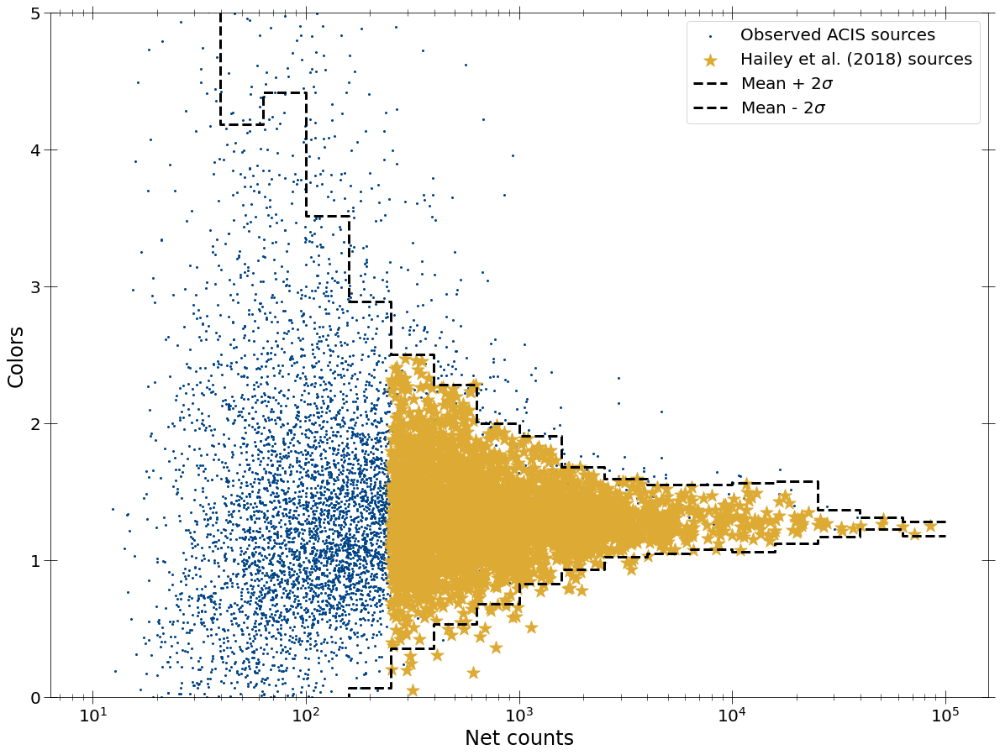

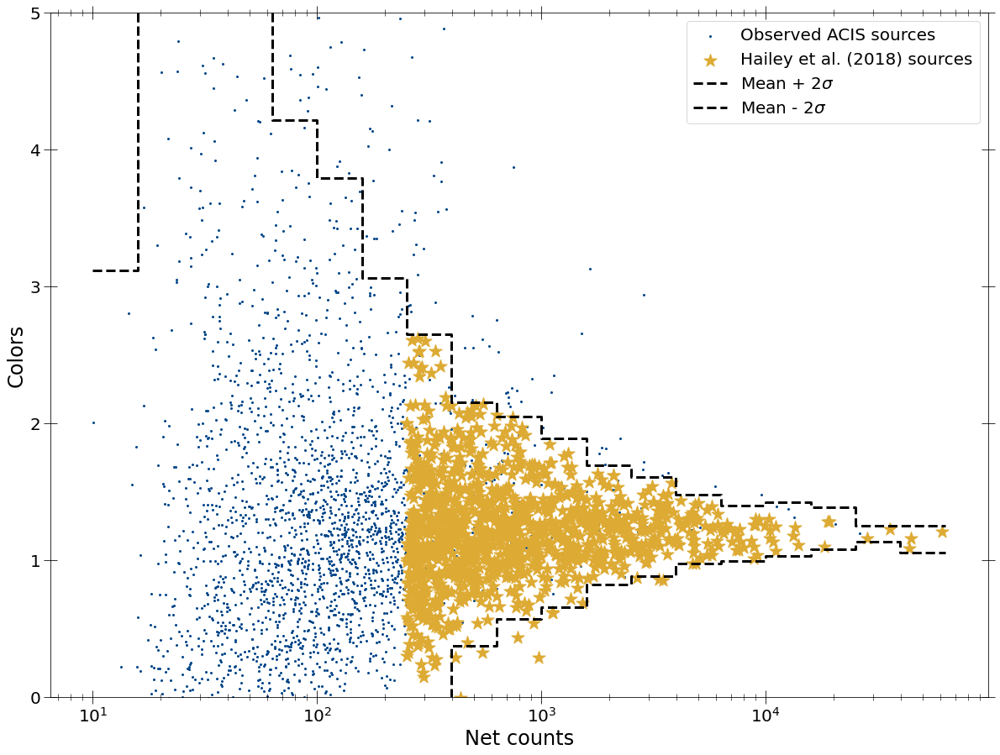

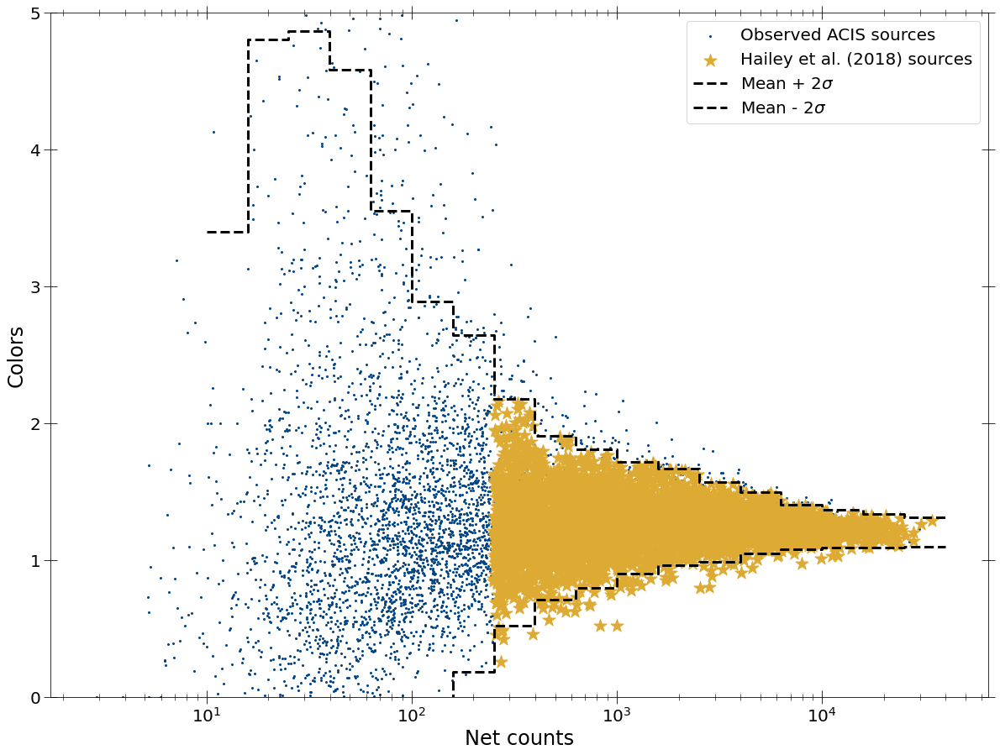

In [207]:
msps_as_msps_colors_pn, msps_as_msps_netcounts_pn = mark_interested_srcs(
    sim_msps_color_dict_arr[0], sim_msps_color_dict_arr[0],
    src_nums_xmm_msps, spec_summary_msps['spec_masks'][0][0],
    msps_as_msps_pn)
msps_as_msps_colors_mos, msps_as_msps_netcounts_mos = mark_interested_srcs(
    sim_msps_color_dict_arr[1], sim_msps_color_dict_arr[1],
    src_nums_xmm_msps, spec_summary_msps['spec_masks'][0][1],
    msps_as_msps_mos)
msps_as_msps_colors_acis, msps_as_msps_netcounts_acis = mark_interested_srcs(
    sim_msps_color_dict_arr[2], sim_msps_color_dict_arr[2],
    src_nums_chandra_msps, spec_summary_msps['spec_masks'][0][2],
    msps_as_msps_acis)

## Checking for all ratios

In [203]:
def get_netcounthist_fraction(netcount_bins_arr, cand_netcounts_arr,
                              int_netcounts_arr, det_names_arr):
    """Get histogram of candidate sources based on a property."""
    interested_srcs_histogram = []
    candidate_srcs_histogram = []
    ratios = []
    err_ratios = []
    for i, netcount_bins in enumerate(netcount_bins_arr):
        print(netcount_bins)
        int_hist = np.histogram(int_netcounts_arr[i], bins=netcount_bins)[0]
        print(int_hist)
        cand_hist = np.histogram(cand_netcounts_arr[i], bins=netcount_bins)[0]
        print(cand_hist)
        ratio = cand_hist/int_hist
        err_ratio = ((cand_hist+1)**-0.5 + (int_hist+1)**-0.5)*ratio
        err_ratio[ratio==0] = 1.0/int_hist[ratio==0]
        print(ratio)
        print(err_ratio)
        
        interested_srcs_histogram.append(int_hist)
        candidate_srcs_histogram.append(cand_hist)
        ratios.append(ratio)
        err_ratios.append(err_ratio)
        
    fig, ax1 = plt.subplots()
    ax1.set_xlabel('Net counts')
    ax1.set_xscale('log')
    ax1.set_xlim(250,2.0E+6)
    ax1.set_ylabel('# of simulated CVs per bin')
    ax1.hist(int_netcounts_arr, bins=netcount_bins,
             color=['#6699cc', '#ee99aa', '#eecc66'])
    ax1.legend(det_names_arr, loc='lower right')
    
    ax2 = ax1.twinx()
    ax2.set_ylabel(r'$p(NL|CV)$')
    ax2.set_ylim(0, 1.0)
    line_colors = ['#004488', '#994455', '#997700']
    for i, netcount_bins in enumerate(netcount_bins_arr):
        ax2.errorbar(0.5*(netcount_bins[1:]+netcount_bins[:-1]),
                     ratios[i],
                     yerr=err_ratios[i], capsize=15, color=line_colors[i],
                     label=det_names_arr[i], capthick=3)
    ax2.legend()
    return (interested_srcs_histogram, candidate_srcs_histogram, ratios,
            err_ratios)

16:24: E225 missing whitespace around operator
16:49: E225 missing whitespace around operator
19:1: W293 blank line contains whitespace
24:1: W293 blank line contains whitespace
28:21: E231 missing whitespace after ','
33:1: W293 blank line contains whitespace


In [205]:
netcount_bins_2 = np.logspace(np.log10(250), 6.3, 6)

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[69 10  8  3  3]
[31  4  5  2  0]
[0.44927536 0.4        0.625      0.66666667 0.        ]
[0.13312009 0.29948998 0.46348851 0.71823351 0.33333333]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[39 10  7  5  4]
[12  6  5  2  2]
[0.30769231 0.6        0.71428571 0.4        0.5       ]
[0.13398892 0.40768549 0.54414406 0.39423942 0.51228193]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[117   7   3   3   0]
[70  6  3  3  0]
[0.5982906  0.85714286 1.         1.                nan]
[0.12608114 0.62701531 1.         1.                nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


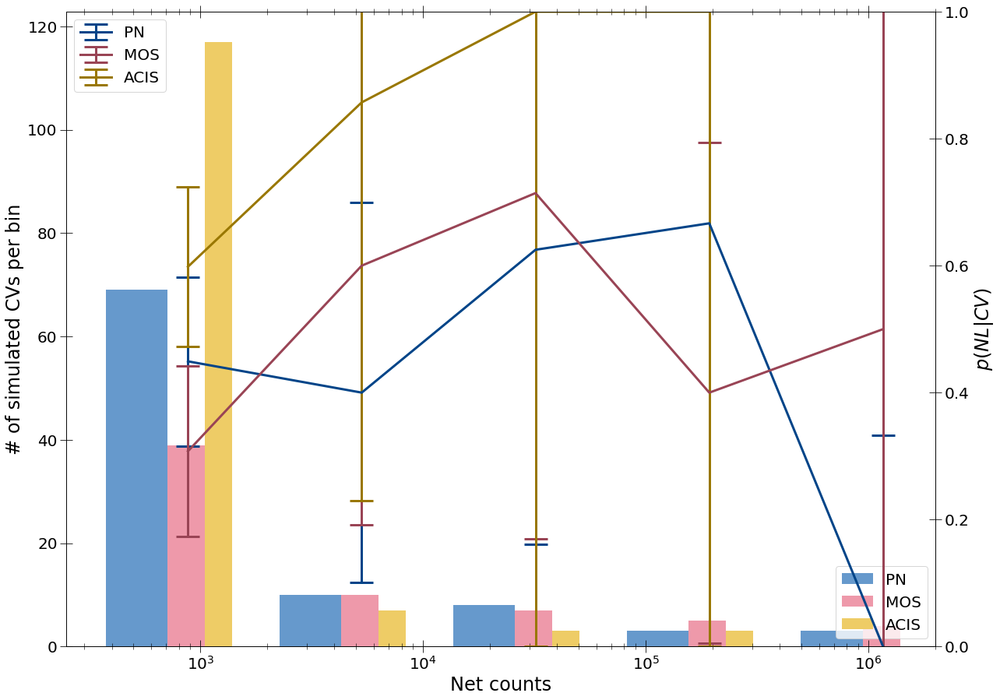

2:13: E127 continuation line over-indented for visual indent


In [226]:
(interested_msp_histogram, candidate_msp_histogram, ratios_msp,
            err_ratios_msp) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [candidate_msp_netcounts_pn, candidate_msp_netcounts_mos,
     candidate_msp_netcounts_acis],
    [interested_msp_netcounts_pn, interested_msp_netcounts_mos,
     interested_msp_netcounts_acis], ['PN', 'MOS', 'ACIS'])

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[2713  728   89    3    0]
[2377  634   74    3    0]
[0.87615186 0.87087912 0.83146067 1.                nan]
[0.03478492 0.06681457 0.18365246 1.                nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[1076  266   24    1    0]
[924 235  19   1   0]
[0.85873606 0.88345865 0.79166667 1.                nan]
[0.05440194 0.11157505 0.33535538 1.41421356        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[2312 1645  280    0    0]
[2055 1446  244    0    0]
[0.88884083 0.87902736 0.87142857        nan        nan]
[0.038084   0.04477474 0.1076586         nan        nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


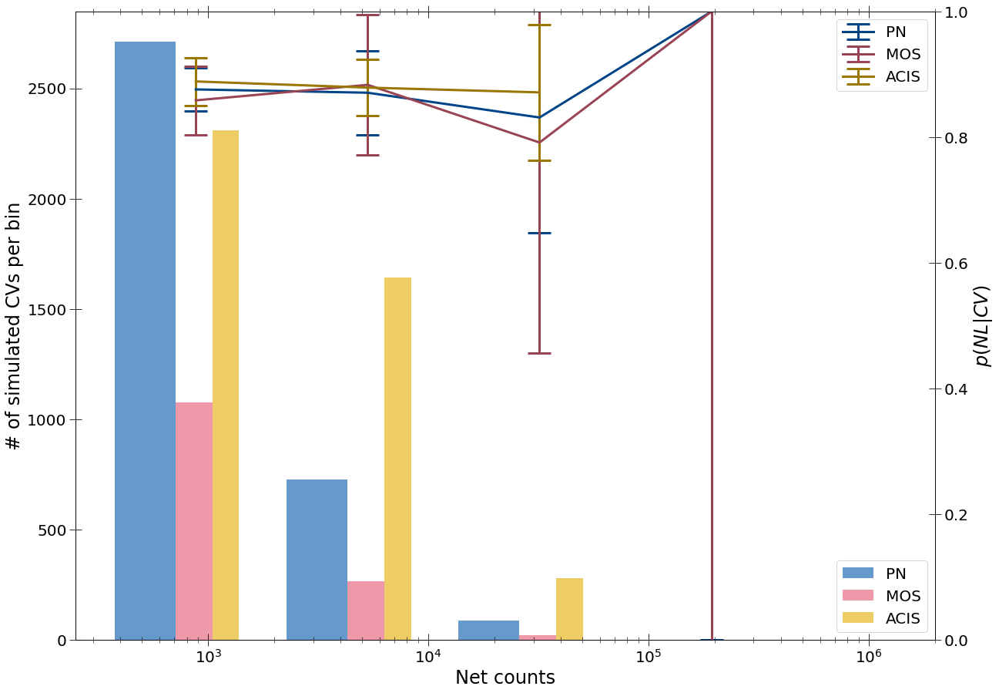

2:13: E127 continuation line over-indented for visual indent


In [227]:
(interested_msp_msp_histogram, candidate_msp_msp_histogram, ratio_msp_msp,
            err_ratios_msp_msp) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [msps_as_msps_netcounts_pn, msps_as_msps_netcounts_mos,
     msps_as_msps_netcounts_acis],
    [interested_msps_netcounts_pn, interested_msps_netcounts_mos,
     interested_msps_netcounts_acis], ['PN', 'MOS', 'ACIS'])

[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[1755   75    1    0    0]
[397  15   1   0   0]
[0.22621083 0.2        1.                nan        nan]
[0.01673715 0.07294157 1.41421356        nan        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[816  58   0   0   0]
[104   5   0   0   0]
[0.12745098 0.0862069         nan        nan        nan]
[0.01689689 0.046417          nan        nan        nan]
[2.50000000e+02 1.50782871e+03 9.09418962e+03 5.48499206e+04
 3.30817139e+05 1.99526231e+06]
[954 115   0   0   0]
[277   2   0   0   0]
[0.29035639 0.0173913         nan        nan        nan]
[0.02681013 0.01165562        nan        nan        nan]


/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


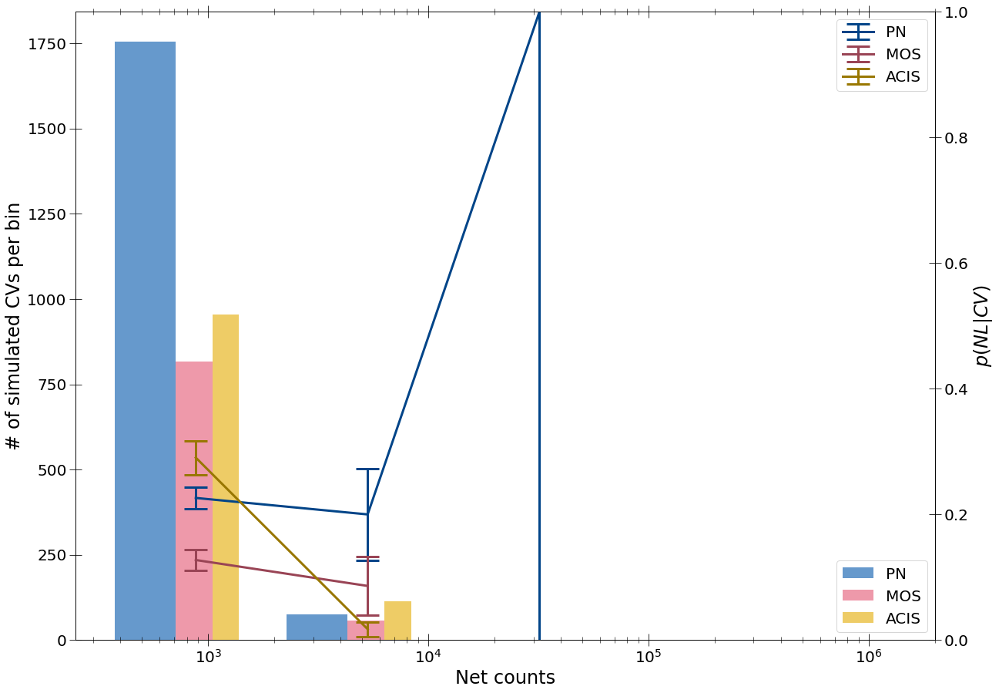

2:13: E127 continuation line over-indented for visual indent


In [213]:
(interested_cvs_histogram, cvs_as_msps_histogram, ratios_cv_as_msp,
            err_ratios_cv_as_msp) = get_netcounthist_fraction(
    [netcount_bins_2, netcount_bins_2, netcount_bins_2],
    [cvs_as_msps_netcounts_pn, cvs_as_msps_netcounts_mos,
     cvs_as_msps_netcounts_acis],
    [interested_cv_netcounts_pn, interested_cv_netcounts_mos,
     interested_cv_netcounts_acis], ['PN', 'MOS', 'ACIS'])

In [215]:
def get_cvprob2(p_nl1_cv1, p_nl1, p_nl1_nl1):
    prob = p_nl1_cv1/p_nl1*(p_nl1_nl1 - p_nl1)/(p_nl1_nl1 - p_nl1_cv1)
    prob[prob < 0] = 0
    return prob

def err_cvprob3(p_nl1_cv1, p_nl1, p_nl1_nl1, e_nl1_cv1, e_nl1, e_nl1_nl1):
    diff_num = p_nl1_nl1 - p_nl1
    diff_num[diff_num < 0] = 0
    err_term1 = (p_nl1_cv1 / p_nl1 * (p_nl1 - p_nl1_cv1) /
                 (p_nl1_nl1 - p_nl1_cv1)**2) * e_nl1_nl1
    err_term2 = (p_nl1_cv1 * p_nl1_nl1 / p_nl1**2 *
                 1.0 / (p_nl1_nl1 - p_nl1_cv1)) * e_nl1
    err_term3 = (p_nl1_nl1 /p_nl1 * diff_num /
                 (p_nl1_nl1 - p_nl1_cv1)**2) * e_nl1_cv1
    return err_term1 + err_term2 + err_term3

6:1: E302 expected 2 blank lines, found 1
13:29: E225 missing whitespace around operator


In [228]:
pn_cvprob3 = get_cvprob2(ratios_cv_as_msp[0], ratios_msp[0], ratio_msp_msp[0])
mos_cvprob3 = get_cvprob2(ratios_cv_as_msp[1], ratios_msp[1], ratio_msp_msp[1])
acis_cvprob3 = get_cvprob2(ratios_cv_as_msp[2], ratios_msp[2], ratio_msp_msp[2])

In [229]:
print(pn_cvprob3)
print(mos_cvprob3)
print(acis_cvprob3)

[0.3306961  0.35094185 0.                nan        nan]
[0.3121231  0.05108401        nan        nan        nan]
[0.23560667 0.00051534        nan        nan        nan]


In [230]:
print(pn_cvprob3*candidate_msp_histogram[0])
print(mos_cvprob3*candidate_msp_histogram[1])
print(acis_cvprob3*candidate_msp_histogram[2])

[10.25157905  1.4037674   0.                 nan         nan]
[3.7454772  0.30650407        nan        nan        nan]
[1.64924669e+01 3.09202454e-03            nan            nan
            nan]


In [231]:
pn_cvprob3_err = err_cvprob3(ratios_cv_as_msp[0], ratios_msp[0],
                             ratio_msp_msp[0], err_ratios_cv_as_msp[0],
                             err_ratios_msp[0], err_ratios_msp_msp[0],)
mos_cvprob3_err = err_cvprob3(ratios_cv_as_msp[1], ratios_msp[1],
                              ratio_msp_msp[1], err_ratios_cv_as_msp[1],
                              err_ratios_msp[1], err_ratios_msp_msp[1])
acis_cvprob3_err = err_cvprob3(ratios_cv_as_msp[2], ratios_msp[2],
                               ratio_msp_msp[2], err_ratios_cv_as_msp[2],
                               err_ratios_msp[2], err_ratios_msp_msp[2])

In [232]:
print(pn_cvprob3_err)
print(mos_cvprob3_err)
print(acis_cvprob3_err)

[0.24334416 0.66695864 3.94172171        nan        nan]
[0.26799922 0.15162035        nan        nan        nan]
[0.20008854 0.0165219         nan        nan        nan]


## Plotting color vs. hardness for MSPs

In [254]:
param_msp = np.loadtxt('/Volumes/Pavan_Work_SSD/GalacticBulge_4XMM_Chandra/data/xmm_pn_mos_simspecs_1/paramfile.txt')

In [287]:
nhsim_values = param_msp[:, 0]
plsim_values = param_msp[:, 1]

In [246]:
def get_color_hardness(det_srcspecs, det_bgspecs, det_ebins, soft_enrange=None,
                       hard_enrange=None):
    if soft_enrange is None:
        soft_enrange = [2.0, 4.0]
    if hard_enrange is None:
        hard_enrange = [4.0, 8.0]
    det_net_specs = det_srcspecs - det_bgspecs
    det_soft_counts = get_counts_enrange(det_net_specs, soft_enrange, det_ebins,
                                         floor_counts=0)[0]
    det_hard_counts = get_counts_enrange(det_net_specs, hard_enrange, det_ebins,
                                         floor_counts=0)[0]
    line_cont_counts = get_line_cont_counts(
        det_srcspecs, det_bgspecs, det_ebins)
    fe_net = line_cont_counts[0][0]
    cont1_net = line_cont_counts[1][0]
    cont2_net = line_cont_counts[2][0]
    colors = get_colors_basic(fe_net, cont1_net, cont2_net)
    hardness = (det_hard_counts - det_soft_counts)/(det_hard_counts +
                                                    det_soft_counts)
    return colors, hardness

In [285]:
np.array(model_params_arr[0][0])[candidate_args_alldet[0]][:, 1].astype(float)

array([ 9.34426685,  5.69974102, 15.14664382, 90.35961547, 30.56562618,
        3.26249632, 35.21642825, 15.29295984,  2.69897518, 12.33578881,
       14.84740482, 43.04343967,  5.37453528, 19.04341236, 11.1082188 ,
       13.59353114,  9.25653134, 23.71309303,  9.02005775,  7.76676699,
        7.98253713, 18.98602684,  6.18535544,  1.16272136,  1.69909813,
        3.12496345,  1.7911476 ,  3.05752614, 22.00995257, 19.79207862,
       30.06968391,  7.89152988,  5.47257846, 12.61884619, 10.63382622,
       13.80211369, 11.36227453,  8.38599444,  9.1756359 ,  6.62856889,
        9.70843273,  5.4268971 , 13.60590231,  3.10824232,  6.90785463,
       24.35206718, 13.86775115,  7.59275767,  7.25387182,  7.27496594,
       35.67774531, 10.40900951, 28.62611658, 27.08707383, 24.01067965,
        5.50037879,  6.40905573, 23.86820171, 23.03071112, 22.23241992,
       22.0779401 , 24.41279975, 21.41470325, 24.14405664, 23.28565838,
       26.36531125, 24.51638587,  9.12326173, 13.44304905, 15.50

In [351]:
ebins_arr = spec_summary_msps['ebins'][0]
spec_mask_obs = spec_summary_msps['spec_masks'][1]
src_specs_obs = spec_summary_msps['specs'][2]
bgspecs_obs = spec_summary_msps['specs'][3]
candidate_args_alldet = [candidadate_msps_pn_args, candidadate_msps_mos_args,
                         candidadate_msps_acis_args]
color_arr = []
hr2_arr = []
plfit_arr = []
pl_lowfit_arr = []
pl_highfit_arr = []
nhfit_arr = []
nh_lowfit_arr = []
nh_highfit_arr = []
for i in range(3):
    good_mask = spec_mask_obs[i]
    colors, hardness = get_color_hardness(
        ((src_specs_obs[i][good_mask])[interested_msp_args_alldet[i]])[candidate_args_alldet[i]],
        ((bgspecs_obs[i][good_mask])[interested_msp_args_alldet[i]])[candidate_args_alldet[i]], 
        ebins_arr[i])
    plfit = np.array(model_params_arr[i][0])[candidate_args_alldet[i]][:, 4].astype(float)
    pl_lowfit = np.array(model_params_arr[i][0])[candidate_args_alldet[i]][:, 5].astype(float)
    pl_highfit = np.array(model_params_arr[i][0])[candidate_args_alldet[i]][:, 6].astype(float)
    nhfit = np.array(model_params_arr[i][0])[candidate_args_alldet[i]][:, 1].astype(float)*1.0E+22
    nh_lowfit = np.array(model_params_arr[i][0])[candidate_args_alldet[i]][:, 2].astype(float)*1.0E+22
    nh_highfit = np.array(model_params_arr[i][0])[candidate_args_alldet[i]][:, 3].astype(float)*1.0E+22
    color_arr.append(colors)
    hr2_arr.append(hardness)
    plfit_arr.append(plfit)
    pl_lowfit_arr.append(pl_lowfit)
    pl_highfit_arr.append(pl_highfit)
    nhfit_arr.append(nhfit)
    nh_lowfit_arr.append(nh_lowfit)
    nh_highfit_arr.append(nh_highfit)

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:709: RuntimeWarning: divide by zero encountered in true_divide


In [334]:
len(good_mask)

2697

In [311]:
ebins_arr = spec_summary_msps['ebins'][0]
srcspecs_msp_sim = spec_summary_msps['specs'][0]
bgspecs_msp_sim = spec_summary_msps['specs'][1]
specmasks_msp_sim = spec_summary_msps['spec_masks'][0]
spec_mask_obs = spec_summary_msps['spec_masks'][1]
netcounts_msp = spec_summary_msps['counts'][0]
color_simarr = []
hr2_simarr = []
nh_simarr = []
pl_simarr = []
for i in range(3):
    if i < 2:
        good_mask = np.logical_and(
            nhsim_values < 2.0E+23,
            np.logical_and(specmasks_msp_sim[i], netcounts_msp[i][0] > 250))
        nh_sim = nhsim_values[good_mask]
        pl_sim = plsim_values[good_mask]
    else:
        good_mask = np.logical_and(
            (nhsim_values < 2.0E+23)[:10000],
            np.logical_and(specmasks_msp_sim[i], netcounts_msp[i][0] > 250))
        nh_sim = nhsim_values[:10000][good_mask]
        pl_sim = plsim_values[:10000][good_mask]
    colors, hardness = get_color_hardness(
        srcspecs_msp_sim[i][good_mask], bgspecs_msp_sim[i][good_mask], 
        ebins_arr[i])
    color_simarr.append(colors)
    hr2_simarr.append(hardness)
    nh_simarr.append(nh_sim)
    pl_simarr.append(pl_sim)

In [241]:
set_plotparams('paper2')

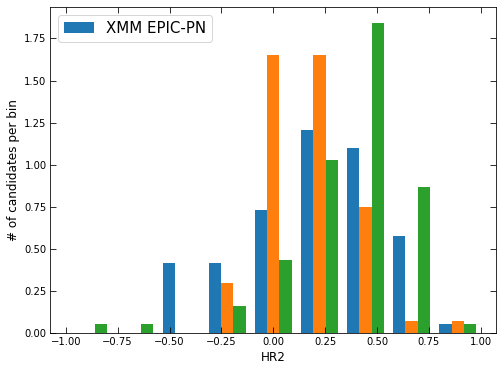

In [292]:
mybins = np.linspace(-1, 1, 10)
plt.hist(hr2_arr, bins=mybins, density=True)
plt.xlabel('HR2')
plt.ylabel('# of candidates per bin')
plt.legend(['XMM EPIC-PN', ])

In [298]:
np.max(plfit_arr[0])

6.268833517354705

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log10
  


<ErrorbarContainer object of 3 artists>

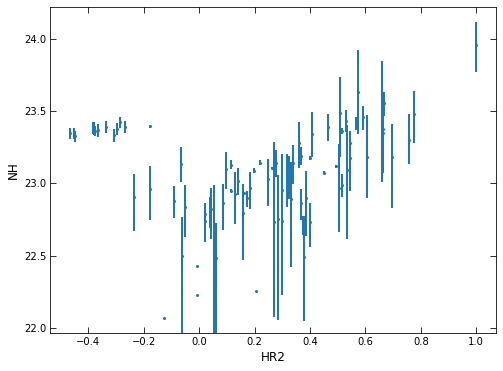

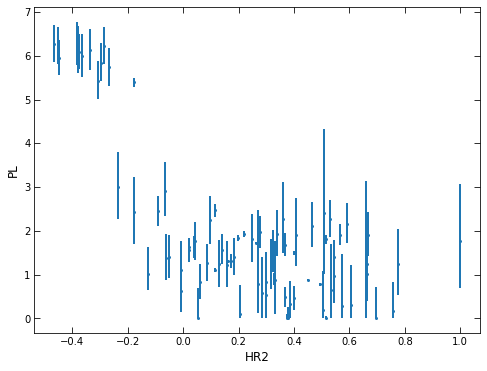

In [357]:
plt.xlabel('HR2')
plt.ylabel('NH')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.errorbar(hr2_arr[0], np.log10(nhfit_arr[0]),
             yerr=[np.log10(nhfit_arr[0]) - np.log10(nh_lowfit_arr[0]),
                   np.log10(nh_highfit_arr[0]) - np.log10(nhfit_arr[0])], fmt='o')
plt.figure()
plt.xlabel('HR2')
plt.ylabel('PL')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.errorbar(hr2_arr[0], plfit_arr[0],
             yerr=[plfit_arr[0] - pl_lowfit_arr[0],
                   pl_highfit_arr[0] - plfit_arr[0]], fmt='o')

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log10
  


<ErrorbarContainer object of 3 artists>

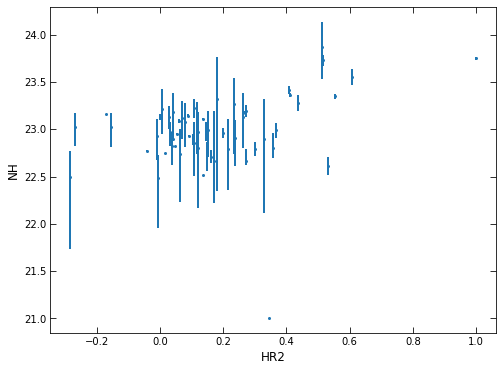

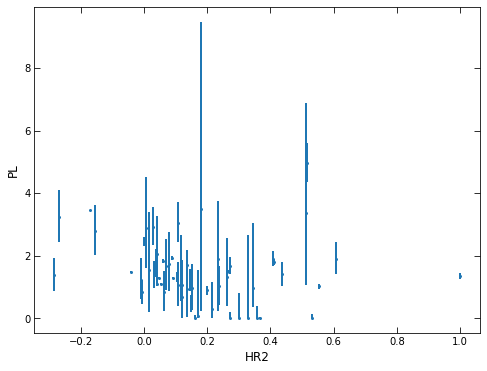

In [358]:
plt.xlabel('HR2')
plt.ylabel('NH')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.errorbar(hr2_arr[1], np.log10(nhfit_arr[1]),
             yerr=[np.log10(nhfit_arr[1]) - np.log10(nh_lowfit_arr[1]),
                   np.log10(nh_highfit_arr[1]) - np.log10(nhfit_arr[1])], fmt='o')
plt.figure()
plt.xlabel('HR2')
plt.ylabel('PL')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.errorbar(hr2_arr[1], plfit_arr[1],
             yerr=[plfit_arr[1] - pl_lowfit_arr[1],
                   pl_highfit_arr[1] - plfit_arr[1]], fmt='o')

In [305]:
np.min(hr2_arr[2])

-0.850713765225696

/Users/pavanrh/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: divide by zero encountered in log10
  


<ErrorbarContainer object of 3 artists>

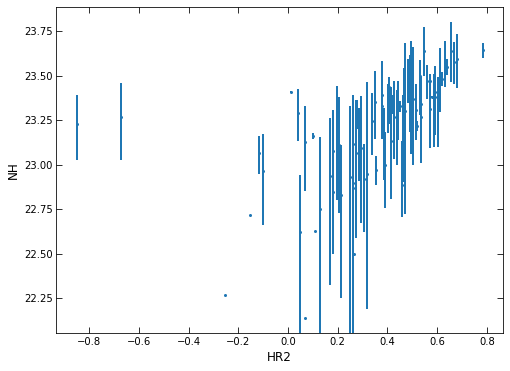

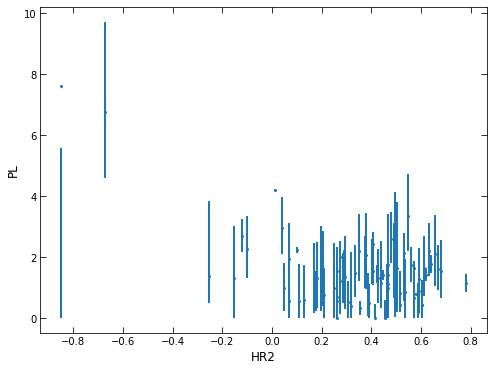

In [361]:
plt.xlabel('HR2')
plt.ylabel('NH')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.errorbar(hr2_arr[2], np.log10(nhfit_arr[2]),
             yerr=[np.log10(nhfit_arr[2]) - np.log10(nh_lowfit_arr[2]),
                   np.log10(nh_highfit_arr[2]) - np.log10(nhfit_arr[2])], fmt='o')
plt.figure()
plt.xlabel('HR2')
plt.ylabel('PL')
#plt.ylim(0, 4)
#plt.xlim(-1, 1)
plt.errorbar(hr2_arr[2], plfit_arr[2],
             yerr=[plfit_arr[2] - pl_lowfit_arr[2],
                   pl_highfit_arr[2] - plfit_arr[2]], fmt='o')

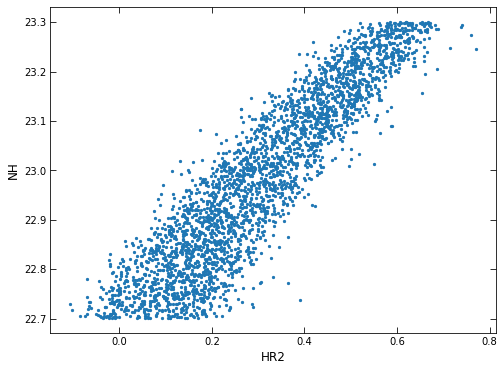

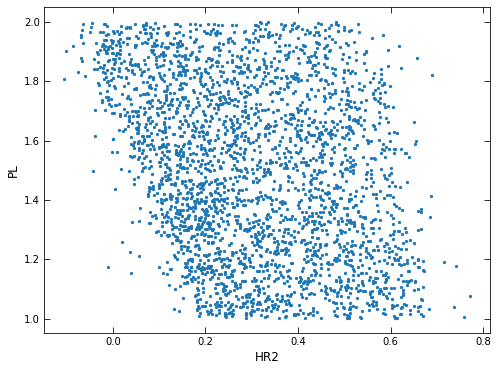

In [312]:
plt.xlabel('HR2')
plt.ylabel('NH')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.scatter(hr2_simarr[2], np.log10(nh_simarr[2]), s=5)
plt.figure()
plt.xlabel('HR2')
plt.ylabel('PL')
#plt.ylim(0, 3)
#plt.xlim(-1, 1)
plt.scatter(hr2_simarr[2], pl_simarr[2], s=5)

In [858]:
sns.kdeplot

<function seaborn.distributions.kdeplot(x=None, *, y=None, shade=None, vertical=False, kernel=None, bw=None, gridsize=200, cut=3, clip=None, legend=True, cumulative=False, shade_lowest=None, cbar=False, cbar_ax=None, cbar_kws=None, ax=None, weights=None, hue=None, palette=None, hue_order=None, hue_norm=None, multiple='layer', common_norm=True, common_grid=False, levels=10, thresh=0.05, bw_method='scott', bw_adjust=1, log_scale=None, color=None, fill=None, data=None, data2=None, **kwargs)>

In [881]:
np.where(spec_summary_msps['src_nums'][1] == '2CXOJ174539.4-290041')

(array([1505]),)

In [891]:
np.where(ebins_arr[2] <= 8)[0][-1]

547

(2, 10)

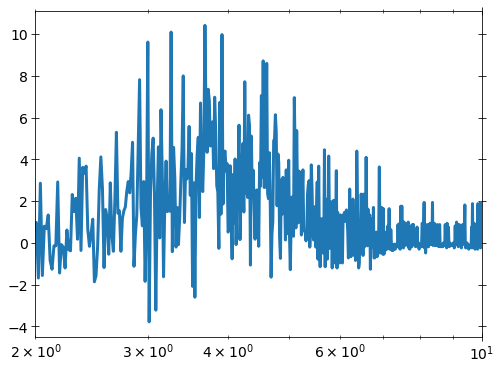

1:80: E501 line too long (91 > 79 characters)


In [884]:
test_spec = spec_summary_msps['specs'][2][2][1505] - spec_summary_msps['specs'][3][2][1505]
plt.plot(spec_summary_msps['ebins'][1][2], test_spec)
plt.xscale('log')
plt.xlim(2, 10)

In [894]:
hardcounts

340.4679037111226

In [892]:
softcounts = np.sum(test_spec[137:274])
hardcounts = np.sum(test_spec[274:547])
print((hardcounts - softcounts)/(hardcounts+softcounts))

0.033966612895659616


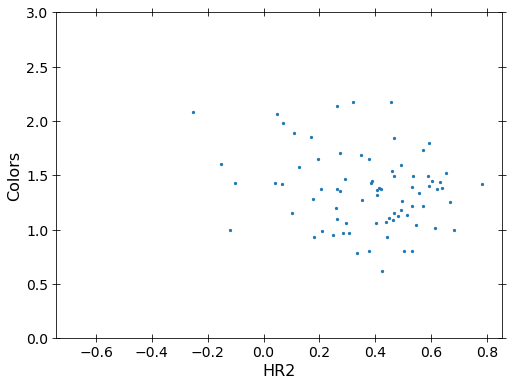

In [868]:
plt.xlabel('HR2')
plt.ylabel('Colors')
plt.ylim(0, 3)
plt.scatter(hr2_arr[2], color_arr[2], s=5)

In [327]:
sim_msp_spectra_norm_pn = spec_summary_msps['norm_specs'][0][0][good_mask]
sim_msp_spectra_norm_mos = spec_summary_msps['norm_specs'][1][0][
    np.logical_and(spec_summary_msps['spec_masks'][0][1],
                   spec_summary_msps['counts'][0][1][0] > 250)]
sim_msp_spectra_norm_acis = spec_summary_msps['norm_specs'][2][0][
    np.logical_and(spec_summary_msps['spec_masks'][0][2],
                   spec_summary_msps['counts'][0][2][0] > 250)]

In [346]:
0.1/(spec_summary_msps['ebins'][1][2][1] - spec_summary_msps['ebins'][1][2][0])

9.132420070197057

In [336]:
msp_spectra_norm_acis = ((spec_summary_msps['norm_specs'][2][1]
                              [good_mask])[
                                interested_msp_args_alldet[2]])[
                                    candidate_args_alldet[2]]

(5, 8)

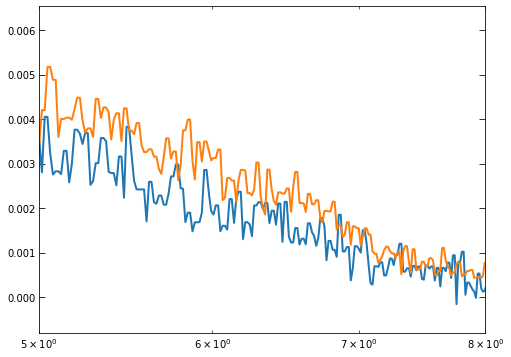

In [349]:
plt.plot(spec_summary_msps['ebins'][1][2][137:684],
         median_filter(np.mean(msp_spectra_norm_acis[hr2_arr[2] <= 0.3], axis=0), size=2))
plt.plot(spec_summary_msps['ebins'][1][2][137:684],
         median_filter(np.mean(msp_spectra_norm_acis[hr2_arr[2] > 0.3], axis=0), size=2))
plt.xscale('log')
plt.xlim(5, 8)

In [720]:
spec_summary_msps['specs'][0][0].shape

(20000, 4096)

In [692]:
print(np.where(spec_summary_msps['ebins'][0][0] >= 2)[0][0])
print(np.where(spec_summary_msps['ebins'][0][1] >= 2)[0][0])
print(np.where(spec_summary_msps['ebins'][0][2] >= 2)[0][0])

400
400
137


In [693]:
print(np.where(spec_summary_msps['ebins'][0][0] >= 4)[0][0])
print(np.where(spec_summary_msps['ebins'][0][1] >= 4)[0][0])
print(np.where(spec_summary_msps['ebins'][0][2] >= 4)[0][0])

800
800
274


In [695]:
print(np.where(spec_summary_msps['ebins'][0][0] >= 8)[0][0])
print(np.where(spec_summary_msps['ebins'][0][1] >= 8)[0][0])
print(np.where(spec_summary_msps['ebins'][0][2] >= 8)[0][0])

1600
1600
548


In [710]:
print(np.where(spec_summary_msps['ebins'][0][0] < 10)[0][-1])
print(np.where(spec_summary_msps['ebins'][0][1] < 10)[0][-1])
print(np.where(spec_summary_msps['ebins'][0][2] < 10)[0][-1])

1999
1999
684


In [717]:
netcounts_softband = []
netcounts_hardband = []
hr2_arr_all = []
norm_specs = [sim_msp_spectra_norm_pn, sim_msp_spectra_norm_mos,
              sim_msp_spectra_norm_acis]
for i, norm_spec in enumerate(norm_specs):
    if i == 2:
        netcount_soft = np.sum(norm_spec[:, 0:137], axis=1)
        netcount_hard = np.sum(norm_spec[:, 137:411], axis=1)
    else:
        netcount_soft = np.sum(norm_spec[:, 0:400], axis=1)
        netcount_hard = np.sum(norm_spec[:, 400:1200], axis=1)
    netcount_soft[netcount_soft < 0] = 0
    hr2_arr = (netcount_hard - netcount_soft)/(netcount_hard + netcount_soft)
    netcounts_softband.append(netcount_soft)
    netcounts_hardband.append(netcount_hard)
    hr2_arr.append(hr2)

(array([ 98., 366., 686., 612., 526., 478., 459., 465., 495., 185.]),
 array([-0.10868303,  0.00218527,  0.11305357,  0.22392188,  0.33479018,
         0.44565848,  0.55652679,  0.66739509,  0.77826339,  0.8891317 ,
         1.        ]),
 <BarContainer object of 10 artists>)

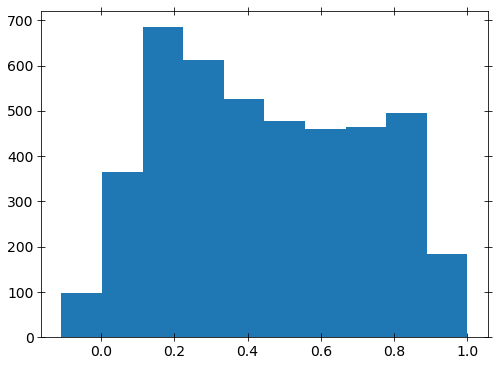

In [718]:
plt.hist(hr2)

## Constructing tables

In [82]:
import pandas as pd

In [83]:
def get_netcounts(src_num_list, det_num):
    net_counts = []
    for src_num in src_num_list:
        if det_num == 2:
            index = np.where(spec_summary_msps['src_nums'][1] == src_num)[0][0]
        else:
            index = np.where(spec_summary_msps['src_nums'][0] == src_num)[0][0]
        net_count = spec_summary_msps['counts'][0][det_num][1][index]
        net_counts.append(net_count)
    return np.array(net_counts)

In [84]:
pn_counts = get_netcounts(interested_msps_xmm, 0)
mos_counts = get_netcounts(interested_msps_xmm, 1)
acis_counts = get_netcounts(interested_msp_srcs_alldet[2], 2)

In [85]:
def get_colors(src_num_list, det_num):
    colors = []
    for src_num in src_num_list:
        if det_num == 2:
            refined_src_nums = spec_summary_msps['src_nums'][1][
                spec_summary_msps['spec_masks'][1][det_num]]
        else:
            refined_src_nums = spec_summary_msps['src_nums'][0][
                spec_summary_msps['spec_masks'][1][det_num]]
        index = np.where(refined_src_nums == src_num)[0]
        if len(index) > 0:
            color = obs_color_dict_arr[det_num]['colors'][index][0]
        else:
            color = ''
        colors.append(color)
    return np.array(colors)

In [86]:
pn_colors = get_colors(interested_msps_xmm, 0)
mos_colors = get_colors(interested_msps_xmm, 1)
acis_colors = get_colors(interested_msp_srcs_alldet[2], 2)

In [87]:
print(r'$6_{-3}^{10}$')

$6_{-3}^{10}$


In [88]:
def combine_xmm_tables(pn_table, mos_table, src_num_list):
    combined_table = []
    for src_num in src_num_list:
        index = np.where(interested_msp_srcs_alldet[0] == src_num)[0]
        if len(index) > 0:
            combined_table.append(pn_table[index[0]])
        else:
            index = np.where(interested_msp_srcs_alldet[1] == src_num)[0][0]
            combined_table.append(mos_table[index])
    return np.array(combined_table)

In [89]:
xmm_pl_fit_stats_table = combine_xmm_tables(pn_fit_stats_table_pl, mos_fit_stats_table_pl, interested_msps_xmm)
xmm_pl_g_fit_stats_table = combine_xmm_tables(pn_fit_stats_table_pl_g, mos_fit_stats_table_pl_g, interested_msps_xmm)
xmm_pl_g3_fit_stats_table = combine_xmm_tables(pn_fit_stats_table_pl_g2, mos_fit_stats_table_pl_g2, interested_msps_xmm)

1:80: E501 line too long (111 > 79 characters)
2:80: E501 line too long (117 > 79 characters)


In [90]:
xmm_pl_model_params_table = combine_xmm_tables(pn_model_params_table_pl, mos_model_params_table_pl, interested_msps_xmm)
xmm_pl_g_model_params_table = combine_xmm_tables(pn_model_params_table_pl_g, mos_model_params_table_pl_g, interested_msps_xmm)
xmm_pl_g3_model_params_table = combine_xmm_tables(pn_model_params_table_pl_g2, mos_model_params_table_pl_g2, interested_msps_xmm)

1:80: E501 line too long (120 > 79 characters)
2:80: E501 line too long (126 > 79 characters)


In [91]:
xmm_pl_model_params_table[0]

array(['201129702010014', '40.064168838973885', '24.580594765473297',
       '59.46819584183292', '0.9246639365348682', '0.20761962013263913',
       '1.7169056840585863', '0.3055019747447762', '0.22117857461376142',
       '0.48171075914198874'], dtype='<U32')

In [92]:
xmm_indices = []
for src_num in interested_msps_xmm:
    index_pn = np.where(interested_msp_srcs_alldet[0] == src_num)[0]

In [93]:
pn_indices = []
for src_num in interested_msps_xmm:
    index_my = np.where(interested_msp_srcs_alldet[0] == src_num)[0]
    if len(index_my) > 0:
        pn_indices.append(index_my[0])
    else:
        pn_indices.append(np.nan)

In [97]:
pn_indices[3]

nan

In [95]:
mos_indices = []
for src_num in interested_msps_xmm:
    index_my = np.where(interested_msp_srcs_alldet[1] == src_num)[0]
    if len(index_my) > 0:
        mos_indices.append(index_my[0])
    else:
        mos_indices.append(np.nan)

In [98]:
interested_msp_srcs_alldet[1][mos_indices[3]]

'202026708010061'

In [138]:
np.where(np.logical_and(~np.isnan(pn_indices), ~np.isnan(mos_indices)))

(array([  3,   5,   8,  11,  21,  27,  32,  35,  39,  40,  43,  51,  54,
         64,  68,  74,  76,  79,  84,  91,  94,  96, 100, 105, 106, 108,
        115, 120, 122, 123, 126, 128, 130, 137, 141, 145, 147, 149, 153,
        154, 162, 163, 168, 172, 180, 182, 201, 203, 207, 218, 219, 223,
        231, 233, 236, 244, 249, 250, 253, 258, 263, 264, 265]),)

In [149]:
pn_fit_stats_table_pl[pn_indices[5]]

['207234103010044', 2266.842375634099, -4.021812244509783, 50.0, 1842]

In [148]:
mos_fit_stats_table_pl[mos_indices[5]]

['207234103010044', 2266.842375634099, -4.021812244509783, 50.0, 1842]

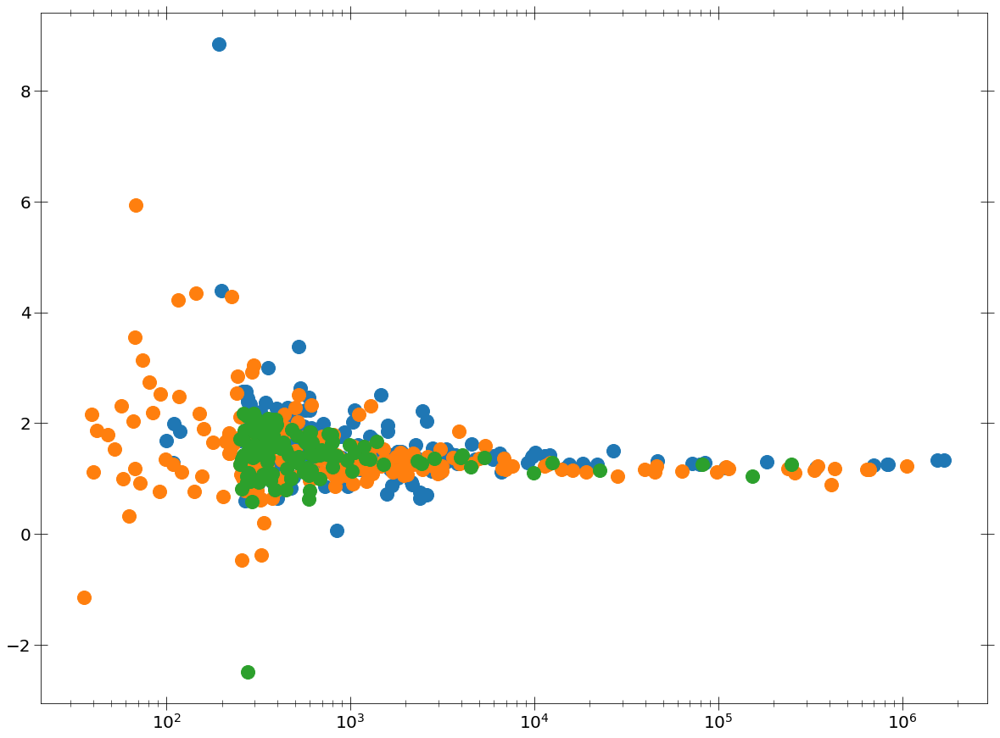

In [110]:
plt.scatter(pn_counts, pn_colors)
plt.scatter(mos_counts, mos_colors)
plt.scatter(acis_counts, acis_colors)
plt.xscale('log')

In [88]:
from astropy.table import Table
from astropy.table.pprint import conf
conf.max_lines = -1
conf.max_width = -1

In [89]:
Table(np.column_stack([interested_msps_xmm, pn_counts, mos_counts]))

col0,col1,col2
str32,str32,str32
207622503010010,0.0,260338.00351399818
201129704010056,294.6517654691121,39.05389726075383
206586001010073,0.0,429.331159172748
208861209010009,553.6794065557835,441.9934683768305
201129707010045,108.88090819793108,2194.314032455358
207234103010044,697.7421205630355,2708.677123052165
207234103010039,193.48756216007803,689.4994864562675
205049406010002,0.0,28122.74572076179
208624706010006,182106.79592806142,113492.41752644595


In [231]:
chandra_table = np.column_stack([
    interested_msp_srcs_alldet[2], acis_counts, acis_colors,
    acis_pl_model_params_table[:, 1],
    (acis_pl_model_params_table[:, 2].astype(float) -
     acis_pl_model_params_table[:, 1].astype(float)),
    (acis_pl_model_params_table[:, 3].astype(float) -
     acis_pl_model_params_table[:, 1].astype(float)),
    acis_pl_model_params_table[:, 4],
    (acis_pl_model_params_table[:, 5].astype(float) -
     acis_pl_model_params_table[:, 4].astype(float)),
    (acis_pl_model_params_table[:, 6].astype(float) -
     acis_pl_model_params_table[:, 4].astype(float)),
    acis_pl_model_params_table[:, 7],
    (acis_pl_model_params_table[:, 8].astype(float) -
     acis_pl_model_params_table[:, 7].astype(float)),
    (acis_pl_model_params_table[:, 9].astype(float) -
     acis_pl_model_params_table[:, 7].astype(float)),
    acis_pl_fit_stats_table[:, 1], acis_pl_fit_stats_table[:, -1],
    acis_pl_g_model_params_table[:, 4],
    (acis_pl_g_model_params_table[:, 5].astype(float) -
     acis_pl_g_model_params_table[:, 4].astype(float)),
    (acis_pl_g_model_params_table[:, 6].astype(float) -
     acis_pl_g_model_params_table[:, 4].astype(float)),
    acis_pl_g_model_params_table[:, 7],
    (acis_pl_g_model_params_table[:, 8].astype(float) -
     acis_pl_g_model_params_table[:, 7].astype(float)),
    (acis_pl_g_model_params_table[:, 9].astype(float) -
     acis_pl_g_model_params_table[:, 7].astype(float)),
    (acis_pl_g_fit_stats_table[:, 1].astype(float) -
     acis_pl_fit_stats_table[:, 1].astype(float)),
    acis_pl_g3_model_params_table[:, 4],
    (acis_pl_g3_model_params_table[:, 7].astype(float) -
     acis_pl_g3_model_params_table[:, 4].astype(float)),
    (acis_pl_g3_model_params_table[:, 8].astype(float) -
     acis_pl_g3_model_params_table[:, 4].astype(float)),
    acis_pl_g3_model_params_table[:, 5],
    (acis_pl_g3_model_params_table[:, 9].astype(float) -
     acis_pl_g3_model_params_table[:, 5].astype(float)),
    (acis_pl_g3_model_params_table[:, 10].astype(float) -
     acis_pl_g3_model_params_table[:, 5].astype(float)),
    acis_pl_g3_model_params_table[:, 6],
    (acis_pl_g3_model_params_table[:, 11].astype(float) -
     acis_pl_g3_model_params_table[:, 6].astype(float)),
    (acis_pl_g3_model_params_table[:, 12].astype(float) -
     acis_pl_g3_model_params_table[:, 6].astype(float)),
    (acis_pl_g3_fit_stats_table[:, 1].astype(float) -
     acis_pl_fit_stats_table[:, 1].astype(float)),])

In [99]:
xmm_pl_model_params_table

array([['201129702010014', '40.064168838973885', '24.580594765473297',
        ..., '0.3055019747447762', '0.22117857461376142',
        '0.48171075914198874'],
       ['206946401010004', '8.385994442235155', '5.206951655011025', ...,
        '1.8835661693422523', '1.6508003671006857', '2.173415838126594'],
       ['201032613010001', '7.274965938558672', '5.529984728935126', ...,
        '1.4726114502663952', '1.390964351597305', '1.5597211874733699'],
       ...,
       ['206556701010043', '0.1000000000000056', '0.0', ...,
        '0.033337441399740354', '0.02065111760798323',
        '0.05440169835583382'],
       ['208441011010009', '1.1627213582266562', '0.0', ...,
        '0.35797476442764836', '0.3106955665388768',
        '0.4123080494482446'],
       ['206735502010018', '3.264723650330524', '0.0', ...,
        '0.11133899587895077', '0.08875732427789625',
        '0.13837340296250747']], dtype='<U32')

In [207]:
xmm_table = np.column_stack([
    interested_msps_xmm, pn_counts, mos_counts, pn_colors, mos_colors,
    xmm_pl_model_params_table[:, 1],
    (xmm_pl_model_params_table[:, 2].astype(float) -
     xmm_pl_model_params_table[:, 1].astype(float)),
    (xmm_pl_model_params_table[:, 3].astype(float) -
     xmm_pl_model_params_table[:, 1].astype(float)),
    xmm_pl_model_params_table[:, 4],
    (xmm_pl_model_params_table[:, 5].astype(float) -
     xmm_pl_model_params_table[:, 4].astype(float)),
    (xmm_pl_model_params_table[:, 6].astype(float) -
     xmm_pl_model_params_table[:, 4].astype(float)),
    xmm_pl_model_params_table[:, 7],
    (xmm_pl_model_params_table[:, 8].astype(float) -
     xmm_pl_model_params_table[:, 7].astype(float)),
    (xmm_pl_model_params_table[:, 9].astype(float) -
     xmm_pl_model_params_table[:, 7].astype(float)),
    xmm_pl_fit_stats_table[:, 1], xmm_pl_fit_stats_table[:, -1],
    xmm_pl_g_model_params_table[:, 4],
    (xmm_pl_g_model_params_table[:, 5].astype(float) -
     xmm_pl_g_model_params_table[:, 4].astype(float)),
    (xmm_pl_g_model_params_table[:, 6].astype(float) -
     xmm_pl_g_model_params_table[:, 4].astype(float)),
    xmm_pl_g_model_params_table[:, 7],
    (xmm_pl_g_model_params_table[:, 8].astype(float) -
     xmm_pl_g_model_params_table[:, 7].astype(float)),
    (xmm_pl_g_model_params_table[:, 9].astype(float) -
     xmm_pl_g_model_params_table[:, 7].astype(float)),
    (xmm_pl_g_fit_stats_table[:, 1].astype(float) -
     xmm_pl_fit_stats_table[:, 1].astype(float)),
    xmm_pl_g3_model_params_table[:, 4],
    (xmm_pl_g3_model_params_table[:, 7].astype(float) -
     xmm_pl_g3_model_params_table[:, 4].astype(float)),
    (xmm_pl_g3_model_params_table[:, 8].astype(float) -
     xmm_pl_g3_model_params_table[:, 4].astype(float)),
    xmm_pl_g3_model_params_table[:, 5],
    (xmm_pl_g3_model_params_table[:, 9].astype(float) -
     xmm_pl_g3_model_params_table[:, 5].astype(float)),
    (xmm_pl_g3_model_params_table[:, 10].astype(float) -
     xmm_pl_g3_model_params_table[:, 5].astype(float)),
    xmm_pl_g3_model_params_table[:, 6],
    (xmm_pl_g3_model_params_table[:, 11].astype(float) -
     xmm_pl_g3_model_params_table[:, 6].astype(float)),
    (xmm_pl_g3_model_params_table[:, 12].astype(float) -
     xmm_pl_g3_model_params_table[:, 6].astype(float)),
    (xmm_pl_g3_fit_stats_table[:, 1].astype(float) -
     xmm_pl_fit_stats_table[:, 1].astype(float)),])

In [482]:
xmm_table = np.column_stack([
    interested_msps_xmm, pn_counts, mos_counts, pn_colors, mos_colors,
    xmm_pl_model_params_table[:, 1], xmm_pl_model_params_table[:, 2],
    xmm_pl_model_params_table[:, 3], xmm_pl_model_params_table[:, 4],
    xmm_pl_model_params_table[:, 5], xmm_pl_model_params_table[:, 6],
    xmm_pl_model_params_table[:, 7], xmm_pl_model_params_table[:, 8],
    xmm_pl_model_params_table[:, 9], xmm_pl_fit_stats_table[:, 1],
    xmm_pl_fit_stats_table[:, -1],
    xmm_pl_g_model_params_table[:, 4], xmm_pl_g_model_params_table[:, 5],
    xmm_pl_g_model_params_table[:, 6], xmm_pl_g_model_params_table[:, 7],
    xmm_pl_g_model_params_table[:, 8], xmm_pl_g_model_params_table[:, 9],
    xmm_pl_g_fit_stats_table[:, 1].astype(float) -
    xmm_pl_fit_stats_table[:, 1].astype(float),
    xmm_pl_g3_model_params_table[:, 4], xmm_pl_g3_model_params_table[:, 7],
    xmm_pl_g3_model_params_table[:, 8], xmm_pl_g3_model_params_table[:, 5],
    xmm_pl_g3_model_params_table[:, 9], xmm_pl_g3_model_params_table[:, 10],
    xmm_pl_g3_model_params_table[:, 6], xmm_pl_g3_model_params_table[:, 11],
    xmm_pl_g3_model_params_table[:, 12],
    xmm_pl_g3_fit_stats_table[:, 1].astype(float) -
    xmm_pl_fit_stats_table[:, 1].astype(float)])

In [483]:
xmm_pl_g_fit_stats_table[:, 1]

array(['2645.6994835249343', '665.8709792496267', '361.6106519081203',
       '806.8588720324649', '7892.610191047755', '2256.8480380351666',
       '2134.5217675805497', '1529.0949651740066', '6238.057958243411',
       '891.6020695667492', '746.7843445601804', '617.8092342542919',
       '1618.3668348925878', '438.8103055110049', '653.6459473821315',
       '340.5762254428715', '840.9294541723552', '1620.276308869459',
       '290.1392373172891', '903.017004971931', '1062.1425659901292',
       '3210.3445505668233', '1807.2598160175753', '849.1917804479247',
       '772.0375360958518', '1089.0170521927698', '348.7066621724425',
       '3140.3766945216103', '811.766976324075', '471.76582385536676',
       '1468.8139036751402', '818.1725485498528', '1719.4921057723082',
       '499.9877717445126', '595.6221375126892', '3572.8570396389878',
       '835.0503337393559', '1098.6254189219742', '460.6536680397199',
       '2222.9143468999464', '3201.7281280162906', '591.5703945945271',
     

In [212]:
xmm_pl_g_model_params_table[0]

array(['207622503010010', '35.596017788197436', '2.2327117855196046',
       '546.6436339802941', '6.100000000001684', '0.0',
       '6.108267188355522', '0.00018105563840288533',
       '0.00014832513658590837', '0.00021414976928106603'], dtype='<U32')

In [226]:
acis_pl_model_params_table = np.array(acis_model_params_table_pl)
acis_pl_g_model_params_table = np.array(acis_model_params_table_pl_g)
acis_pl_g3_model_params_table = np.array(acis_model_params_table_pl_g2)

In [227]:
acis_pl_fit_stats_table = np.array(acis_fit_stats_table_pl)
acis_pl_g_fit_stats_table = np.array(acis_fit_stats_table_pl_g)
acis_pl_g3_fit_stats_table = np.array(acis_fit_stats_table_pl_g2)

In [484]:
Table(xmm_table)

col0,col1,col2,col3,col4,col5,col6,col7,col8,col9,col10,col11,col12,col13,col14,col15,col16,col17,col18,col19,col20,col21,col22,col23,col24,col25,col26,col27,col28,col29,col30,col31,col32
str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32,str32
207622503010010,0.0,260338.00351399818,,1.1102147456631106,35.67857906270319,35.3454350973419,36.0160656830179,2.2190620148765636,2.189116470505265,2.2492900263022513,550.1834688943778,542.0157369848255,558.6504123265576,2730.9368388408425,1596,6.100000000001684,0.0,6.108267188355522,0.00018105563840288533,0.00014832513658590837,0.00021414976928106603,-85.23735531590819,5.237650619824747e-05,2.851977152628729e-05,7.652522536040157e-05,8.461881155357663e-20,0.8224962005991274,0.0,3.454770925283061e-20,0.8224962005991274,0.0,-13.232282676334307
201129704010056,294.6517654691121,39.05389726075383,0.6643177106250369,2.156554968512752,35.21642824819831,10.25602099943173,70.53522029840312,1.3898442722306277,0.0,3.1451885928534002,0.14208766295881559,0.07865781519087772,0.45956051800268805,668.6759549470187,865,6.156778872546067,0.0,6.458588561890856,3.4642313474981727e-07,8.624004564555823e-09,7.489997035646336e-07,-2.804975697392024,7.303444238356603e-08,0.0,4.15546883570518e-07,7.722793777771329e-18,0.0,1.6395642195470739e-07,1.500109388703975e-18,0.0,2.688399137763471e-07,-0.14954741439009922
206586001010073,0.0,429.331159172748,,1.3715557469613593,7.231667542469075,3.1999369849647326,11.889710856748481,1.0666141274839969,0.3951247950247223,1.8049403206321228,0.36491820802403674,0.30932093176136255,0.43282784987204886,363.6151018469035,429,6.69597583279664,0.0,0.0,1.2749333716836535e-06,0.0,3.0943744387713008e-06,-2.004449938783182,7.30134027258027e-07,0.0,2.0019674500756857e-06,9.918521087941685e-07,0.0,2.4872247690435282e-06,2.336197985941911e-15,0.0,1.1190757987990349e-06,-3.4207160477954517
208861209010009,553.6794065557835,441.9934683768305,1.145626680880362,1.3831140493320522,9.708432725870145,8.045253208542798,11.54928051490436,3.506293300079028e-07,0.0,0.06169761433149817,2.9200507936683366,2.69291225744623,3.1662075856816885,816.2763956598882,921,7.299999999999977,7.253661622633777,0.0,1.0125489352355616e-05,4.463300527808699e-06,1.6912327377722882e-05,-9.417523627423293,6.398613714306159e-07,0.0,3.872917558193697e-06,8.349587928062182e-07,0.0,4.322840891455717e-06,3.36190238588793e-06,0.0,7.586078108629214e-06,-2.5485737889099482
201129707010045,108.88090819793108,2194.314032455358,1.2858694889334072,1.4538025917976205,53.34319711887099,46.769468584906384,60.63843420305279,4.972097875014737,4.3734571684679935,5.621765188621917,15.327780856273613,9.105378613470494,27.90836987260386,7895.765969122641,1134,6.979866969892582,6.796402323609001,7.299673535088791,2.6029902036341723e-06,1.5981130542984717e-07,5.108074290622587e-06,-3.155778074886257,3.298695418551513e-07,0.0,2.217053499452842e-06,2.4373866708992243e-18,0.0,1.118223544336908e-06,1.8392702452992956e-06,1.0442206661456709e-07,3.6828142299412844e-06,-3.105686907357267
207234103010044,697.7421205630355,2708.677123052165,1.6084891830885892,1.3470285590106155,5.981636738195103,4.6183875409644415,7.4105178669944625,0.18171317778088739,0.0,0.3730742830679252,2.8001710969140774,2.6768123214322896,2.928120730053331,2266.8423756340817,1842,6.525699089980816,6.402460420979788,6.629681055064438,4.6978935204008615e-06,2.186726977700958e-06,7.430390489197147e-06,-9.994337598915081,2.4684955862046644e-06,6.514130016303281e-07,4.463172123880102e-06,2.19472368271888e-06,3.1277968508772095e-07,4.27827162316157e-06,4.906845662203037e-06,2.576449497930578e-06,7.467467351451785e-06,-20.305279190579768
207234103010039,193.48756216007803,689.4994864562675,8.843380333646277,1.3524711234285582,8.434340542714063,4.968365366298327,12.266974007396804,2.3431130638871456,1.6666884186979578,3.093146340240424,0.2654

In [235]:
acis_model_params_table_pl

[['2CXOJ174454.1-285841',
  8.296611124691674,
  4.199283000396269,
  13.073600983805179,
  0.5544722436927508,
  0.0,
  1.226483391974505,
  0.5907146270662572,
  0.5175474181294074,
  0.6732834380747194],
 ['2CXOJ174508.6-285652',
  26.527858789840458,
  11.49891700217168,
  49.70939325342043,
  1.7874020954159324,
  0.06471861721216854,
  4.148848710589748,
  0.04434379347879459,
  0.029687670775912507,
  0.16250425889768702],
 ['2CXOJ174508.7-290325',
  9.625715918498774,
  3.2161630605188494,
  18.0632887619145,
  1.0483346327578453,
  0.0,
  2.324050777728131,
  0.018877648010863314,
  0.015591366804861626,
  0.02466405434040105],
 ['2CXOJ174512.3-285901',
  3.1643613895027713,
  0.0,
  11.085530860450756,
  1.9826273875842662e-05,
  0.0,
  0.9268668479557348,
  0.017510524662329635,
  0.013916882923482463,
  0.02185232060659685],
 ['2CXOJ174513.0-290229',
  51.224982018227585,
  29.29579351030432,
  82.70105157809073,
  0.8913578687994118,
  0.0,
  2.5631584146204633,
  0.074933

In [317]:
xmm_table[:, 5].astype(float)

array([3.56785791e+01, 3.52164282e+01, 7.23166754e+00, 9.70843273e+00,
       5.33431971e+01, 5.98163674e+00, 8.43434054e+00, 7.84834497e+00,
       1.63047665e+01, 2.45163859e+01, 4.43476686e+00, 6.60140929e+00,
       8.06937645e+00, 8.38599444e+00, 2.43520672e+01, 1.66712365e+01,
       2.30307111e+01, 2.84223229e+01, 6.22970574e+00, 6.40905573e+00,
       5.70976765e+00, 8.73917279e+00, 8.23527117e+00, 5.90540548e+00,
       1.04090095e+01, 5.04024062e+00, 2.06933648e+01, 7.85663087e+00,
       4.55460691e+00, 3.40049822e+00, 4.74460727e+01, 3.00696839e+01,
       6.93018557e+00, 9.34426685e+00, 4.30434397e+01, 7.02420656e+00,
       4.31880568e+01, 5.68055940e+00, 5.46323296e+00, 9.12326173e+00,
       8.01389866e+00, 5.36293844e+00, 3.46965435e+01, 5.22166529e+01,
       7.02079473e+00, 1.79114760e+00, 6.35366954e+00, 5.68980612e+00,
       8.48029218e+00, 6.93760308e+00, 7.06469757e+00, 3.56777453e+01,
       4.08451978e+00, 5.25342653e+00, 8.65190665e+00, 1.16272136e+00,
      

In [472]:
def makeerr_arr(values, low_value, high_value, min_value=0.0, max_value=1.0):
    corr_lowvalue = low_value.copy()
    corr_highvalue = high_value.copy()
    for i, value in enumerate(values):
        if float(low_value[i]) == 0.0 or float(low_value[i]) >= float(value):
            corr_lowvalue[i] = str(min_value)
        if float(high_value[i]) == 0.0 or float(high_value[i]) <= float(value):
            corr_highvalue[i] = str(max_value)
    return corr_lowvalue, corr_highvalue

In [485]:
corr_lownh, corr_highnh = np.array(
    makeerr_arr(xmm_pl_model_params_table[:, 1],
                xmm_pl_model_params_table[:, 2],
                xmm_pl_model_params_table[:, 3], 0.10, 500.00))

In [486]:
corr_plindex_low, corr_plindex_high = np.array(
    makeerr_arr(xmm_pl_model_params_table[:, 4],
                xmm_pl_model_params_table[:, 5],
                xmm_pl_model_params_table[:, 6], 0.0, 10.00))

In [487]:
corr_plnorm_low, corr_plnorm_high = np.array(
    makeerr_arr(xmm_pl_model_params_table[:, 4],
                xmm_pl_model_params_table[:, 5],
                xmm_pl_model_params_table[:, 6], 0.0, 10**6))

In [488]:
corr_fepos_low, corr_fepos_high = np.array(
    makeerr_arr(xmm_pl_g_model_params_table[:, 4],
                xmm_pl_g_model_params_table[:, 5],
                xmm_pl_g_model_params_table[:, 6], 6.1, 7.3))

In [490]:
corr_fepos_low

array(['6.1', '6.1', '6.1', '7.253661622633777', '6.796402323609001',
       '6.402460420979788', '6.536063855648311', '6.1',
       '7.055813133615781', '6.1', '6.888891517630648',
       '6.334931058717694', '6.1', '6.749922329430278', '6.1', '6.1',
       '6.1', '6.244053502790891', '6.305194542419848', '6.1',
       '6.3548371392296215', '6.740907692041495', '6.424486189722204',
       '6.905535301804678', '6.1', '7.187615236039556', '6.1', '6.1',
       '6.304171578774871', '6.461833700846944', '6.399750999060703',
       '6.703262712818714', '6.857173869067835', '6.1', '6.1',
       '6.606687729351949', '6.23295064197992', '6.595682290342292',
       '6.926782598025679', '6.1', '6.750773323227466',
       '6.5043234229298506', '6.37395607046109', '6.790004581876084',
       '6.60856797242456', '6.1', '6.718346833923011',
       '6.592288098975828', '6.618526758293884', '6.665296649048671',
       '6.26702829832061', '6.1', '7.15179165289488', '6.41832248297579',
       '6.1573142

In [491]:
corr_fenorm_low, corr_fenorm_high = np.array(
    makeerr_arr(xmm_pl_g_model_params_table[:, 4],
                xmm_pl_g_model_params_table[:, 5],
                xmm_pl_g_model_params_table[:, 6], 0.0, 1.0))

In [492]:
corr_fenorm1_low, corr_fenorm1_high = np.array(
    makeerr_arr(xmm_pl_g3_model_params_table[:, 4],
                xmm_pl_g3_model_params_table[:, 7],
                xmm_pl_g3_model_params_table[:, 8], 0.0, 1.0))

In [493]:
corr_fenorm2_low, corr_fenorm2_high = np.array(
    makeerr_arr(xmm_pl_g3_model_params_table[:, 5],
                xmm_pl_g3_model_params_table[:, 9],
                xmm_pl_g3_model_params_table[:, 10], 0.0, 1.0))

In [494]:
corr_fenorm2_low, corr_fenorm2_high = np.array(
    makeerr_arr(xmm_pl_g3_model_params_table[:, 6],
                xmm_pl_g3_model_params_table[:, 11],
                xmm_pl_g3_model_params_table[:, 12], 0.0, 1.0))

In [100]:
delta_cstat_g1 = (xmm_pl_fit_stats_table[:, 1].astype(float) -
                  xmm_pl_g_fit_stats_table[:, 1].astype(float))

In [101]:
delta_cstat_g3 = (xmm_pl_fit_stats_table[:, 1].astype(float) -
                  xmm_pl_g3_fit_stats_table[:, 1].astype(float))

(array([ 1.,  0.,  0.,  0.,  0.,  0.,  3.,  0.,  1.,  1.,  1.,  1.,  1.,
         2.,  0.,  1.,  0.,  0.,  0., 72., 30., 35.,  9., 18.,  9., 10.,
         5.,  8.,  8.,  6.,  4.,  4.,  1.,  8.,  1.,  2.,  0.,  1.,  2.,
         0.,  3.,  2.,  1.,  1.,  0.,  1.,  1.,  0.,  2.,  0.,  0.,  3.,
         2.,  0.,  0.,  1.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.,  2.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  1.]),
 array([-41.43972417, -39.28848443, -37.13724469, -34.98600494,
        -32.8347652 , -30.68352546, -28.53228571, -26.38104597,
        -24.22980623, -22.07856648, -19.92732674, -17.776087  ,
        -15.62484725, -13.47360751, -11.32236777,  -9.17112803,
         -7.01988828,  -4.86864854,  -2.7174088 ,  -0.56616905,
          1.58507069,   3.73631043,   5.88755018,   8.03878992,
         10.19002966,  12.3412694 ,  14.49250915, 

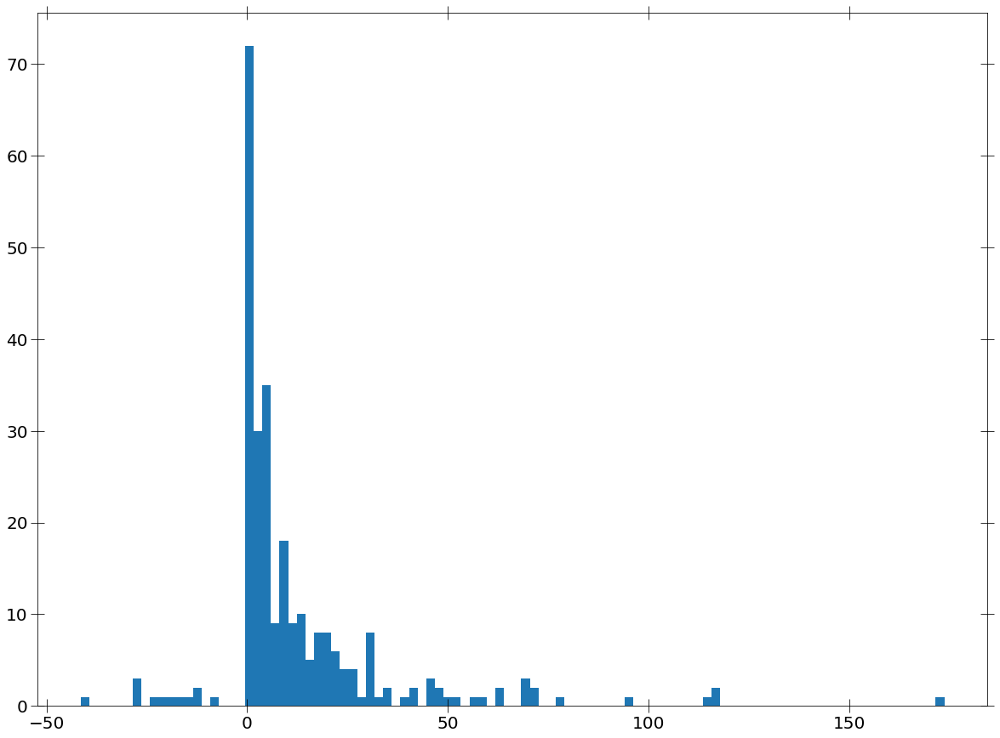

In [102]:
plt.hist(delta_cstat_g3, bins=100)

In [162]:
weird_srcs2 = np.where(np.logical_or(delta_cstat_g1 < -1, delta_cstat_g1 > 50))[0]

In [164]:
len(weird_srcs2)

14

In [133]:
np.sort(xmm_pl_fit_stats_table[:, 0][weird_srcs1])

array(['201113503010004', '201129702010029', '201129704010001',
       '201129704010010', '201129704010011', '201129704010040',
       '201129705010014', '201129705010043', '201129707010006',
       '201129721010009', '201129721010108', '201529201010017',
       '204024304010005', '205056701010004', '206043006010192',
       '206556701010012', '206904418010014', '206904418010045',
       '206946403010136', '207234103010007', '207234103010014',
       '207234103010016', '207234103010034', '207234103010035',
       '207234103010036', '207234103010038', '207234103010040',
       '207234103015026', '207234103015028', '207234104010012',
       '207234104010014', '207234104010017', '207234104010059',
       '207234105010007', '207234105010012', '207234105010017',
       '207234105010033', '207234105010036', '207234105010038',
       '207622503010010', '208441011010002', '208624706010010'],
      dtype='<U32')

In [134]:
xmm_pl_fit_stats_table[:, 0][weird_srcs1]

array(['206556701010012', '201129702010029', '201129707010006',
       '201129721010009', '207234104010059', '201129705010043',
       '207234103010040', '201129721010108', '207234105010012',
       '207234104010012', '207234105010007', '207234103015026',
       '201129704010010', '207234104010017', '201129704010040',
       '206946403010136', '207234105010038', '206904418010045',
       '201529201010017', '207234103010038', '201129704010011',
       '205056701010004', '201113503010004', '201129705010014',
       '204024304010005', '201129704010001', '207234104010014',
       '207234105010017', '208441011010002', '207234105010036',
       '207234103010007', '207234103010036', '207234103010034',
       '207234103010035', '207234103010016', '206043006010192',
       '207234105010033', '206904418010014', '207622503010010',
       '207234103010014', '208624706010010', '207234103015028'],
      dtype='<U32')

In [120]:
delta_cstat_g1[weird_srcs1]

array([-8.68067610e-04,  2.81206795e+01,  2.60235957e+01,  6.76836259e+01,
        4.97888319e+01,  2.15864350e+01,  2.30123980e+01,  6.49511295e+01,
        3.05663884e+01,  3.70706063e+01, -2.75712296e-03,  2.53924869e+01,
        3.58832778e+01,  2.42571661e+01,  2.02969384e+01,  2.41787765e+01,
        3.81246250e+01,  5.24048219e+01,  2.99860900e+01,  2.54315614e+01,
        2.03842304e+01,  4.03577760e+01,  2.20110614e+01,  2.26046561e+02,
        4.00075078e+01,  6.38376888e+01,  1.87964636e+02,  1.18102132e+02,
       -3.33503823e-03,  3.84233297e+01,  3.65101651e+01,  2.20546722e+01,
       -6.66443634e-06,  3.01762310e+01,  5.52641749e+01,  8.43546992e+01,
        8.12167599e+01,  8.99992721e+01,  2.11611373e+01,  2.67850738e+01,
        3.79132927e+01,  4.34041122e+01,  8.52373553e+01,  7.27679675e+01,
        4.39431419e+01, -6.79639063e-05, -1.64409809e-04,  5.56203829e+01])

In [115]:
np.where(delta_cstat_g1 < 0)

(array([  7,  97, 161, 176, 248, 258]),)

In [121]:
weird_srcs1

array([  7,  10,  29,  34,  41,  49,  51,  66,  69,  72,  97, 100, 101,
       114, 117, 118, 119, 120, 124, 130, 131, 133, 138, 144, 149, 153,
       155, 157, 161, 164, 165, 171, 176, 180, 185, 190, 191, 196, 197,
       211, 222, 224, 235, 237, 241, 248, 258, 262])

In [170]:
np.where(xmm_pl_fit_stats_table[:, 0] == '201129707010045')

(array([182]),)

In [171]:
xmm_pl_fit_stats_table[np.where(xmm_pl_fit_stats_table[:, 0] == '201129707010045')]

array([['201129707010045', '7895.765969122641', '-1.4463101505862166',
        '50.0', '1134']], dtype='<U32')

In [172]:
xmm_pl_g_fit_stats_table[np.where(xmm_pl_fit_stats_table[:, 0] == '201129707010045')]

array([['201129707010045', '7891.8960280235015', '-1.4465490502427034',
        '50.0', '1132']], dtype='<U32')

In [173]:
xmm_pl_g3_fit_stats_table[np.where(xmm_pl_fit_stats_table[:, 0] == '201129707010045')]

array([['201129707010045', '7892.660282215284', '-1.4469514023120824',
        '50.0', '1131']], dtype='<U32')

In [177]:
mos_counts[182]

2194.314032455358

In [166]:
np.sort(xmm_pl_fit_stats_table[:, 0][weird_srcs2])

array(['201129704010001', '201129705010014', '201129707010006',
       '204024304010005', '205056701010004', '206946403010136',
       '207234103010007', '207234103010014', '207234103010034',
       '207234103010035', '207234103010036', '207234103010040',
       '207234103015028', '207622503010010'], dtype='<U32')